In [1]:
import numpy as np
np.__version__

'1.19.5'

In [2]:
import pandas as pd
pd.__version__

'1.1.5'

In [3]:
import matplotlib
matplotlib.__version__

'3.3.4'

In [4]:
import matplotlib.pyplot as plt

In [5]:
# Adjust plot size
#options(repr.plot.width=16, repr.plot.height=6)

# For some reason, if this is in the same cell as the import command, it doesn't work.
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [6]:
import scipy
scipy.__version__

'1.5.4'

In [7]:
from scipy import stats

In [8]:
import seaborn as sns

In [9]:
from datetime import datetime

In [10]:
#from pandarallel import pandarallel

In [11]:
#pandarallel.initialize(progress_bar=True)

In [12]:
default_max_columns=pd.get_option('display.max_columns')

In [13]:
default_max_rows=pd.get_option('display.max_rows')

In [14]:
default_precision=pd.get_option('display.precision')

In [15]:
pd.set_option('display.precision', 2)

In [16]:
default_threshold=np.get_printoptions()['threshold']

In [17]:
np.set_printoptions(threshold=10000000)

# Read meta data

In [18]:
meta = pd.read_csv('20210428-EV/metadata.csv')

In [19]:
meta.head()

,Rand 2 Batch_order,D-plex Sequencing ID,Lexogen Sequencing ID,Diagnosis
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"


In [20]:
meta.rename(columns={"Rand 2 Batch_order": "subject"},inplace=True)
meta.rename(columns={"D-plex Sequencing ID": "dplex"},inplace=True)
meta.rename(columns={"Lexogen Sequencing ID": "lexogen"},inplace=True)
meta.rename(columns={"Diagnosis": "diag"},inplace=True)
#meta.set_index('subject',inplace=True)

In [21]:
meta

,subject,dplex,lexogen,diag
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,"
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,"
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,"
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,"
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,"
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted"
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,"
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,"
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,"


In [22]:
meta[['disease','idh','x1p19q']] = meta['diag'].str.split(",", 2, expand=True)
#meta.drop('diag',axis='columns',inplace=True)

In [23]:
meta

,subject,dplex,lexogen,diag,disease,idh,x1p19q
0,1_1,SFHH005a,SFHH006a,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
1,1_2,SFHH005b,SFHH006b,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
2,1_3,SFHH005c,SFHH006c,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,1_4,SFHH005d,SFHH006d,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,1_5,SFHH005e,SFHH006e,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
5,1_6,SFHH005f,SFHH006f,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,
6,1_7,SFHH005g,SFHH006g,"Oligodendroglioma, IDH-mutant, 1p19q codeleted",Oligodendroglioma,IDH-mutant,1p19q codeleted
7,1_8,SFHH005h,SFHH006h,"GBM, IDH1R132H WT,",GBM,IDH1R132H WT,
8,1_9,SFHH005i,SFHH006i,"GBM, IDH-mutant,",GBM,IDH-mutant,
9,1_10,SFHH005j,SFHH006j,"Diffuse Astrocytoma, IDH-mutant,",Diffuse Astrocytoma,IDH-mutant,


# Read raw matrix CORE

In [24]:
#df = pd.read_csv('20210428-EV/dplexonlyreport.csv',index_col=0,header=None)
df = pd.read_csv('20210428-EV/20210513b-report.csv.gz',index_col=0,header=None,low_memory=False)

In [25]:
df.shape

(39, 528)

In [26]:
df.head(12)

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
---,---,---,---,---,---,---,---,---,---,---,...,---,---,---,---,---,---,---,---,---,---
Subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
Trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,4038879,4038879,4038879,4038879,4038879,4038879,3088240,3088240,3088240,3088240,...,3665258,3665258,3665258,3665258,4868169,4868169,4868169,4868169,4868169,4868169
Raw Read Length,35.0646,35.0646,35.0646,35.0646,35.0646,35.0646,48.6946,48.6946,48.6946,48.6946,...,34.0495,34.0495,34.0495,34.0495,36.2413,36.2413,36.2413,36.2413,36.2413,36.2413
Trimmed Read Count,1270784,1372973,1372997,1395891,1395893,1395893,1240850,1396651,1396740,1418066,...,3633881,3661993,3664115,3664263,4478092,4823895,4823681,4863961,4867158,4867302
Trimmed Ave Read Length,33.8185,38.2306,38.2314,43.5121,43.5142,43.524,40.8779,51.0991,51.101,64.3485,...,32.6867,33.8972,34.0071,34.0507,30.6793,34.7925,34.7983,36.0631,36.1974,36.242


In [27]:
df.drop("---",inplace=True)

In [28]:
df.shape

(38, 528)

In [29]:
df.rename({'  ':'sample'},axis='rows',inplace=True)
df.rename({'Subject':'subject'},axis='rows',inplace=True)
df.rename({'Trimmer':'trimmer'},axis='rows',inplace=True)

In [30]:
df

,1,2,3,4,5,6,7,8,9,10,...,519,520,521,522,523,524,525,526,527,528
0,,,,,,,,,,,,,,,,,,,,,
sample,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005aa,SFHH005ab,SFHH005ab,SFHH005ab,SFHH005ab,...,SFHH006y,SFHH006y,SFHH006y,SFHH006y,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z,SFHH006z
subject,3_5,3_5,3_5,3_5,3_5,3_5,3_6,3_6,3_6,3_6,...,3_3,3_3,3_3,3_3,3_4,3_4,3_4,3_4,3_4,3_4
Lab kit,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,D-plex,...,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen,Lexogen
trimmer,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,...,bbduk3,cutadapt1,cutadapt2,cutadapt3,bbduk1,bbduk2,bbduk3,cutadapt1,cutadapt2,cutadapt3
Raw Read Count,4038879,4038879,4038879,4038879,4038879,4038879,3088240,3088240,3088240,3088240,...,3665258,3665258,3665258,3665258,4868169,4868169,4868169,4868169,4868169,4868169
Raw Read Length,35.0646,35.0646,35.0646,35.0646,35.0646,35.0646,48.6946,48.6946,48.6946,48.6946,...,34.0495,34.0495,34.0495,34.0495,36.2413,36.2413,36.2413,36.2413,36.2413,36.2413
Trimmed Read Count,1270784,1372973,1372997,1395891,1395893,1395893,1240850,1396651,1396740,1418066,...,3633881,3661993,3664115,3664263,4478092,4823895,4823681,4863961,4867158,4867302
Trimmed Ave Read Length,33.8185,38.2306,38.2314,43.5121,43.5142,43.524,40.8779,51.0991,51.101,64.3485,...,32.6867,33.8972,34.0071,34.0507,30.6793,34.7925,34.7983,36.0631,36.1974,36.242
STAR Aligned to Transcriptome,111104,112499,112492,112689,112696,112689,92673,93752,93727,92285,...,337860,337076,336880,336843,362402,363298,363259,362012,361905,361853


In [31]:
df=df.T
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,Bowtie2 Aligned to Salmonella,Bowtie2 Aligned to Salmonella %,Bowtie2 Aligned to masked Salmonella,Bowtie2 Aligned to masked Salmonella %,Bowtie2 Aligned to Burkholderia,Bowtie2 Aligned to Burkholderia %,Bowtie2 Aligned to masked Burkholderia,Bowtie2 Aligned to masked Burkholderia %,Bowtie2 Aligned to mRNA_Prot,Bowtie2 Aligned to mRNA_Prot %
1,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,45946,3.61,14700,1.15,375543,29.55,277406,21.82,58736,4.62
2,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,60133,4.37,17811,1.29,413414,30.11,298416,21.73,71735,5.22
3,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,60133,4.37,17811,1.29,413414,30.11,298416,21.73,71735,5.22
4,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,61284,4.39,18218,1.30,420290,30.10,304330,21.80,75518,5.41
5,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,61285,4.39,18218,1.30,420299,30.10,304339,21.80,75522,5.41


In [32]:
#df=df.merge(meta,left_on='Subject',right_on='subject')
df=df.merge(meta,on='subject')
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,Bowtie2 Aligned to masked Burkholderia,Bowtie2 Aligned to masked Burkholderia %,Bowtie2 Aligned to mRNA_Prot,Bowtie2 Aligned to mRNA_Prot %,dplex,lexogen,diag,disease,idh,x1p19q
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,277406,21.82,58736,4.62,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,298416,21.73,71735,5.22,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,298416,21.73,71735,5.22,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,304330,21.80,75518,5.41,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,304339,21.80,75522,5.41,SFHH005aa,SFHH006aa,"GBM, IDH-mutant,",GBM,IDH-mutant,


In [33]:
#element_counts = pd.read_csv('20210428-EV/rmsk_class_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/rmsk_family_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/rmsk_name_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/mirna_counts.csv.gz',index_col=0,low_memory=False)
element_counts = pd.read_csv('20210428-EV/gene_counts.csv.gz',index_col=0,low_memory=False)
#element_counts = pd.read_csv('20210428-EV/mrna_counts.csv.gz',index_col=0,low_memory=False)
# diamond_family_counts

element_counts.head()

,SFHH005aa.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.bbduk2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.cutadapt1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.cutadapt2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005aa.cutadapt3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005ab.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005ab.bbduk2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005ab.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH005a.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,...,SFHH006y.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006y.cutadapt1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006y.cutadapt2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006y.cutadapt3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.bbduk1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.bbduk2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.bbduk3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.cutadapt1.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.cutadapt2.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts,SFHH006z.cutadapt3.STAR.hg38.Aligned.toTranscriptome.out.bam.gene_counts
sequence,,,,,,,,,,,,,,,,,,,,,
A1BG,0,0,0,0,0,0,0,0,0,0,...,21,21,21,21,0,0,0,0,0,0
A1BG-AS1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
A1CF,0,0,0,0,0,0,24,24,24,0,...,0,0,0,0,0,0,0,0,0,0
A2M,0,0,0,0,0,0,50,125,125,0,...,0,0,0,0,0,0,0,0,0,0
A2M-AS1,0,0,0,0,0,0,177,177,177,6,...,0,0,0,0,0,0,0,0,0,0


# Keep less than 5000 columns

In [34]:
len(element_counts)

34074

In [35]:
#element_counts=element_counts[0:5000]
#element_counts=element_counts[5000:10000]
#element_counts=element_counts[10000:15000]
#element_counts=element_counts[15000:20000]
#element_counts=element_counts[20000:25000]
element_counts=element_counts[25000:30000]
#element_counts=element_counts[30000:35000]

In [36]:
len(element_counts)

5000

In [37]:
element_counts=element_counts.T
element_counts=element_counts.reset_index()
element_counts[['sample','trimmer','other']]=element_counts['index'].str.split(".",2,expand=True)
element_counts.drop(["index","other"],inplace=True,axis='columns')
element_counts.head()

sequence,OR5D14,OR5D16,OR5D18,OR5E1P,OR5F1,OR5H1,OR5H14,OR5H15,OR5H2,OR5H6,...,SPATA8-AS1,SPATA9,SPATC1,SPATC1L,SPATS1,SPATS2,SPATS2L,SPC24,sample,trimmer
0,0,0,0,3,0,0,0,0,0,0,...,0,0,1,0,0,1316,7,0,SFHH005aa,bbduk1
1,0,0,0,3,0,0,1,0,0,0,...,0,0,1,0,0,1316,7,2,SFHH005aa,bbduk2
2,0,0,0,3,0,0,1,0,0,0,...,0,0,1,0,0,1316,7,2,SFHH005aa,bbduk3
3,0,0,0,3,0,0,0,0,0,0,...,0,0,1,0,0,1324,7,0,SFHH005aa,cutadapt1
4,0,0,0,3,0,0,0,0,0,0,...,0,0,1,0,0,1324,7,0,SFHH005aa,cutadapt2


In [38]:
df=df.merge(element_counts,on=['sample','trimmer'])
df.shape

(528, 5044)

In [39]:
df.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,SPATA7,SPATA8,SPATA8-AS1,SPATA9,SPATC1,SPATC1L,SPATS1,SPATS2,SPATS2L,SPC24
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,0,0,0,0,1,0,0,1316,7,0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,0,0,0,0,1,0,0,1316,7,2
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,0,0,0,0,1,0,0,1316,7,2
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,0,0,0,0,1,0,0,1324,7,0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,0,0,0,0,1,0,0,1324,7,0


In [40]:
df.columns  #.tolist()

Index(['sample', 'subject', 'Lab kit', 'trimmer', 'Raw Read Count',
       'Raw Read Length', 'Trimmed Read Count', 'Trimmed Ave Read Length',
       'STAR Aligned to Transcriptome', 'STAR Aligned to Transcriptome %',
       ...
       'SPATA7', 'SPATA8', 'SPATA8-AS1', 'SPATA9', 'SPATC1', 'SPATC1L',
       'SPATS1', 'SPATS2', 'SPATS2L', 'SPC24'],
      dtype='object', length=5044)

In [41]:
#genes=df.columns[92:142]
#genes=df.columns[100:554]
#a=df.columns.tolist().index('STAR Gene Counts')+1
#b=df.columns.tolist().index('STAR miRNA Counts')
#genes=df.columns[a:b]
elements=element_counts.columns[:-2]
elements

Index(['OR5D14', 'OR5D16', 'OR5D18', 'OR5E1P', 'OR5F1', 'OR5H1', 'OR5H14',
       'OR5H15', 'OR5H2', 'OR5H6',
       ...
       'SPATA7', 'SPATA8', 'SPATA8-AS1', 'SPATA9', 'SPATC1', 'SPATC1L',
       'SPATS1', 'SPATS2', 'SPATS2L', 'SPC24'],
      dtype='object', name='sequence', length=5000)

In [42]:
df['Raw Read Count'] = pd.to_numeric(df['Raw Read Count'], errors='coerce')

In [43]:
df['Trimmed Read Count'] = pd.to_numeric(df['Trimmed Read Count'], errors='coerce')

In [44]:
pd.set_option('display.max_rows',None)

In [45]:
#df[['subject','sample','Raw Read Count']].drop_duplicates().sort_values(by='Raw Read Count')

In [46]:
#df[['subject','sample','trimmer','Trimmed Read Count']].drop_duplicates().sort_values(by='Trimmed Read Count')

In [47]:
pd.set_option('display.max_rows',default_max_rows)

# Prepping to ttest all items against all other items

In [48]:
df['diag'].unique()

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'V01 control (S1),,', 'GBM, IDH1R132H WT,', 'blank 2 (C1),,',
       'blank1 (C1),,'], dtype=object)

In [49]:
u=df['diag'].unique()
diags=u[0:3]
diags=np.append(diags,u[4])

In [50]:
diags

array(['GBM, IDH-mutant,', 'Diffuse Astrocytoma, IDH-mutant,',
       'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
       'GBM, IDH1R132H WT,'], dtype=object)

In [51]:
type(diags)

numpy.ndarray

In [52]:
diags=diags.tolist()

In [53]:
diags

['GBM, IDH-mutant,',
 'Diffuse Astrocytoma, IDH-mutant,',
 'Oligodendroglioma, IDH-mutant, 1p19q codeleted',
 'GBM, IDH1R132H WT,']

In [54]:
# Why was this here?

#import warnings
#warnings.filterwarnings("ignore", category=np.VisibleDeprecationWarning) 

pca plots

In [55]:
def ttests_boxplots_and_heatmaps(localdf,columns,box_p=0.05,heat_p=0.15):
    select_p_values=[]
    for col in columns:

        if ( col not in localdf.columns ):
            continue

        for labkit in localdf['Lab kit'].unique():
            #"D-plex","Lexogen":
            for trimmer in 'bbduk2','cutadapt2':
                #localdf['Trimmer'].unique():
                #"bbduk1","bbduk2","bbduk3","cutadapt1","cutadapt2","cutadapt3":
                for diag in diags:
                    others=diags.copy()
                    others.remove(diag)
                    for other in others:
                        t, p = stats.ttest_ind(
                            localdf[((localdf["Lab kit"]==labkit) &
                                     (localdf["trimmer"]==trimmer) & 
                                (localdf["diag"]==diag))][col],
                            localdf[((localdf["Lab kit"]==labkit) &
                                     (localdf["trimmer"]==trimmer) & 
                                (localdf["diag"]==other))][col])
                        if p < heat_p:
                            select_p_values.append([abs(t),p,col,labkit,trimmer])

    pdf = pd.DataFrame(select_p_values, columns=['t','p','col','labkit','trimmer'])                        
    pdf=pdf.drop_duplicates().sort_values('p')

    for index, row in pdf.iterrows():
        if row['p'] < box_p:
            print(" p : "+str(row['p'])+"  ( t : "+str(row['t'])+" ) :  "+
                  row['labkit']+"  :  "+row['trimmer']+"  :  "+row['col'])
            print("Control and blanks")
            print(localdf[
                (localdf['diag']=='V01 control (S1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
            print(localdf[
                (localdf['diag']=='blank 2 (C1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
            print(localdf[
                (localdf['diag']=='blank1 (C1),,') &
                (localdf["Lab kit"]==row['labkit']) &
                (localdf["trimmer"]==row['trimmer'])][row['col']])
                        
            localdf[((localdf["Lab kit"]==row['labkit']) &
                     (localdf["trimmer"]==row['trimmer']))].boxplot(
                column=row['col'],by=['diag'])
            plt.title(row['col'] + " Normalized by Trimmed Read Count")
            plt.xticks(rotation=75,ha='right')
            plt.show()

    selected=['subject','sample','Lab kit','trimmer','diag','idh']
    selected=np.append(selected,pdf['col'])
    selected=np.unique(selected)

    #['Lab kit' 'NR_029609.1' 'trimmer' 'diag' 'idh' 'sample' 'subject']
    if len(selected) > 7:
        for trimmer in 'bbduk2','cutadapt2':
            for labkit in dfn['Lab kit'].unique():
                tmp=localdf[selected].copy()
                tmp=tmp[(tmp['trimmer']==trimmer) & (tmp['Lab kit']==labkit)]
                tmp=tmp.drop('trimmer',axis='columns')
                tmp=tmp.drop('Lab kit',axis='columns')
                tmp.set_index(['subject','sample','diag','idh'],inplace=True)
                
                #tmp-=tmp.min() # This may almost always be 0 now.
                tmp/=tmp.max() # given that there should be no NAs now, coule let clustermap do this
                # ...
                #standard_scale int or None, optional
                #Either 0 (rows) or 1 (columns).
                #Whether or not to standardize that dimension, meaning for each row or column,
                #subtract the minimum and divide each by its maximum.
                # how would that deal with 0s or empty cells

                tmp=tmp.fillna(0) # Somehow, some scaled values become NaN so keep this
                
                tmp.reset_index(inplace=True)

                #tmp1=tmp.sort_values(['diag']).T
                tmp=tmp.sort_values(['idh','diag'])
                #print(tmp.head())
                tmp.drop(['subject'],inplace=True,axis='columns')
                tmp.set_index(['sample','idh'],inplace=True)
                
                diagnoses=tmp.pop('diag')
                #lut = dict(zip(diagnoses.unique(), "rgbcmykb"))
                #col_colors = diagnoses.map(lut)
                #print(col_colors)
                #print(tmp.columns)
                
                tmp=tmp.T

                #print('pal')
                network_pal = sns.cubehelix_palette(len(diagnoses.unique()),
                                    light=.9, dark=.1, reverse=True,
                                    start=1, rot=-2)
                #print(network_pal)
                network_pal
                #print('lut')
                network_lut = dict(zip(diagnoses.unique(), network_pal))
                #print(network_lut)
                #print('labels')
                # Convert the palette to vectors that will be drawn on the side of the matrix
                network_labels = diagnoses
                #print(network_labels)
                network_colors = pd.Series(network_labels, index=tmp.columns).map(network_lut)                
                #print('colors')
                #print(network_colors)
                
                # from http://dawnmy.github.io/2016/10/24/Plot-heatmaap-with-side-color-indicating-the-class-of-variables/
                # Create a custom palette to identify the networks
                #network_pal = sns.cubehelix_palette(len(used_networks),
                #                    light=.9, dark=.1, reverse=True,
                #                    start=1, rot=-2)
                #network_lut = dict(zip(map(str, used_networks), network_pal))

                # Convert the palette to vectors that will be drawn on the side of the matrix
                #network_labels = df.columns.get_level_values("network")
                #network_colors = pd.Series(network_labels, index=df.columns).map(network_lut)                
   
                # Create a custom colormap for the heatmap values
                #cmap = sns.diverging_palette(h_neg=210, h_pos=350, s=90, l=30, as_cmap=True)

                # Draw the full plot
                #g = sns.clustermap(df.corr(),

                #                 # Turn off the clustering
                #                 row_cluster=False, col_cluster=False,

                #                  # Add colored class labels
                #                  row_colors=network_colors, col_colors=network_colors,

                #                  # Make the plot look better when many rows/cols
                #                  linewidths=0, xticklabels=False, yticklabels=False)

                # Draw the legend bar for the classes                 
                #for label in network_labels.unique():
                #    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                #                            label=label, linewidth=0)
                #g.ax_col_dendrogram.legend(loc="center", ncol=5)

                
                g=sns.clustermap(tmp,col_cluster=False,figsize=(15,20),cmap="Spectral",col_colors=network_colors)
                g.fig.suptitle("Clustermap 1 : "+trimmer+" "+labkit)
                plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')

                # Draw the legend bar for the classes                 
                for label in network_labels.unique():
                    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                                            label=label, linewidth=0)
                g.ax_col_dendrogram.legend(loc="center", ncol=4)
                
                # Adjust the postion of the main colorbar for the heatmap
                #g.cax.set_position([.97, .2, .03, .45])
                g.cax.set_position([0, .15, .005, .65])
                plt.show()

                g=sns.clustermap(tmp,figsize=(15,20),cmap="Spectral",col_colors=network_colors)
                g.fig.suptitle("Clustermap 2 : "+trimmer+" "+labkit)
                plt.setp(g.ax_heatmap.get_xticklabels(), rotation=75, horizontalalignment='right')

                # Draw the legend bar for the classes                 
                for label in network_labels.unique():
                    g.ax_col_dendrogram.bar(0, 0, color=network_lut[label],
                                            label=label, linewidth=0)
                g.ax_col_dendrogram.legend(loc="center", ncol=4)
                                
                # Adjust the postion of the main colorbar for the heatmap
                # [dist from left,dist from bottom?,width?,height?]
                g.cax.set_position([0, .15, .005, .65])
                plt.show()  
    else:
        print("Not enough data to produce cluster maps")

# Normalize by Trimmed Read Count

In [56]:
dfn=df.copy()

In [57]:
dfn.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,SPATA7,SPATA8,SPATA8-AS1,SPATA9,SPATC1,SPATC1L,SPATS1,SPATS2,SPATS2L,SPC24
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,0,0,0,0,1,0,0,1316,7,0
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,0,0,0,0,1,0,0,1316,7,2
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,0,0,0,0,1,0,0,1316,7,2
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,0,0,0,0,1,0,0,1324,7,0
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,0,0,0,0,1,0,0,1324,7,0


In [58]:
datetime.now().strftime("%H:%M:%S")

'10:48:09'

In [59]:
dfn[elements]=(1e9*dfn[elements].values)/dfn[['Trimmed Read Count']].values

In [60]:
datetime.now().strftime("%H:%M:%S")

'10:48:41'

In [61]:
dfn.head()

,sample,subject,Lab kit,trimmer,Raw Read Count,Raw Read Length,Trimmed Read Count,Trimmed Ave Read Length,STAR Aligned to Transcriptome,STAR Aligned to Transcriptome %,...,SPATA7,SPATA8,SPATA8-AS1,SPATA9,SPATC1,SPATC1L,SPATS1,SPATS2,SPATS2L,SPC24
0,SFHH005aa,3_5,D-plex,bbduk1,4038879,35.0646,1270784,33.8185,111104,8.74,...,0.0,0.0,0.0,0.0,786.92,0.0,0.0,1.04e+06,5508.41,0.00
1,SFHH005aa,3_5,D-plex,bbduk2,4038879,35.0646,1372973,38.2306,112499,8.19,...,0.0,0.0,0.0,0.0,728.35,0.0,0.0,9.59e+05,5098.43,1456.69
2,SFHH005aa,3_5,D-plex,bbduk3,4038879,35.0646,1372997,38.2314,112492,8.19,...,0.0,0.0,0.0,0.0,728.33,0.0,0.0,9.58e+05,5098.34,1456.67
3,SFHH005aa,3_5,D-plex,cutadapt1,4038879,35.0646,1395891,43.5121,112689,8.07,...,0.0,0.0,0.0,0.0,716.39,0.0,0.0,9.48e+05,5014.72,0.00
4,SFHH005aa,3_5,D-plex,cutadapt2,4038879,35.0646,1395893,43.5142,112696,8.07,...,0.0,0.0,0.0,0.0,716.39,0.0,0.0,9.48e+05,5014.71,0.00


In [62]:
datetime.now().strftime("%H:%M:%S")

'10:48:42'

In [63]:
for c in ['CDKN2A','CDKN2A-DT','CDKN2AIP','CDKN2AIPNL','CDKN2B','CDKN2B-AS1',
    'EGFR','EGFR-AS1','IDH1','IDH1-AS1','IDH2','IDH2-DT','NF1','NOTCH1',
    'RB1','RB1CC1','RB1-DT','TERT','TP53']:
        if( c not in dfn.columns ):
            print("Missing "+c) 

Missing CDKN2A
Missing CDKN2A-DT
Missing CDKN2AIP
Missing CDKN2AIPNL
Missing CDKN2B
Missing CDKN2B-AS1
Missing EGFR
Missing EGFR-AS1
Missing IDH1
Missing IDH1-AS1
Missing IDH2
Missing IDH2-DT
Missing NF1
Missing NOTCH1
Missing TERT
Missing TP53


In [64]:
datetime.now().strftime("%H:%M:%S")

'10:48:42'

# Select Genes (if using Genes)

 p : 0.08399794007946997  ( t : 1.8291248879059394 ) :  D-plex  :  cutadapt2  :  RB1-DT
Control and blanks
76     0.0
340    0.0
Name: RB1-DT, dtype: float64
208    0.0
Name: RB1-DT, dtype: float64
472    577.96
Name: RB1-DT, dtype: float64


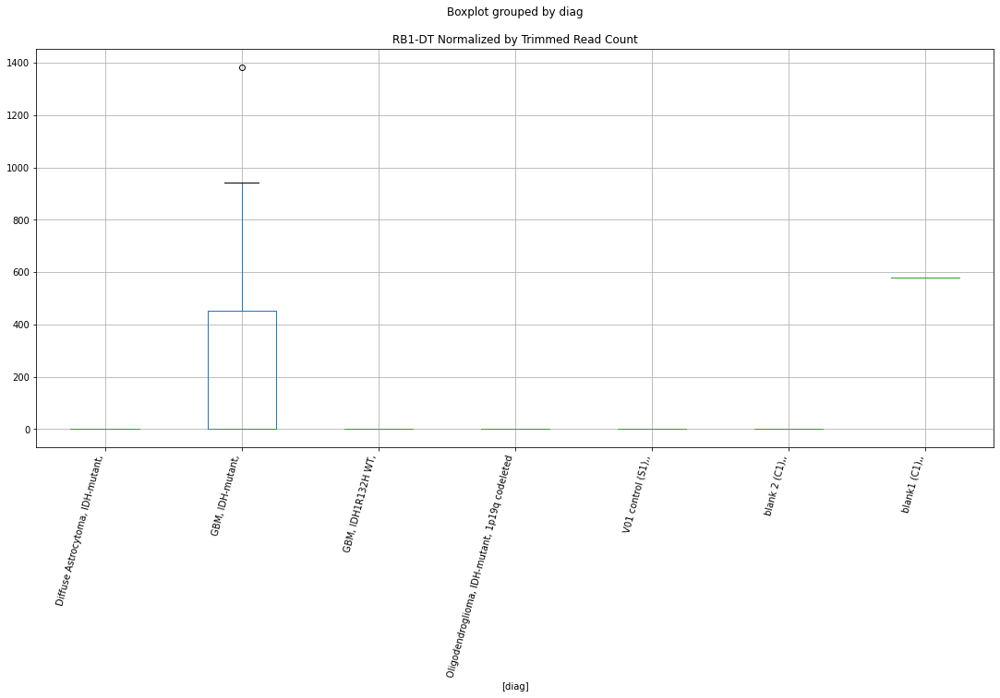

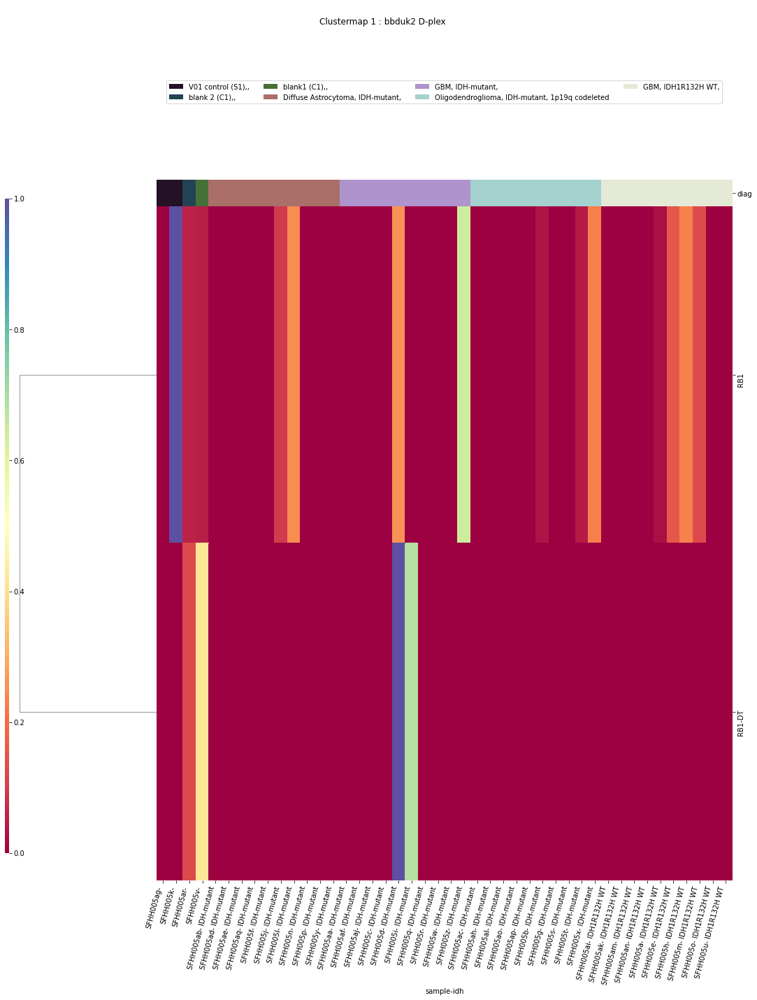

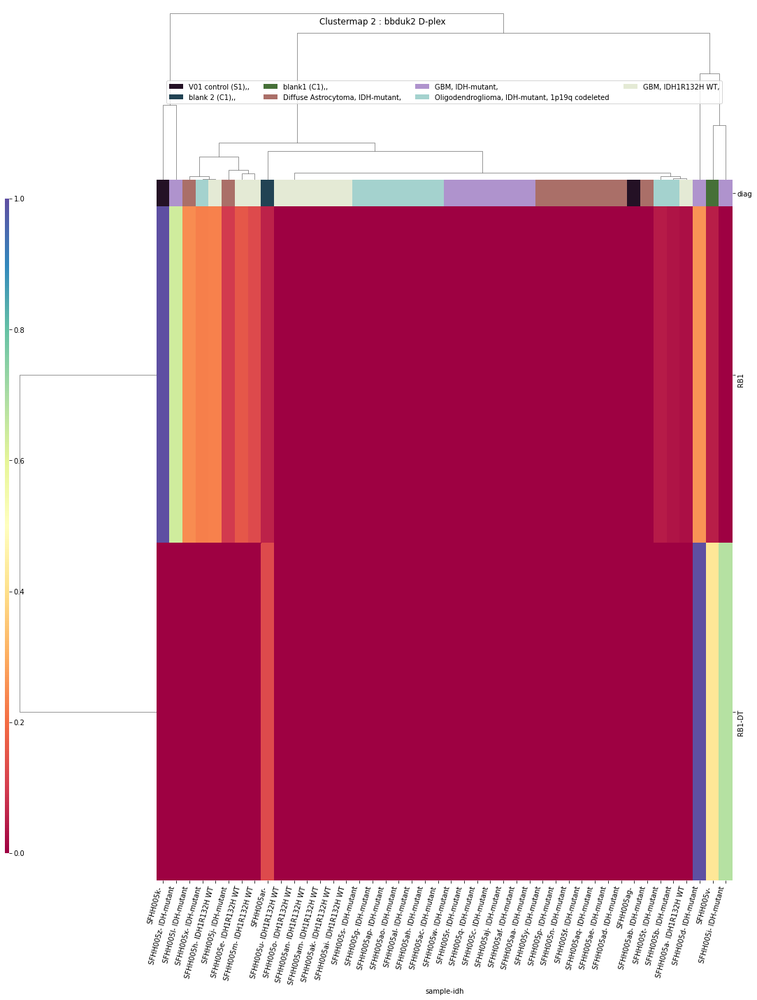

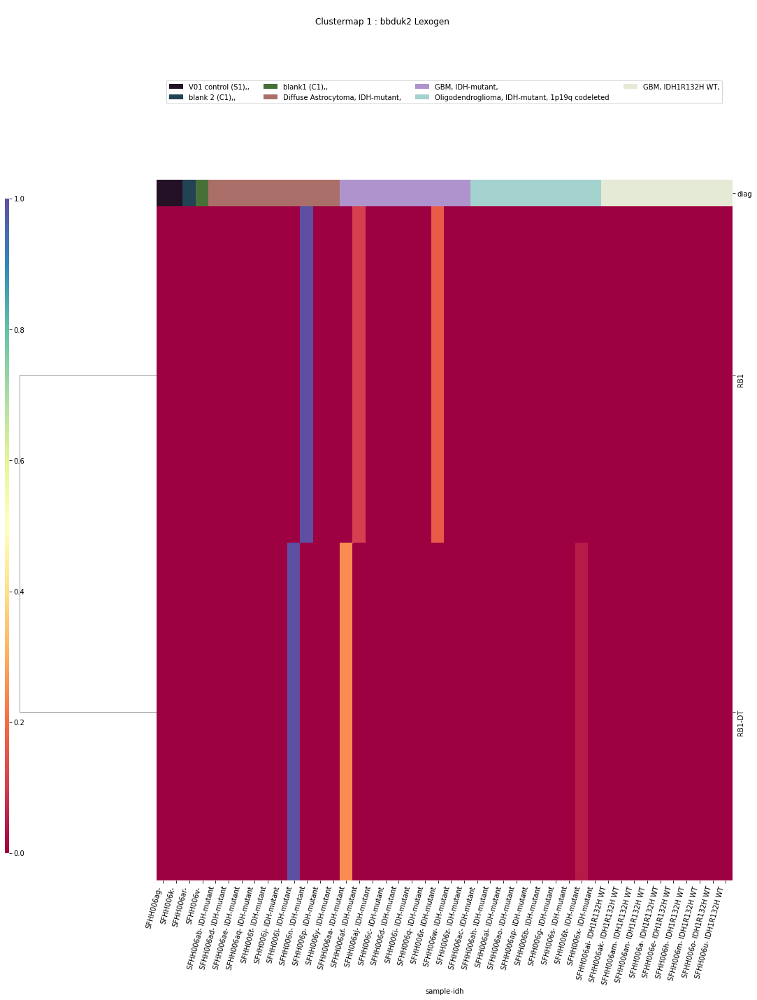

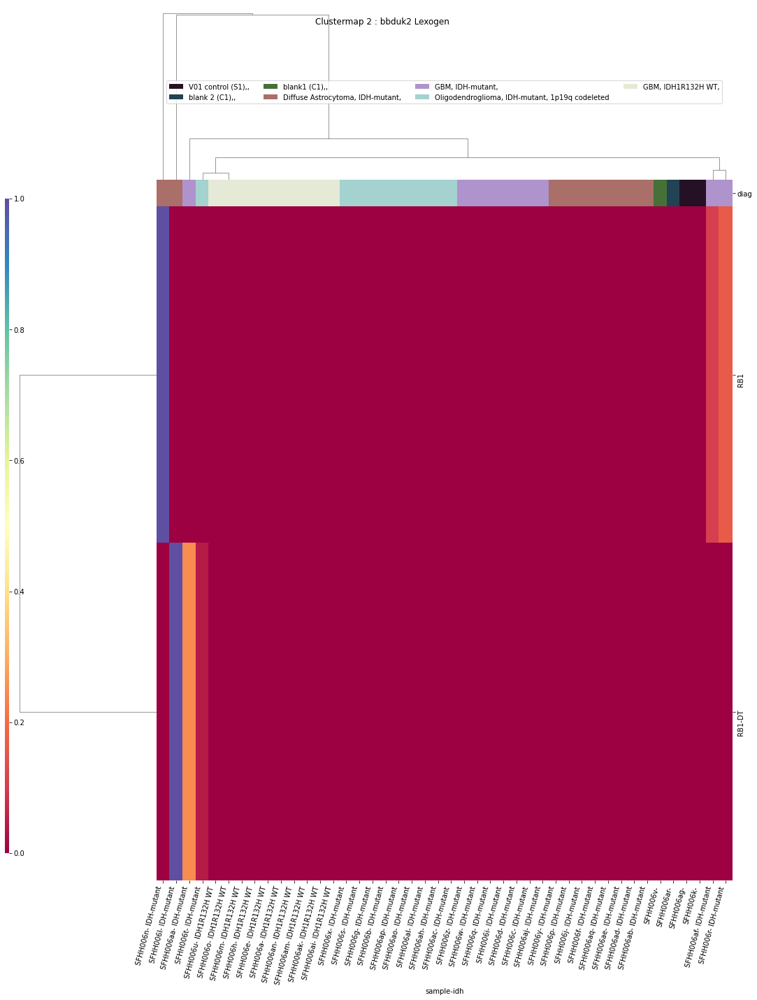

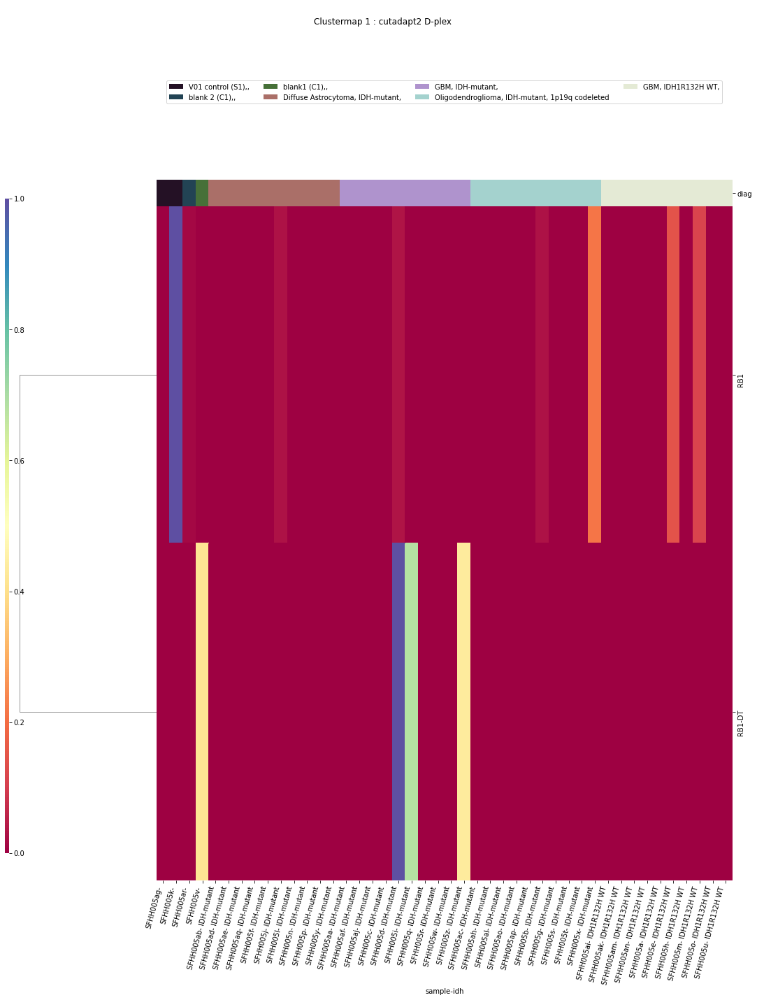

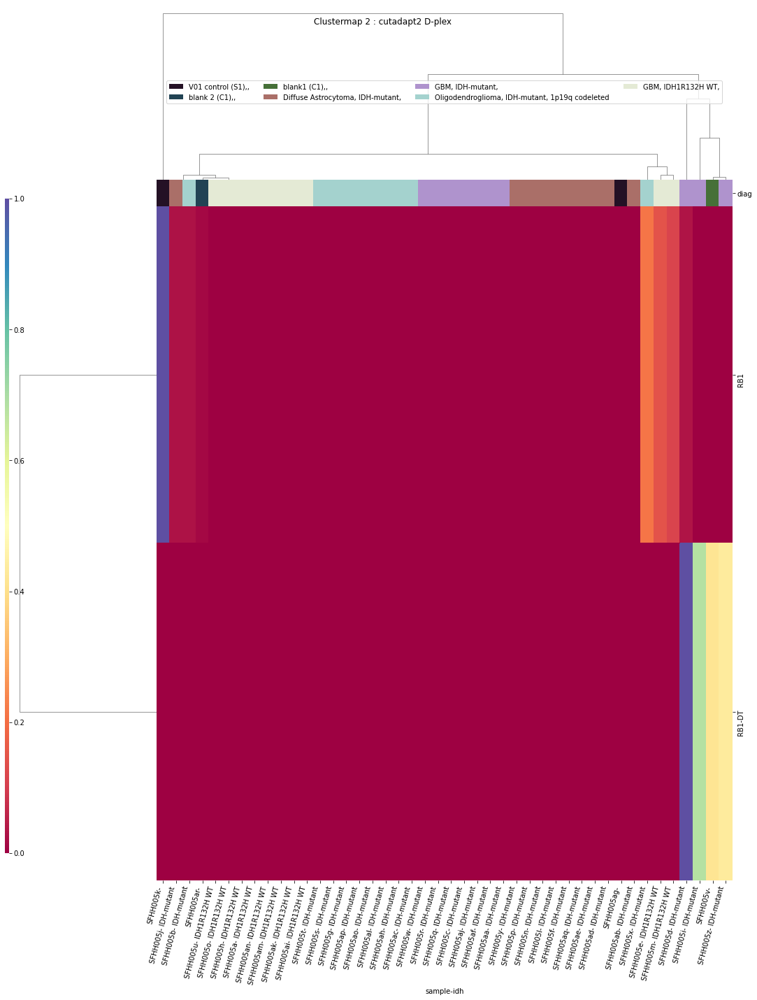

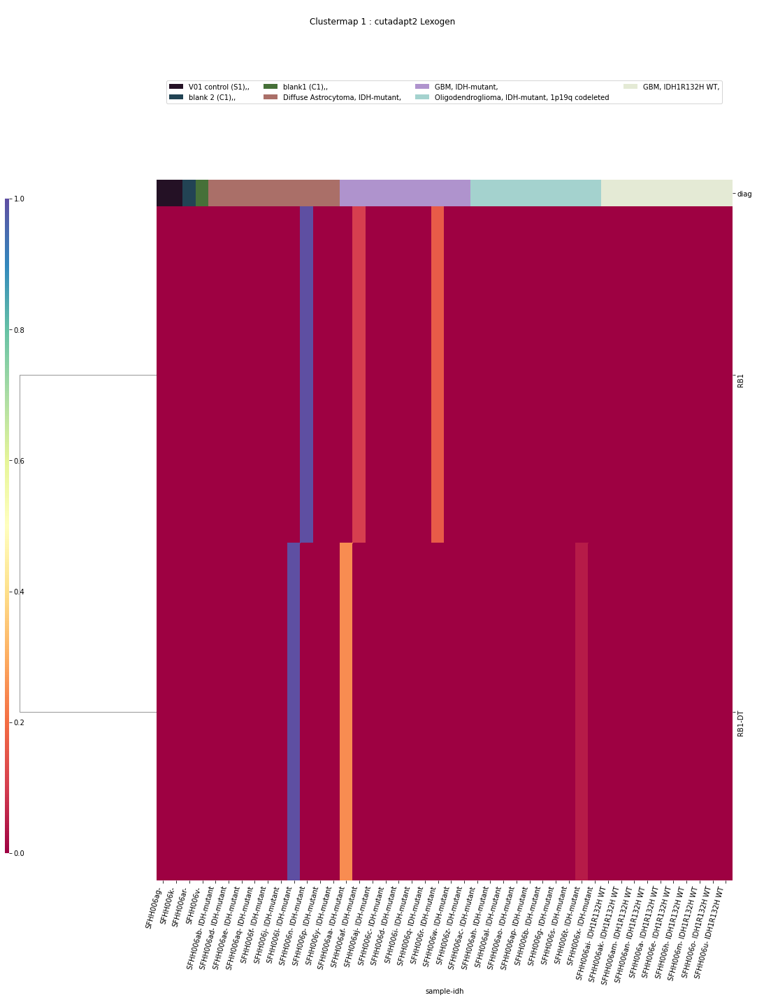

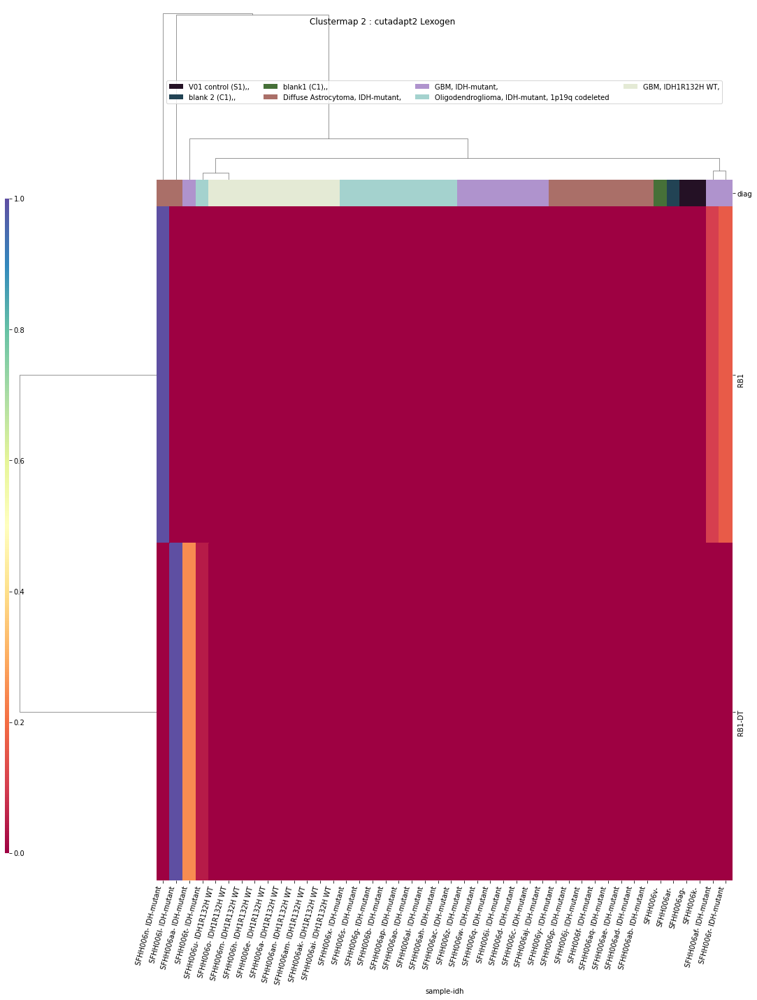

In [65]:
ttests_boxplots_and_heatmaps(dfn,['CDKN2A','CDKN2A-DT','CDKN2AIP','CDKN2AIPNL','CDKN2B','CDKN2B-AS1','EGFR',
                                  'EGFR-AS1','IDH1','IDH1-AS1','IDH2','IDH2-DT','NF1','NOTCH1','RB1','RB1CC1',
                                  'RB1-DT','TERT','TP53'],box_p=0.1,heat_p=0.2)

In [66]:
datetime.now().strftime("%H:%M:%S")

'10:49:28'

# Elements

 p : 0.0004776145361679385  ( t : 4.253803152783907 ) :  D-plex  :  cutadapt2  :  PRKX
Control and blanks
76     1515.23
340       0.00
Name: PRKX, dtype: float64
208    36859.29
Name: PRKX, dtype: float64
472    0.0
Name: PRKX, dtype: float64


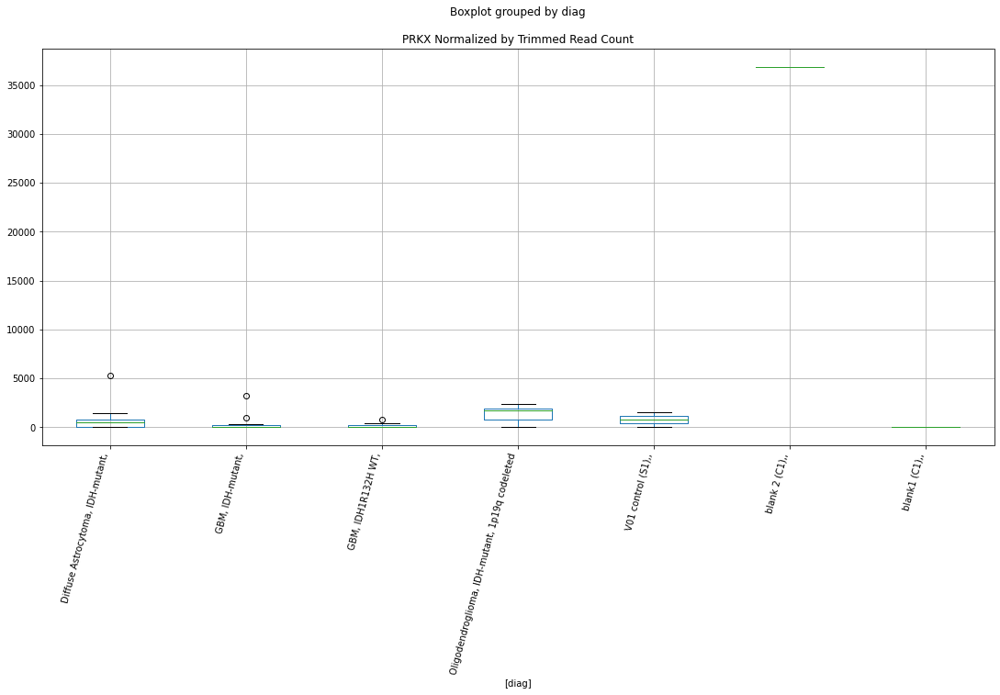

 p : 0.0006646608595179704  ( t : 4.105083834296748 ) :  D-plex  :  bbduk2  :  PRKX
Control and blanks
73     1546.02
337       0.00
Name: PRKX, dtype: float64
205    37430.01
Name: PRKX, dtype: float64
469    591.53
Name: PRKX, dtype: float64


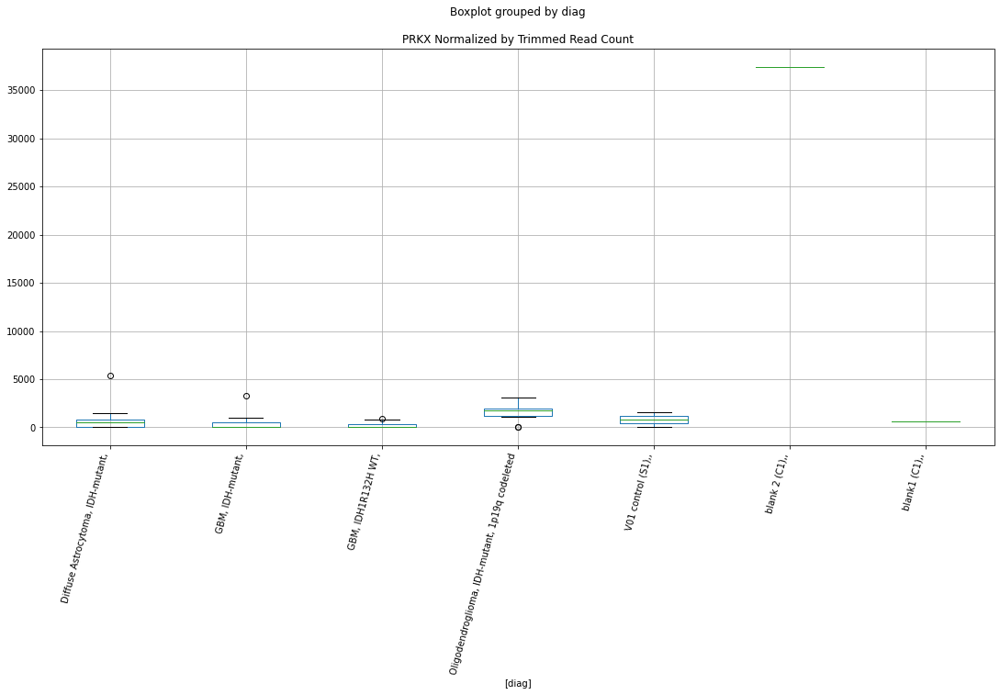

 p : 0.0010407032774559597  ( t : 3.90374153515437 ) :  D-plex  :  cutadapt2  :  SNORC
Control and blanks
76     0.0
340    0.0
Name: SNORC, dtype: float64
208    3527.2
Name: SNORC, dtype: float64
472    6357.51
Name: SNORC, dtype: float64


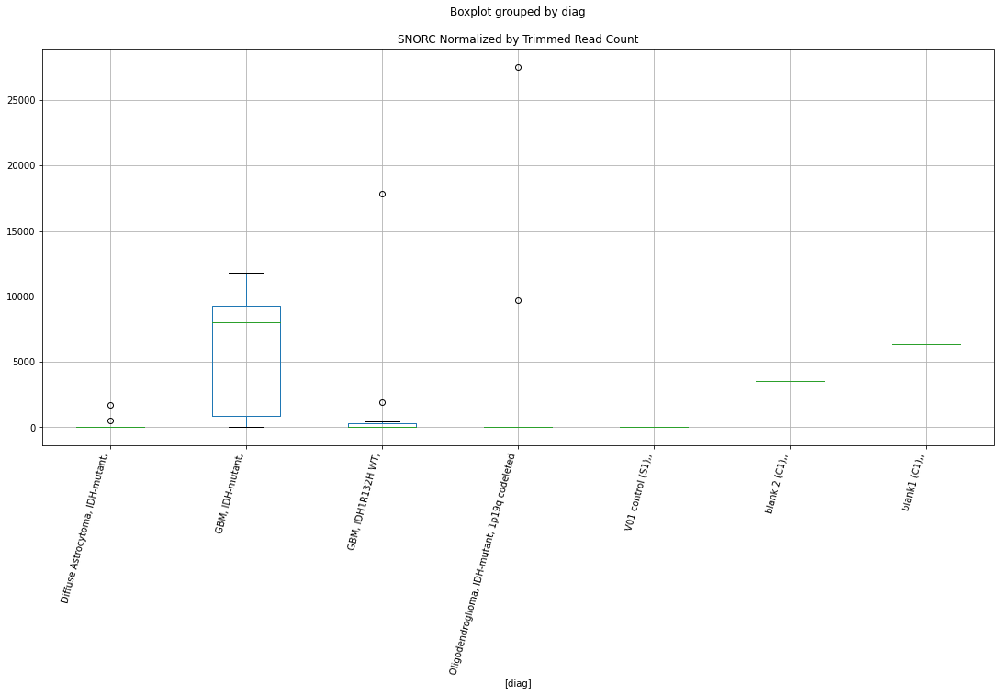

 p : 0.0024953889087938313  ( t : 3.5109353984536606 ) :  D-plex  :  bbduk2  :  RAB11FIP1
Control and blanks
73     0.0
337    0.0
Name: RAB11FIP1, dtype: float64
205    71099.11
Name: RAB11FIP1, dtype: float64
469    3549.16
Name: RAB11FIP1, dtype: float64


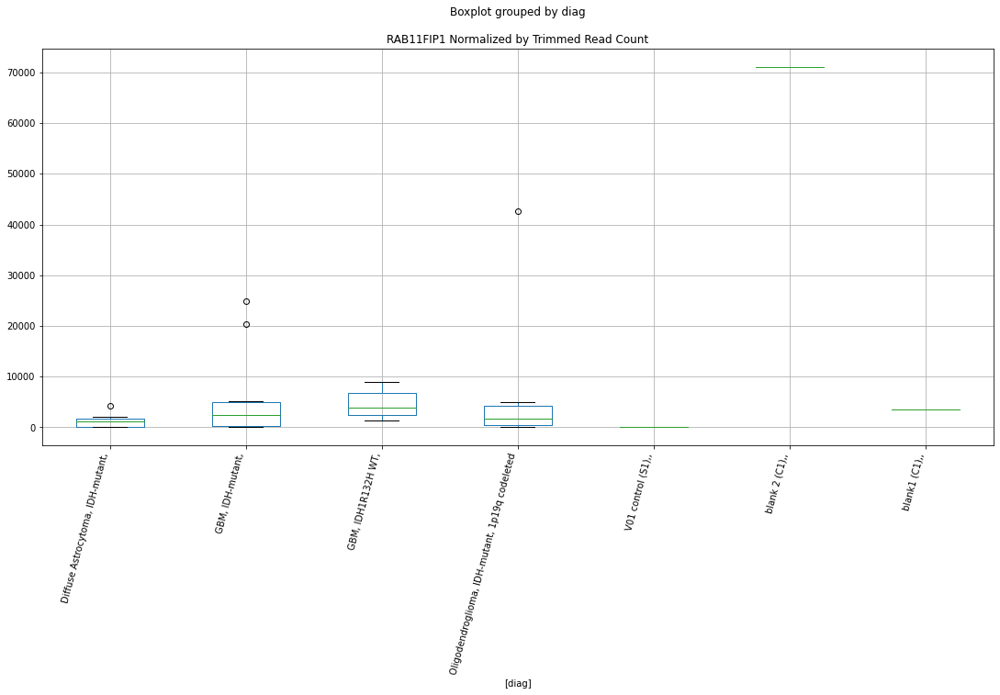

 p : 0.002681129303978816  ( t : 3.4785974598820304 ) :  D-plex  :  cutadapt2  :  RBM6
Control and blanks
76     757.61
340      0.00
Name: RBM6, dtype: float64
208    38093.81
Name: RBM6, dtype: float64
472    17916.63
Name: RBM6, dtype: float64


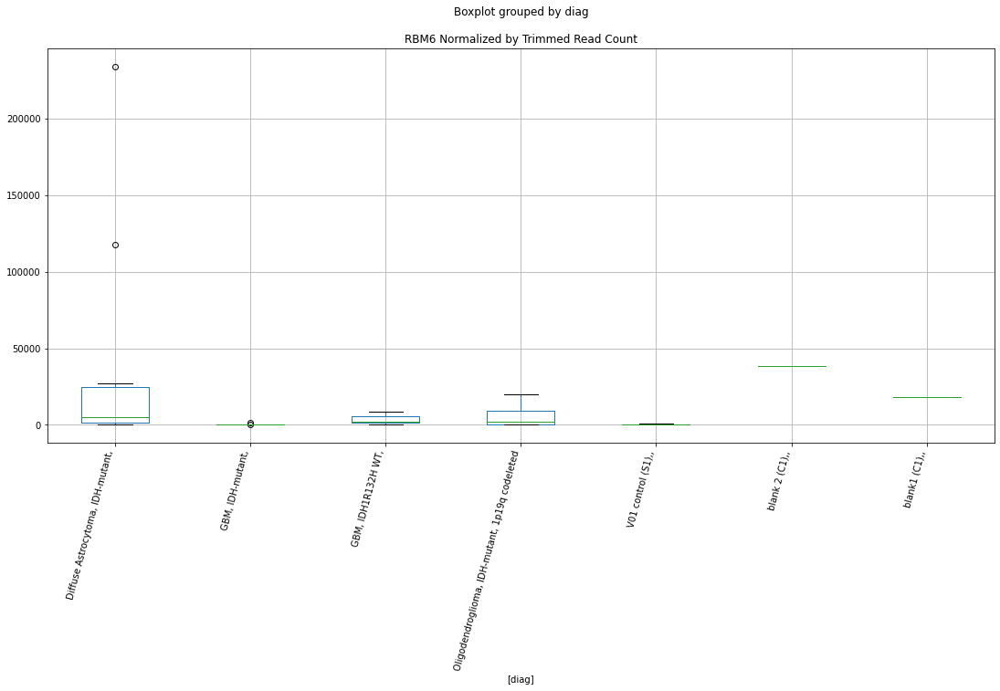

 p : 0.00269800505884393  ( t : 3.4757700818710298 ) :  D-plex  :  bbduk2  :  SNORC
Control and blanks
73     0.0
337    0.0
Name: SNORC, dtype: float64
205    3581.82
Name: SNORC, dtype: float64
469    6506.8
Name: SNORC, dtype: float64


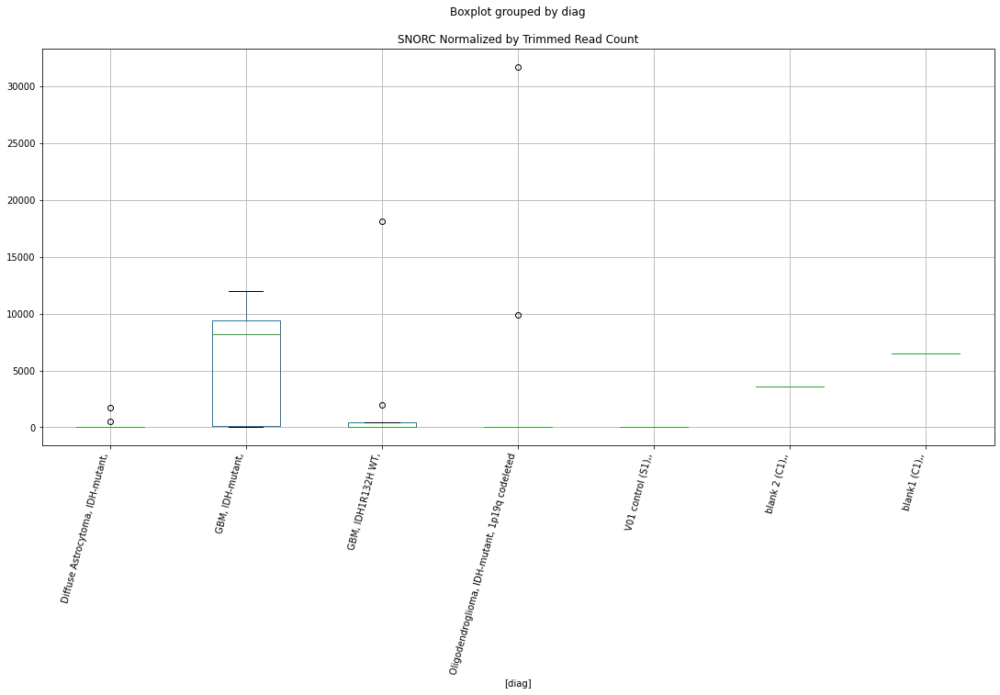

 p : 0.002986653025076685  ( t : 3.4299420533004716 ) :  D-plex  :  cutadapt2  :  SLITRK2
Control and blanks
76     0.0
340    0.0
Name: SLITRK2, dtype: float64
208    6348.97
Name: SLITRK2, dtype: float64
472    6935.47
Name: SLITRK2, dtype: float64


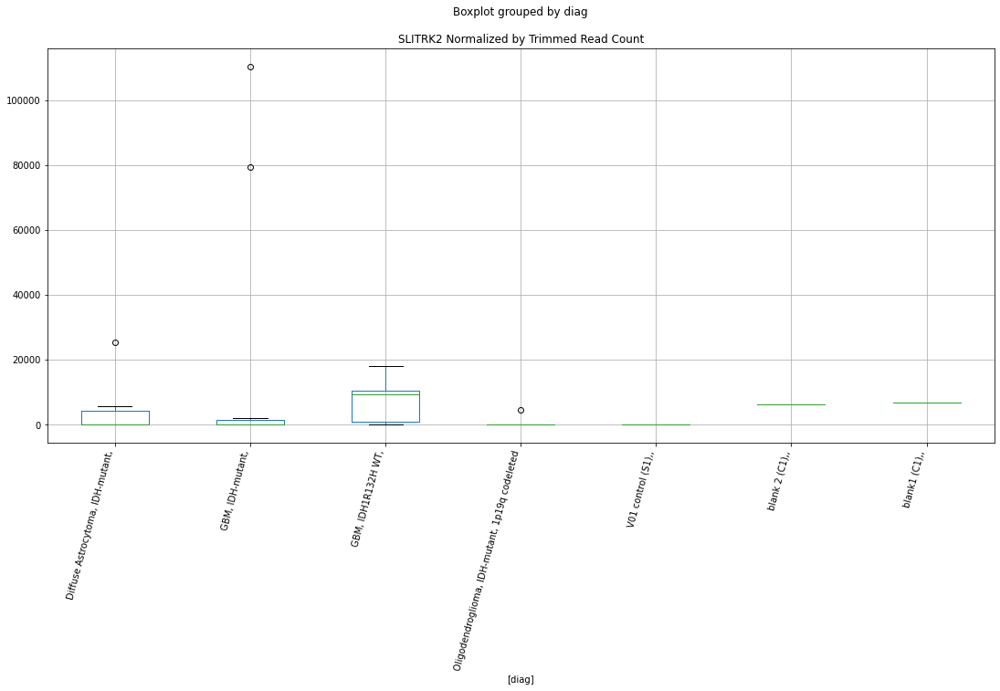

 p : 0.0031776617225312957  ( t : 3.401963343229951 ) :  Lexogen  :  bbduk2  :  RAB25
Control and blanks
79     0.0
343    0.0
Name: RAB25, dtype: float64
211    0.0
Name: RAB25, dtype: float64
475    479.03
Name: RAB25, dtype: float64


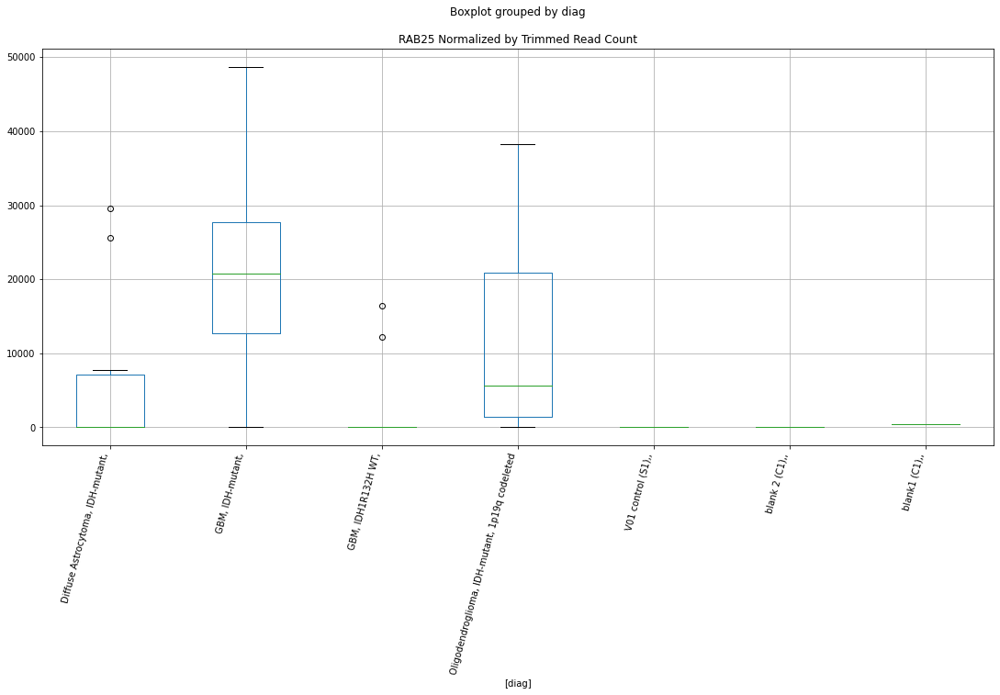

 p : 0.003185754523487767  ( t : 3.4008149008176383 ) :  D-plex  :  bbduk2  :  PLEKHB1
Control and blanks
73     0.0
337    0.0
Name: PLEKHB1, dtype: float64
205    1253.64
Name: PLEKHB1, dtype: float64
469    4140.69
Name: PLEKHB1, dtype: float64


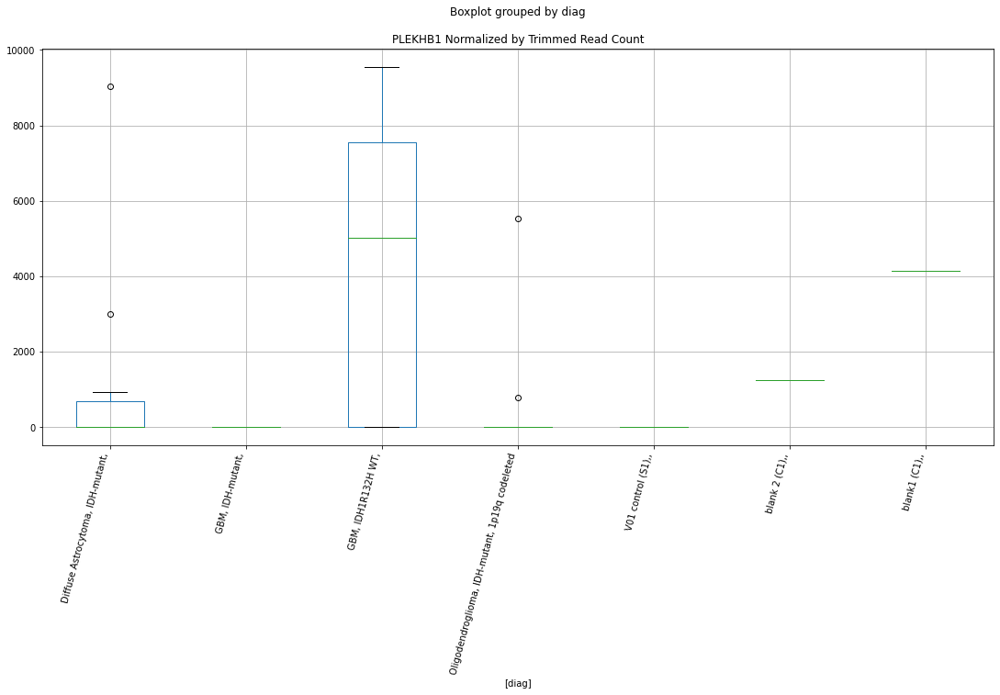

 p : 0.003226656134553768  ( t : 3.395054277511114 ) :  D-plex  :  bbduk2  :  POU2F2
Control and blanks
73         0.00
337    47178.33
Name: POU2F2, dtype: float64
205    42981.83
Name: POU2F2, dtype: float64
469    21294.98
Name: POU2F2, dtype: float64


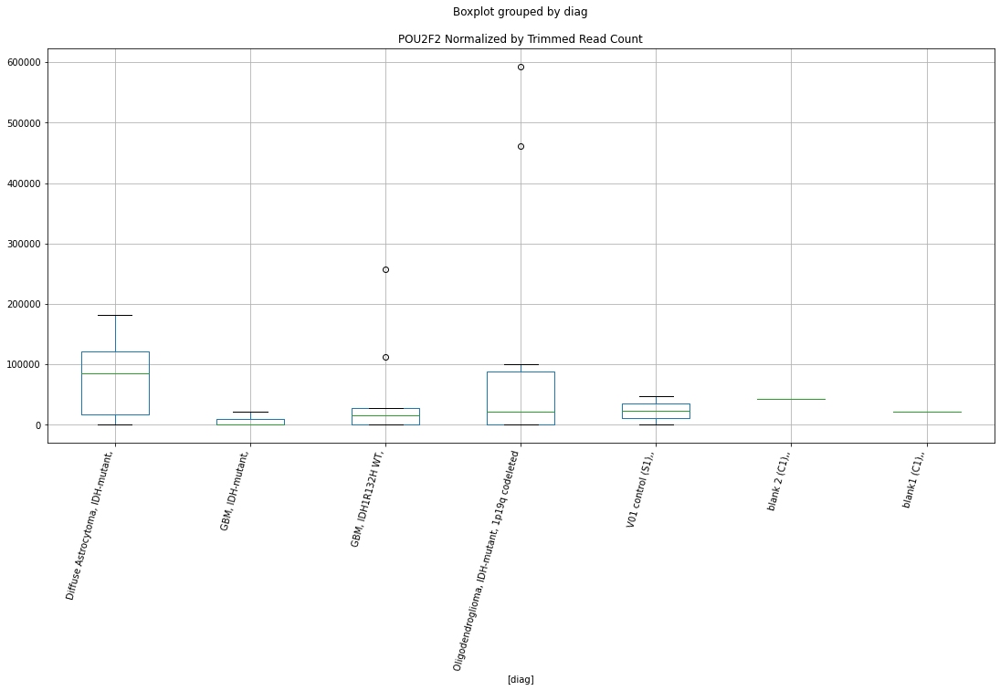

 p : 0.003296202004775431  ( t : 3.385422778908734 ) :  D-plex  :  bbduk2  :  PALM2AKAP2
Control and blanks
73      3865.04
337    73883.05
Name: PALM2AKAP2, dtype: float64
205    20237.28
Name: PALM2AKAP2, dtype: float64
469    12422.07
Name: PALM2AKAP2, dtype: float64


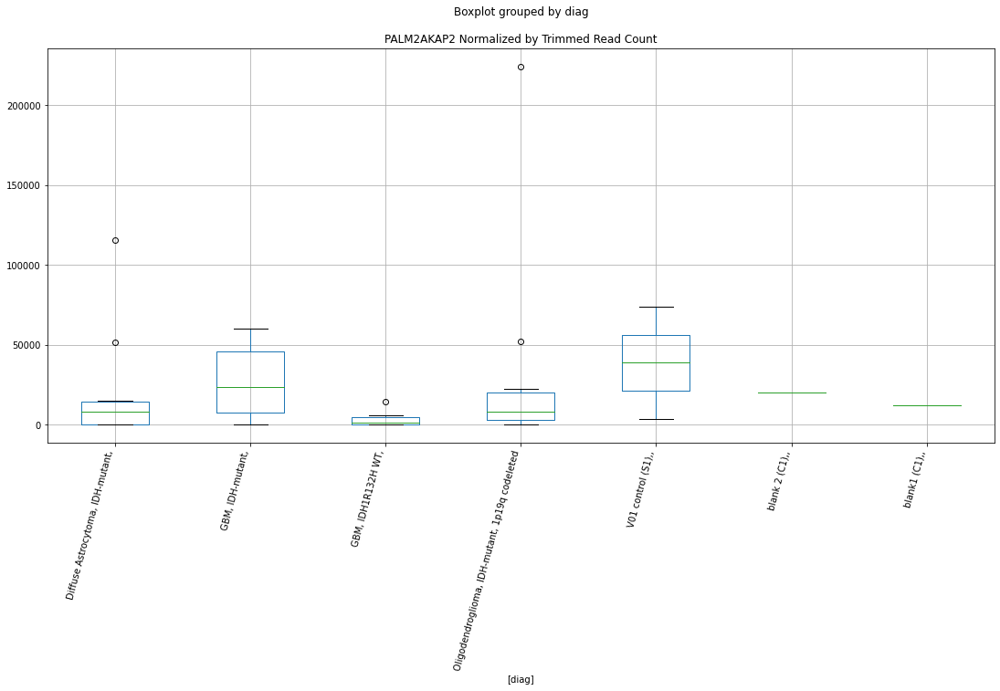

 p : 0.0033460228861361607  ( t : 3.378645458258302 ) :  D-plex  :  cutadapt2  :  RAB11FIP1
Control and blanks
76     0.0
340    0.0
Name: RAB11FIP1, dtype: float64
208    73189.49
Name: RAB11FIP1, dtype: float64
472    3467.74
Name: RAB11FIP1, dtype: float64


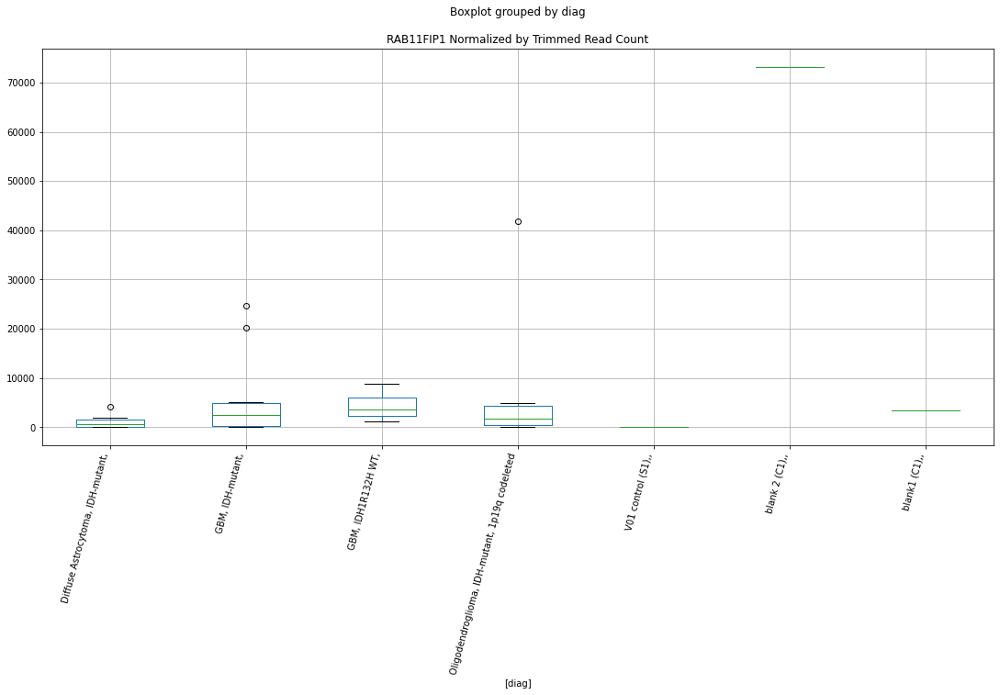

 p : 0.0033840547017114668  ( t : 3.373538487870508 ) :  Lexogen  :  cutadapt2  :  RAB25
Control and blanks
82     0.0
346    0.0
Name: RAB25, dtype: float64
214    0.0
Name: RAB25, dtype: float64
478    474.92
Name: RAB25, dtype: float64


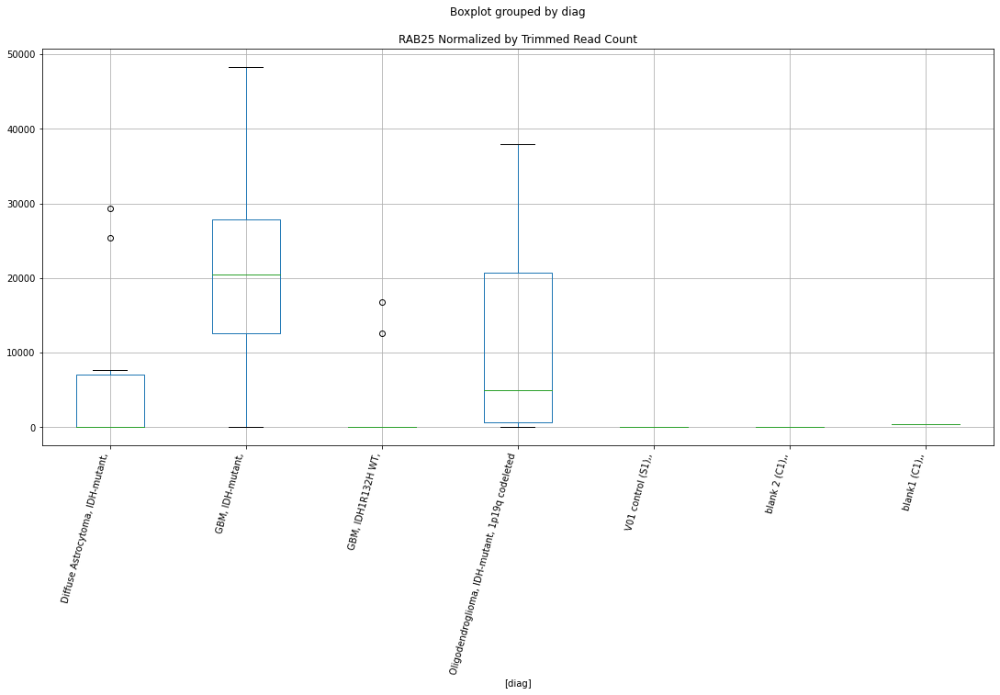

 p : 0.004279934348692297  ( t : 3.267213062098422 ) :  D-plex  :  cutadapt2  :  POU2F2
Control and blanks
76         0.00
340    45798.07
Name: POU2F2, dtype: float64
208    46382.74
Name: POU2F2, dtype: float64
472    20806.41
Name: POU2F2, dtype: float64


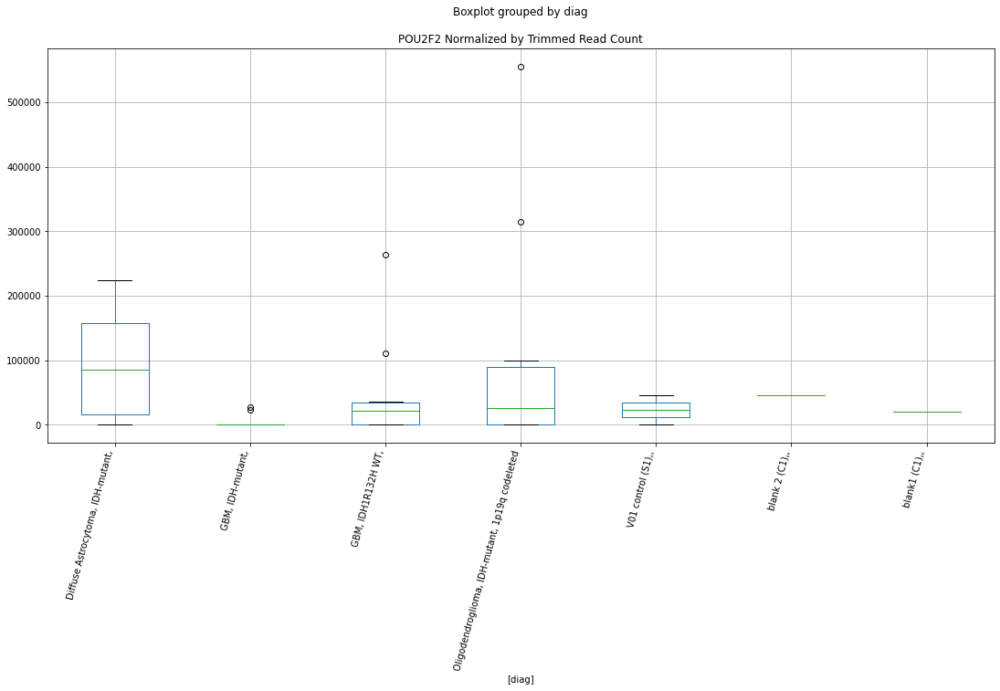

 p : 0.00472696018211038  ( t : 3.2221086316208756 ) :  D-plex  :  cutadapt2  :  PLEKHB1
Control and blanks
76     0.0
340    0.0
Name: PLEKHB1, dtype: float64
208    1234.52
Name: PLEKHB1, dtype: float64
472    4045.69
Name: PLEKHB1, dtype: float64


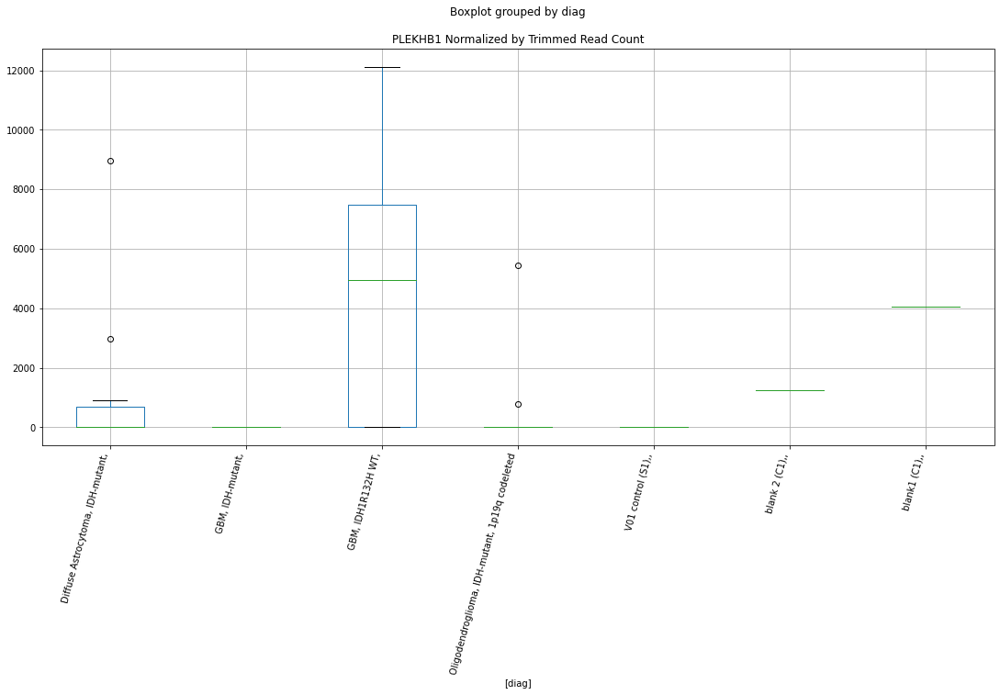

 p : 0.004737605782158649  ( t : 3.2210862871023744 ) :  D-plex  :  cutadapt2  :  PHF23
Control and blanks
76     0.0
340    0.0
Name: PHF23, dtype: float64
208    5819.89
Name: PHF23, dtype: float64
472    577.96
Name: PHF23, dtype: float64


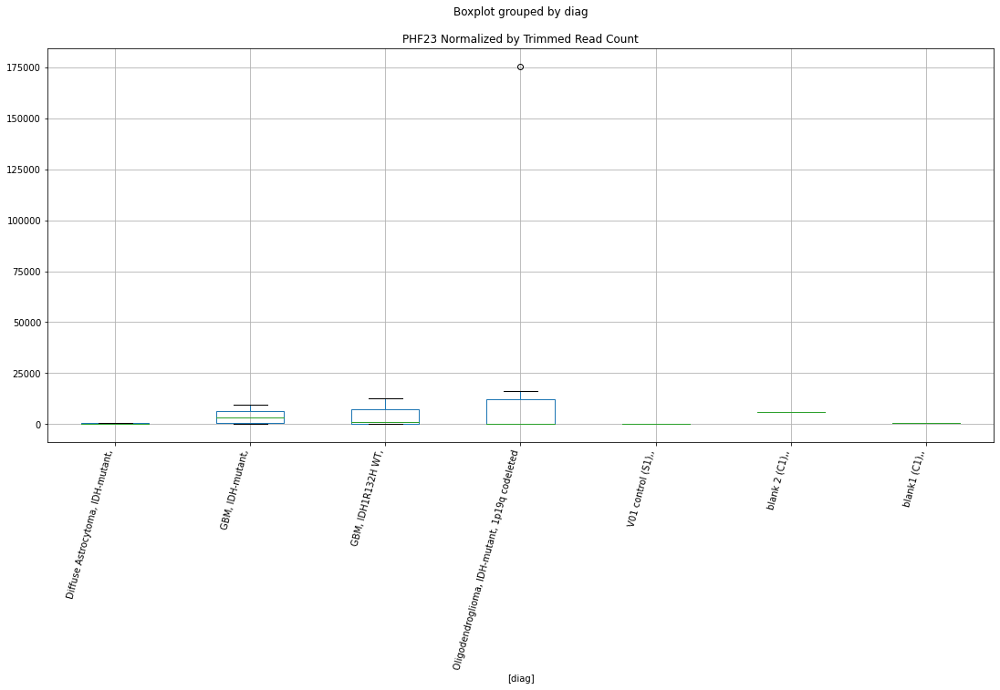

 p : 0.005126408537855493  ( t : 3.185211859885432 ) :  D-plex  :  bbduk2  :  PTPRCAP
Control and blanks
73      8503.09
337    98807.46
Name: PTPRCAP, dtype: float64
205    30803.64
Name: PTPRCAP, dtype: float64
469    334212.93
Name: PTPRCAP, dtype: float64


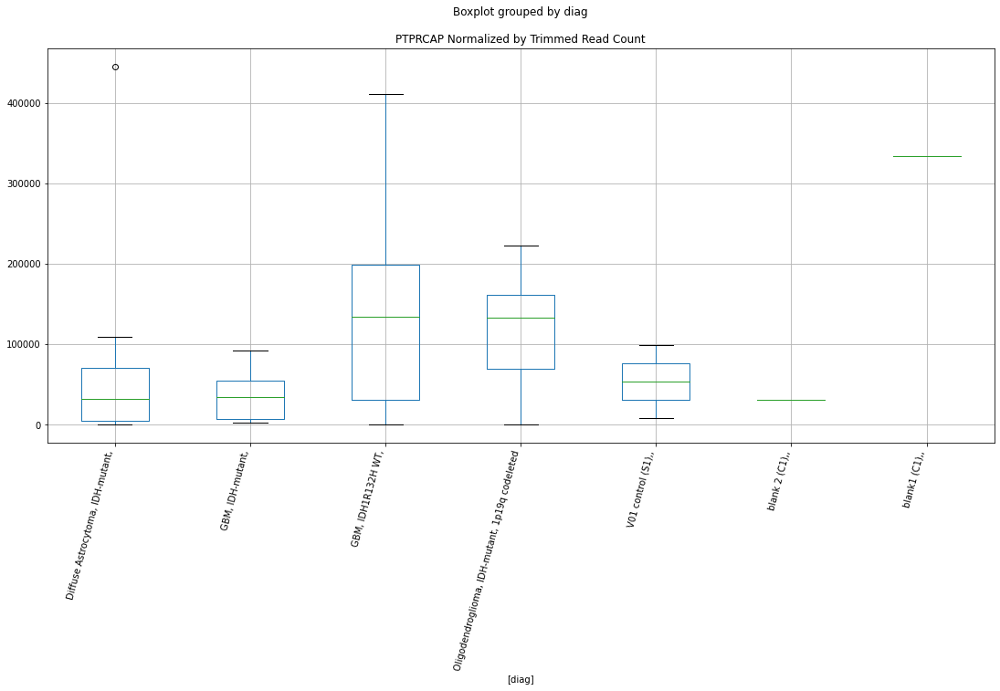

 p : 0.005142296025566482  ( t : 3.183803241232318 ) :  D-plex  :  bbduk2  :  RASSF9
Control and blanks
73     3092.03
337       0.00
Name: RASSF9, dtype: float64
205    2328.18
Name: RASSF9, dtype: float64
469    7098.33
Name: RASSF9, dtype: float64


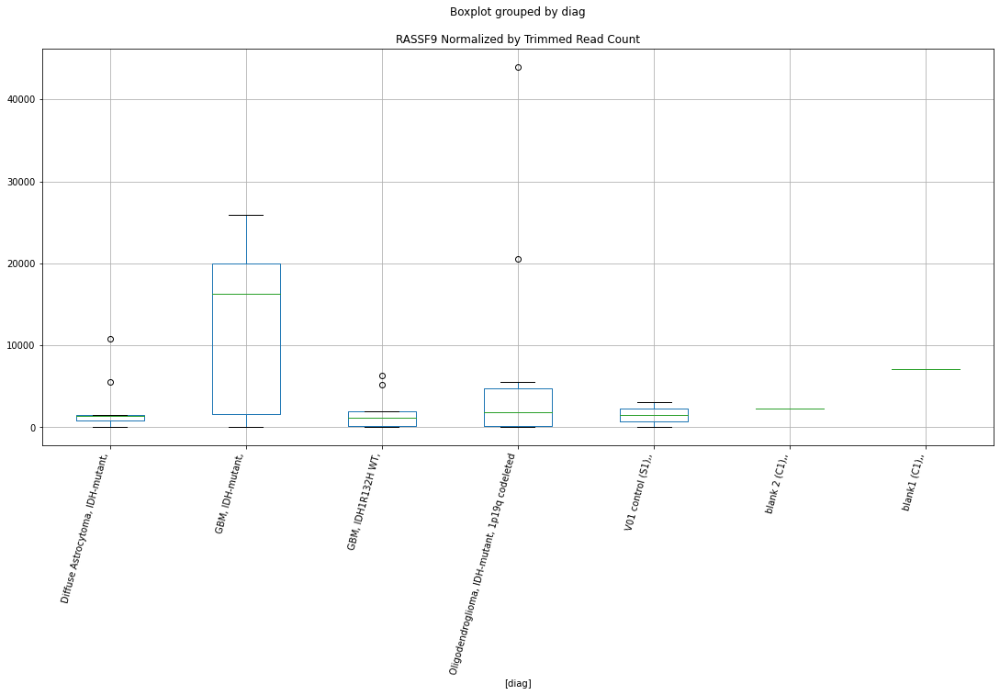

 p : 0.005164551245738267  ( t : 3.1818371915486847 ) :  D-plex  :  cutadapt2  :  PTPRCAP
Control and blanks
76      8333.76
340    97761.27
Name: PTPRCAP, dtype: float64
208    30333.96
Name: PTPRCAP, dtype: float64
472    327700.96
Name: PTPRCAP, dtype: float64


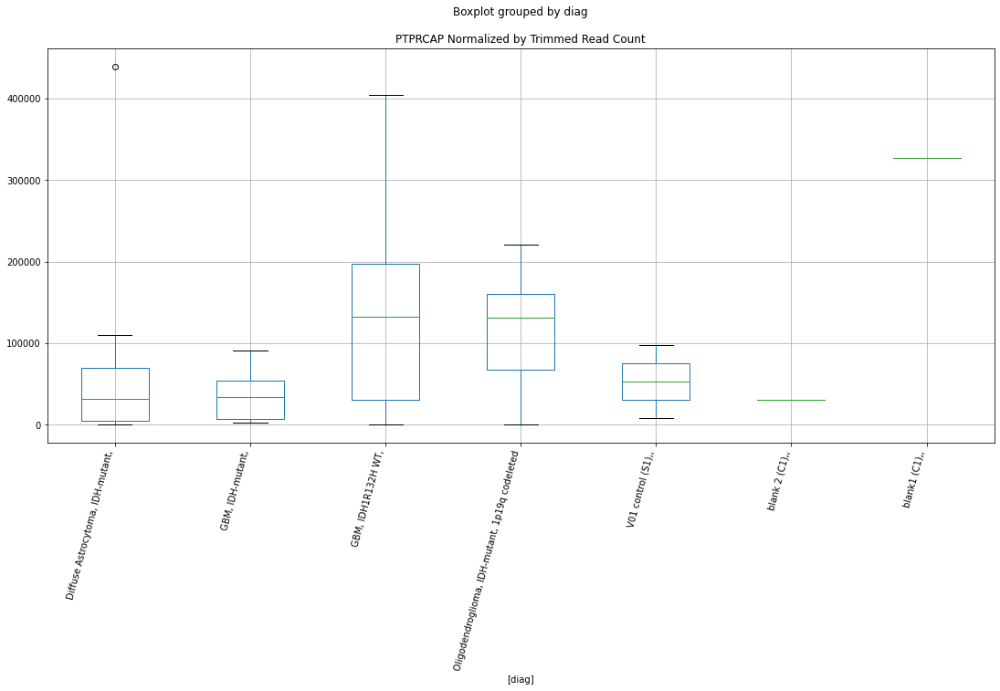

 p : 0.006095253729470362  ( t : 3.106261022159846 ) :  D-plex  :  bbduk2  :  PCDHAC2
Control and blanks
73     0.0
337    0.0
Name: PCDHAC2, dtype: float64
205    716.36
Name: PCDHAC2, dtype: float64
469    2366.11
Name: PCDHAC2, dtype: float64


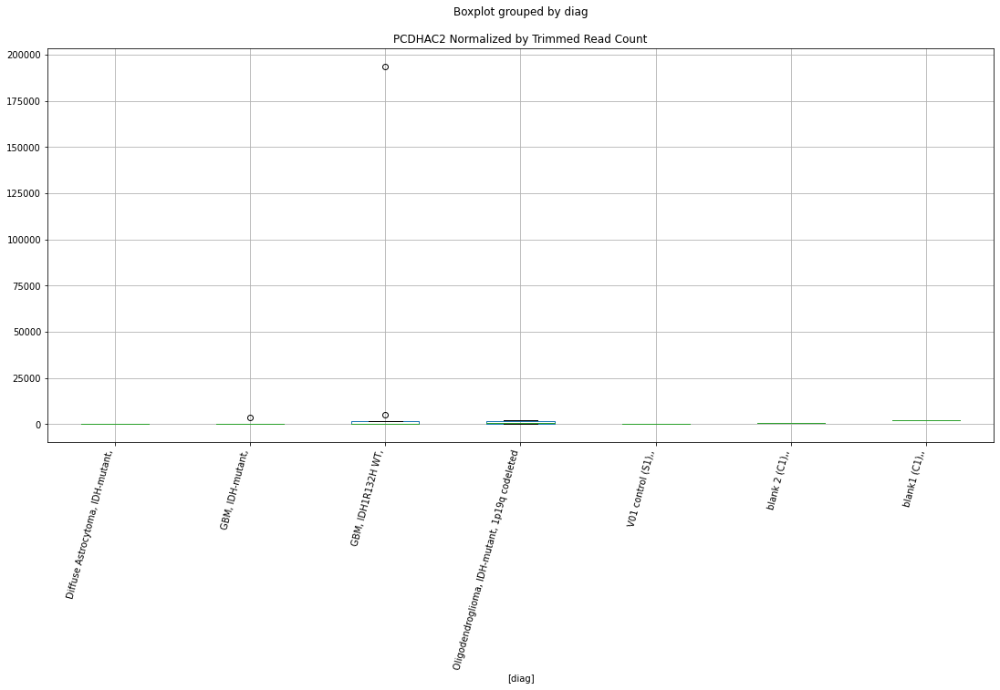

 p : 0.0061250106412170345  ( t : 3.1040352072783883 ) :  D-plex  :  bbduk2  :  RIMS3
Control and blanks
73     0.0
337    0.0
Name: RIMS3, dtype: float64
205    2865.46
Name: RIMS3, dtype: float64
469    4732.22
Name: RIMS3, dtype: float64


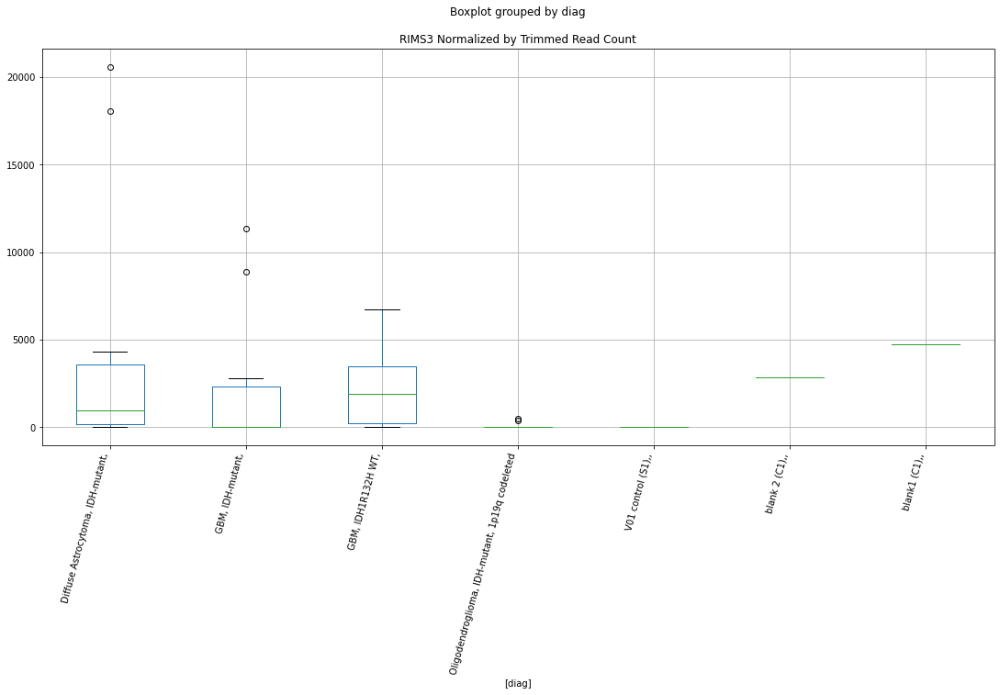

 p : 0.0061720495352421915  ( t : 3.100538126255283 ) :  D-plex  :  cutadapt2  :  RASSF9
Control and blanks
76     3030.46
340       0.00
Name: RASSF9, dtype: float64
208    2292.68
Name: RASSF9, dtype: float64
472    6935.47
Name: RASSF9, dtype: float64


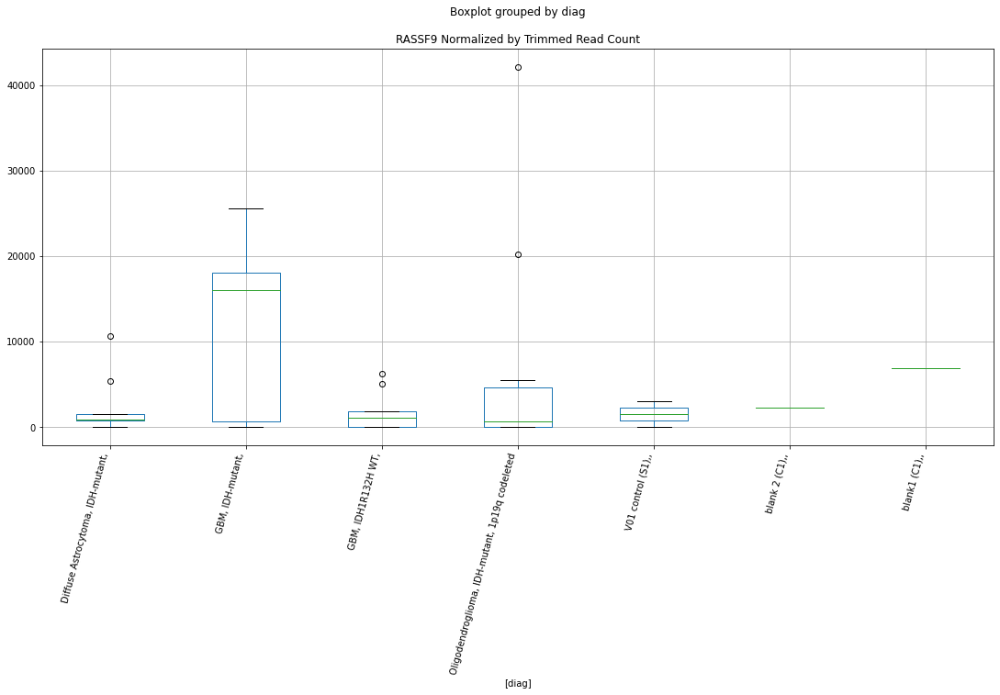

 p : 0.0064307132188752905  ( t : 3.0817604343810254 ) :  Lexogen  :  bbduk2  :  ROBO2
Control and blanks
79         0.00
343    13163.49
Name: ROBO2, dtype: float64
211    0.0
Name: ROBO2, dtype: float64
475    7424.99
Name: ROBO2, dtype: float64


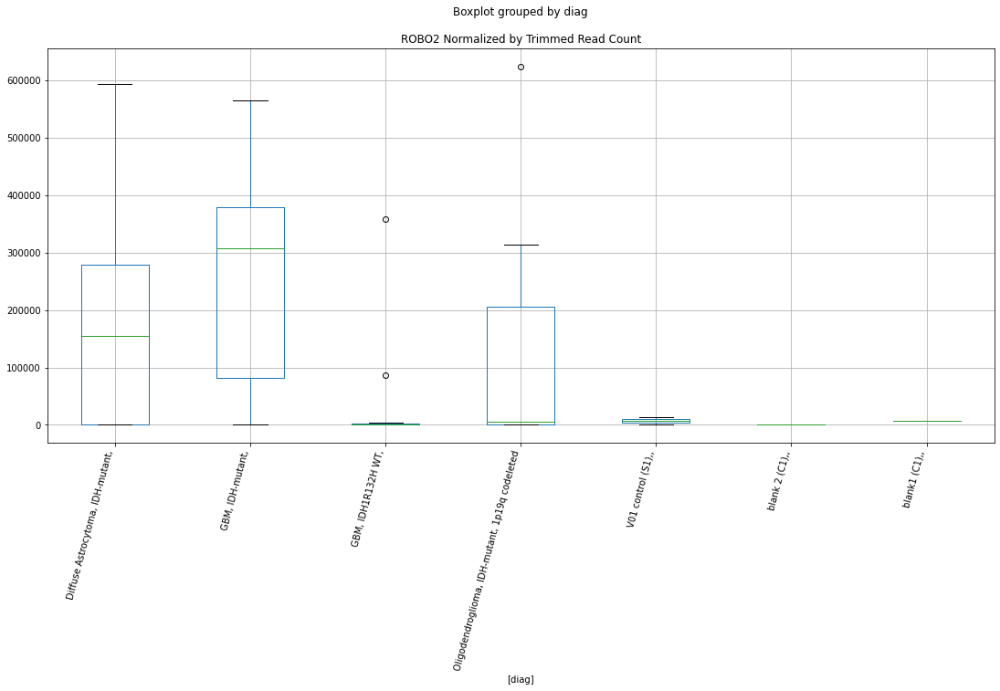

 p : 0.006878436554823846  ( t : 3.050932837538514 ) :  Lexogen  :  cutadapt2  :  ROBO2
Control and blanks
82         0.00
346    15151.29
Name: ROBO2, dtype: float64
214    0.0
Name: ROBO2, dtype: float64
478    7361.27
Name: ROBO2, dtype: float64


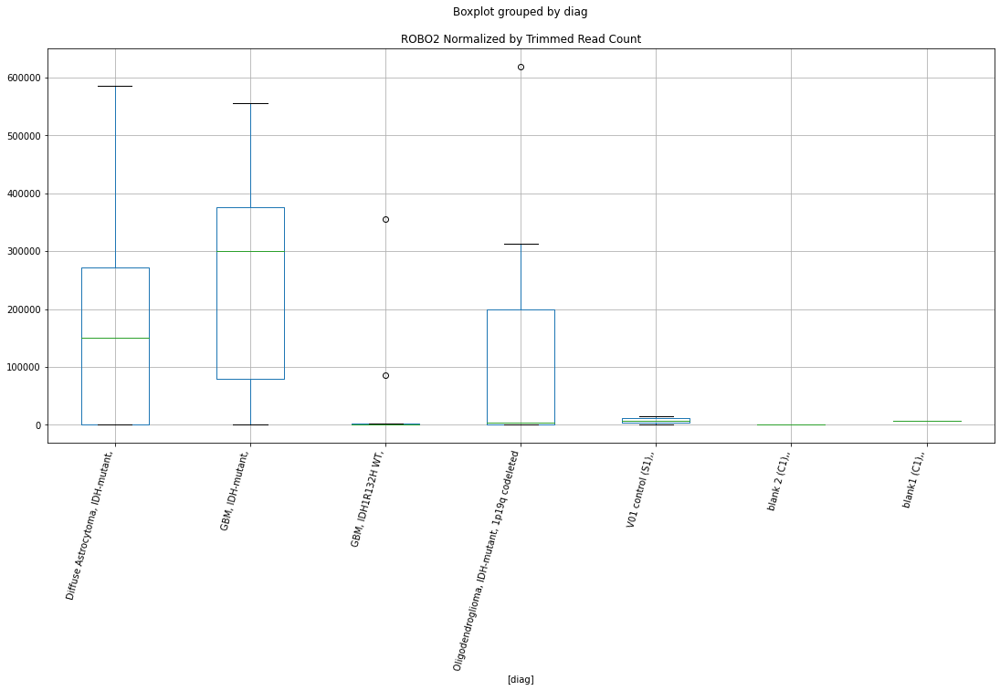

 p : 0.007135634124609691  ( t : 3.0340956268608172 ) :  D-plex  :  bbduk2  :  RPS27L
Control and blanks
73     0.0
337    0.0
Name: RPS27L, dtype: float64
205    1074.55
Name: RPS27L, dtype: float64
469    2366.11
Name: RPS27L, dtype: float64


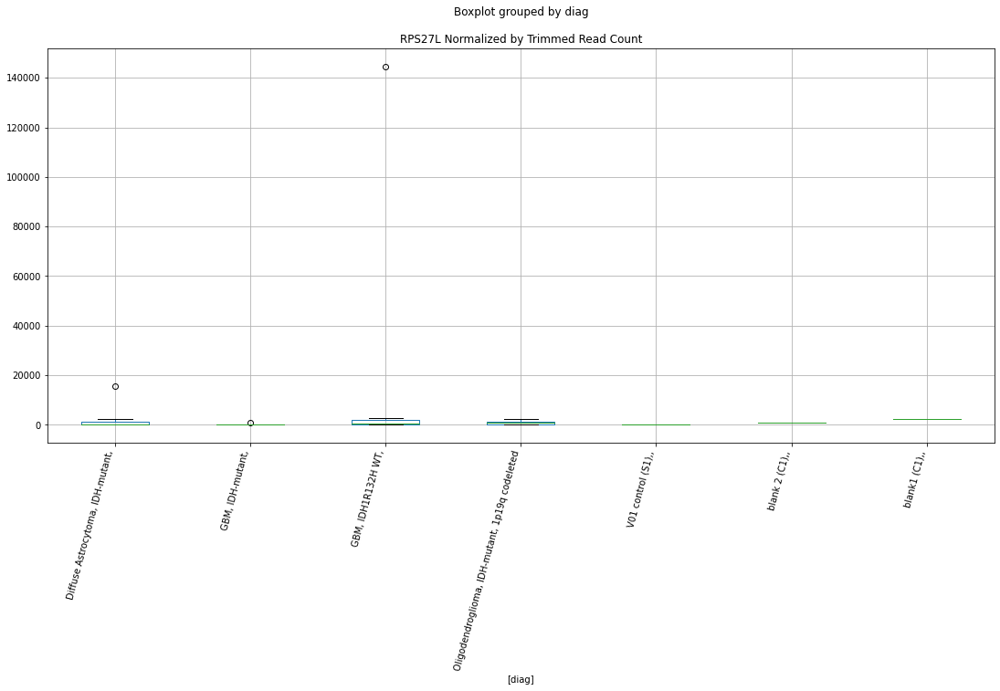

 p : 0.00737104526286178  ( t : 3.0191941066922006 ) :  D-plex  :  bbduk2  :  PM20D2
Control and blanks
73     0.0
337    0.0
Name: PM20D2, dtype: float64
205    2686.36
Name: PM20D2, dtype: float64
469    6506.8
Name: PM20D2, dtype: float64


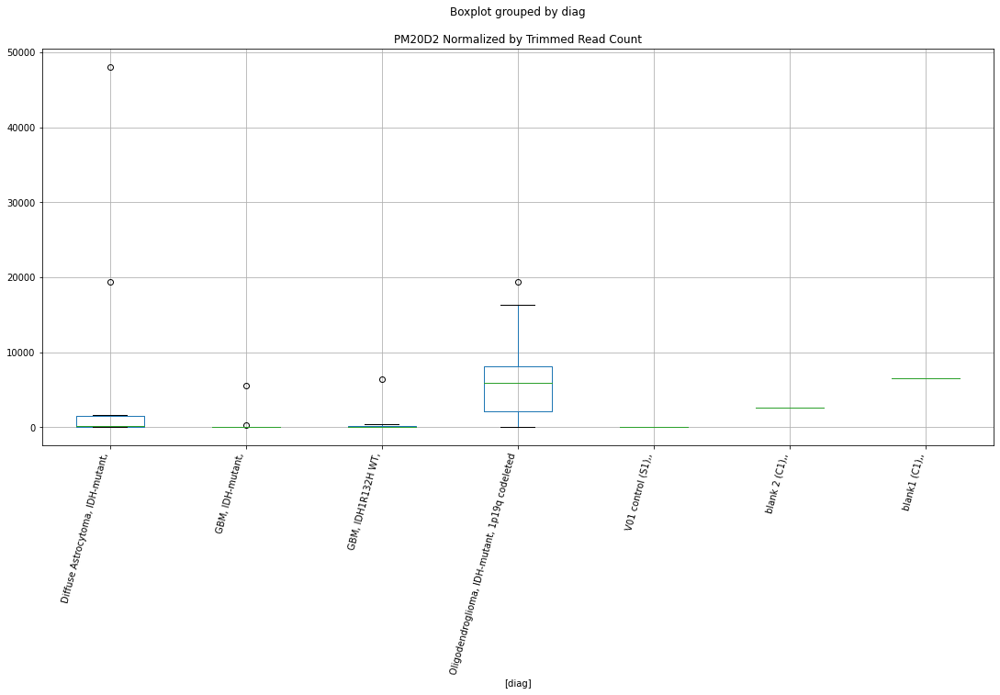

 p : 0.007789672704706444  ( t : 2.9938022774147868 ) :  D-plex  :  cutadapt2  :  POMC
Control and blanks
76     6060.91
340       0.00
Name: POMC, dtype: float64
208    7759.85
Name: POMC, dtype: float64
472    13292.98
Name: POMC, dtype: float64


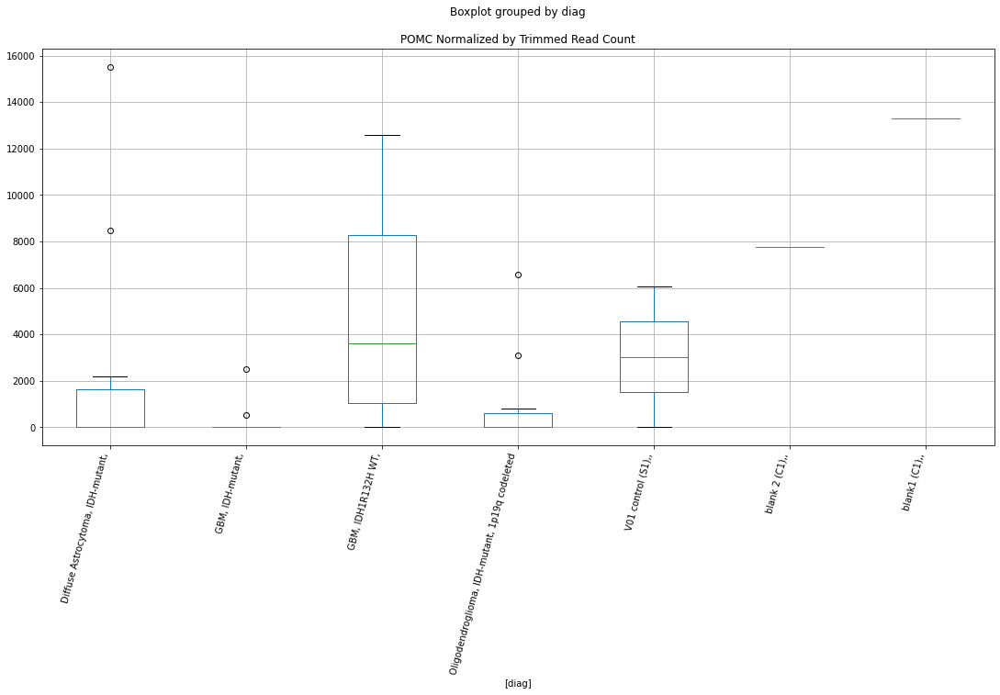

 p : 0.007874960157458945  ( t : 2.9887919789009443 ) :  Lexogen  :  bbduk2  :  SELL
Control and blanks
79     0.0
343    0.0
Name: SELL, dtype: float64
211    0.0
Name: SELL, dtype: float64
475    0.0
Name: SELL, dtype: float64


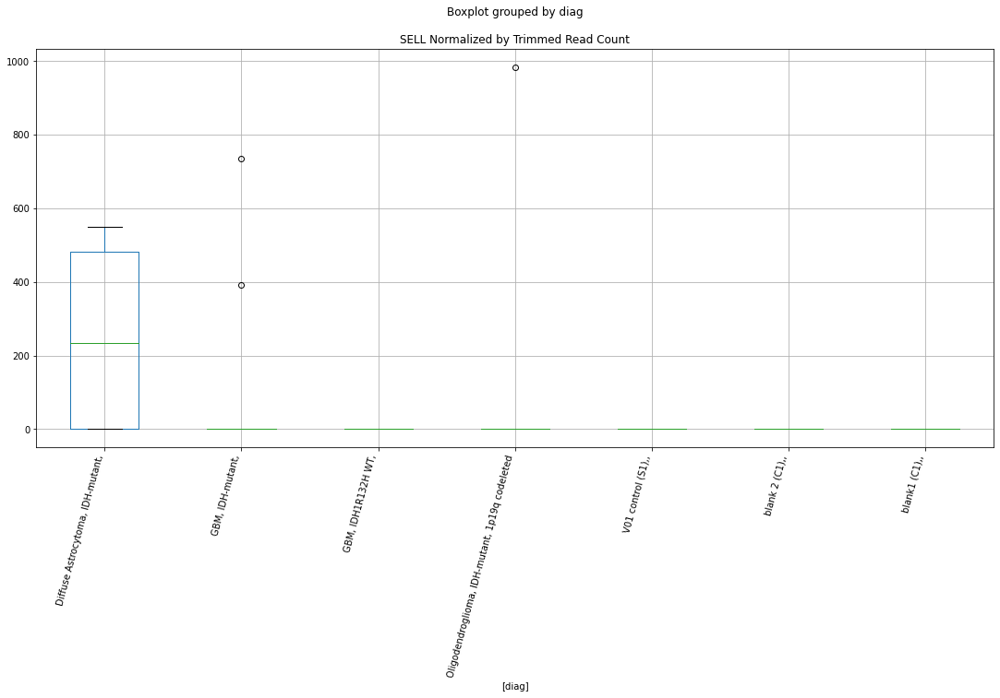

 p : 0.00805929741567664  ( t : 2.978140369166568 ) :  D-plex  :  bbduk2  :  PCDHB10
Control and blanks
73     0.0
337    0.0
Name: PCDHB10, dtype: float64
205    30266.37
Name: PCDHB10, dtype: float64
469    591.53
Name: PCDHB10, dtype: float64


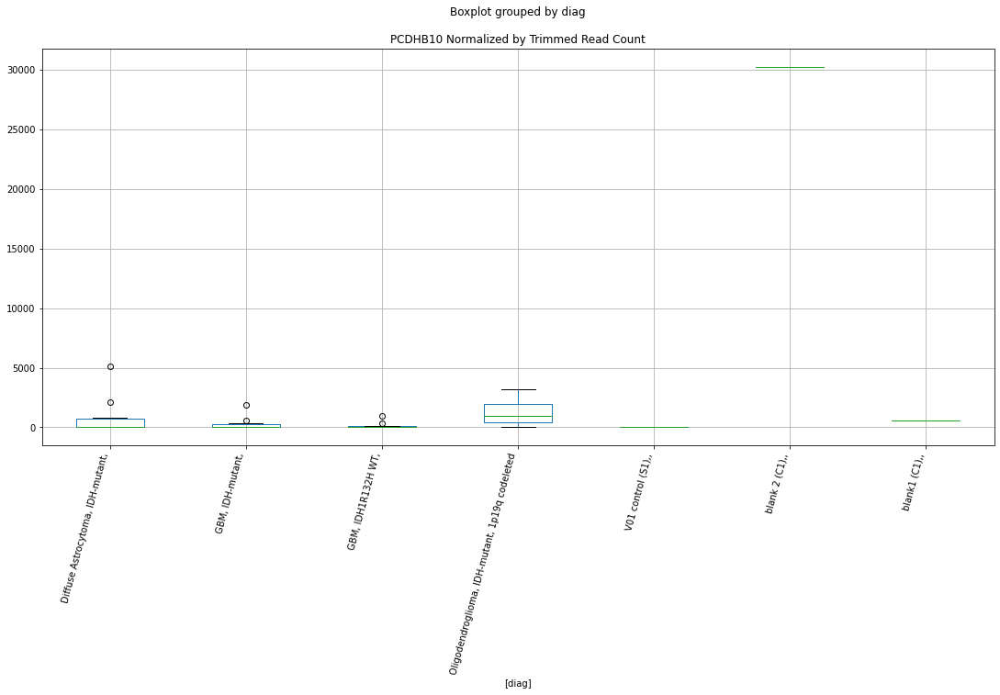

 p : 0.008172007266528444  ( t : 2.9717434279324855 ) :  D-plex  :  cutadapt2  :  SNX5
Control and blanks
76     0.0
340    0.0
Name: SNX5, dtype: float64
208    529.08
Name: SNX5, dtype: float64
472    3467.74
Name: SNX5, dtype: float64


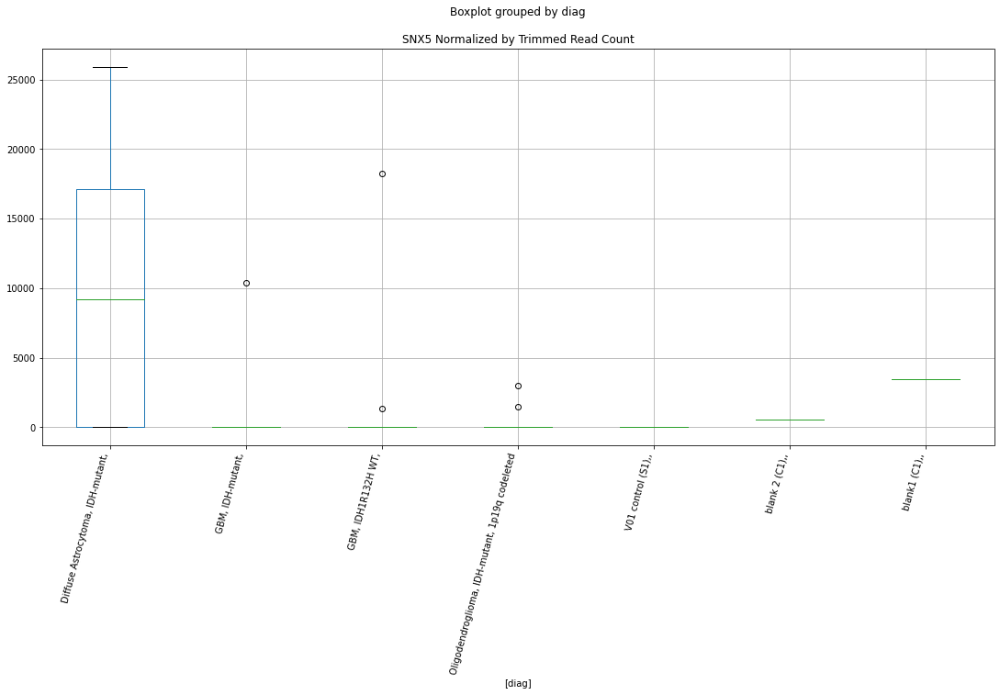

 p : 0.008258654896497136  ( t : 2.9668835612907754 ) :  D-plex  :  bbduk2  :  SNX5
Control and blanks
73     0.0
337    0.0
Name: SNX5, dtype: float64
205    537.27
Name: SNX5, dtype: float64
469    3549.16
Name: SNX5, dtype: float64


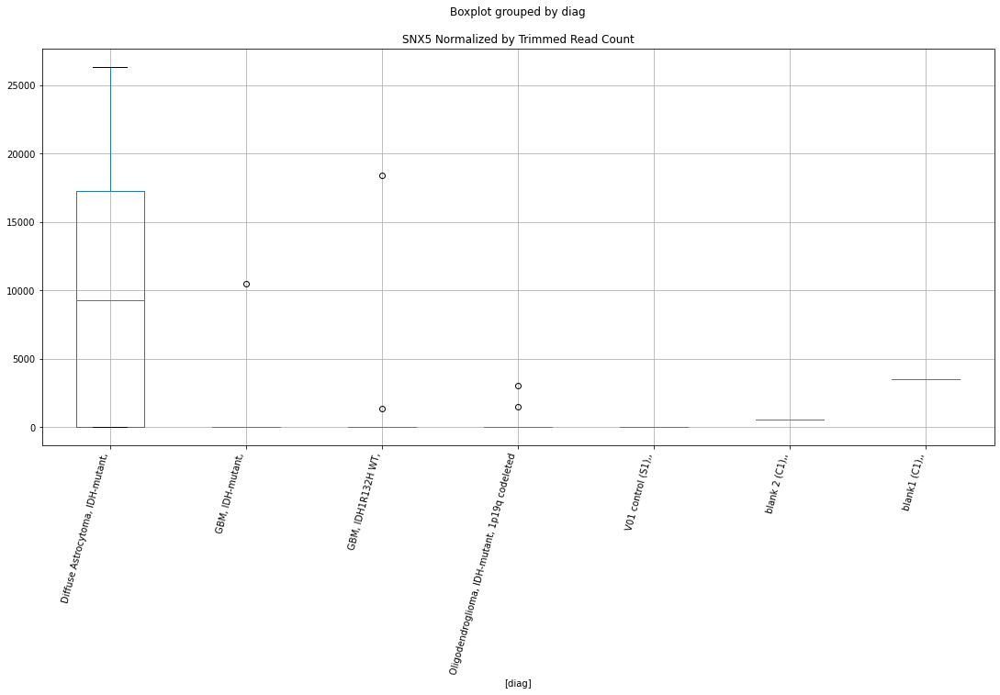

 p : 0.008365245956703233  ( t : 2.960972457315351 ) :  D-plex  :  cutadapt2  :  SIPA1L2
Control and blanks
76     5303.30
340    1761.46
Name: SIPA1L2, dtype: float64
208    18870.54
Name: SIPA1L2, dtype: float64
472    9825.25
Name: SIPA1L2, dtype: float64


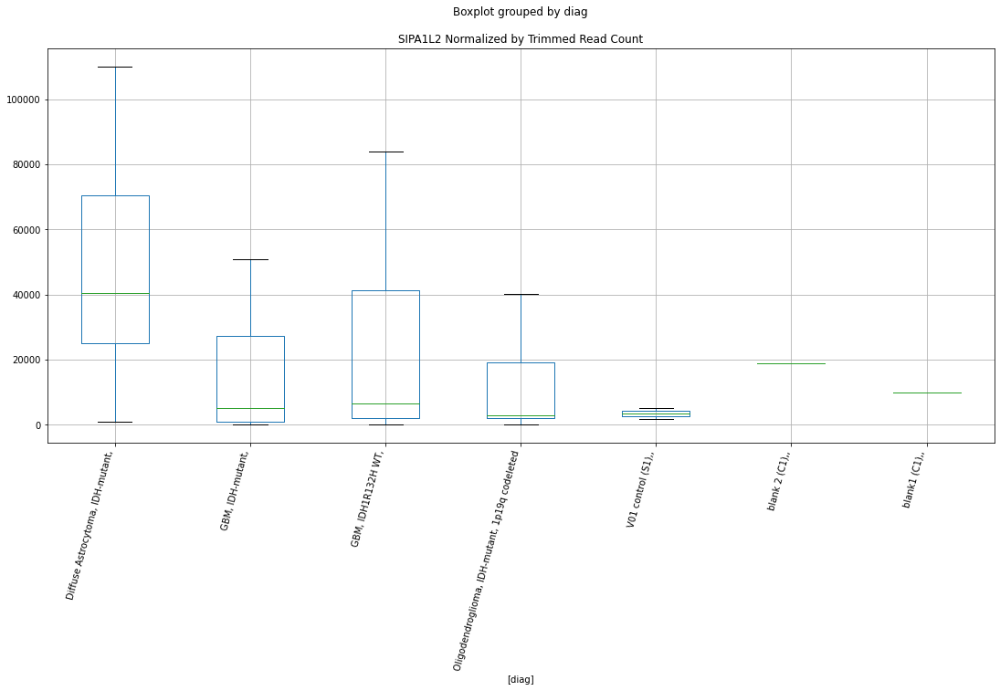

 p : 0.008686234638645238  ( t : 2.9436026176018775 ) :  D-plex  :  cutadapt2  :  PAIP2
Control and blanks
76     0.0
340    0.0
Name: PAIP2, dtype: float64
208    352.72
Name: PAIP2, dtype: float64
472    1733.87
Name: PAIP2, dtype: float64


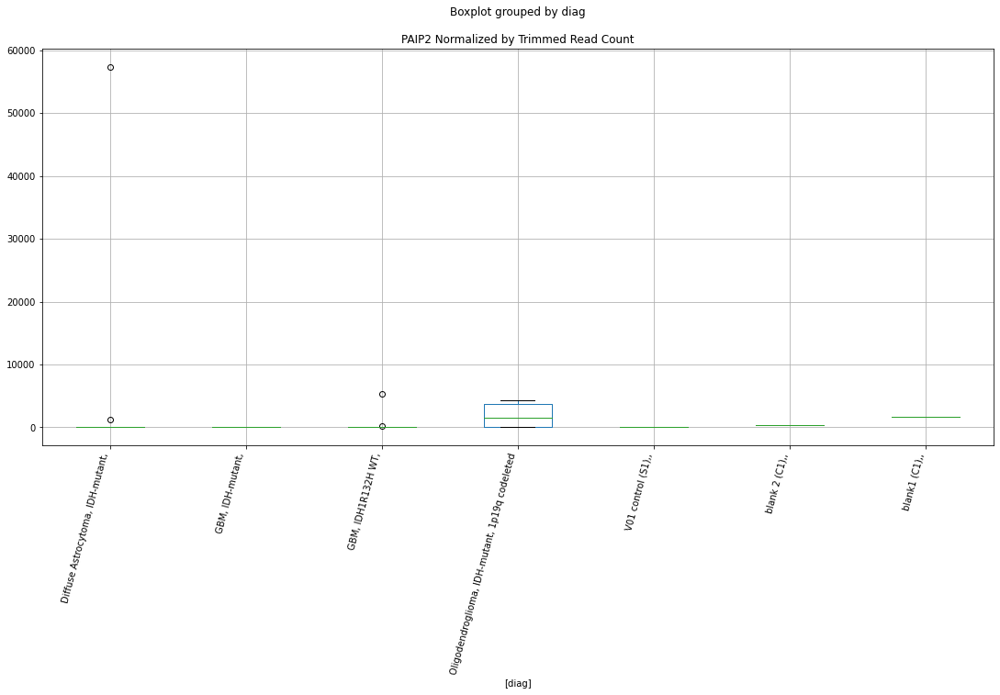

 p : 0.008839411652138762  ( t : 2.9355316224259496 ) :  D-plex  :  bbduk2  :  POMC
Control and blanks
73     6184.07
337       0.00
Name: POMC, dtype: float64
205    7880.0
Name: POMC, dtype: float64
469    13605.13
Name: POMC, dtype: float64


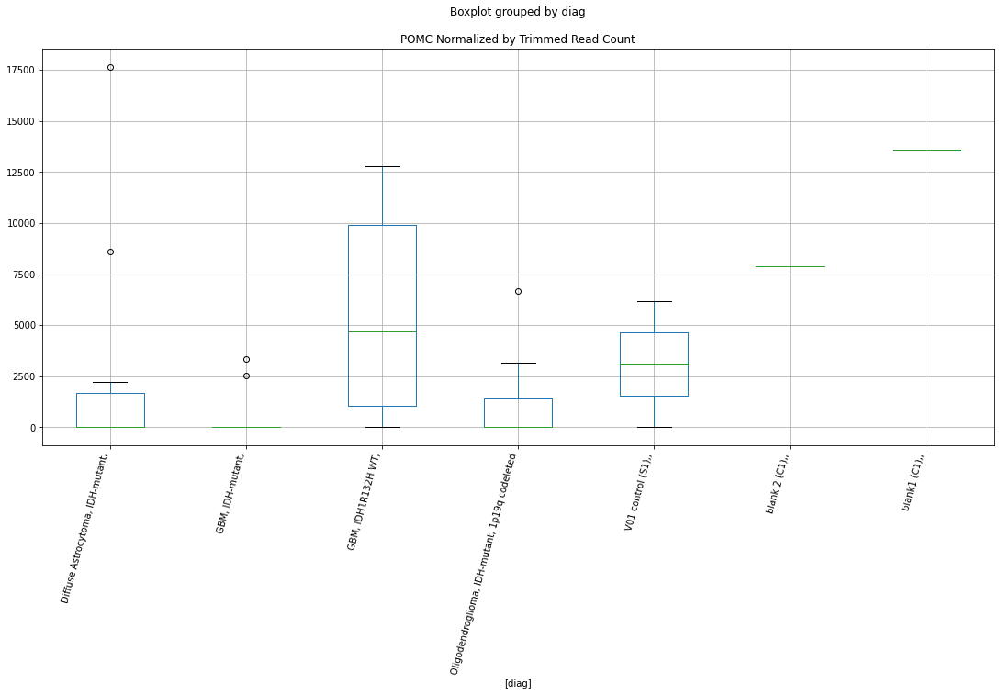

 p : 0.008922091056954297  ( t : 2.931231265613516 ) :  D-plex  :  bbduk2  :  RASSF9
Control and blanks
73     3092.03
337       0.00
Name: RASSF9, dtype: float64
205    2328.18
Name: RASSF9, dtype: float64
469    7098.33
Name: RASSF9, dtype: float64


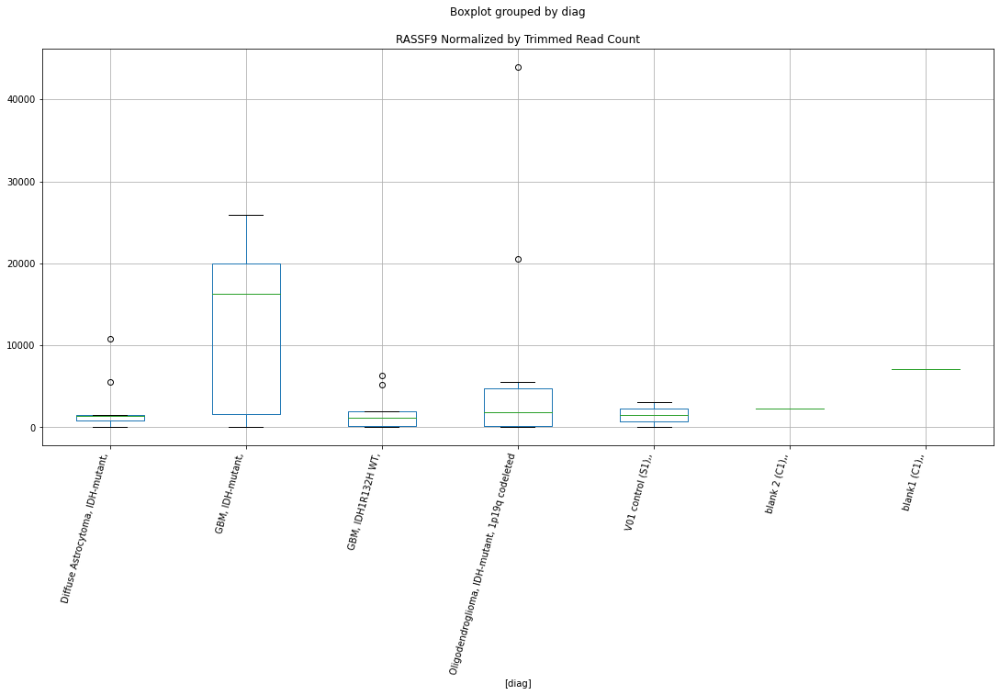

 p : 0.008957372494852286  ( t : 2.929407918339133 ) :  D-plex  :  bbduk2  :  PM20D2
Control and blanks
73     0.0
337    0.0
Name: PM20D2, dtype: float64
205    2686.36
Name: PM20D2, dtype: float64
469    6506.8
Name: PM20D2, dtype: float64


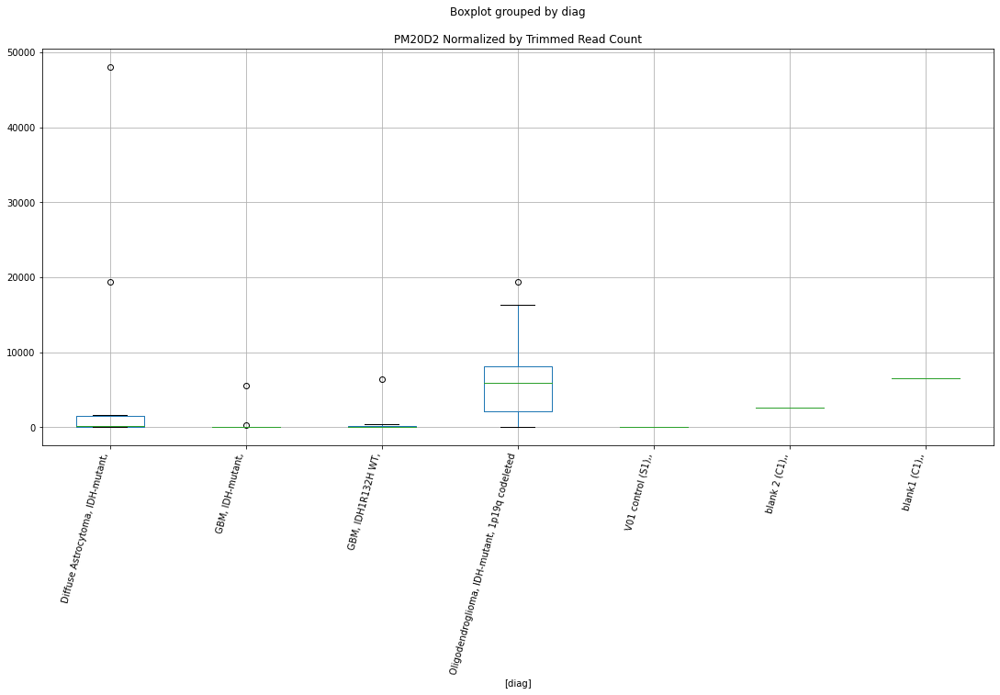

 p : 0.009014412057227283  ( t : 2.9264747548473786 ) :  D-plex  :  cutadapt2  :  SIPA1L3
Control and blanks
76     156826.14
340         0.00
Name: SIPA1L3, dtype: float64
208    15872.42
Name: SIPA1L3, dtype: float64
472    25430.06
Name: SIPA1L3, dtype: float64


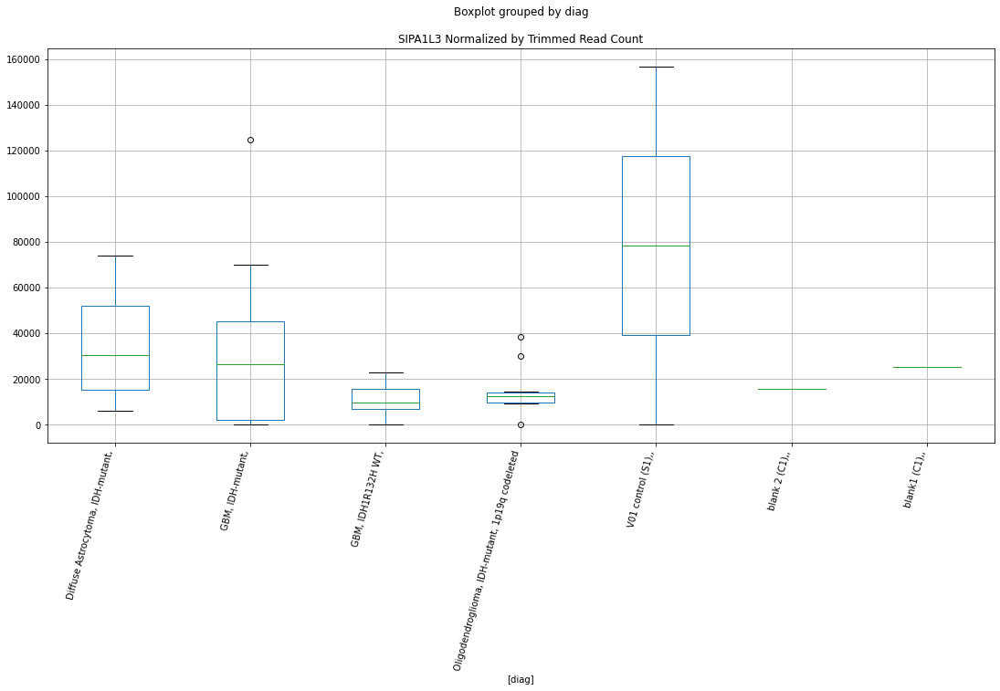

 p : 0.009240888667791962  ( t : 2.915003032277323 ) :  Lexogen  :  cutadapt2  :  PSD3
Control and blanks
82        0.00
346    1683.48
Name: PSD3, dtype: float64
214    2169.81
Name: PSD3, dtype: float64
478    5699.05
Name: PSD3, dtype: float64


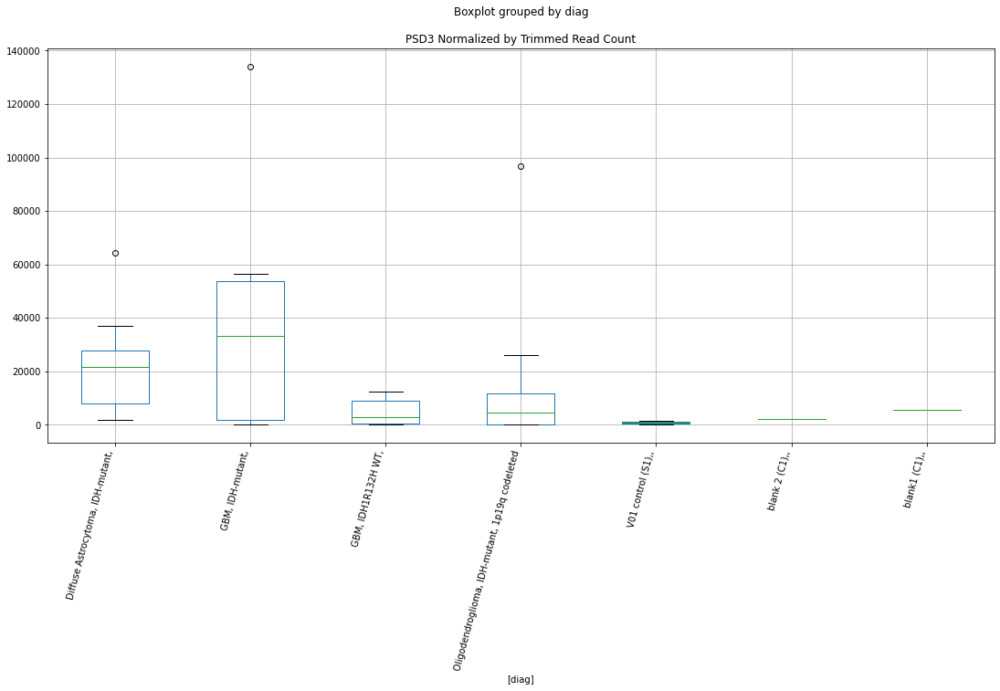

 p : 0.009459176259247262  ( t : 2.9042005064730922 ) :  D-plex  :  bbduk2  :  RNF19A
Control and blanks
73         0.00
337    50738.96
Name: RNF19A, dtype: float64
205    11103.64
Name: RNF19A, dtype: float64
469    0.0
Name: RNF19A, dtype: float64


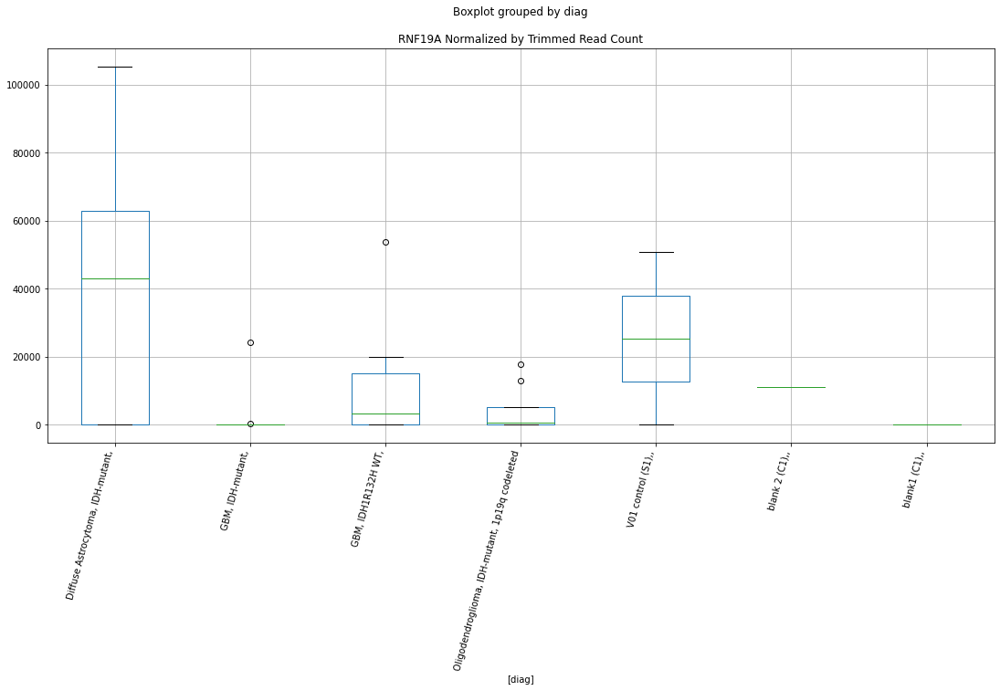

 p : 0.00946160070482046  ( t : 2.904081884429963 ) :  D-plex  :  cutadapt2  :  RNGTT
Control and blanks
76     4545.69
340       0.00
Name: RNGTT, dtype: float64
208    23279.55
Name: RNGTT, dtype: float64
472    24274.15
Name: RNGTT, dtype: float64


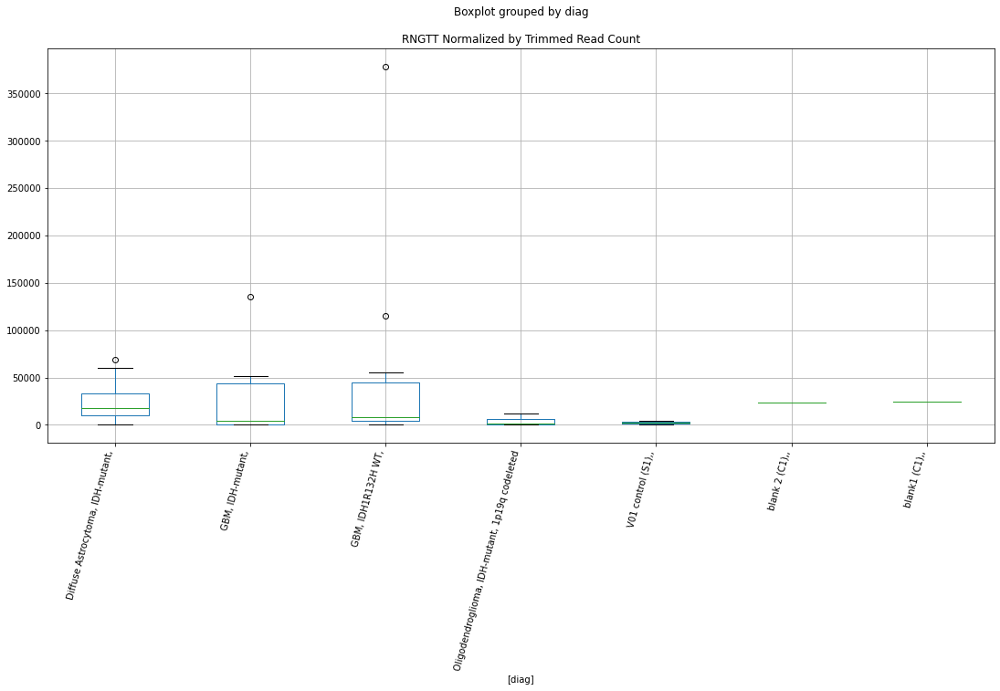

 p : 0.009606161885131323  ( t : 2.8970614215634627 ) :  Lexogen  :  cutadapt2  :  RIMBP3B
Control and blanks
82     0.0
346    0.0
Name: RIMBP3B, dtype: float64
214    0.0
Name: RIMBP3B, dtype: float64
478    237.46
Name: RIMBP3B, dtype: float64


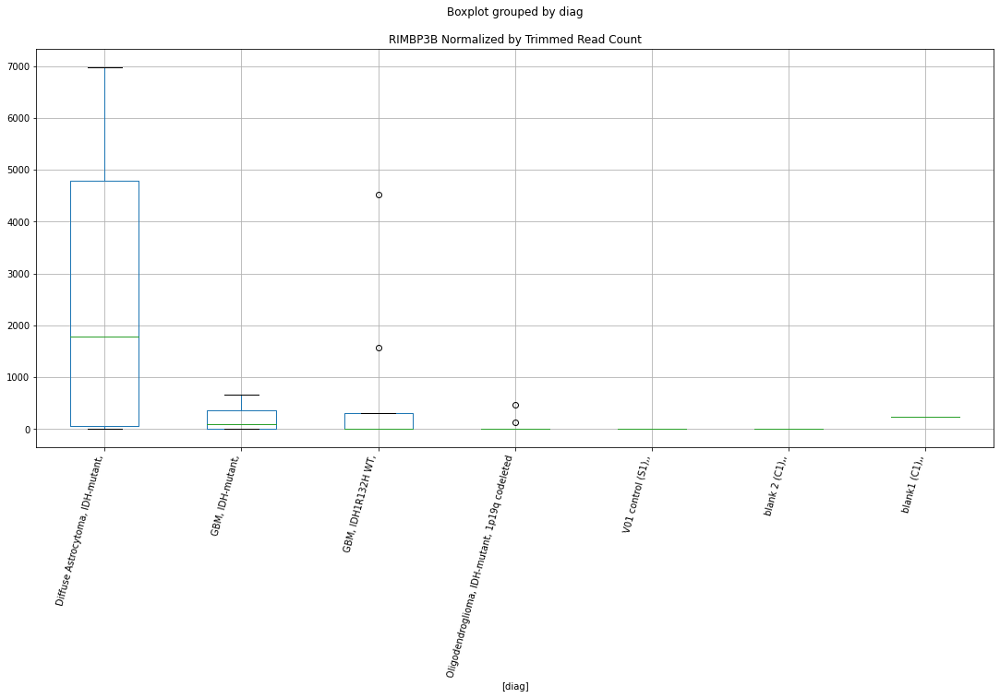

 p : 0.009606161885131323  ( t : 2.8970614215634627 ) :  Lexogen  :  cutadapt2  :  RIMBP3C
Control and blanks
82     0.0
346    0.0
Name: RIMBP3C, dtype: float64
214    0.0
Name: RIMBP3C, dtype: float64
478    237.46
Name: RIMBP3C, dtype: float64


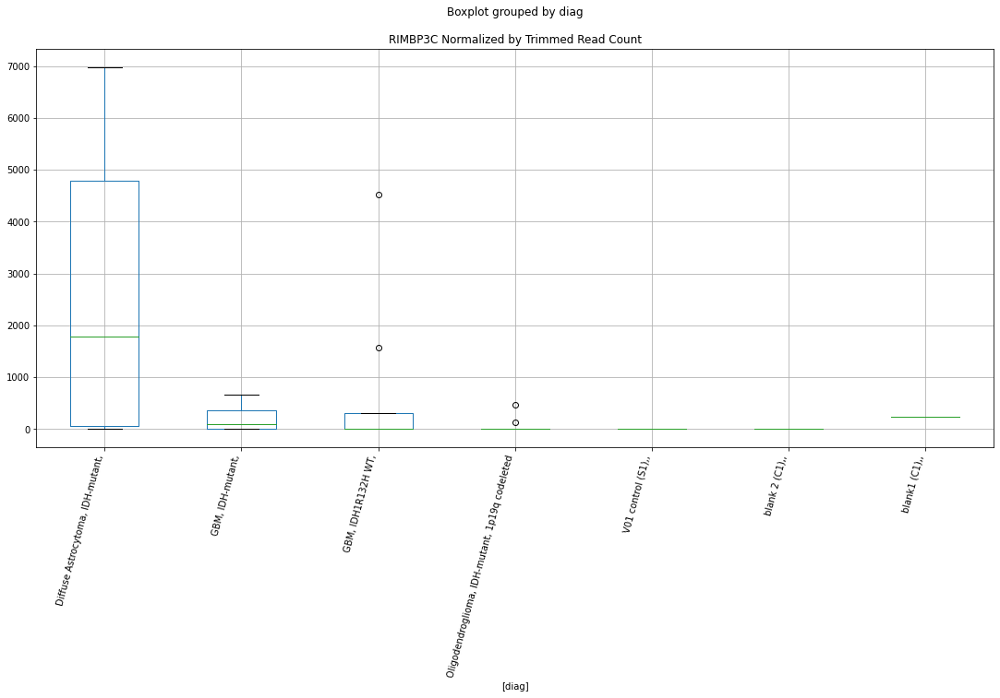

 p : 0.009635350716182278  ( t : 2.895656287179688 ) :  Lexogen  :  bbduk2  :  RIMBP3B
Control and blanks
79       0.00
343    212.31
Name: RIMBP3B, dtype: float64
211    0.0
Name: RIMBP3B, dtype: float64
475    239.52
Name: RIMBP3B, dtype: float64


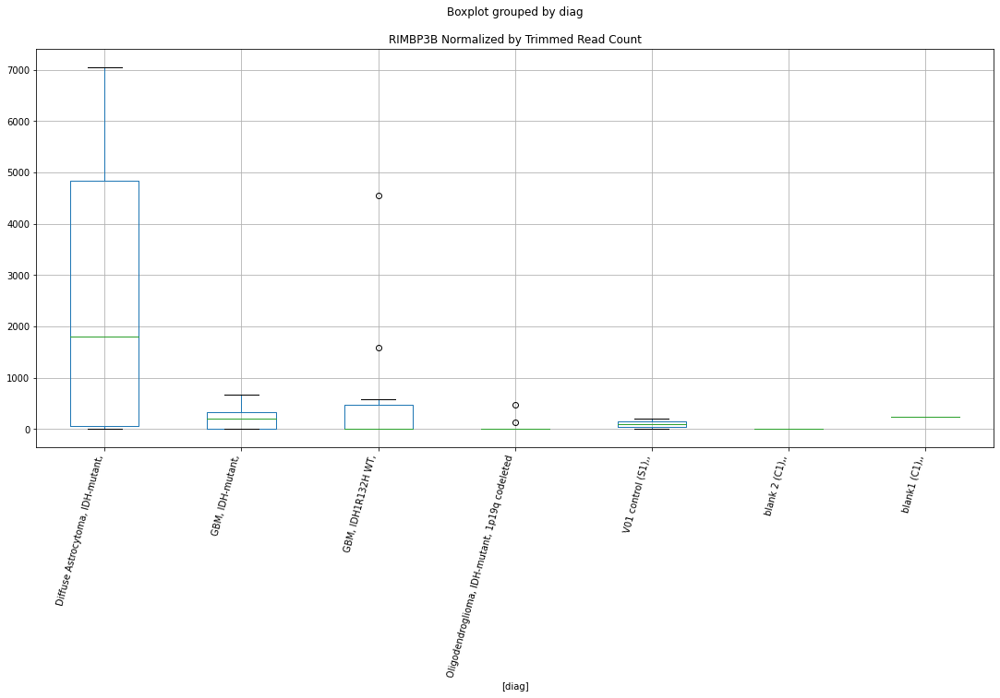

 p : 0.009635350716182278  ( t : 2.895656287179688 ) :  Lexogen  :  bbduk2  :  RIMBP3C
Control and blanks
79       0.00
343    212.31
Name: RIMBP3C, dtype: float64
211    0.0
Name: RIMBP3C, dtype: float64
475    239.52
Name: RIMBP3C, dtype: float64


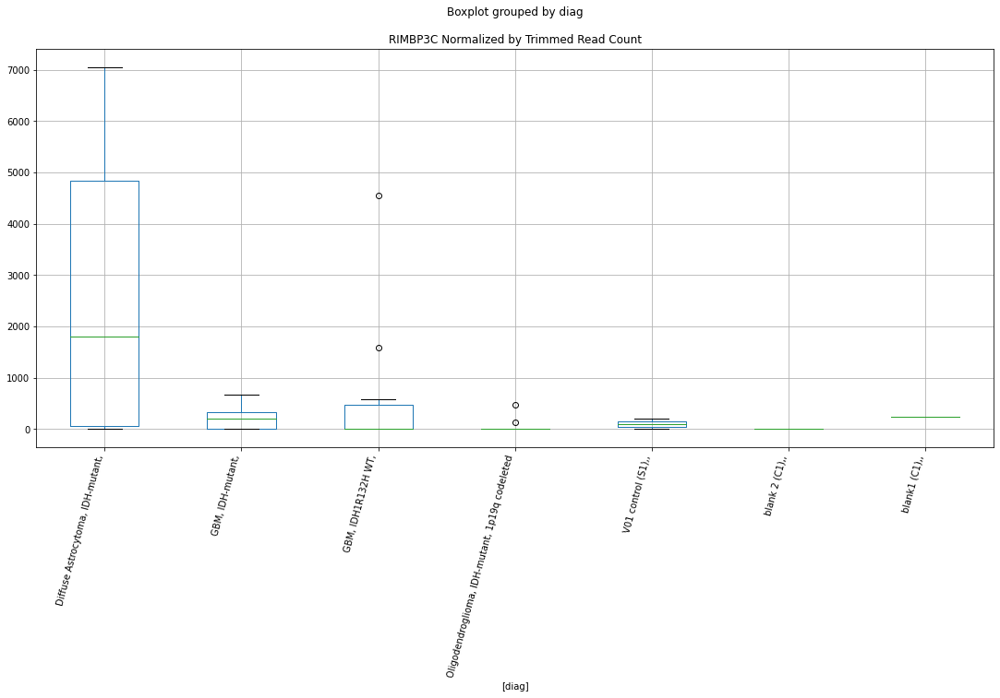

 p : 0.0096553843825977  ( t : 2.894694254511459 ) :  D-plex  :  cutadapt2  :  RNF19A
Control and blanks
76         0.00
340    38752.21
Name: RNF19A, dtype: float64
208    8641.65
Name: RNF19A, dtype: float64
472    0.0
Name: RNF19A, dtype: float64


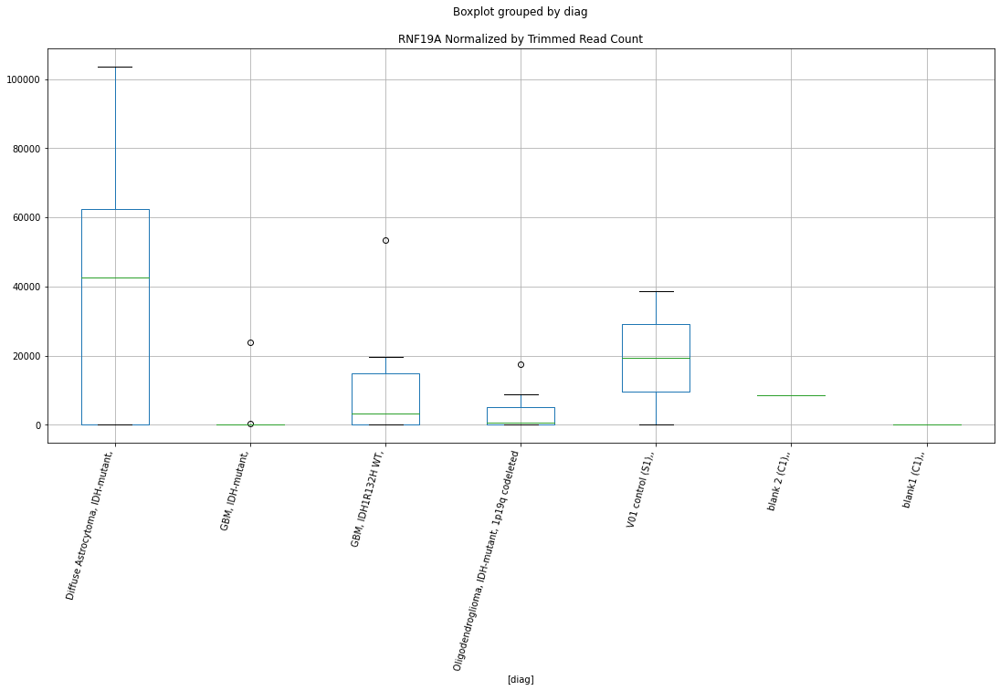

 p : 0.009724958145531941  ( t : 2.891368173112225 ) :  D-plex  :  bbduk2  :  PTPN11
Control and blanks
73         0.00
337    81894.47
Name: PTPN11, dtype: float64
205    0.0
Name: PTPN11, dtype: float64
469    0.0
Name: PTPN11, dtype: float64


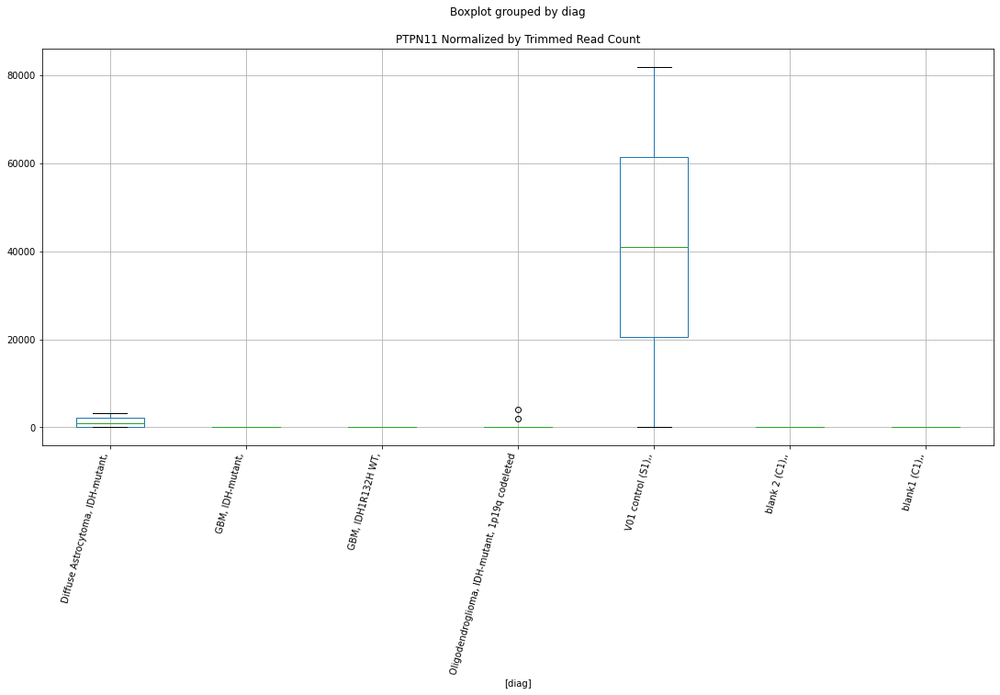

 p : 0.009886662384111535  ( t : 2.8837255560680424 ) :  D-plex  :  cutadapt2  :  RHOH
Control and blanks
76     0.0
340    0.0
Name: RHOH, dtype: float64
208    28923.08
Name: RHOH, dtype: float64
472    9247.29
Name: RHOH, dtype: float64


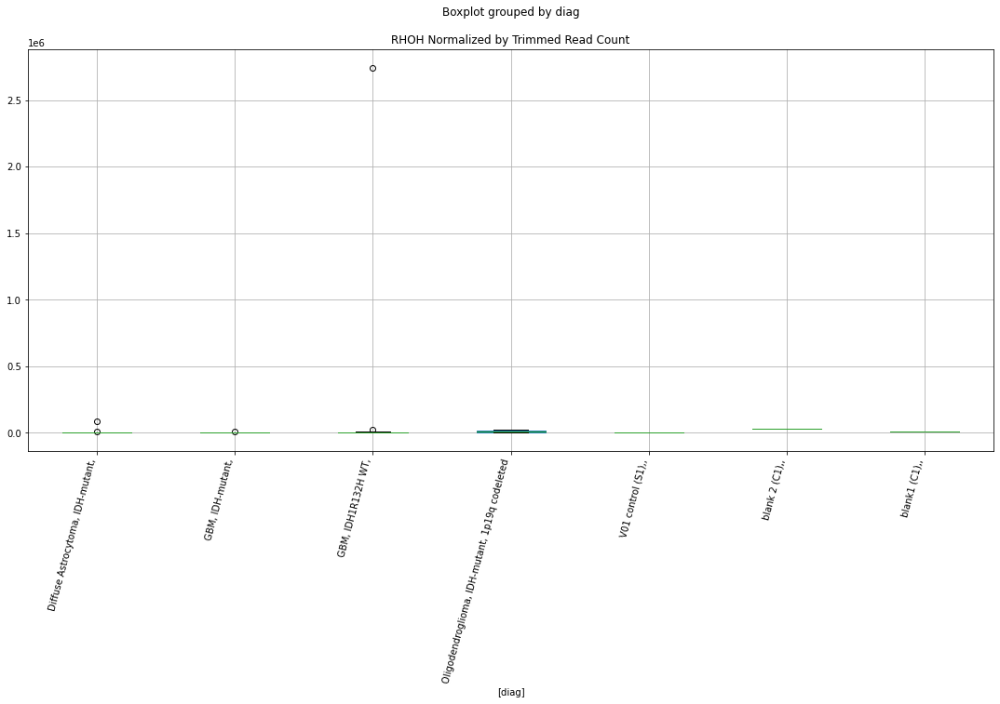

 p : 0.010125811011106881  ( t : 2.8726410062704955 ) :  Lexogen  :  cutadapt2  :  PLA2G6
Control and blanks
82     0.0
346    0.0
Name: PLA2G6, dtype: float64
214    0.0
Name: PLA2G6, dtype: float64
478    0.0
Name: PLA2G6, dtype: float64


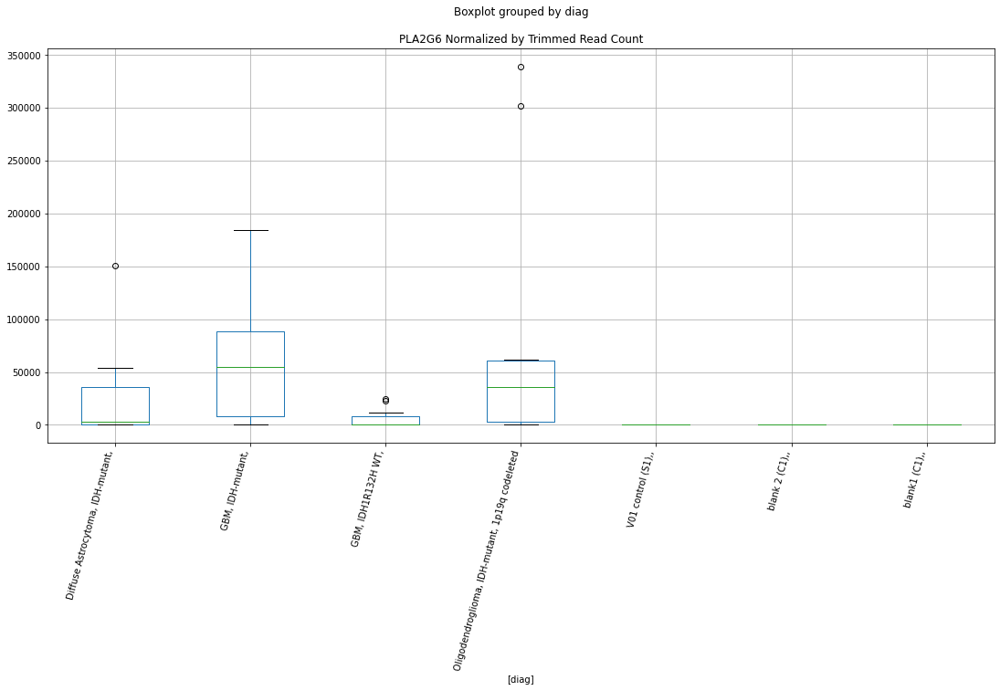

 p : 0.01014543010547787  ( t : 2.8717429024434122 ) :  D-plex  :  cutadapt2  :  RIMS3
Control and blanks
76     0.0
340    0.0
Name: RIMS3, dtype: float64
208    2821.76
Name: RIMS3, dtype: float64
472    4623.65
Name: RIMS3, dtype: float64


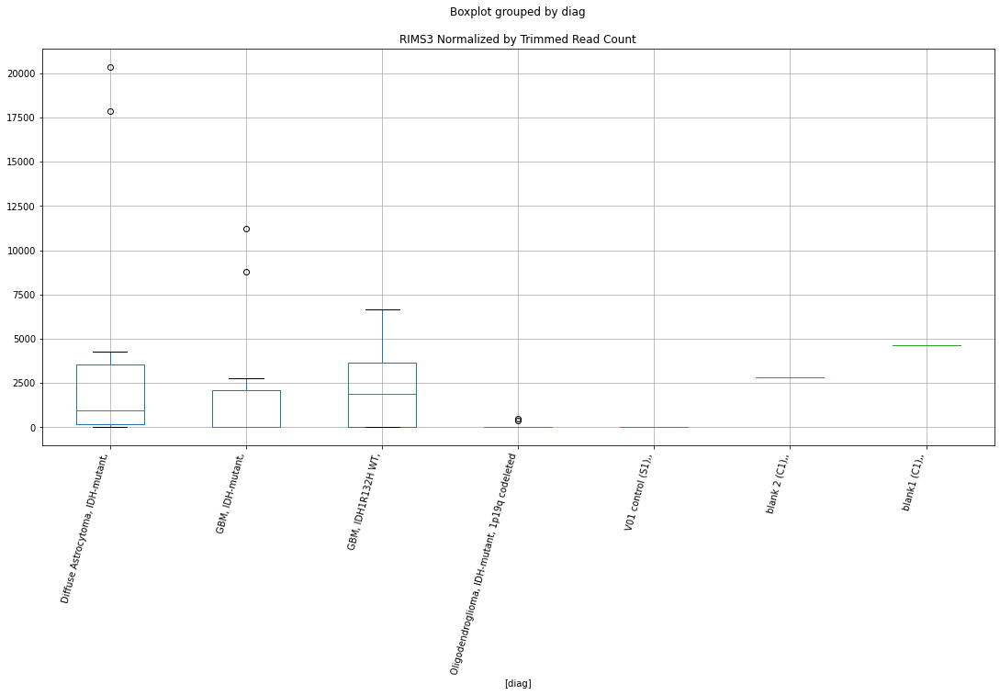

 p : 0.010185518208812291  ( t : 2.869912985059029 ) :  D-plex  :  bbduk2  :  PRUNE2
Control and blanks
73         0.00
337    28485.03
Name: PRUNE2, dtype: float64
205    28654.55
Name: PRUNE2, dtype: float64
469    19520.4
Name: PRUNE2, dtype: float64


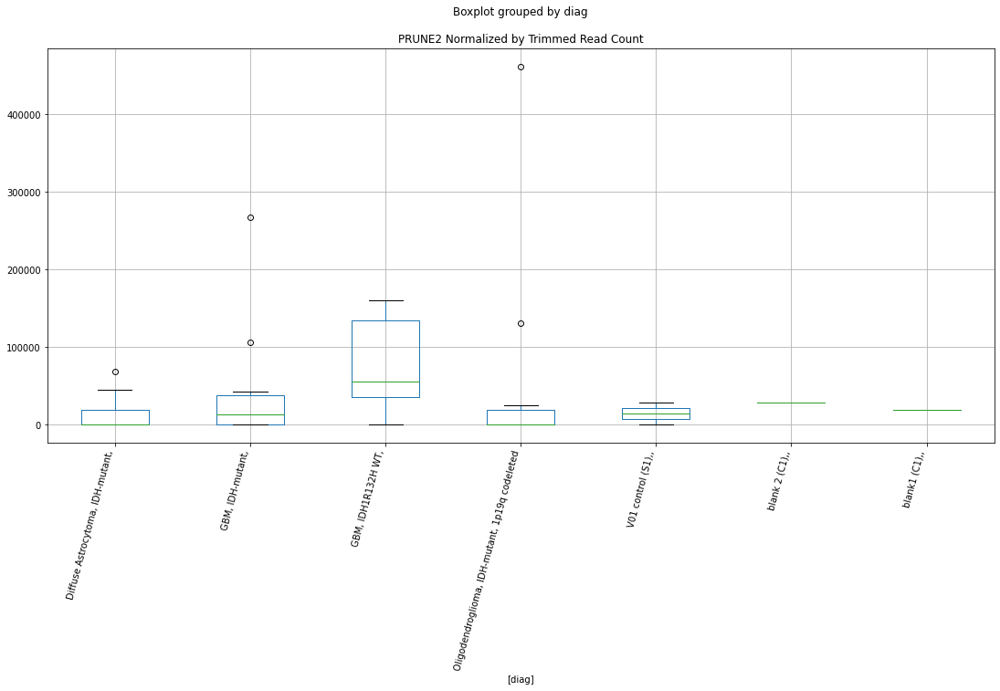

 p : 0.010373264784888252  ( t : 2.8614342392976755 ) :  Lexogen  :  bbduk2  :  SLAIN2
Control and blanks
79       0.00
343    849.26
Name: SLAIN2, dtype: float64
211    4372.9
Name: SLAIN2, dtype: float64
475    0.0
Name: SLAIN2, dtype: float64


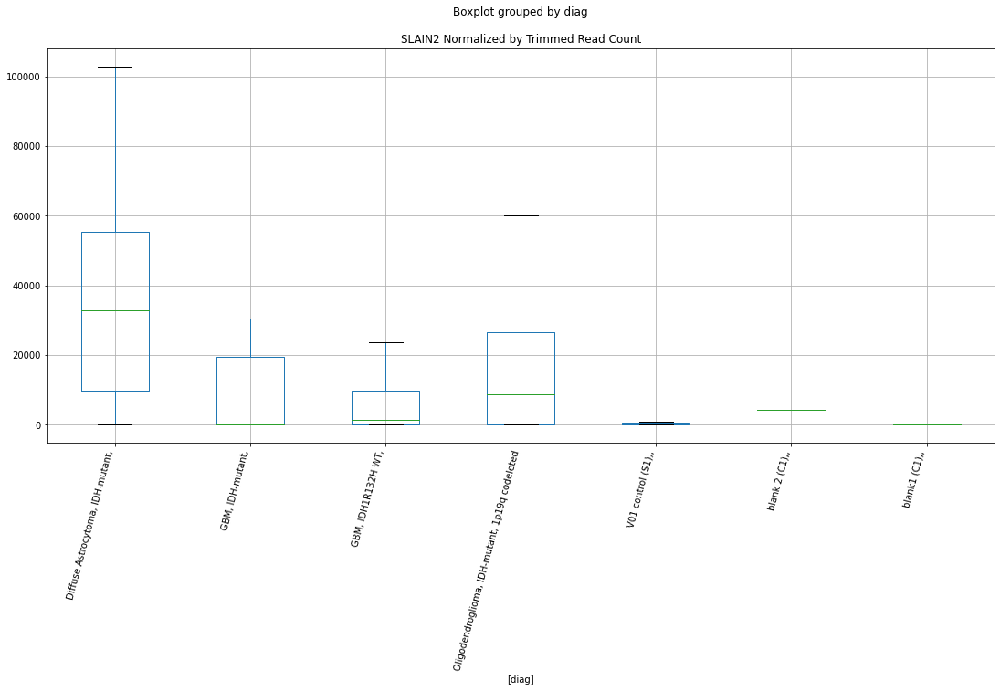

 p : 0.010450636290678567  ( t : 2.8579830718462325 ) :  D-plex  :  cutadapt2  :  RASSF9
Control and blanks
76     3030.46
340       0.00
Name: RASSF9, dtype: float64
208    2292.68
Name: RASSF9, dtype: float64
472    6935.47
Name: RASSF9, dtype: float64


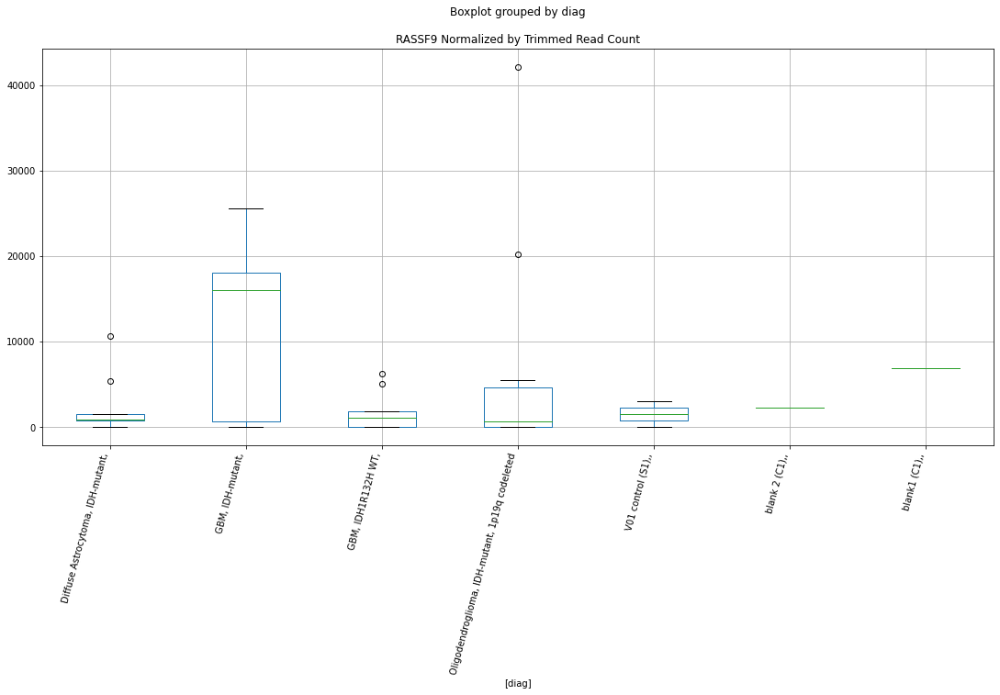

 p : 0.01059088394223008  ( t : 2.8517896147859885 ) :  D-plex  :  bbduk2  :  OXTR
Control and blanks
73     1.09e+06
337    1.29e+05
Name: OXTR, dtype: float64
205    1.55e+06
Name: OXTR, dtype: float64
469    245483.84
Name: OXTR, dtype: float64


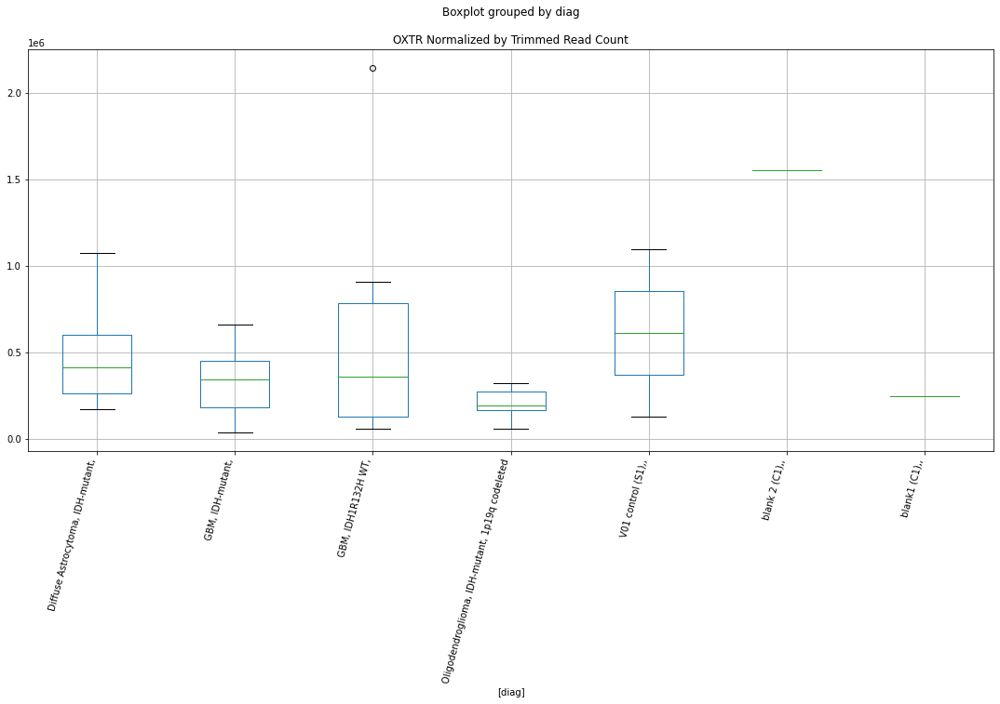

 p : 0.010666541700274042  ( t : 2.848481241398473 ) :  Lexogen  :  bbduk2  :  PLA2G6
Control and blanks
79     0.0
343    0.0
Name: PLA2G6, dtype: float64
211    0.0
Name: PLA2G6, dtype: float64
475    0.0
Name: PLA2G6, dtype: float64


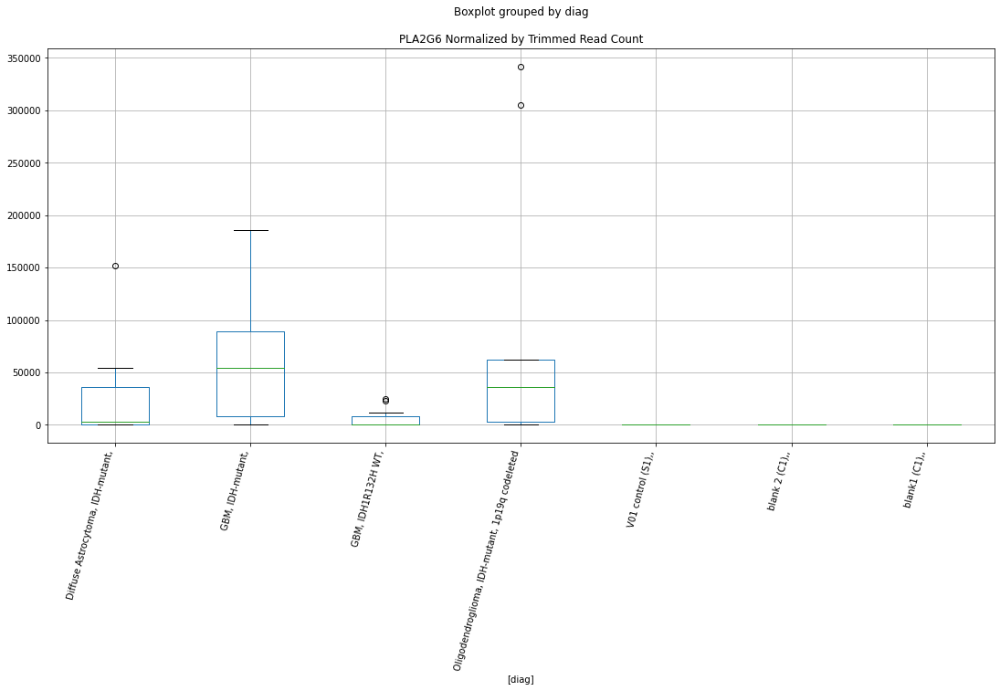

 p : 0.010685827575576125  ( t : 2.8476415219867652 ) :  Lexogen  :  cutadapt2  :  RIMBP3
Control and blanks
82     0.0
346    0.0
Name: RIMBP3, dtype: float64
214    0.0
Name: RIMBP3, dtype: float64
478    237.46
Name: RIMBP3, dtype: float64


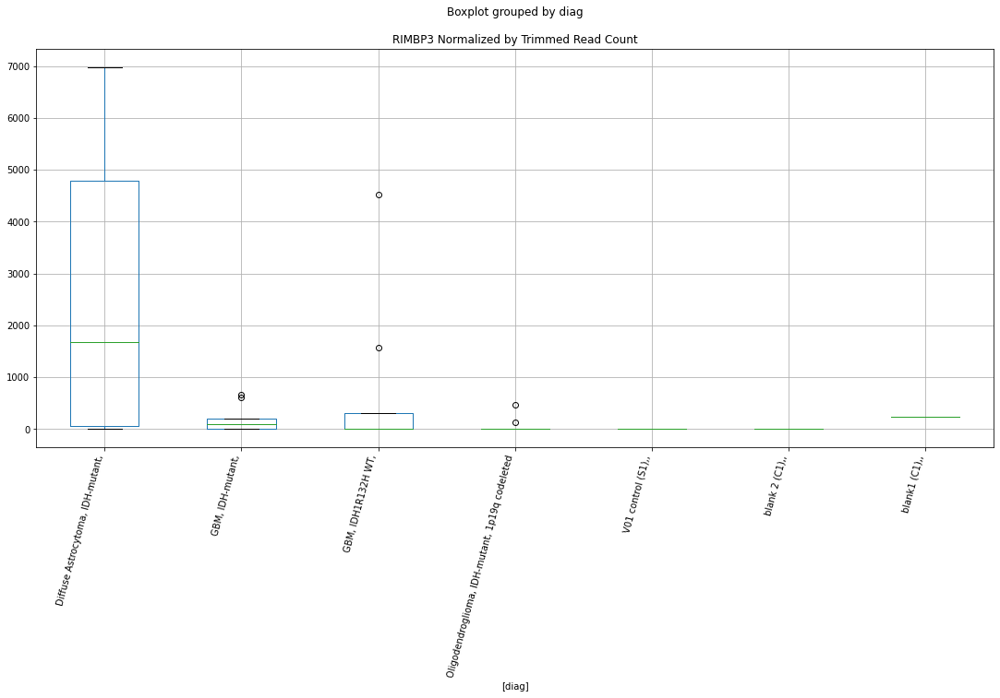

 p : 0.010708258636310442  ( t : 2.8466666937308016 ) :  D-plex  :  cutadapt2  :  RBPJL
Control and blanks
76       7576.14
340    142678.61
Name: RBPJL, dtype: float64
208    90825.51
Name: RBPJL, dtype: float64
472    107499.79
Name: RBPJL, dtype: float64


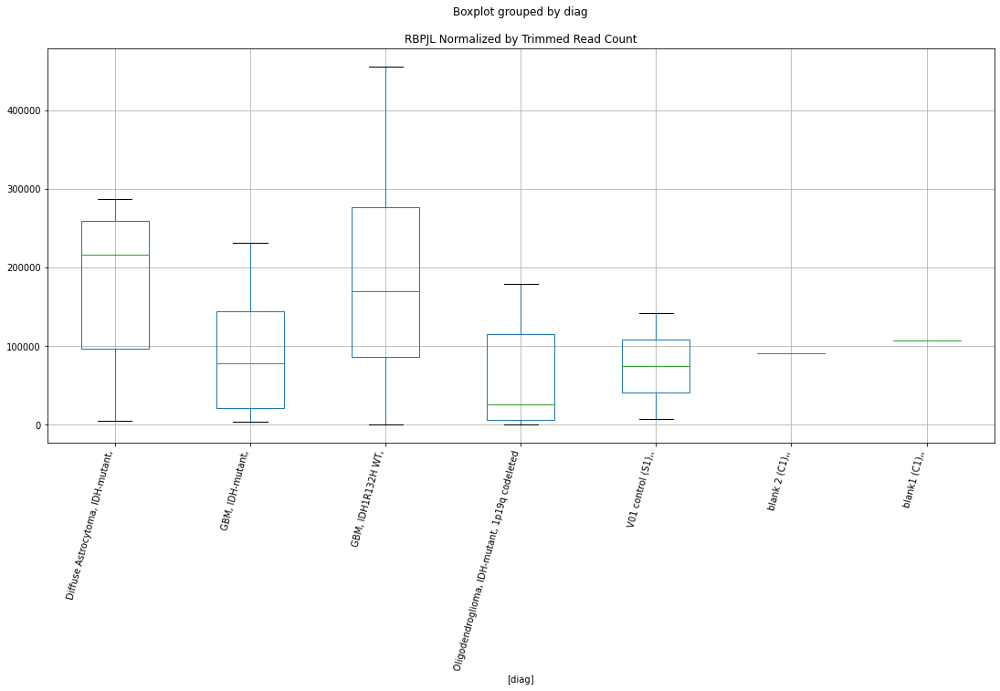

 p : 0.010716212036507446  ( t : 2.8463215203691408 ) :  Lexogen  :  bbduk2  :  RIMBP3
Control and blanks
79       0.00
343    212.31
Name: RIMBP3, dtype: float64
211    0.0
Name: RIMBP3, dtype: float64
475    239.52
Name: RIMBP3, dtype: float64


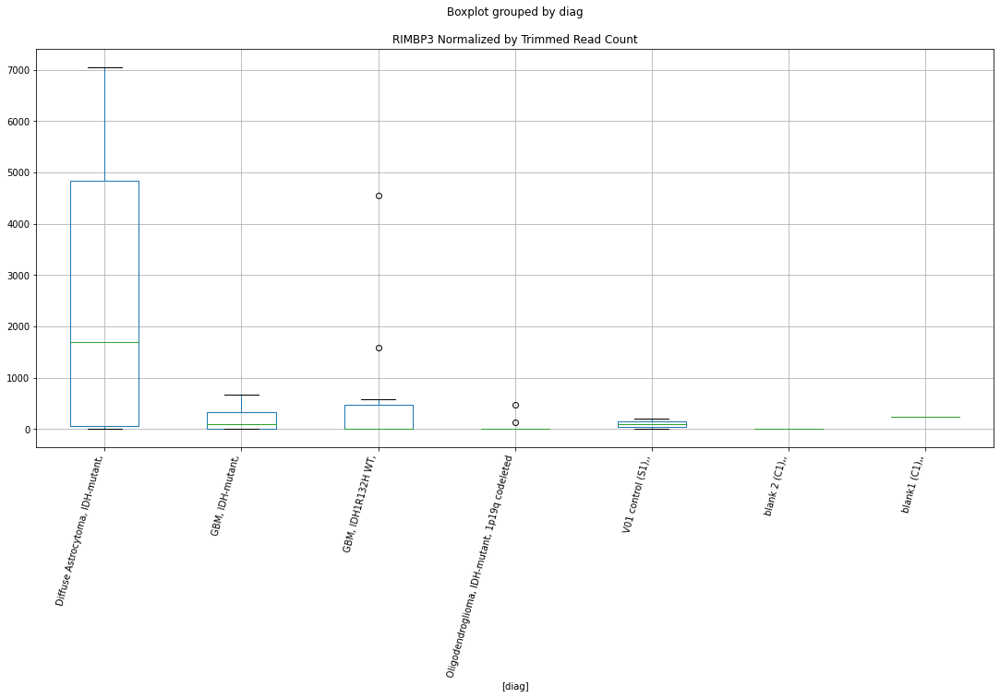

 p : 0.010918818476296244  ( t : 2.837610702375468 ) :  D-plex  :  bbduk2  :  SLC7A1
Control and blanks
73     0.0
337    0.0
Name: SLC7A1, dtype: float64
205    7163.64
Name: SLC7A1, dtype: float64
469    7689.86
Name: SLC7A1, dtype: float64


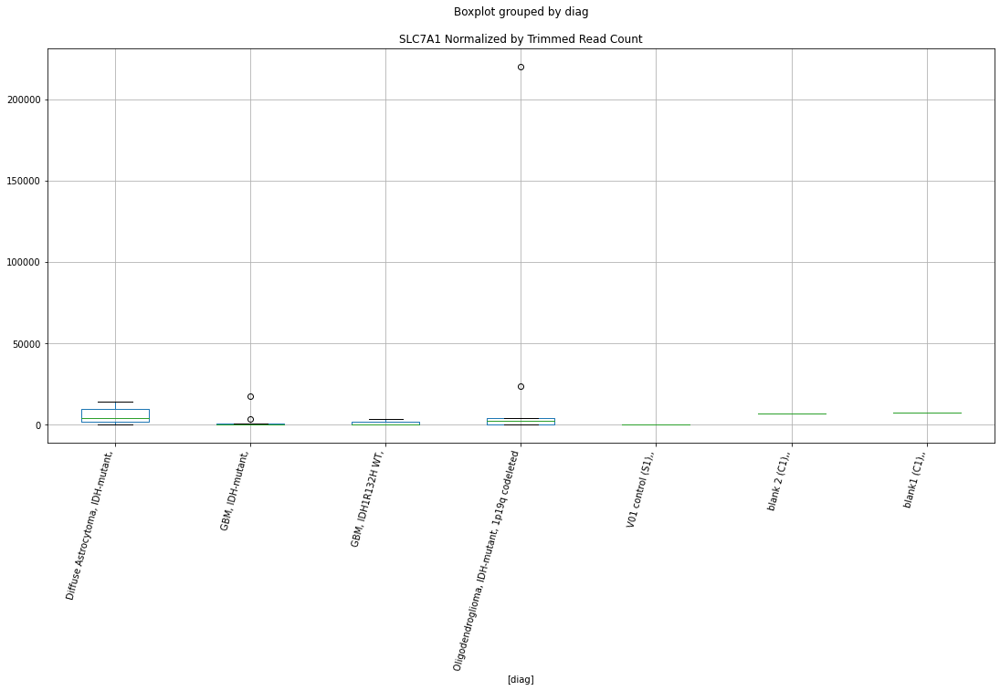

 p : 0.011055735262194716  ( t : 2.8318118189780734 ) :  D-plex  :  bbduk2  :  RPS6KB2
Control and blanks
73     97399.06
337     8011.42
Name: RPS6KB2, dtype: float64
205    35460.01
Name: RPS6KB2, dtype: float64
469    47913.71
Name: RPS6KB2, dtype: float64


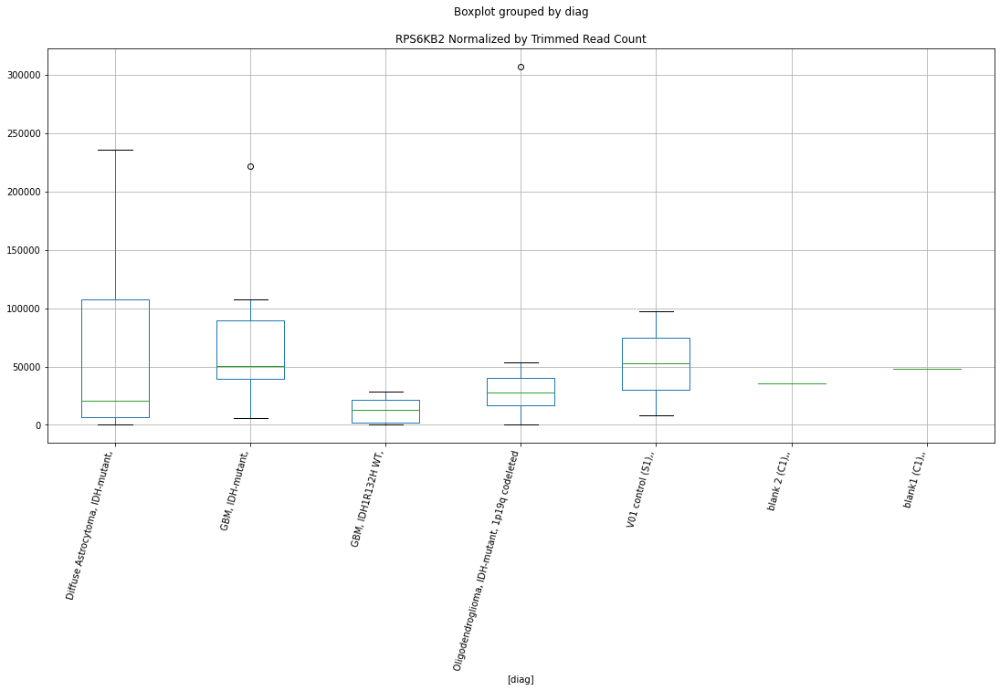

 p : 0.011058392428399857  ( t : 2.831699964287179 ) :  D-plex  :  bbduk2  :  RBPJL
Control and blanks
73       7730.08
337    144205.48
Name: RBPJL, dtype: float64
205    93127.3
Name: RBPJL, dtype: float64
469    107066.44
Name: RBPJL, dtype: float64


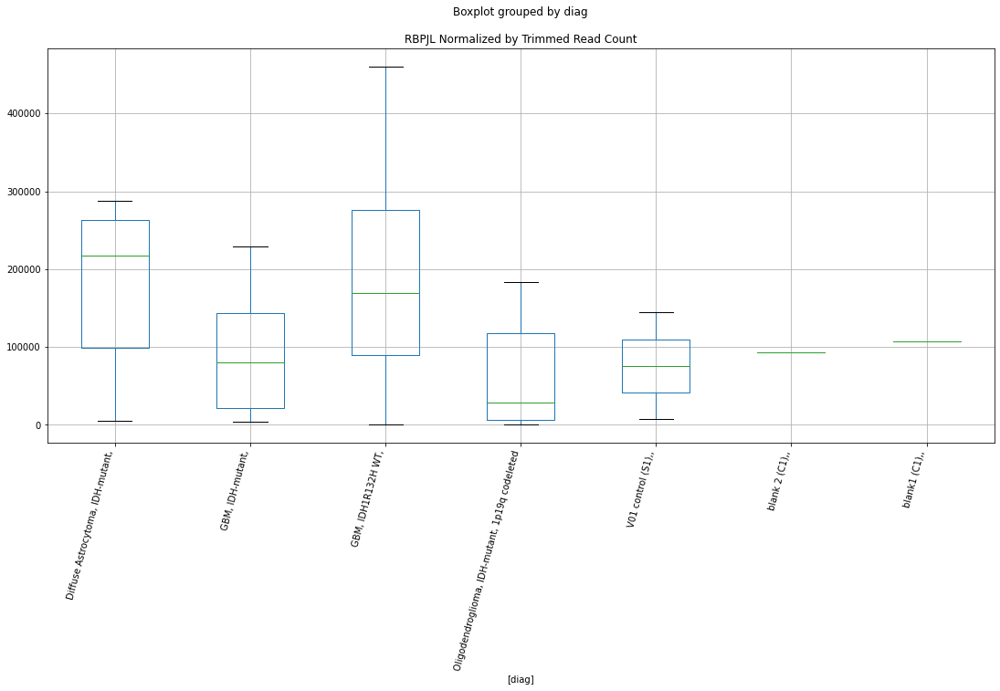

 p : 0.01117806888441656  ( t : 2.8266887568903063 ) :  D-plex  :  cutadapt2  :  PCBP2
Control and blanks
76         0.00
340    86311.75
Name: PCBP2, dtype: float64
208    2469.04
Name: PCBP2, dtype: float64
472    4045.69
Name: PCBP2, dtype: float64


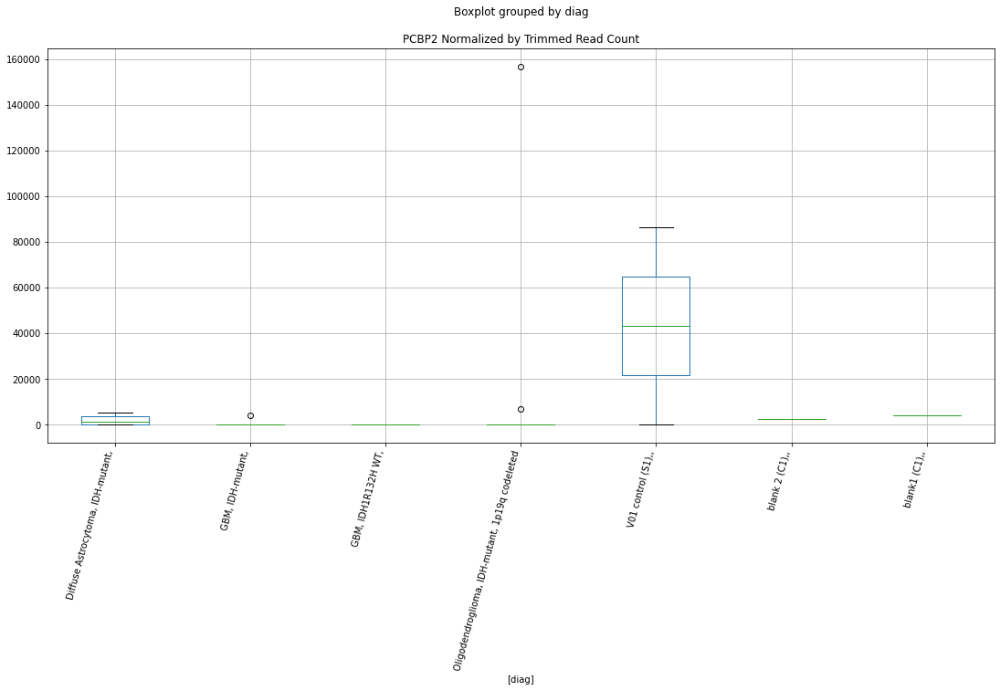

 p : 0.011342864225616263  ( t : 2.819872122937511 ) :  D-plex  :  cutadapt2  :  PCDH9
Control and blanks
76          0.00
340    467668.76
Name: PCDH9, dtype: float64
208    15166.98
Name: PCDH9, dtype: float64
472    3467.74
Name: PCDH9, dtype: float64


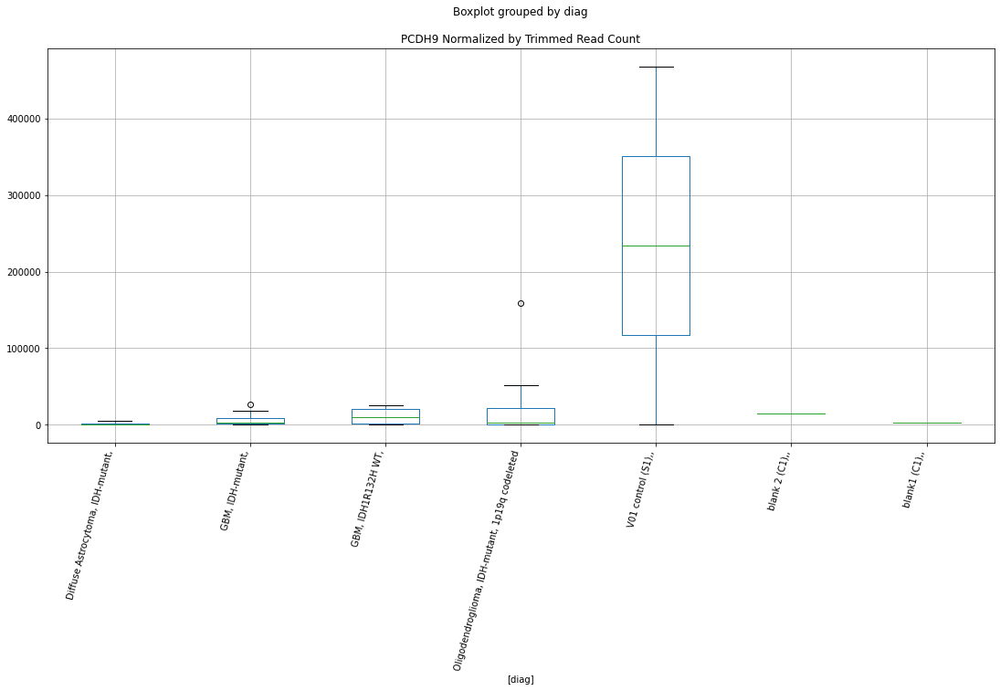

 p : 0.011398845557060115  ( t : 2.8175781605400374 ) :  D-plex  :  cutadapt2  :  RNF19A
Control and blanks
76         0.00
340    38752.21
Name: RNF19A, dtype: float64
208    8641.65
Name: RNF19A, dtype: float64
472    0.0
Name: RNF19A, dtype: float64


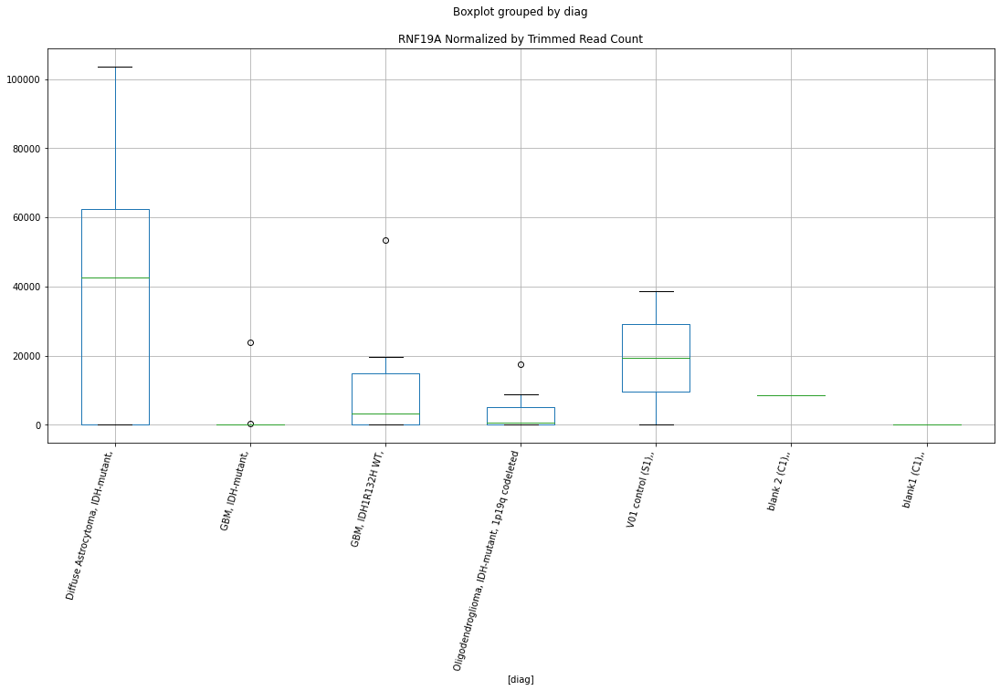

 p : 0.011414768949991033  ( t : 2.8169276424875567 ) :  Lexogen  :  cutadapt2  :  SLAIN2
Control and blanks
82       0.00
346    841.74
Name: SLAIN2, dtype: float64
214    4339.62
Name: SLAIN2, dtype: float64
478    0.0
Name: SLAIN2, dtype: float64


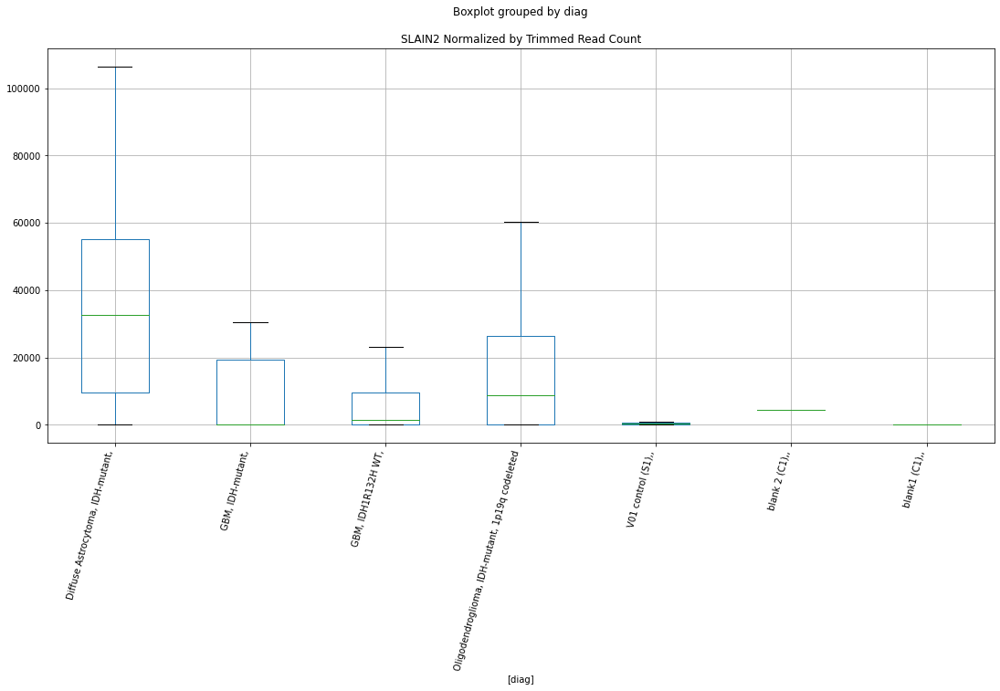

 p : 0.011655111603768555  ( t : 2.8072134955163004 ) :  D-plex  :  bbduk2  :  SAP130
Control and blanks
73     454528.94
337    106818.87
Name: SAP130, dtype: float64
205    186970.95
Name: SAP130, dtype: float64
469    191654.85
Name: SAP130, dtype: float64


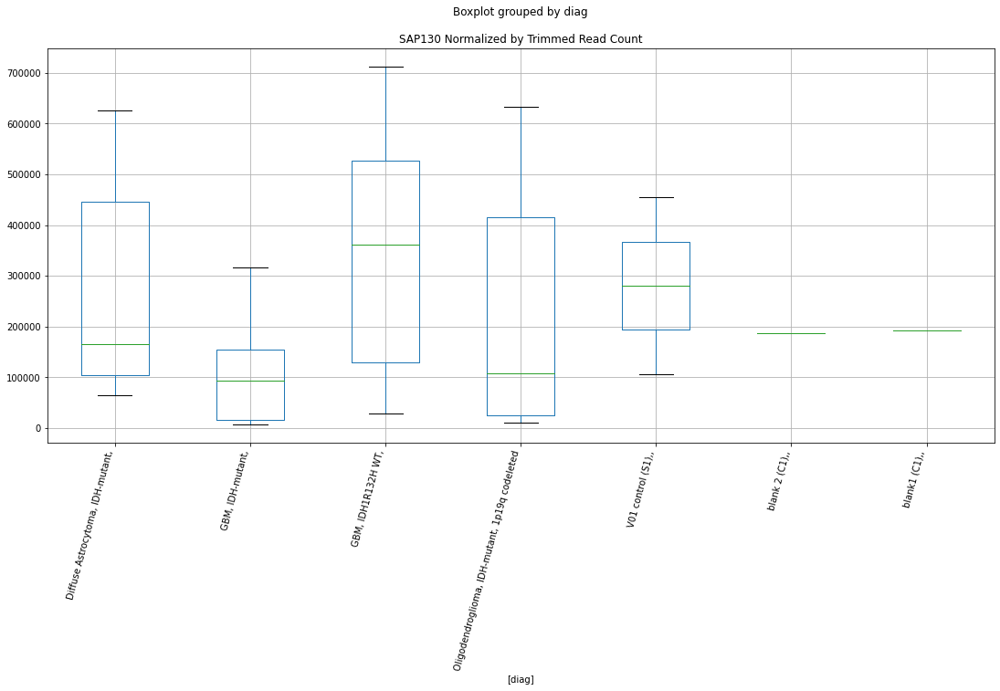

 p : 0.011911065029080204  ( t : 2.7970778557509064 ) :  D-plex  :  bbduk2  :  PKD1P5-LOC105376752
Control and blanks
73     29374.32
337        0.00
Name: PKD1P5-LOC105376752, dtype: float64
205    6268.18
Name: PKD1P5-LOC105376752, dtype: float64
469    10647.49
Name: PKD1P5-LOC105376752, dtype: float64


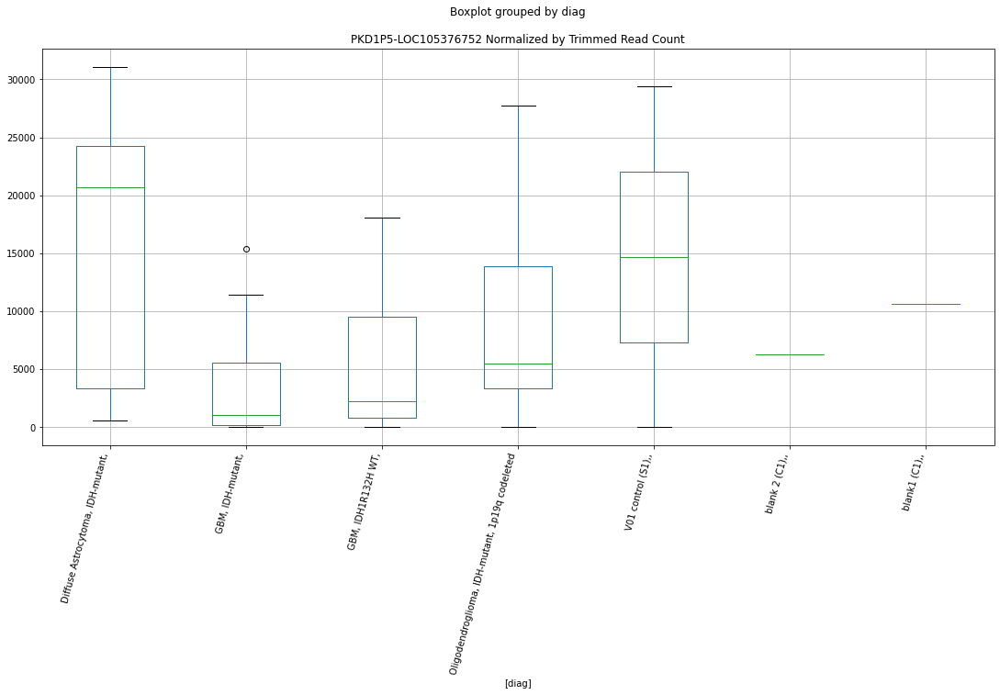

 p : 0.01203099834617444  ( t : 2.792400344701536 ) :  D-plex  :  bbduk2  :  PAUPAR
Control and blanks
73     0.0
337    0.0
Name: PAUPAR, dtype: float64
205    0.0
Name: PAUPAR, dtype: float64
469    0.0
Name: PAUPAR, dtype: float64


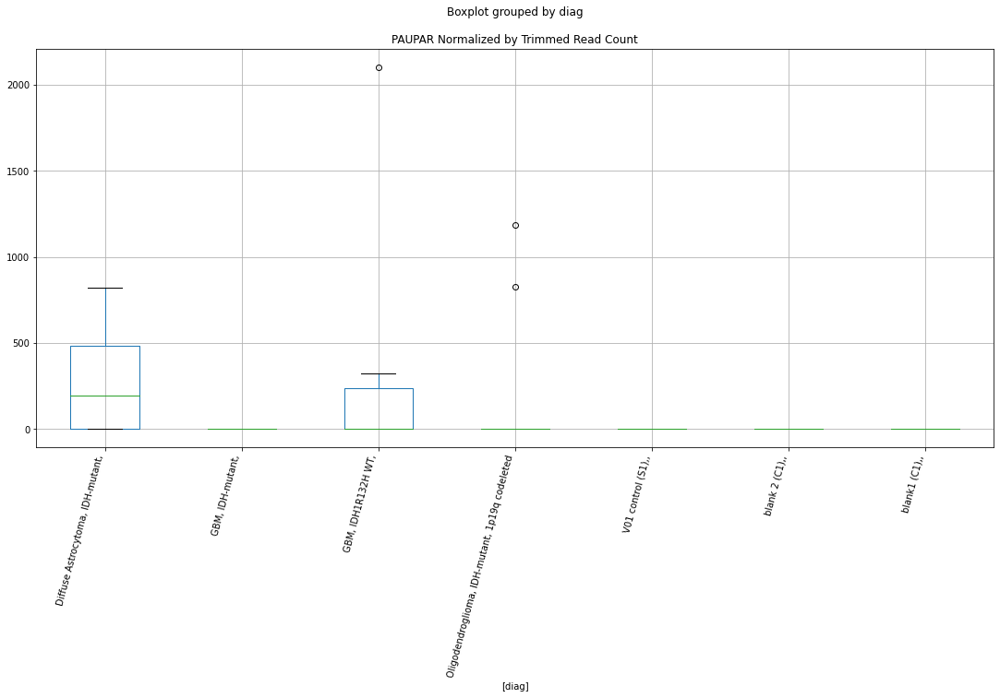

 p : 0.012076892544270567  ( t : 2.7906222667061242 ) :  D-plex  :  bbduk2  :  RNF19A
Control and blanks
73         0.00
337    50738.96
Name: RNF19A, dtype: float64
205    11103.64
Name: RNF19A, dtype: float64
469    0.0
Name: RNF19A, dtype: float64


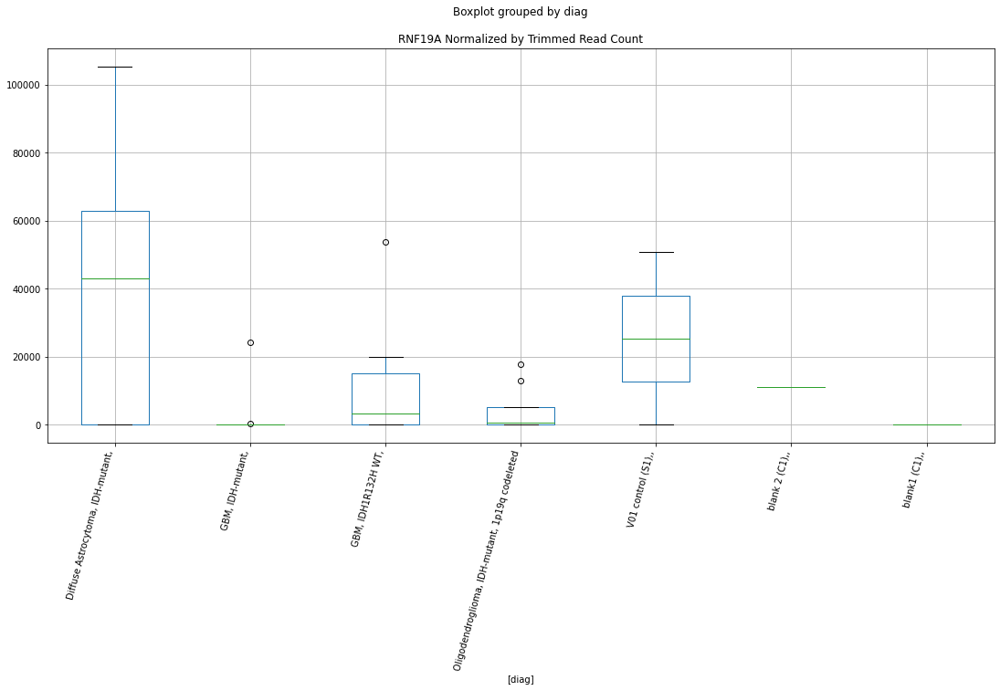

 p : 0.012104834225558293  ( t : 2.7895428978466255 ) :  D-plex  :  bbduk2  :  POU6F2
Control and blanks
73     0.0
337    0.0
Name: POU6F2, dtype: float64
205    3223.64
Name: POU6F2, dtype: float64
469    0.0
Name: POU6F2, dtype: float64


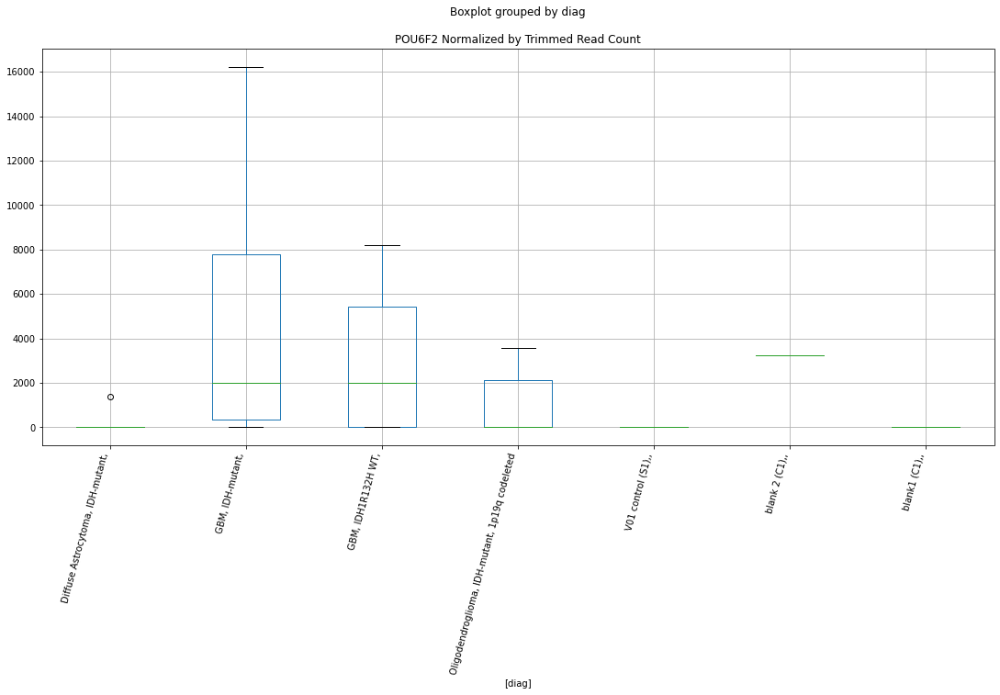

 p : 0.012142959289080275  ( t : 2.7880740043566994 ) :  D-plex  :  bbduk2  :  POLR2F
Control and blanks
73     0.0
337    0.0
Name: POLR2F, dtype: float64
205    1074.55
Name: POLR2F, dtype: float64
469    0.0
Name: POLR2F, dtype: float64


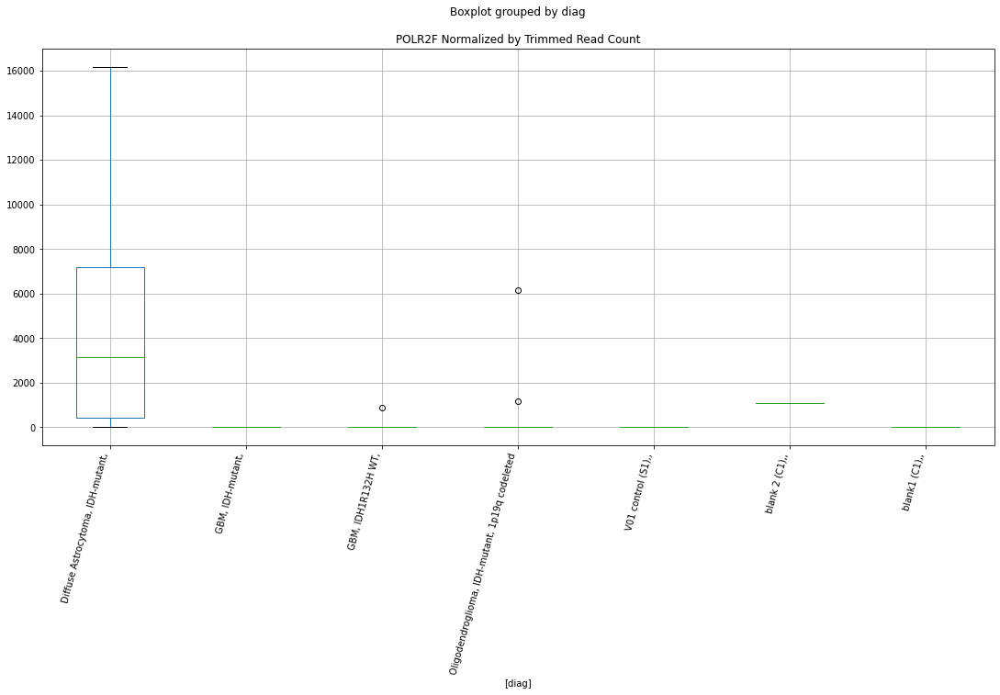

 p : 0.012253599279332625  ( t : 2.7838361698780947 ) :  D-plex  :  cutadapt2  :  POM121
Control and blanks
76     4545.69
340    2642.20
Name: POM121, dtype: float64
208    183590.99
Name: POM121, dtype: float64
472    375093.34
Name: POM121, dtype: float64


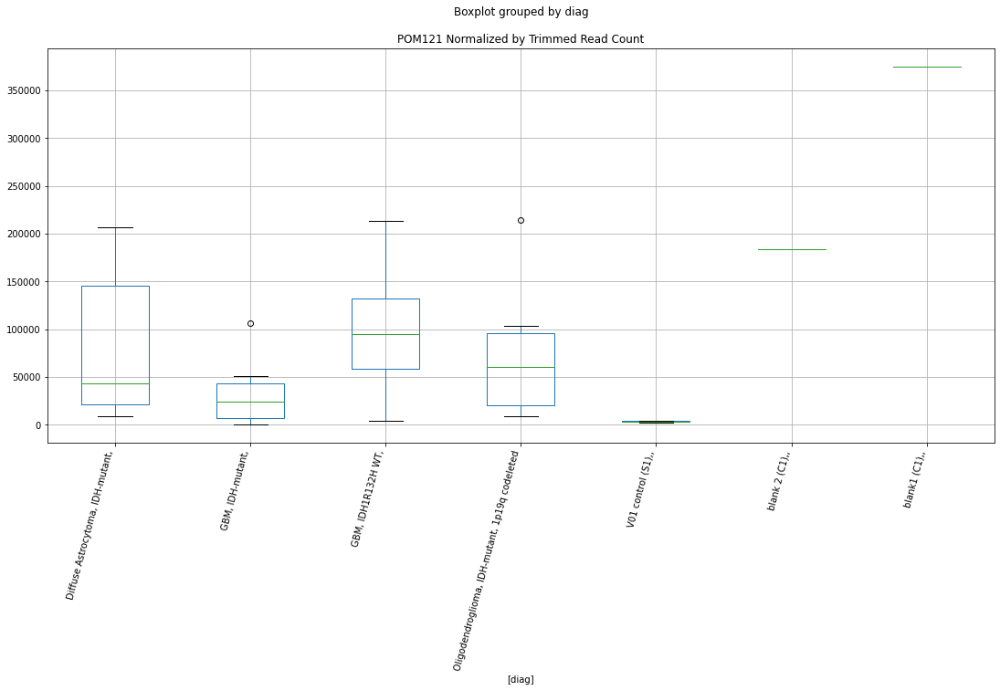

 p : 0.012302197819950405  ( t : 2.781986302889029 ) :  Lexogen  :  bbduk2  :  RSPO1
Control and blanks
79     0.0
343    0.0
Name: RSPO1, dtype: float64
211    0.0
Name: RSPO1, dtype: float64
475    0.0
Name: RSPO1, dtype: float64


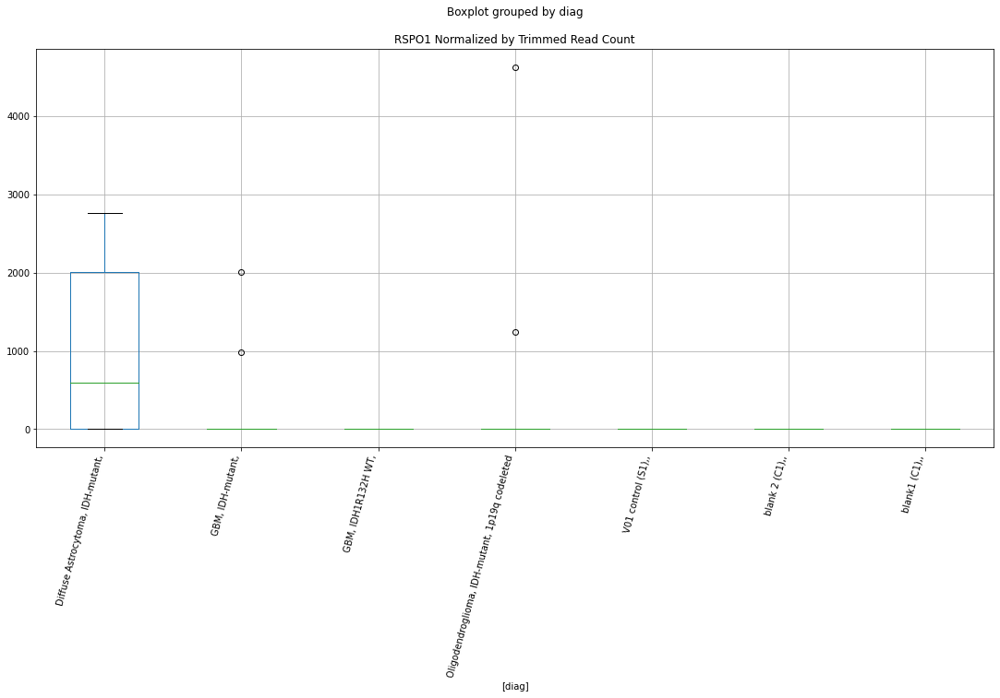

 p : 0.012337475105919309  ( t : 2.7806478879072256 ) :  D-plex  :  bbduk2  :  SIPA1L3
Control and blanks
73     17006.18
337     4450.79
Name: SIPA1L3, dtype: float64
205    12894.55
Name: SIPA1L3, dtype: float64
469    21294.98
Name: SIPA1L3, dtype: float64


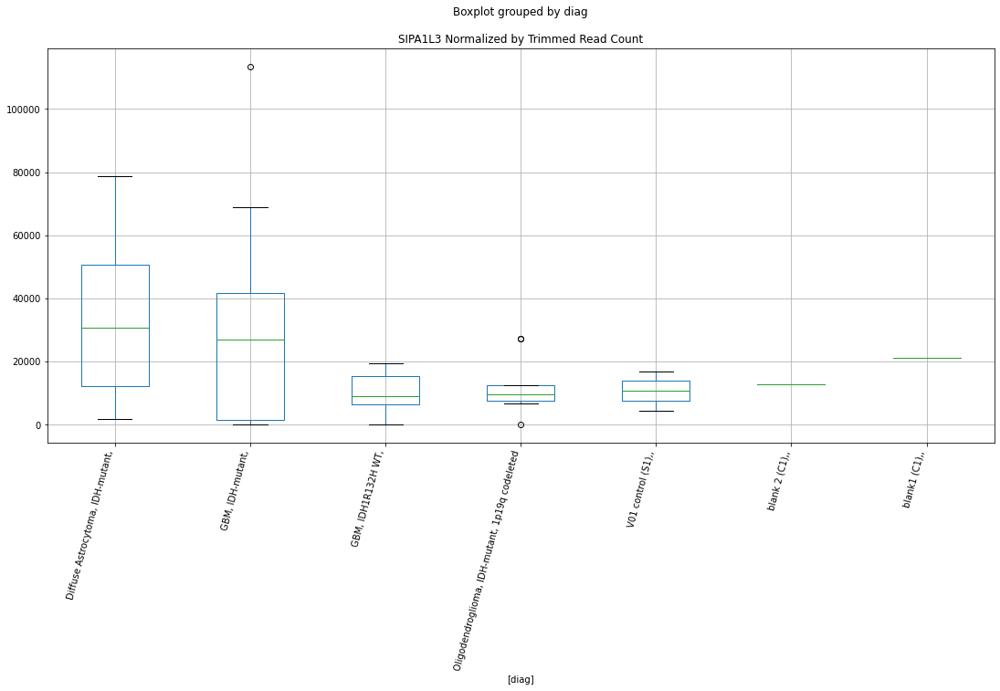

 p : 0.012346386422562342  ( t : 2.7803103749939724 ) :  D-plex  :  cutadapt2  :  PM20D2
Control and blanks
76     0.0
340    0.0
Name: PM20D2, dtype: float64
208    2645.4
Name: PM20D2, dtype: float64
472    6357.51
Name: PM20D2, dtype: float64


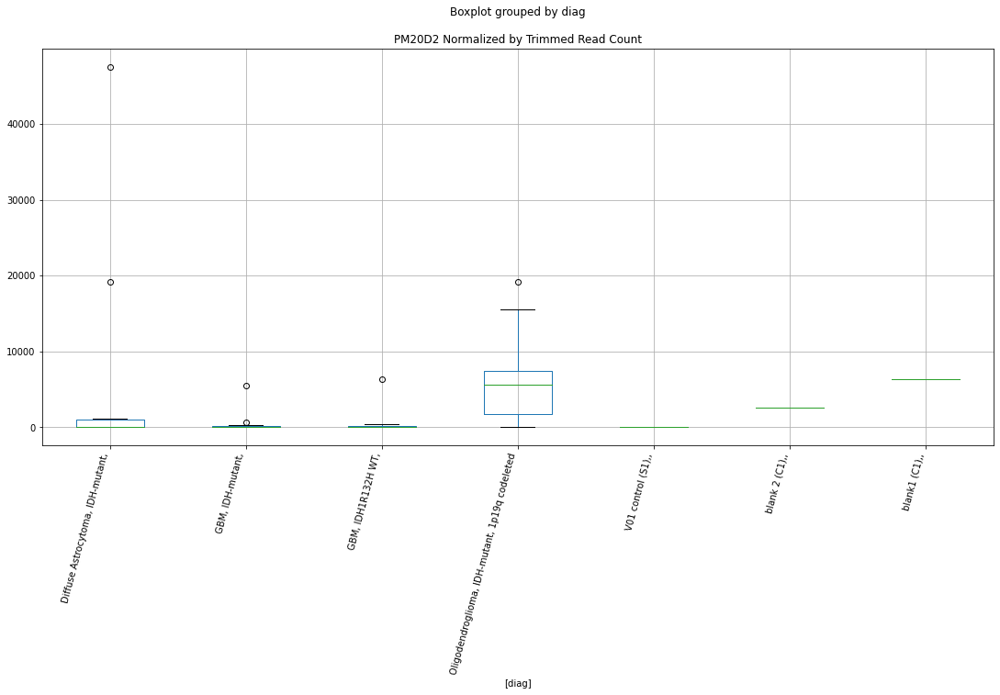

 p : 0.01234919508642999  ( t : 2.7802040463151614 ) :  D-plex  :  bbduk2  :  SLC27A6
Control and blanks
73     0.0
337    0.0
Name: SLC27A6, dtype: float64
205    1074.55
Name: SLC27A6, dtype: float64
469    0.0
Name: SLC27A6, dtype: float64


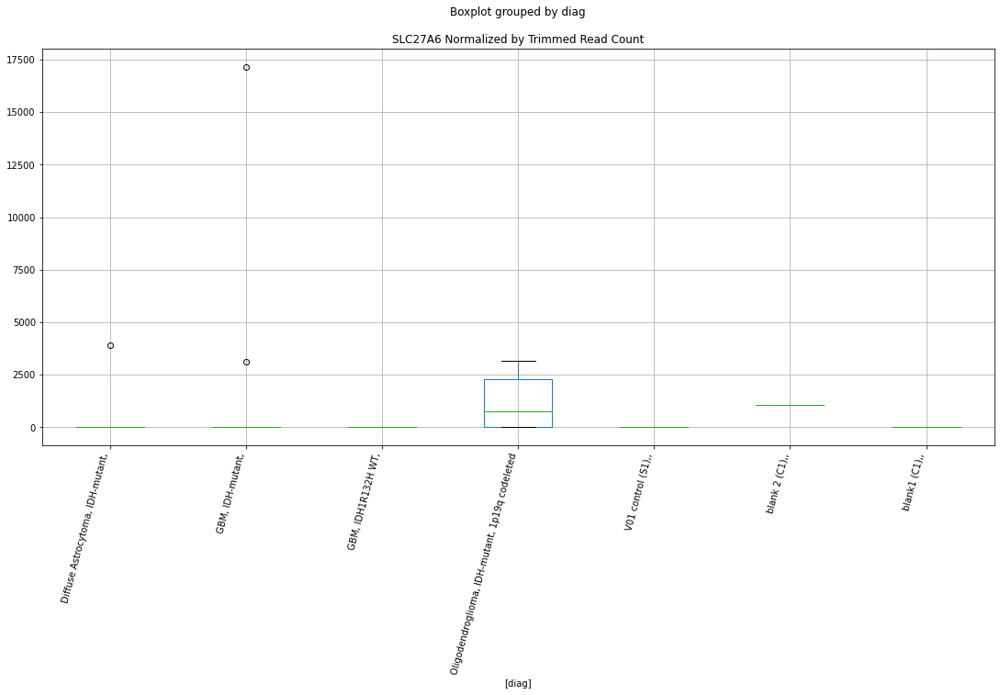

 p : 0.012412671973830273  ( t : 2.7778071459224787 ) :  D-plex  :  cutadapt2  :  SLC27A6
Control and blanks
76     0.0
340    0.0
Name: SLC27A6, dtype: float64
208    1058.16
Name: SLC27A6, dtype: float64
472    0.0
Name: SLC27A6, dtype: float64


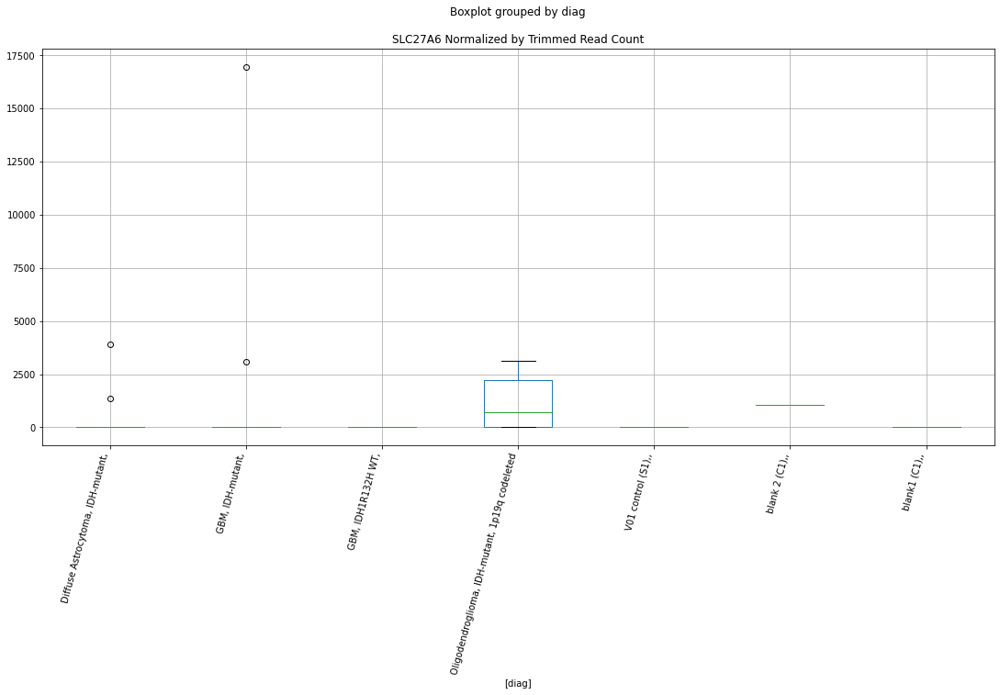

 p : 0.012487156932129755  ( t : 2.7750095315844314 ) :  D-plex  :  bbduk2  :  RNGTT
Control and blanks
73     4638.05
337       0.00
Name: RNGTT, dtype: float64
205    21670.01
Name: RNGTT, dtype: float64
469    24844.15
Name: RNGTT, dtype: float64


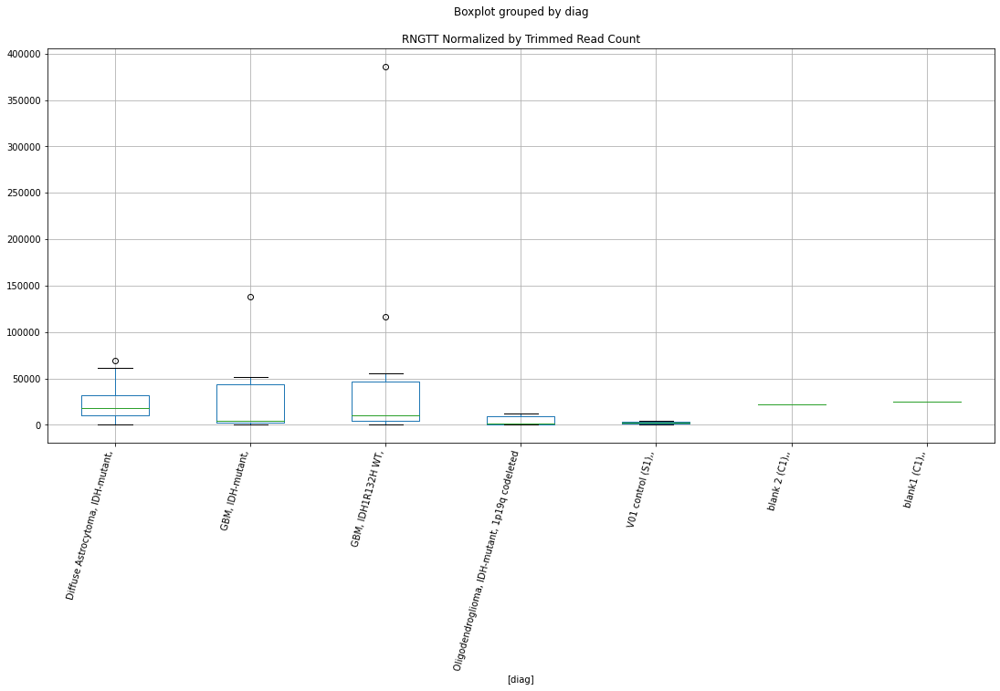

 p : 0.012595945678391025  ( t : 2.770952120671689 ) :  D-plex  :  bbduk2  :  PPP1R9A
Control and blanks
73     0.0
337    0.0
Name: PPP1R9A, dtype: float64
205    22028.19
Name: PPP1R9A, dtype: float64
469    17154.29
Name: PPP1R9A, dtype: float64


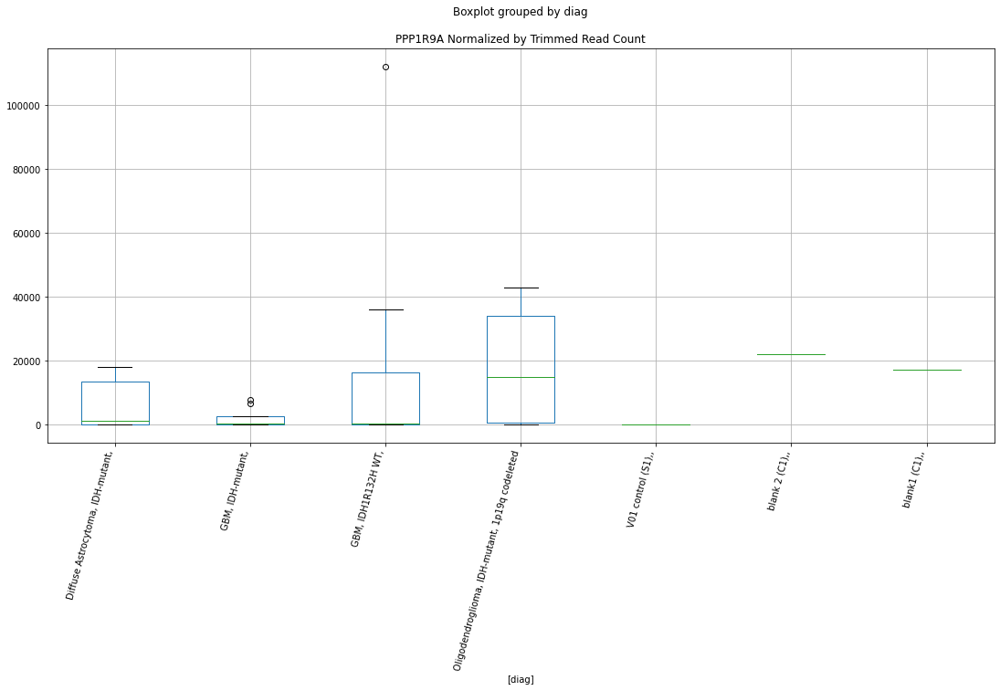

 p : 0.012920825092267538  ( t : 2.7590323727265242 ) :  D-plex  :  cutadapt2  :  PRKY
Control and blanks
76     1515.23
340       0.00
Name: PRKY, dtype: float64
208    37212.01
Name: PRKY, dtype: float64
472    0.0
Name: PRKY, dtype: float64


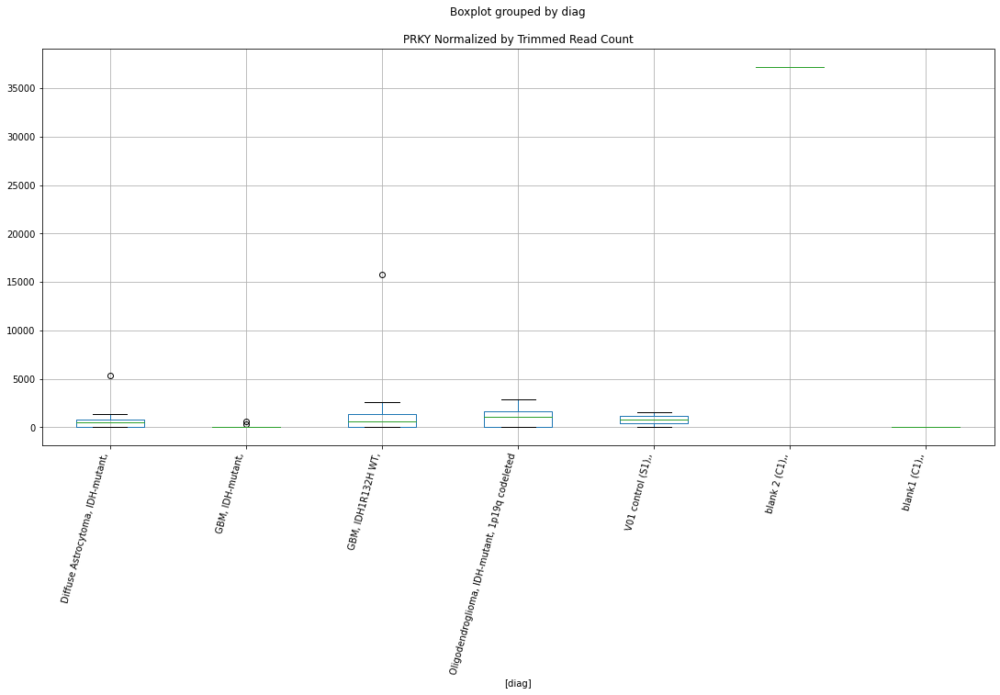

 p : 0.013081379751673103  ( t : 2.753247352024335 ) :  D-plex  :  cutadapt2  :  SLC9B1
Control and blanks
76     0.0
340    0.0
Name: SLC9B1, dtype: float64
208    0.0
Name: SLC9B1, dtype: float64
472    0.0
Name: SLC9B1, dtype: float64


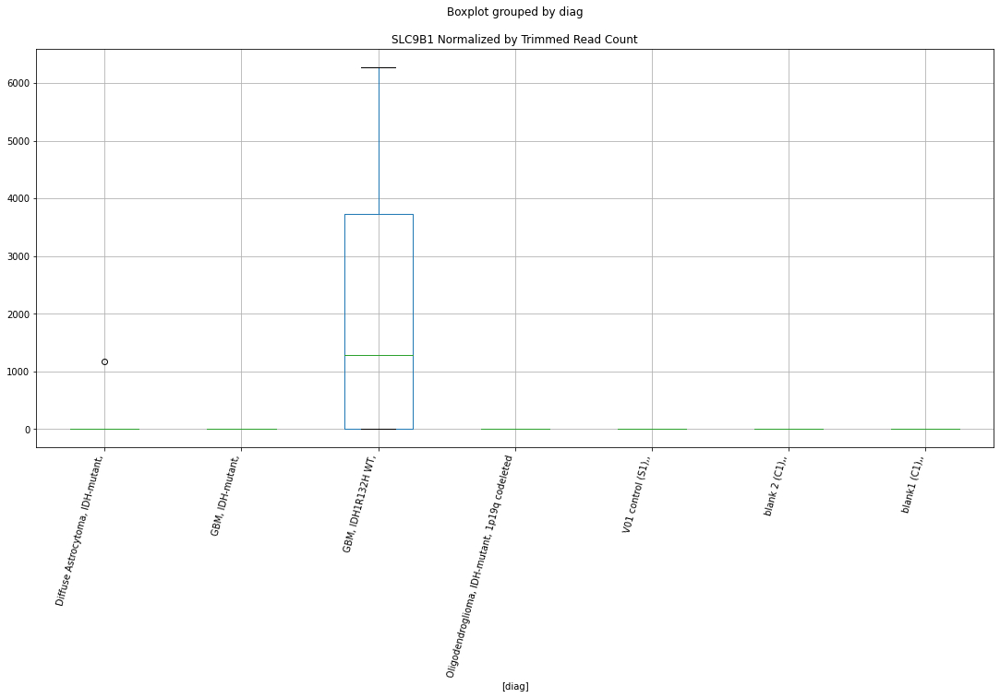

 p : 0.01315883199842424  ( t : 2.7504809199126554 ) :  D-plex  :  bbduk2  :  OTOR
Control and blanks
73     0.0
337    0.0
Name: OTOR, dtype: float64
205    537.27
Name: OTOR, dtype: float64
469    591.53
Name: OTOR, dtype: float64


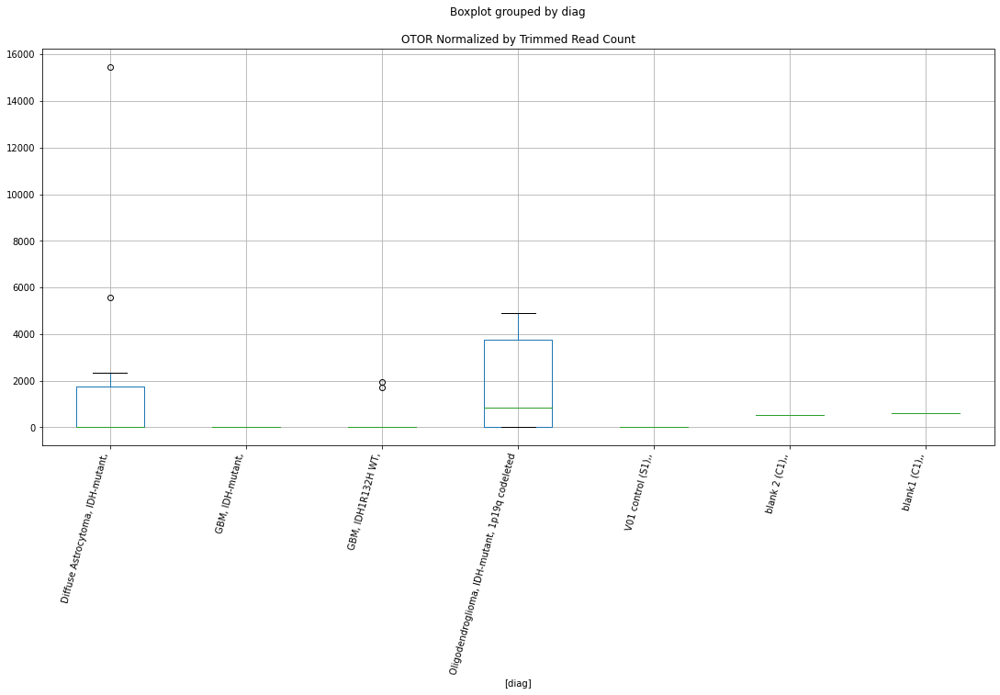

 p : 0.013282709341914709  ( t : 2.746088543148386 ) :  D-plex  :  bbduk2  :  PINK1-AS
Control and blanks
73     0.0
337    0.0
Name: PINK1-AS, dtype: float64
205    537.27
Name: PINK1-AS, dtype: float64
469    591.53
Name: PINK1-AS, dtype: float64


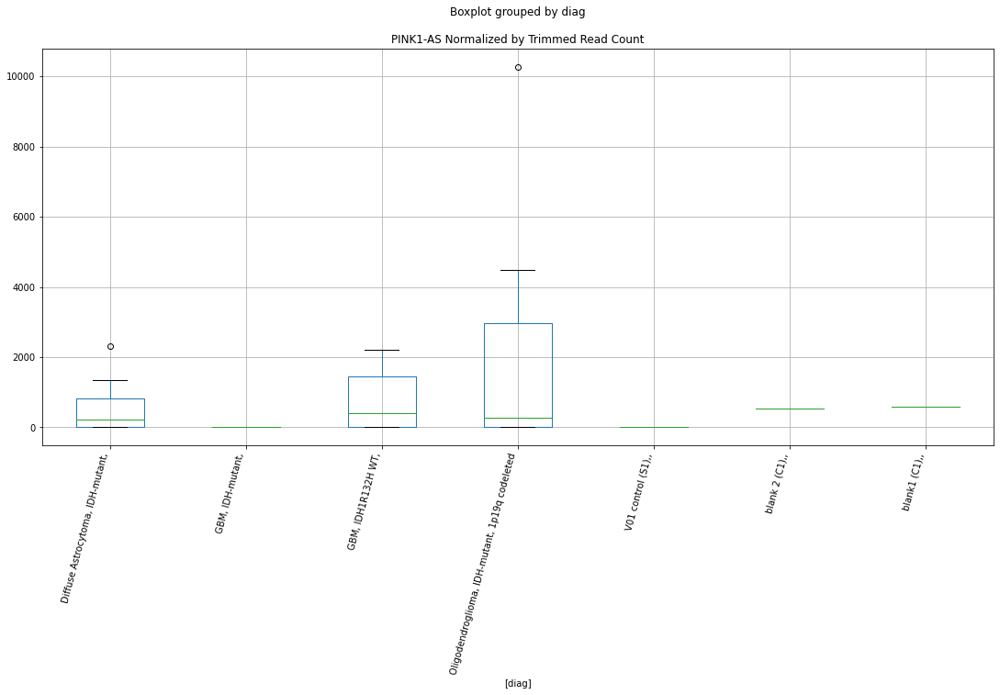

 p : 0.013294762255331426  ( t : 2.7456632741846807 ) :  D-plex  :  bbduk2  :  SIGLEC10
Control and blanks
73     6957.08
337       0.00
Name: SIGLEC10, dtype: float64
205    11282.73
Name: SIGLEC10, dtype: float64
469    1.44e+06
Name: SIGLEC10, dtype: float64


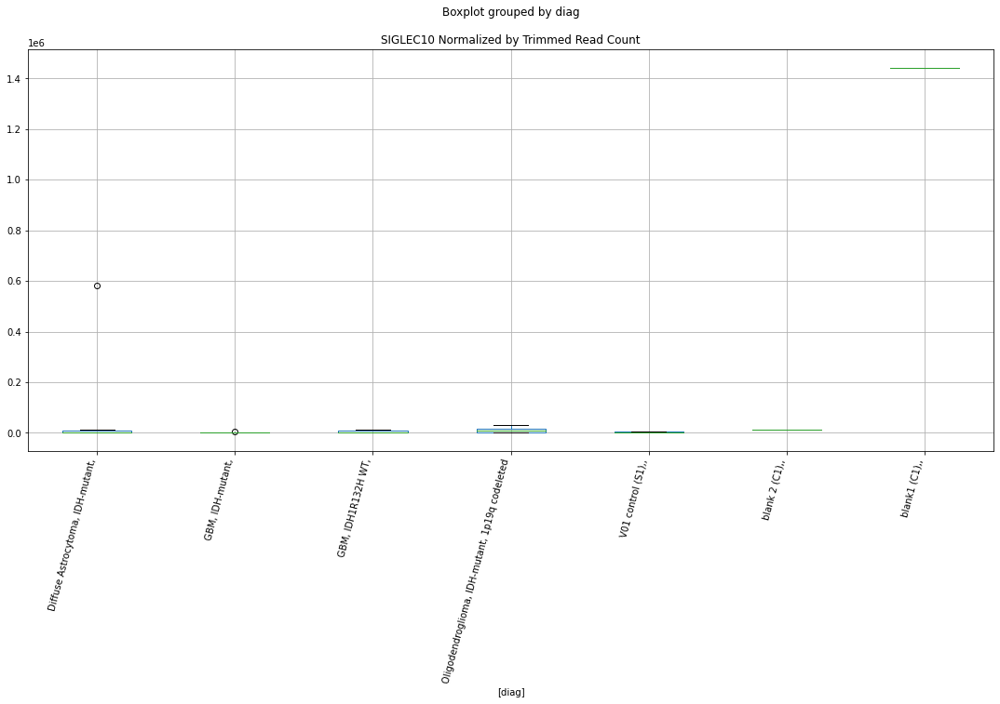

 p : 0.013325246872876137  ( t : 2.7445893160627457 ) :  D-plex  :  cutadapt2  :  PINK1-AS
Control and blanks
76     0.0
340    0.0
Name: PINK1-AS, dtype: float64
208    529.08
Name: PINK1-AS, dtype: float64
472    577.96
Name: PINK1-AS, dtype: float64


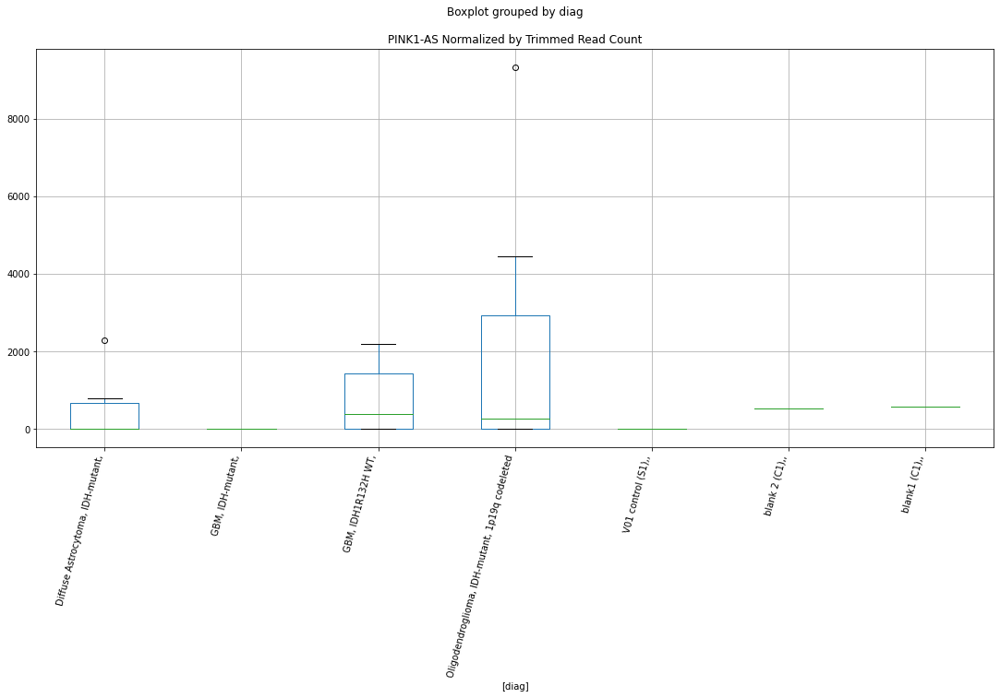

 p : 0.013451997435934539  ( t : 2.740149039960832 ) :  D-plex  :  bbduk2  :  SLA
Control and blanks
73     4638.05
337       0.00
Name: SLA, dtype: float64
205    9670.91
Name: SLA, dtype: float64
469    0.0
Name: SLA, dtype: float64


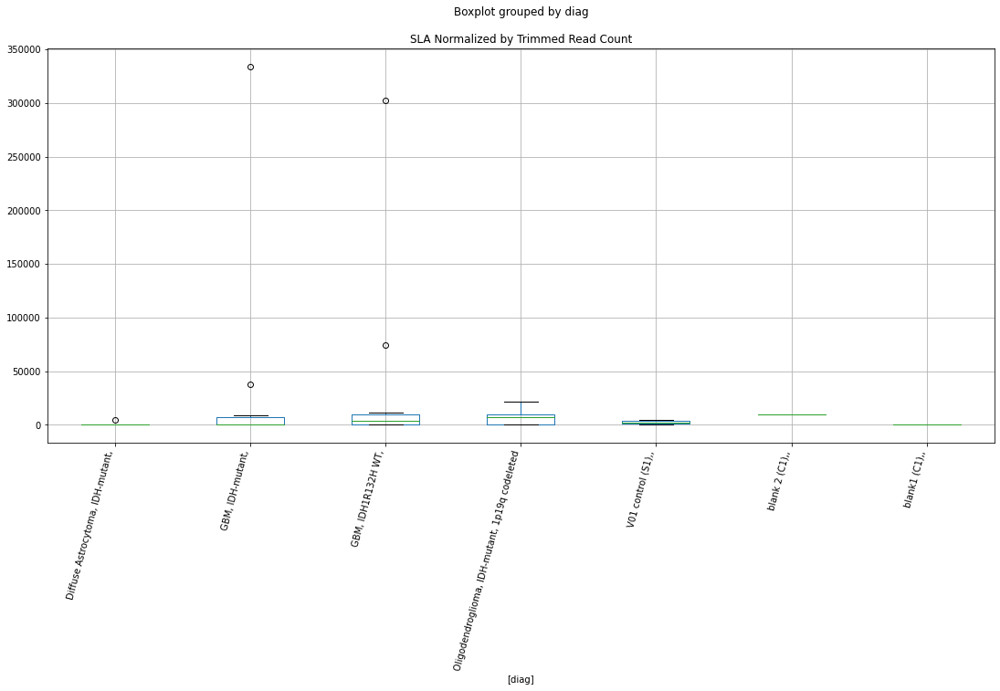

 p : 0.013623454746124183  ( t : 2.7342059355850643 ) :  D-plex  :  bbduk2  :  RHOH
Control and blanks
73     0.0
337    0.0
Name: RHOH, dtype: float64
205    29370.92
Name: RHOH, dtype: float64
469    9464.44
Name: RHOH, dtype: float64


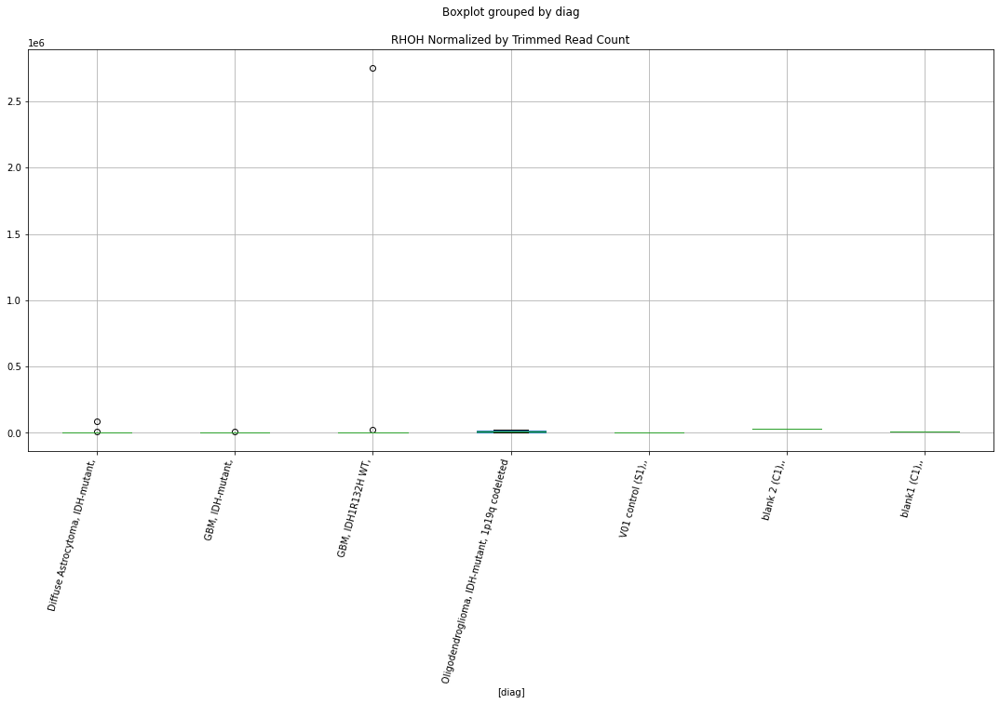

 p : 0.013668360690765458  ( t : 2.732661224322617 ) :  D-plex  :  cutadapt2  :  SLA
Control and blanks
76     4545.69
340       0.00
Name: SLA, dtype: float64
208    9523.45
Name: SLA, dtype: float64
472    0.0
Name: SLA, dtype: float64


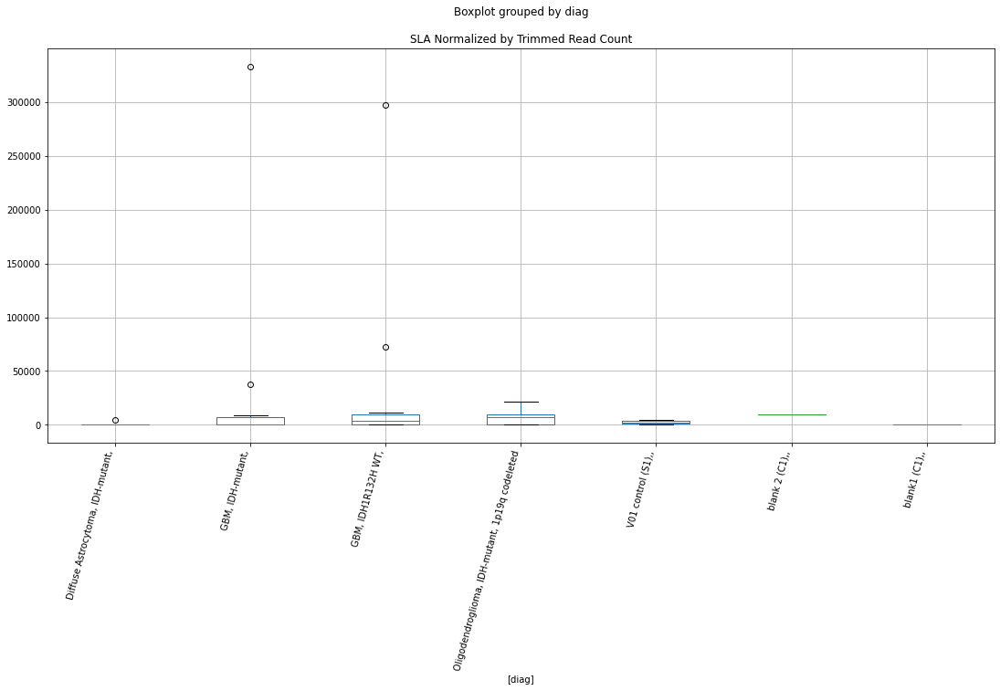

 p : 0.013673531939159033  ( t : 2.7324836514801705 ) :  D-plex  :  bbduk2  :  RNF187
Control and blanks
73     0.0
337    0.0
Name: RNF187, dtype: float64
205    0.0
Name: RNF187, dtype: float64
469    2366.11
Name: RNF187, dtype: float64


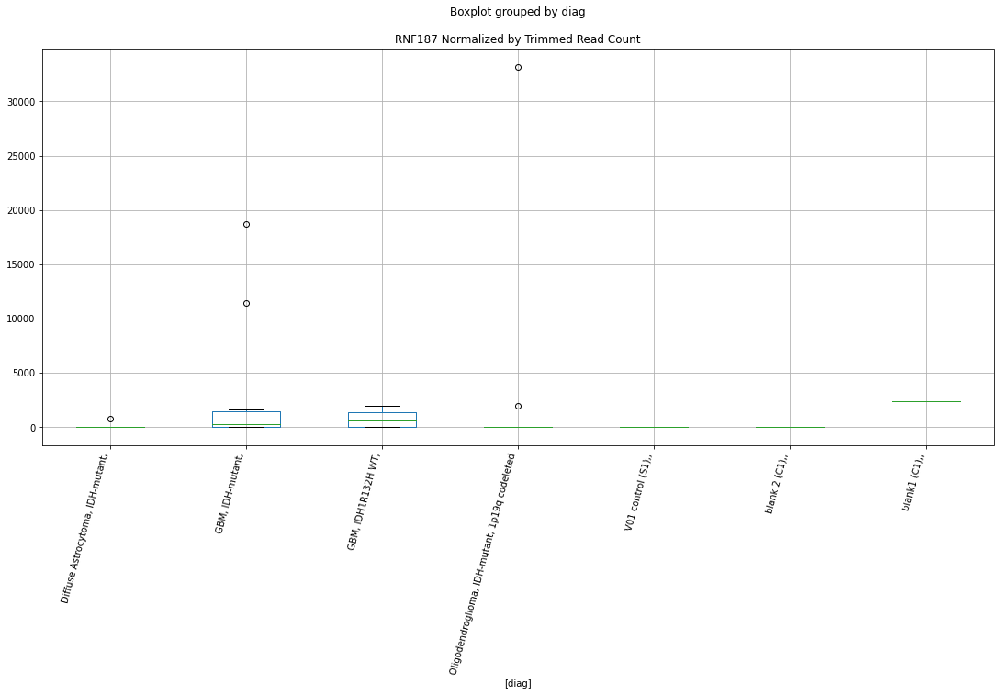

 p : 0.013679762977638853  ( t : 2.732269772408984 ) :  D-plex  :  cutadapt2  :  SAP130
Control and blanks
76     454568.53
340     95119.07
Name: SAP130, dtype: float64
208    184120.07
Name: SAP130, dtype: float64
472    187257.69
Name: SAP130, dtype: float64


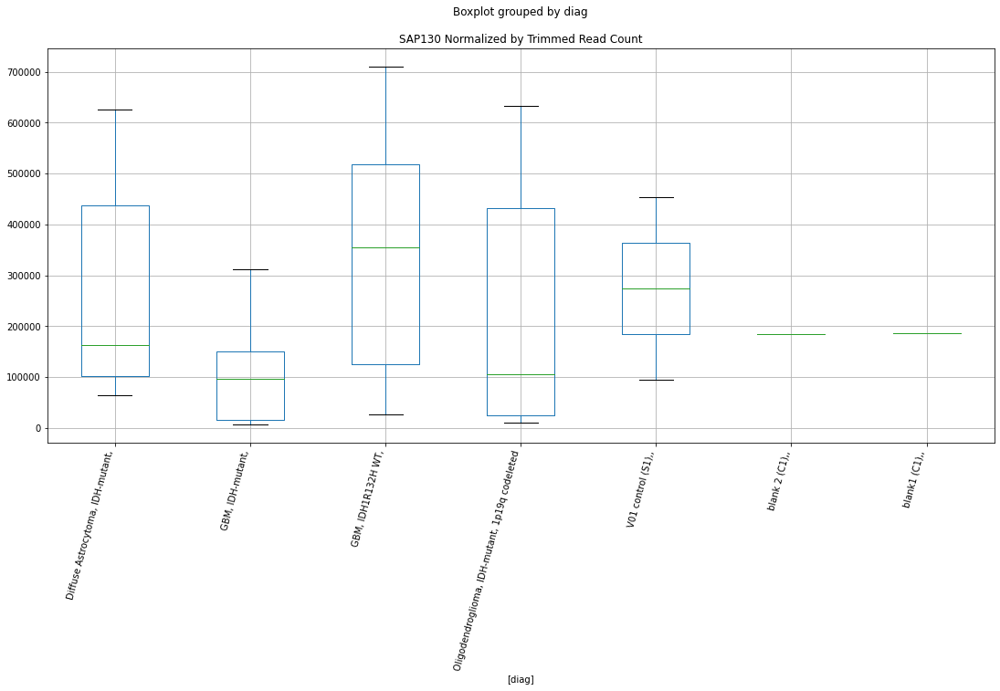

 p : 0.013749113698384484  ( t : 2.7298955965834257 ) :  D-plex  :  bbduk2  :  PSMB1
Control and blanks
73     0.0
337    0.0
Name: PSMB1, dtype: float64
205    358.18
Name: PSMB1, dtype: float64
469    0.0
Name: PSMB1, dtype: float64


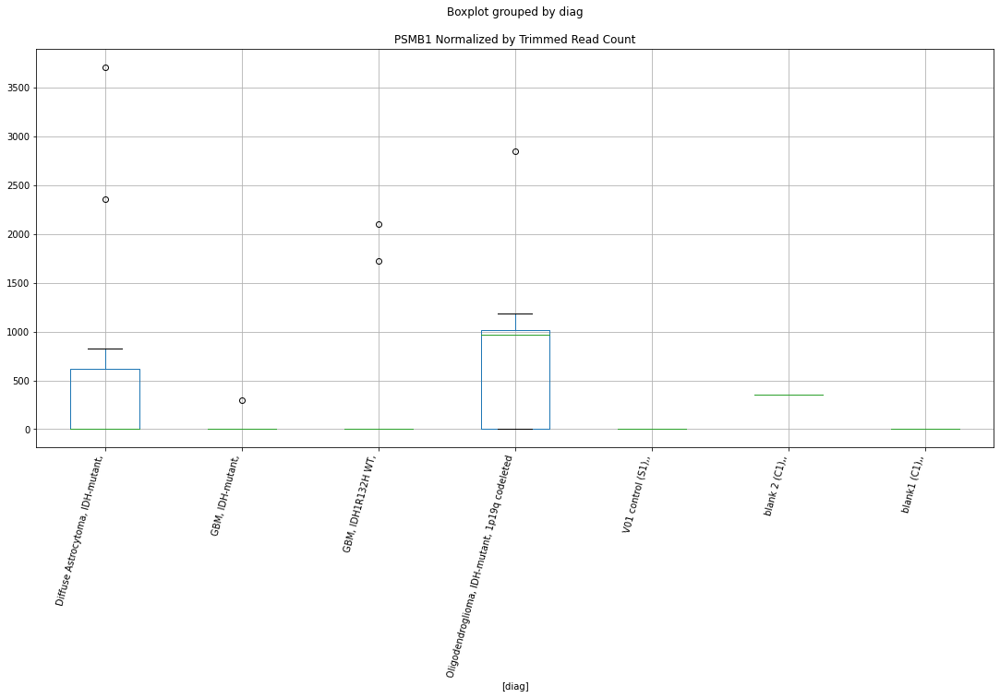

 p : 0.01375291894175595  ( t : 2.7297656584779078 ) :  D-plex  :  bbduk2  :  POLR2F
Control and blanks
73     0.0
337    0.0
Name: POLR2F, dtype: float64
205    1074.55
Name: POLR2F, dtype: float64
469    0.0
Name: POLR2F, dtype: float64


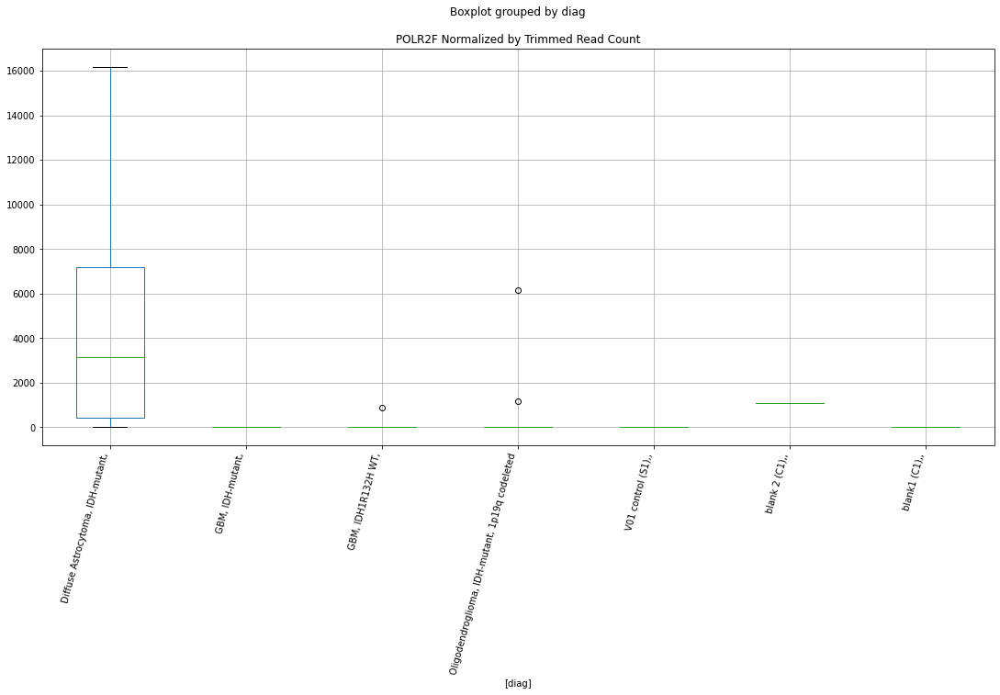

 p : 0.013811304318212887  ( t : 2.727776267443182 ) :  D-plex  :  cutadapt2  :  SLC7A1
Control and blanks
76     0.0
340    0.0
Name: SLC7A1, dtype: float64
208    6701.69
Name: SLC7A1, dtype: float64
472    7513.43
Name: SLC7A1, dtype: float64


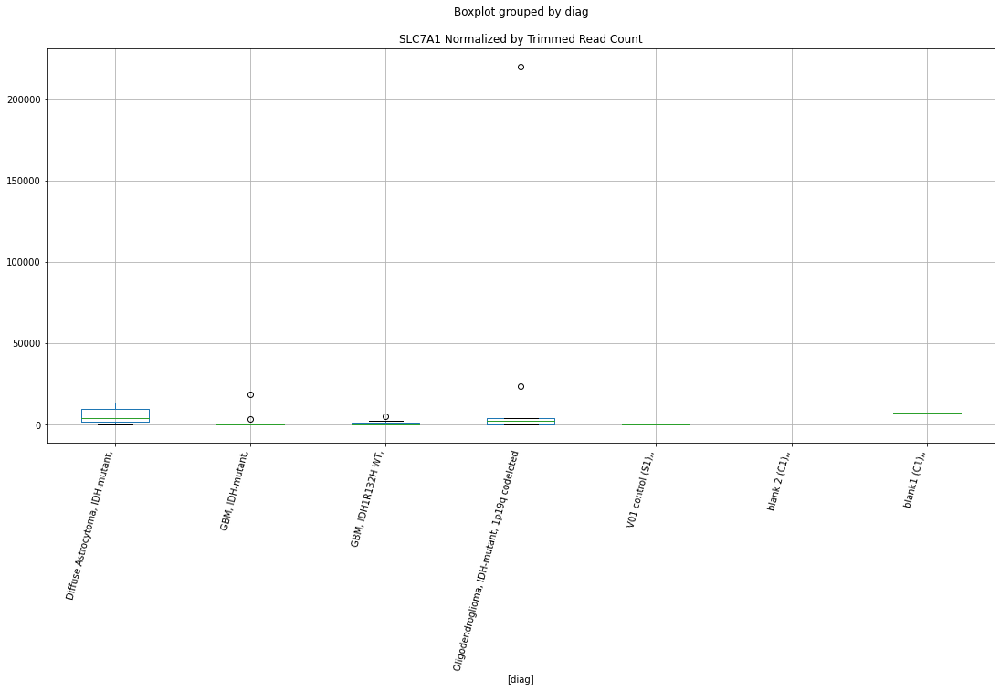

 p : 0.014009289565319683  ( t : 2.721089615283459 ) :  D-plex  :  cutadapt2  :  OXTR
Control and blanks
76     1.06e+06
340    1.28e+05
Name: OXTR, dtype: float64
208    1.53e+06
Name: OXTR, dtype: float64
472    239851.67
Name: OXTR, dtype: float64


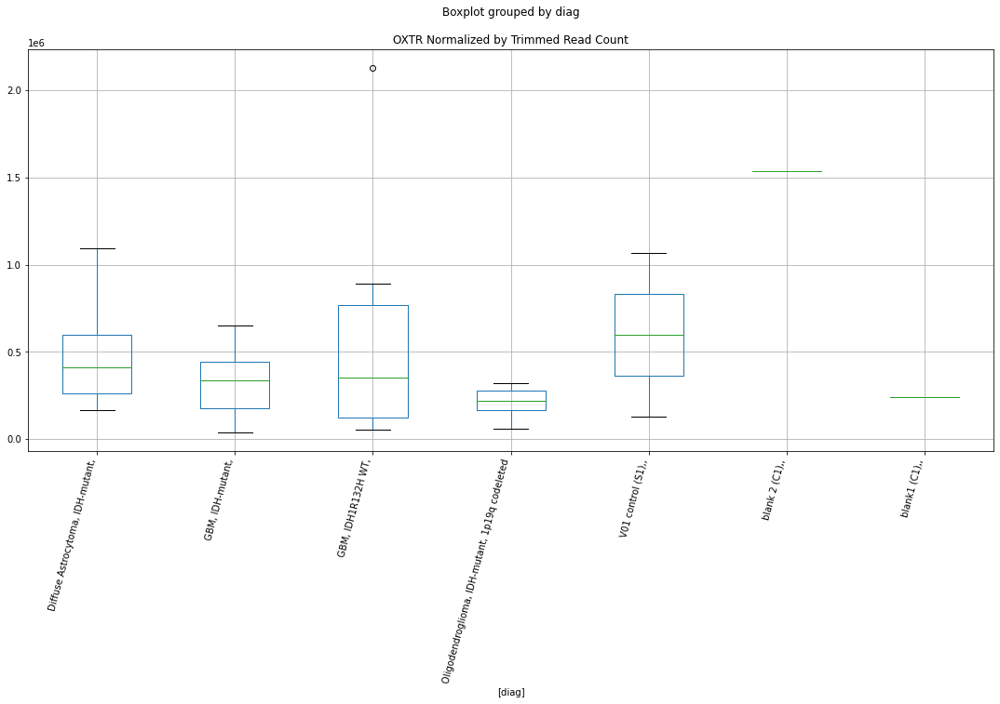

 p : 0.014060005066596657  ( t : 2.7193913194318355 ) :  D-plex  :  cutadapt2  :  PM20D2
Control and blanks
76     0.0
340    0.0
Name: PM20D2, dtype: float64
208    2645.4
Name: PM20D2, dtype: float64
472    6357.51
Name: PM20D2, dtype: float64


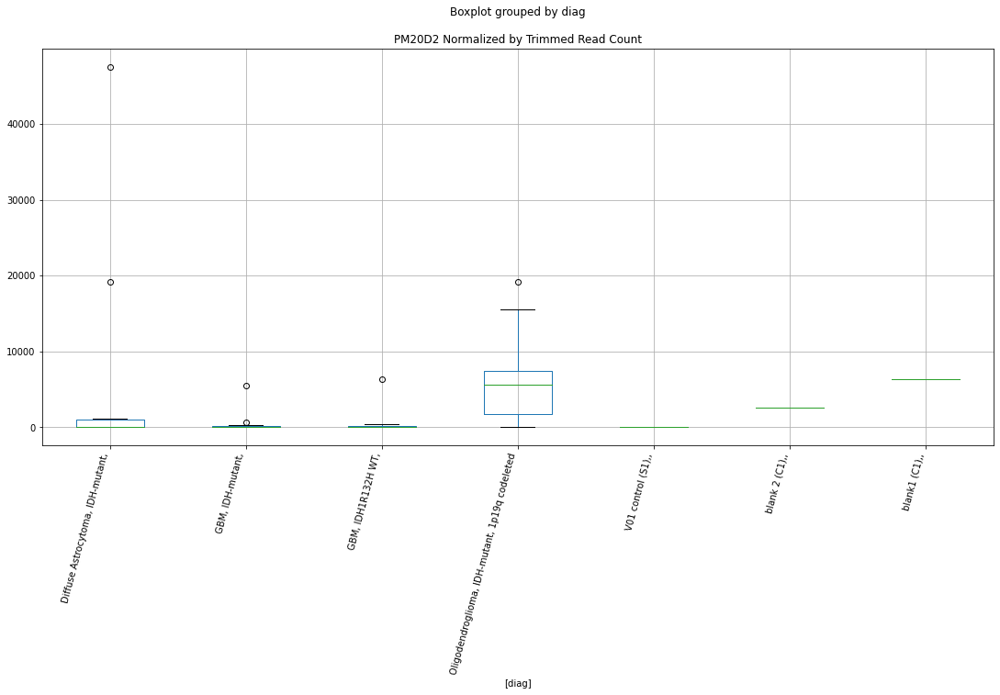

 p : 0.014120378132279164  ( t : 2.7173772443636377 ) :  D-plex  :  cutadapt2  :  PSMB1
Control and blanks
76       0.00
340    880.73
Name: PSMB1, dtype: float64
208    352.72
Name: PSMB1, dtype: float64
472    0.0
Name: PSMB1, dtype: float64


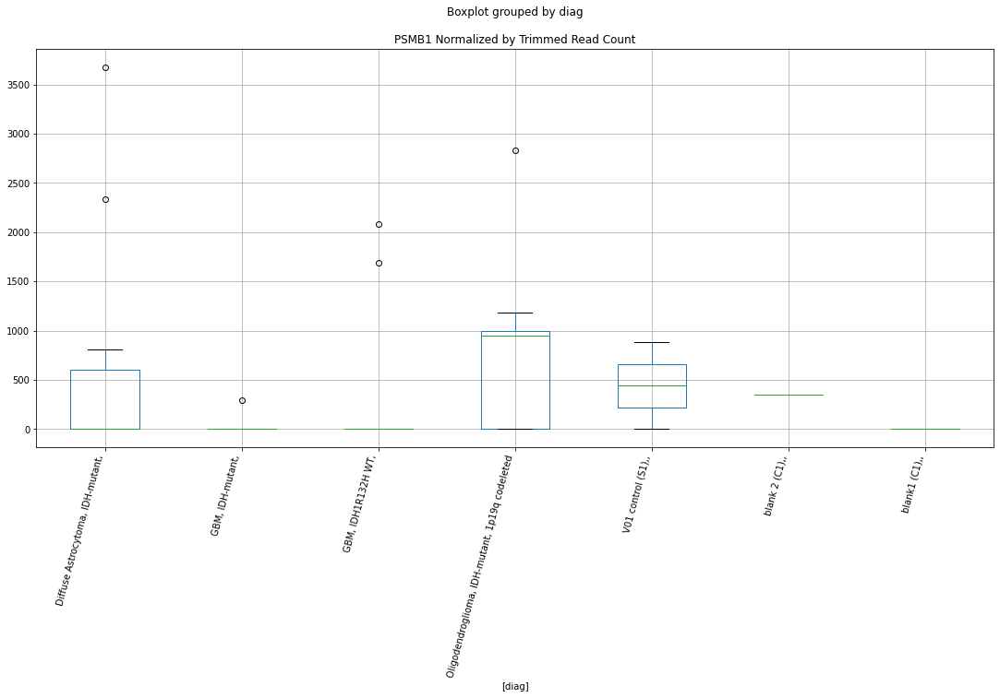

 p : 0.014244693160999022  ( t : 2.7132558370065265 ) :  Lexogen  :  cutadapt2  :  RIMBP3C
Control and blanks
82     0.0
346    0.0
Name: RIMBP3C, dtype: float64
214    0.0
Name: RIMBP3C, dtype: float64
478    237.46
Name: RIMBP3C, dtype: float64


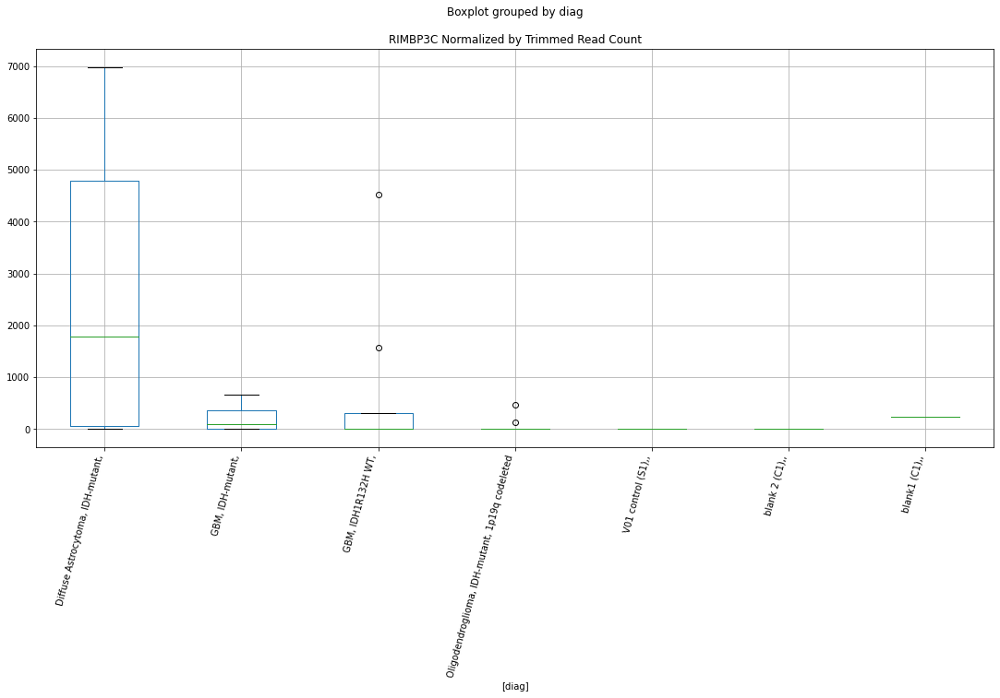

 p : 0.014244693160999022  ( t : 2.7132558370065265 ) :  Lexogen  :  cutadapt2  :  RIMBP3B
Control and blanks
82     0.0
346    0.0
Name: RIMBP3B, dtype: float64
214    0.0
Name: RIMBP3B, dtype: float64
478    237.46
Name: RIMBP3B, dtype: float64


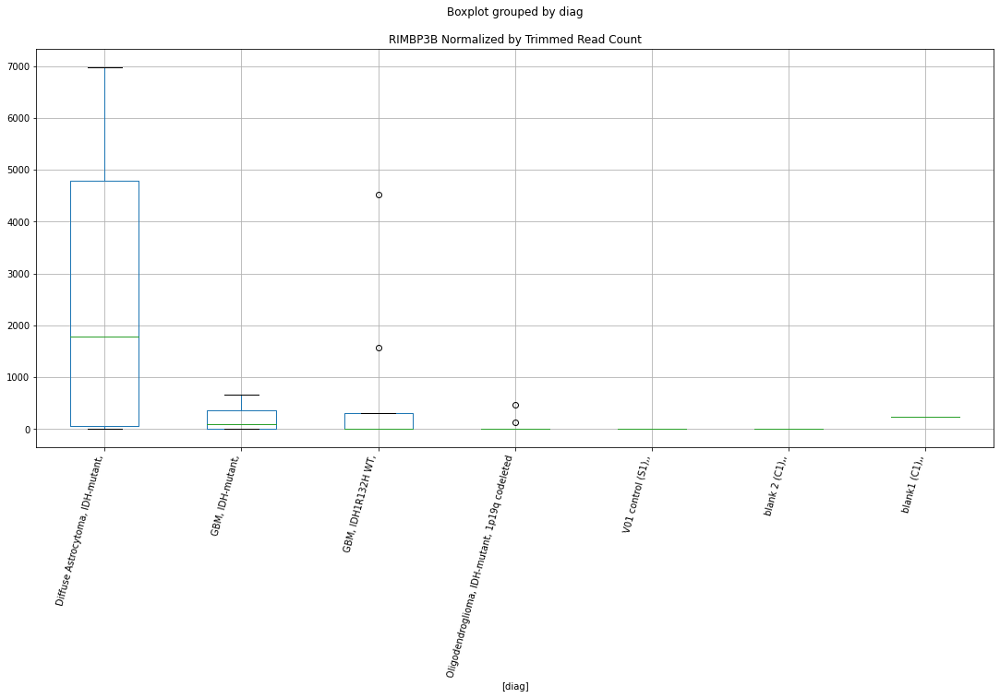

 p : 0.014335078757701902  ( t : 2.7102808210853437 ) :  Lexogen  :  bbduk2  :  SMOC2
Control and blanks
79       0.00
343    849.26
Name: SMOC2, dtype: float64
211    22957.73
Name: SMOC2, dtype: float64
475    0.0
Name: SMOC2, dtype: float64


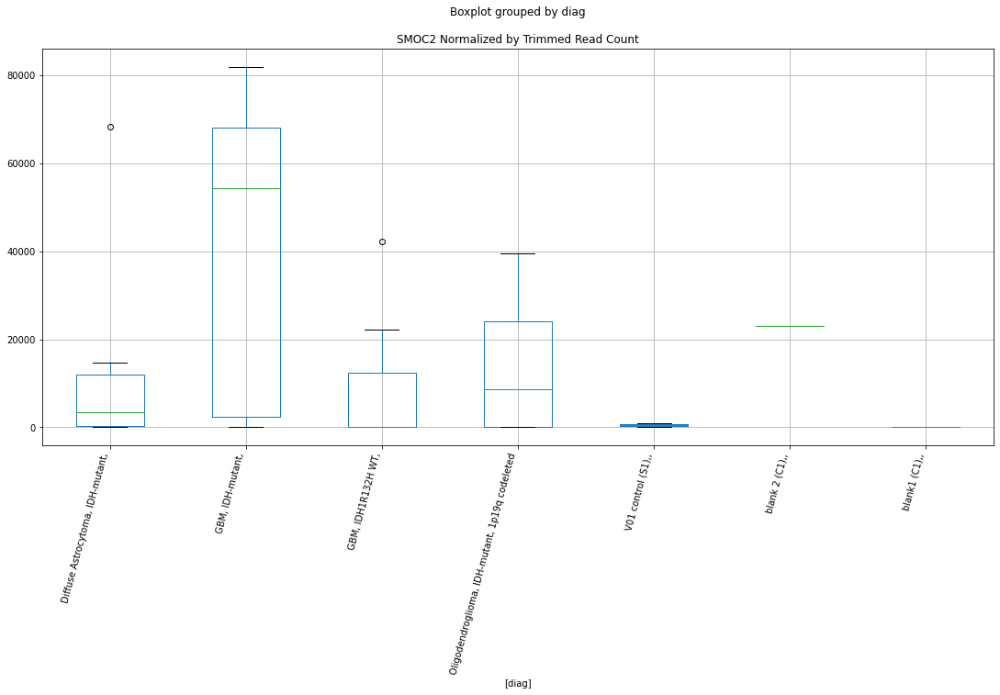

 p : 0.014445362076604828  ( t : 2.706675064958783 ) :  Lexogen  :  bbduk2  :  PNPLA6
Control and blanks
79          0.00
343    156051.02
Name: PNPLA6, dtype: float64
211    0.0
Name: PNPLA6, dtype: float64
475    0.0
Name: PNPLA6, dtype: float64


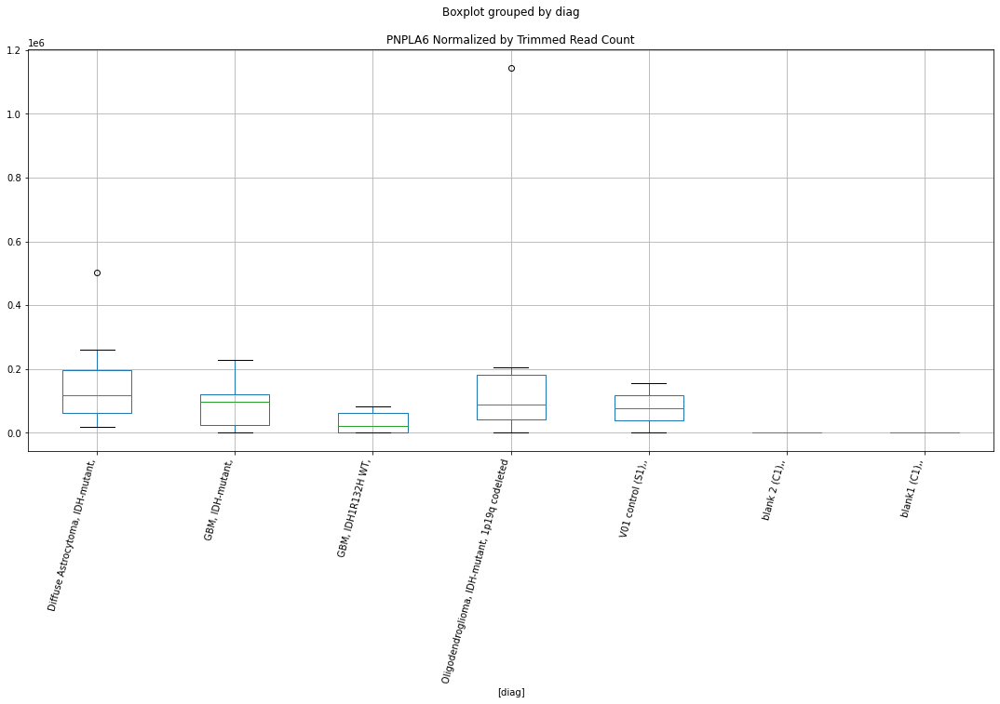

 p : 0.01452626854045293  ( t : 2.704046485475616 ) :  Lexogen  :  cutadapt2  :  PNPLA6
Control and blanks
82          0.00
346    155721.55
Name: PNPLA6, dtype: float64
214    0.0
Name: PNPLA6, dtype: float64
478    0.0
Name: PNPLA6, dtype: float64


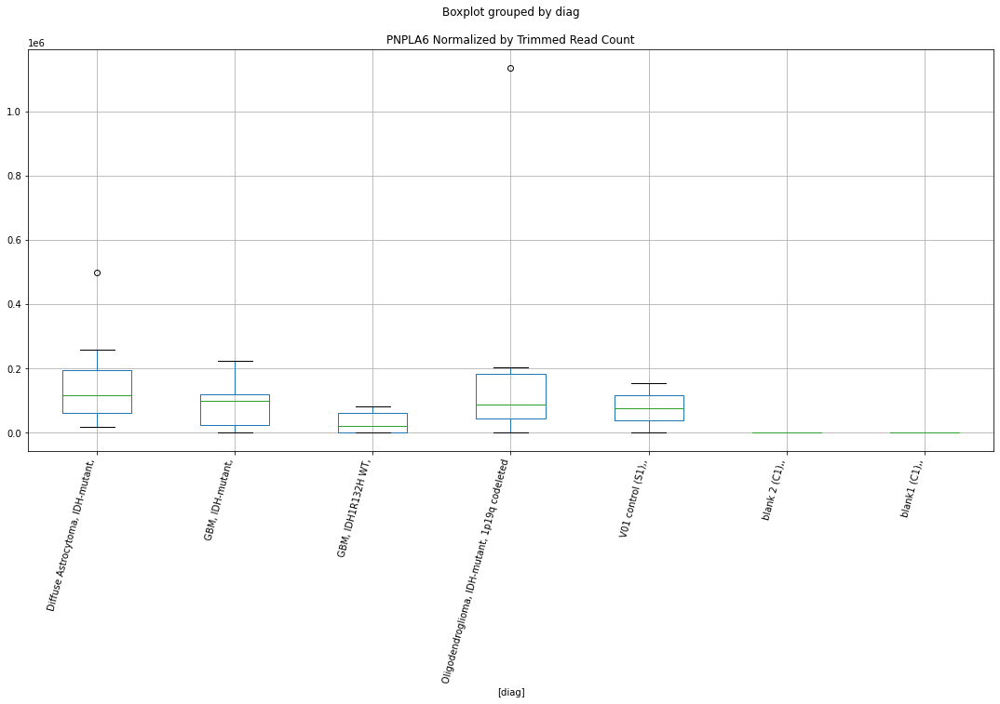

 p : 0.01473178014236667  ( t : 2.697431964570469 ) :  Lexogen  :  cutadapt2  :  SLC23A2
Control and blanks
82     0.0
346    0.0
Name: SLC23A2, dtype: float64
214    0.0
Name: SLC23A2, dtype: float64
478    0.0
Name: SLC23A2, dtype: float64


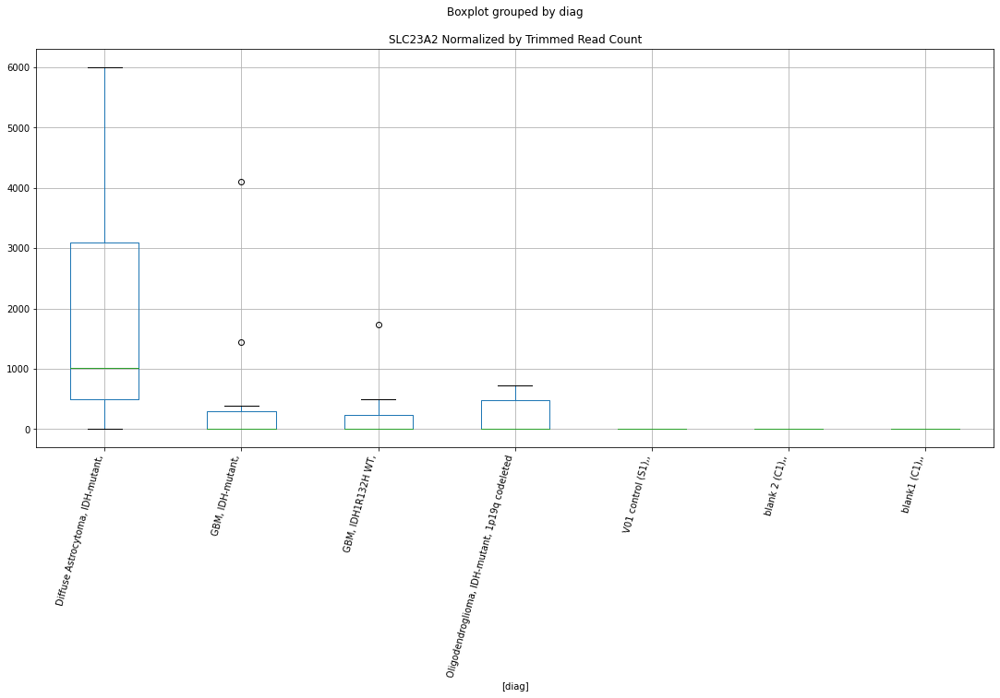

 p : 0.014776111246059584  ( t : 2.696016701305047 ) :  D-plex  :  bbduk2  :  PRKY
Control and blanks
73     1546.02
337       0.00
Name: PRKY, dtype: float64
205    37788.19
Name: PRKY, dtype: float64
469    0.0
Name: PRKY, dtype: float64


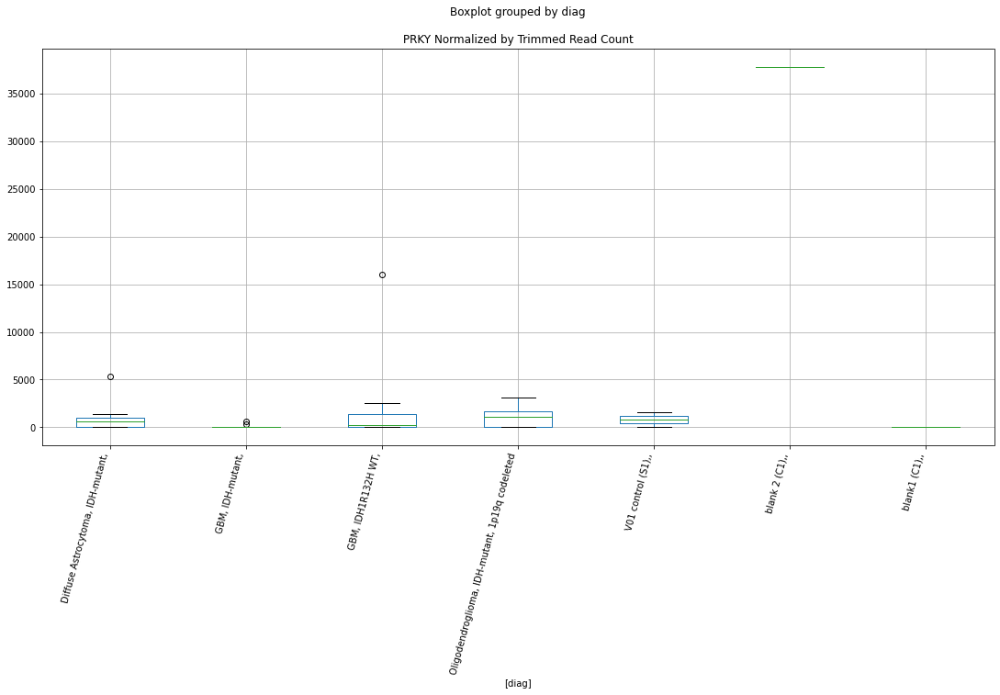

 p : 0.014819047967249132  ( t : 2.6946498134997676 ) :  Lexogen  :  bbduk2  :  RIMBP3B
Control and blanks
79       0.00
343    212.31
Name: RIMBP3B, dtype: float64
211    0.0
Name: RIMBP3B, dtype: float64
475    239.52
Name: RIMBP3B, dtype: float64


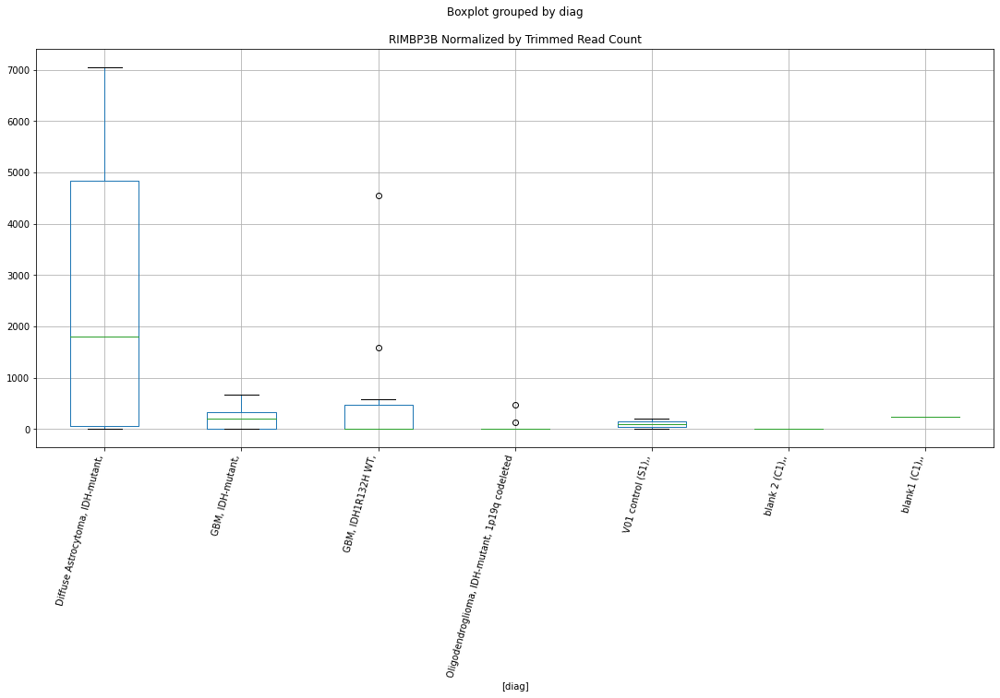

 p : 0.014819047967249132  ( t : 2.6946498134997676 ) :  Lexogen  :  bbduk2  :  RIMBP3C
Control and blanks
79       0.00
343    212.31
Name: RIMBP3C, dtype: float64
211    0.0
Name: RIMBP3C, dtype: float64
475    239.52
Name: RIMBP3C, dtype: float64


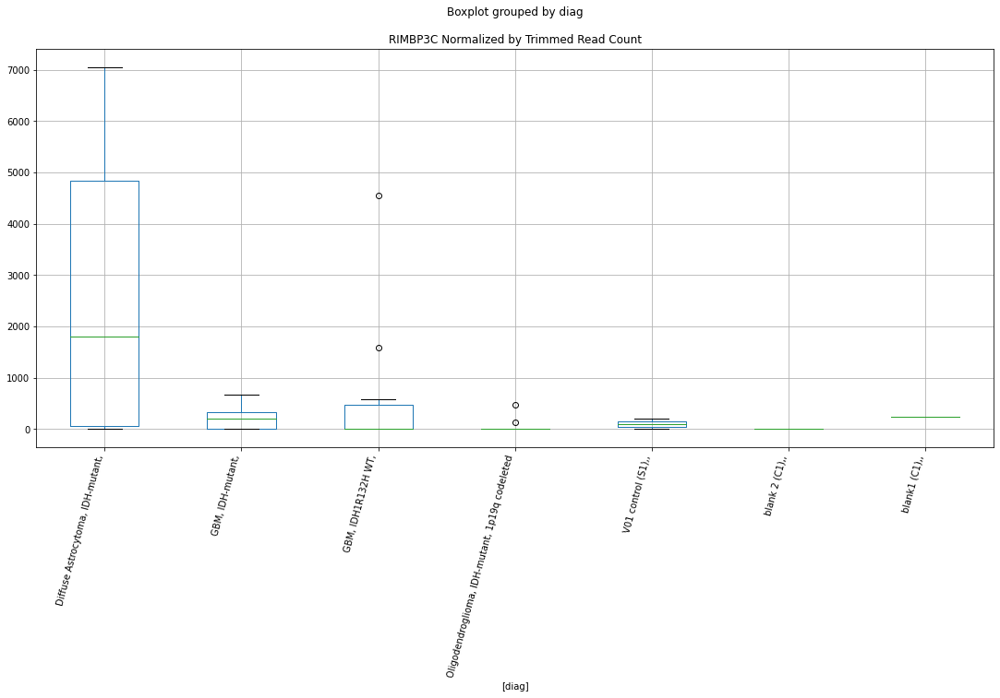

 p : 0.014879142490531669  ( t : 2.692743044687266 ) :  D-plex  :  bbduk2  :  RTN3
Control and blanks
73     3865.04
337    4450.79
Name: RTN3, dtype: float64
205    7342.73
Name: RTN3, dtype: float64
469    16562.76
Name: RTN3, dtype: float64


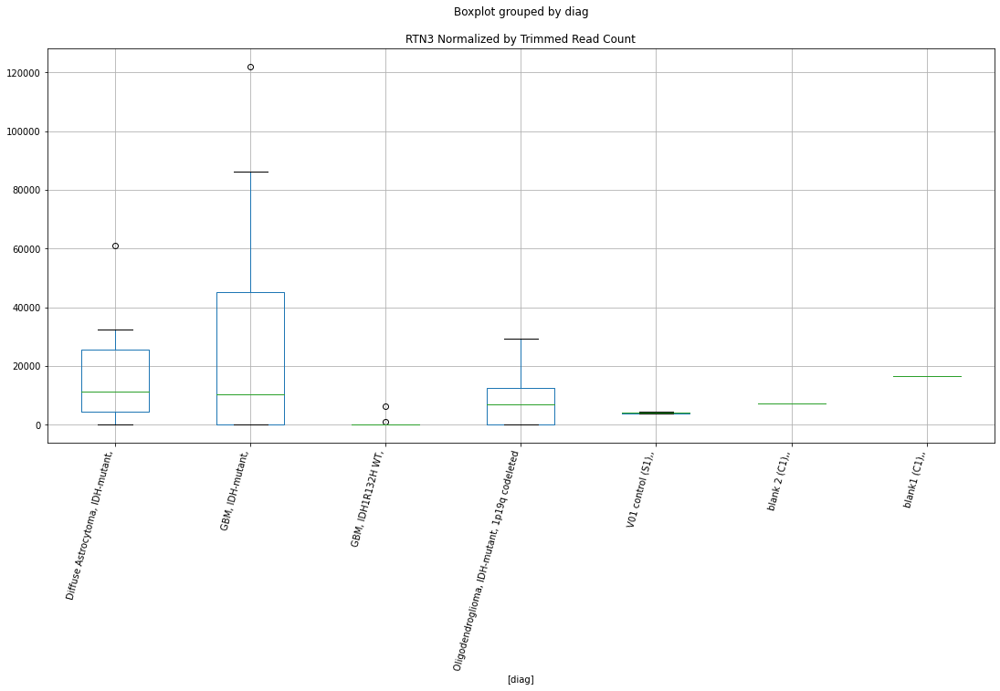

 p : 0.01492627088840359  ( t : 2.6912528215307154 ) :  Lexogen  :  bbduk2  :  REC114
Control and blanks
79         0.00
343    25902.35
Name: REC114, dtype: float64
211    0.0
Name: REC114, dtype: float64
475    0.0
Name: REC114, dtype: float64


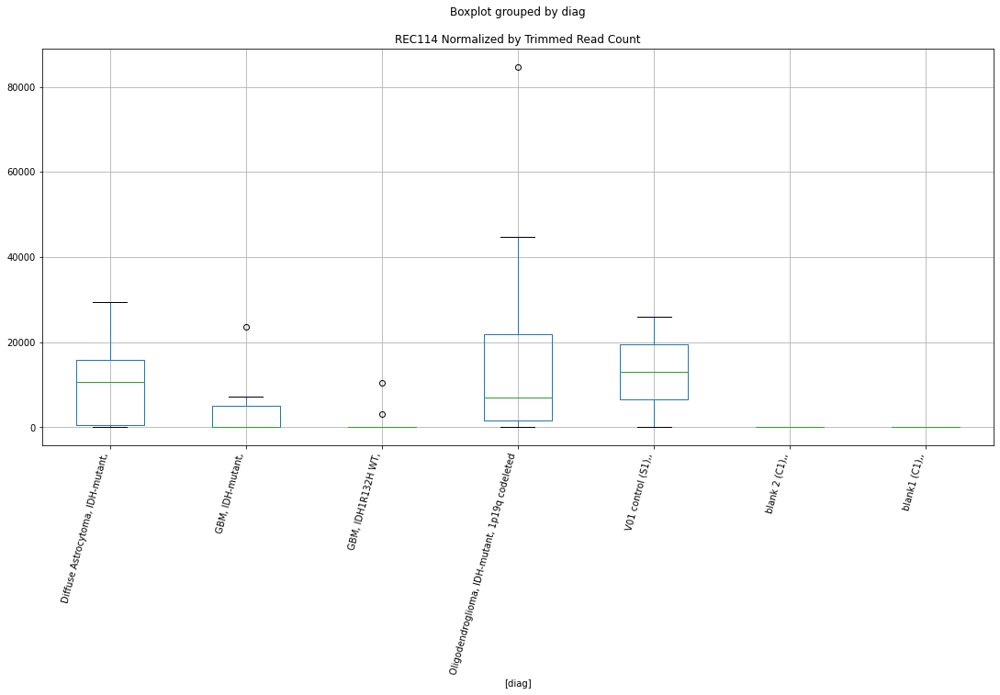

 p : 0.014951553711570533  ( t : 2.6904552164112205 ) :  Lexogen  :  cutadapt2  :  RIMBP3
Control and blanks
82     0.0
346    0.0
Name: RIMBP3, dtype: float64
214    0.0
Name: RIMBP3, dtype: float64
478    237.46
Name: RIMBP3, dtype: float64


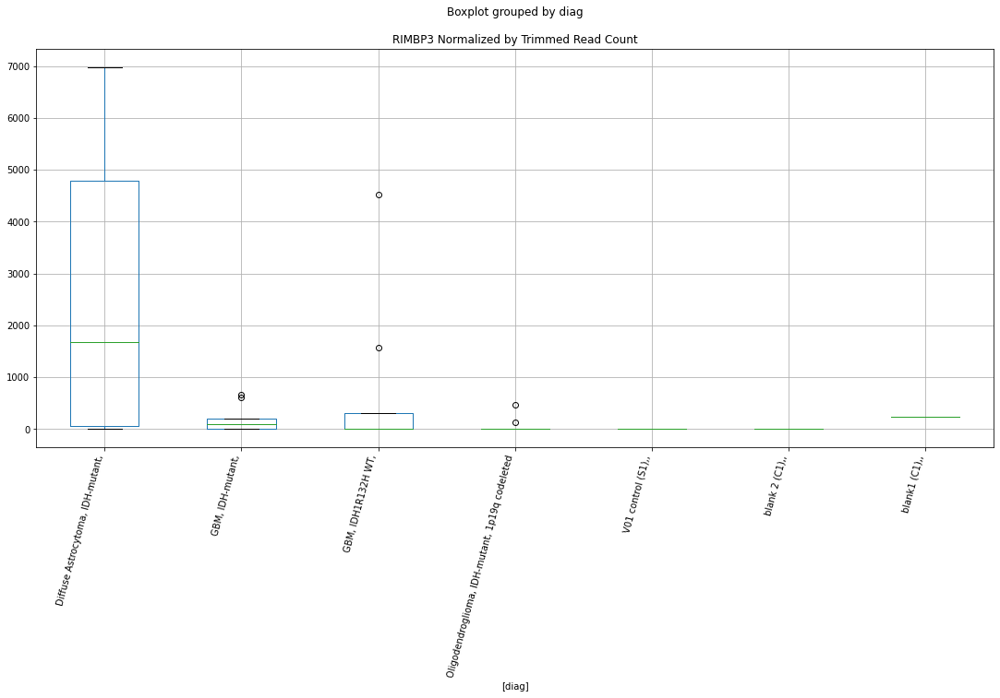

 p : 0.014968197519302178  ( t : 2.689930851462969 ) :  Lexogen  :  bbduk2  :  SLC25A31
Control and blanks
79     0.0
343    0.0
Name: SLC25A31, dtype: float64
211    0.0
Name: SLC25A31, dtype: float64
475    0.0
Name: SLC25A31, dtype: float64


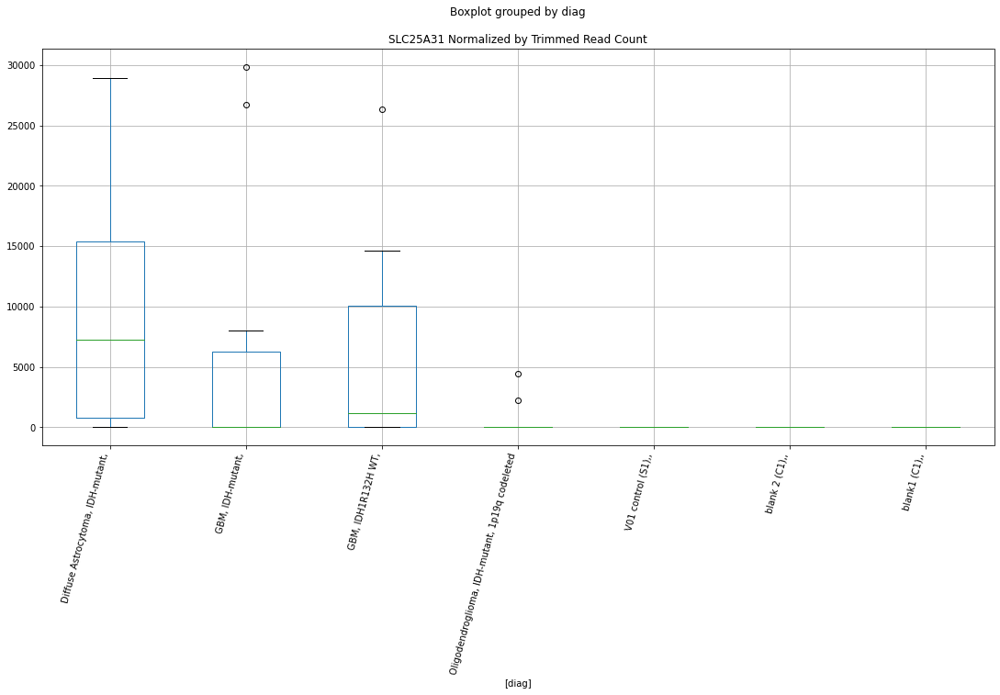

 p : 0.01498443286238738  ( t : 2.689419891206372 ) :  D-plex  :  bbduk2  :  RASSF3
Control and blanks
73     0.0
337    0.0
Name: RASSF3, dtype: float64
205    895.45
Name: RASSF3, dtype: float64
469    0.0
Name: RASSF3, dtype: float64


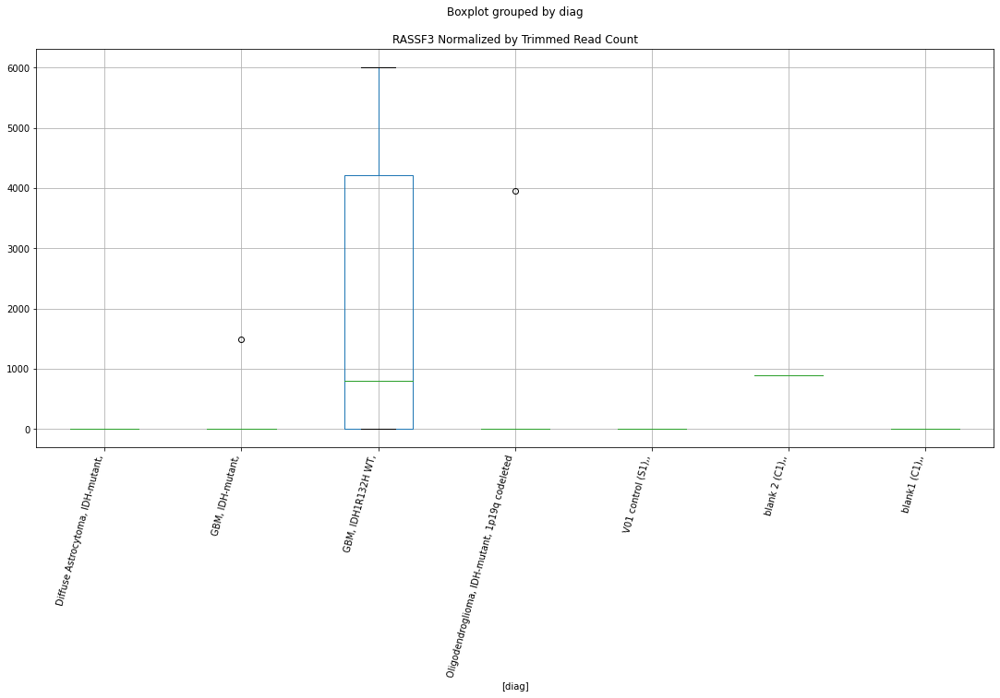

 p : 0.01498501247601632  ( t : 2.6894016593225487 ) :  D-plex  :  cutadapt2  :  SLC22A11
Control and blanks
76     0.0
340    0.0
Name: SLC22A11, dtype: float64
208    1058.16
Name: SLC22A11, dtype: float64
472    1733.87
Name: SLC22A11, dtype: float64


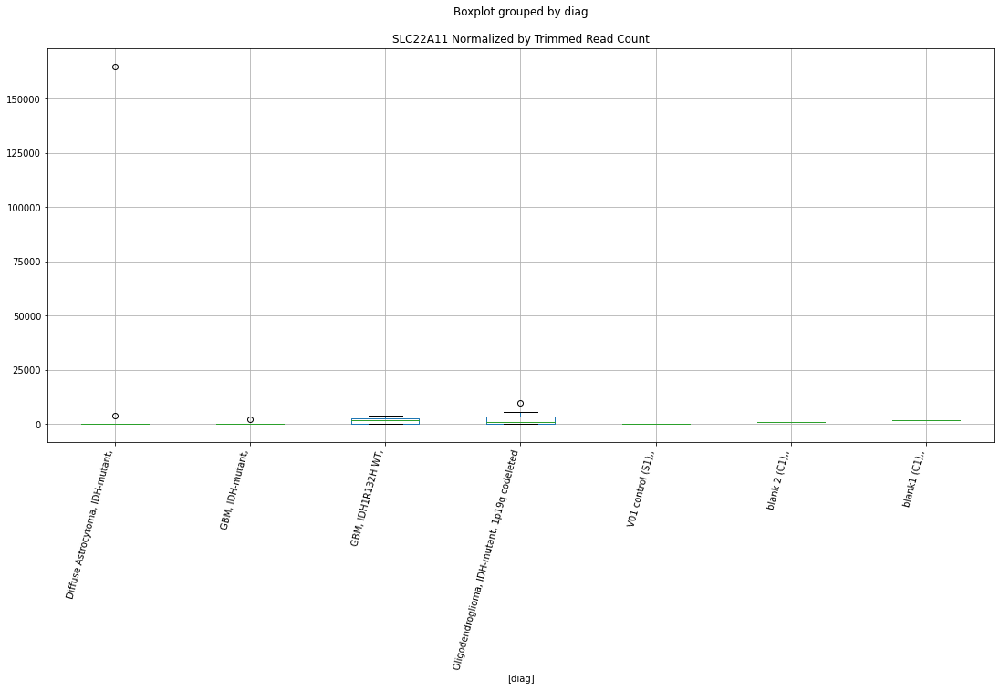

 p : 0.015130827003235928  ( t : 2.6848362776832193 ) :  Lexogen  :  cutadapt2  :  REC114
Control and blanks
82         0.00
346    25673.01
Name: REC114, dtype: float64
214    0.0
Name: REC114, dtype: float64
478    0.0
Name: REC114, dtype: float64


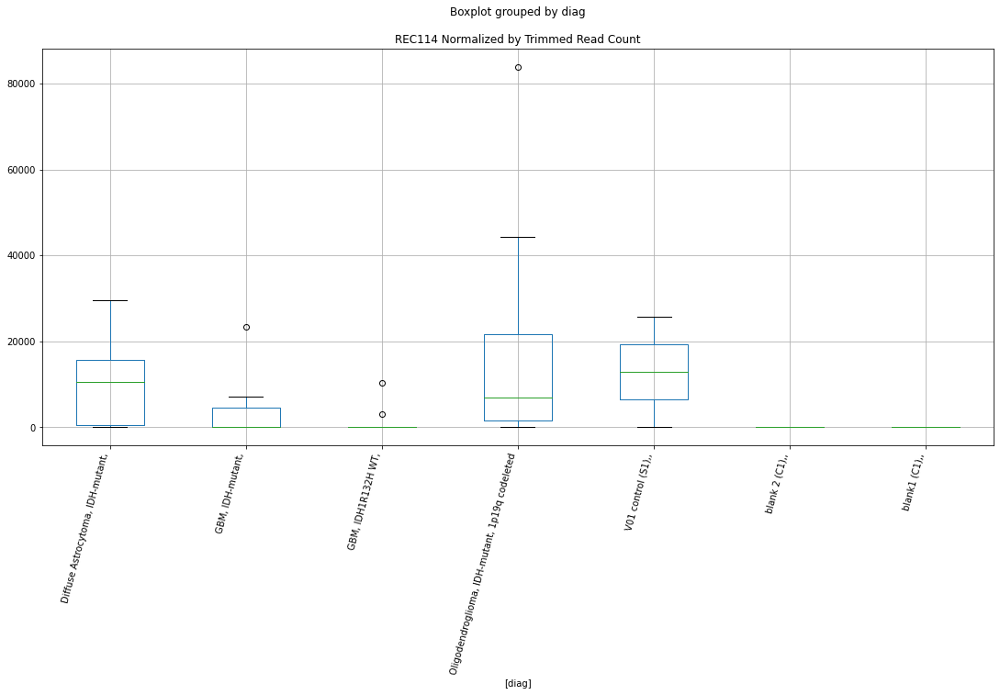

 p : 0.015162103183763412  ( t : 2.683862506332713 ) :  Lexogen  :  cutadapt2  :  SMOC2
Control and blanks
82       0.00
346    841.74
Name: SMOC2, dtype: float64
214    19528.3
Name: SMOC2, dtype: float64
478    0.0
Name: SMOC2, dtype: float64


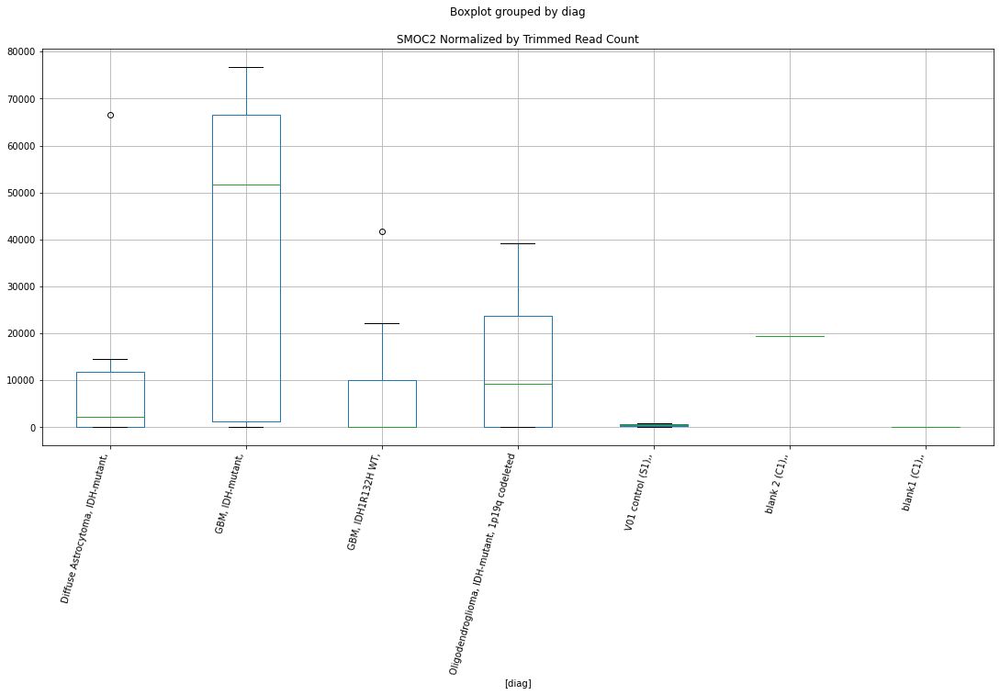

 p : 0.015179674391664191  ( t : 2.6833162743646635 ) :  Lexogen  :  bbduk2  :  PPP4R3A
Control and blanks
79        0.00
343    1698.51
Name: PPP4R3A, dtype: float64
211    0.0
Name: PPP4R3A, dtype: float64
475    0.0
Name: PPP4R3A, dtype: float64


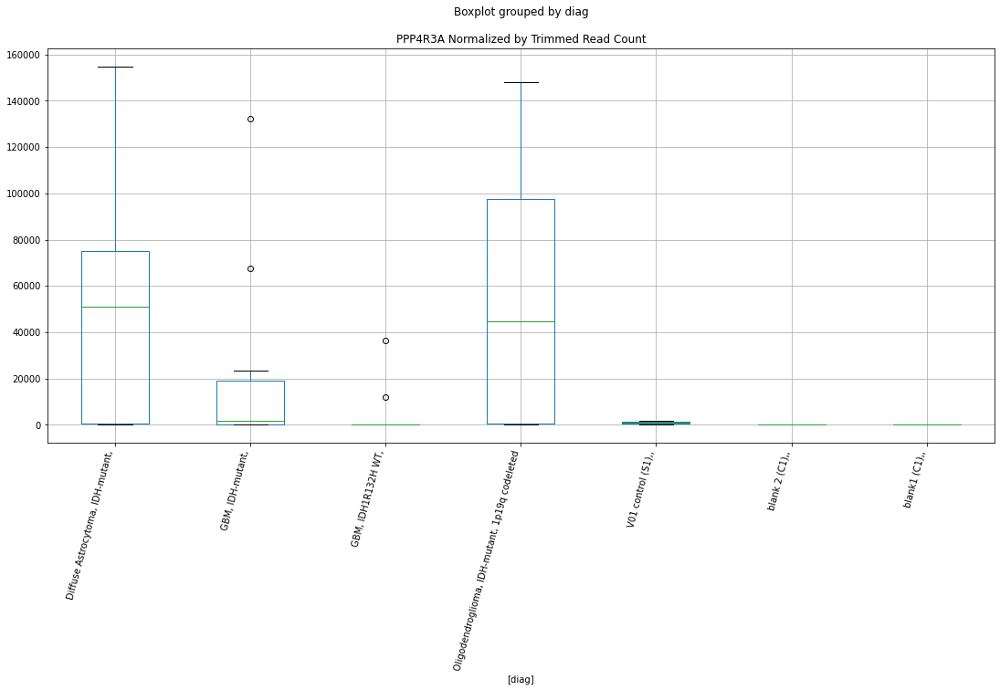

 p : 0.015314177891063943  ( t : 2.6791548684260005 ) :  D-plex  :  cutadapt2  :  SNX5
Control and blanks
76     0.0
340    0.0
Name: SNX5, dtype: float64
208    529.08
Name: SNX5, dtype: float64
472    3467.74
Name: SNX5, dtype: float64


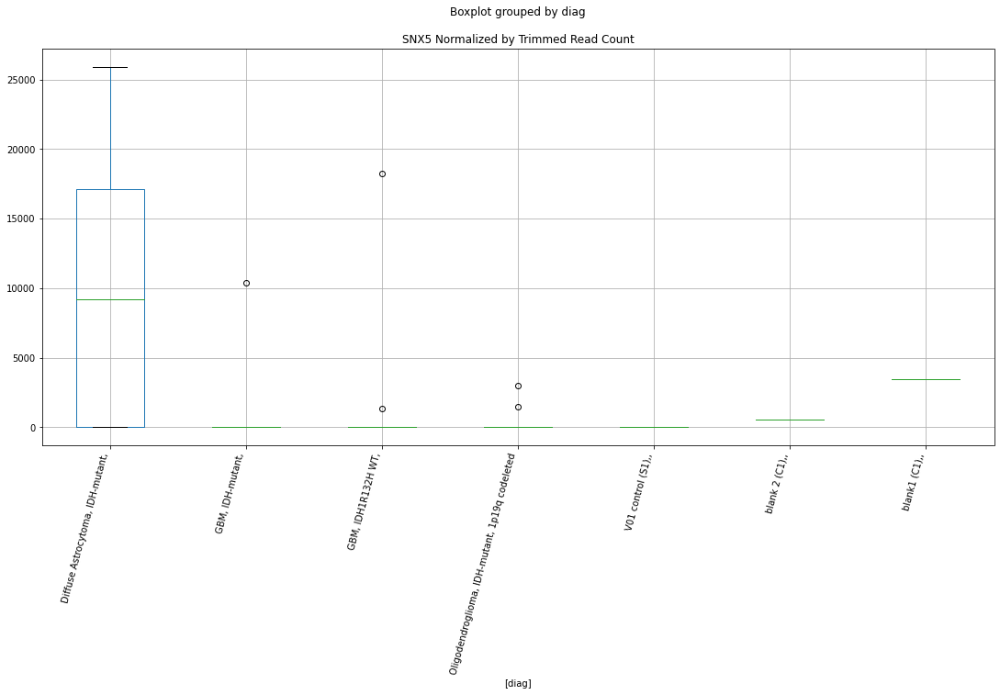

 p : 0.015356767427026142  ( t : 2.6778444561736787 ) :  D-plex  :  cutadapt2  :  SIGLEC10
Control and blanks
76     6818.53
340       0.00
Name: SIGLEC10, dtype: float64
208    11110.69
Name: SIGLEC10, dtype: float64
472    1.41e+06
Name: SIGLEC10, dtype: float64


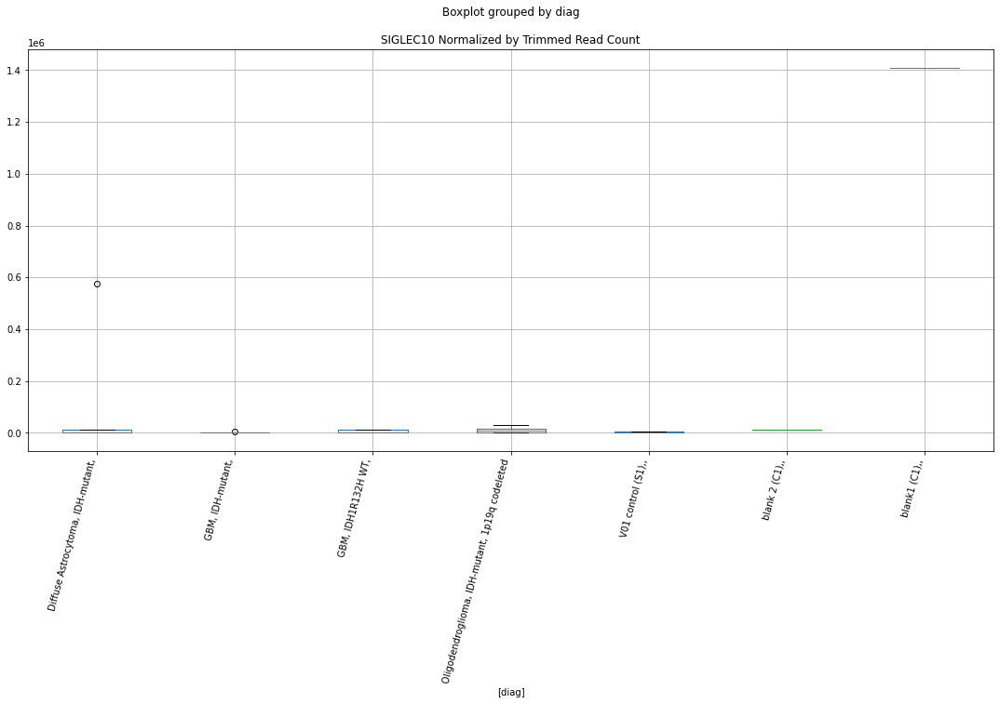

 p : 0.015363741219185533  ( t : 2.67763021403039 ) :  Lexogen  :  cutadapt2  :  PPP4R3A
Control and blanks
82        0.00
346    1683.48
Name: PPP4R3A, dtype: float64
214    0.0
Name: PPP4R3A, dtype: float64
478    0.0
Name: PPP4R3A, dtype: float64


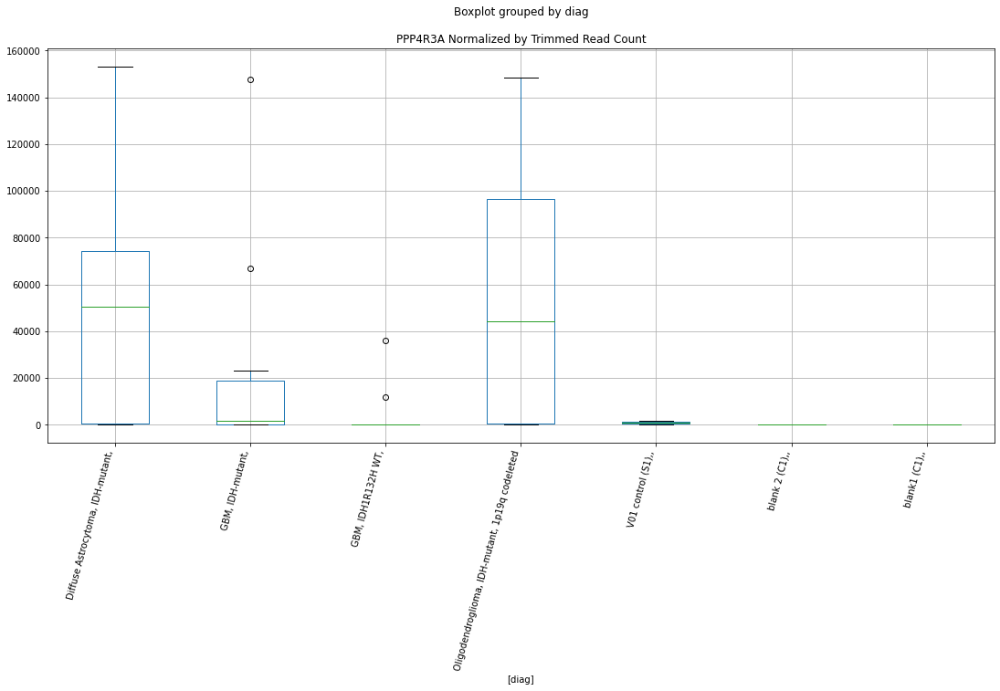

 p : 0.015371949686550404  ( t : 2.6773781601921733 ) :  D-plex  :  bbduk2  :  SNX5
Control and blanks
73     0.0
337    0.0
Name: SNX5, dtype: float64
205    537.27
Name: SNX5, dtype: float64
469    3549.16
Name: SNX5, dtype: float64


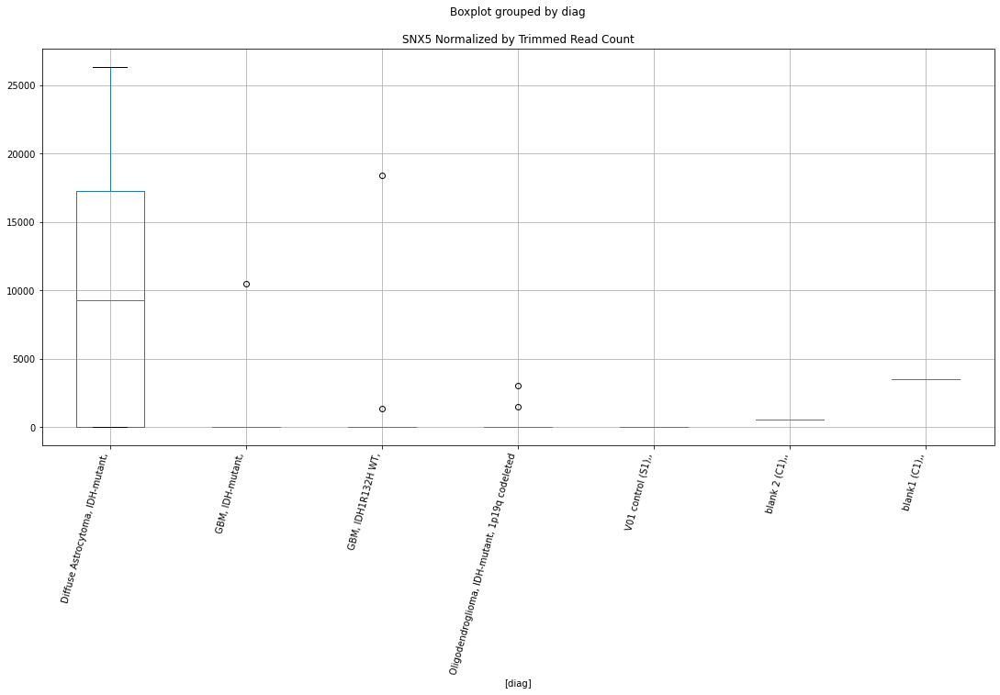

 p : 0.015559669537620767  ( t : 2.671648689298992 ) :  D-plex  :  bbduk2  :  SDC4
Control and blanks
73     0.0
337    0.0
Name: SDC4, dtype: float64
205    537.27
Name: SDC4, dtype: float64
469    1774.58
Name: SDC4, dtype: float64


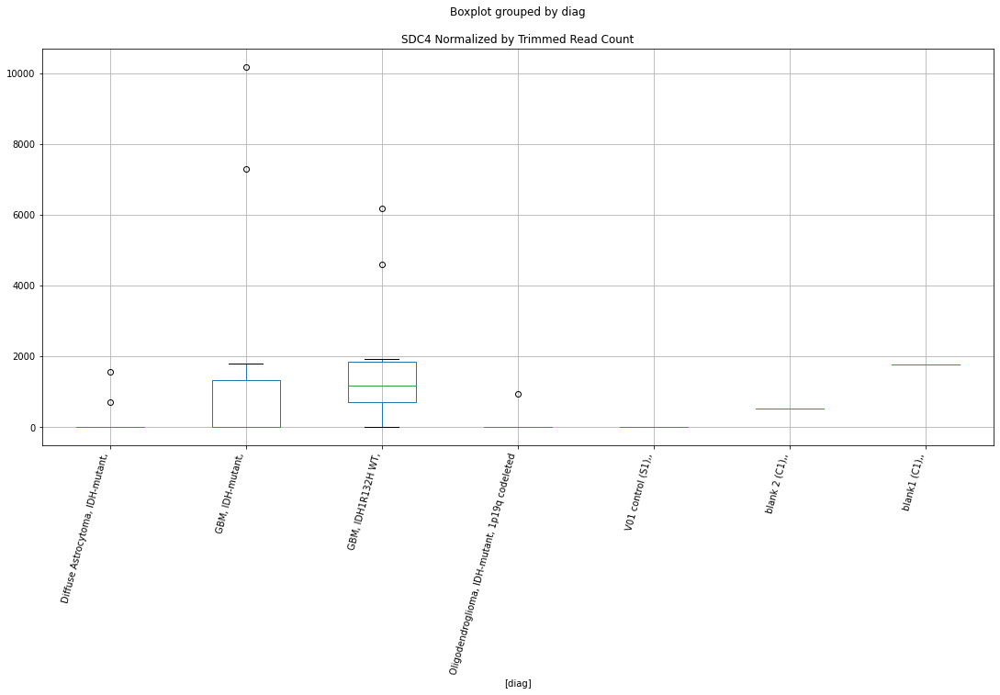

 p : 0.015608943536942844  ( t : 2.670155700062044 ) :  Lexogen  :  bbduk2  :  RIMBP3
Control and blanks
79       0.00
343    212.31
Name: RIMBP3, dtype: float64
211    0.0
Name: RIMBP3, dtype: float64
475    239.52
Name: RIMBP3, dtype: float64


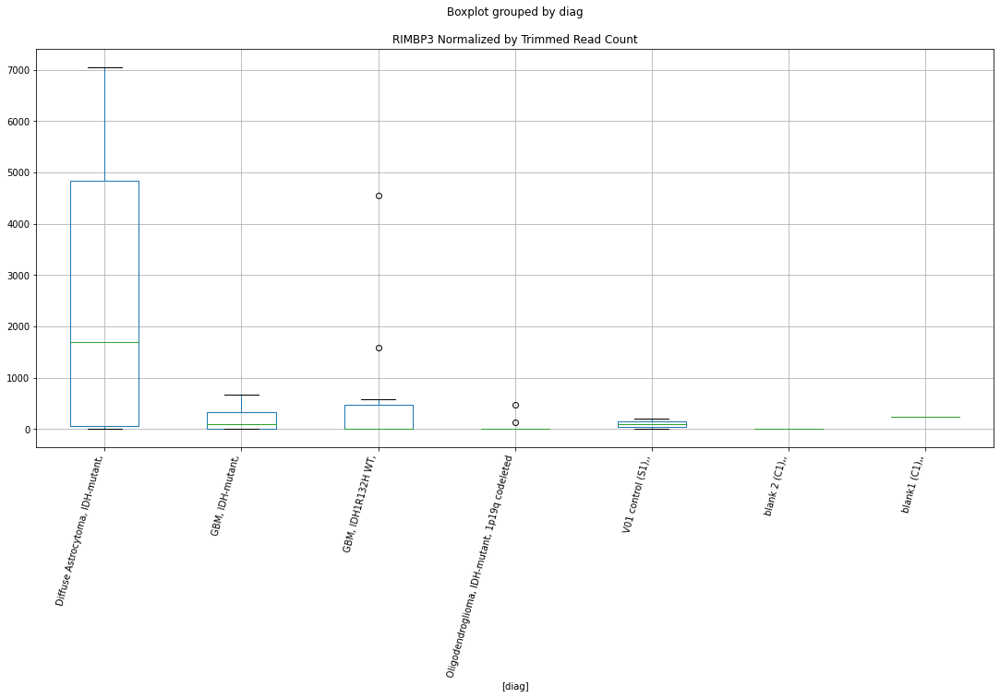

 p : 0.015695472400045637  ( t : 2.6675447382656383 ) :  Lexogen  :  cutadapt2  :  PRUNE1
Control and blanks
82     0.0
346    0.0
Name: PRUNE1, dtype: float64
214    0.0
Name: PRUNE1, dtype: float64
478    0.0
Name: PRUNE1, dtype: float64


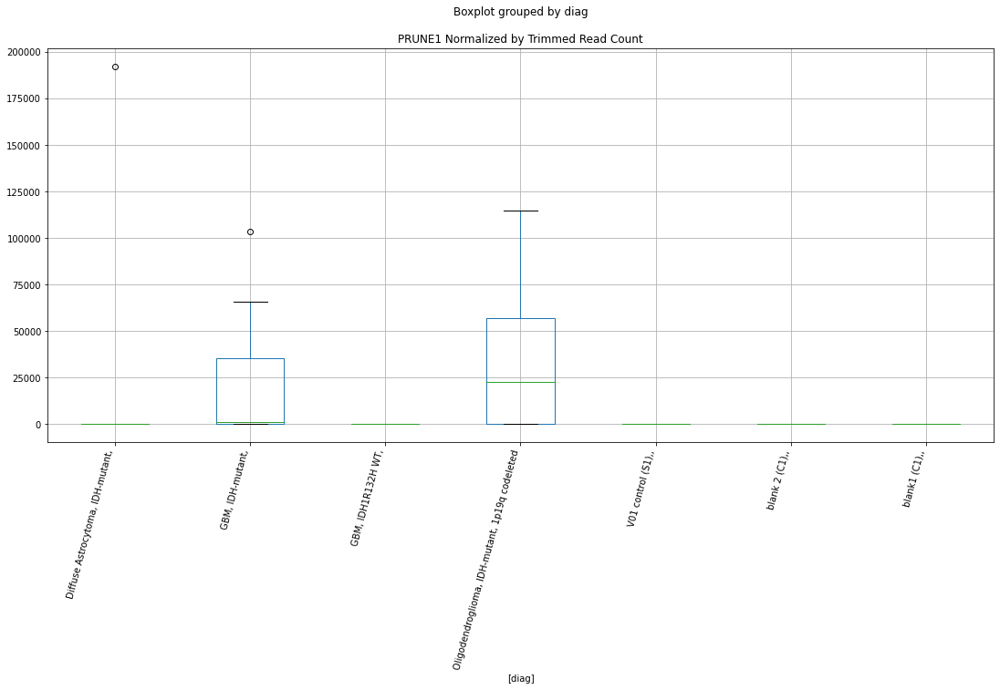

 p : 0.01574939891884582  ( t : 2.6659244660422337 ) :  D-plex  :  bbduk2  :  RMND5A
Control and blanks
73         0.00
337    17803.15
Name: RMND5A, dtype: float64
205    1074.55
Name: RMND5A, dtype: float64
469    591.53
Name: RMND5A, dtype: float64


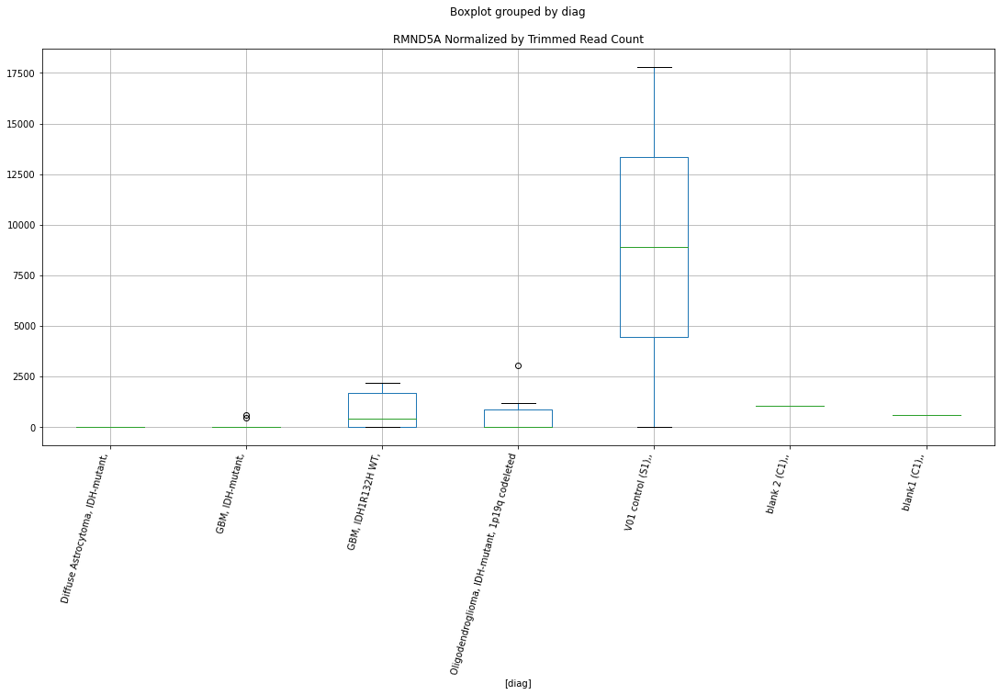

 p : 0.01584218701843091  ( t : 2.6631488980080325 ) :  D-plex  :  bbduk2  :  PPAT
Control and blanks
73     0.0
337    0.0
Name: PPAT, dtype: float64
205    1074.55
Name: PPAT, dtype: float64
469    0.0
Name: PPAT, dtype: float64


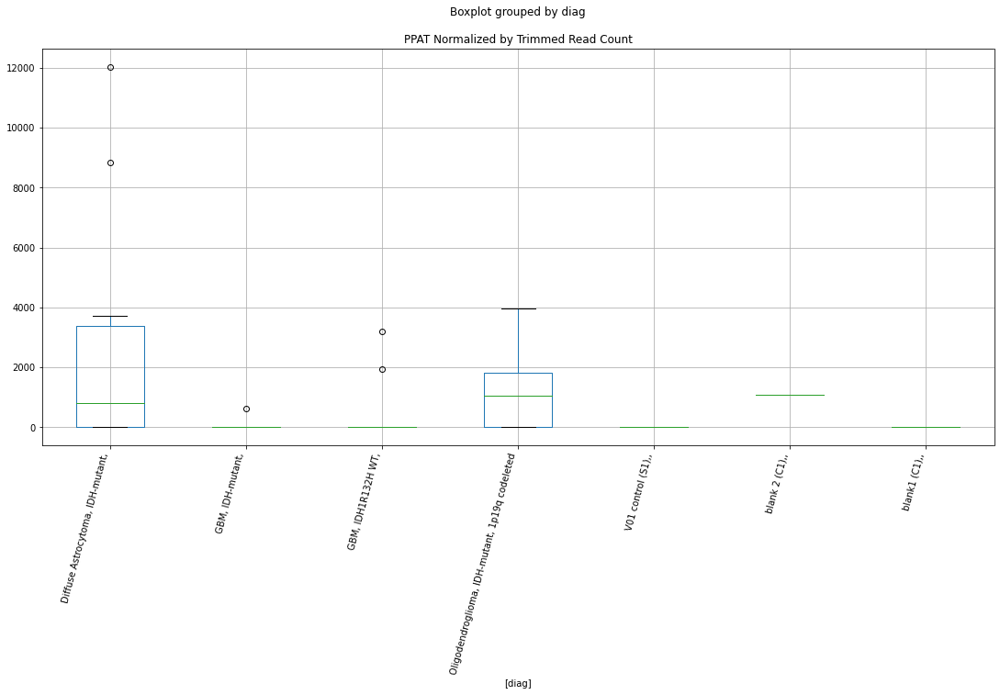

 p : 0.015857057670847257  ( t : 2.662705513558805 ) :  D-plex  :  bbduk2  :  SPAG16
Control and blanks
73     773.01
337      0.00
Name: SPAG16, dtype: float64
205    1432.73
Name: SPAG16, dtype: float64
469    2366.11
Name: SPAG16, dtype: float64


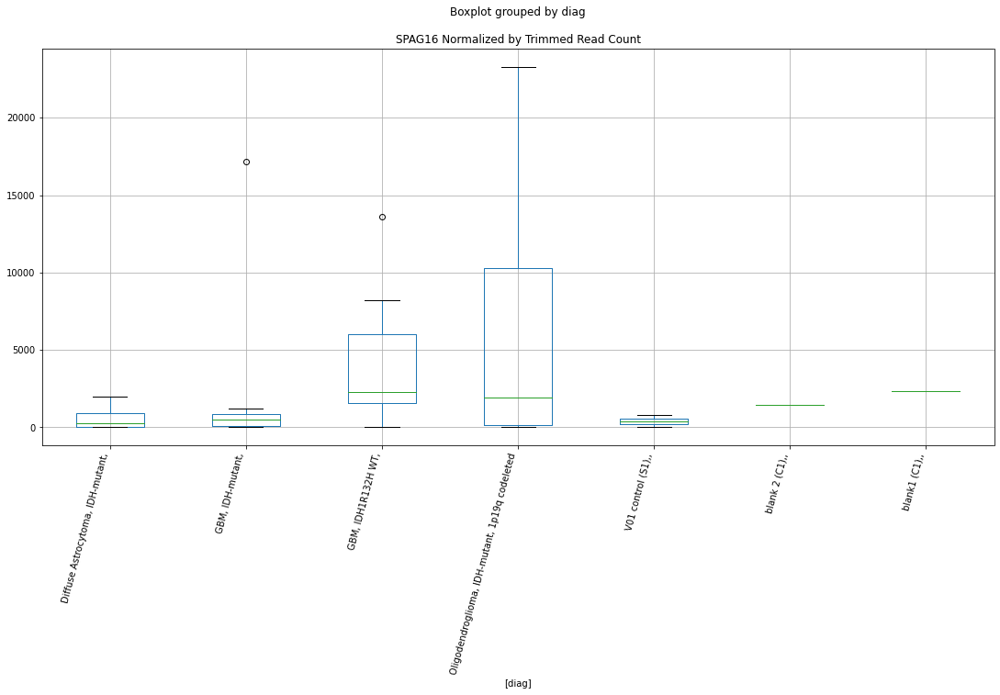

 p : 0.015942184266125748  ( t : 2.6601749733538407 ) :  D-plex  :  cutadapt2  :  SESN1
Control and blanks
76     1515.23
340       0.00
Name: SESN1, dtype: float64
208    2469.04
Name: SESN1, dtype: float64
472    2311.82
Name: SESN1, dtype: float64


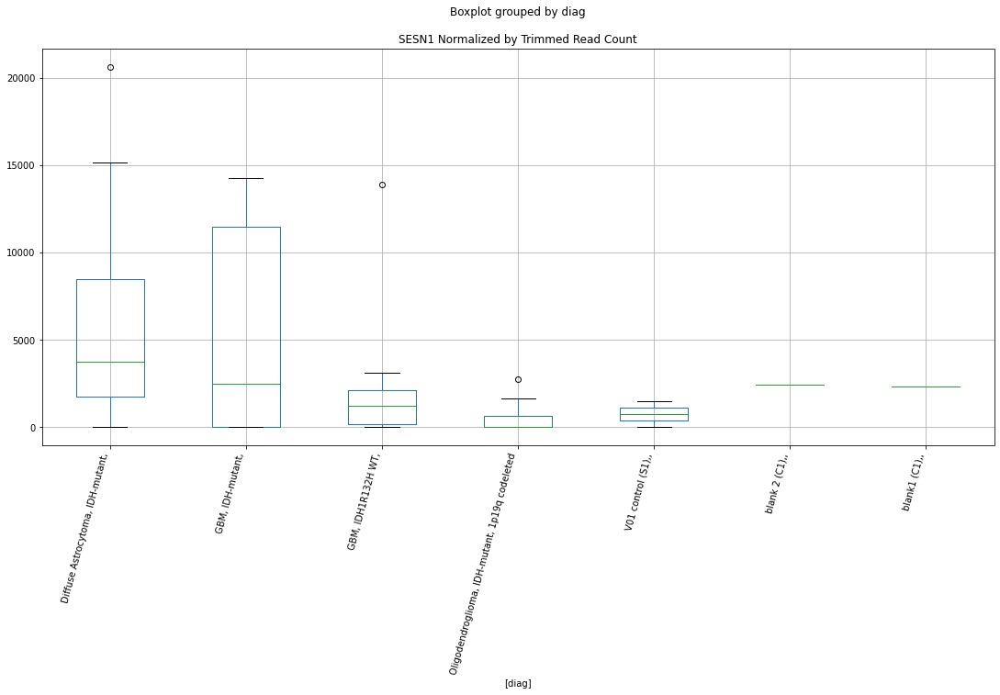

 p : 0.016043988759236714  ( t : 2.6571655029625822 ) :  D-plex  :  bbduk2  :  RFX1
Control and blanks
73     0.0
337    0.0
Name: RFX1, dtype: float64
205    1253.64
Name: RFX1, dtype: float64
469    0.0
Name: RFX1, dtype: float64


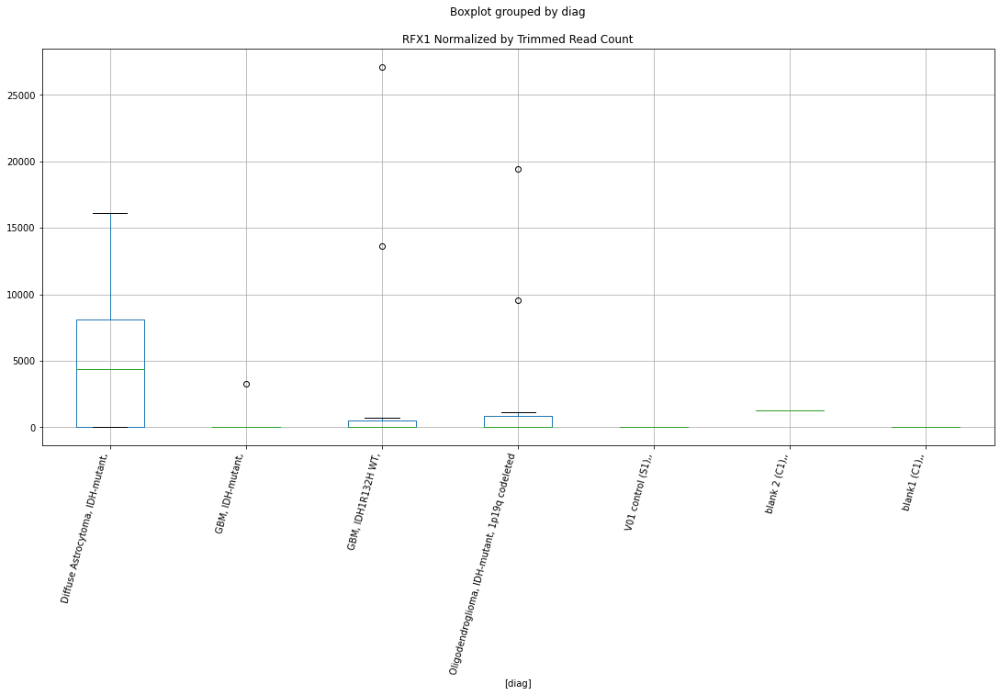

 p : 0.016367992936749995  ( t : 2.6477071476208405 ) :  D-plex  :  bbduk2  :  PLEKHB1
Control and blanks
73     0.0
337    0.0
Name: PLEKHB1, dtype: float64
205    1253.64
Name: PLEKHB1, dtype: float64
469    4140.69
Name: PLEKHB1, dtype: float64


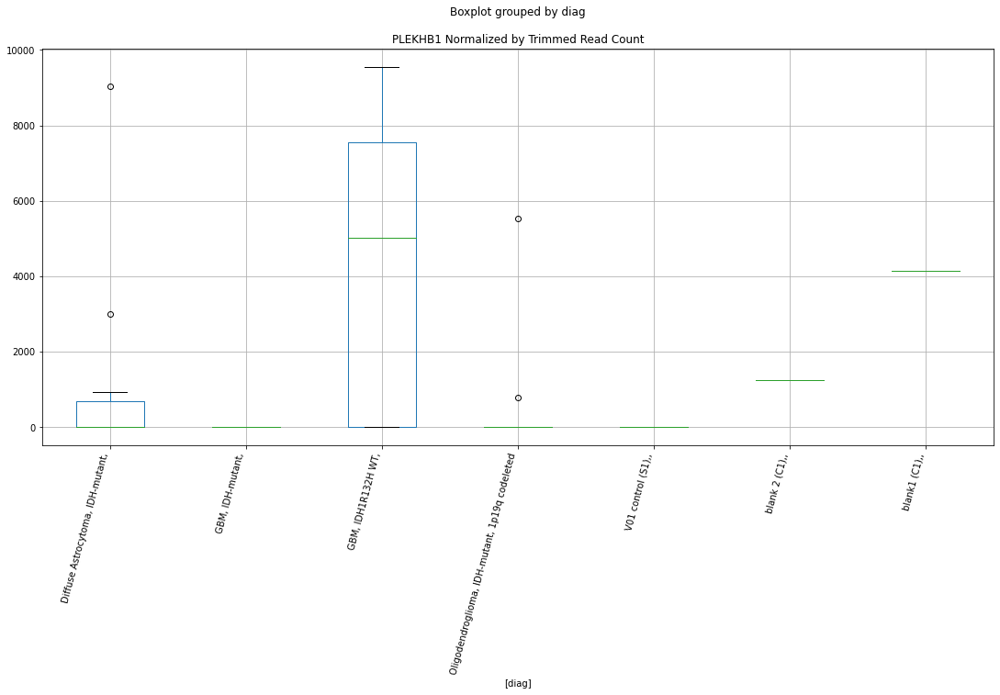

 p : 0.016380164291324793  ( t : 2.6473553252227853 ) :  D-plex  :  bbduk2  :  SIPA1L2
Control and blanks
73     5411.06
337    1780.31
Name: SIPA1L2, dtype: float64
205    19162.73
Name: SIPA1L2, dtype: float64
469    10055.96
Name: SIPA1L2, dtype: float64


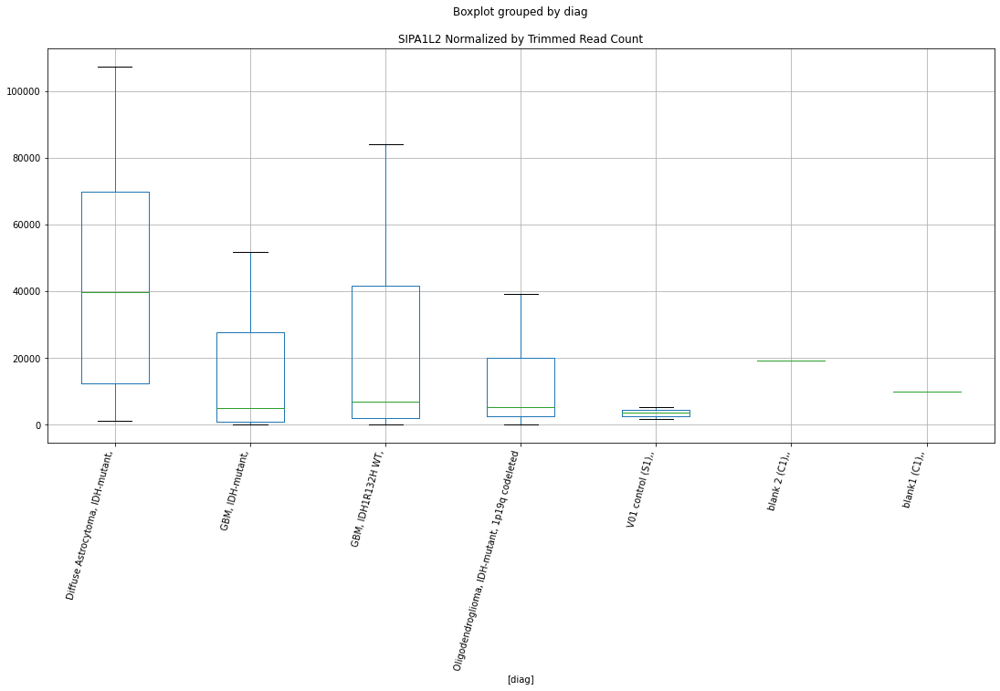

 p : 0.01653665921263256  ( t : 2.6428537541259227 ) :  D-plex  :  bbduk2  :  SESN1
Control and blanks
73     1546.02
337       0.00
Name: SESN1, dtype: float64
205    2507.27
Name: SESN1, dtype: float64
469    2366.11
Name: SESN1, dtype: float64


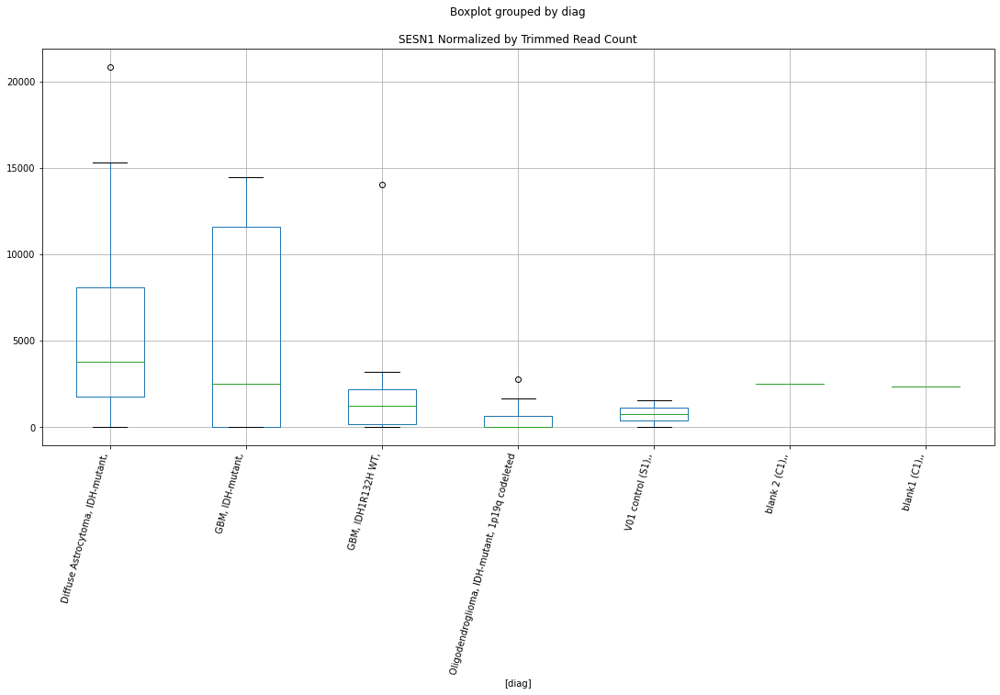

 p : 0.016586569955831246  ( t : 2.64142659840388 ) :  D-plex  :  cutadapt2  :  SCAF1
Control and blanks
76     9091.37
340       0.00
Name: SCAF1, dtype: float64
208    122041.27
Name: SCAF1, dtype: float64
472    13870.94
Name: SCAF1, dtype: float64


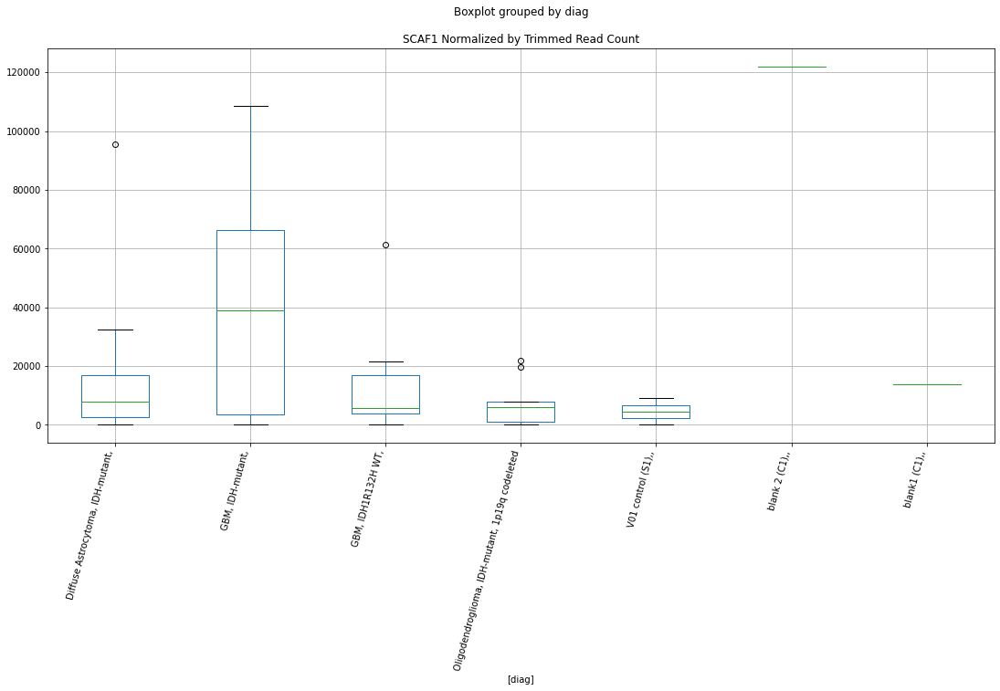

 p : 0.016588321617731456  ( t : 2.6413765853708484 ) :  D-plex  :  cutadapt2  :  SMIM28
Control and blanks
76       0.00
340    880.73
Name: SMIM28, dtype: float64
208    352.72
Name: SMIM28, dtype: float64
472    0.0
Name: SMIM28, dtype: float64


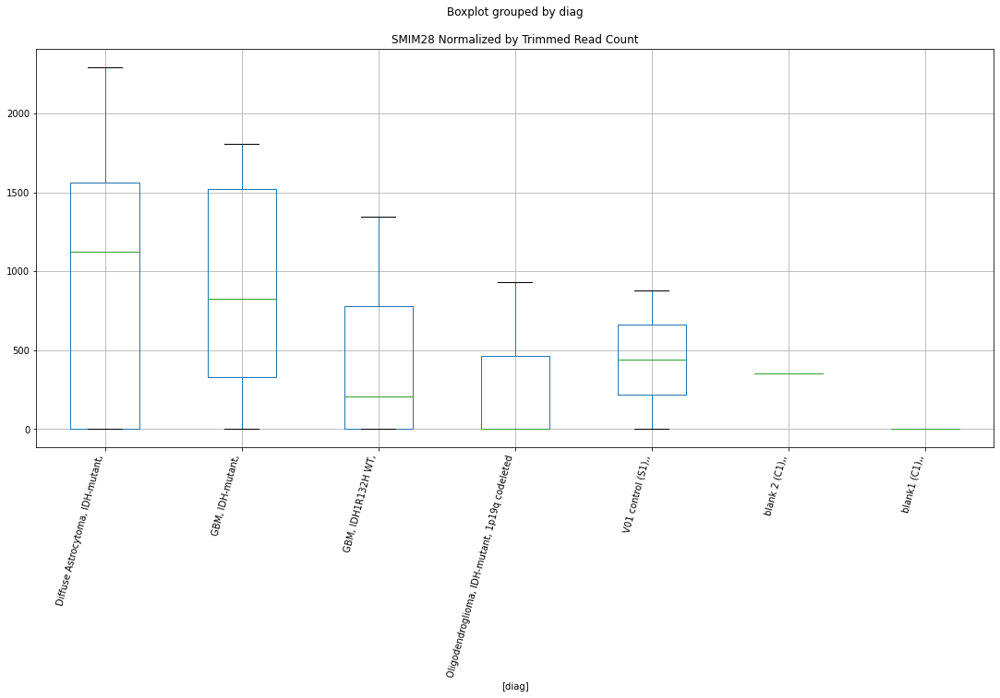

 p : 0.016613015275418024  ( t : 2.6406720722311507 ) :  Lexogen  :  bbduk2  :  PPP4R3A
Control and blanks
79        0.00
343    1698.51
Name: PPP4R3A, dtype: float64
211    0.0
Name: PPP4R3A, dtype: float64
475    0.0
Name: PPP4R3A, dtype: float64


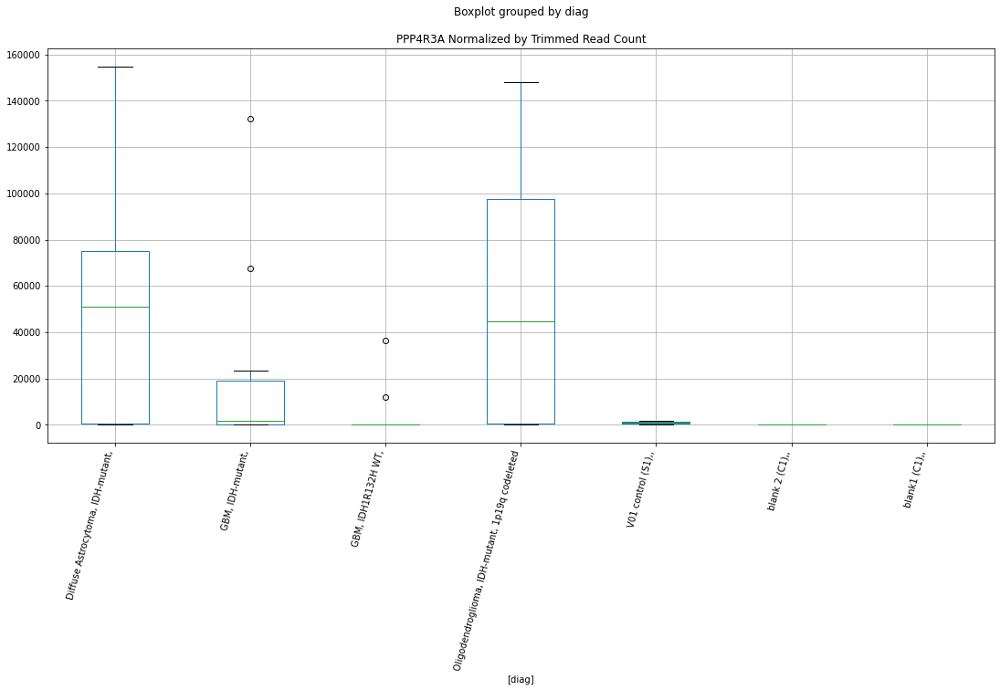

 p : 0.016730637619065226  ( t : 2.6373299097050067 ) :  D-plex  :  bbduk2  :  SMIM28
Control and blanks
73       0.00
337    890.16
Name: SMIM28, dtype: float64
205    358.18
Name: SMIM28, dtype: float64
469    0.0
Name: SMIM28, dtype: float64


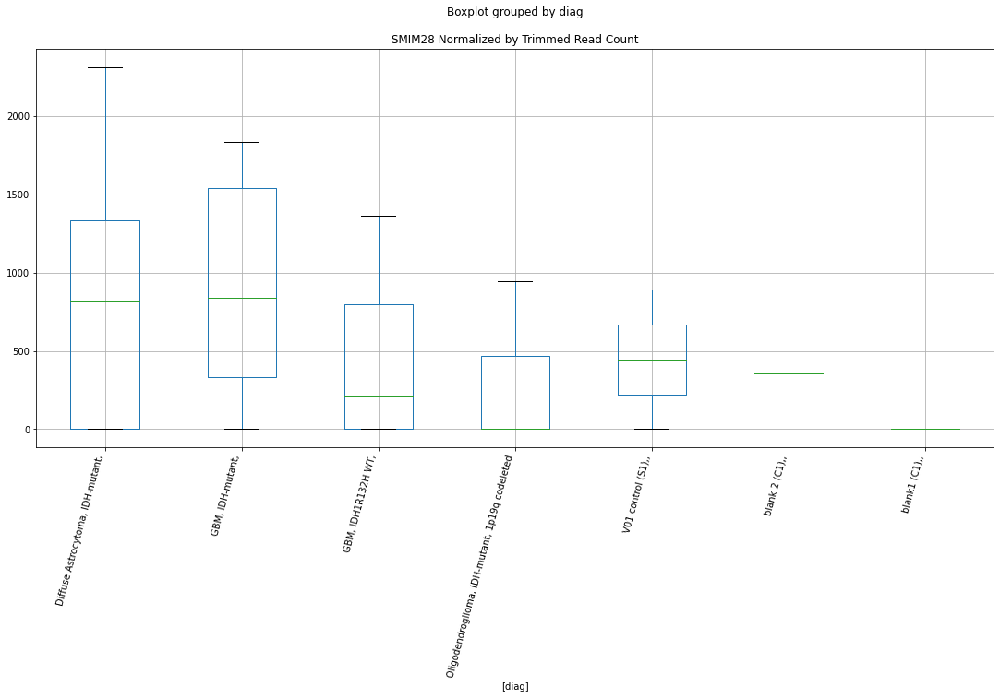

 p : 0.016803592698223235  ( t : 2.6352681531098816 ) :  Lexogen  :  cutadapt2  :  PPP4R3A
Control and blanks
82        0.00
346    1683.48
Name: PPP4R3A, dtype: float64
214    0.0
Name: PPP4R3A, dtype: float64
478    0.0
Name: PPP4R3A, dtype: float64


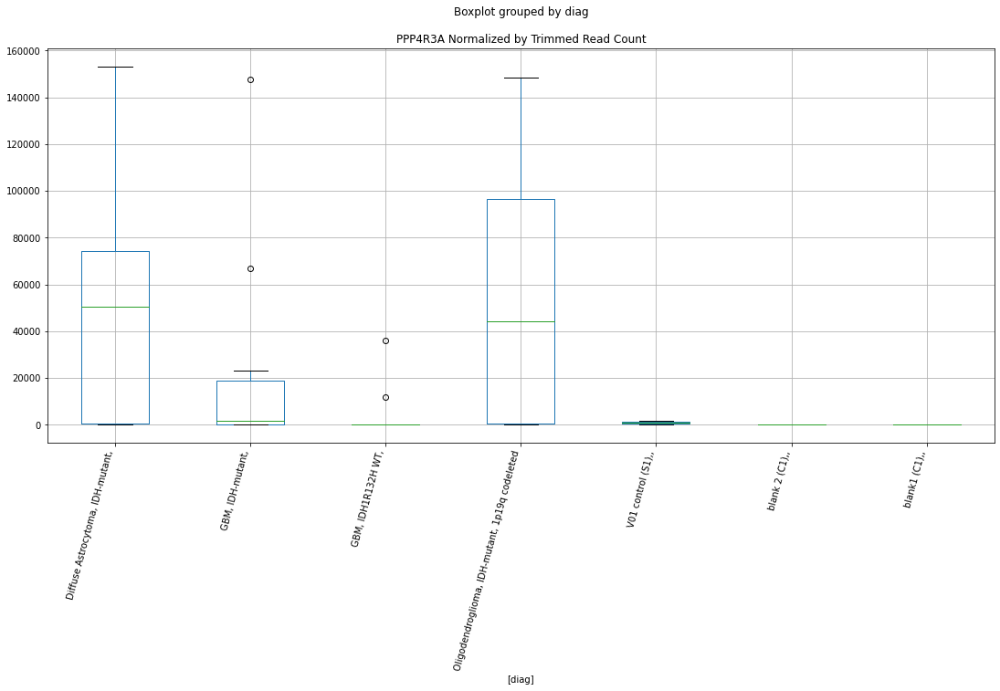

 p : 0.01710609273323841  ( t : 2.6268091657515105 ) :  D-plex  :  bbduk2  :  RASA4
Control and blanks
73         0.00
337    10681.89
Name: RASA4, dtype: float64
205    29191.83
Name: RASA4, dtype: float64
469    0.0
Name: RASA4, dtype: float64


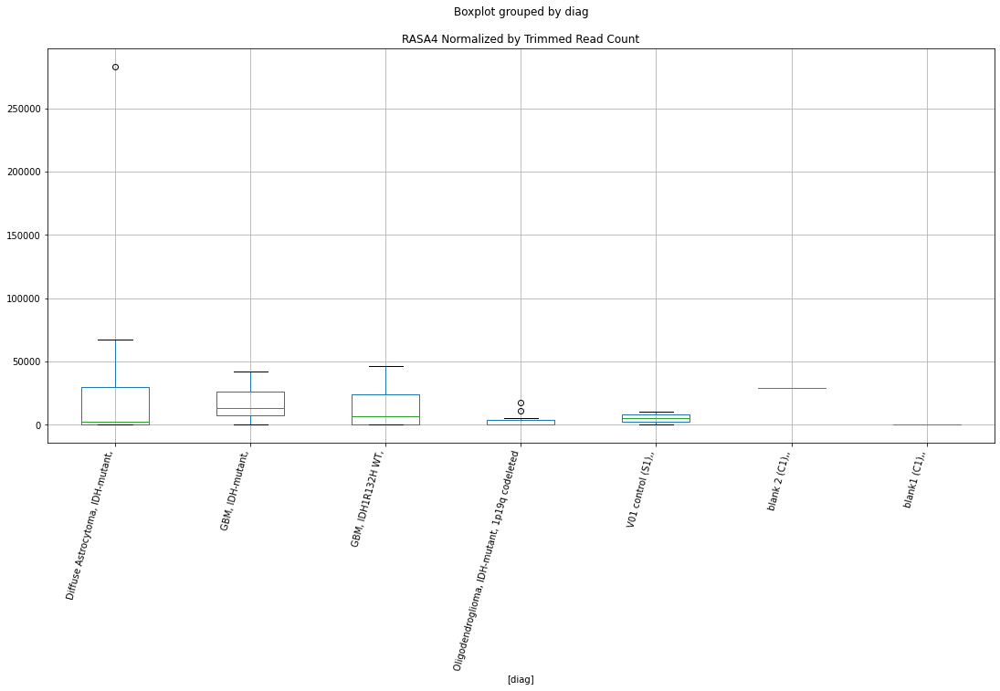

 p : 0.017118213544080132  ( t : 2.6264731960641803 ) :  Lexogen  :  bbduk2  :  POLE4
Control and blanks
79     0.0
343    0.0
Name: POLE4, dtype: float64
211    0.0
Name: POLE4, dtype: float64
475    0.0
Name: POLE4, dtype: float64


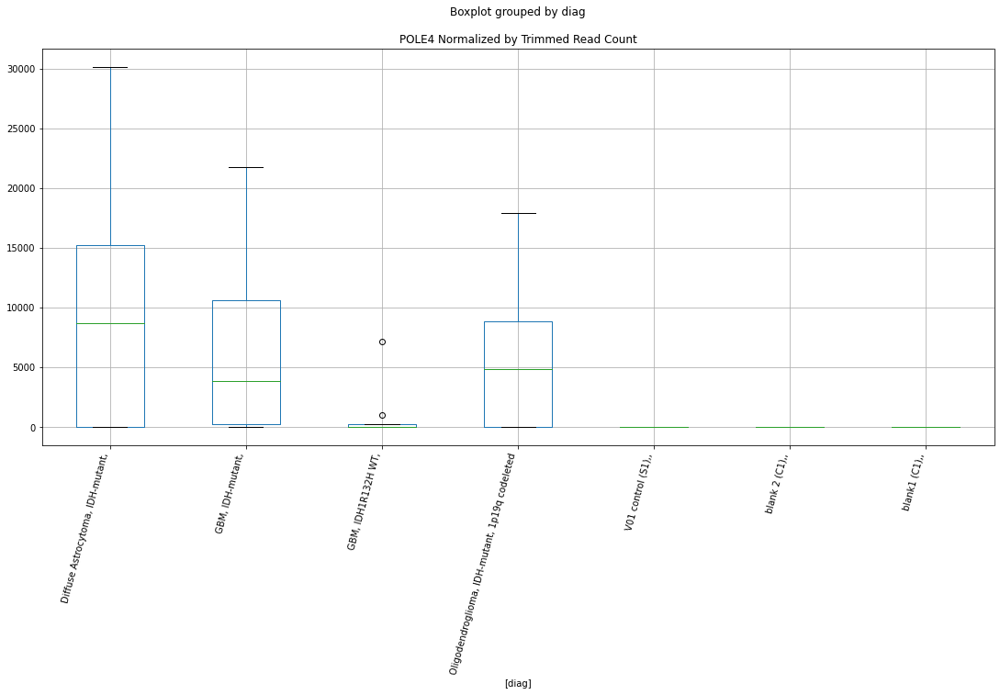

 p : 0.017353652118411785  ( t : 2.619991675324154 ) :  D-plex  :  cutadapt2  :  PALM2AKAP2
Control and blanks
76      1515.23
340    68697.11
Name: PALM2AKAP2, dtype: float64
208    19046.9
Name: PALM2AKAP2, dtype: float64
472    12137.07
Name: PALM2AKAP2, dtype: float64


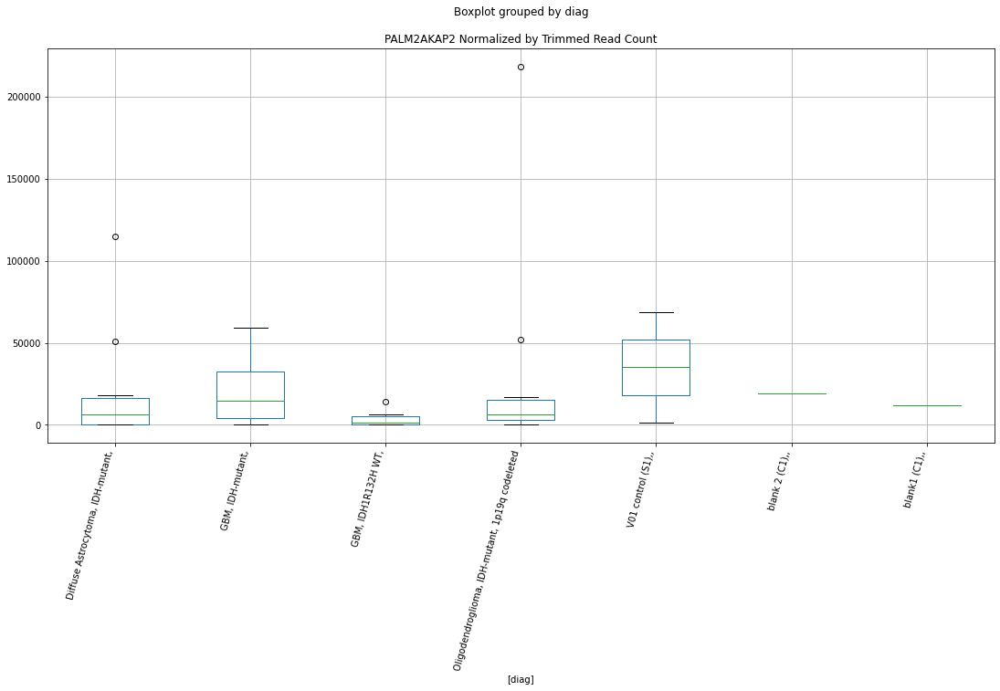

 p : 0.017485572059373036  ( t : 2.6163964149439214 ) :  Lexogen  :  cutadapt2  :  POLE4
Control and blanks
82     0.0
346    0.0
Name: POLE4, dtype: float64
214    0.0
Name: POLE4, dtype: float64
478    0.0
Name: POLE4, dtype: float64


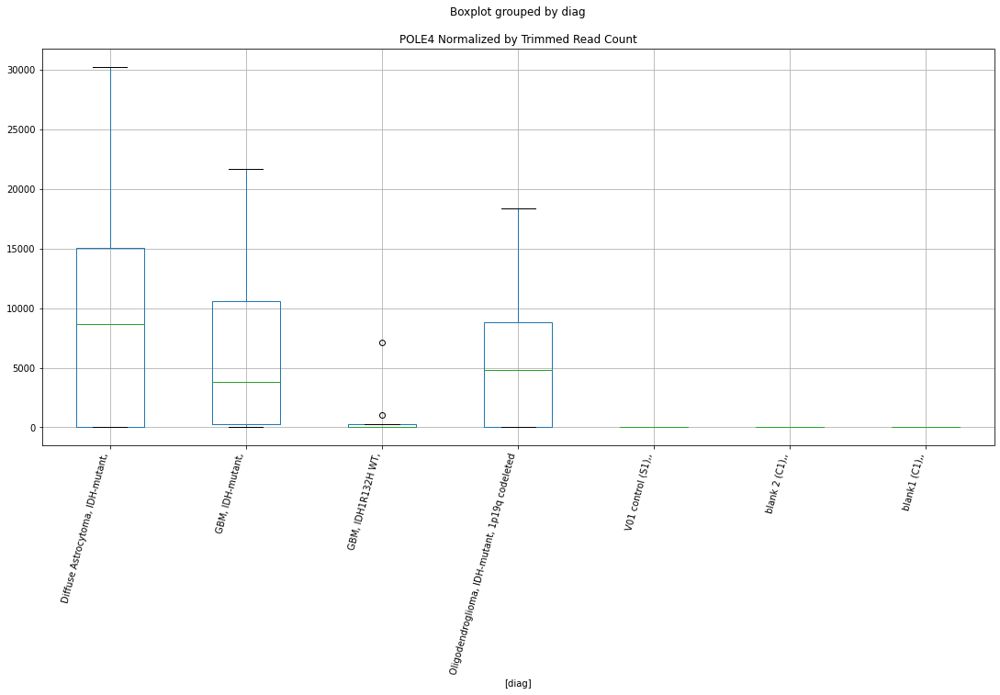

 p : 0.017492527952630843  ( t : 2.6162075595792036 ) :  D-plex  :  cutadapt2  :  RPS6KB2
Control and blanks
76     95459.39
340     7926.59
Name: RPS6KB2, dtype: float64
208    31744.84
Name: RPS6KB2, dtype: float64
472    41612.82
Name: RPS6KB2, dtype: float64


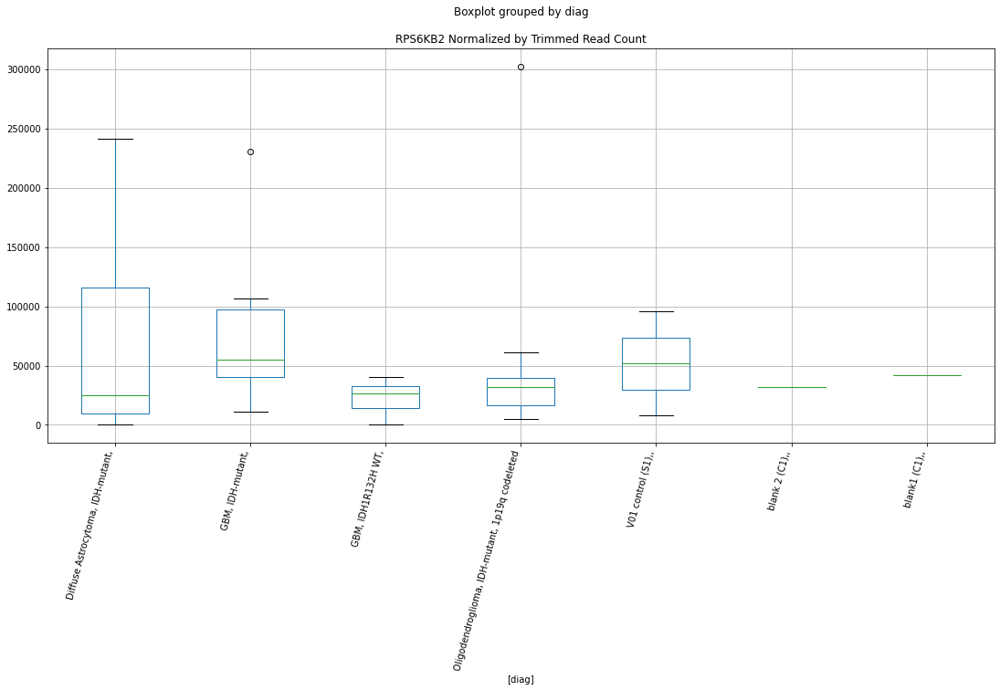

 p : 0.017540046905066435  ( t : 2.614919305714177 ) :  D-plex  :  cutadapt2  :  PYCR3
Control and blanks
76     0.0
340    0.0
Name: PYCR3, dtype: float64
208    2116.32
Name: PYCR3, dtype: float64
472    6935.47
Name: PYCR3, dtype: float64


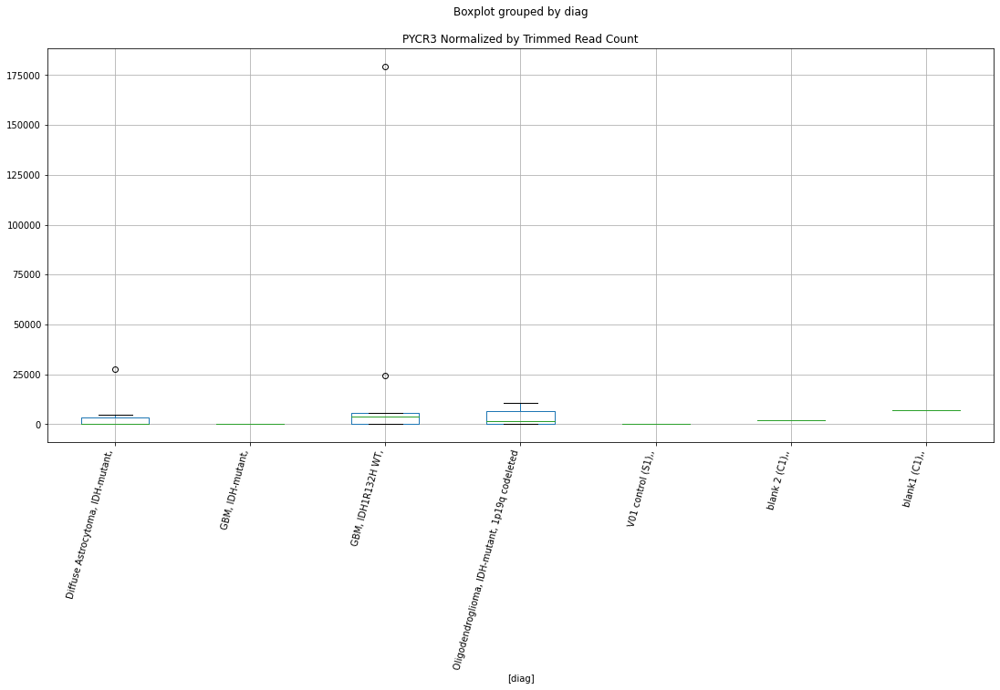

 p : 0.017709308669424467  ( t : 2.6103573461252956 ) :  D-plex  :  bbduk2  :  SOX11
Control and blanks
73       0.00
337    890.16
Name: SOX11, dtype: float64
205    2865.46
Name: SOX11, dtype: float64
469    2366.11
Name: SOX11, dtype: float64


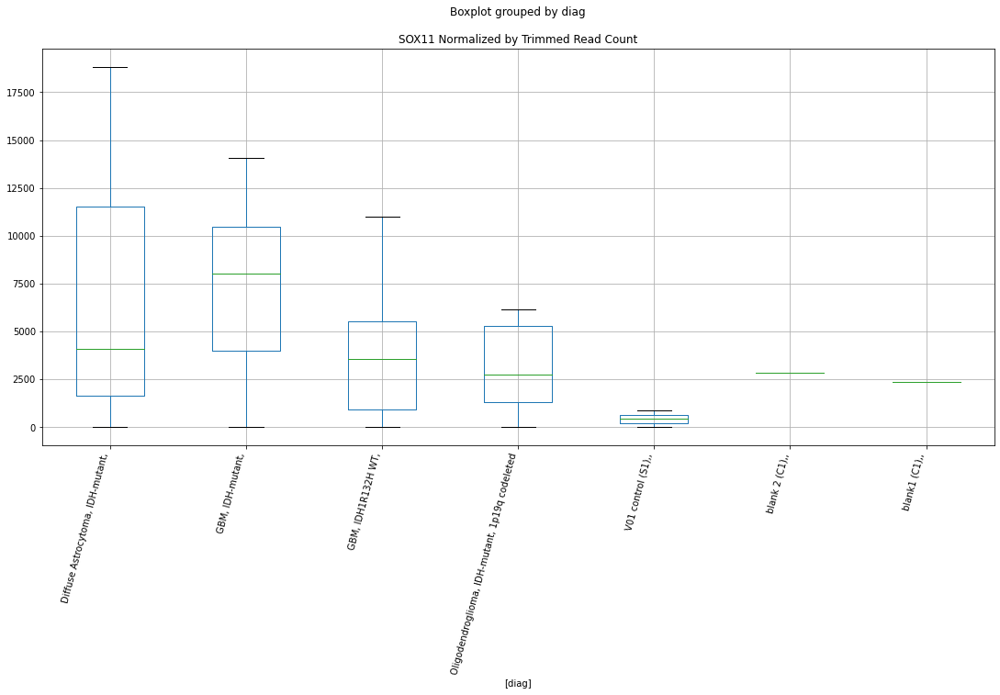

 p : 0.01772752156863753  ( t : 2.609868940496927 ) :  Lexogen  :  cutadapt2  :  PARP10
Control and blanks
82     0.0
346    0.0
Name: PARP10, dtype: float64
214    0.0
Name: PARP10, dtype: float64
478    0.0
Name: PARP10, dtype: float64


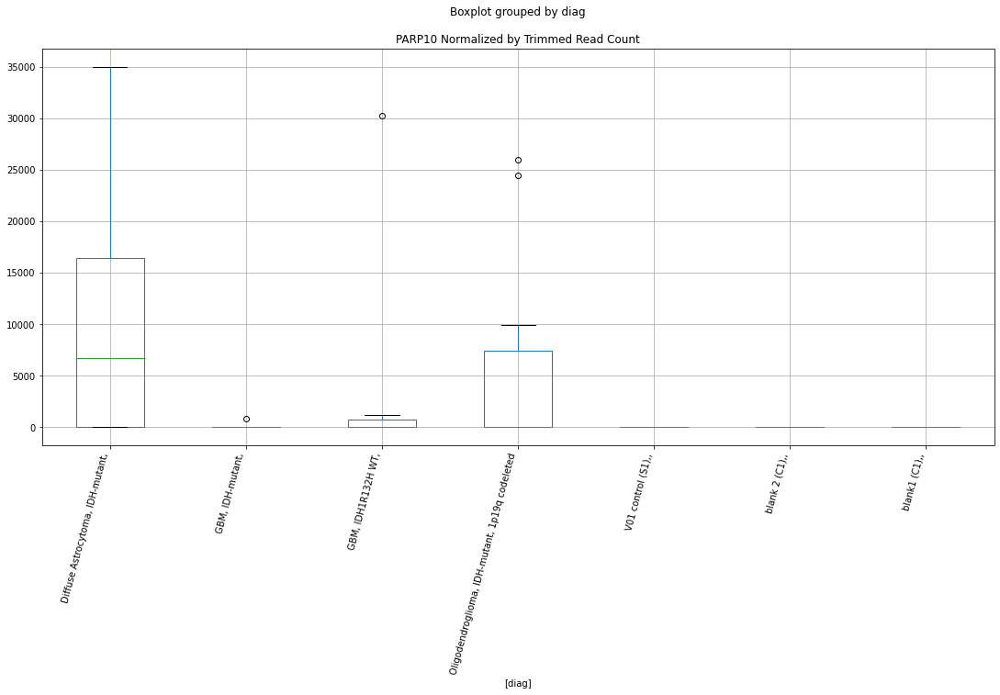

 p : 0.01776687151504093  ( t : 2.6088153387763233 ) :  Lexogen  :  bbduk2  :  PARP10
Control and blanks
79     0.0
343    0.0
Name: PARP10, dtype: float64
211    0.0
Name: PARP10, dtype: float64
475    0.0
Name: PARP10, dtype: float64


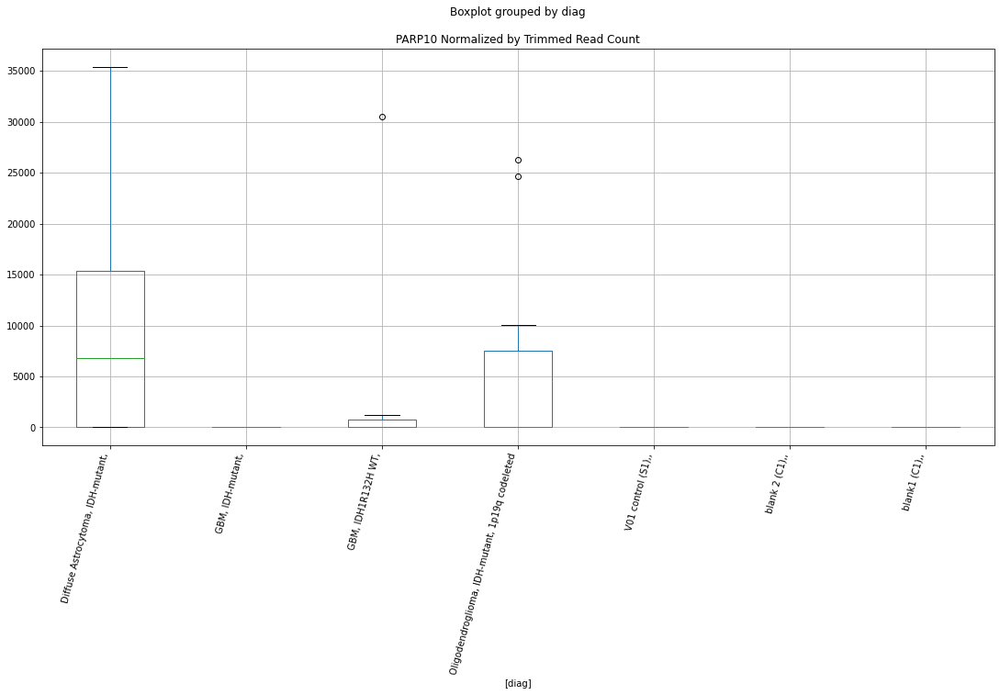

 p : 0.017826765162041933  ( t : 2.6072159212356762 ) :  D-plex  :  cutadapt2  :  RPS27L
Control and blanks
76     0.0
340    0.0
Name: RPS27L, dtype: float64
208    1058.16
Name: RPS27L, dtype: float64
472    2311.82
Name: RPS27L, dtype: float64


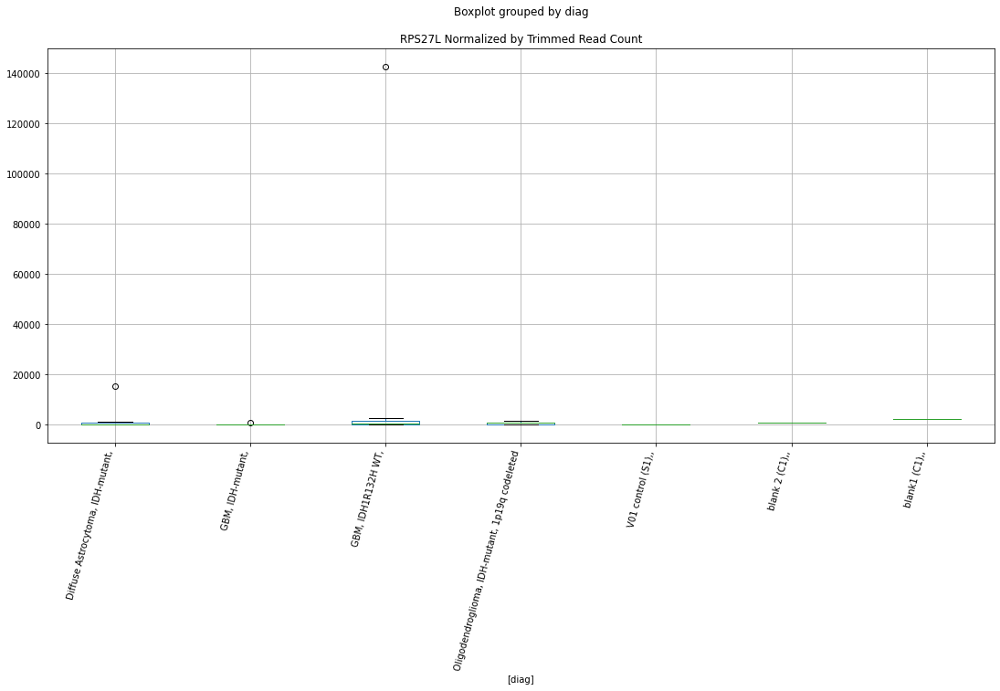

 p : 0.017929557390853806  ( t : 2.6044827820778083 ) :  Lexogen  :  cutadapt2  :  PAPLN
Control and blanks
82     0.0
346    0.0
Name: PAPLN, dtype: float64
214    0.0
Name: PAPLN, dtype: float64
478    0.0
Name: PAPLN, dtype: float64


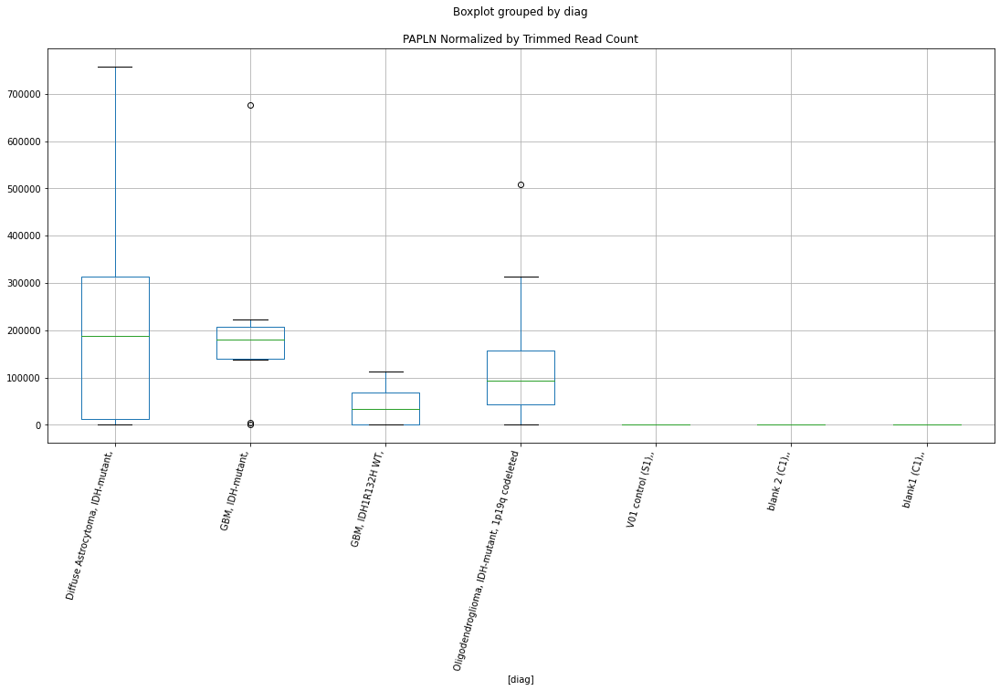

 p : 0.017943448837197055  ( t : 2.6041145644423667 ) :  D-plex  :  cutadapt2  :  OTOR
Control and blanks
76     0.0
340    0.0
Name: OTOR, dtype: float64
208    529.08
Name: OTOR, dtype: float64
472    577.96
Name: OTOR, dtype: float64


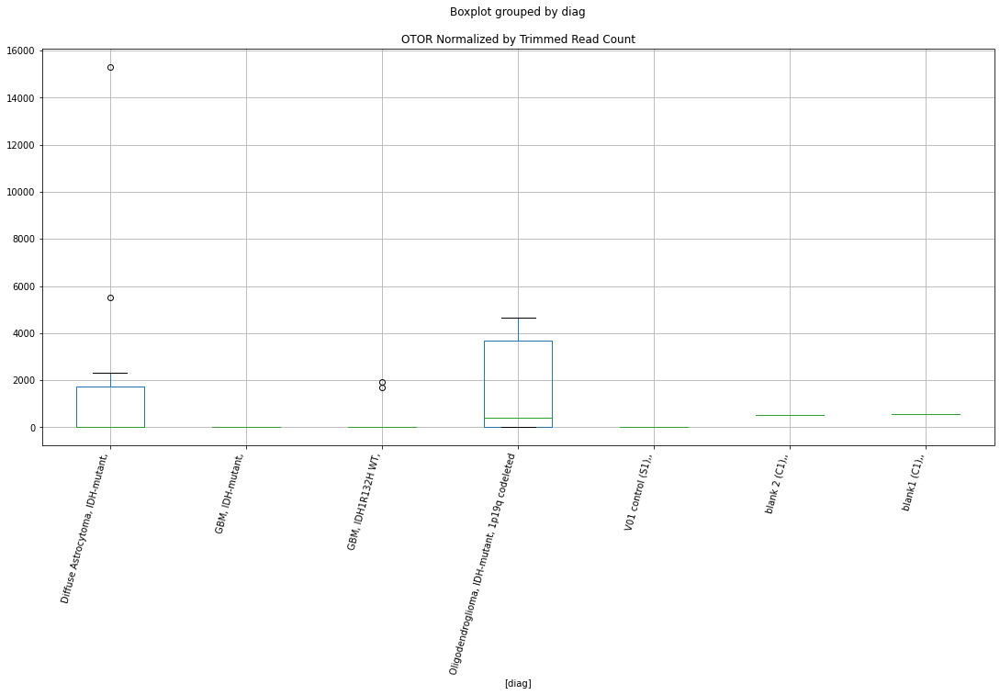

 p : 0.01808529125623539  ( t : 2.60037018743458 ) :  Lexogen  :  bbduk2  :  PAPLN
Control and blanks
79     0.0
343    0.0
Name: PAPLN, dtype: float64
211    0.0
Name: PAPLN, dtype: float64
475    0.0
Name: PAPLN, dtype: float64


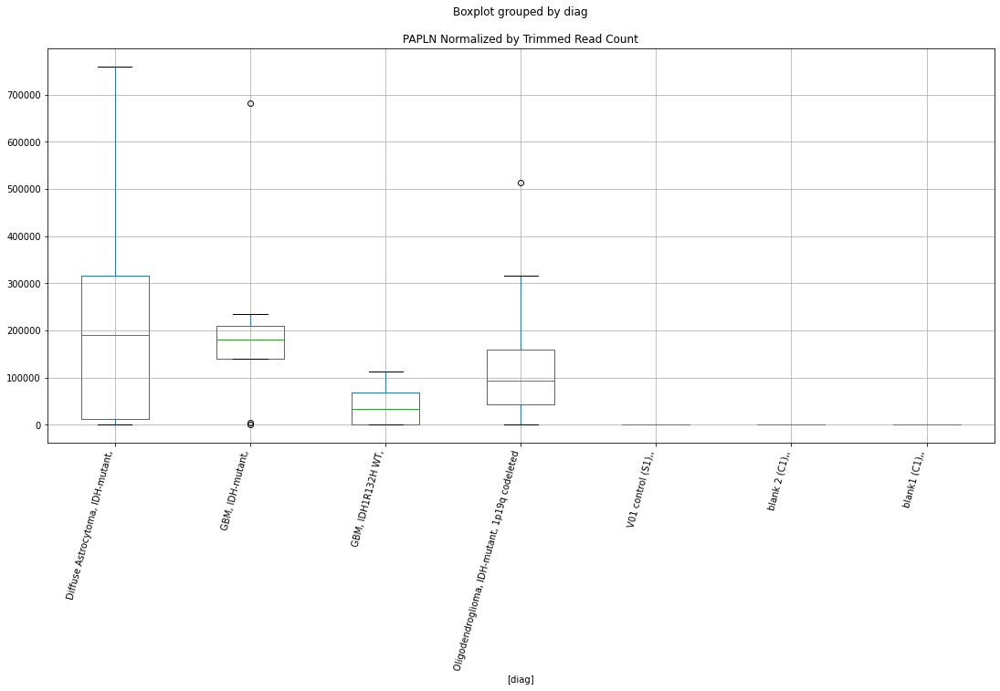

 p : 0.018222074978177287  ( t : 2.596785654979343 ) :  Lexogen  :  cutadapt2  :  RSPO1
Control and blanks
82     0.0
346    0.0
Name: RSPO1, dtype: float64
214    0.0
Name: RSPO1, dtype: float64
478    0.0
Name: RSPO1, dtype: float64


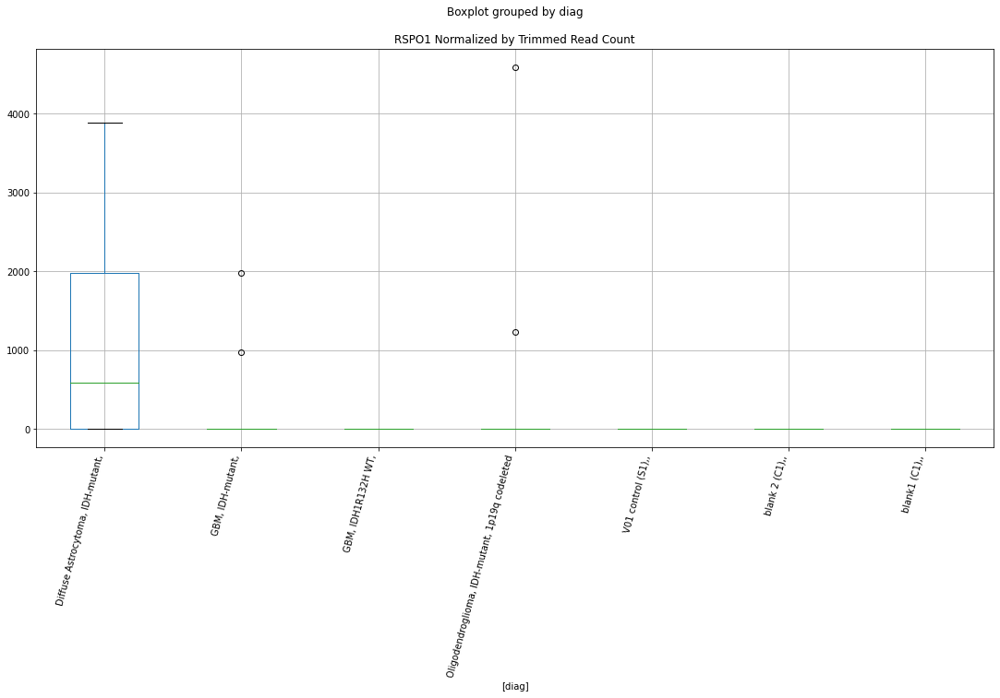

 p : 0.01827527721523013  ( t : 2.595398338002322 ) :  Lexogen  :  cutadapt2  :  SLC25A31
Control and blanks
82     0.0
346    0.0
Name: SLC25A31, dtype: float64
214    0.0
Name: SLC25A31, dtype: float64
478    0.0
Name: SLC25A31, dtype: float64


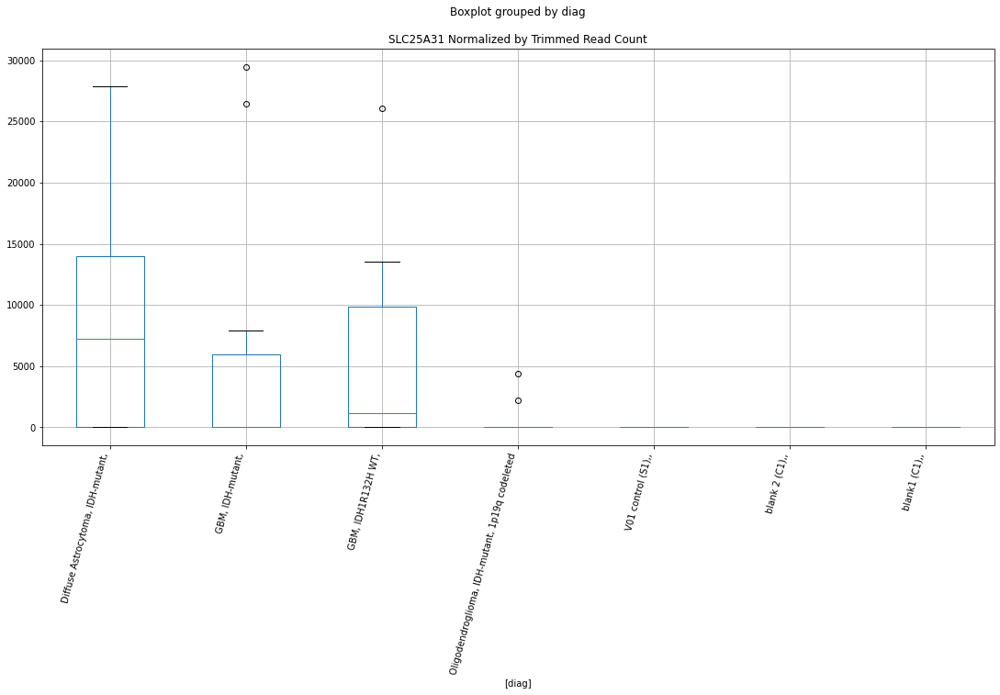

 p : 0.01838954173860559  ( t : 2.59243164860569 ) :  D-plex  :  cutadapt2  :  PLEKHB1
Control and blanks
76     0.0
340    0.0
Name: PLEKHB1, dtype: float64
208    1234.52
Name: PLEKHB1, dtype: float64
472    4045.69
Name: PLEKHB1, dtype: float64


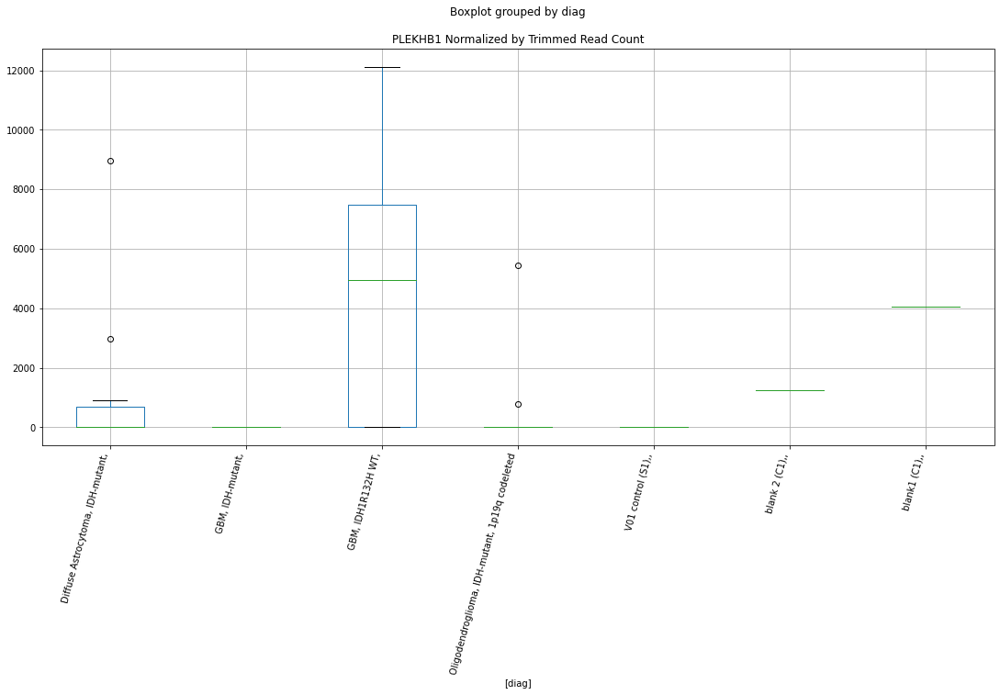

 p : 0.018630507268161497  ( t : 2.5862322672420497 ) :  Lexogen  :  bbduk2  :  PRUNE1
Control and blanks
79     0.0
343    0.0
Name: PRUNE1, dtype: float64
211    0.0
Name: PRUNE1, dtype: float64
475    0.0
Name: PRUNE1, dtype: float64


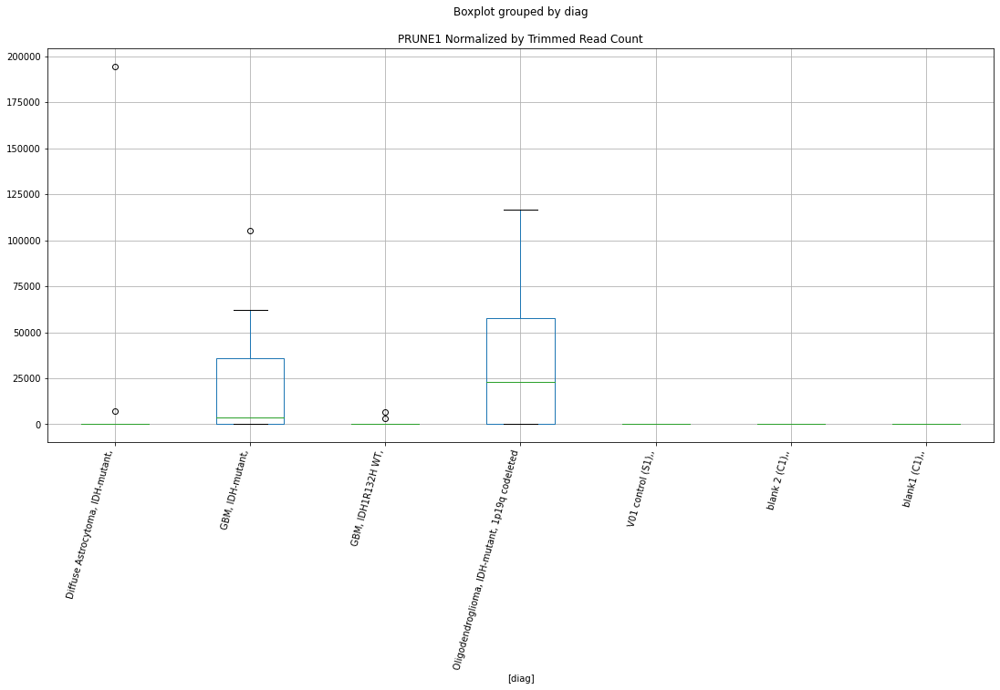

 p : 0.018801185182419546  ( t : 2.5818870215212653 ) :  D-plex  :  bbduk2  :  SCUBE2
Control and blanks
73     0.0
337    0.0
Name: SCUBE2, dtype: float64
205    5910.0
Name: SCUBE2, dtype: float64
469    21294.98
Name: SCUBE2, dtype: float64


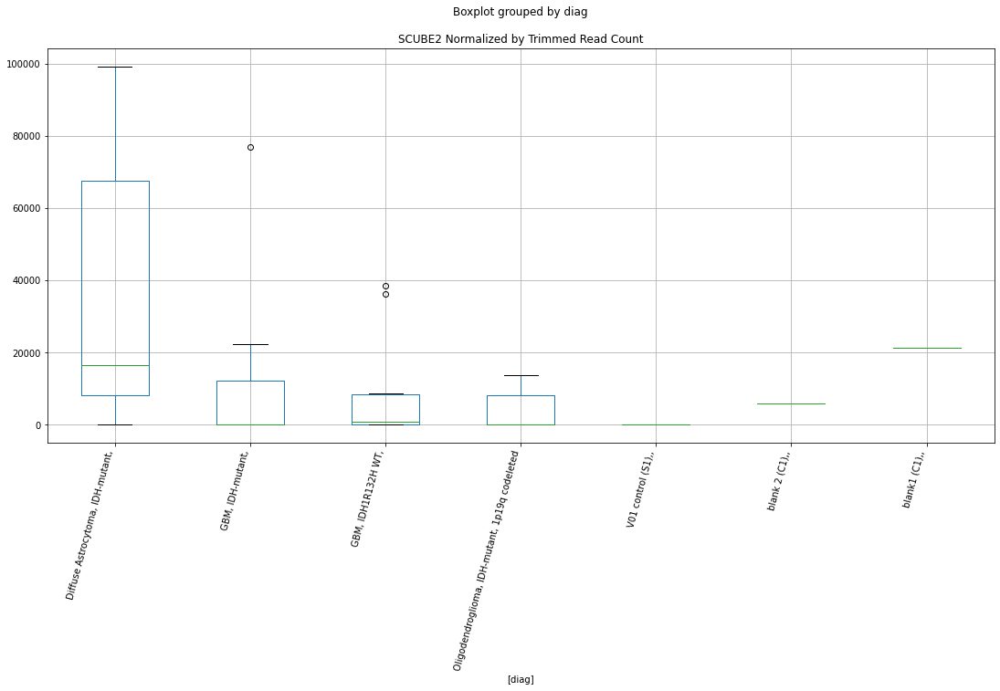

 p : 0.018809933517299548  ( t : 2.58166530860803 ) :  D-plex  :  bbduk2  :  PTPRCAP
Control and blanks
73      8503.09
337    98807.46
Name: PTPRCAP, dtype: float64
205    30803.64
Name: PTPRCAP, dtype: float64
469    334212.93
Name: PTPRCAP, dtype: float64


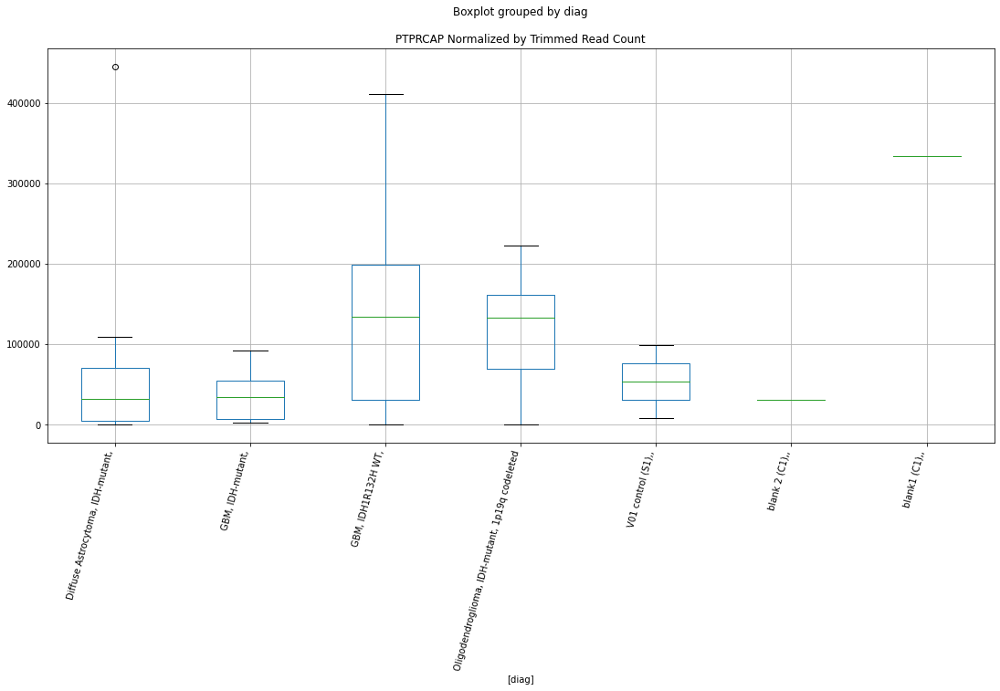

 p : 0.01881163993378786  ( t : 2.5816220735332815 ) :  D-plex  :  bbduk2  :  SCAF1
Control and blanks
73     9276.1
337       0.0
Name: SCAF1, dtype: float64
205    124647.3
Name: SCAF1, dtype: float64
469    14196.66
Name: SCAF1, dtype: float64


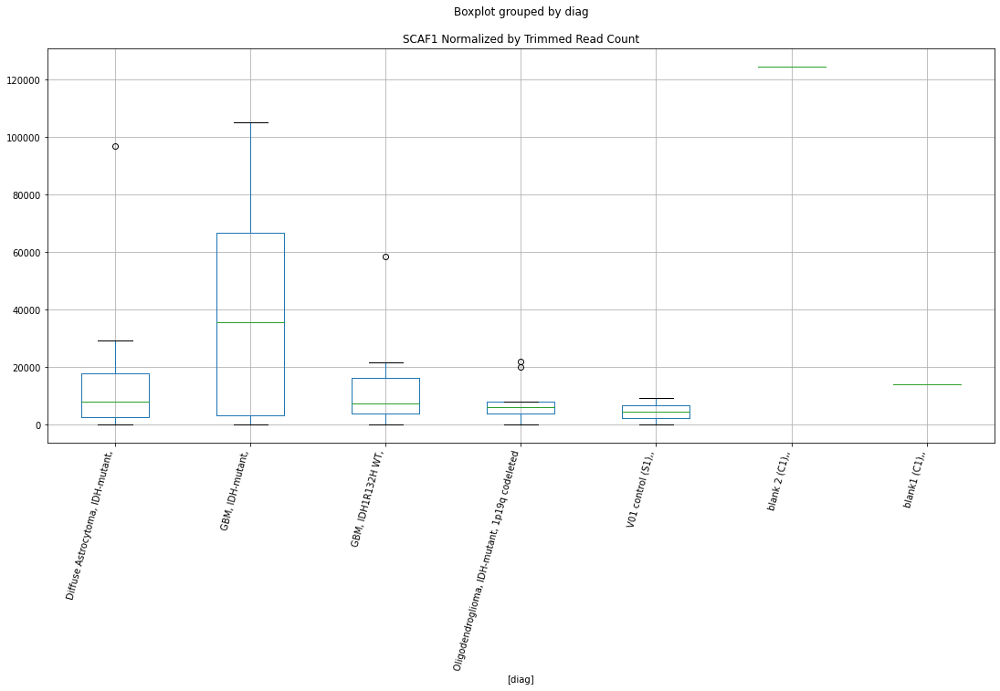

 p : 0.01881817788128918  ( t : 2.581456457486968 ) :  D-plex  :  bbduk2  :  SLC41A3
Control and blanks
73     0.0
337    0.0
Name: SLC41A3, dtype: float64
205    3402.73
Name: SLC41A3, dtype: float64
469    0.0
Name: SLC41A3, dtype: float64


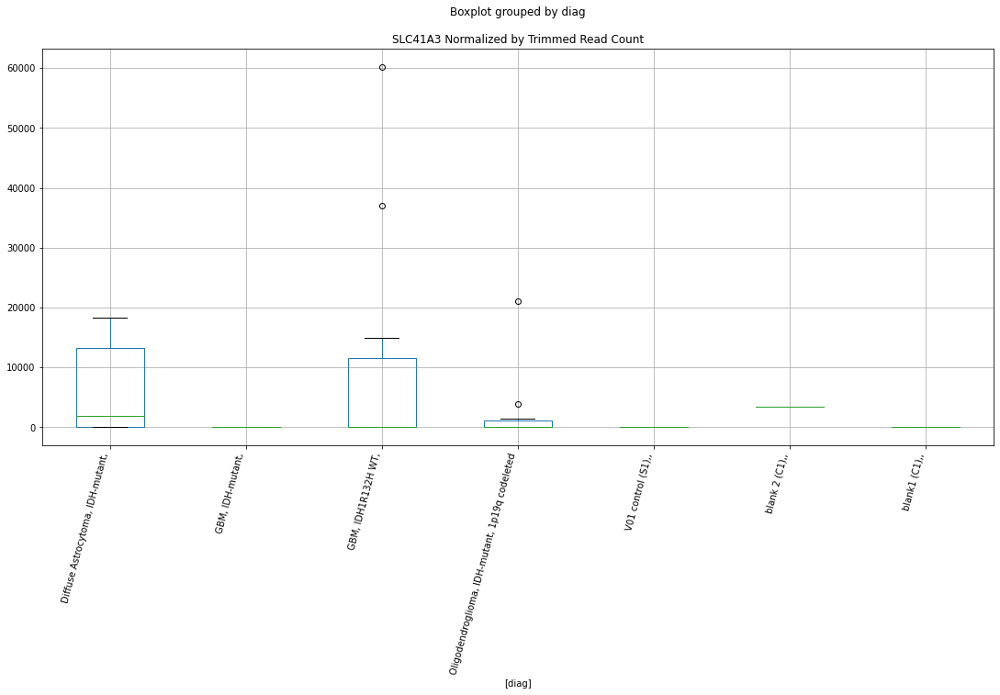

 p : 0.018818911642626786  ( t : 2.581437873612334 ) :  Lexogen  :  bbduk2  :  SLC2A2
Control and blanks
79     0.0
343    0.0
Name: SLC2A2, dtype: float64
211    0.0
Name: SLC2A2, dtype: float64
475    1197.58
Name: SLC2A2, dtype: float64


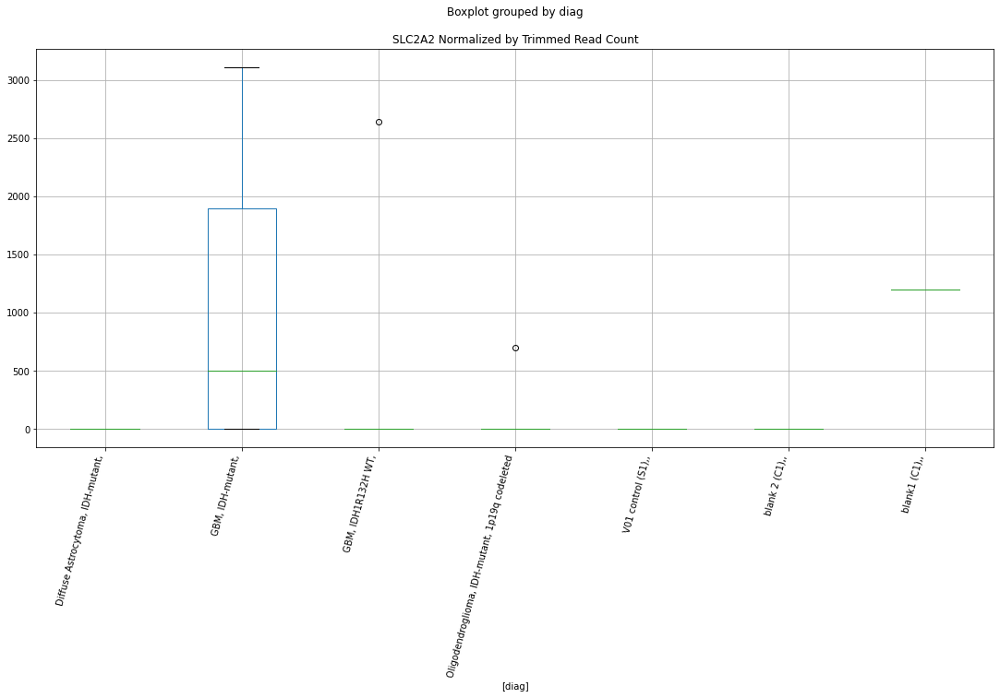

 p : 0.018915591724884474  ( t : 2.5789952566524508 ) :  D-plex  :  cutadapt2  :  PTPRCAP
Control and blanks
76      8333.76
340    97761.27
Name: PTPRCAP, dtype: float64
208    30333.96
Name: PTPRCAP, dtype: float64
472    327700.96
Name: PTPRCAP, dtype: float64


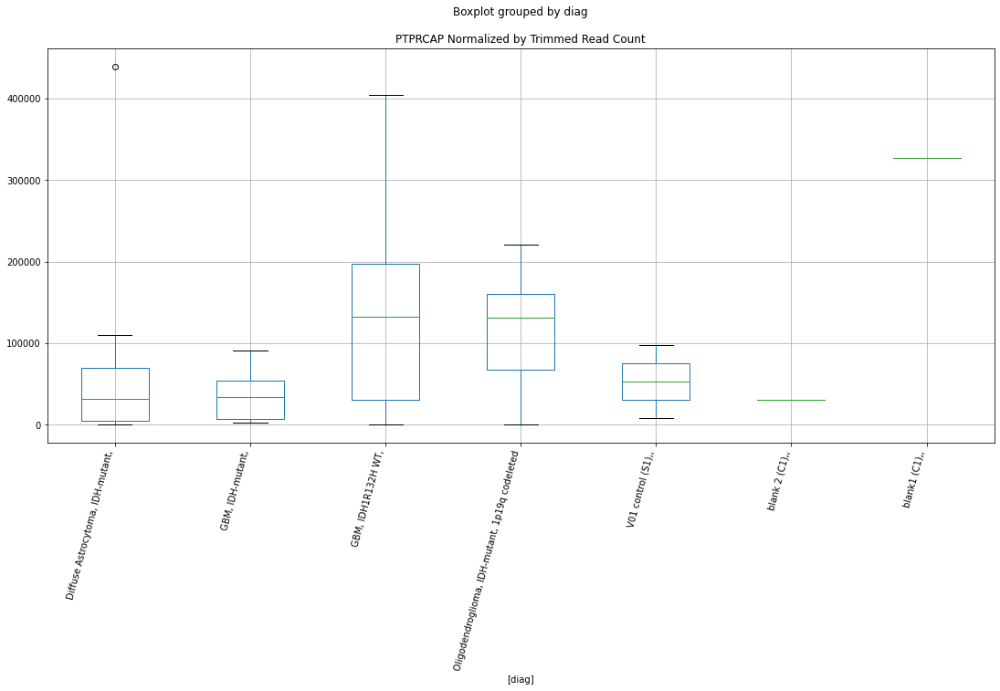

 p : 0.01929183656854432  ( t : 2.56960071092398 ) :  Lexogen  :  cutadapt2  :  SLC23A2
Control and blanks
82     0.0
346    0.0
Name: SLC23A2, dtype: float64
214    0.0
Name: SLC23A2, dtype: float64
478    0.0
Name: SLC23A2, dtype: float64


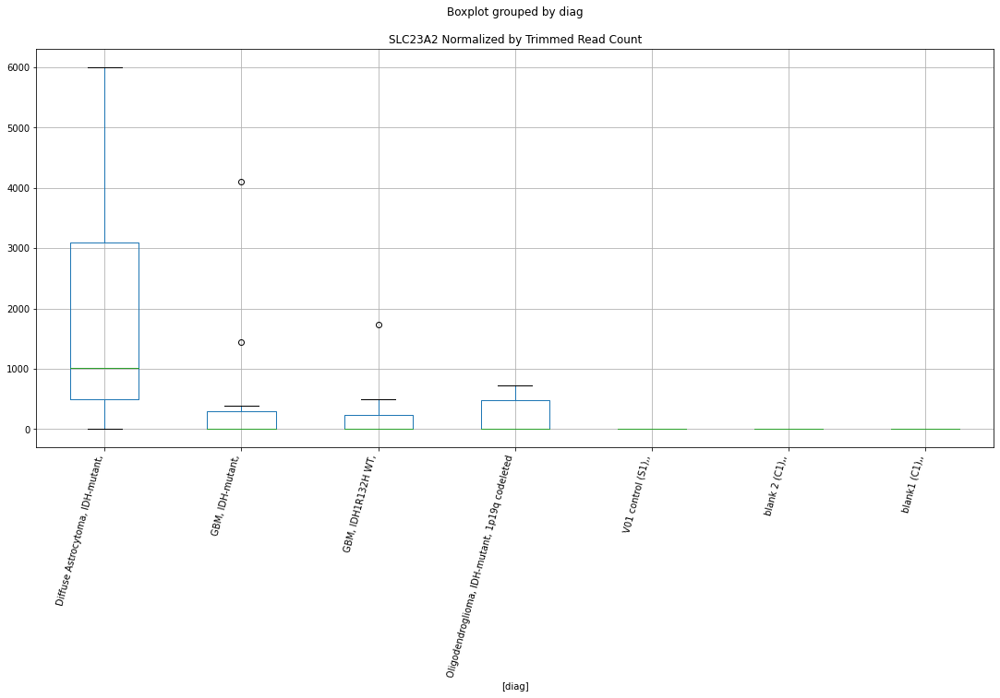

 p : 0.019337508711414923  ( t : 2.568472147299932 ) :  D-plex  :  cutadapt2  :  SLC9B1
Control and blanks
76     0.0
340    0.0
Name: SLC9B1, dtype: float64
208    0.0
Name: SLC9B1, dtype: float64
472    0.0
Name: SLC9B1, dtype: float64


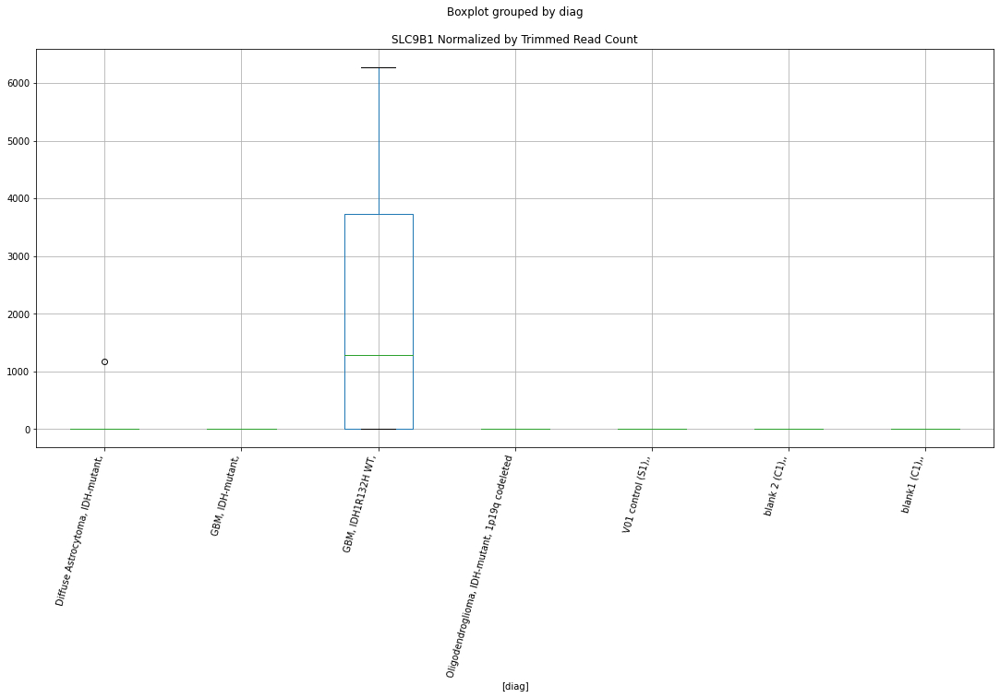

 p : 0.019364561629354914  ( t : 2.5678048565338294 ) :  D-plex  :  cutadapt2  :  POLI
Control and blanks
76     0.0
340    0.0
Name: POLI, dtype: float64
208    9170.73
Name: POLI, dtype: float64
472    0.0
Name: POLI, dtype: float64


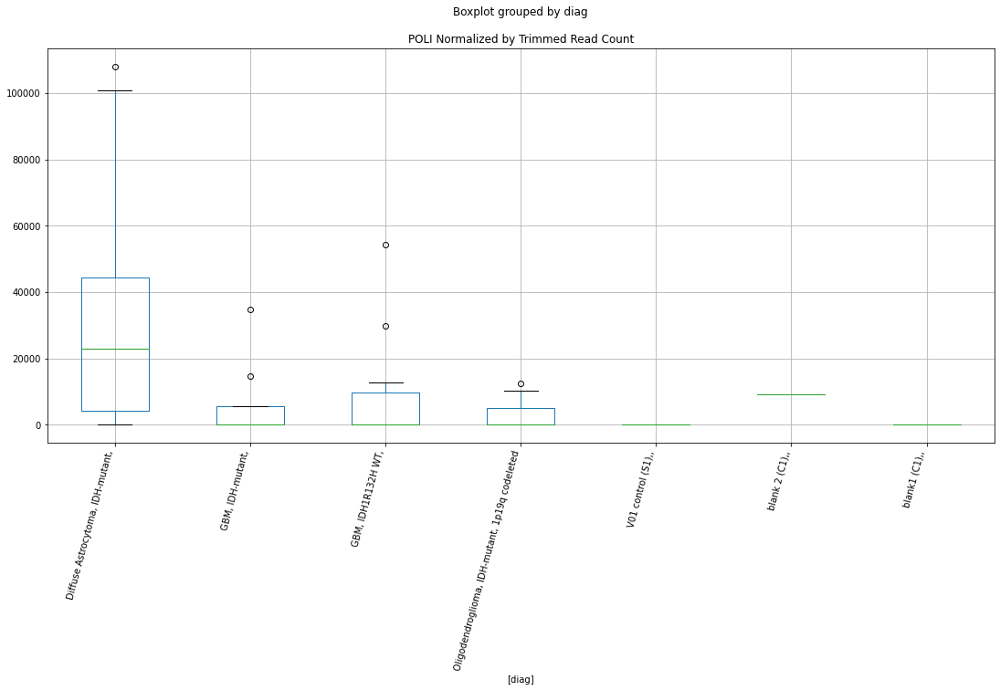

 p : 0.019377664161350956  ( t : 2.5674819850346844 ) :  D-plex  :  cutadapt2  :  RASSF3
Control and blanks
76     0.0
340    0.0
Name: RASSF3, dtype: float64
208    881.8
Name: RASSF3, dtype: float64
472    0.0
Name: RASSF3, dtype: float64


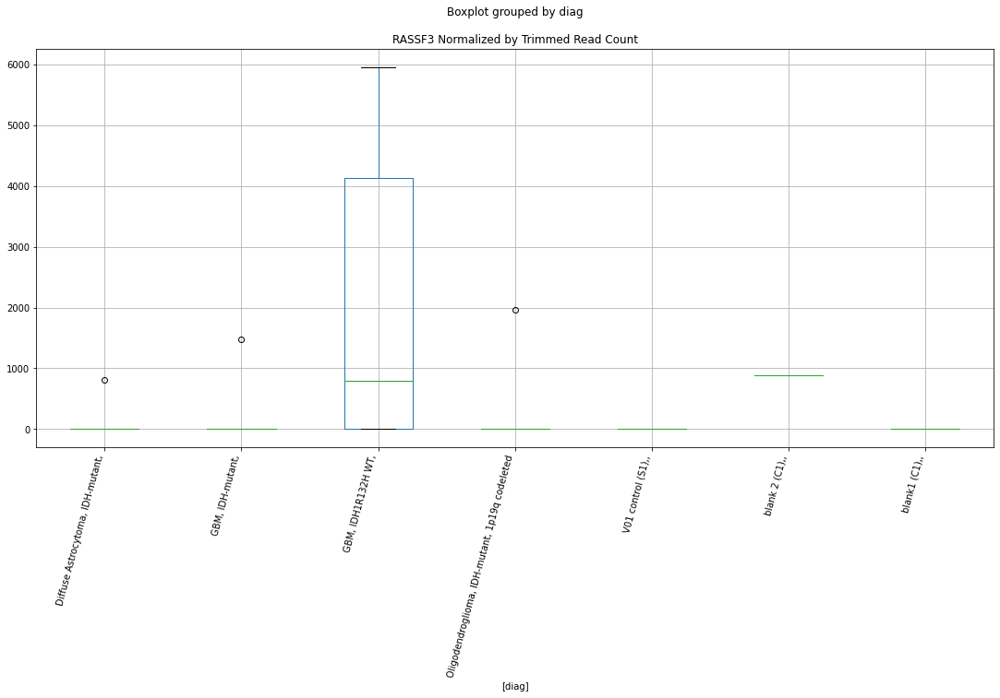

 p : 0.019533786607851617  ( t : 2.56365065326444 ) :  D-plex  :  bbduk2  :  PARP16
Control and blanks
73     13914.15
337        0.00
Name: PARP16, dtype: float64
205    6447.27
Name: PARP16, dtype: float64
469    5323.75
Name: PARP16, dtype: float64


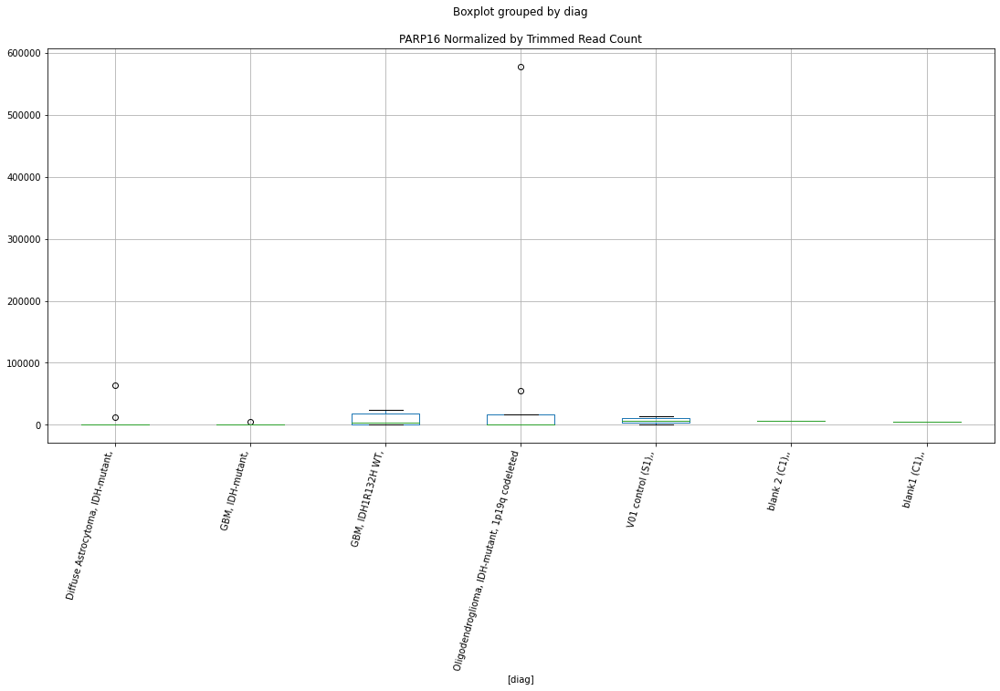

 p : 0.019561924053552286  ( t : 2.56296322935415 ) :  Lexogen  :  cutadapt2  :  PLPPR5
Control and blanks
82         0.00
346    38719.95
Name: PLPPR5, dtype: float64
214    0.0
Name: PLPPR5, dtype: float64
478    0.0
Name: PLPPR5, dtype: float64


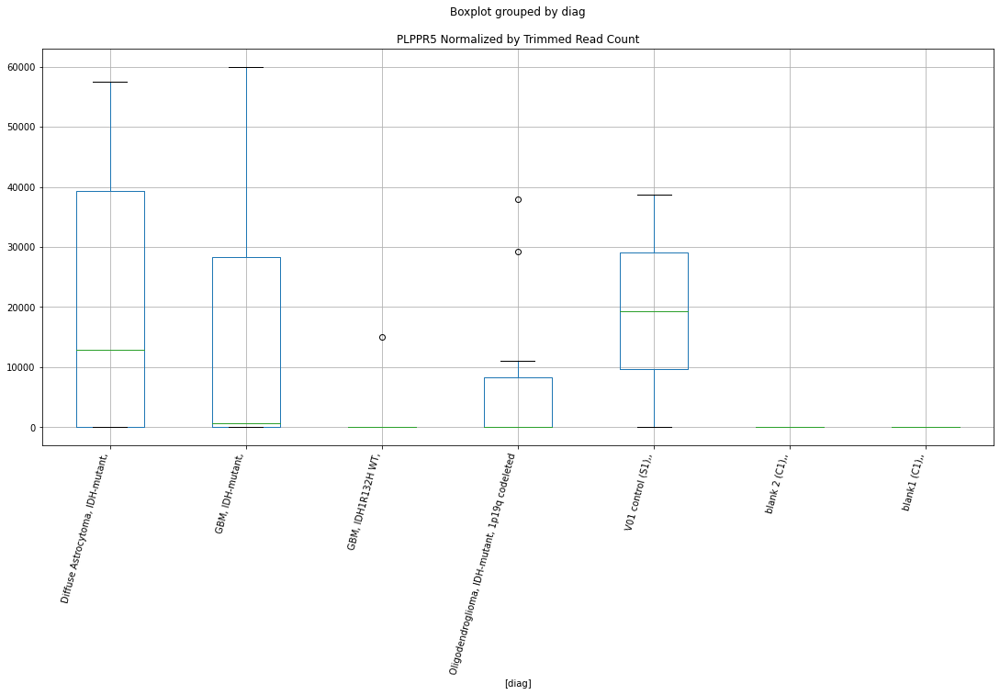

 p : 0.019687753467323106  ( t : 2.5599005065364686 ) :  D-plex  :  bbduk2  :  PDE8A
Control and blanks
73     943070.25
337     17803.15
Name: PDE8A, dtype: float64
205    301947.35
Name: PDE8A, dtype: float64
469    479137.13
Name: PDE8A, dtype: float64


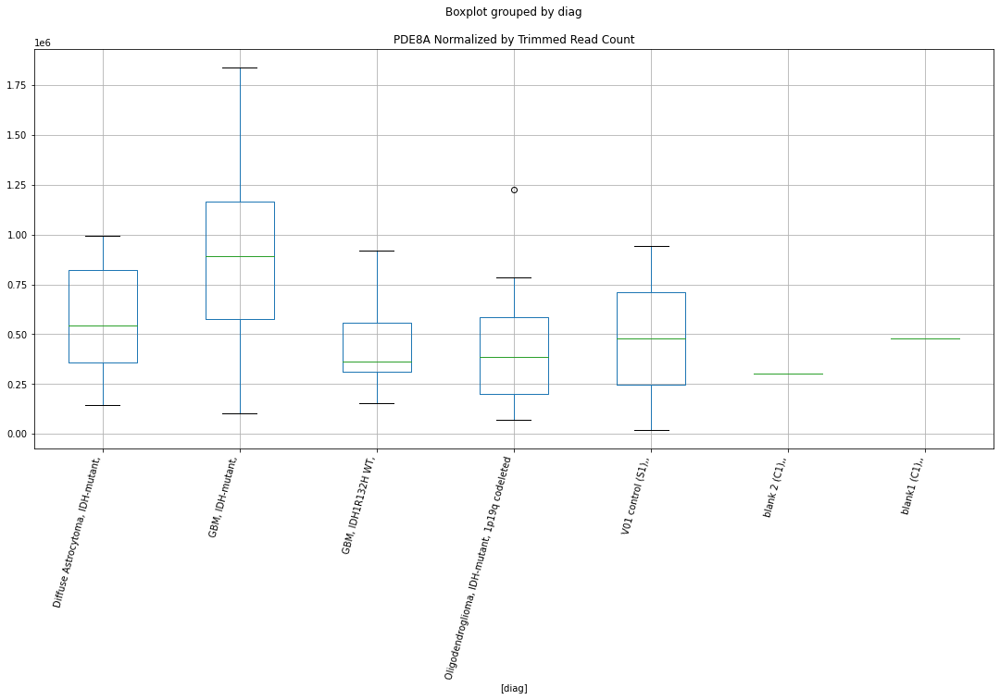

 p : 0.019750826799721483  ( t : 2.5583722481707007 ) :  Lexogen  :  bbduk2  :  PLPPR5
Control and blanks
79         0.00
343    38216.58
Name: PLPPR5, dtype: float64
211    0.0
Name: PLPPR5, dtype: float64
475    0.0
Name: PLPPR5, dtype: float64


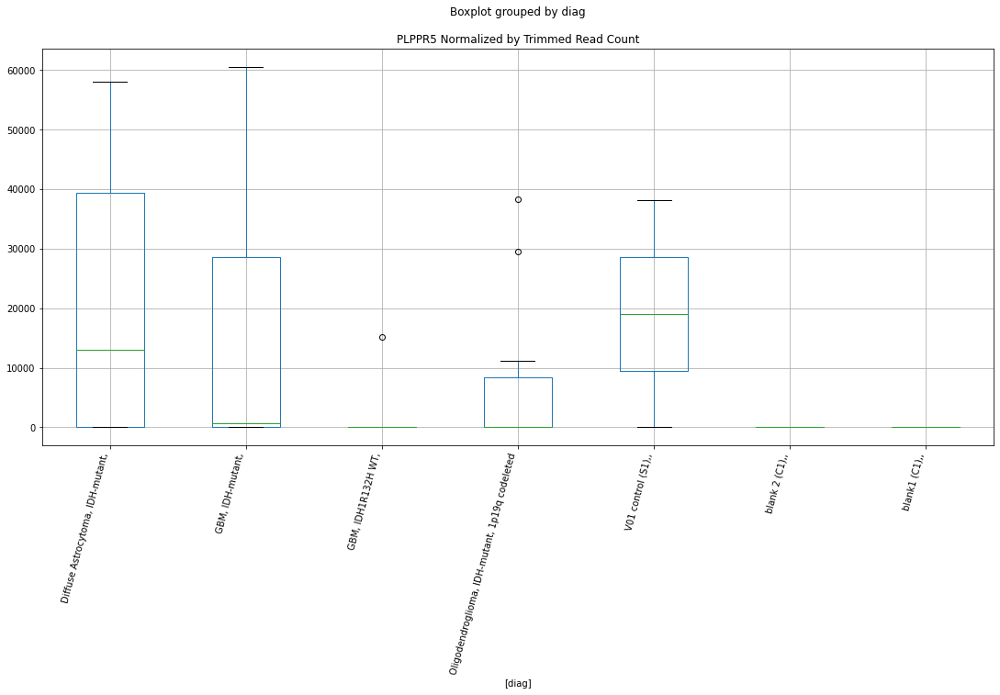

 p : 0.019756476878910193  ( t : 2.558235572987825 ) :  D-plex  :  cutadapt2  :  PARP16
Control and blanks
76     13637.06
340        0.00
Name: PARP16, dtype: float64
208    6348.97
Name: PARP16, dtype: float64
472    5201.6
Name: PARP16, dtype: float64


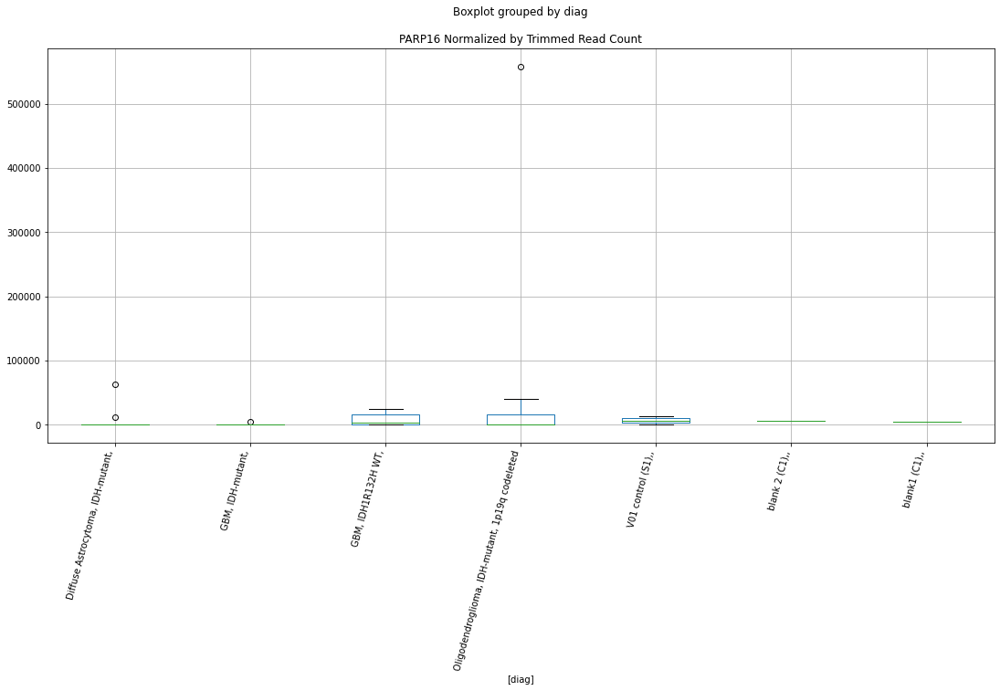

 p : 0.019767647558391693  ( t : 2.557965463530693 ) :  D-plex  :  bbduk2  :  SIX1
Control and blanks
73     1546.02
337       0.00
Name: SIX1, dtype: float64
205    1253.64
Name: SIX1, dtype: float64
469    1183.05
Name: SIX1, dtype: float64


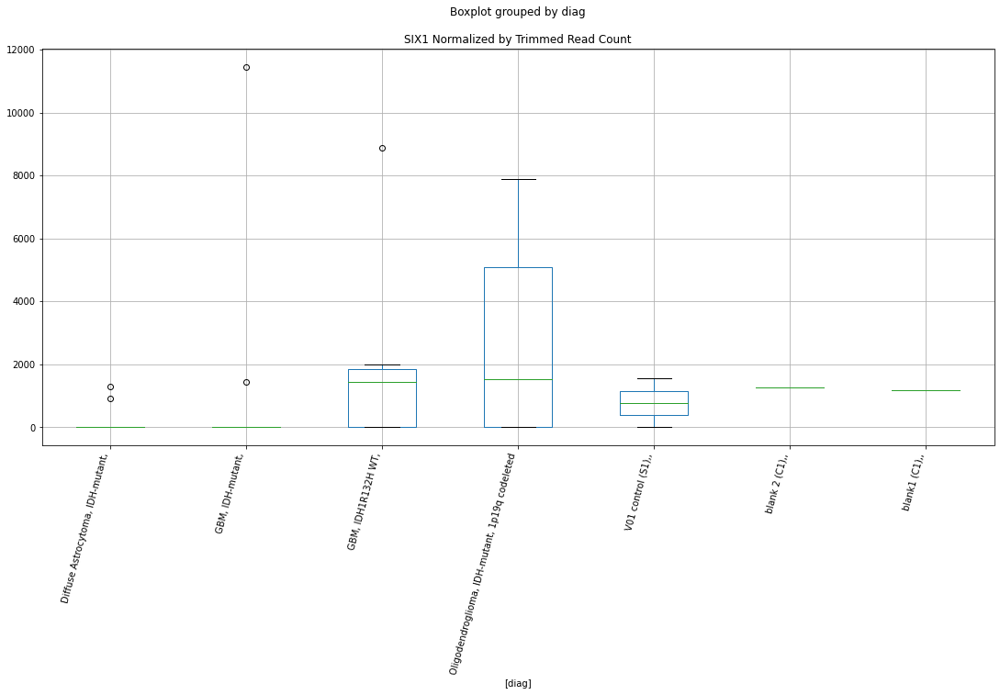

 p : 0.019918896944470996  ( t : 2.554322368173727 ) :  Lexogen  :  bbduk2  :  OTOG
Control and blanks
79        0.00
343    3397.03
Name: OTOG, dtype: float64
211    4919.51
Name: OTOG, dtype: float64
475    3353.22
Name: OTOG, dtype: float64


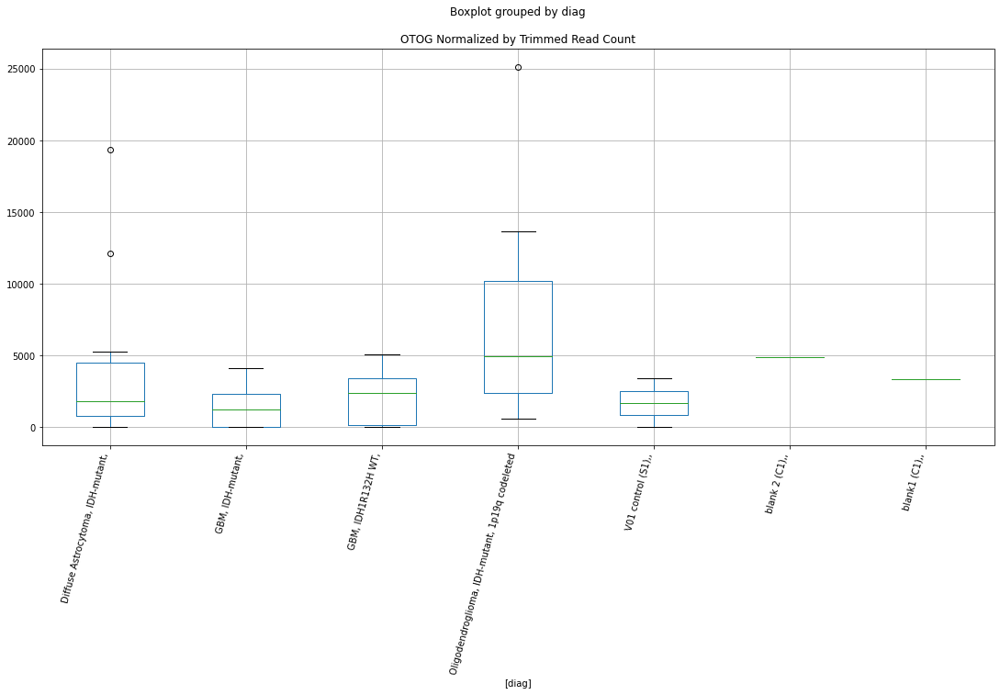

 p : 0.020075558257058344  ( t : 2.550576405506498 ) :  Lexogen  :  cutadapt2  :  POLH
Control and blanks
82     0.0
346    0.0
Name: POLH, dtype: float64
214    0.0
Name: POLH, dtype: float64
478    474.92
Name: POLH, dtype: float64


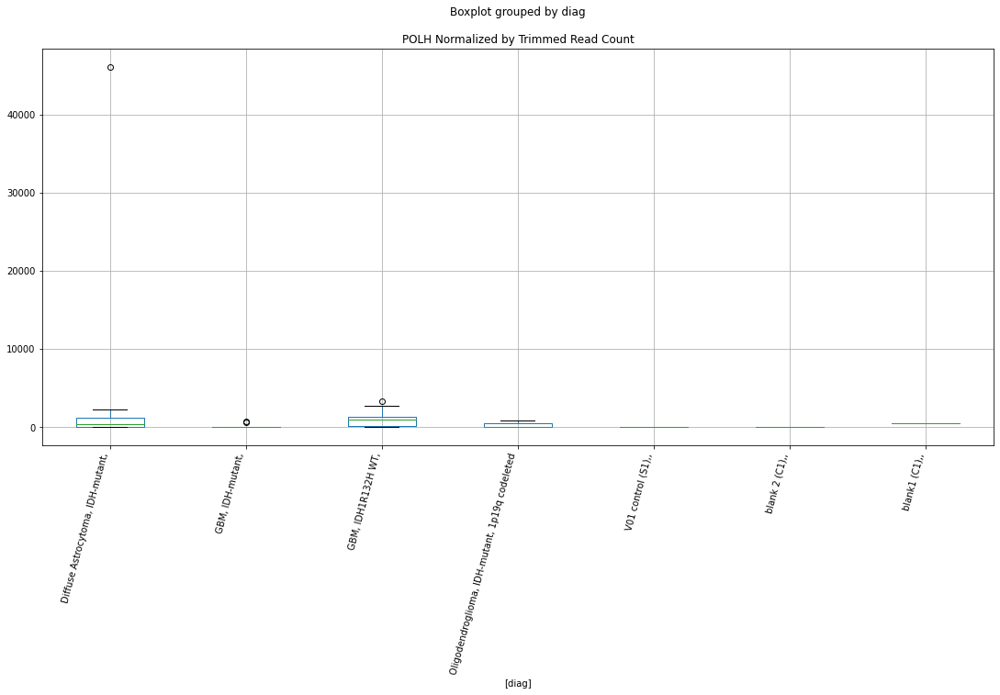

 p : 0.02014295173321696  ( t : 2.5489734439408682 ) :  D-plex  :  bbduk2  :  PCNX1
Control and blanks
73      9276.10
337    10681.89
Name: PCNX1, dtype: float64
205    45130.92
Name: PCNX1, dtype: float64
469    42589.97
Name: PCNX1, dtype: float64


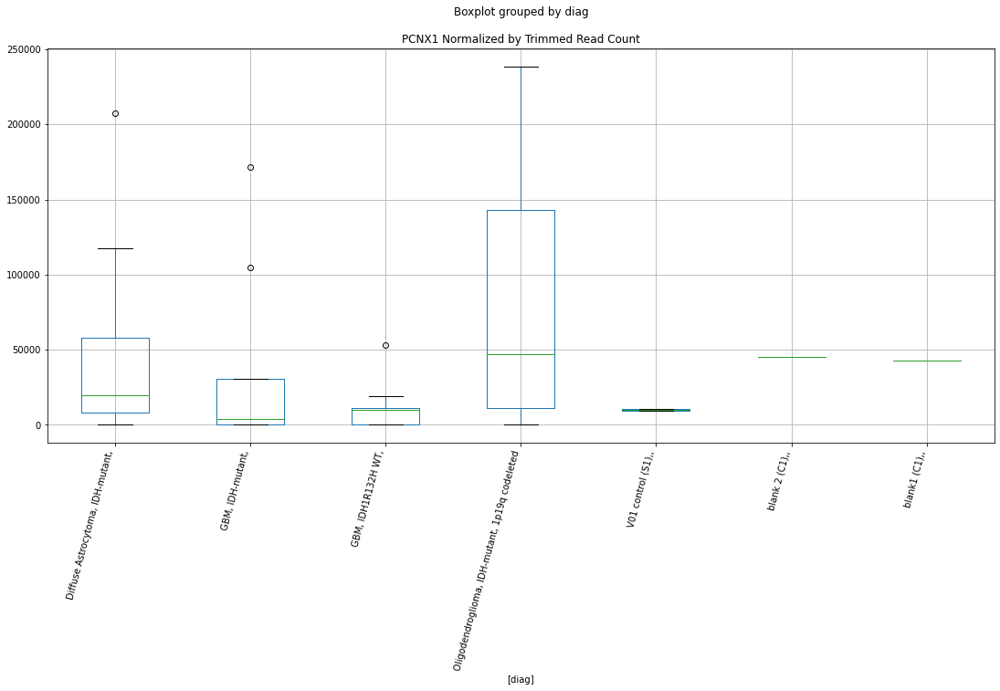

 p : 0.020540112419100344  ( t : 2.5396286880560477 ) :  Lexogen  :  cutadapt2  :  PI15
Control and blanks
82     0.0
346    0.0
Name: PI15, dtype: float64
214    0.0
Name: PI15, dtype: float64
478    0.0
Name: PI15, dtype: float64


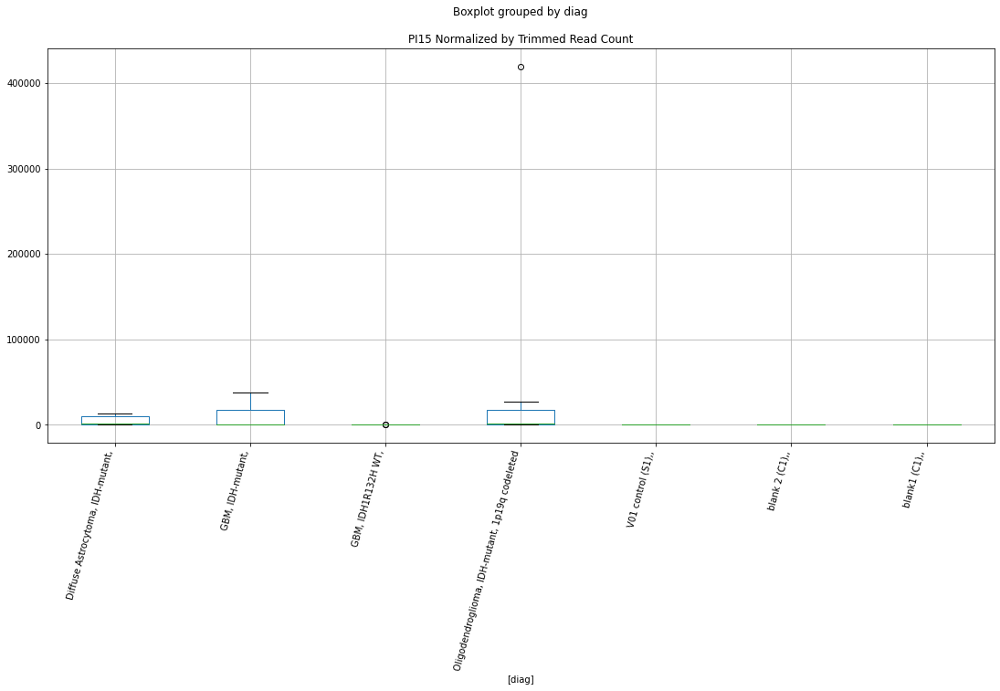

 p : 0.02056852587822216  ( t : 2.538966713593843 ) :  D-plex  :  bbduk2  :  POM121
Control and blanks
73     4638.05
337    3560.63
Name: POM121, dtype: float64
205    192880.96
Name: POM121, dtype: float64
469    403421.63
Name: POM121, dtype: float64


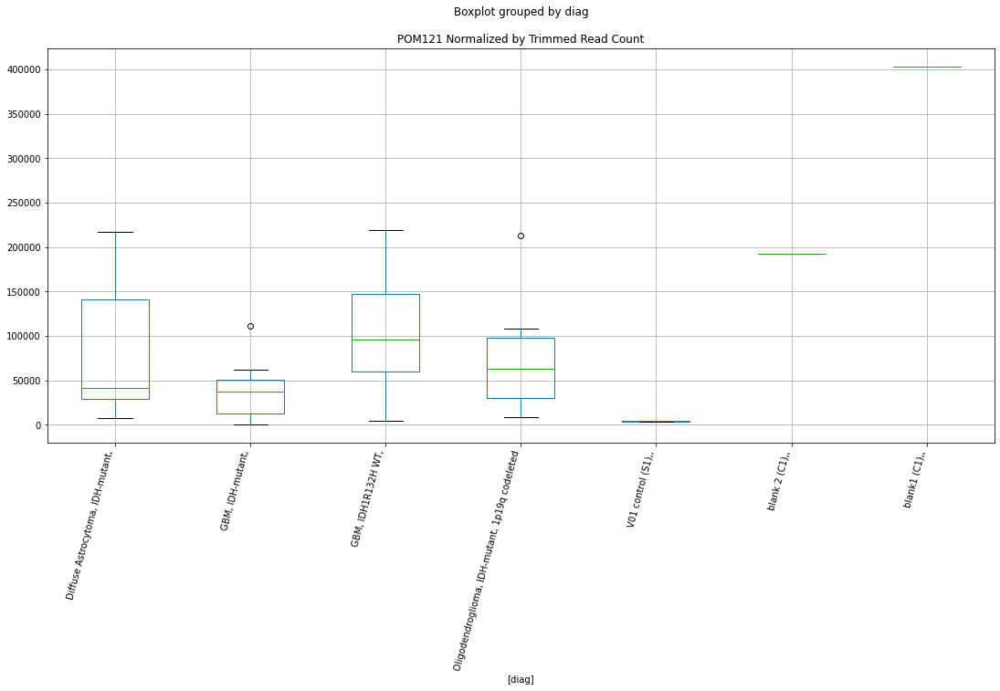

 p : 0.021020768364772083  ( t : 2.528545112411249 ) :  Lexogen  :  bbduk2  :  POLH
Control and blanks
79     0.0
343    0.0
Name: POLH, dtype: float64
211    0.0
Name: POLH, dtype: float64
475    479.03
Name: POLH, dtype: float64


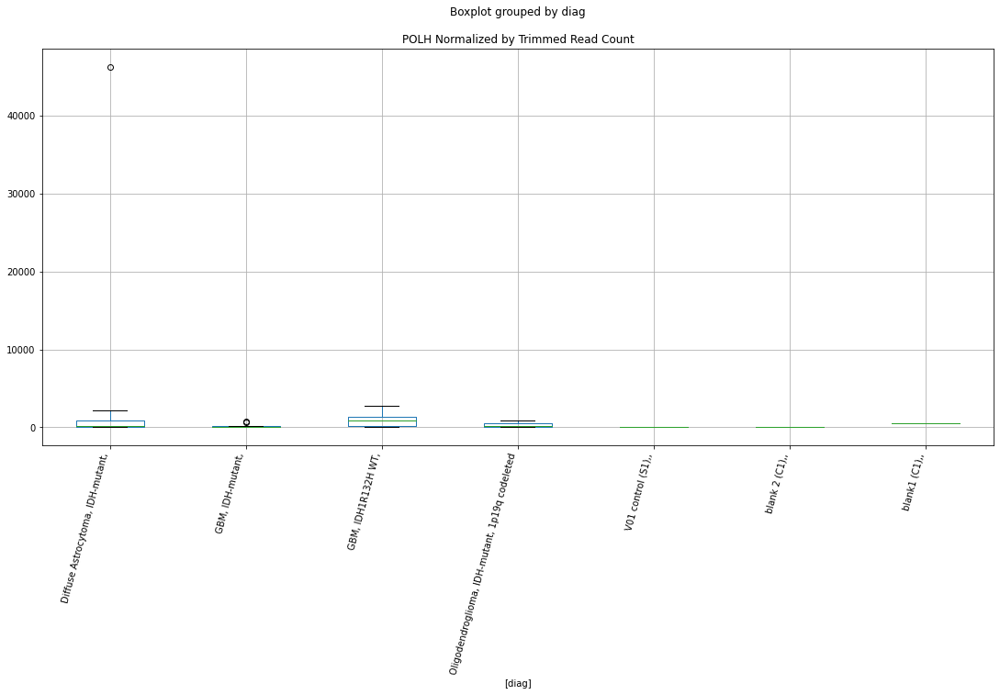

 p : 0.02104041796406288  ( t : 2.528097117621299 ) :  Lexogen  :  bbduk2  :  PI15
Control and blanks
79     0.0
343    0.0
Name: PI15, dtype: float64
211    0.0
Name: PI15, dtype: float64
475    0.0
Name: PI15, dtype: float64


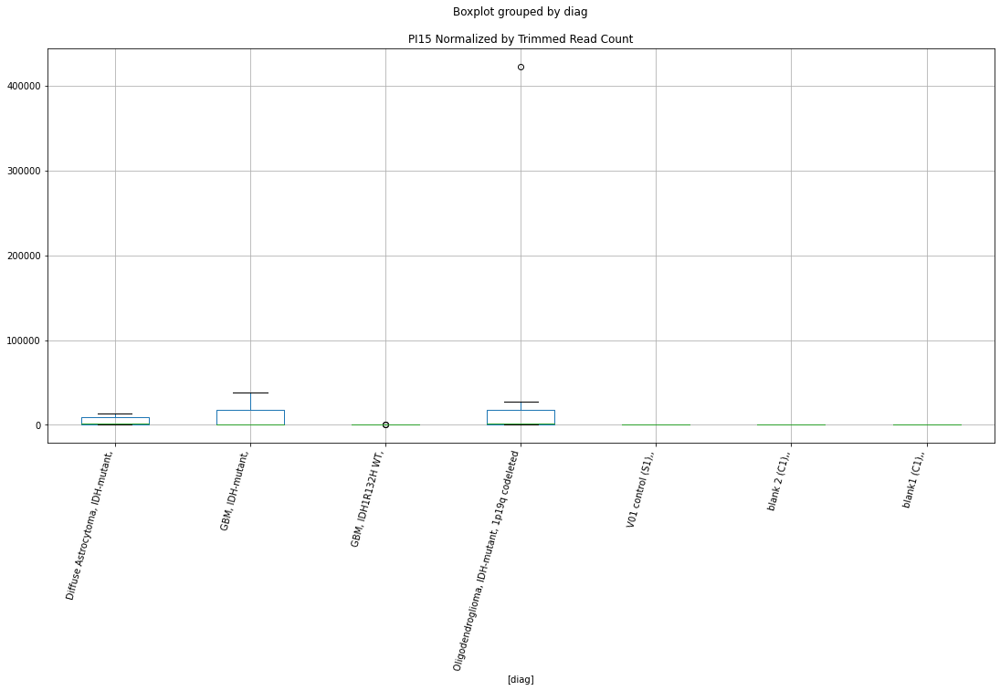

 p : 0.021217135354328752  ( t : 2.524085764266273 ) :  D-plex  :  cutadapt2  :  SOX11
Control and blanks
76       0.00
340    880.73
Name: SOX11, dtype: float64
208    2645.4
Name: SOX11, dtype: float64
472    2311.82
Name: SOX11, dtype: float64


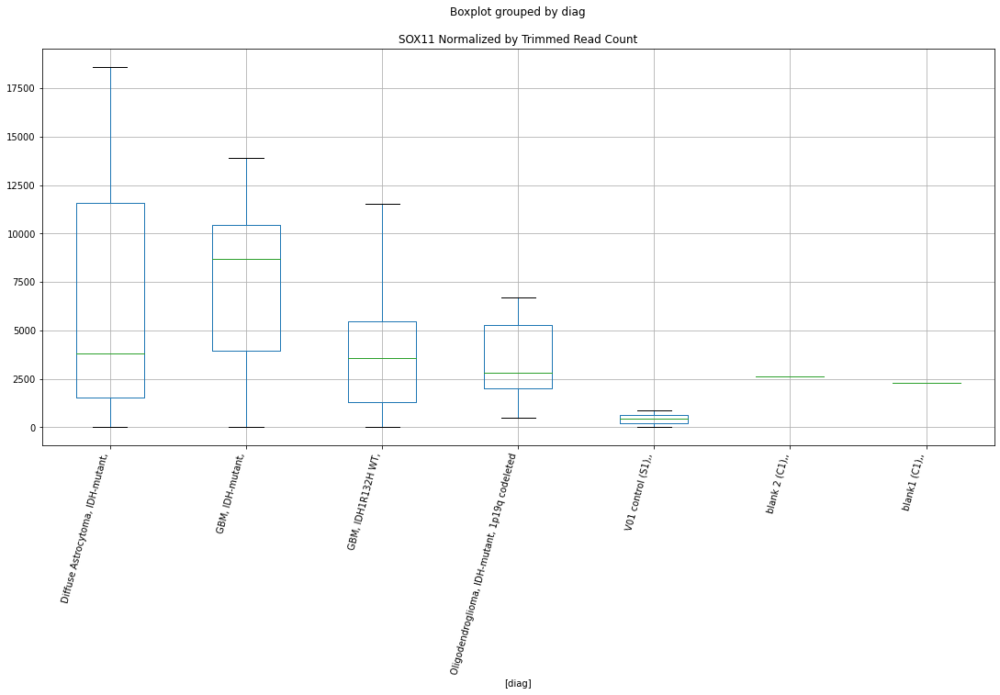

 p : 0.021228352333844677  ( t : 2.523832212971334 ) :  Lexogen  :  cutadapt2  :  RNF144A
Control and blanks
82       0.00
346    420.87
Name: RNF144A, dtype: float64
214    0.0
Name: RNF144A, dtype: float64
478    237.46
Name: RNF144A, dtype: float64


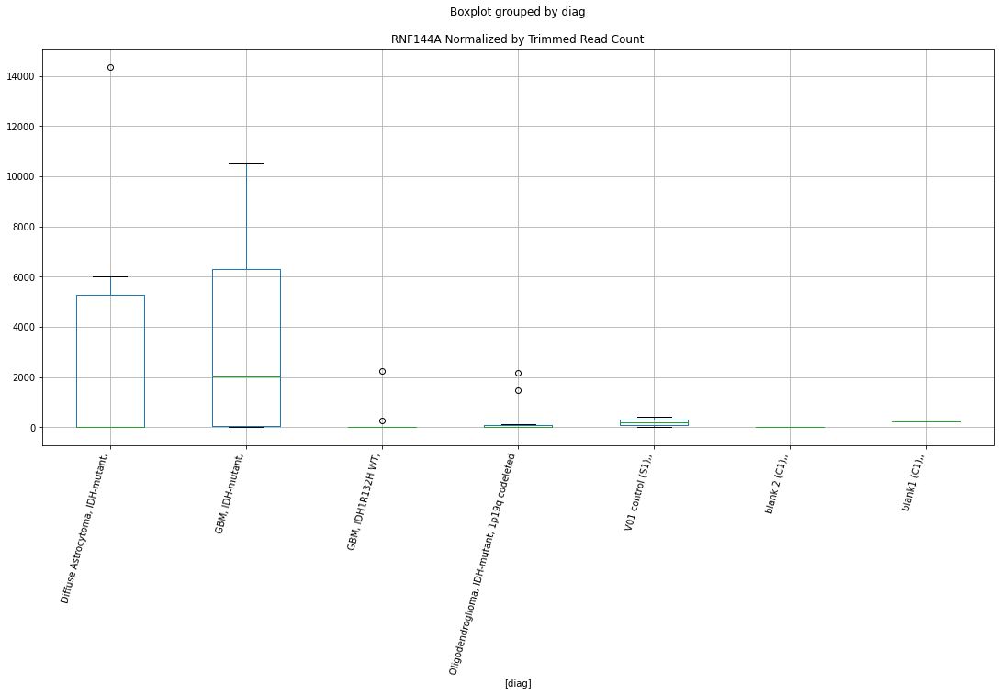

 p : 0.02126208817207085  ( t : 2.523070401443859 ) :  D-plex  :  cutadapt2  :  RPL15
Control and blanks
76     0.0
340    0.0
Name: RPL15, dtype: float64
208    3527.2
Name: RPL15, dtype: float64
472    8091.38
Name: RPL15, dtype: float64


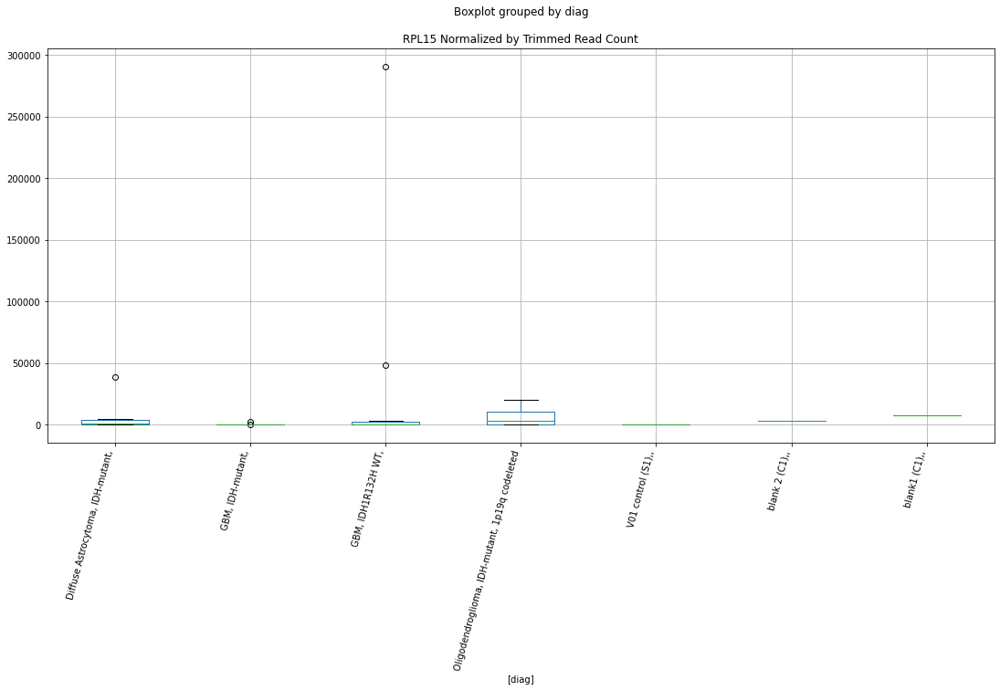

 p : 0.021343982423428644  ( t : 2.5212258285533533 ) :  D-plex  :  cutadapt2  :  PTBP3
Control and blanks
76     63639.59
340        0.00
Name: PTBP3, dtype: float64
208    12345.22
Name: PTBP3, dtype: float64
472    13870.94
Name: PTBP3, dtype: float64


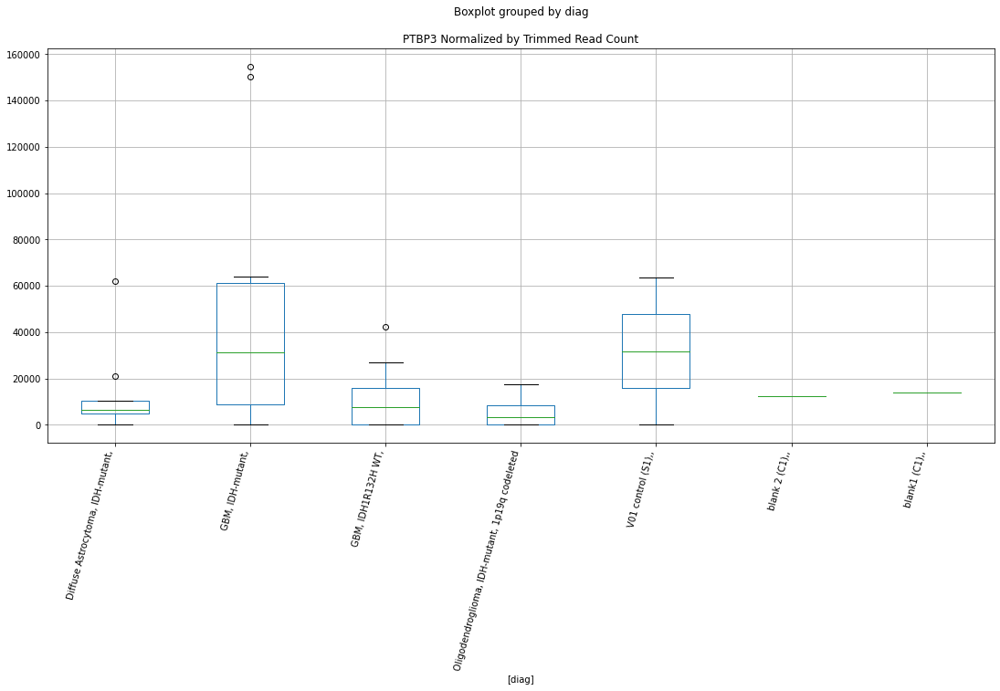

 p : 0.021385229275717642  ( t : 2.5202993190729845 ) :  D-plex  :  bbduk2  :  PIEZO2
Control and blanks
73     27828.30
337     5340.94
Name: PIEZO2, dtype: float64
205    113543.66
Name: PIEZO2, dtype: float64
469    118896.99
Name: PIEZO2, dtype: float64


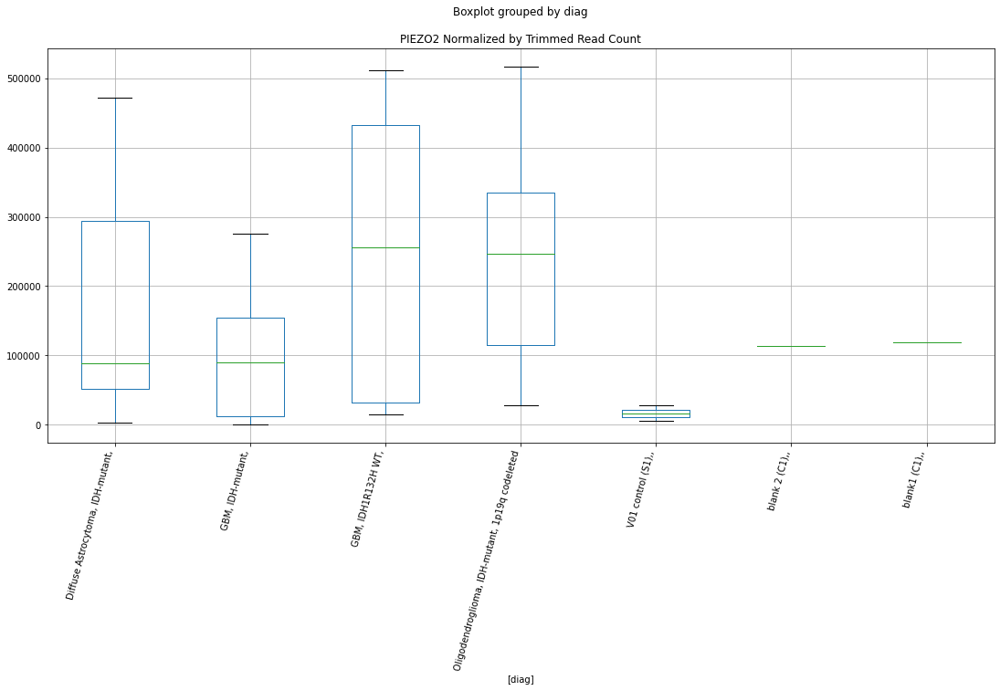

 p : 0.021408196997148295  ( t : 2.519784136228963 ) :  D-plex  :  cutadapt2  :  RTN3
Control and blanks
76     3788.07
340    4403.66
Name: RTN3, dtype: float64
208    6172.61
Name: RTN3, dtype: float64
472    8669.34
Name: RTN3, dtype: float64


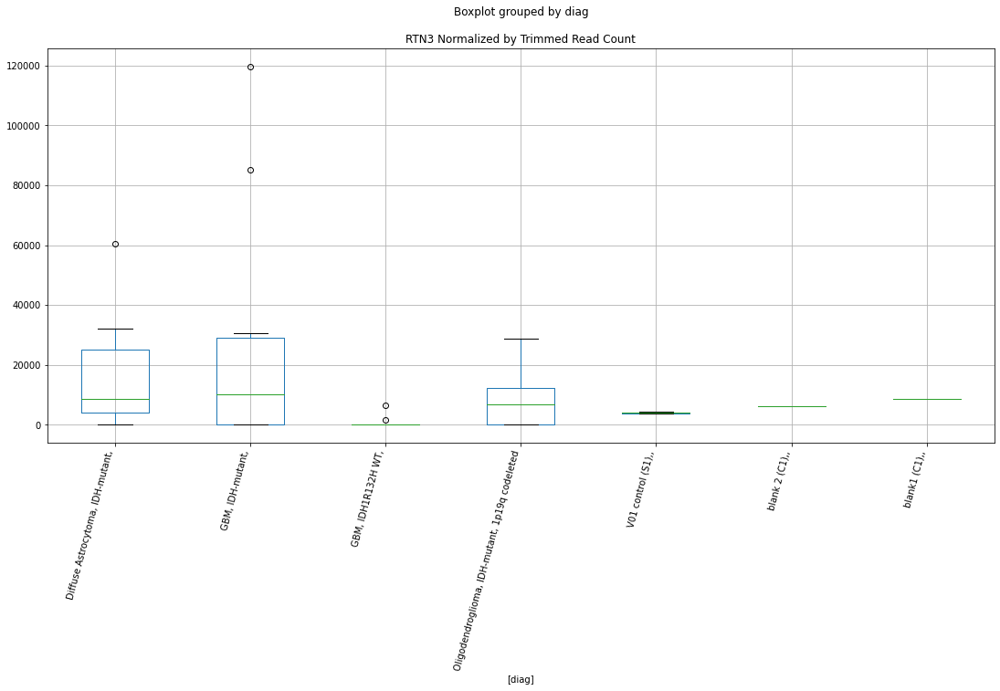

 p : 0.021410591792894392  ( t : 2.5197304492351695 ) :  D-plex  :  bbduk2  :  RPL15
Control and blanks
73     0.0
337    0.0
Name: RPL15, dtype: float64
205    3581.82
Name: RPL15, dtype: float64
469    8281.38
Name: RPL15, dtype: float64


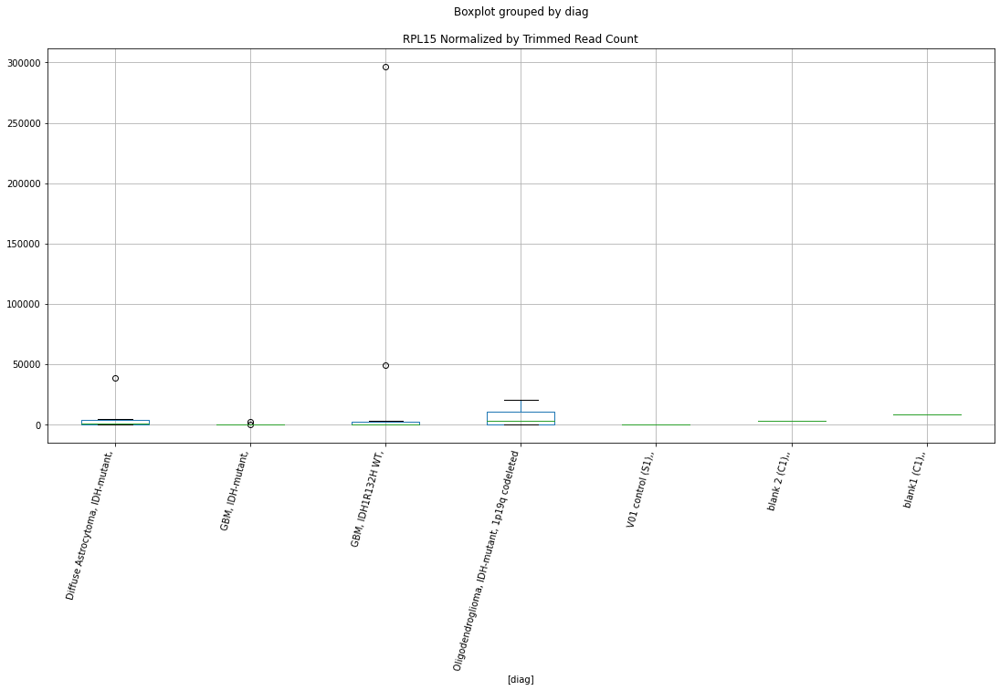

 p : 0.021529821864884235  ( t : 2.5170646648287844 ) :  Lexogen  :  bbduk2  :  RRP7A
Control and blanks
79       0.00
343    424.63
Name: RRP7A, dtype: float64
211    0.0
Name: RRP7A, dtype: float64
475    0.0
Name: RRP7A, dtype: float64


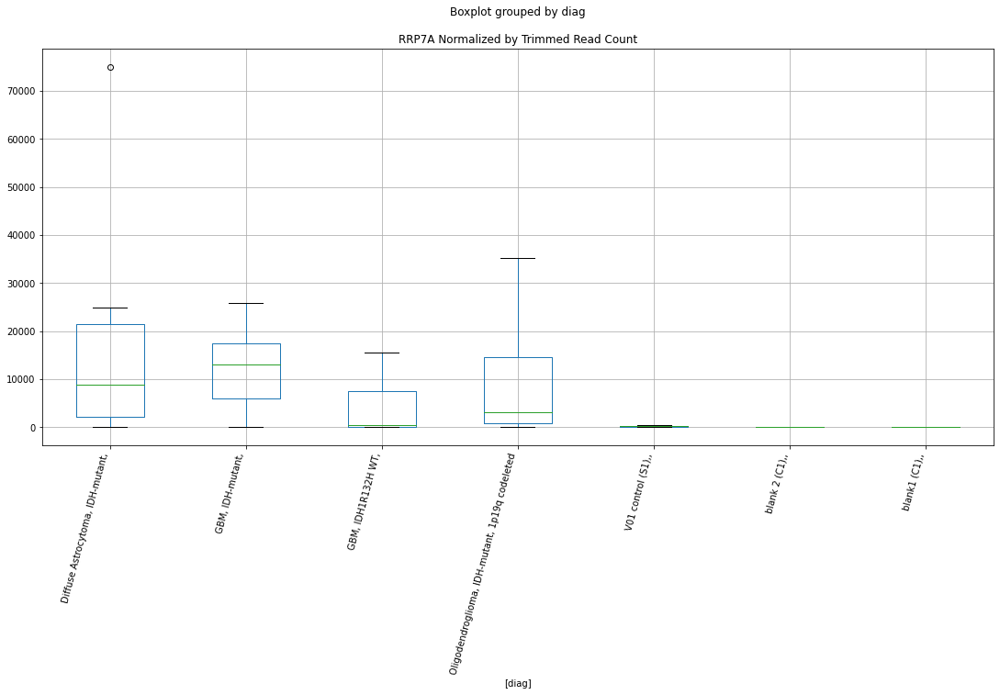

 p : 0.021530093584940183  ( t : 2.517058605548486 ) :  Lexogen  :  bbduk2  :  SORBS2
Control and blanks
79     0.0
343    0.0
Name: SORBS2, dtype: float64
211    0.0
Name: SORBS2, dtype: float64
475    0.0
Name: SORBS2, dtype: float64


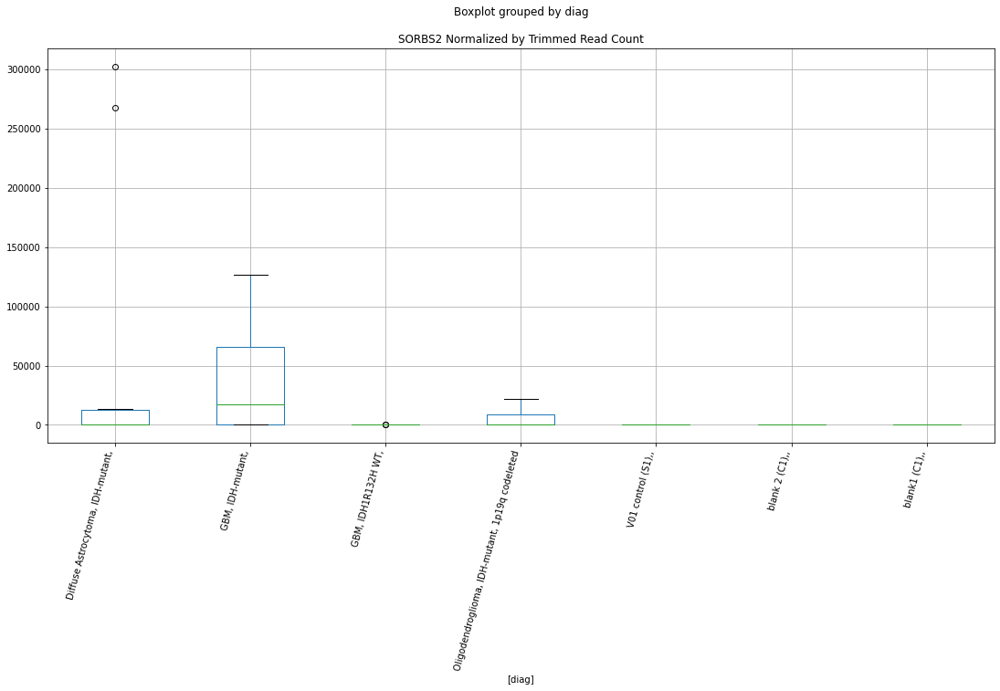

 p : 0.021600559370122556  ( t : 2.5154896688184714 ) :  Lexogen  :  bbduk2  :  SLC35G4
Control and blanks
79       0.00
343    212.31
Name: SLC35G4, dtype: float64
211    0.0
Name: SLC35G4, dtype: float64
475    0.0
Name: SLC35G4, dtype: float64


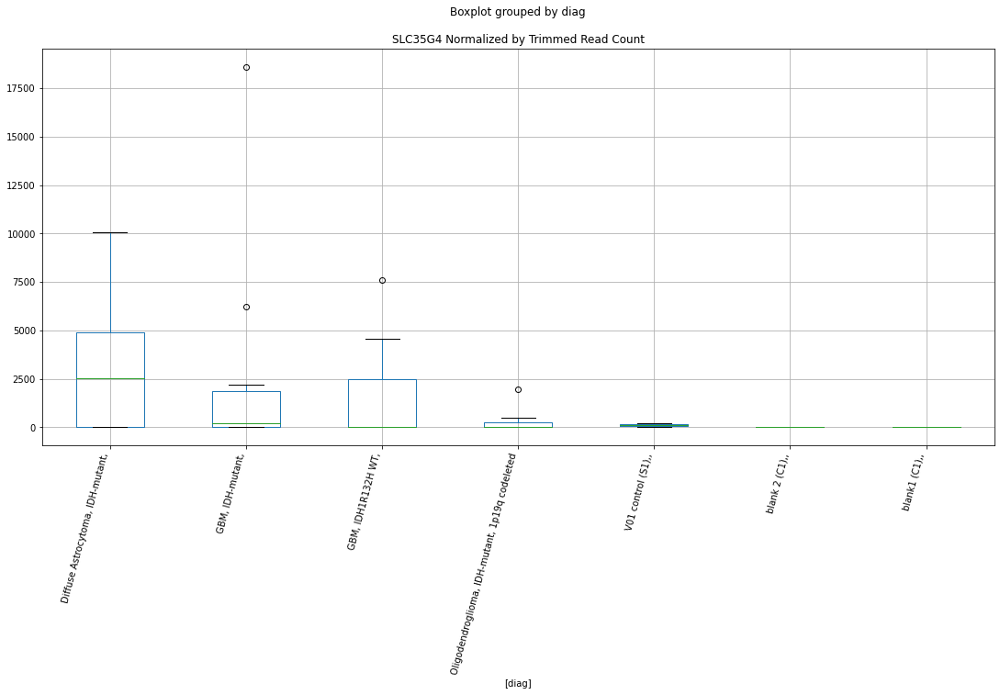

 p : 0.021609675370702516  ( t : 2.515287051845747 ) :  D-plex  :  bbduk2  :  SELENOKP3
Control and blanks
73     773.01
337    890.16
Name: SELENOKP3, dtype: float64
205    716.36
Name: SELENOKP3, dtype: float64
469    1183.05
Name: SELENOKP3, dtype: float64


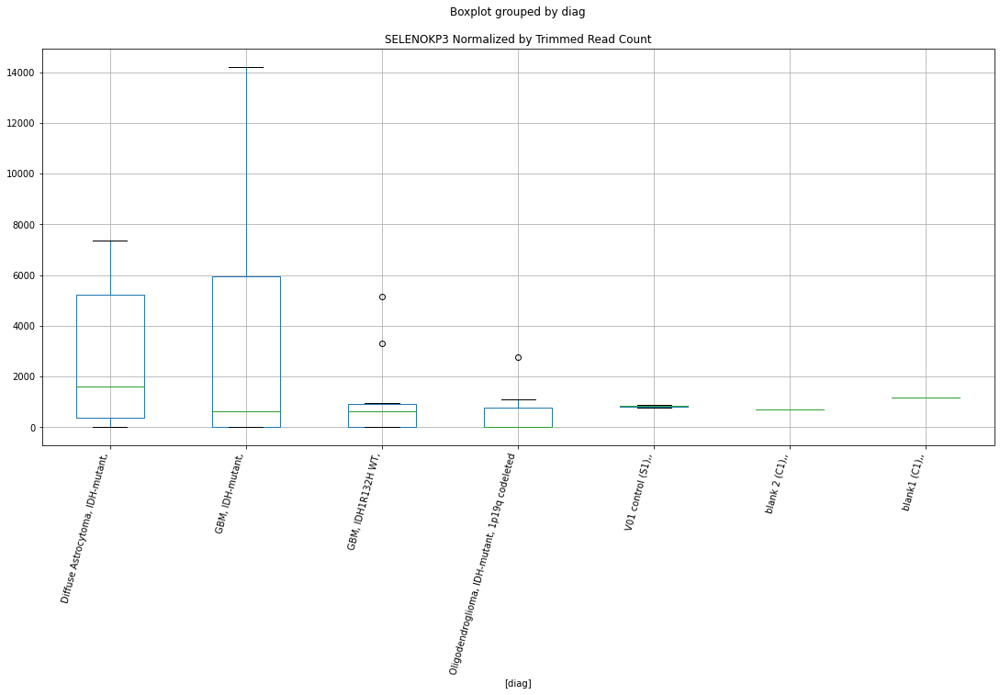

 p : 0.021615945029661316  ( t : 2.515147745937759 ) :  Lexogen  :  cutadapt2  :  SLC35G4
Control and blanks
82       0.00
346    210.43
Name: SLC35G4, dtype: float64
214    0.0
Name: SLC35G4, dtype: float64
478    0.0
Name: SLC35G4, dtype: float64


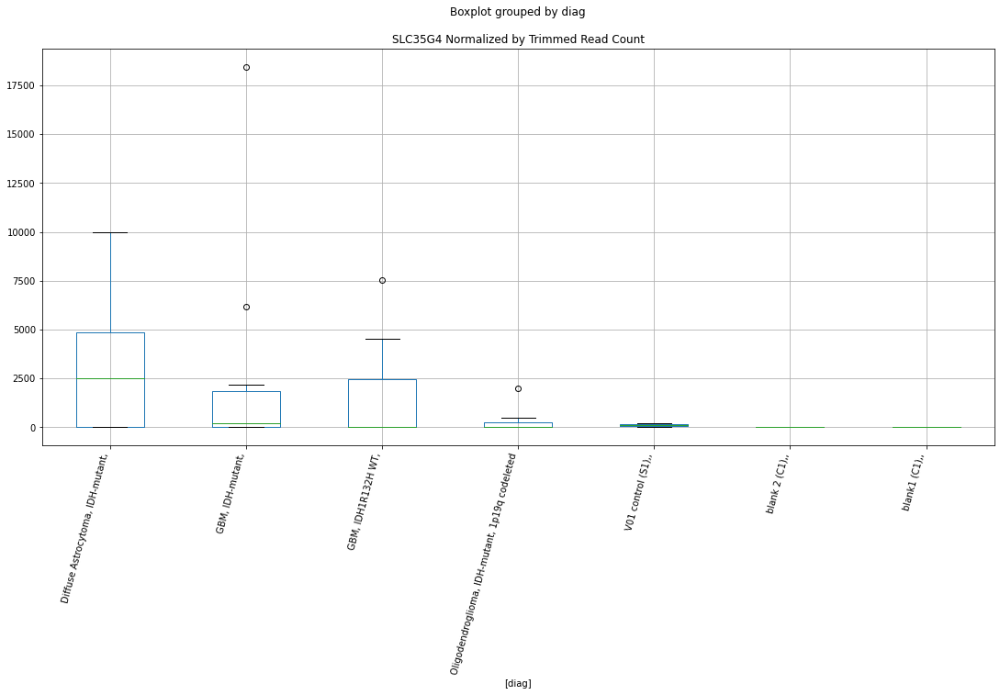

 p : 0.02163806246639478  ( t : 2.514656621581851 ) :  Lexogen  :  cutadapt2  :  SORBS2
Control and blanks
82     0.0
346    0.0
Name: SORBS2, dtype: float64
214    0.0
Name: SORBS2, dtype: float64
478    0.0
Name: SORBS2, dtype: float64


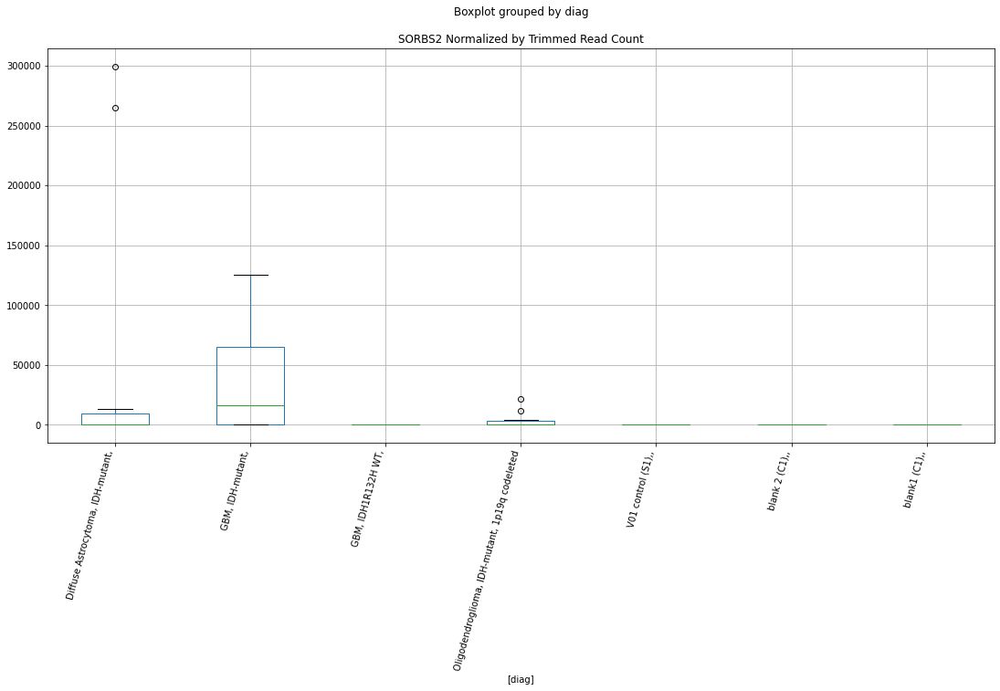

 p : 0.021786406535532366  ( t : 2.511374783914034 ) :  D-plex  :  cutadapt2  :  PDE8A
Control and blanks
76     939441.62
340     17614.64
Name: PDE8A, dtype: float64
208    296814.25
Name: PDE8A, dtype: float64
472    468144.23
Name: PDE8A, dtype: float64


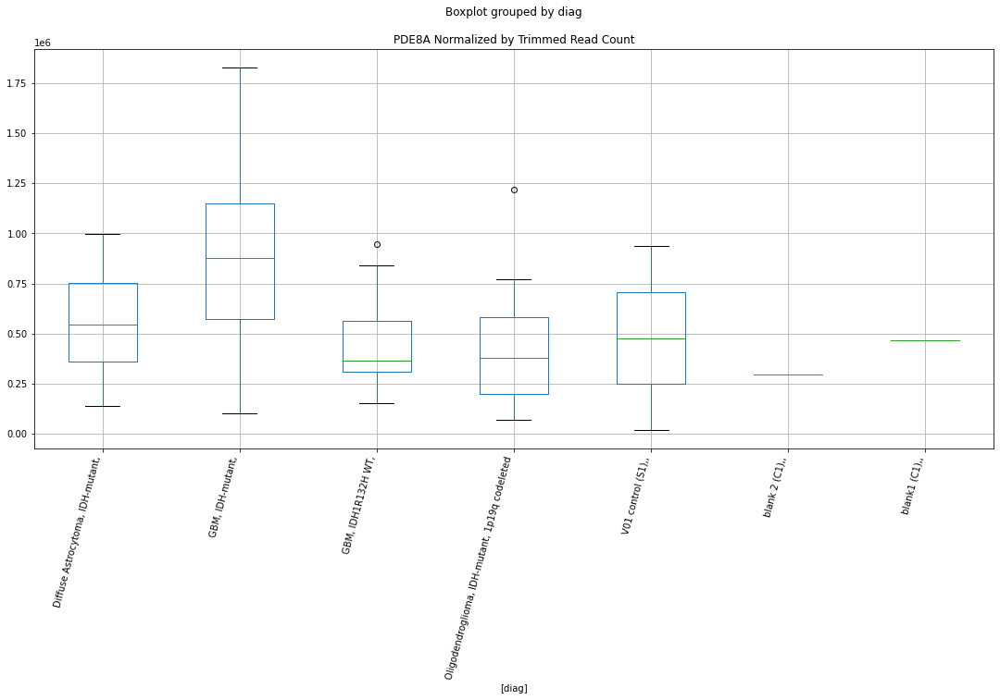

 p : 0.021832629558401023  ( t : 2.5103564912015424 ) :  Lexogen  :  cutadapt2  :  RRP7A
Control and blanks
82       0.00
346    420.87
Name: RRP7A, dtype: float64
214    0.0
Name: RRP7A, dtype: float64
478    0.0
Name: RRP7A, dtype: float64


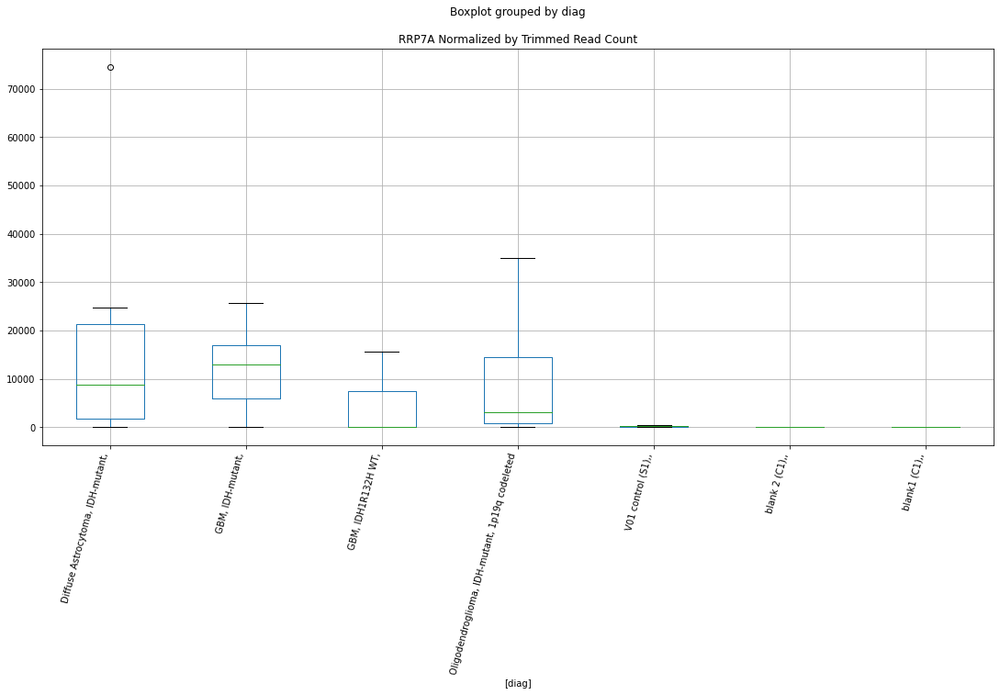

 p : 0.021842465285585155  ( t : 2.510140072599982 ) :  D-plex  :  cutadapt2  :  PRELID3A
Control and blanks
76     0.0
340    0.0
Name: PRELID3A, dtype: float64
208    881.8
Name: PRELID3A, dtype: float64
472    0.0
Name: PRELID3A, dtype: float64


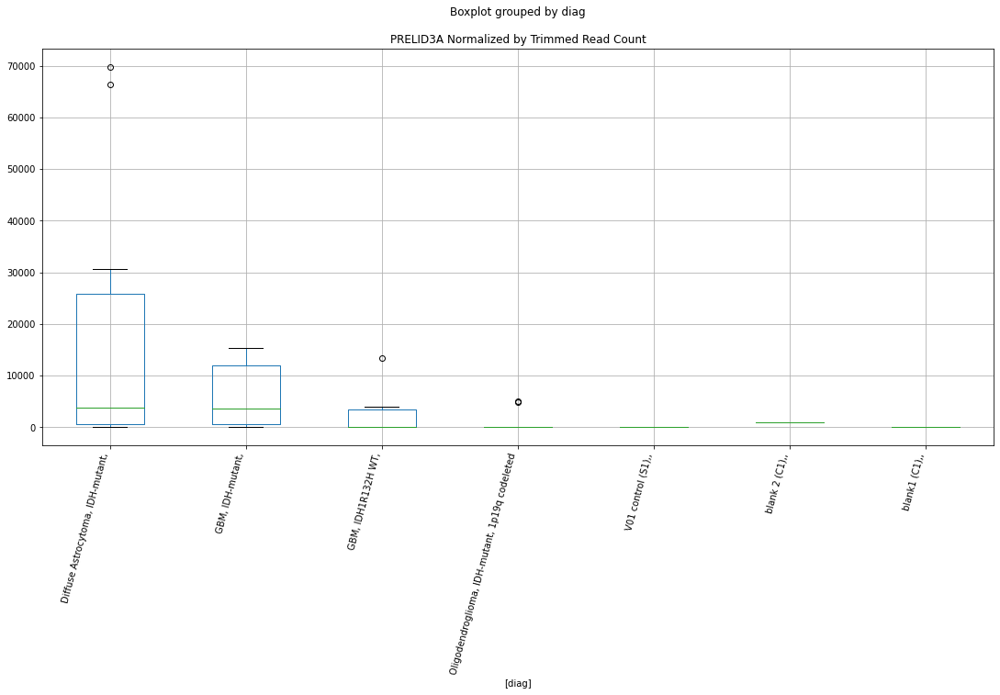

 p : 0.021937685960927045  ( t : 2.5080496404774153 ) :  D-plex  :  cutadapt2  :  QRSL1
Control and blanks
76     0.0
340    0.0
Name: QRSL1, dtype: float64
208    7759.85
Name: QRSL1, dtype: float64
472    519004.34
Name: QRSL1, dtype: float64


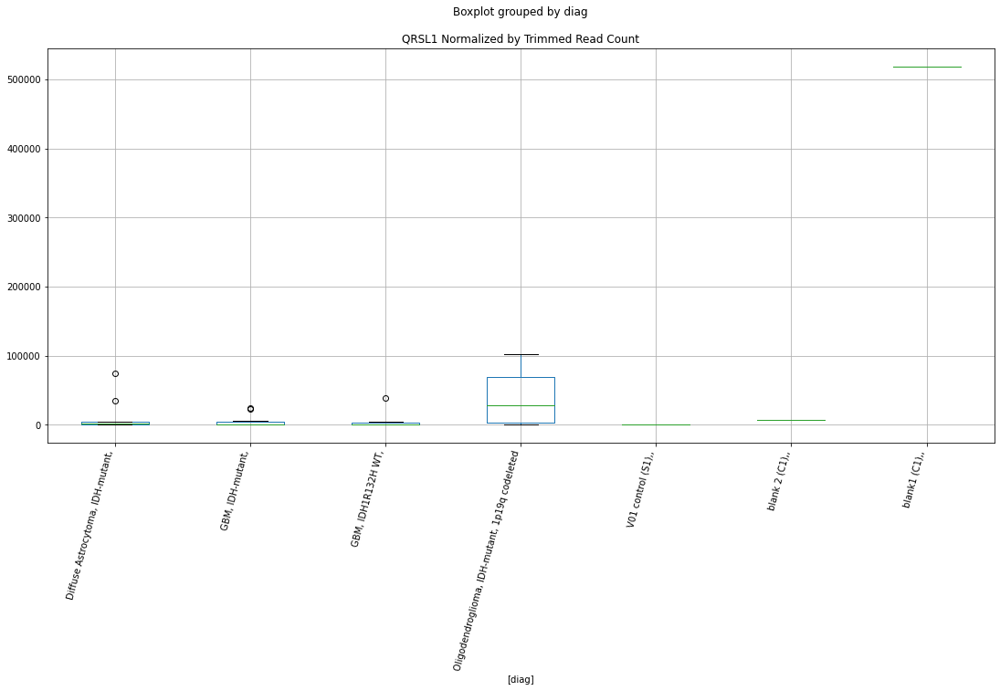

 p : 0.021947441230808808  ( t : 2.5078359610405183 ) :  D-plex  :  bbduk2  :  PSMB4
Control and blanks
73     773.01
337      0.00
Name: PSMB4, dtype: float64
205    537.27
Name: PSMB4, dtype: float64
469    1183.05
Name: PSMB4, dtype: float64


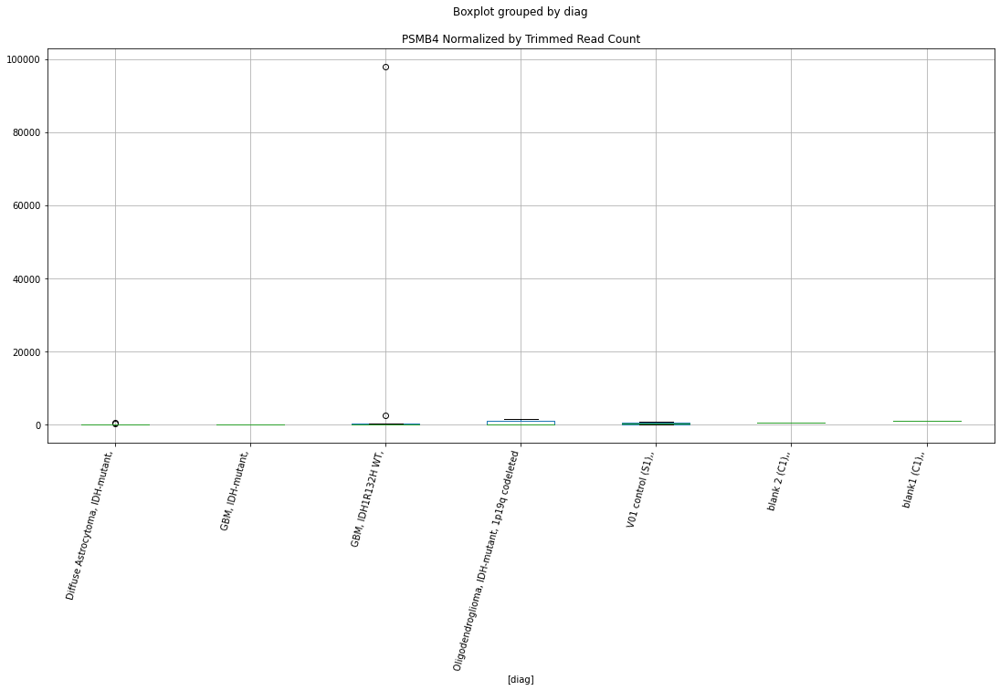

 p : 0.022034865794572138  ( t : 2.505925000581143 ) :  D-plex  :  cutadapt2  :  POR
Control and blanks
76     40911.17
340     5284.39
Name: POR, dtype: float64
208    10934.33
Name: POR, dtype: float64
472    15026.85
Name: POR, dtype: float64


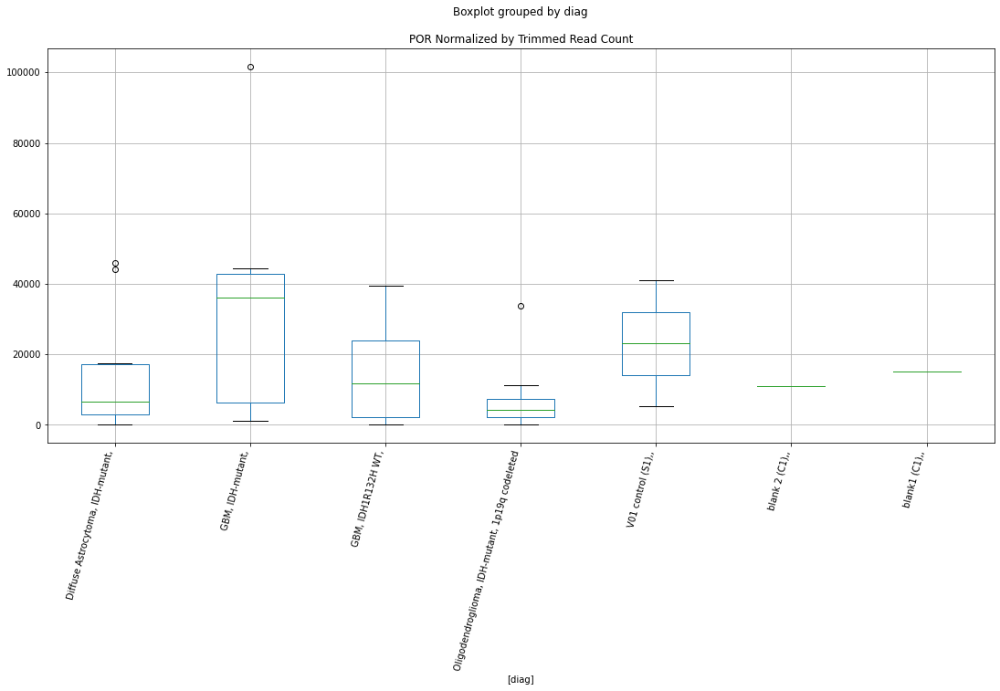

 p : 0.022248177292039092  ( t : 2.501292182760744 ) :  D-plex  :  bbduk2  :  PYCR3
Control and blanks
73     0.0
337    0.0
Name: PYCR3, dtype: float64
205    2149.09
Name: PYCR3, dtype: float64
469    7098.33
Name: PYCR3, dtype: float64


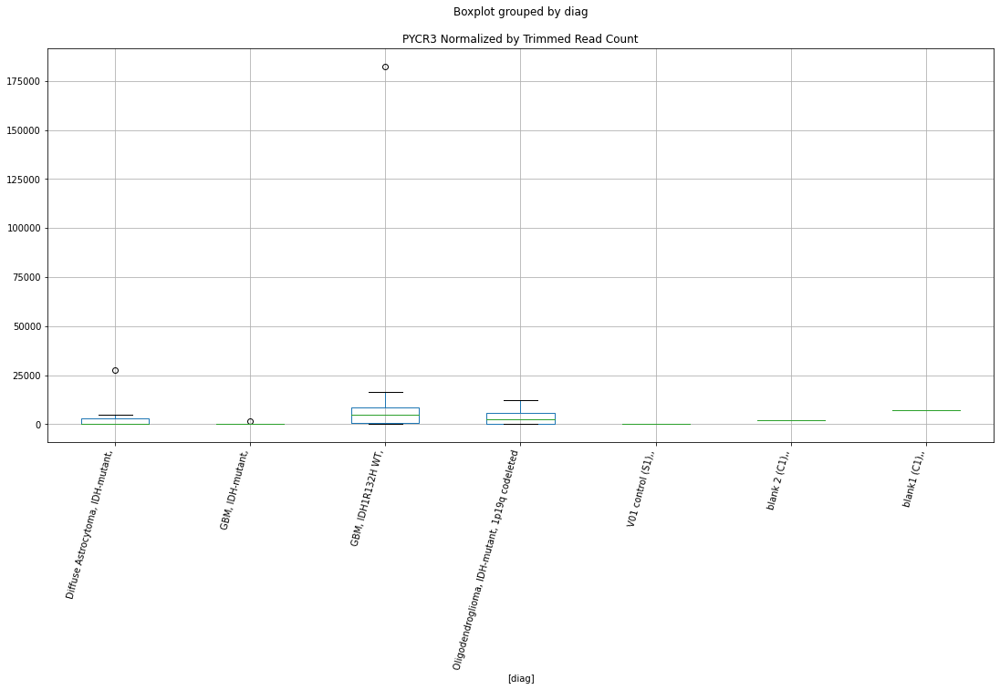

 p : 0.02270937649847422  ( t : 2.4914170266748132 ) :  Lexogen  :  cutadapt2  :  PLEC
Control and blanks
82     0.0
346    0.0
Name: PLEC, dtype: float64
214    0.0
Name: PLEC, dtype: float64
478    949.84
Name: PLEC, dtype: float64


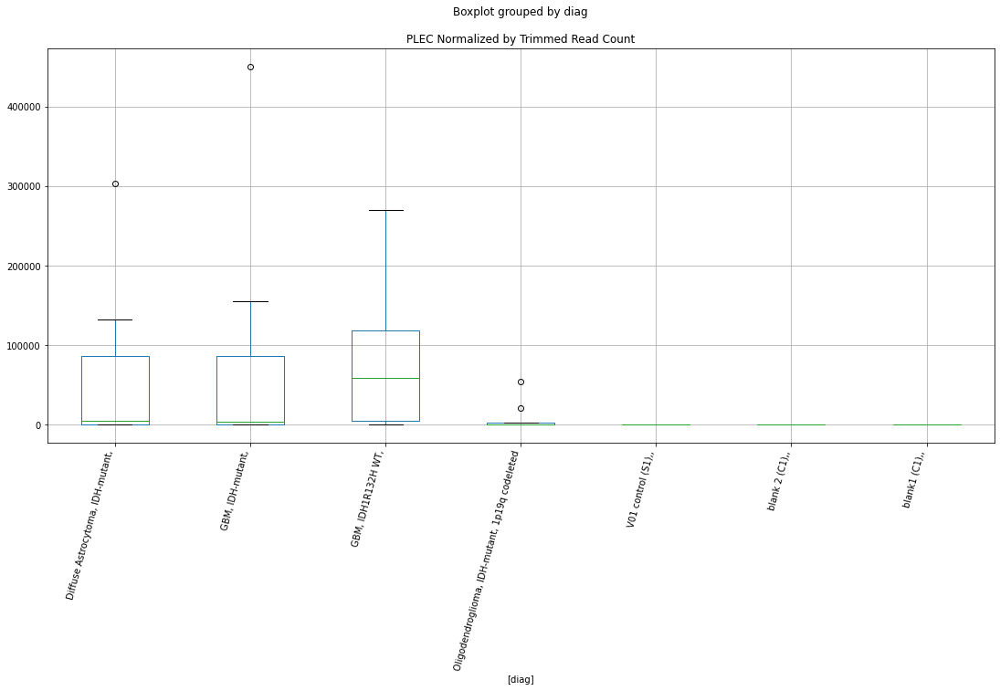

 p : 0.022737131109826957  ( t : 2.4908287907392435 ) :  Lexogen  :  cutadapt2  :  POLR3E
Control and blanks
82     0.0
346    0.0
Name: POLR3E, dtype: float64
214    6238.21
Name: POLR3E, dtype: float64
478    0.0
Name: POLR3E, dtype: float64


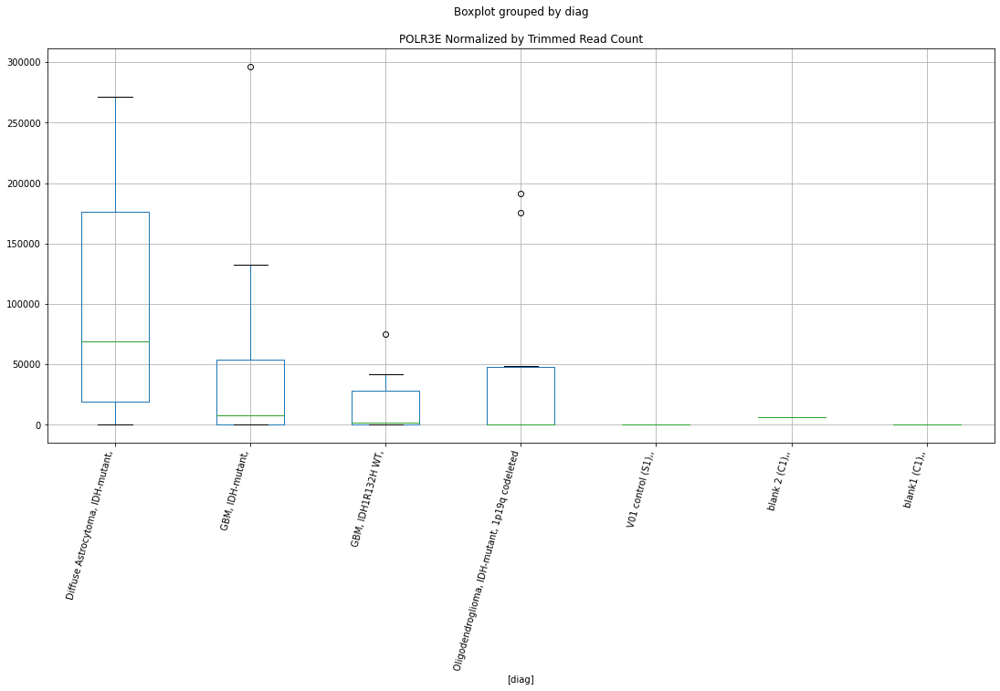

 p : 0.022743497895316586  ( t : 2.4906939473600085 ) :  D-plex  :  bbduk2  :  QRSL1
Control and blanks
73     0.0
337    0.0
Name: QRSL1, dtype: float64
205    7880.0
Name: QRSL1, dtype: float64
469    525276.26
Name: QRSL1, dtype: float64


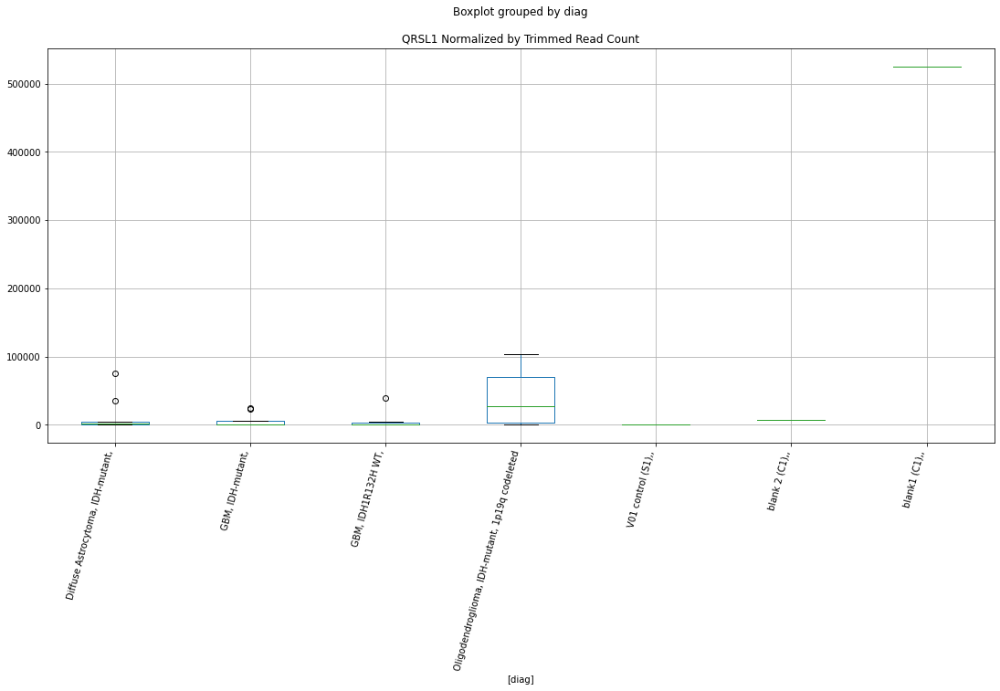

 p : 0.02278051094368953  ( t : 2.4899107441387116 ) :  Lexogen  :  bbduk2  :  PTPN14
Control and blanks
79     1430.6
343       0.0
Name: PTPN14, dtype: float64
211    0.0
Name: PTPN14, dtype: float64
475    0.0
Name: PTPN14, dtype: float64


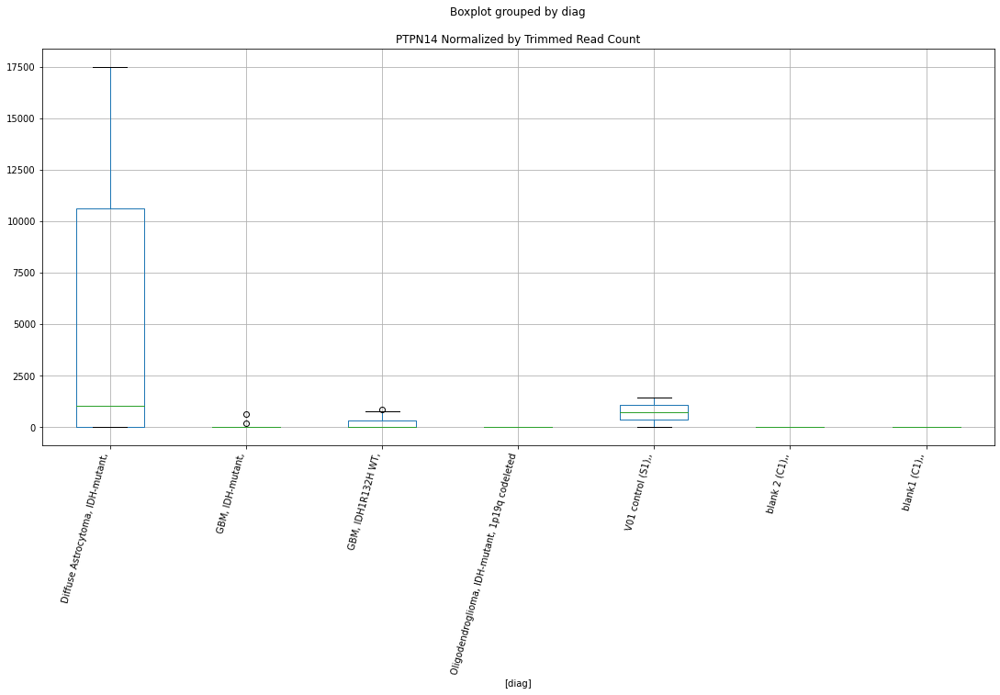

 p : 0.022928306949450476  ( t : 2.4867952501622654 ) :  D-plex  :  bbduk2  :  SIX2
Control and blanks
73     0.0
337    0.0
Name: SIX2, dtype: float64
205    179.09
Name: SIX2, dtype: float64
469    0.0
Name: SIX2, dtype: float64


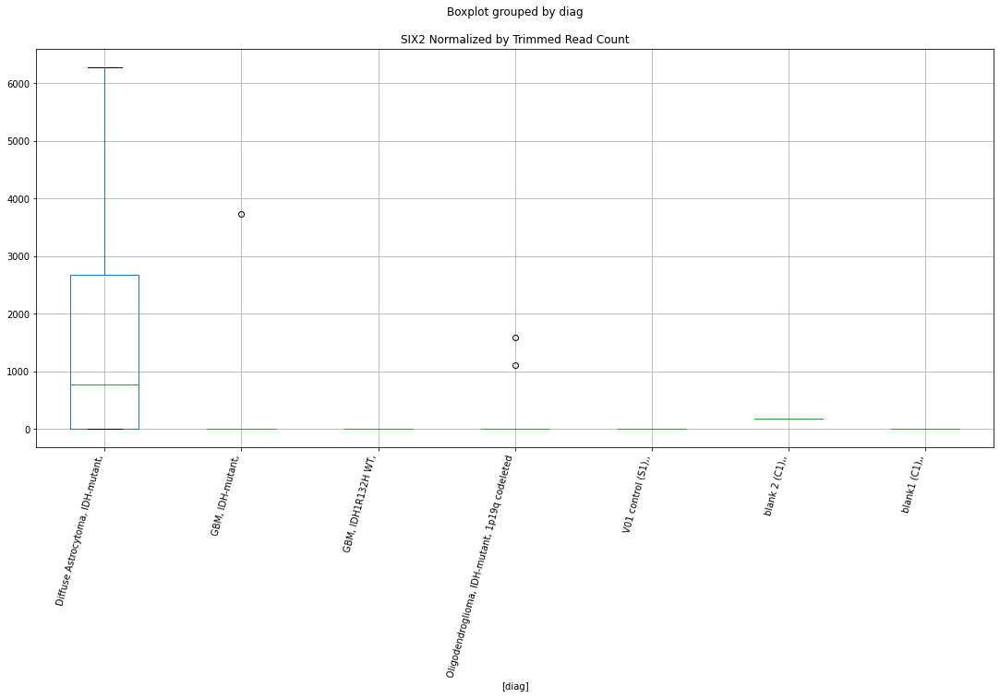

 p : 0.02297869914017359  ( t : 2.4857373193729155 ) :  D-plex  :  bbduk2  :  PTBP3
Control and blanks
73     64932.71
337        0.00
Name: PTBP3, dtype: float64
205    12715.46
Name: PTBP3, dtype: float64
469    20111.93
Name: PTBP3, dtype: float64


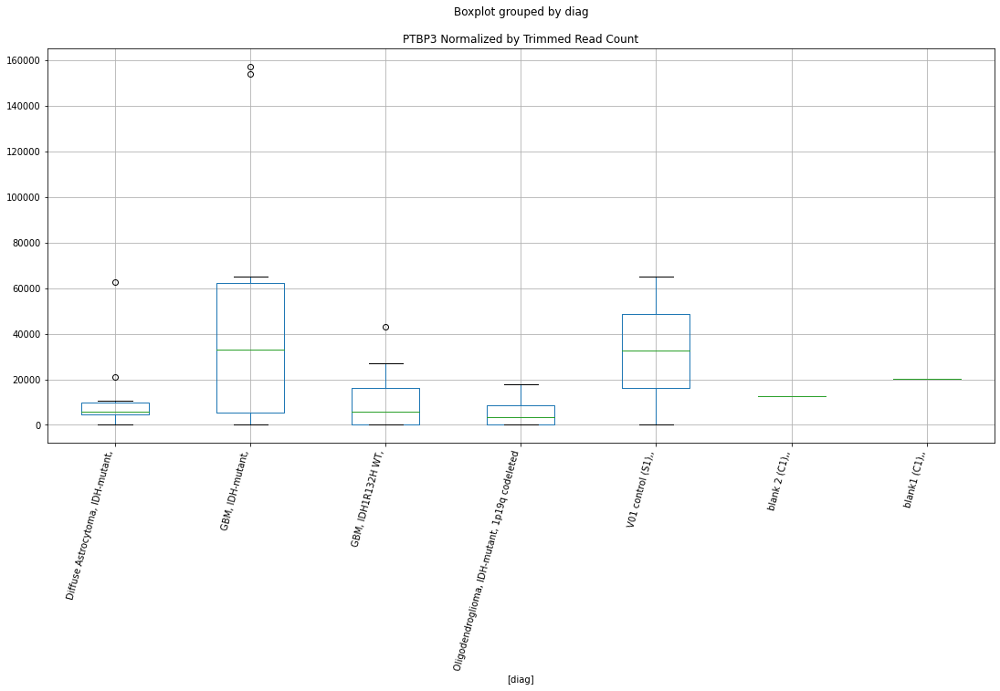

 p : 0.023061161996866194  ( t : 2.484010800728638 ) :  D-plex  :  cutadapt2  :  QRSL1
Control and blanks
76     0.0
340    0.0
Name: QRSL1, dtype: float64
208    7759.85
Name: QRSL1, dtype: float64
472    519004.34
Name: QRSL1, dtype: float64


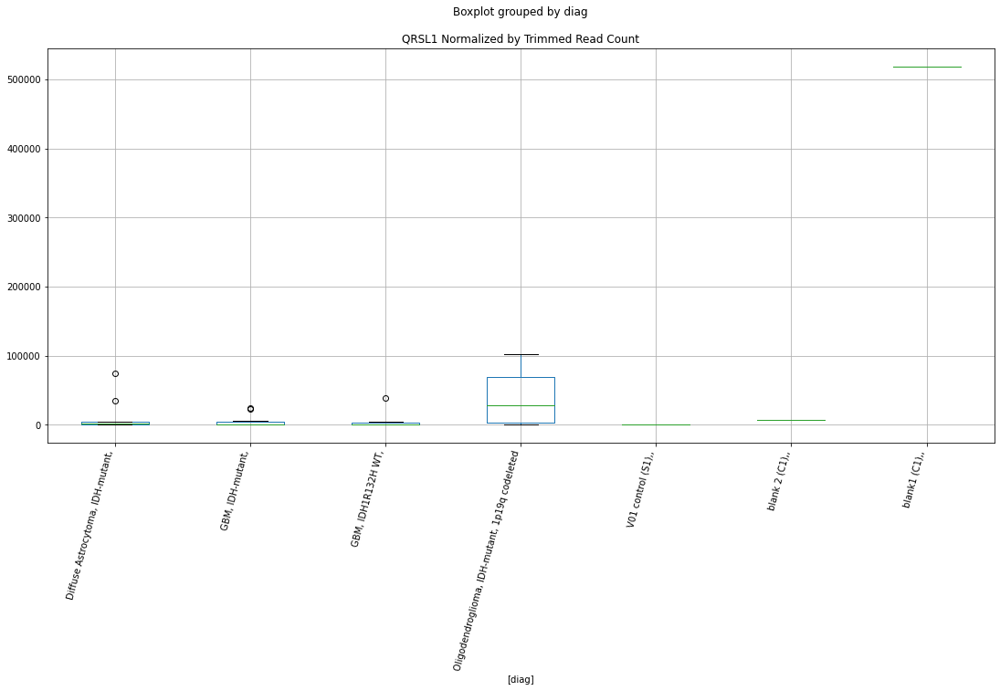

 p : 0.02314680409944976  ( t : 2.4822238587291525 ) :  D-plex  :  bbduk2  :  PTN
Control and blanks
73     0.0
337    0.0
Name: PTN, dtype: float64
205    0.0
Name: PTN, dtype: float64
469    0.0
Name: PTN, dtype: float64


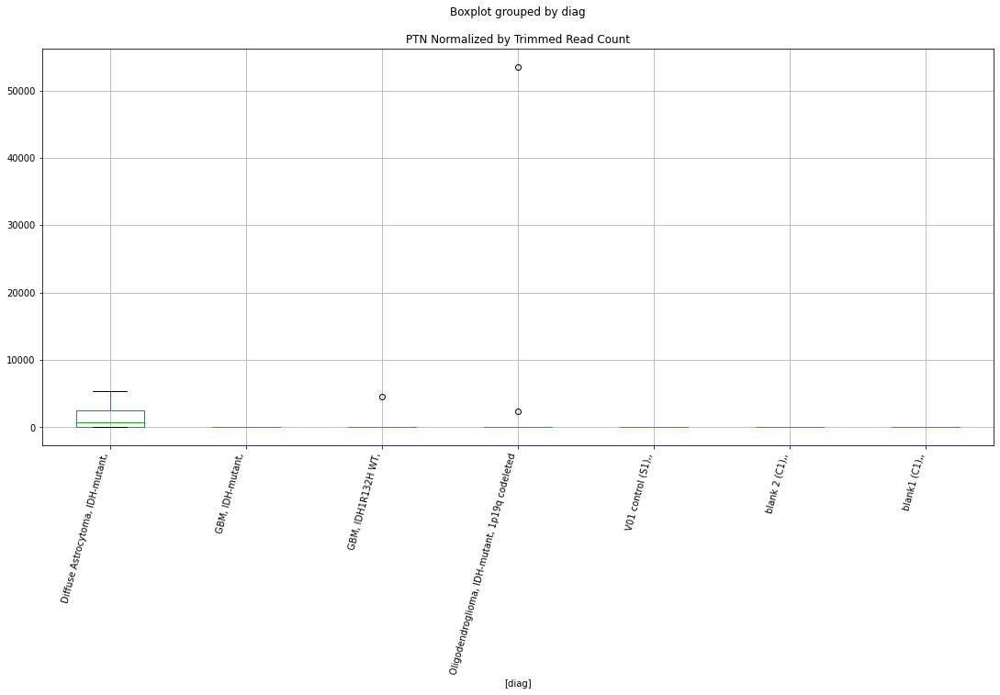

 p : 0.02316790824096691  ( t : 2.481784471642365 ) :  Lexogen  :  bbduk2  :  SLAIN2
Control and blanks
79       0.00
343    849.26
Name: SLAIN2, dtype: float64
211    4372.9
Name: SLAIN2, dtype: float64
475    0.0
Name: SLAIN2, dtype: float64


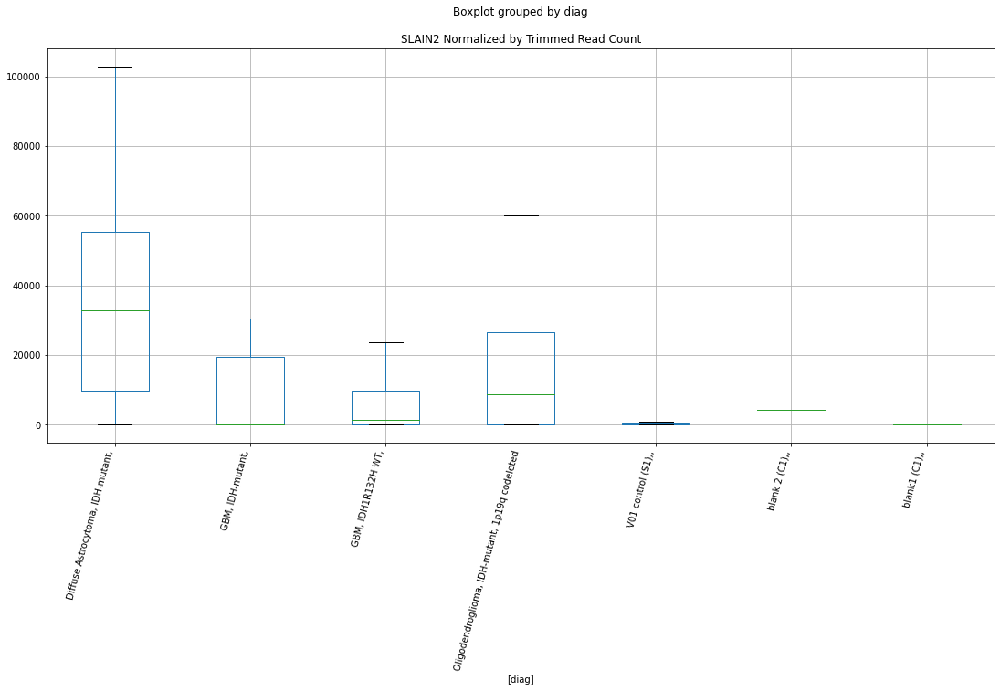

 p : 0.023196095224932947  ( t : 2.4811982072703027 ) :  D-plex  :  cutadapt2  :  SIX1
Control and blanks
76     1515.23
340       0.00
Name: SIX1, dtype: float64
208    1234.52
Name: SIX1, dtype: float64
472    1155.91
Name: SIX1, dtype: float64


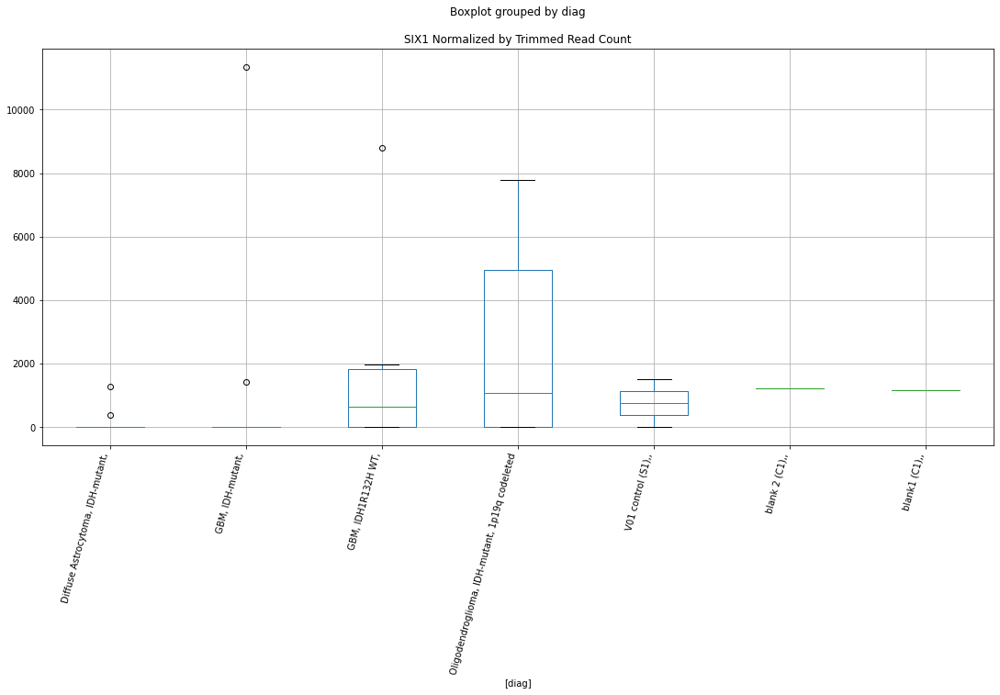

 p : 0.023275503682236808  ( t : 2.479550178792133 ) :  D-plex  :  cutadapt2  :  POLR3C
Control and blanks
76     0.0
340    0.0
Name: POLR3C, dtype: float64
208    9523.45
Name: POLR3C, dtype: float64
472    1.00e+06
Name: POLR3C, dtype: float64


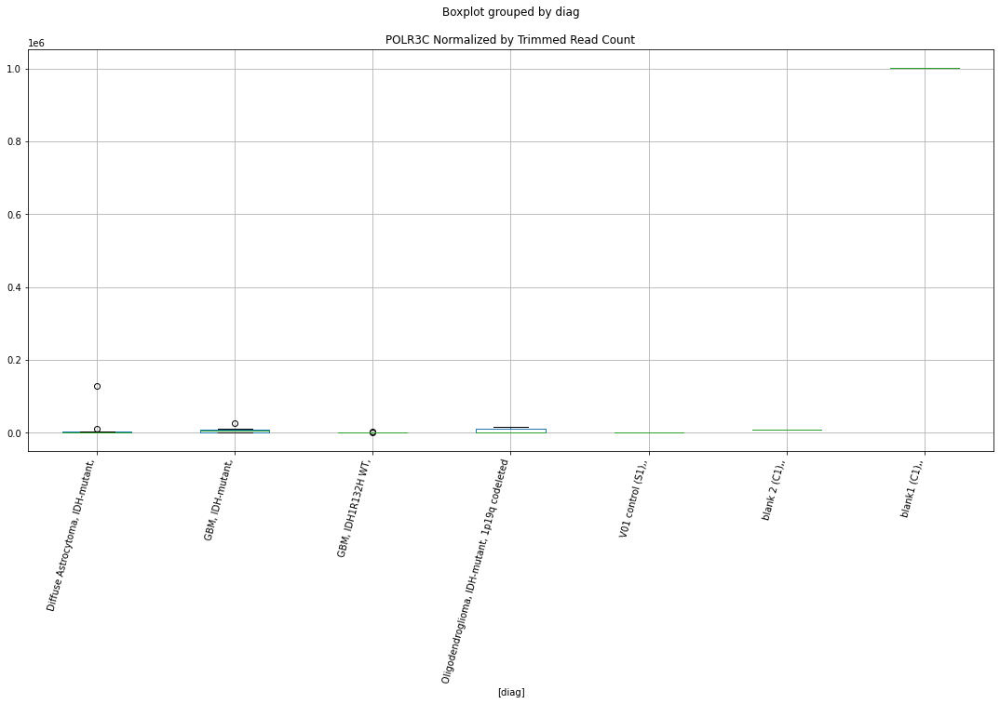

 p : 0.023310338871107776  ( t : 2.4788288845363 ) :  D-plex  :  cutadapt2  :  PNPLA7
Control and blanks
76      8333.76
340    19376.11
Name: PNPLA7, dtype: float64
208    65076.92
Name: PNPLA7, dtype: float64
472    17916.63
Name: PNPLA7, dtype: float64


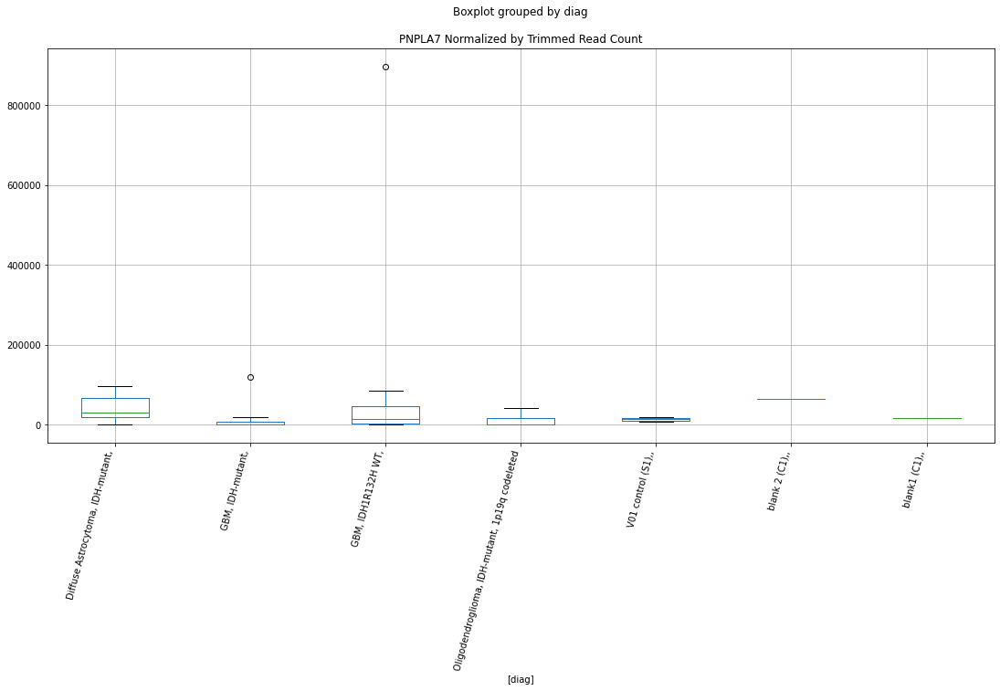

 p : 0.023325015366289253  ( t : 2.47852529796328 ) :  Lexogen  :  bbduk2  :  POLR3E
Control and blanks
79     0.0
343    0.0
Name: POLR3E, dtype: float64
211    6286.05
Name: POLR3E, dtype: float64
475    0.0
Name: POLR3E, dtype: float64


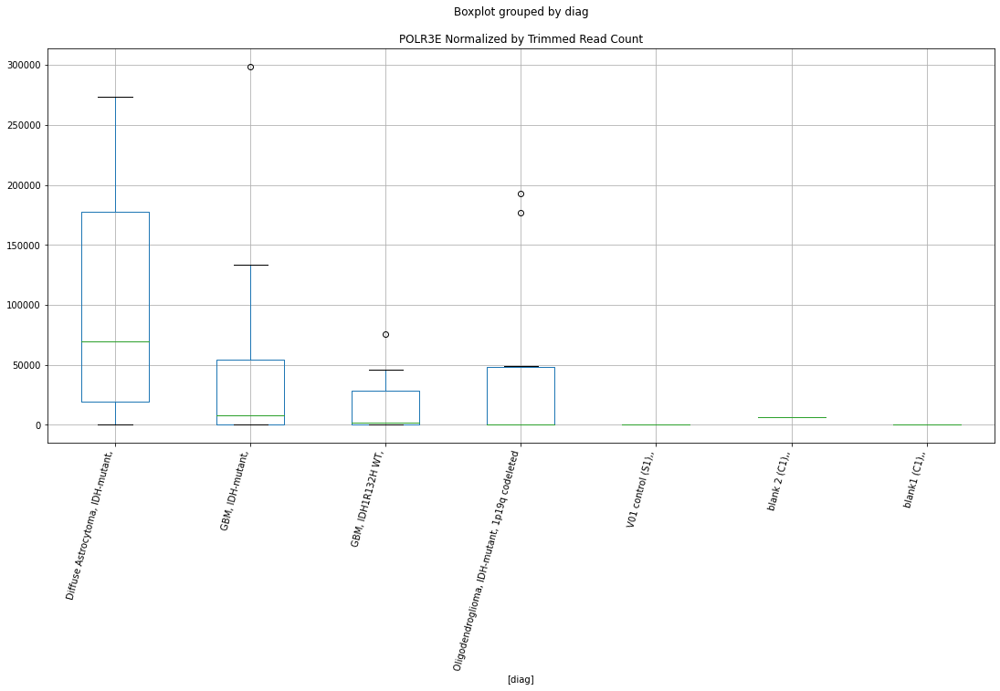

 p : 0.02348236044777995  ( t : 2.475281822786542 ) :  D-plex  :  bbduk2  :  SIPA1L3
Control and blanks
73     17006.18
337     4450.79
Name: SIPA1L3, dtype: float64
205    12894.55
Name: SIPA1L3, dtype: float64
469    21294.98
Name: SIPA1L3, dtype: float64


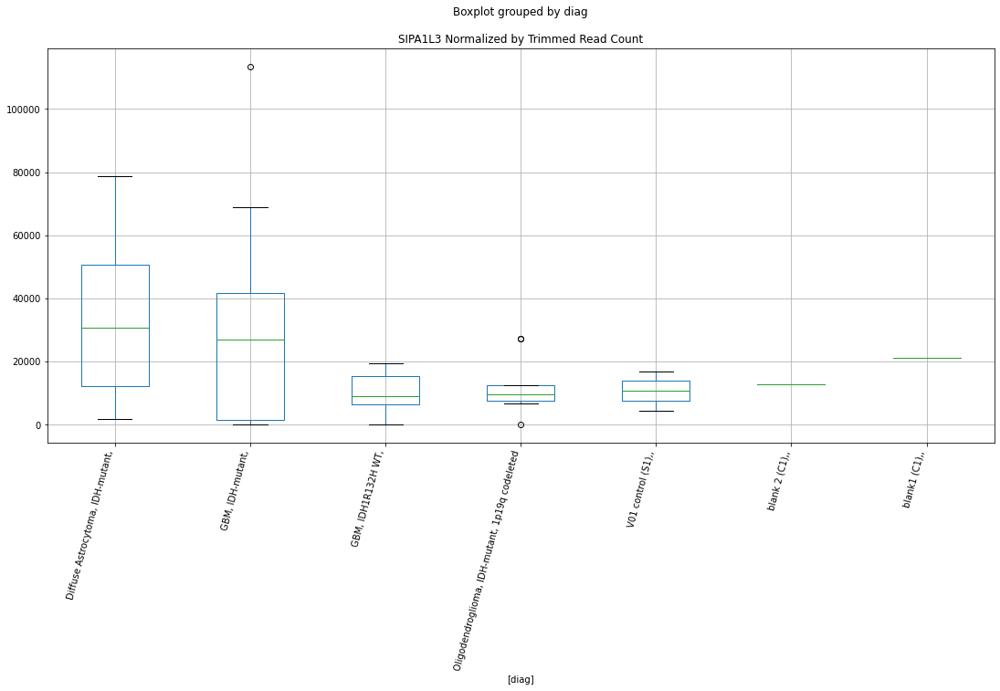

 p : 0.023508382007982064  ( t : 2.474747391296371 ) :  D-plex  :  bbduk2  :  QRSL1
Control and blanks
73     0.0
337    0.0
Name: QRSL1, dtype: float64
205    7880.0
Name: QRSL1, dtype: float64
469    525276.26
Name: QRSL1, dtype: float64


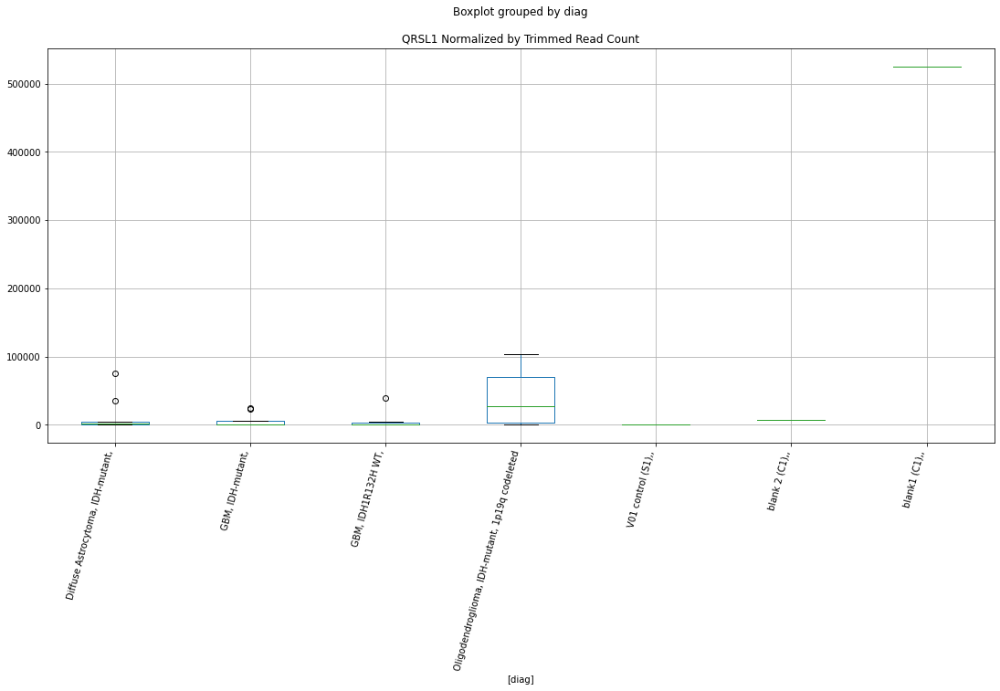

 p : 0.02362629013673493  ( t : 2.4723327419498866 ) :  D-plex  :  cutadapt2  :  SESN1
Control and blanks
76     1515.23
340       0.00
Name: SESN1, dtype: float64
208    2469.04
Name: SESN1, dtype: float64
472    2311.82
Name: SESN1, dtype: float64


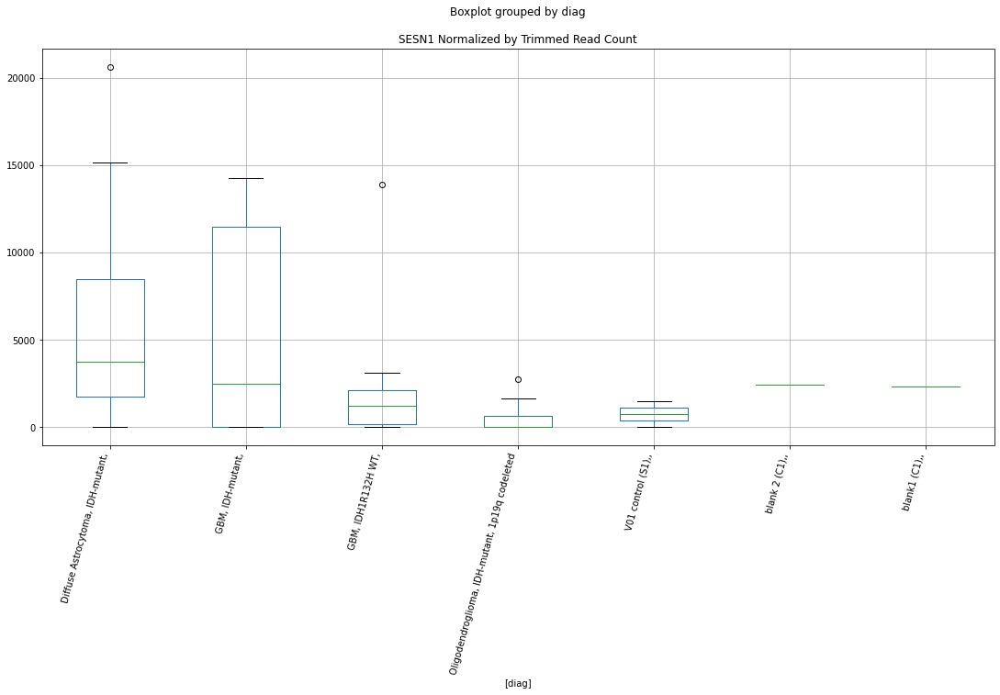

 p : 0.023631903901476143  ( t : 2.4722180600762207 ) :  D-plex  :  bbduk2  :  PHF8
Control and blanks
73     60294.66
337     9791.73
Name: PHF8, dtype: float64
205    23281.82
Name: PHF8, dtype: float64
469    35491.64
Name: PHF8, dtype: float64


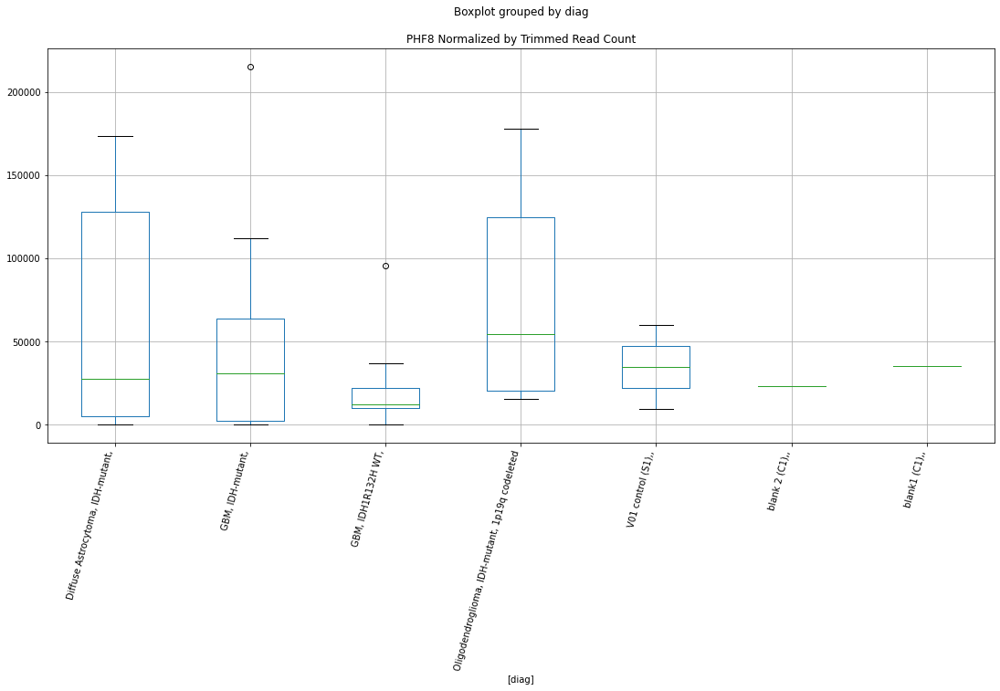

 p : 0.023673172585498198  ( t : 2.471375780351222 ) :  D-plex  :  bbduk2  :  SESN1
Control and blanks
73     1546.02
337       0.00
Name: SESN1, dtype: float64
205    2507.27
Name: SESN1, dtype: float64
469    2366.11
Name: SESN1, dtype: float64


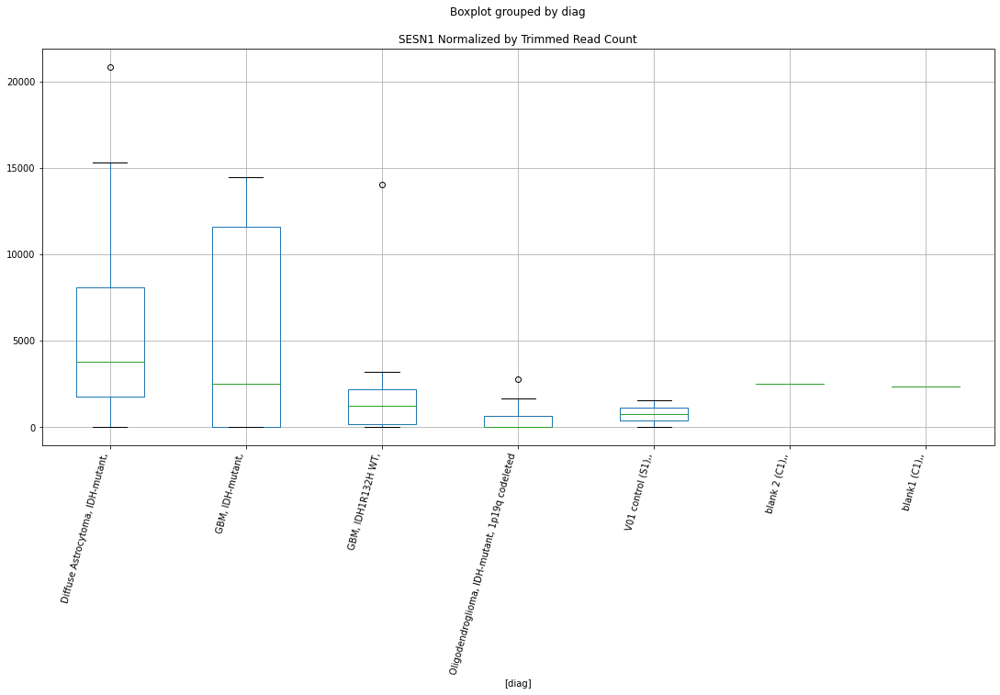

 p : 0.023710391720134685  ( t : 2.470617333813743 ) :  D-plex  :  cutadapt2  :  SLC5A1
Control and blanks
76     0.0
340    0.0
Name: SLC5A1, dtype: float64
208    1058.16
Name: SLC5A1, dtype: float64
472    1733.87
Name: SLC5A1, dtype: float64


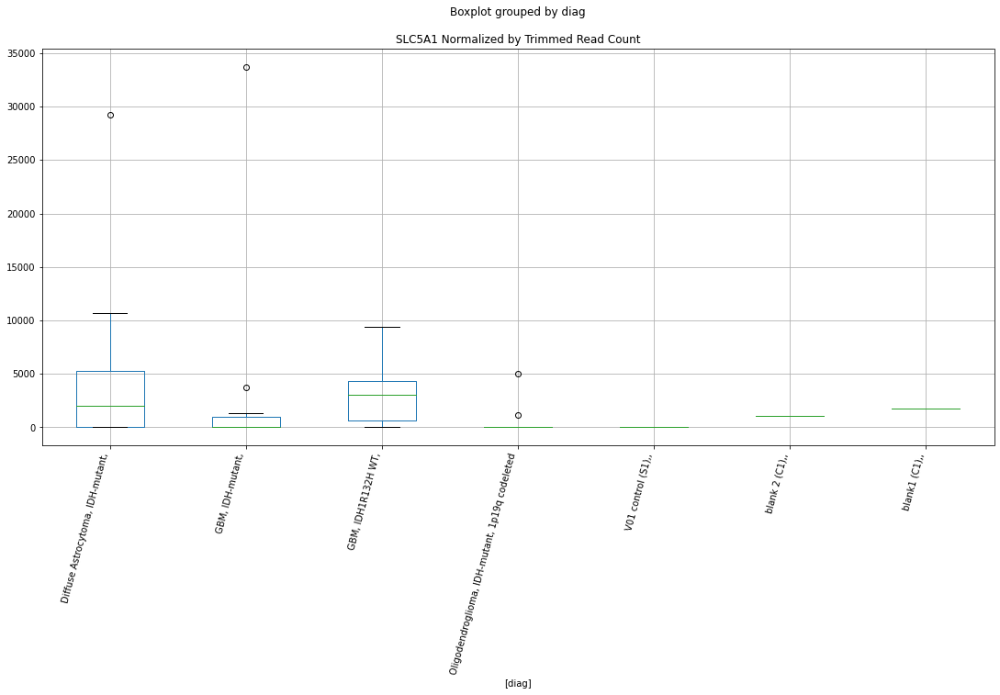

 p : 0.023881776983318587  ( t : 2.4671392492694966 ) :  D-plex  :  bbduk2  :  SLC5A1
Control and blanks
73     0.0
337    0.0
Name: SLC5A1, dtype: float64
205    1074.55
Name: SLC5A1, dtype: float64
469    1774.58
Name: SLC5A1, dtype: float64


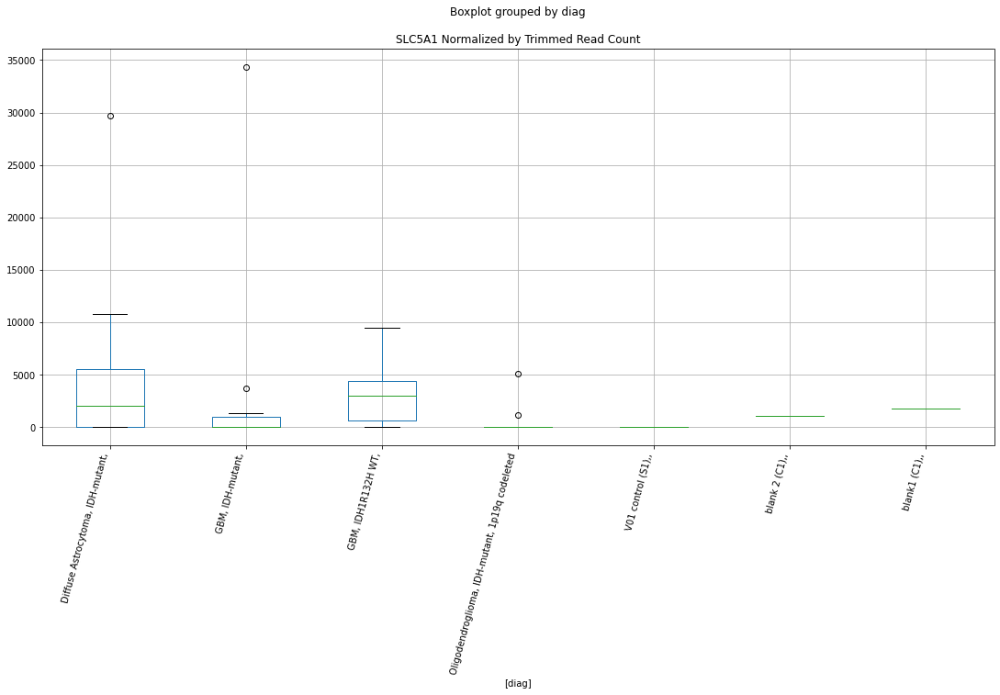

 p : 0.023945956943124836  ( t : 2.4658428199592803 ) :  D-plex  :  bbduk2  :  POLR3C
Control and blanks
73     0.0
337    0.0
Name: POLR3C, dtype: float64
205    9670.91
Name: POLR3C, dtype: float64
469    1.03e+06
Name: POLR3C, dtype: float64


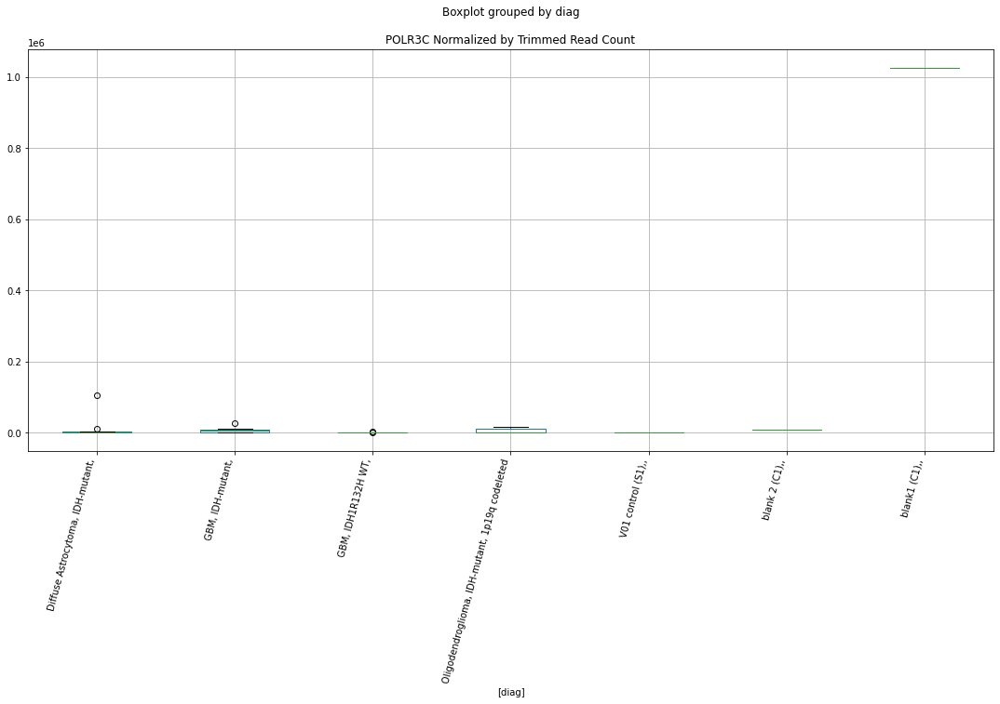

 p : 0.024023443249501574  ( t : 2.4642819484032046 ) :  Lexogen  :  bbduk2  :  PLEC
Control and blanks
79     0.0
343    0.0
Name: PLEC, dtype: float64
211    0.0
Name: PLEC, dtype: float64
475    958.06
Name: PLEC, dtype: float64


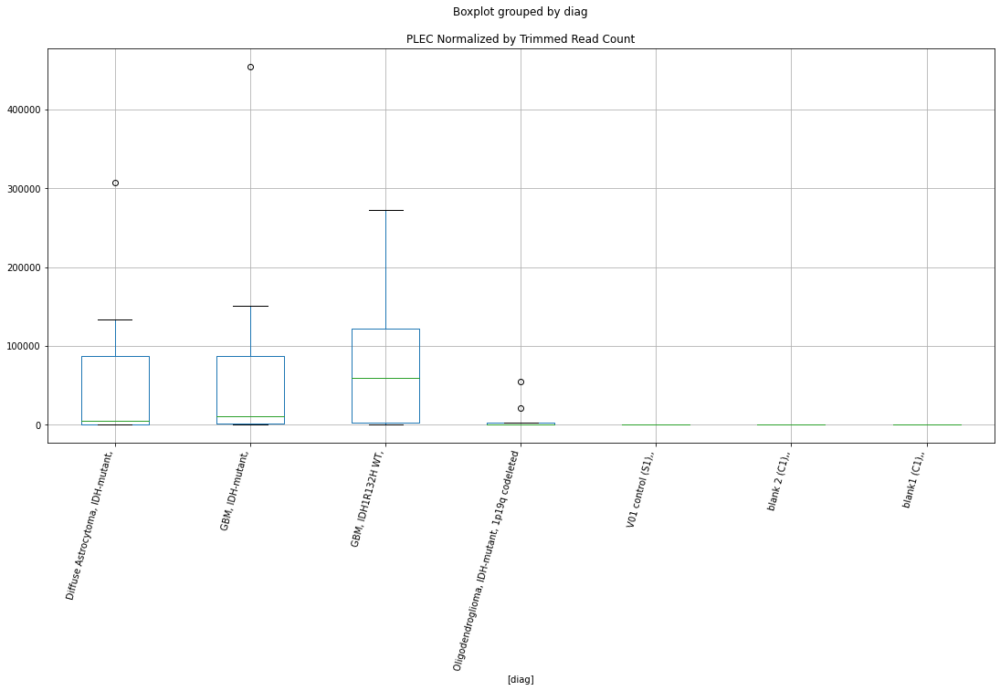

 p : 0.024030631396097714  ( t : 2.4641373914653824 ) :  D-plex  :  bbduk2  :  PRR16
Control and blanks
73     0.0
337    0.0
Name: PRR16, dtype: float64
205    1074.55
Name: PRR16, dtype: float64
469    5915.27
Name: PRR16, dtype: float64


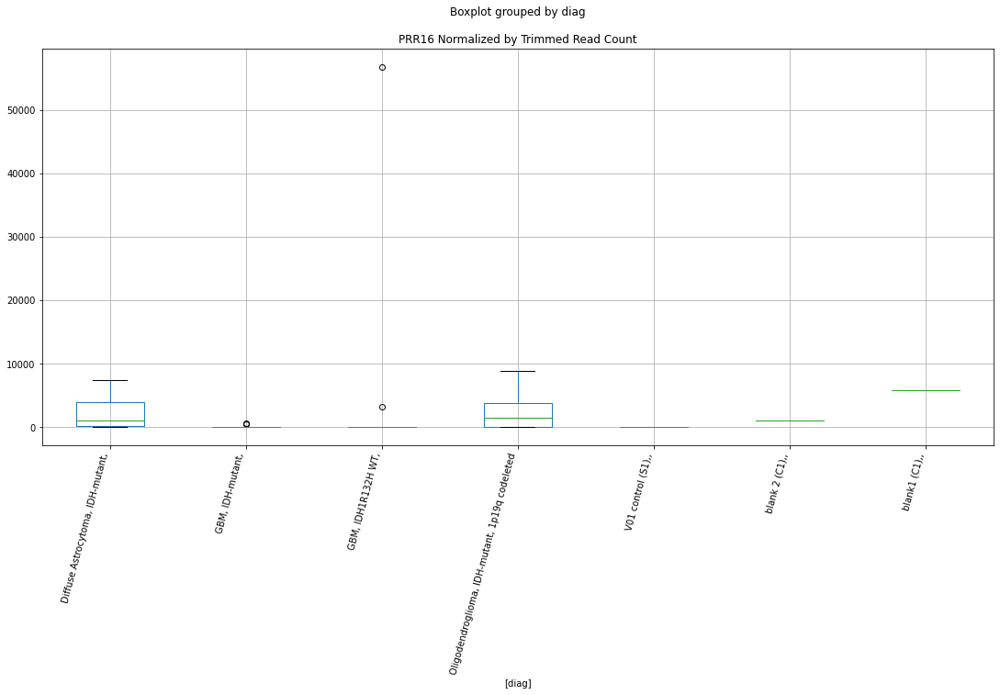

 p : 0.024037385982199188  ( t : 2.4640015906584734 ) :  D-plex  :  cutadapt2  :  SDK1
Control and blanks
76     74246.19
340        0.00
Name: SDK1, dtype: float64
208    7407.13
Name: SDK1, dtype: float64
472    16760.72
Name: SDK1, dtype: float64


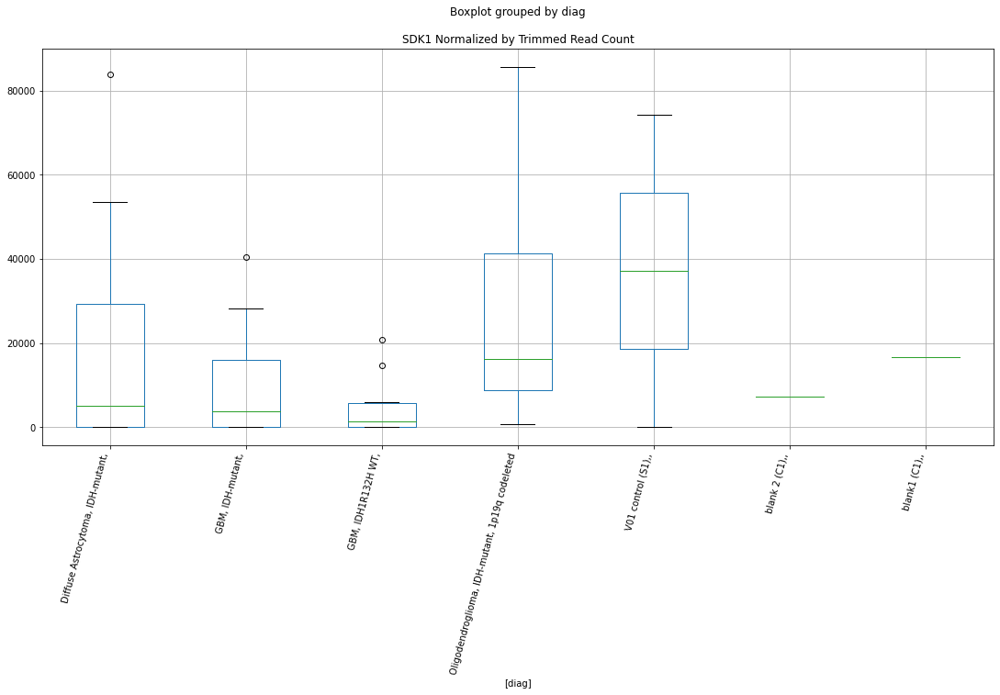

 p : 0.02426458261477853  ( t : 2.4594545693741536 ) :  D-plex  :  bbduk2  :  SNAP25
Control and blanks
73     10822.12
337        0.00
Name: SNAP25, dtype: float64
205    10029.09
Name: SNAP25, dtype: float64
469    16562.76
Name: SNAP25, dtype: float64


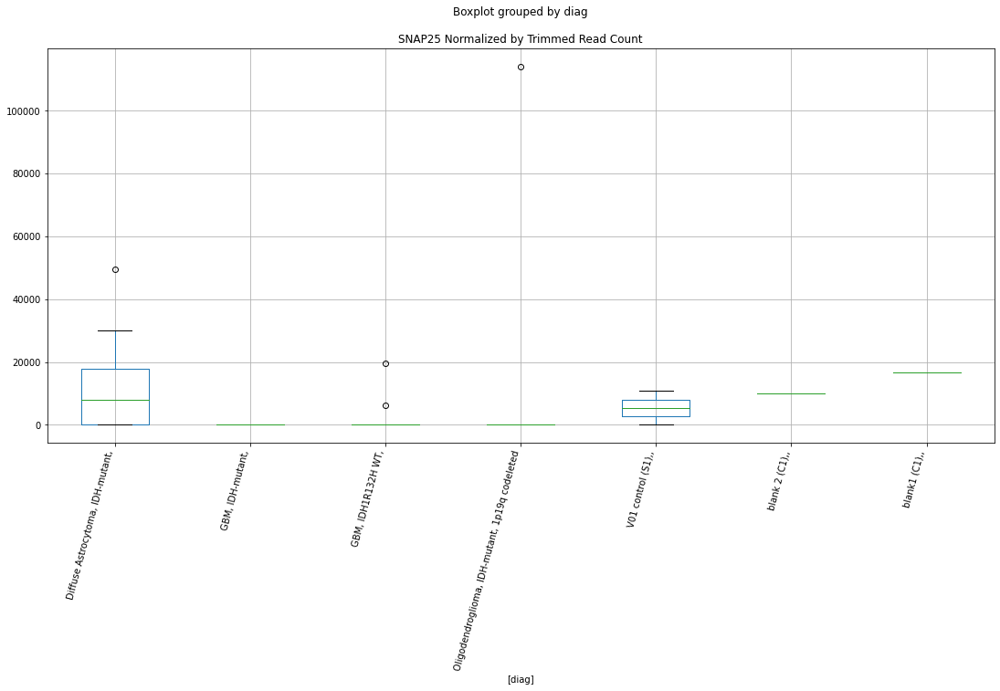

 p : 0.02440170897711208  ( t : 2.4567294960524677 ) :  D-plex  :  bbduk2  :  PRELID3A
Control and blanks
73     0.0
337    0.0
Name: PRELID3A, dtype: float64
205    895.45
Name: PRELID3A, dtype: float64
469    0.0
Name: PRELID3A, dtype: float64


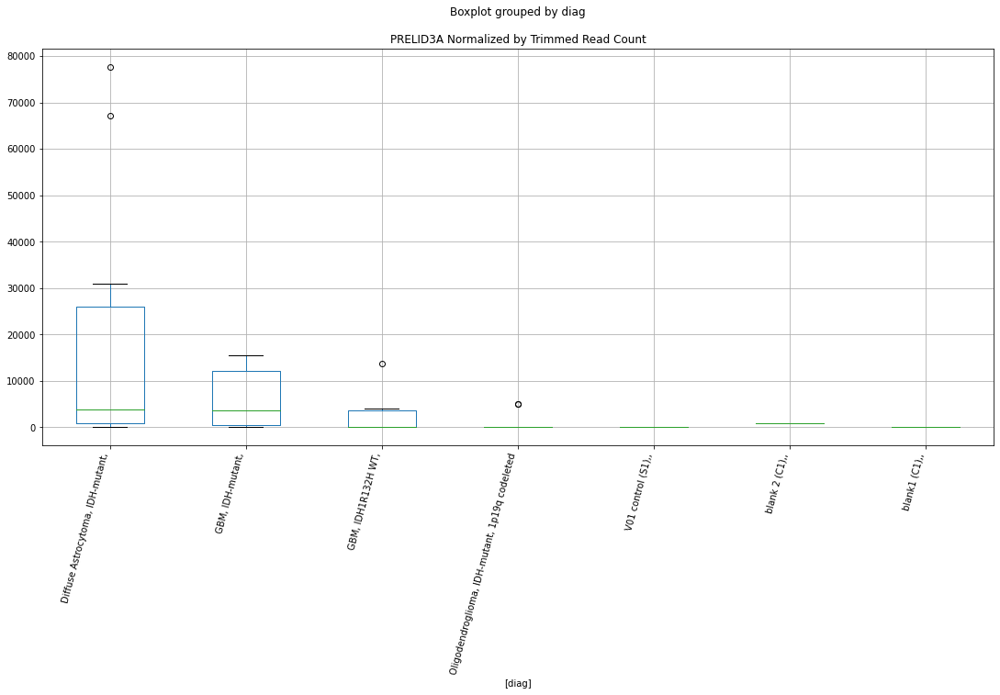

 p : 0.02443536950658877  ( t : 2.4560627689510786 ) :  D-plex  :  cutadapt2  :  SIPA1L2
Control and blanks
76     5303.30
340    1761.46
Name: SIPA1L2, dtype: float64
208    18870.54
Name: SIPA1L2, dtype: float64
472    9825.25
Name: SIPA1L2, dtype: float64


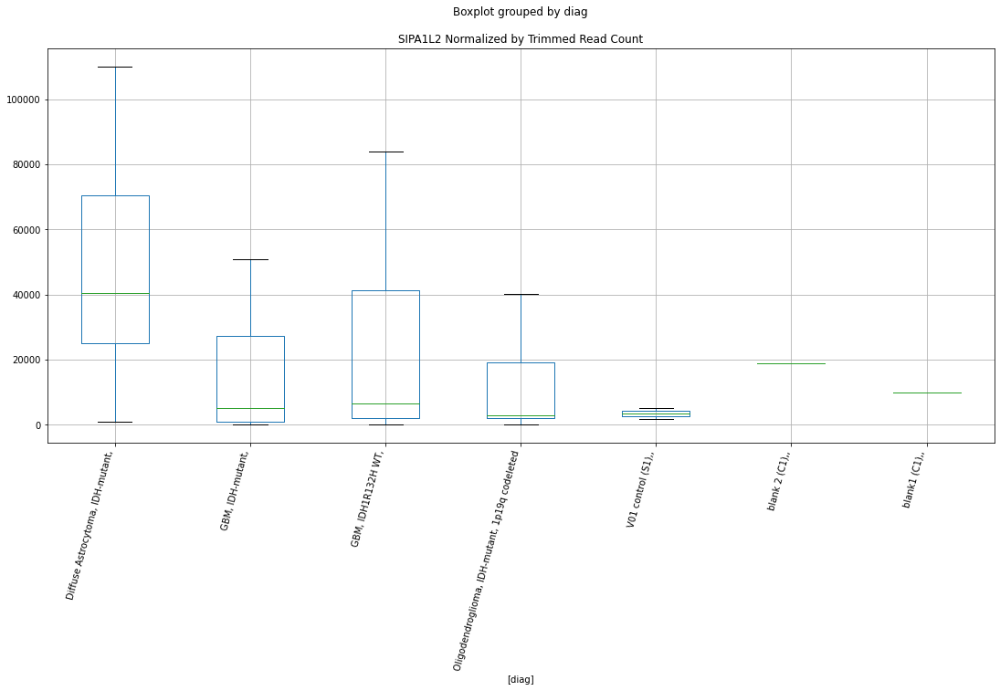

 p : 0.024464234919124313  ( t : 2.4554917072635387 ) :  D-plex  :  cutadapt2  :  SPACA3
Control and blanks
76     0.0
340    0.0
Name: SPACA3, dtype: float64
208    705.44
Name: SPACA3, dtype: float64
472    1155.91
Name: SPACA3, dtype: float64


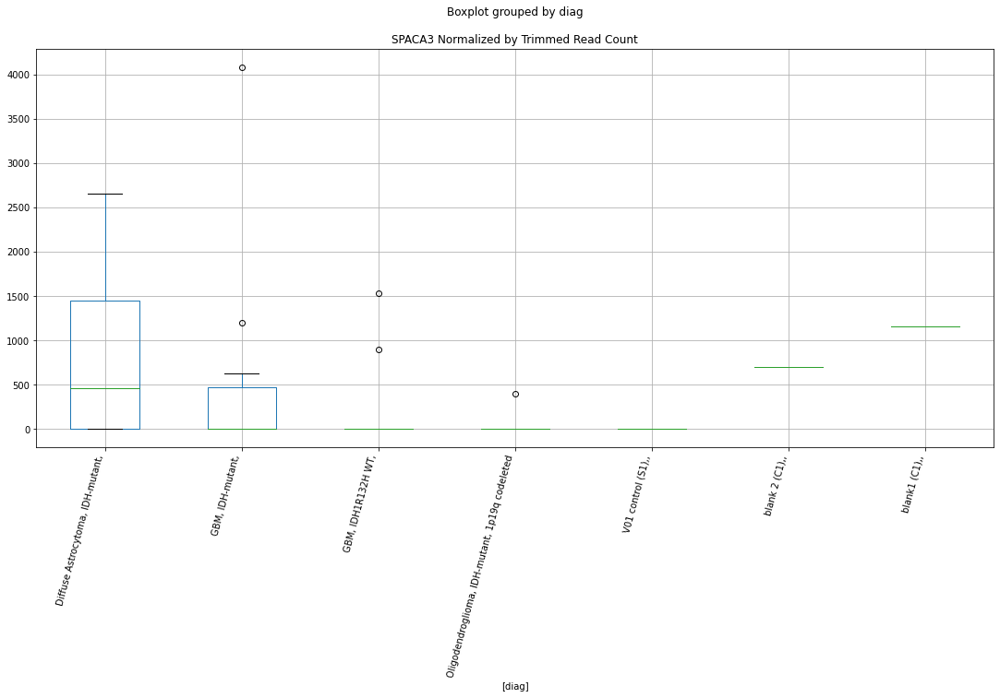

 p : 0.02454163646953729  ( t : 2.4539635438481584 ) :  D-plex  :  bbduk2  :  RTN3
Control and blanks
73     3865.04
337    4450.79
Name: RTN3, dtype: float64
205    7342.73
Name: RTN3, dtype: float64
469    16562.76
Name: RTN3, dtype: float64


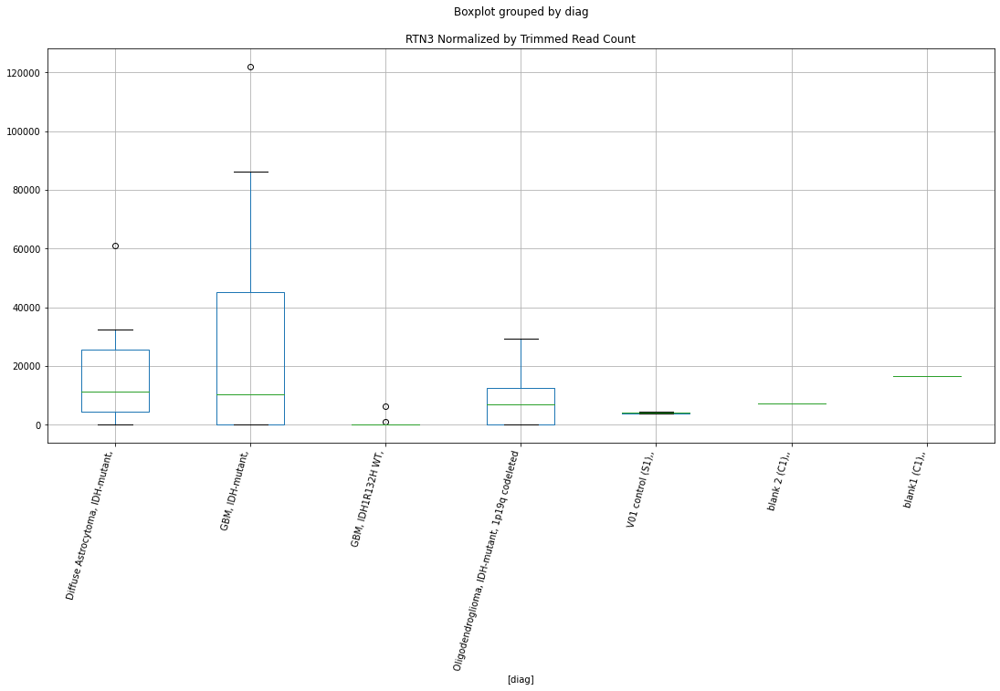

 p : 0.024589691454809395  ( t : 2.45301705467836 ) :  D-plex  :  cutadapt2  :  SNAP25
Control and blanks
76     0.0
340    0.0
Name: SNAP25, dtype: float64
208    9876.17
Name: SNAP25, dtype: float64
472    16182.76
Name: SNAP25, dtype: float64


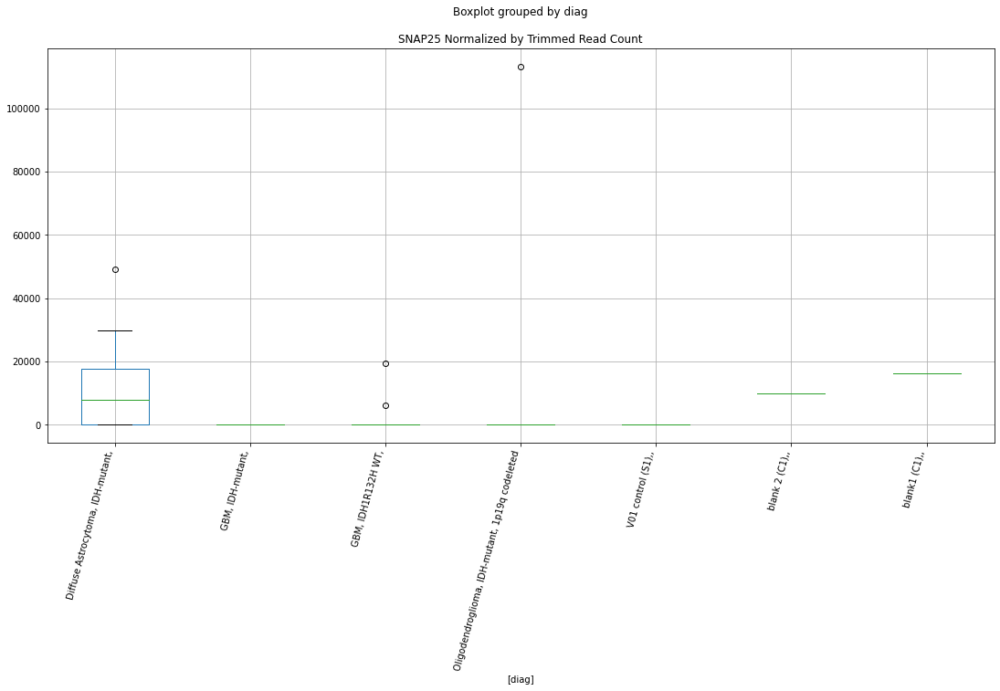

 p : 0.02464039240233676  ( t : 2.4520203318118323 ) :  Lexogen  :  bbduk2  :  SLC6A20
Control and blanks
79     0.0
343    0.0
Name: SLC6A20, dtype: float64
211    0.0
Name: SLC6A20, dtype: float64
475    0.0
Name: SLC6A20, dtype: float64


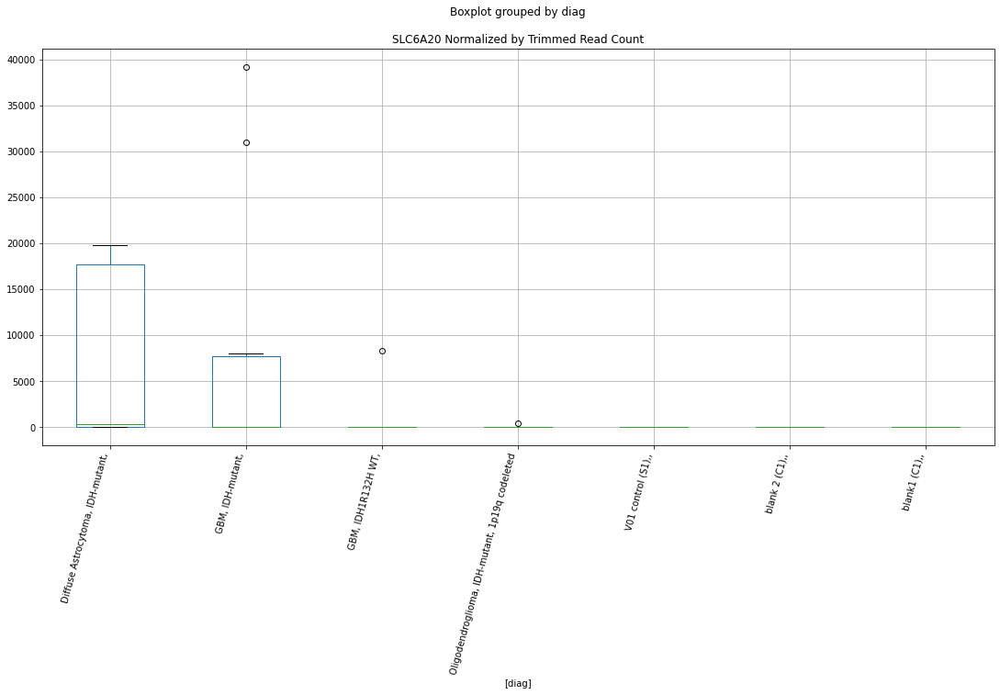

 p : 0.0246611957040879  ( t : 2.4516119196583612 ) :  Lexogen  :  cutadapt2  :  SLC6A20
Control and blanks
82     0.0
346    0.0
Name: SLC6A20, dtype: float64
214    0.0
Name: SLC6A20, dtype: float64
478    0.0
Name: SLC6A20, dtype: float64


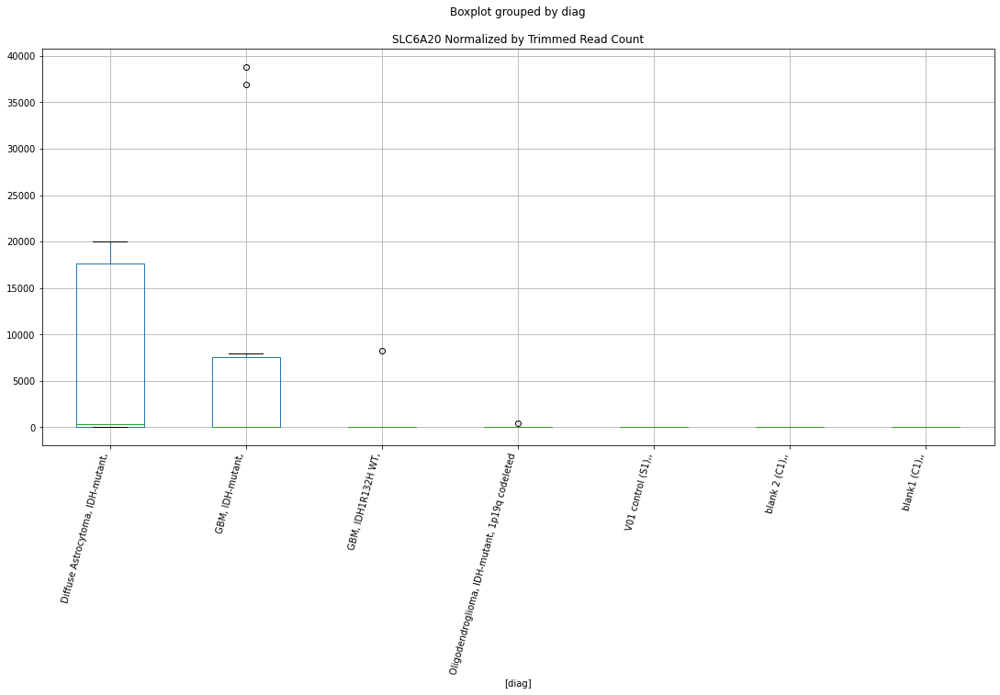

 p : 0.024679571213103508  ( t : 2.4512514390915983 ) :  Lexogen  :  bbduk2  :  PTPN14
Control and blanks
79     1430.6
343       0.0
Name: PTPN14, dtype: float64
211    0.0
Name: PTPN14, dtype: float64
475    0.0
Name: PTPN14, dtype: float64


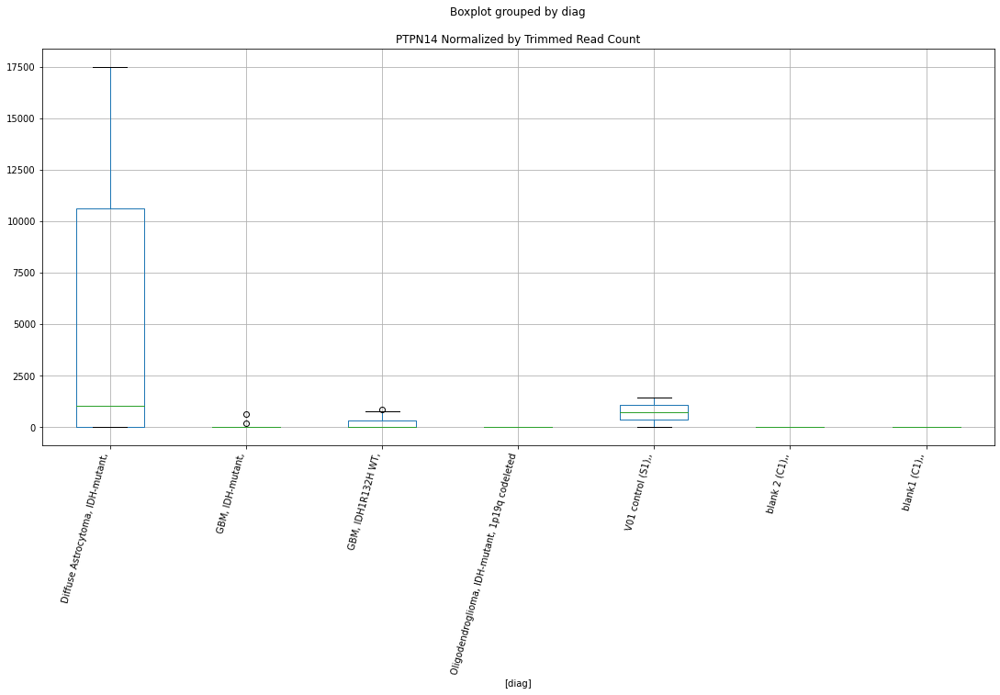

 p : 0.024699013335961455  ( t : 2.4508703085375436 ) :  D-plex  :  cutadapt2  :  RFTN2
Control and blanks
76     0.0
340    0.0
Name: RFTN2, dtype: float64
208    6348.97
Name: RFTN2, dtype: float64
472    6935.47
Name: RFTN2, dtype: float64


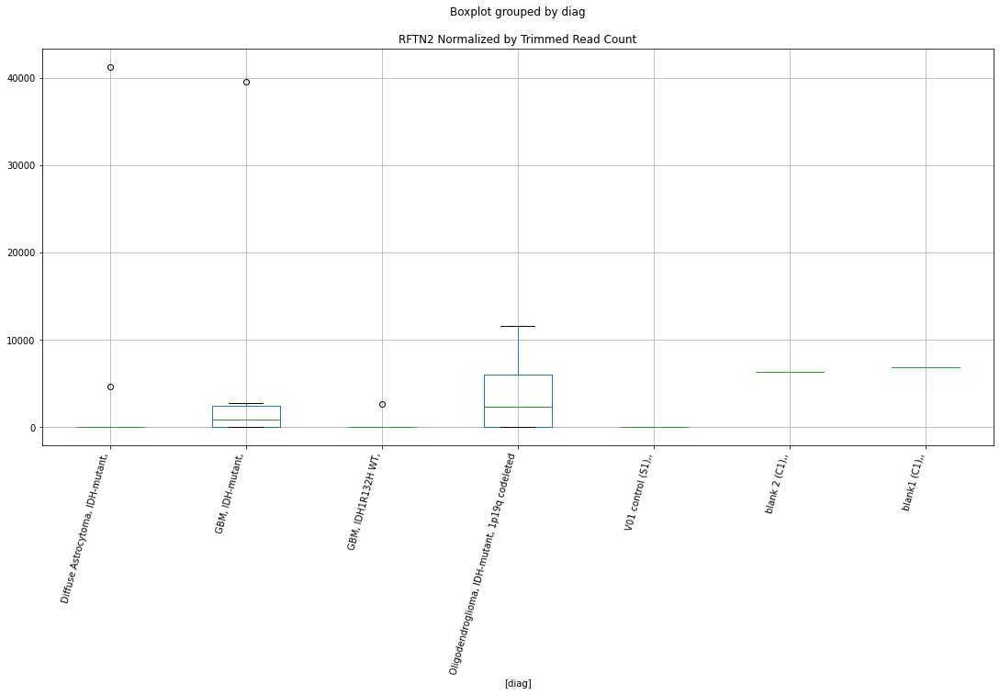

 p : 0.024718428295670163  ( t : 2.4504899914397384 ) :  D-plex  :  bbduk2  :  RASSF3
Control and blanks
73     0.0
337    0.0
Name: RASSF3, dtype: float64
205    895.45
Name: RASSF3, dtype: float64
469    0.0
Name: RASSF3, dtype: float64


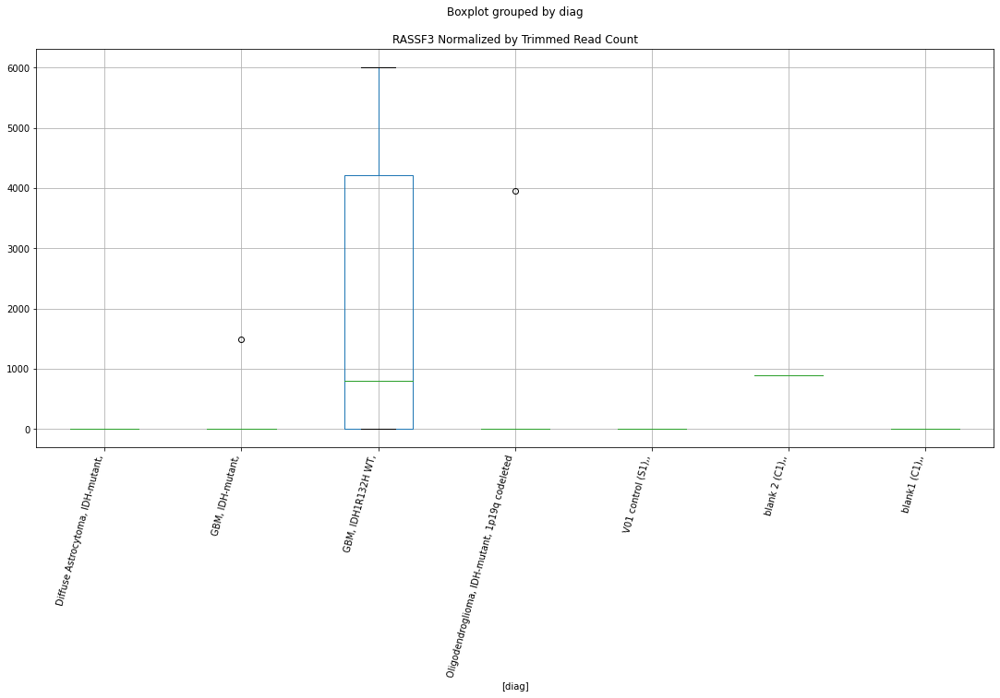

 p : 0.024822866726796643  ( t : 2.448448959834324 ) :  Lexogen  :  cutadapt2  :  SLAIN2
Control and blanks
82       0.00
346    841.74
Name: SLAIN2, dtype: float64
214    4339.62
Name: SLAIN2, dtype: float64
478    0.0
Name: SLAIN2, dtype: float64


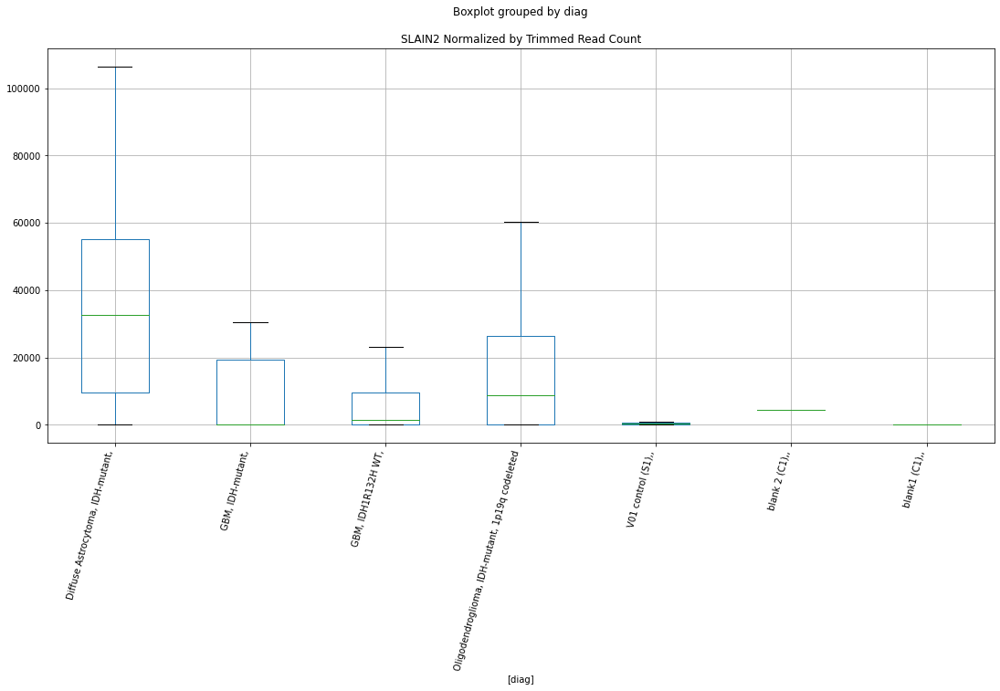

 p : 0.024879305269515314  ( t : 2.447349338669784 ) :  D-plex  :  cutadapt2  :  RASSF3
Control and blanks
76     0.0
340    0.0
Name: RASSF3, dtype: float64
208    881.8
Name: RASSF3, dtype: float64
472    0.0
Name: RASSF3, dtype: float64


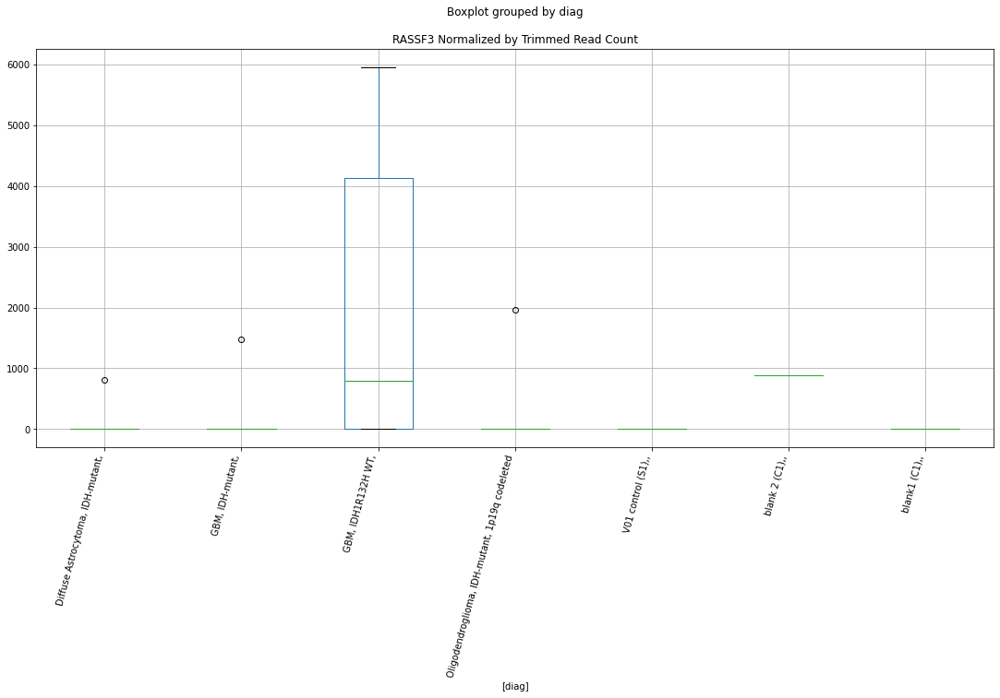

 p : 0.024887538787195174  ( t : 2.44718911654183 ) :  D-plex  :  bbduk2  :  RFTN2
Control and blanks
73     0.0
337    0.0
Name: RFTN2, dtype: float64
205    6447.27
Name: RFTN2, dtype: float64
469    7098.33
Name: RFTN2, dtype: float64


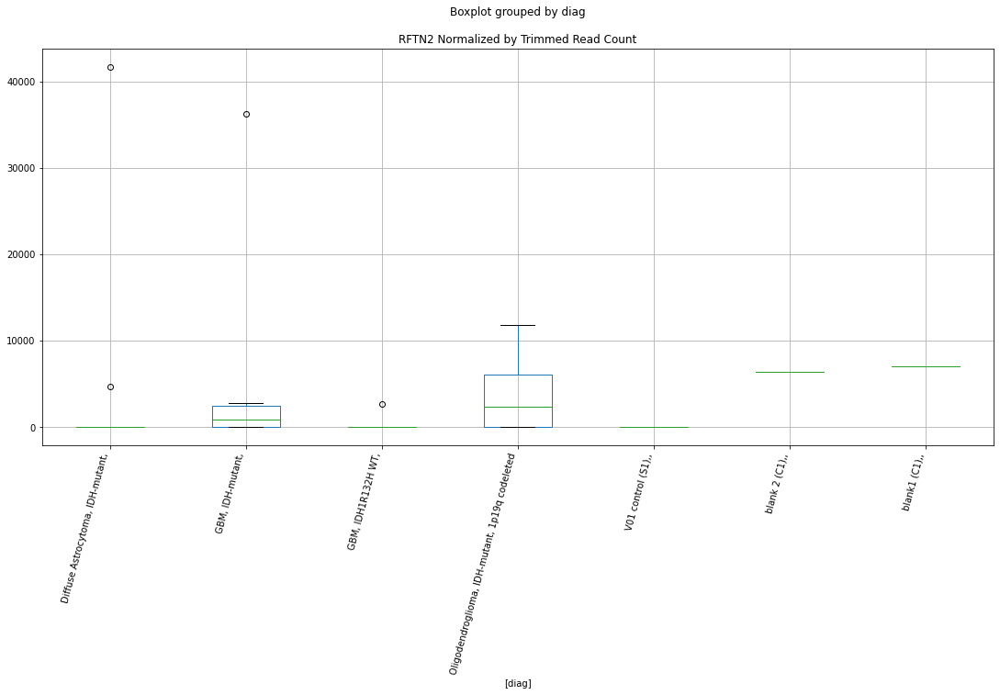

 p : 0.02496760850771241  ( t : 2.4456335695245963 ) :  D-plex  :  cutadapt2  :  SPAG16
Control and blanks
76     757.61
340      0.00
Name: SPAG16, dtype: float64
208    1058.16
Name: SPAG16, dtype: float64
472    2311.82
Name: SPAG16, dtype: float64


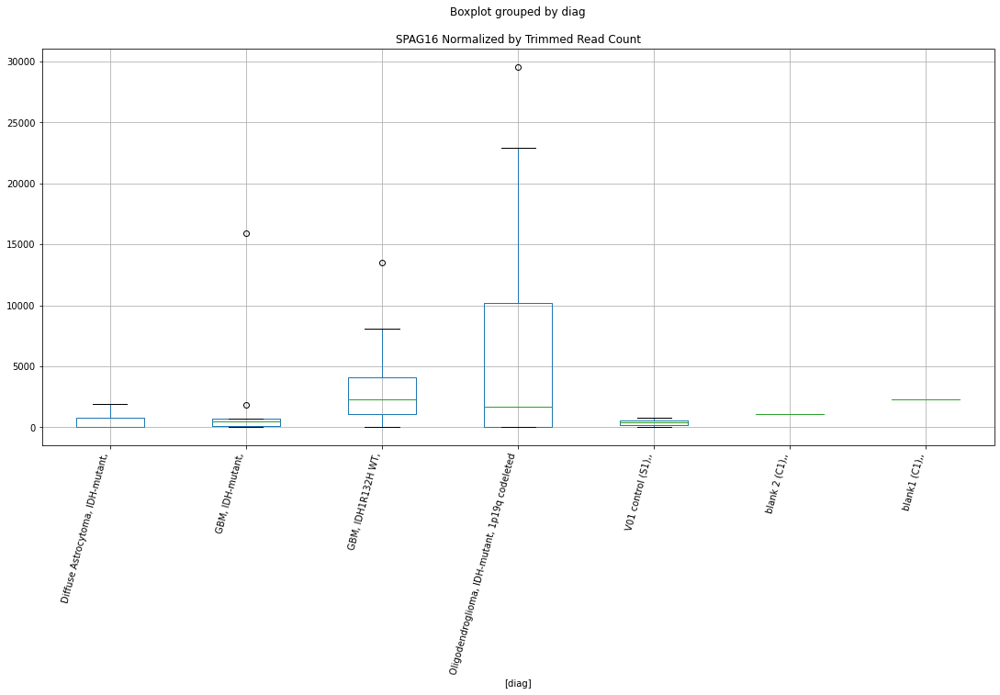

 p : 0.025018312248602743  ( t : 2.4446509464903916 ) :  D-plex  :  bbduk2  :  PAIP2
Control and blanks
73     0.0
337    0.0
Name: PAIP2, dtype: float64
205    537.27
Name: PAIP2, dtype: float64
469    2366.11
Name: PAIP2, dtype: float64


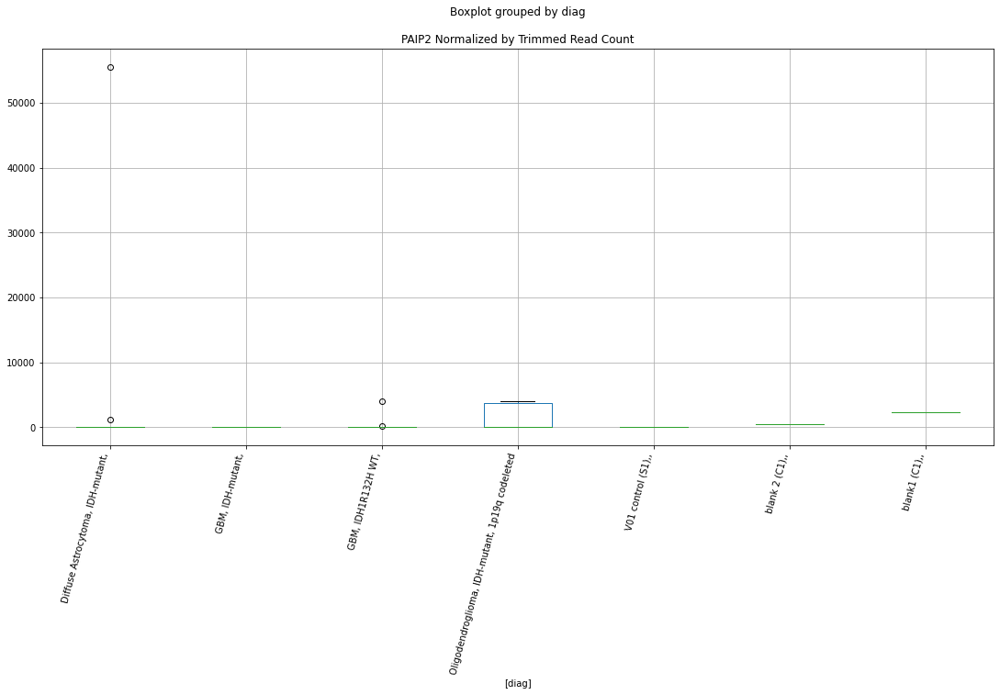

 p : 0.025239407996650372  ( t : 2.440387901094014 ) :  D-plex  :  cutadapt2  :  PALB2
Control and blanks
76     122733.5
340         0.0
Name: PALB2, dtype: float64
208    1058.16
Name: PALB2, dtype: float64
472    11559.12
Name: PALB2, dtype: float64


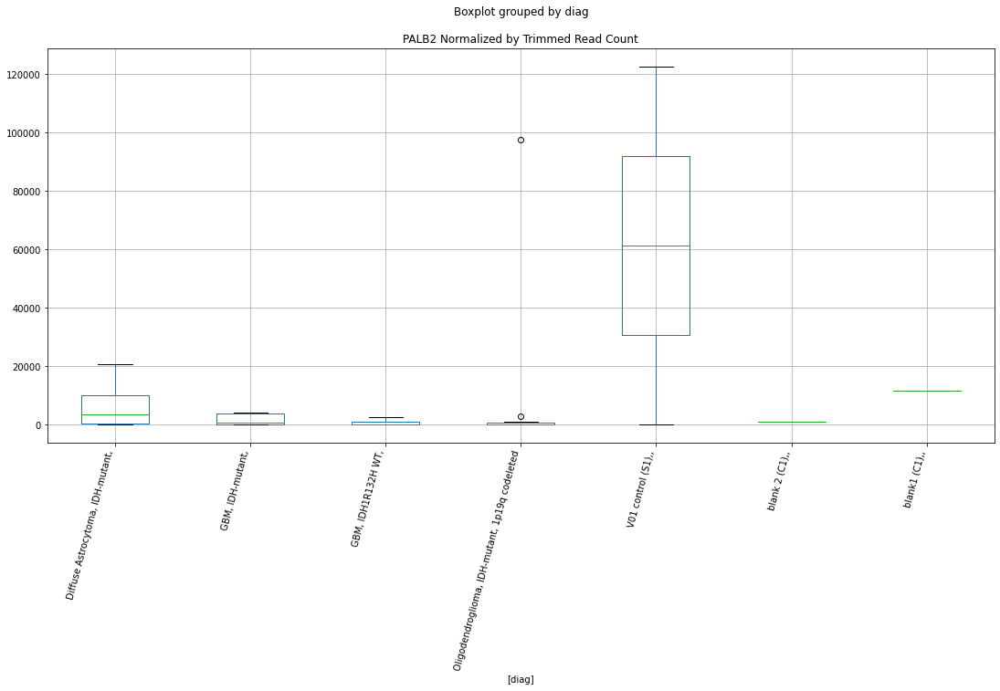

 p : 0.025306740793569215  ( t : 2.439096585618749 ) :  Lexogen  :  bbduk2  :  RBBP8NL
Control and blanks
79     0.0
343    0.0
Name: RBBP8NL, dtype: float64
211    0.0
Name: RBBP8NL, dtype: float64
475    0.0
Name: RBBP8NL, dtype: float64


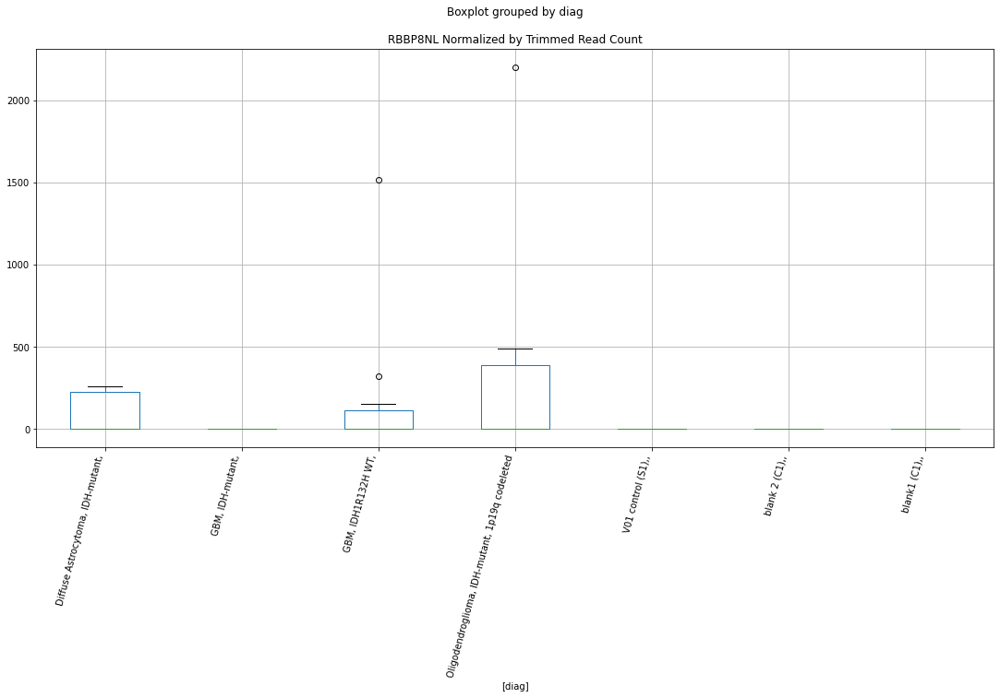

 p : 0.02537875614357786  ( t : 2.4377190293935853 ) :  D-plex  :  bbduk2  :  POR
Control and blanks
73     41742.45
337     5340.94
Name: POR, dtype: float64
205    11103.64
Name: POR, dtype: float64
469    15379.71
Name: POR, dtype: float64


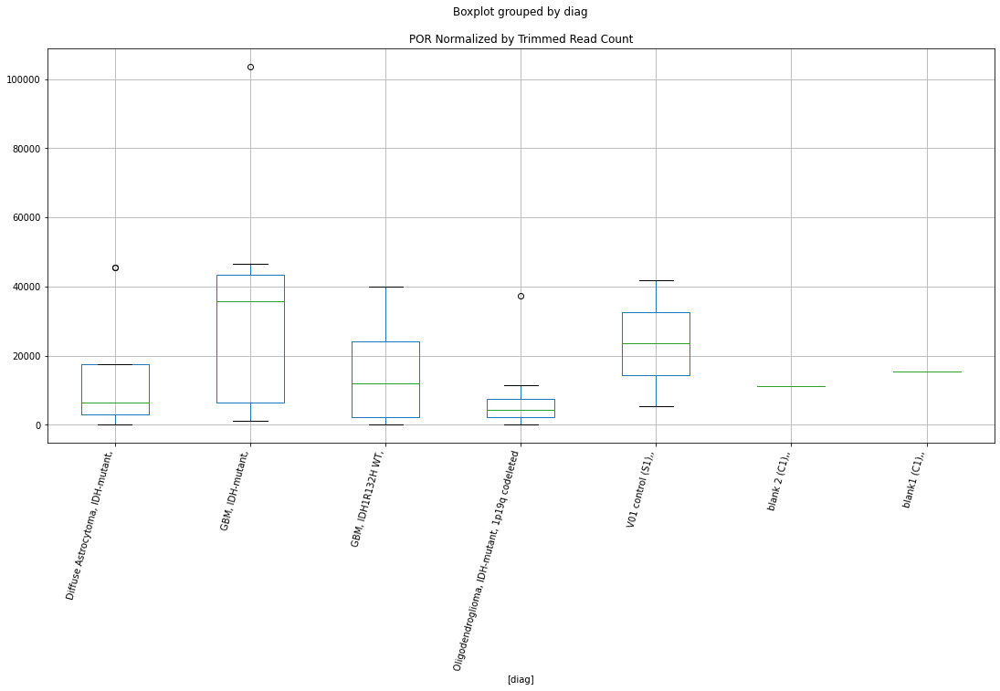

 p : 0.02542001272652104  ( t : 2.4369314976430183 ) :  D-plex  :  cutadapt2  :  PER2
Control and blanks
76     18940.36
340     2642.20
Name: PER2, dtype: float64
208    5996.25
Name: PER2, dtype: float64
472    4045.69
Name: PER2, dtype: float64


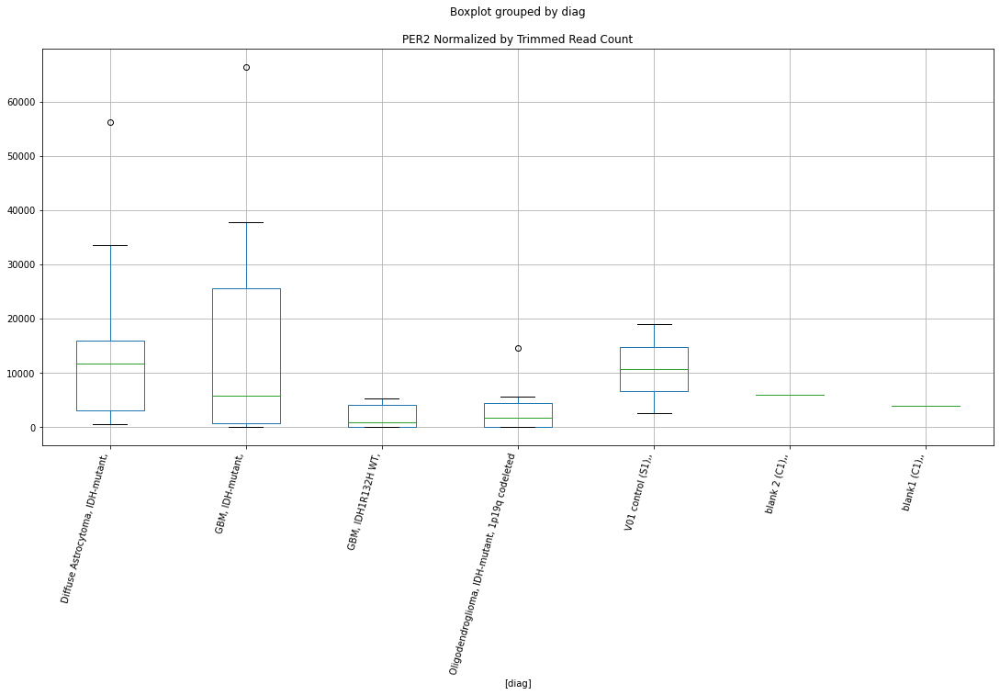

 p : 0.025523002491221657  ( t : 2.4349707825684384 ) :  D-plex  :  bbduk2  :  SNX21
Control and blanks
73     0.0
337    0.0
Name: SNX21, dtype: float64
205    1074.55
Name: SNX21, dtype: float64
469    2957.64
Name: SNX21, dtype: float64


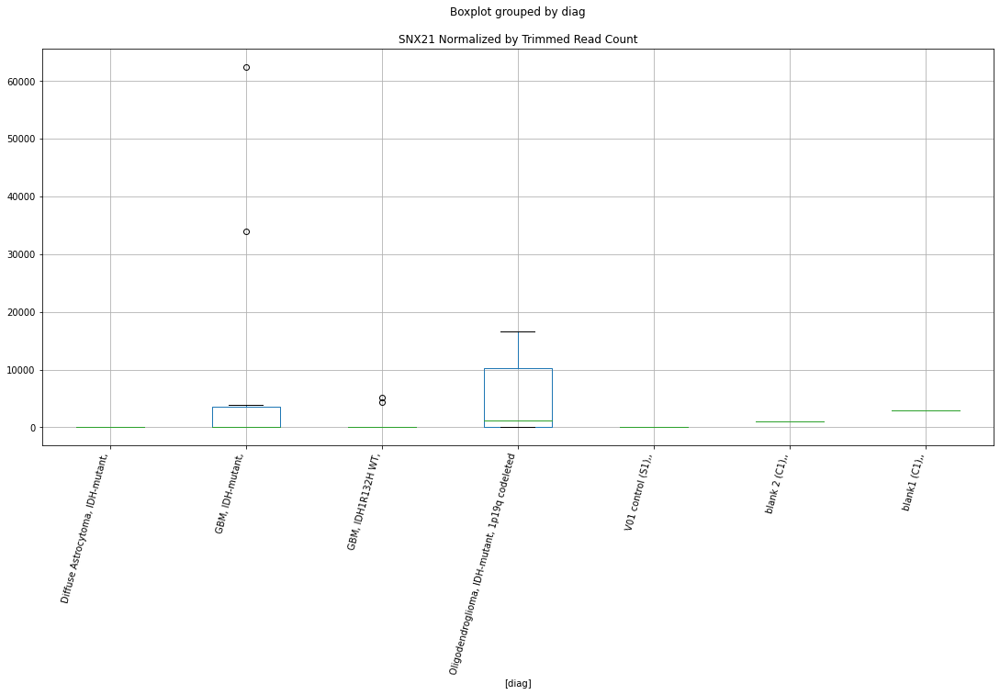

 p : 0.02553083059098  ( t : 2.434822055057544 ) :  D-plex  :  bbduk2  :  PPP2R3A
Control and blanks
73     0.0
337    0.0
Name: PPP2R3A, dtype: float64
205    2328.18
Name: PPP2R3A, dtype: float64
469    10647.49
Name: PPP2R3A, dtype: float64


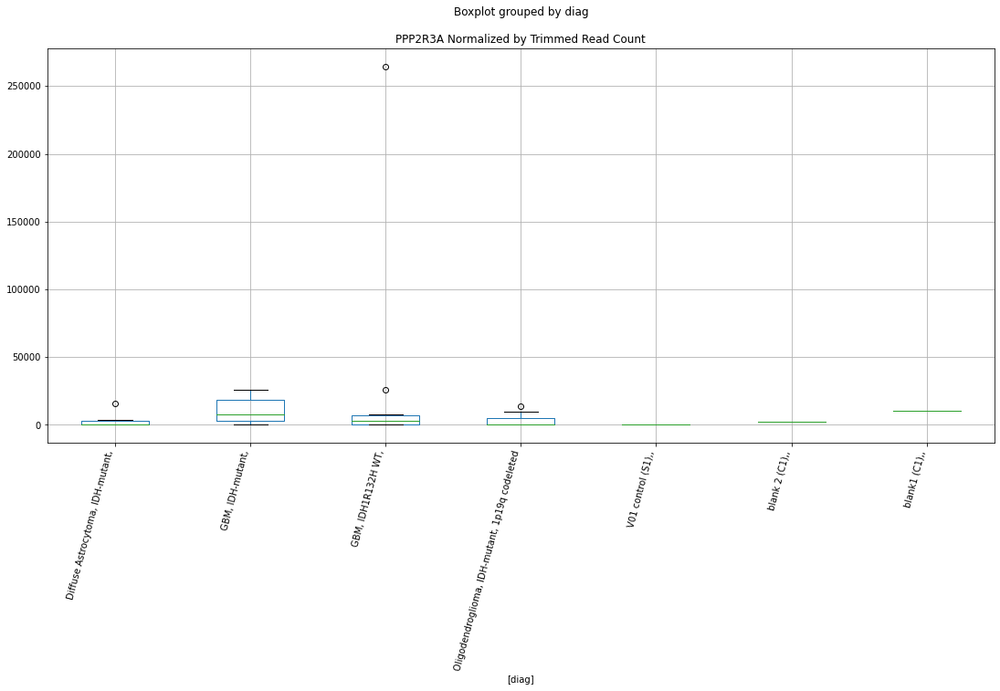

 p : 0.02555480500496312  ( t : 2.434366826604305 ) :  D-plex  :  cutadapt2  :  POLR2F
Control and blanks
76     0.0
340    0.0
Name: POLR2F, dtype: float64
208    1058.16
Name: POLR2F, dtype: float64
472    0.0
Name: POLR2F, dtype: float64


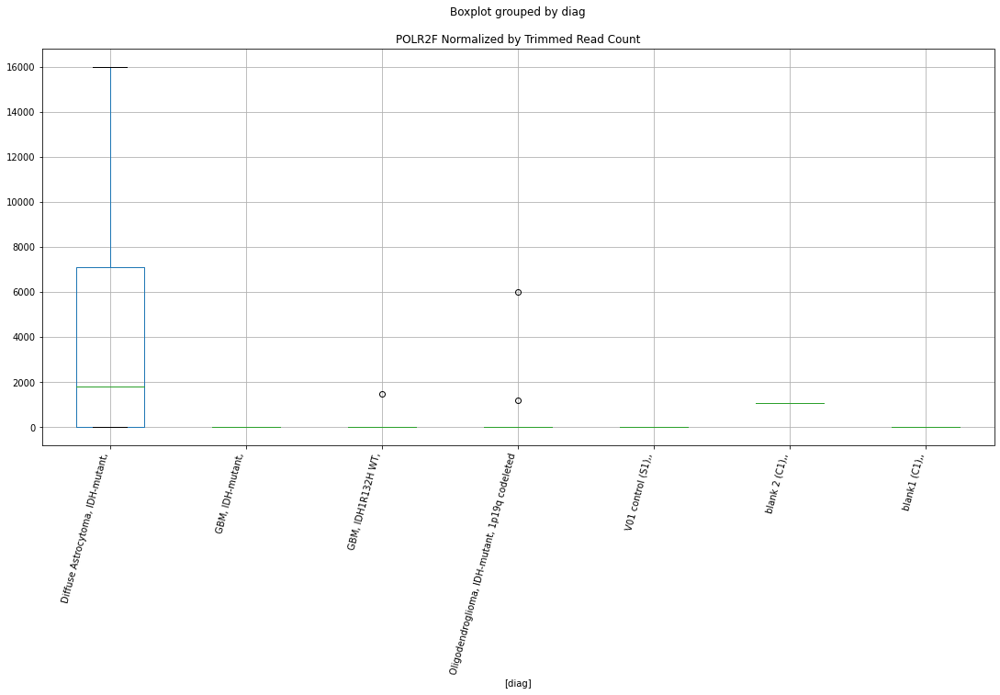

 p : 0.025563753404972023  ( t : 2.4341970161528343 ) :  D-plex  :  cutadapt2  :  PHEX-AS1
Control and blanks
76     1515.23
340    1761.46
Name: PHEX-AS1, dtype: float64
208    705.44
Name: PHEX-AS1, dtype: float64
472    1733.87
Name: PHEX-AS1, dtype: float64


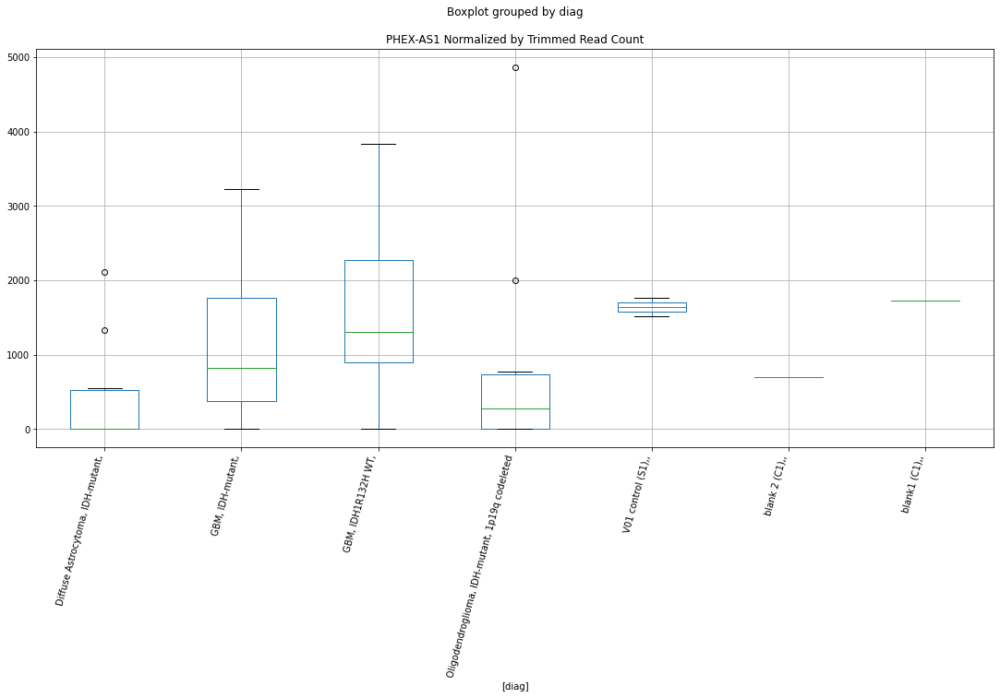

 p : 0.025593118218904098  ( t : 2.433640162283871 ) :  D-plex  :  cutadapt2  :  RTN3
Control and blanks
76     3788.07
340    4403.66
Name: RTN3, dtype: float64
208    6172.61
Name: RTN3, dtype: float64
472    8669.34
Name: RTN3, dtype: float64


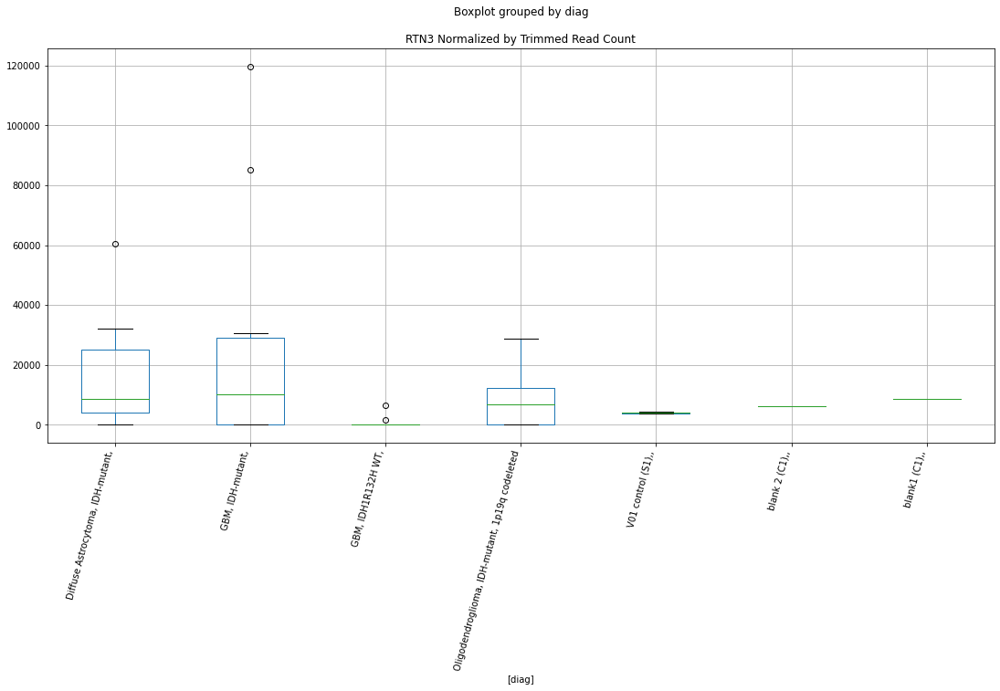

 p : 0.025763009714702544  ( t : 2.430430168171495 ) :  Lexogen  :  cutadapt2  :  RNY5
Control and blanks
82         0.00
346    16834.76
Name: RNY5, dtype: float64
214    0.0
Name: RNY5, dtype: float64
478    0.0
Name: RNY5, dtype: float64


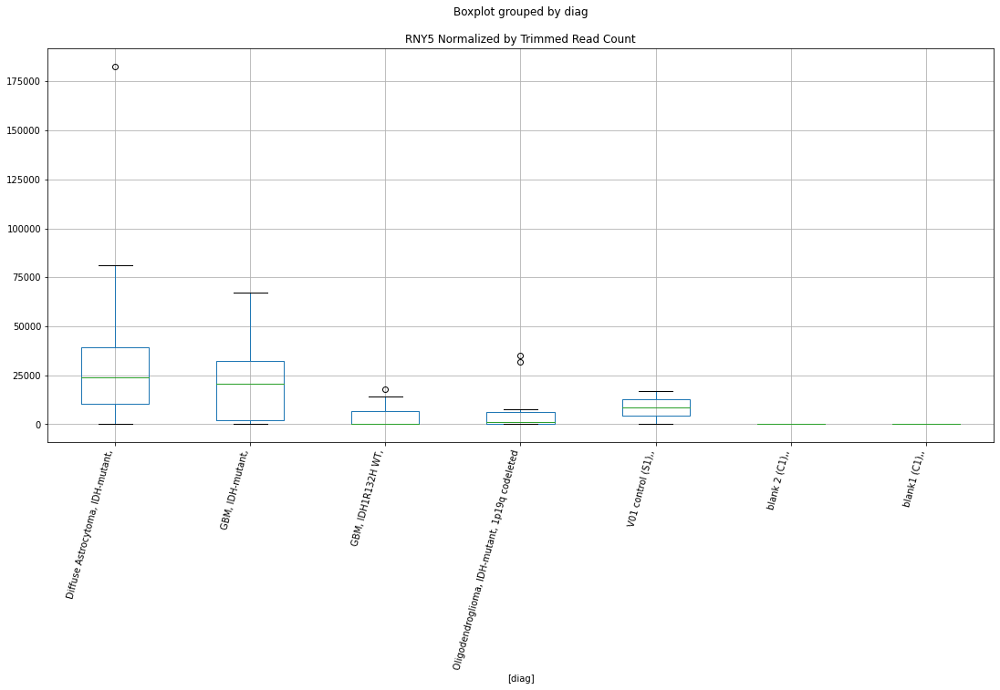

 p : 0.025878338711858195  ( t : 2.4282623857405734 ) :  D-plex  :  cutadapt2  :  PPP1R9A
Control and blanks
76     0.0
340    0.0
Name: PPP1R9A, dtype: float64
208    17283.3
Name: PPP1R9A, dtype: float64
472    16760.72
Name: PPP1R9A, dtype: float64


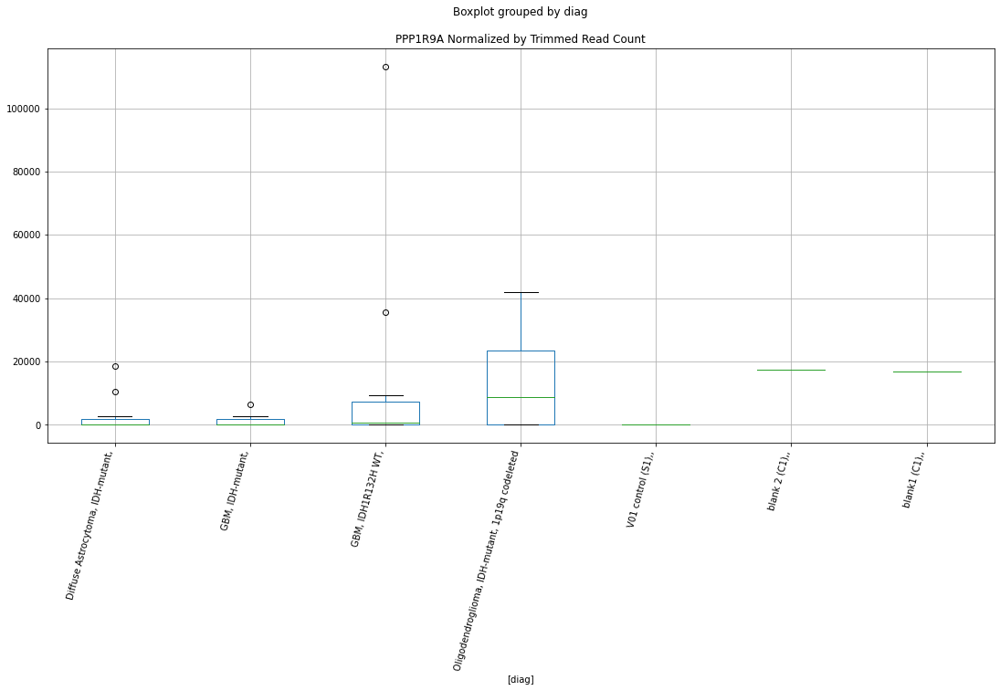

 p : 0.025904864406546317  ( t : 2.4277650762103327 ) :  D-plex  :  cutadapt2  :  SNX21
Control and blanks
76     0.0
340    0.0
Name: SNX21, dtype: float64
208    1058.16
Name: SNX21, dtype: float64
472    5201.6
Name: SNX21, dtype: float64


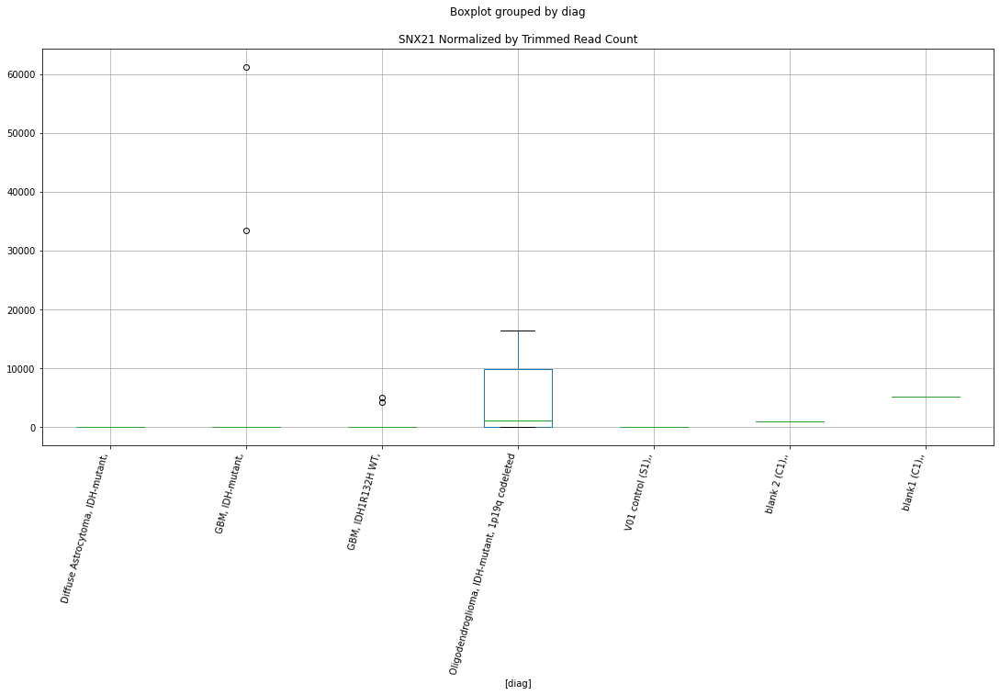

 p : 0.025952887127771128  ( t : 2.426865948529107 ) :  D-plex  :  bbduk2  :  PNPLA7
Control and blanks
73      8503.09
337    19583.46
Name: PNPLA7, dtype: float64
205    66084.56
Name: PNPLA7, dtype: float64
469    23069.57
Name: PNPLA7, dtype: float64


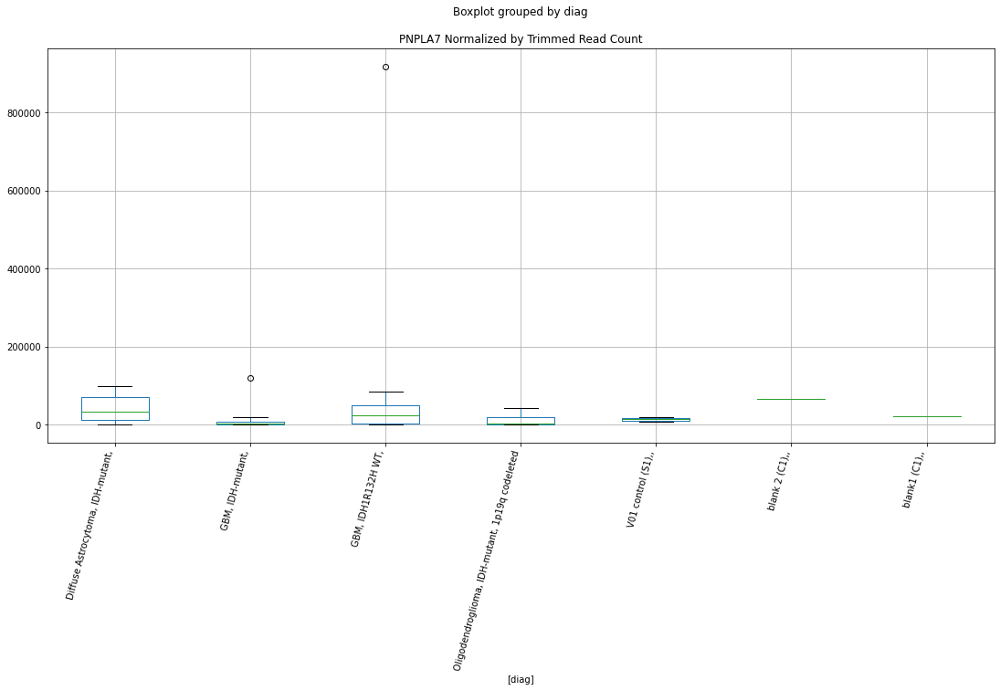

 p : 0.025973581377800512  ( t : 2.426478971415287 ) :  D-plex  :  bbduk2  :  PRR7
Control and blanks
73     0.0
337    0.0
Name: PRR7, dtype: float64
205    1074.55
Name: PRR7, dtype: float64
469    4732.22
Name: PRR7, dtype: float64


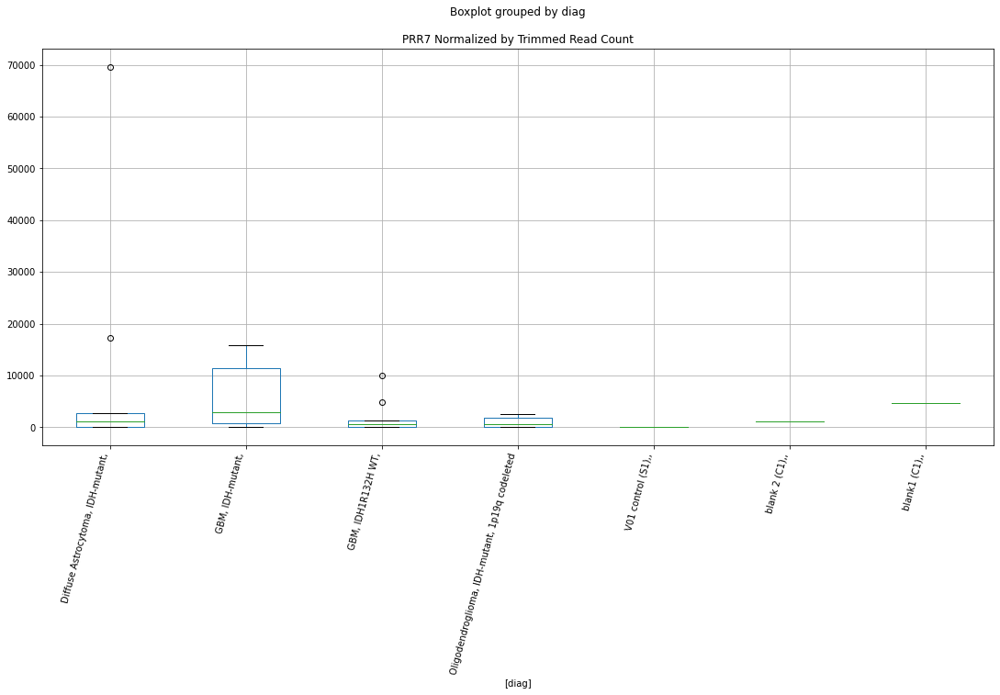

 p : 0.025978319137785547  ( t : 2.4263904171754485 ) :  D-plex  :  cutadapt2  :  SLC6A16
Control and blanks
76     0.0
340    0.0
Name: SLC6A16, dtype: float64
208    11639.77
Name: SLC6A16, dtype: float64
472    4623.65
Name: SLC6A16, dtype: float64


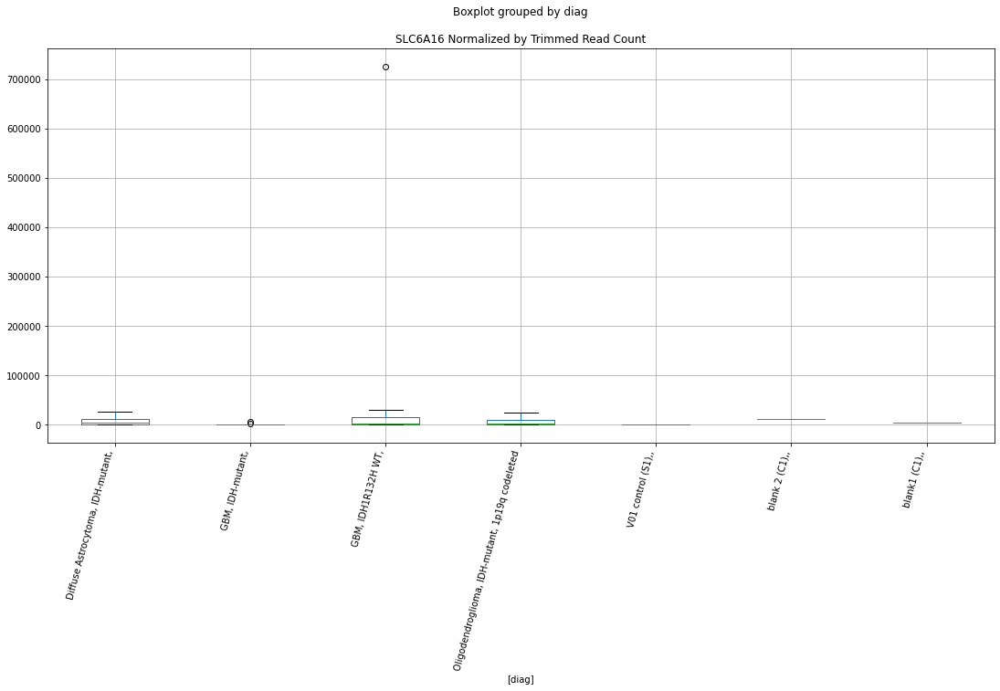

 p : 0.02599331642994809  ( t : 2.4261102000928223 ) :  Lexogen  :  bbduk2  :  SLC1A7
Control and blanks
79     0.0
343    0.0
Name: SLC1A7, dtype: float64
211    0.0
Name: SLC1A7, dtype: float64
475    0.0
Name: SLC1A7, dtype: float64


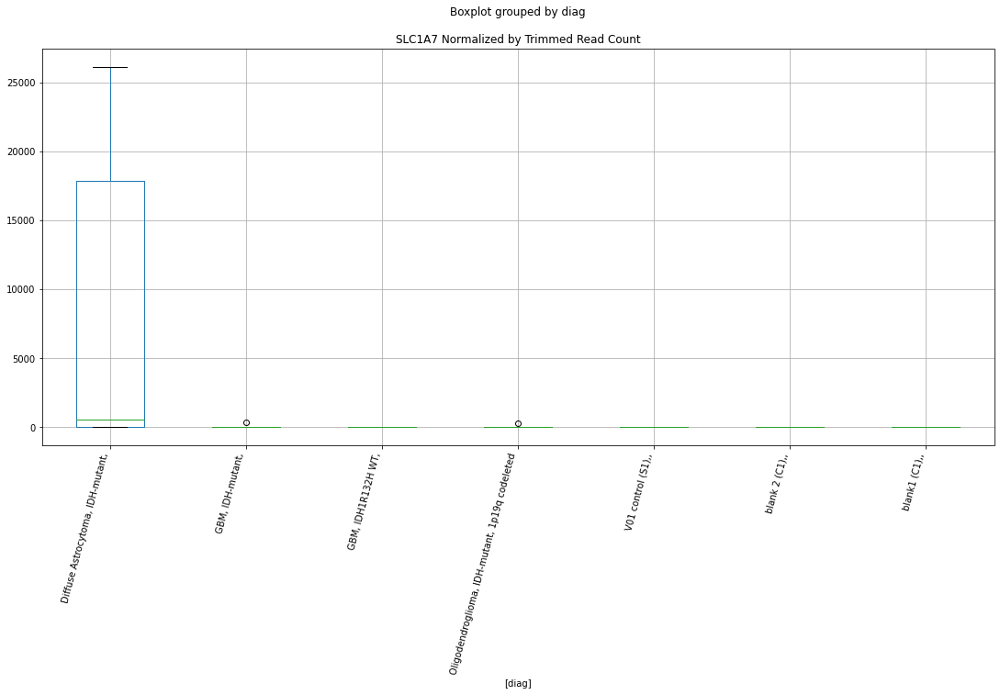

 p : 0.02599388173124215  ( t : 2.42609964067717 ) :  Lexogen  :  cutadapt2  :  SLC1A7
Control and blanks
82     0.0
346    0.0
Name: SLC1A7, dtype: float64
214    0.0
Name: SLC1A7, dtype: float64
478    0.0
Name: SLC1A7, dtype: float64


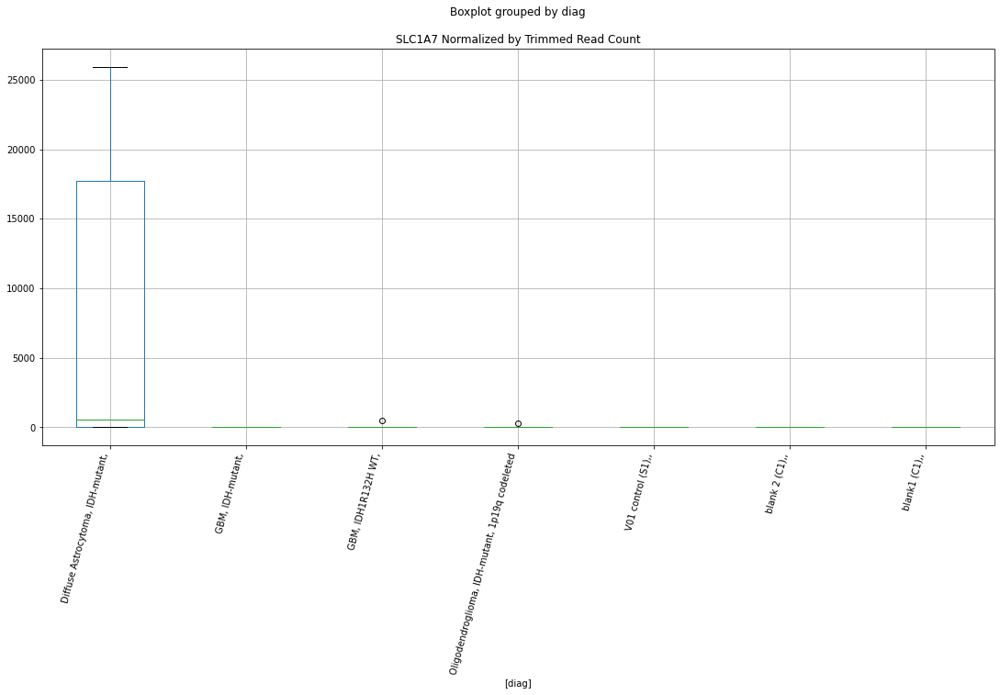

 p : 0.026071428279706366  ( t : 2.4246531630665134 ) :  D-plex  :  bbduk2  :  SLC35E2B
Control and blanks
73     0.0
337    0.0
Name: SLC35E2B, dtype: float64
205    2149.09
Name: SLC35E2B, dtype: float64
469    2366.11
Name: SLC35E2B, dtype: float64


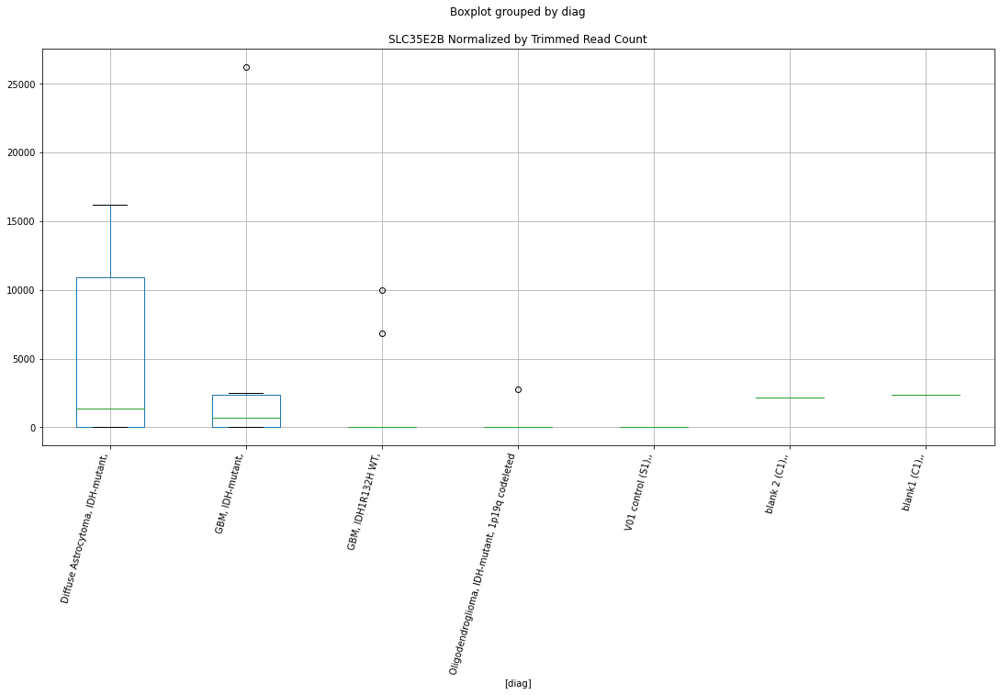

 p : 0.026182180408635732  ( t : 2.4225942749888794 ) :  D-plex  :  bbduk2  :  RPL8
Control and blanks
73     6184.07
337       0.00
Name: RPL8, dtype: float64
205    179.09
Name: RPL8, dtype: float64
469    2366.11
Name: RPL8, dtype: float64


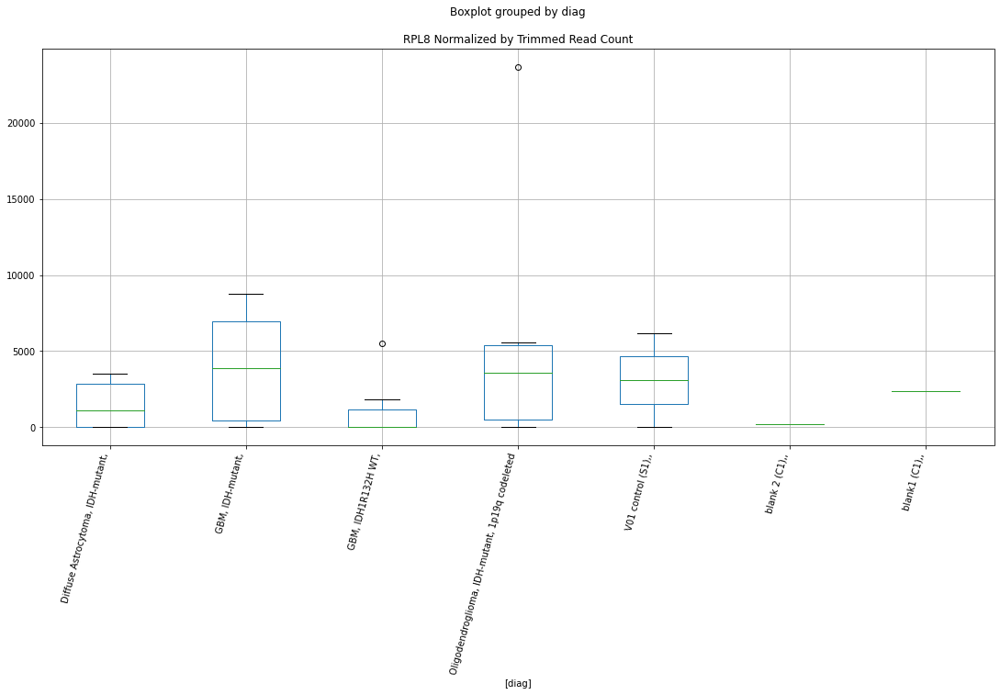

 p : 0.02618494804684945  ( t : 2.4225429290056986 ) :  D-plex  :  cutadapt2  :  SLC35E2B
Control and blanks
76     0.0
340    0.0
Name: SLC35E2B, dtype: float64
208    2116.32
Name: SLC35E2B, dtype: float64
472    2311.82
Name: SLC35E2B, dtype: float64


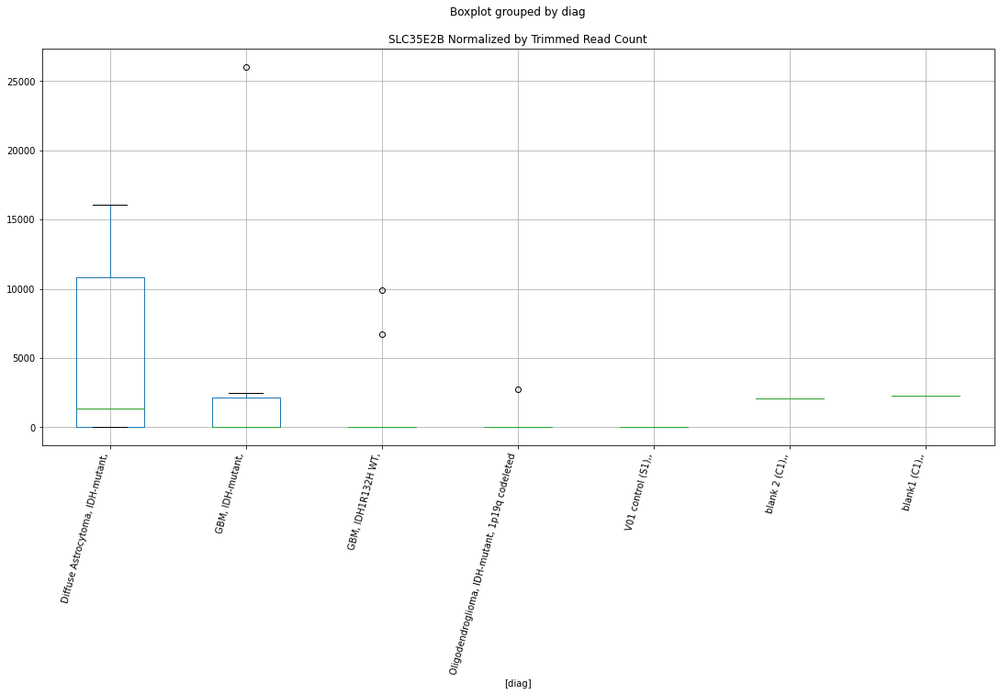

 p : 0.02620977818159411  ( t : 2.4220825007995908 ) :  D-plex  :  cutadapt2  :  PMEPA1
Control and blanks
76     0.0
340    0.0
Name: PMEPA1, dtype: float64
208    1763.6
Name: PMEPA1, dtype: float64
472    8669.34
Name: PMEPA1, dtype: float64


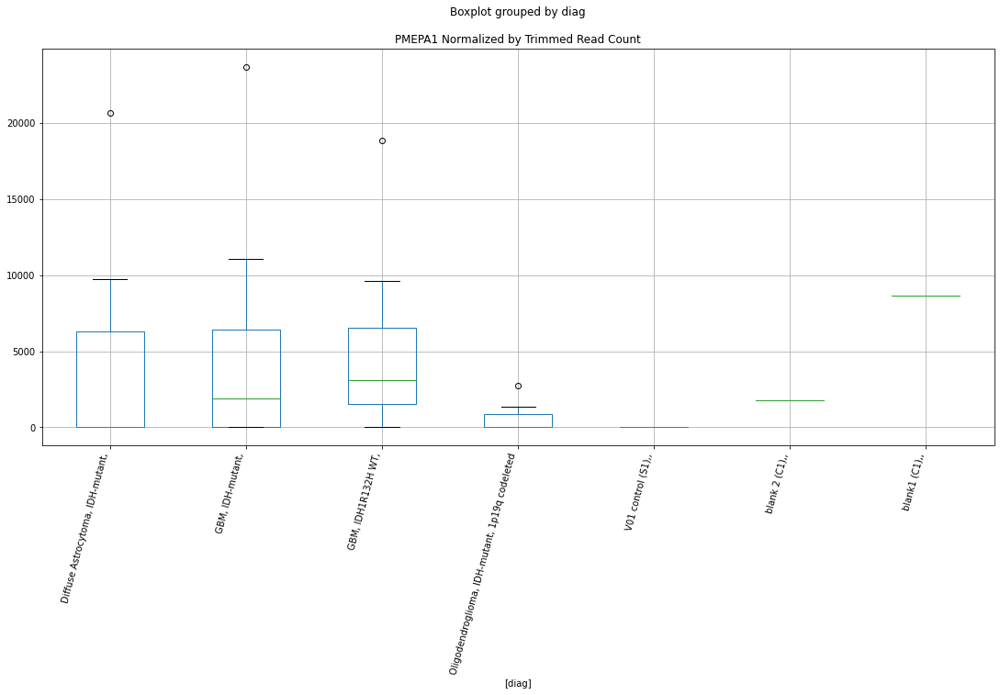

 p : 0.026321584485918644  ( t : 2.4200143117353163 ) :  D-plex  :  cutadapt2  :  POLQ
Control and blanks
76     0.0
340    0.0
Name: POLQ, dtype: float64
208    352.72
Name: POLQ, dtype: float64
472    0.0
Name: POLQ, dtype: float64


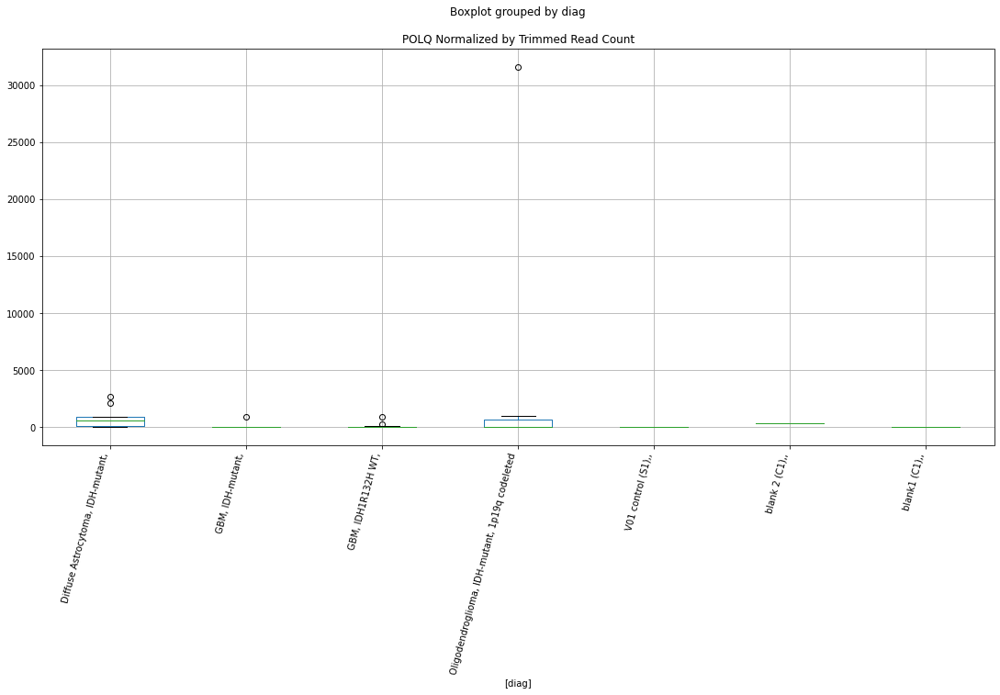

 p : 0.026335003438715508  ( t : 2.4197666416869366 ) :  D-plex  :  bbduk2  :  POMC
Control and blanks
73     6184.07
337       0.00
Name: POMC, dtype: float64
205    7880.0
Name: POMC, dtype: float64
469    13605.13
Name: POMC, dtype: float64


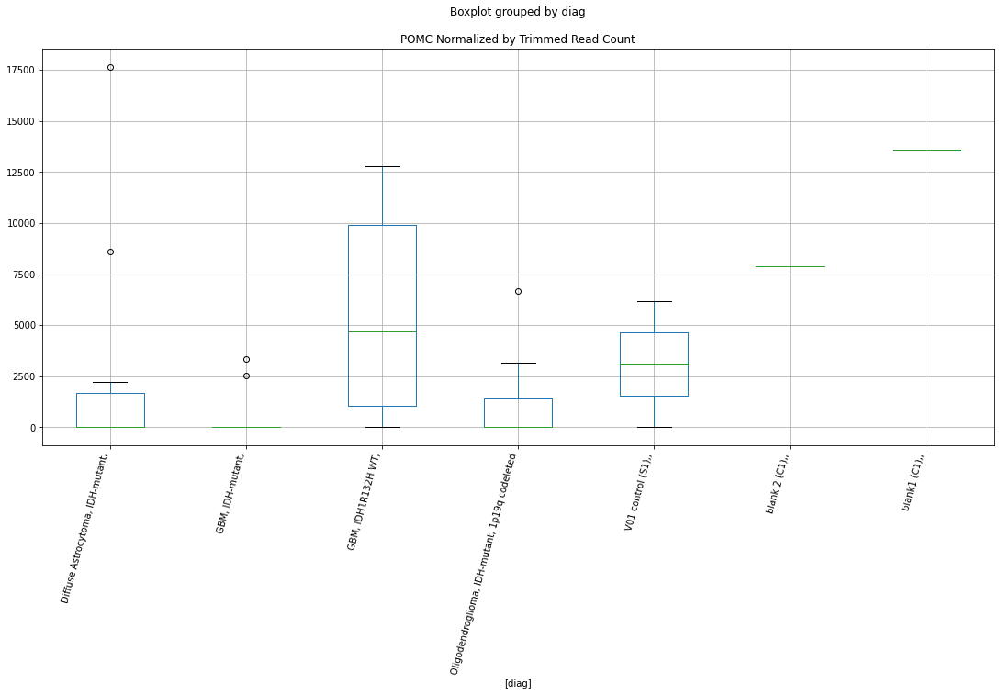

 p : 0.026356170241885527  ( t : 2.4193762117722626 ) :  D-plex  :  cutadapt2  :  RFX1
Control and blanks
76     0.0
340    0.0
Name: RFX1, dtype: float64
208    1234.52
Name: RFX1, dtype: float64
472    0.0
Name: RFX1, dtype: float64


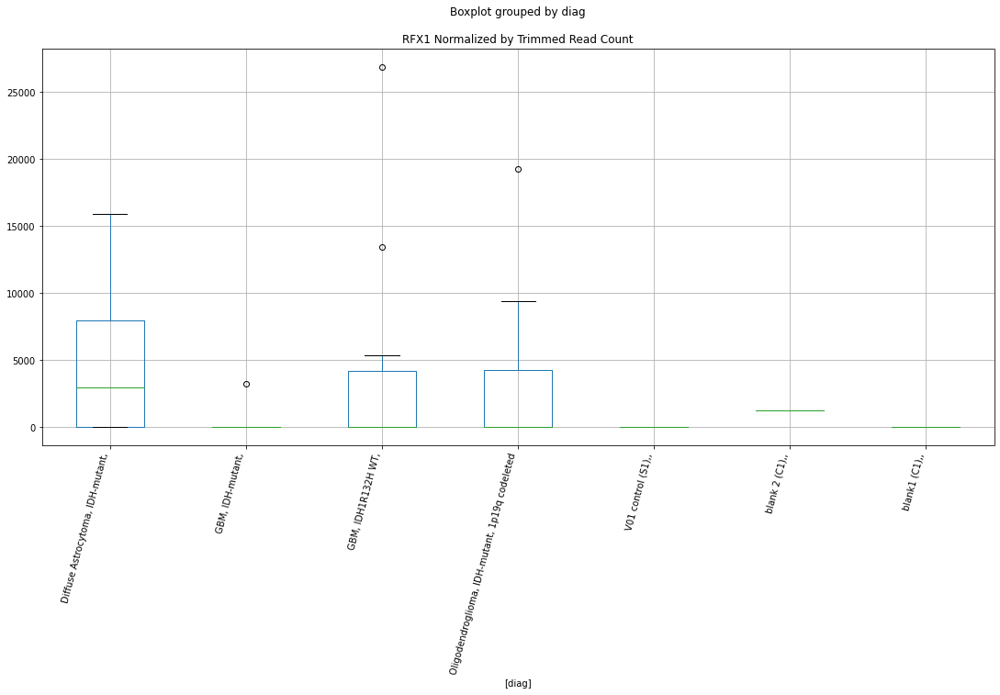

 p : 0.02640263117042349  ( t : 2.4185202505230383 ) :  Lexogen  :  bbduk2  :  RNY5
Control and blanks
79         0.00
343    16560.52
Name: RNY5, dtype: float64
211    0.0
Name: RNY5, dtype: float64
475    0.0
Name: RNY5, dtype: float64


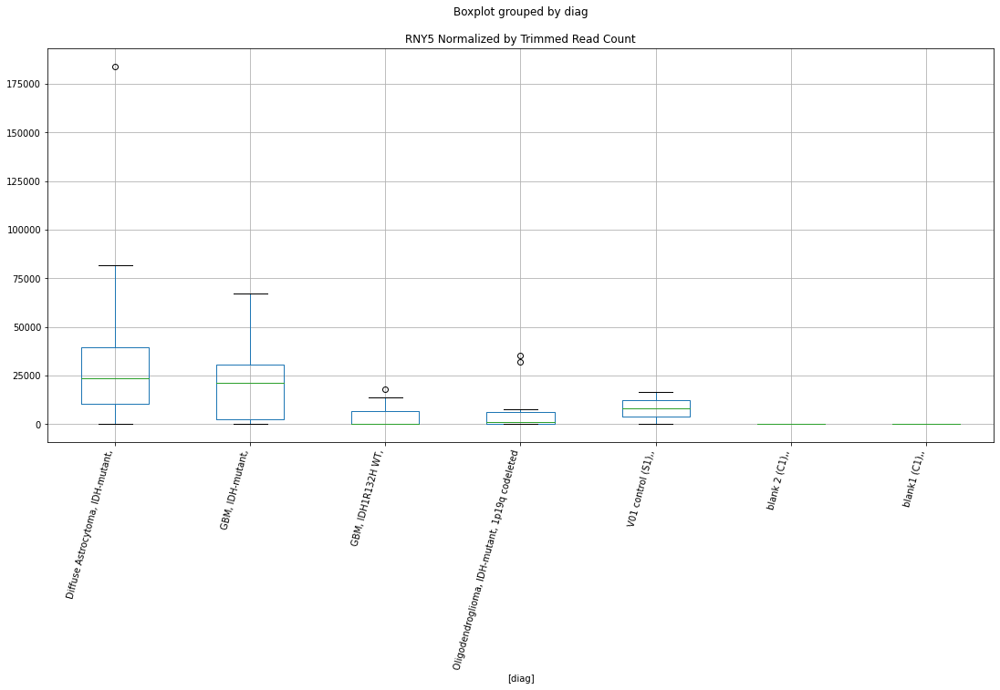

 p : 0.02642178016662688  ( t : 2.418167874218714 ) :  D-plex  :  cutadapt2  :  RBPJL
Control and blanks
76       7576.14
340    142678.61
Name: RBPJL, dtype: float64
208    90825.51
Name: RBPJL, dtype: float64
472    107499.79
Name: RBPJL, dtype: float64


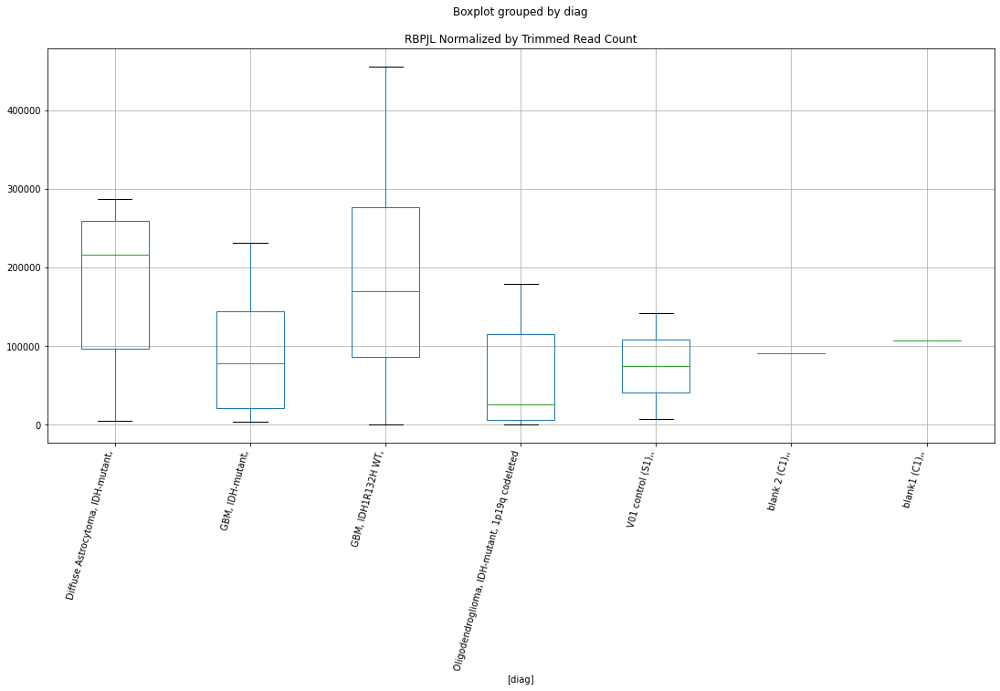

 p : 0.026474877174755475  ( t : 2.41719204227071 ) :  D-plex  :  cutadapt2  :  QRICH1
Control and blanks
76     0.0
340    0.0
Name: QRICH1, dtype: float64
208    1058.16
Name: QRICH1, dtype: float64
472    4045.69
Name: QRICH1, dtype: float64


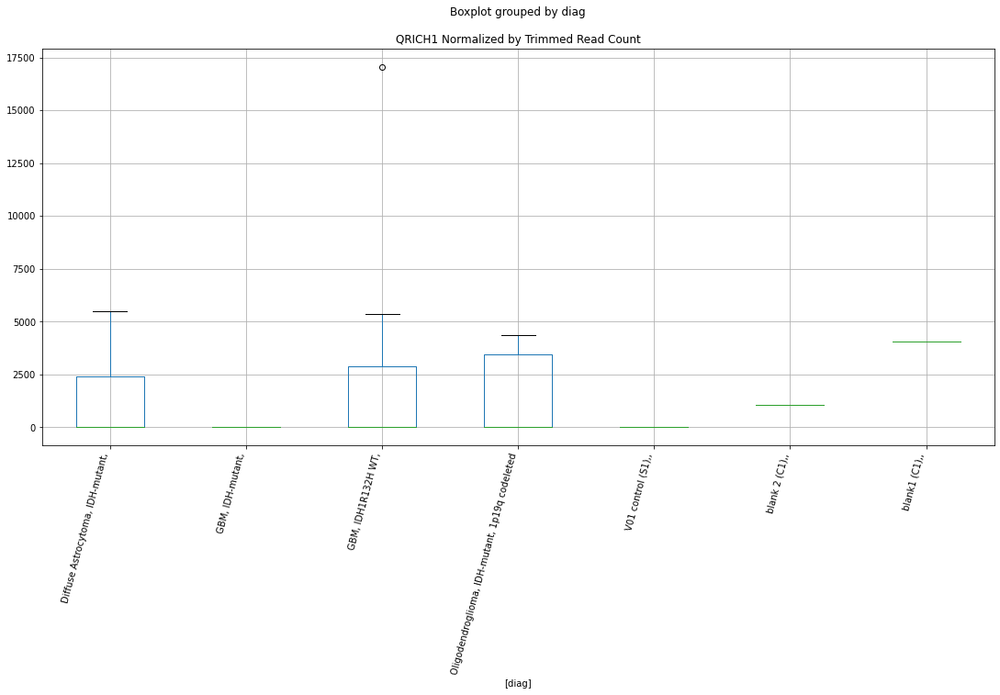

 p : 0.026478752019860344  ( t : 2.4171209010288712 ) :  Lexogen  :  bbduk2  :  SLC1A7
Control and blanks
79     0.0
343    0.0
Name: SLC1A7, dtype: float64
211    0.0
Name: SLC1A7, dtype: float64
475    0.0
Name: SLC1A7, dtype: float64


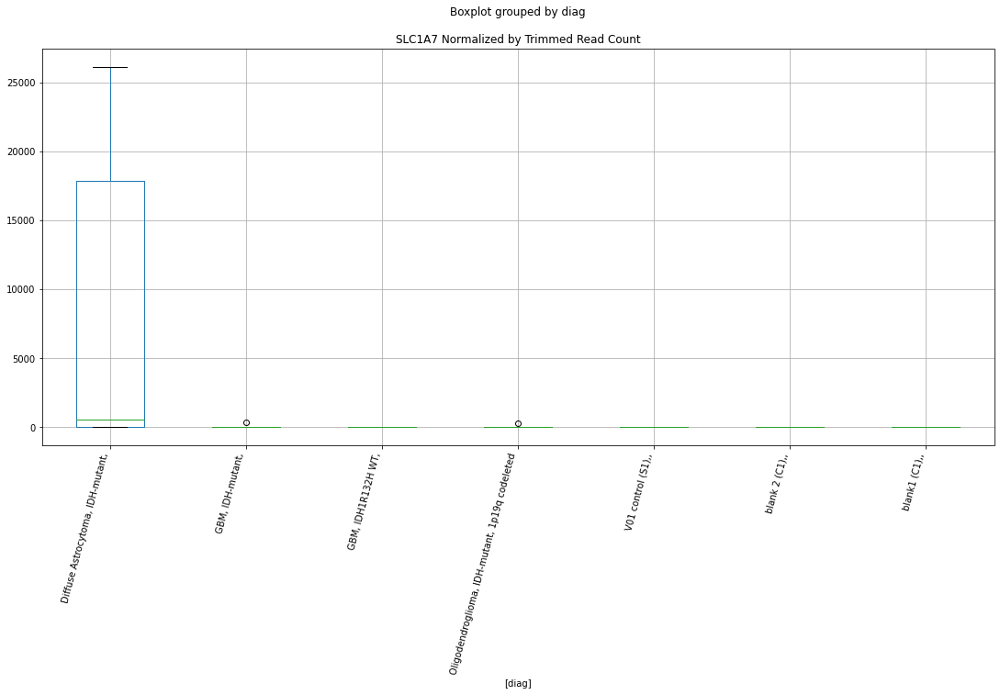

 p : 0.026479628370662606  ( t : 2.4171048127865533 ) :  Lexogen  :  cutadapt2  :  SLC1A7
Control and blanks
82     0.0
346    0.0
Name: SLC1A7, dtype: float64
214    0.0
Name: SLC1A7, dtype: float64
478    0.0
Name: SLC1A7, dtype: float64


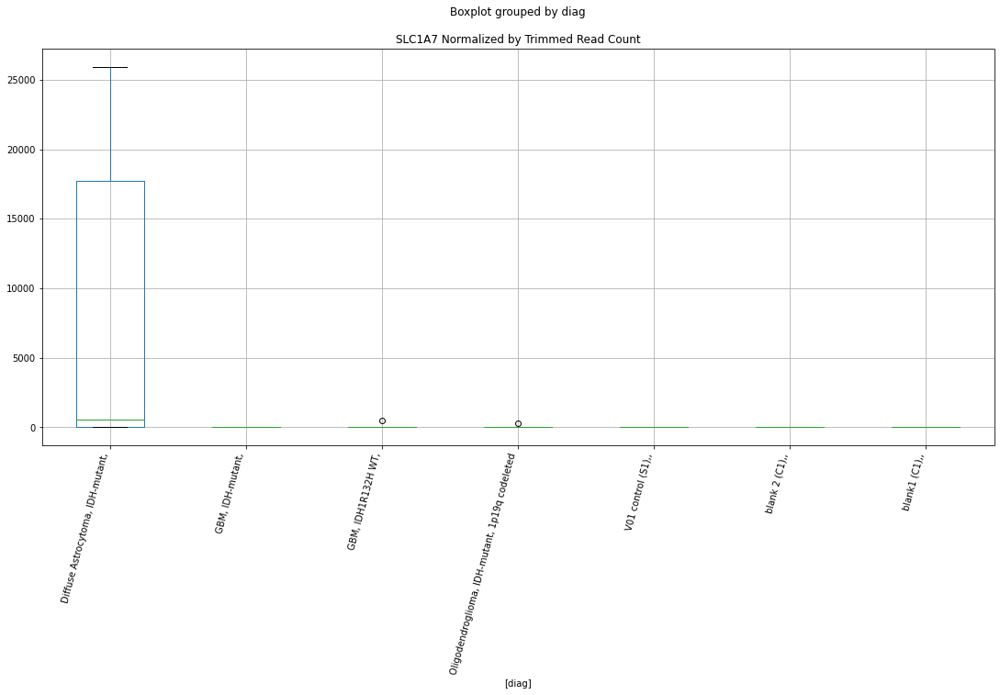

 p : 0.026522245855946824  ( t : 2.4163230325537364 ) :  Lexogen  :  bbduk2  :  PLXNB3
Control and blanks
79     0.0
343    0.0
Name: PLXNB3, dtype: float64
211    0.0
Name: PLXNB3, dtype: float64
475    0.0
Name: PLXNB3, dtype: float64


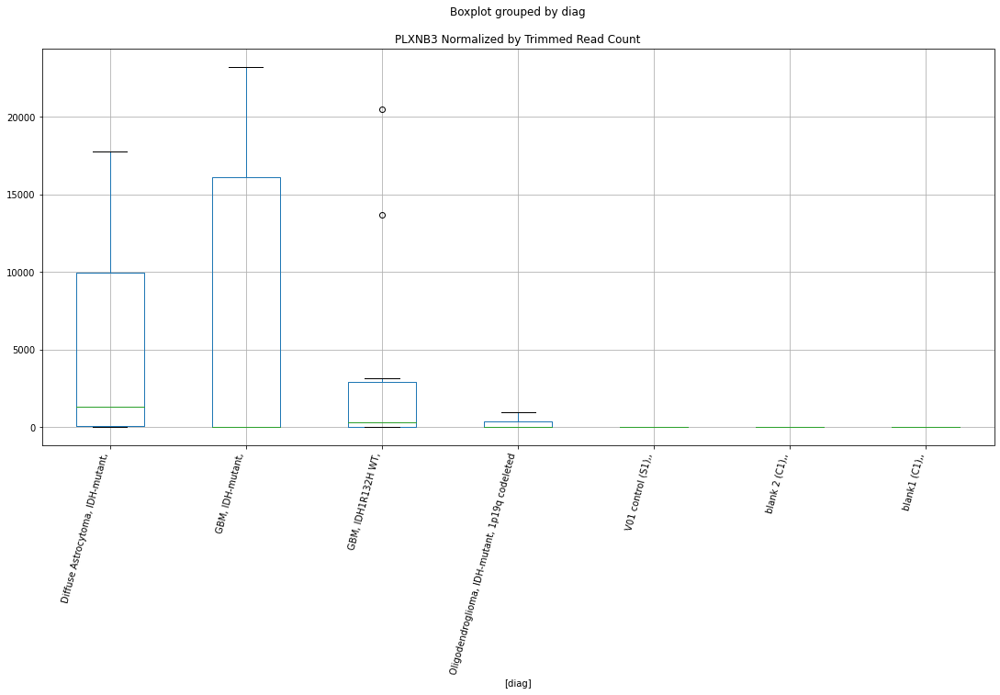

 p : 0.026546394359563307  ( t : 2.4158805714174933 ) :  D-plex  :  bbduk2  :  QRICH1
Control and blanks
73     0.0
337    0.0
Name: QRICH1, dtype: float64
205    1074.55
Name: QRICH1, dtype: float64
469    4140.69
Name: QRICH1, dtype: float64


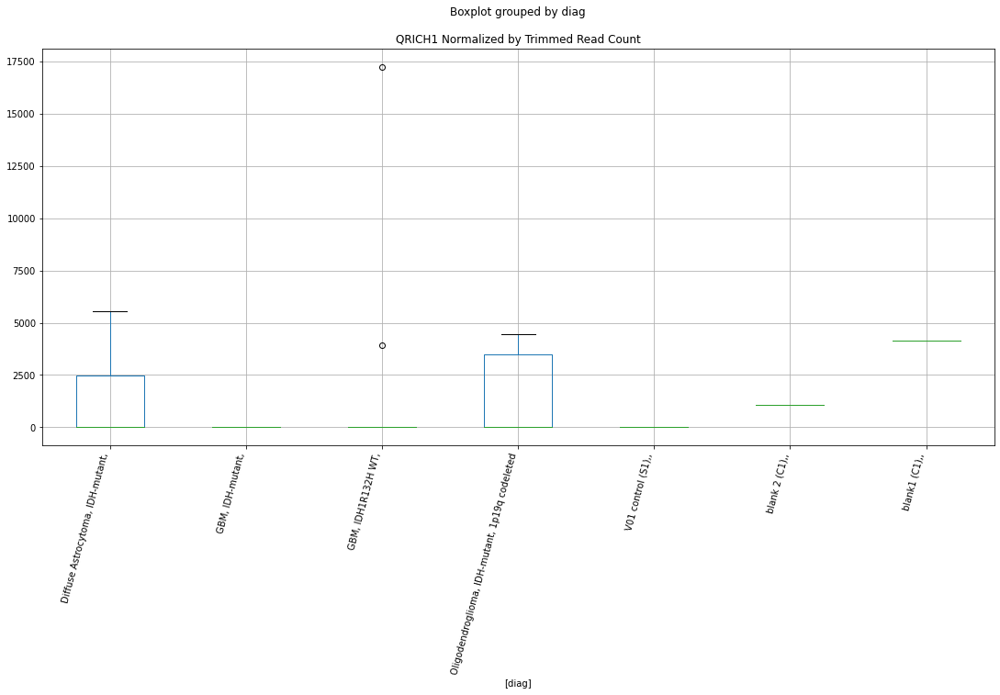

 p : 0.026573698838473526  ( t : 2.4153807385991377 ) :  D-plex  :  cutadapt2  :  SCRG1
Control and blanks
76     0.0
340    0.0
Name: SCRG1, dtype: float64
208    1763.6
Name: SCRG1, dtype: float64
472    1155.91
Name: SCRG1, dtype: float64


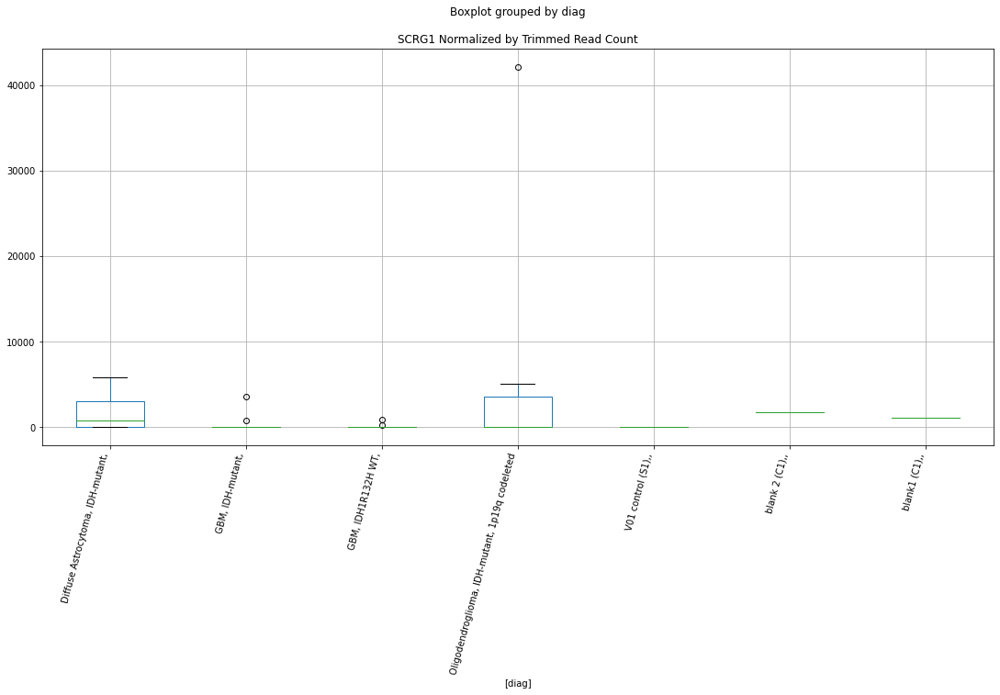

 p : 0.026574416040710598  ( t : 2.4153676160548856 ) :  Lexogen  :  bbduk2  :  SLC1A7
Control and blanks
79     0.0
343    0.0
Name: SLC1A7, dtype: float64
211    0.0
Name: SLC1A7, dtype: float64
475    0.0
Name: SLC1A7, dtype: float64


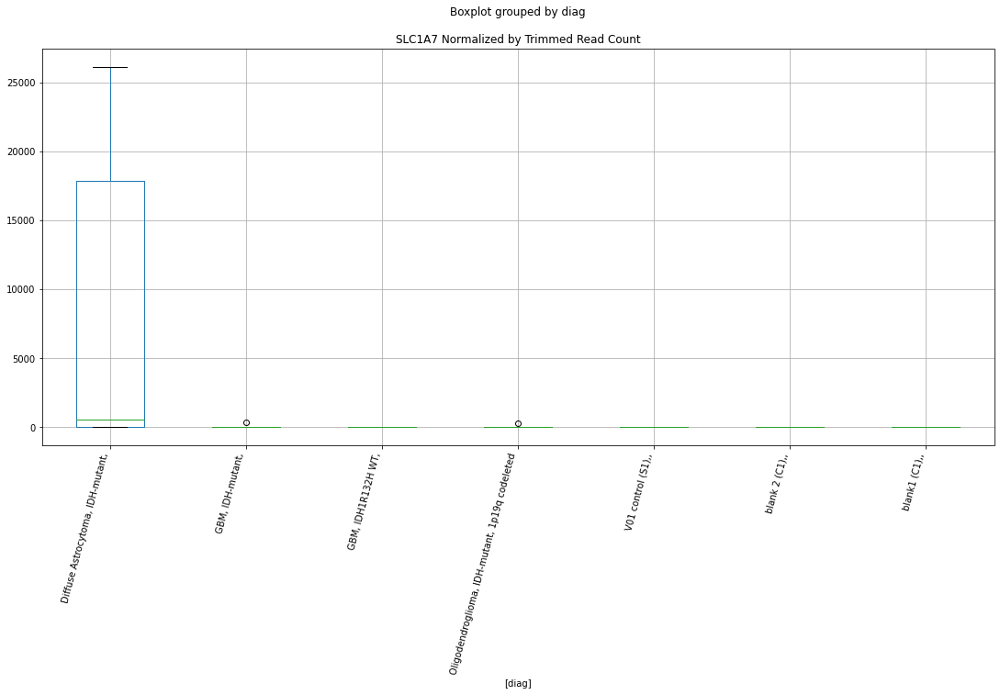

 p : 0.026629106960427536  ( t : 2.4143679196590018 ) :  Lexogen  :  cutadapt2  :  RNF144A
Control and blanks
82       0.00
346    420.87
Name: RNF144A, dtype: float64
214    0.0
Name: RNF144A, dtype: float64
478    237.46
Name: RNF144A, dtype: float64


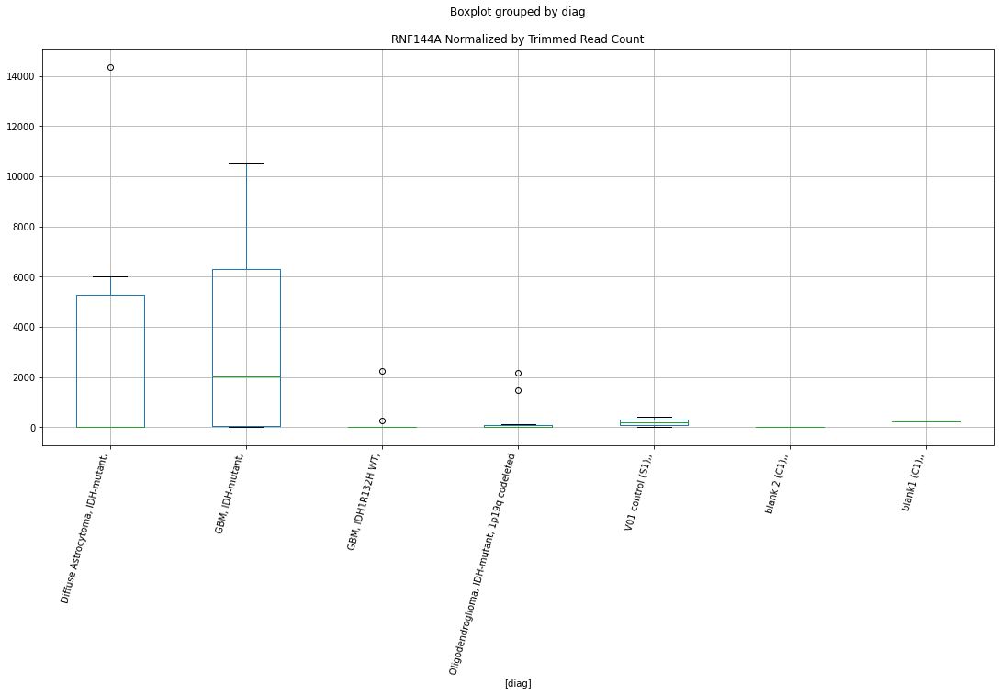

 p : 0.02667103316101142  ( t : 2.413602850480199 ) :  D-plex  :  bbduk2  :  PKD1P5-LOC105376752
Control and blanks
73     29374.32
337        0.00
Name: PKD1P5-LOC105376752, dtype: float64
205    6268.18
Name: PKD1P5-LOC105376752, dtype: float64
469    10647.49
Name: PKD1P5-LOC105376752, dtype: float64


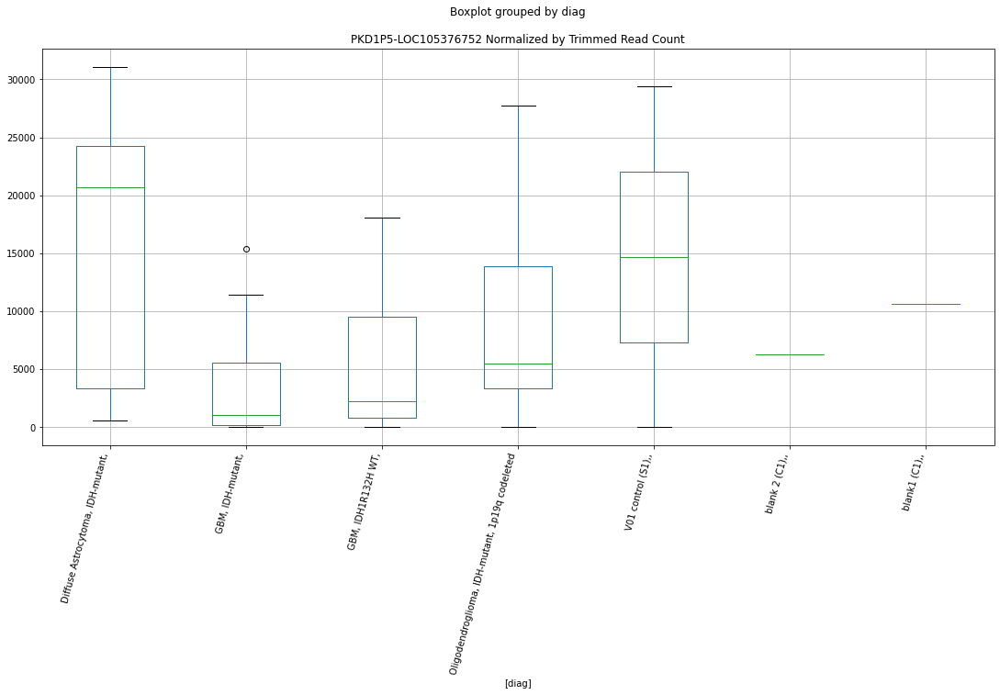

 p : 0.02671047244949556  ( t : 2.412884189382273 ) :  D-plex  :  bbduk2  :  SDK1
Control and blanks
73     75754.82
337        0.00
Name: SDK1, dtype: float64
205    10387.28
Name: SDK1, dtype: float64
469    14788.18
Name: SDK1, dtype: float64


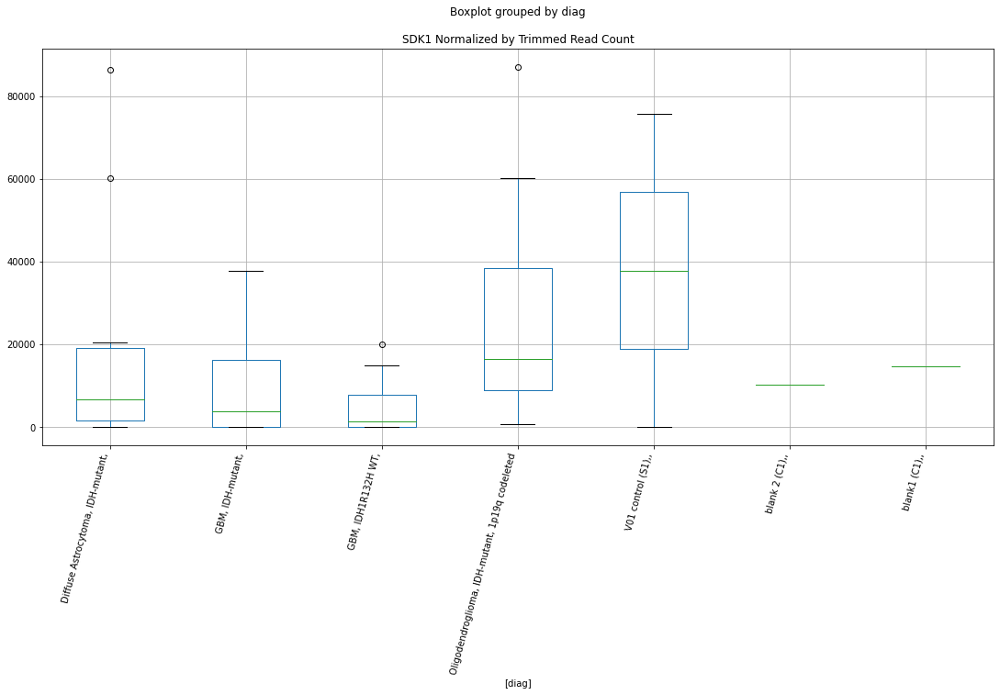

 p : 0.02674963023536196  ( t : 2.4121716397856816 ) :  Lexogen  :  cutadapt2  :  SLC1A7
Control and blanks
82     0.0
346    0.0
Name: SLC1A7, dtype: float64
214    0.0
Name: SLC1A7, dtype: float64
478    0.0
Name: SLC1A7, dtype: float64


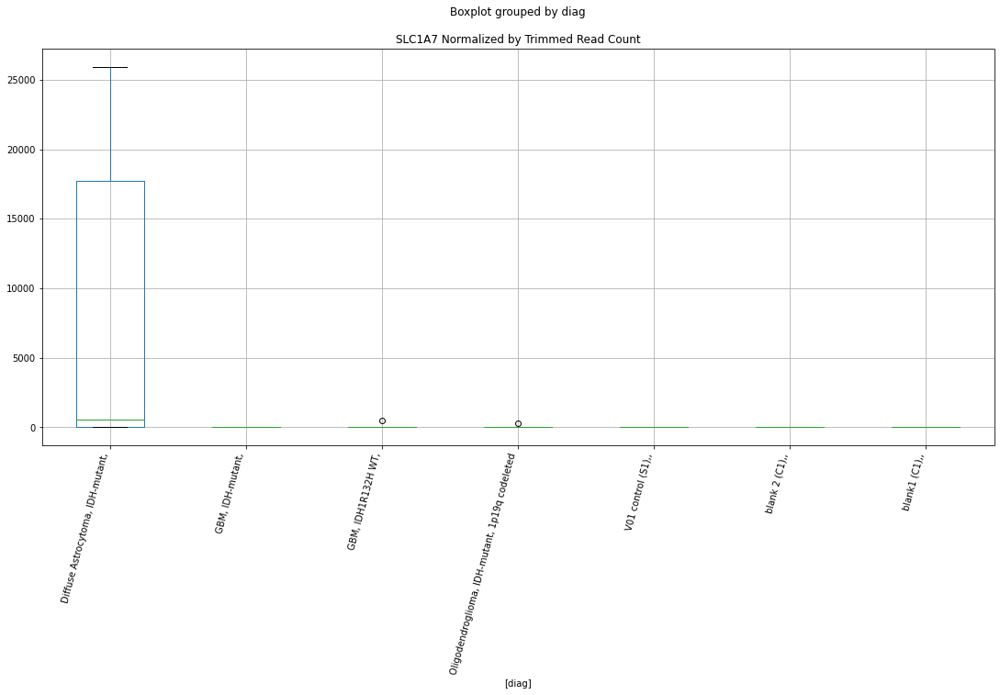

 p : 0.026791808290242393  ( t : 2.411405222029231 ) :  D-plex  :  bbduk2  :  SDC4
Control and blanks
73     0.0
337    0.0
Name: SDC4, dtype: float64
205    537.27
Name: SDC4, dtype: float64
469    1774.58
Name: SDC4, dtype: float64


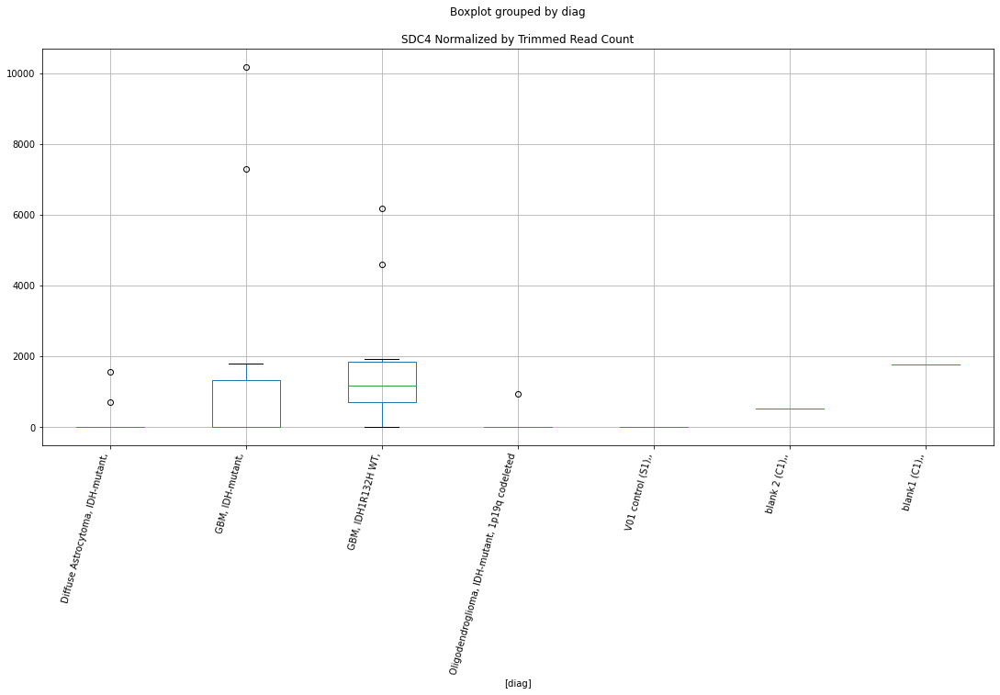

 p : 0.026840775741797527  ( t : 2.4105168493472364 ) :  D-plex  :  bbduk2  :  RBPJL
Control and blanks
73       7730.08
337    144205.48
Name: RBPJL, dtype: float64
205    93127.3
Name: RBPJL, dtype: float64
469    107066.44
Name: RBPJL, dtype: float64


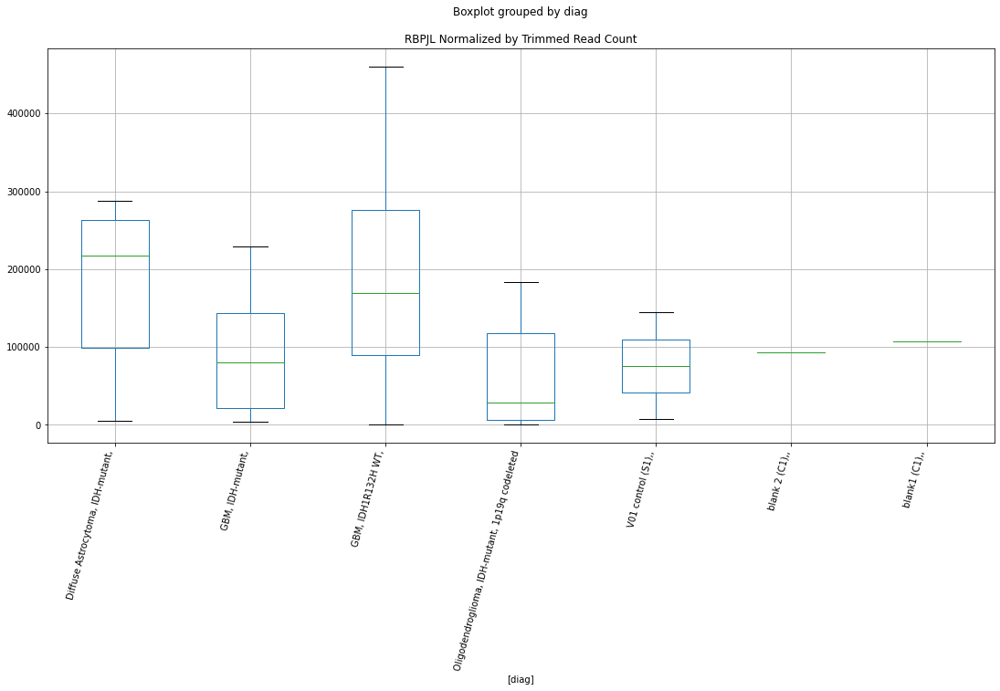

 p : 0.026977031775743815  ( t : 2.4080528363103704 ) :  Lexogen  :  cutadapt2  :  PIP5K1A
Control and blanks
82     0.0
346    0.0
Name: PIP5K1A, dtype: float64
214    0.0
Name: PIP5K1A, dtype: float64
478    0.0
Name: PIP5K1A, dtype: float64


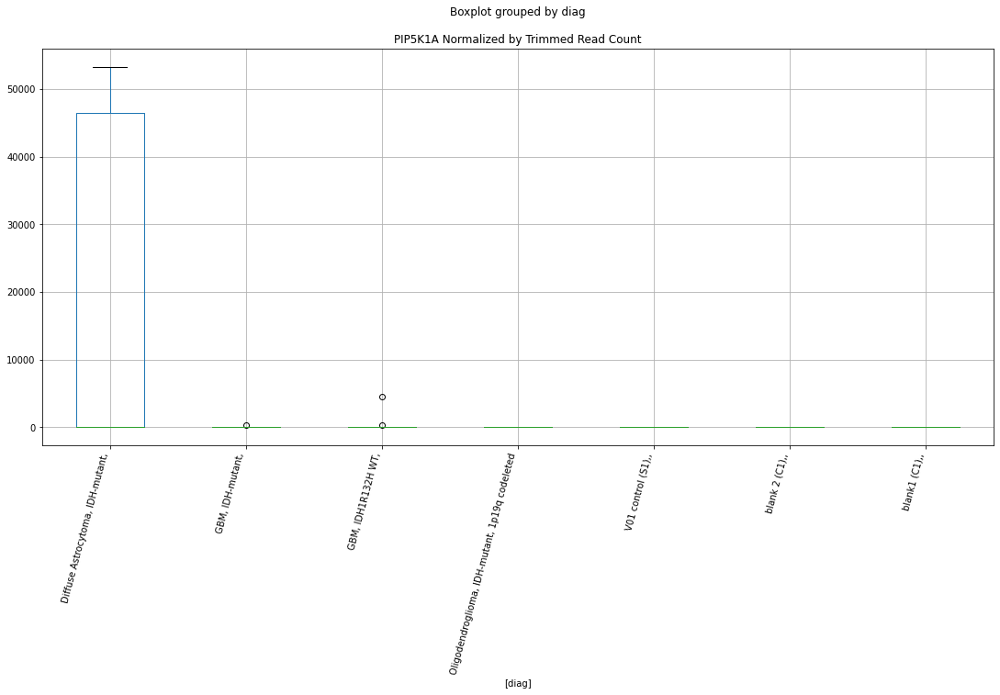

 p : 0.026985816738311418  ( t : 2.4078943715839607 ) :  D-plex  :  cutadapt2  :  SLC25A14
Control and blanks
76     184100.25
340     23779.77
Name: SLC25A14, dtype: float64
208    50968.1
Name: SLC25A14, dtype: float64
472    67620.83
Name: SLC25A14, dtype: float64


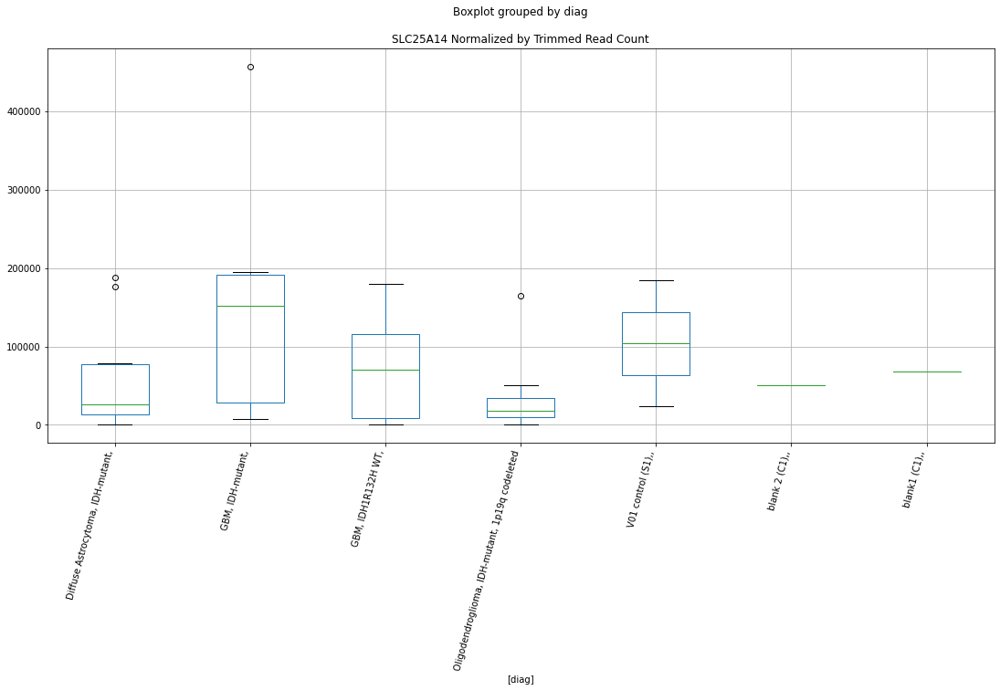

 p : 0.02699154149780439  ( t : 2.407791133321144 ) :  D-plex  :  bbduk2  :  SH2D4B
Control and blanks
73     0.0
337    0.0
Name: SH2D4B, dtype: float64
205    716.36
Name: SH2D4B, dtype: float64
469    0.0
Name: SH2D4B, dtype: float64


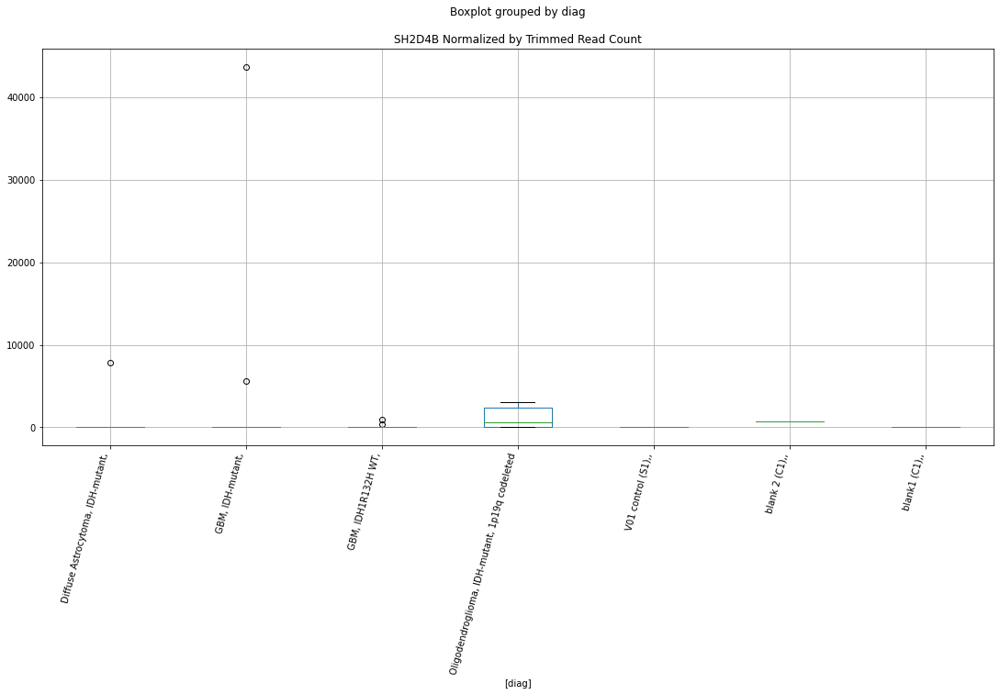

 p : 0.02716409733086935  ( t : 2.4046888987701966 ) :  Lexogen  :  bbduk2  :  PCSK4
Control and blanks
79     0.0
343    0.0
Name: PCSK4, dtype: float64
211    75432.55
Name: PCSK4, dtype: float64
475    0.0
Name: PCSK4, dtype: float64


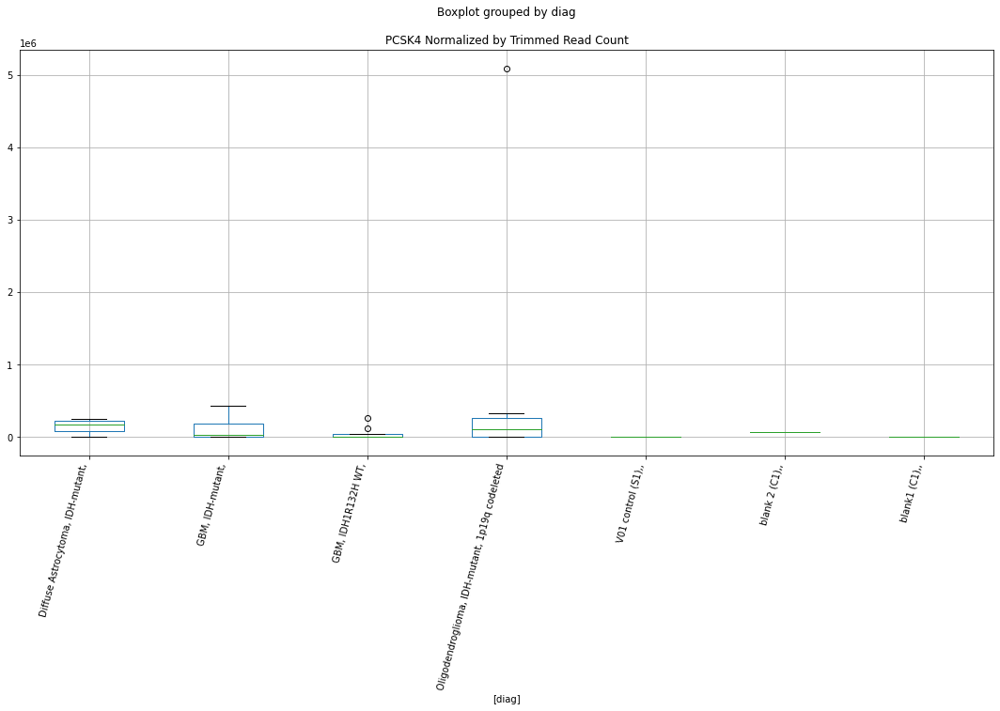

 p : 0.027179300237028317  ( t : 2.404416462981797 ) :  Lexogen  :  cutadapt2  :  PCSK4
Control and blanks
82     0.0
346    0.0
Name: PCSK4, dtype: float64
214    74858.5
Name: PCSK4, dtype: float64
478    0.0
Name: PCSK4, dtype: float64


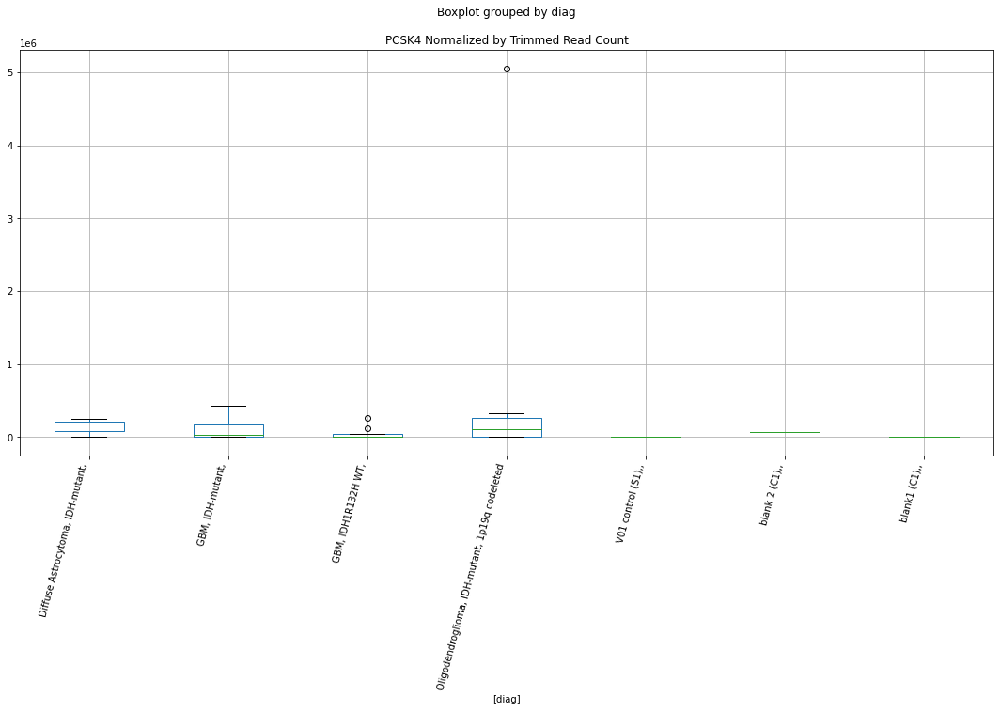

 p : 0.02719560206874751  ( t : 2.4041244927926937 ) :  D-plex  :  bbduk2  :  PPP2R2D
Control and blanks
73     0.0
337    0.0
Name: PPP2R2D, dtype: float64
205    895.45
Name: PPP2R2D, dtype: float64
469    591.53
Name: PPP2R2D, dtype: float64


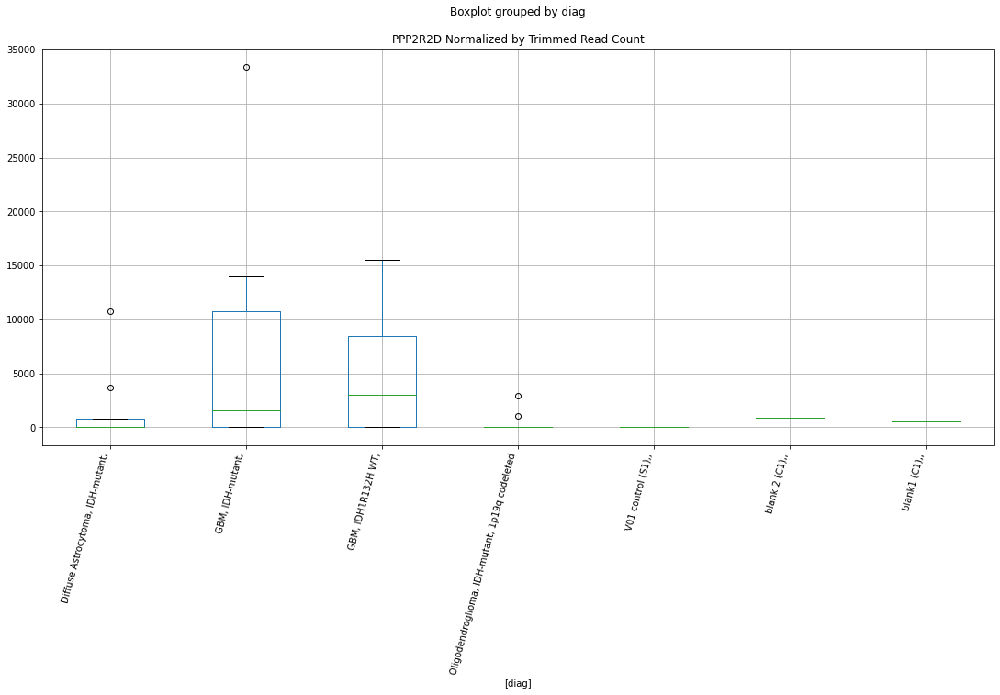

 p : 0.027211616772515223  ( t : 2.4038378245024807 ) :  D-plex  :  cutadapt2  :  PRKXP1
Control and blanks
76     0.0
340    0.0
Name: PRKXP1, dtype: float64
208    705.44
Name: PRKXP1, dtype: float64
472    0.0
Name: PRKXP1, dtype: float64


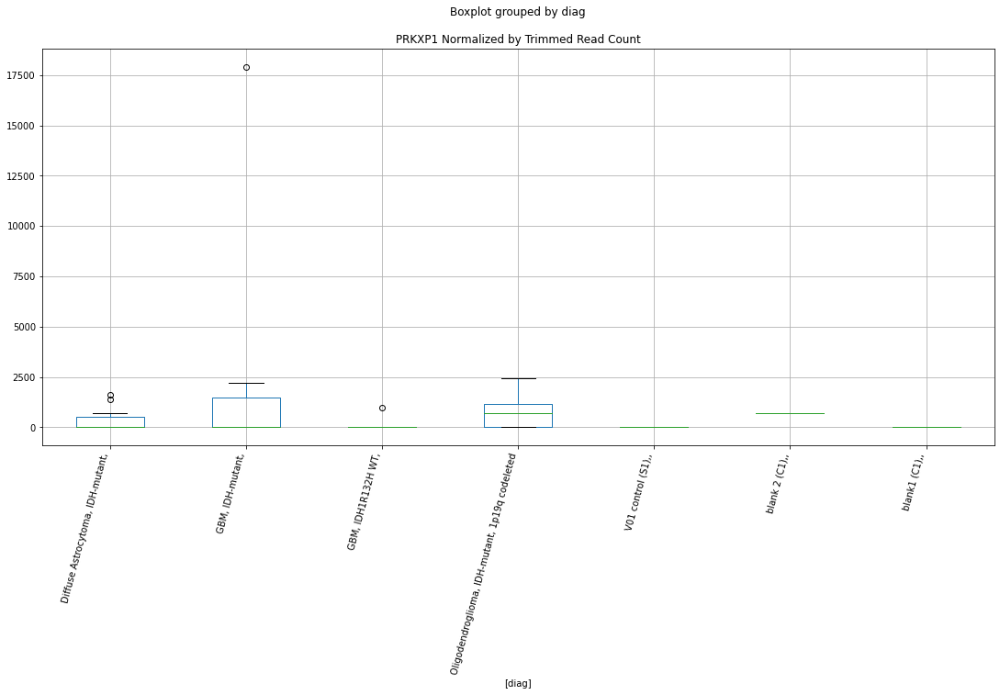

 p : 0.02722869031300334  ( t : 2.4035323764439753 ) :  D-plex  :  cutadapt2  :  S1PR3
Control and blanks
76       0.00
340    880.73
Name: S1PR3, dtype: float64
208    1410.88
Name: S1PR3, dtype: float64
472    2311.82
Name: S1PR3, dtype: float64


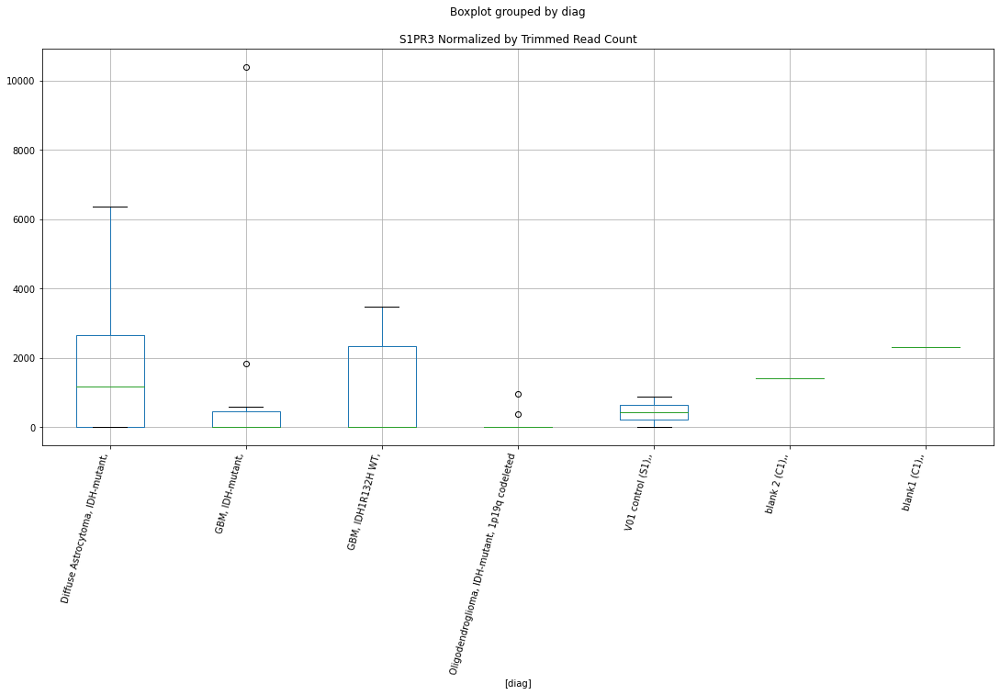

 p : 0.027233018440745504  ( t : 2.4034549740878055 ) :  Lexogen  :  cutadapt2  :  PIP5K1A
Control and blanks
82     0.0
346    0.0
Name: PIP5K1A, dtype: float64
214    0.0
Name: PIP5K1A, dtype: float64
478    0.0
Name: PIP5K1A, dtype: float64


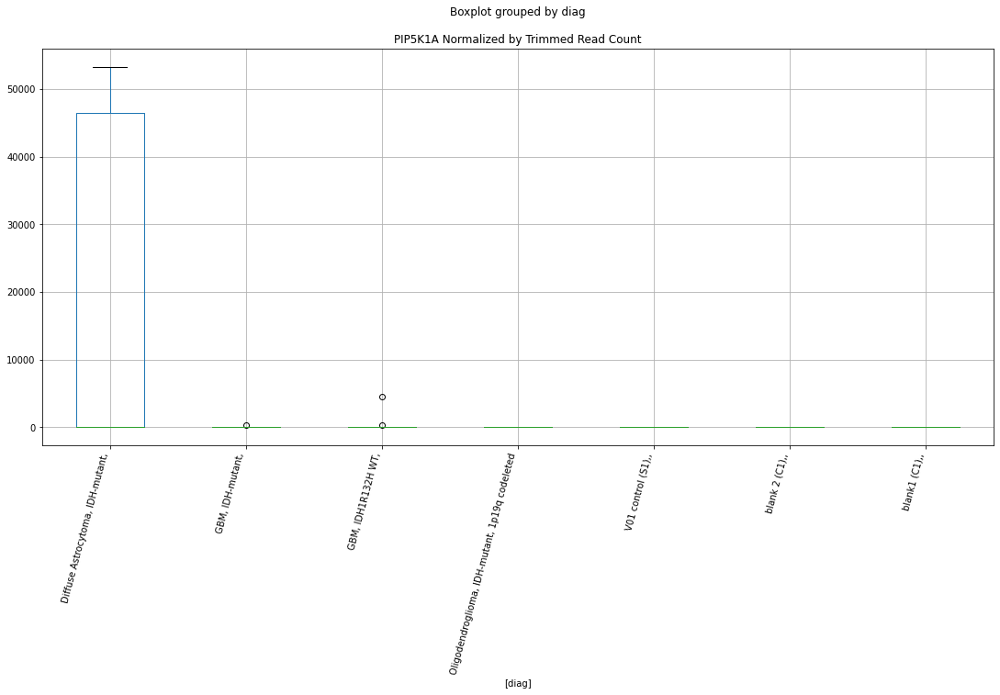

 p : 0.027261270359069018  ( t : 2.4029500115440894 ) :  Lexogen  :  bbduk2  :  SLC25A23
Control and blanks
79     0.0
343    0.0
Name: SLC25A23, dtype: float64
211    0.0
Name: SLC25A23, dtype: float64
475    0.0
Name: SLC25A23, dtype: float64


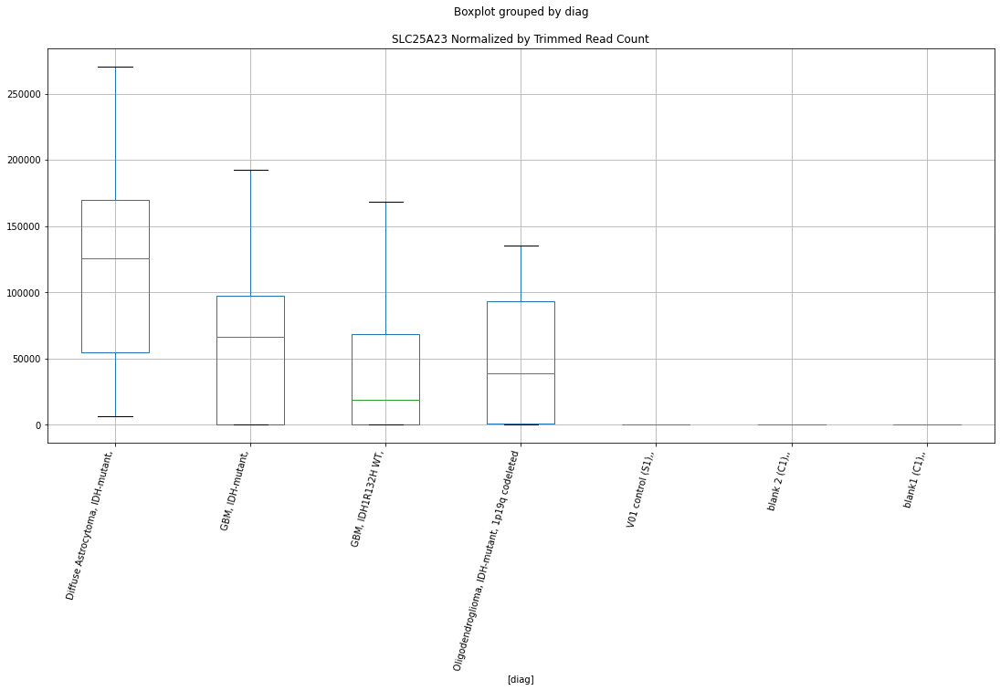

 p : 0.027329948998678584  ( t : 2.40172451739616 ) :  Lexogen  :  bbduk2  :  PMAIP1
Control and blanks
79     0.0
343    0.0
Name: PMAIP1, dtype: float64
211    3279.68
Name: PMAIP1, dtype: float64
475    0.0
Name: PMAIP1, dtype: float64


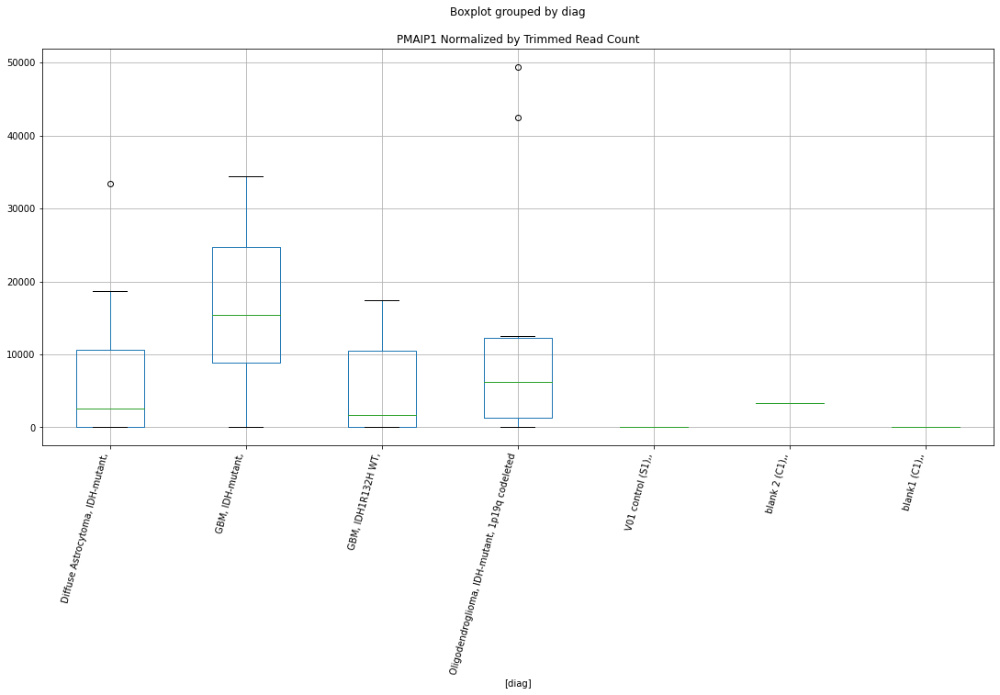

 p : 0.027397998975042546  ( t : 2.400513078323586 ) :  D-plex  :  cutadapt2  :  PHETA1
Control and blanks
76     0.0
340    0.0
Name: PHETA1, dtype: float64
208    4232.65
Name: PHETA1, dtype: float64
472    13870.94
Name: PHETA1, dtype: float64


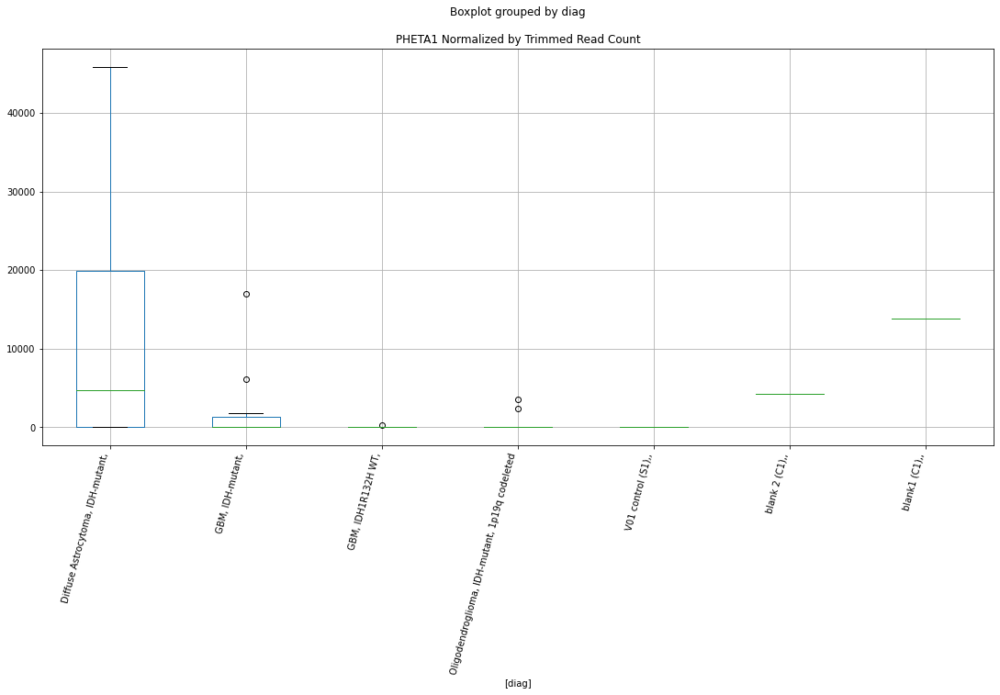

 p : 0.027425983724363112  ( t : 2.4000157045941344 ) :  D-plex  :  cutadapt2  :  PPP1R3E
Control and blanks
76     24243.65
340    39632.95
Name: PPP1R3E, dtype: float64
208    31392.12
Name: PPP1R3E, dtype: float64
472    29475.75
Name: PPP1R3E, dtype: float64


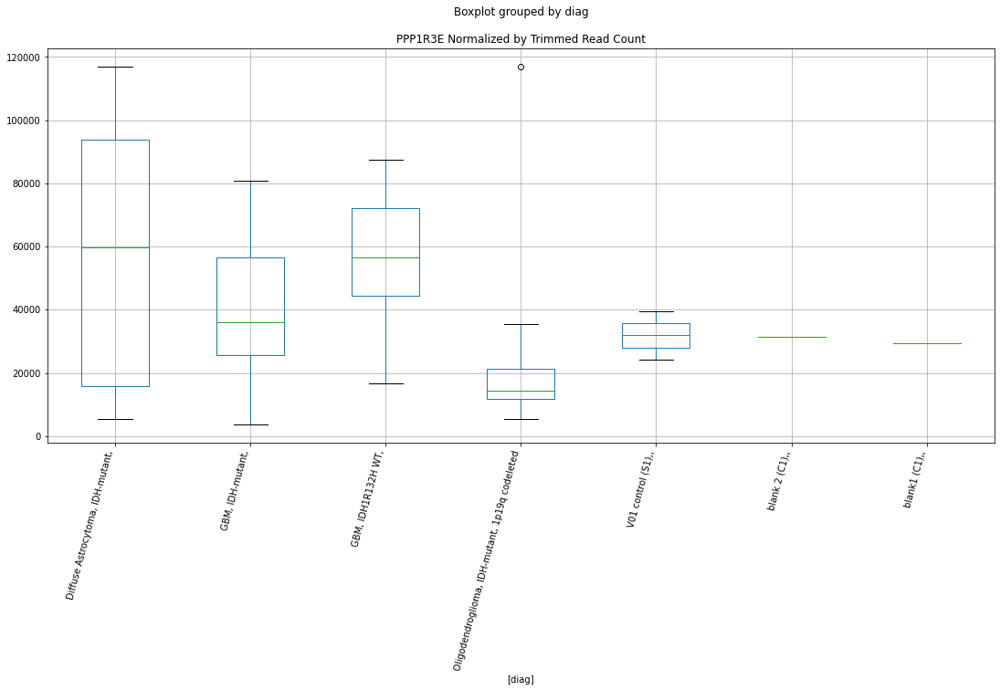

 p : 0.027463550877600145  ( t : 2.3993487681093453 ) :  Lexogen  :  cutadapt2  :  SLC25A23
Control and blanks
82     0.0
346    0.0
Name: SLC25A23, dtype: float64
214    0.0
Name: SLC25A23, dtype: float64
478    0.0
Name: SLC25A23, dtype: float64


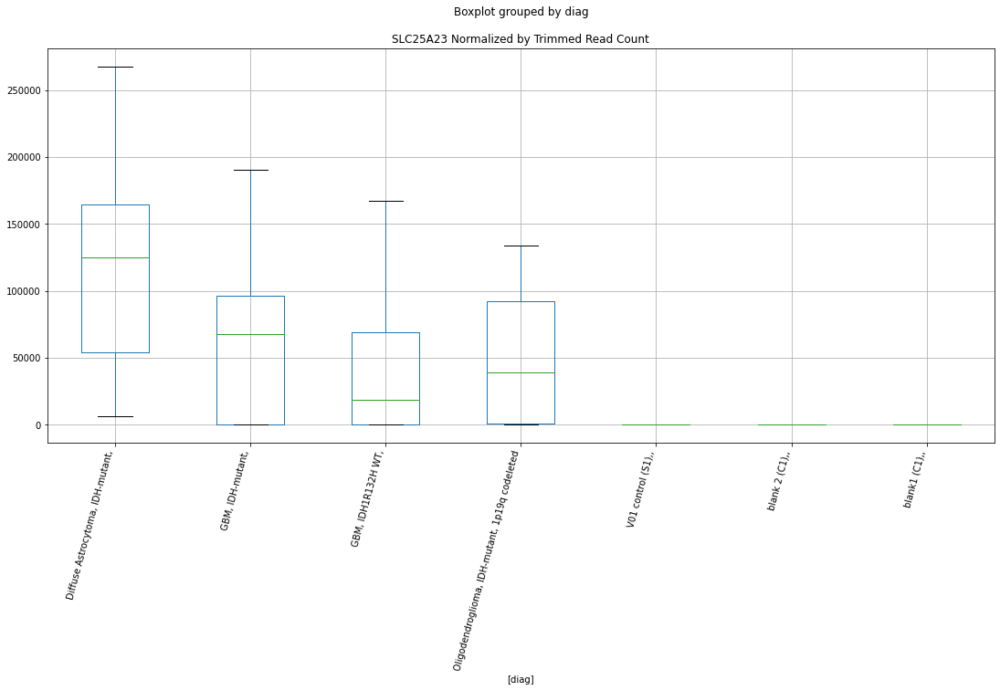

 p : 0.027581771617697596  ( t : 2.397255525421593 ) :  D-plex  :  cutadapt2  :  PHF8
Control and blanks
76     59093.91
340        0.00
Name: PHF8, dtype: float64
208    22397.75
Name: PHF8, dtype: float64
472    34677.35
Name: PHF8, dtype: float64


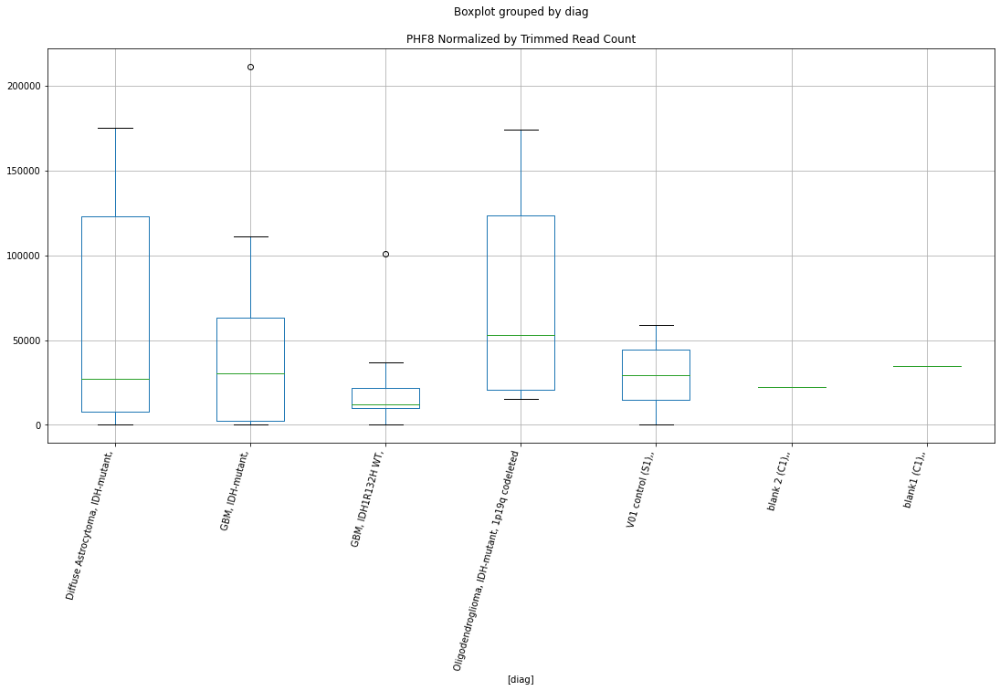

 p : 0.027590427154427347  ( t : 2.397102598291059 ) :  Lexogen  :  cutadapt2  :  SLC37A2
Control and blanks
82     0.0
346    0.0
Name: SLC37A2, dtype: float64
214    0.0
Name: SLC37A2, dtype: float64
478    0.0
Name: SLC37A2, dtype: float64


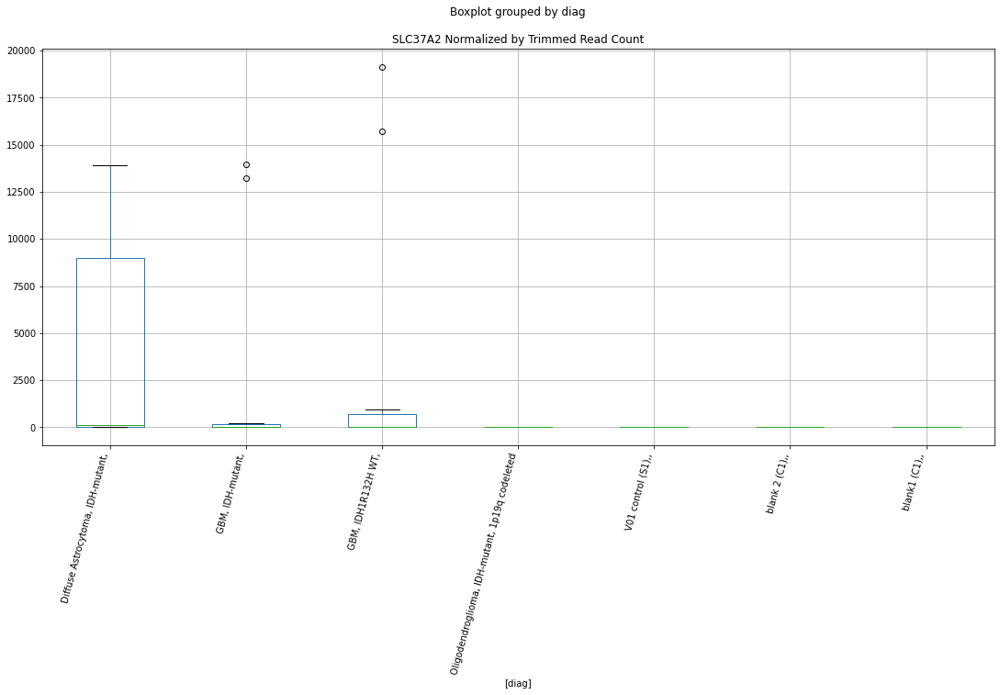

 p : 0.027717961311857272  ( t : 2.3948544918601655 ) :  Lexogen  :  cutadapt2  :  PMAIP1
Control and blanks
82     0.0
346    0.0
Name: PMAIP1, dtype: float64
214    3254.72
Name: PMAIP1, dtype: float64
478    0.0
Name: PMAIP1, dtype: float64


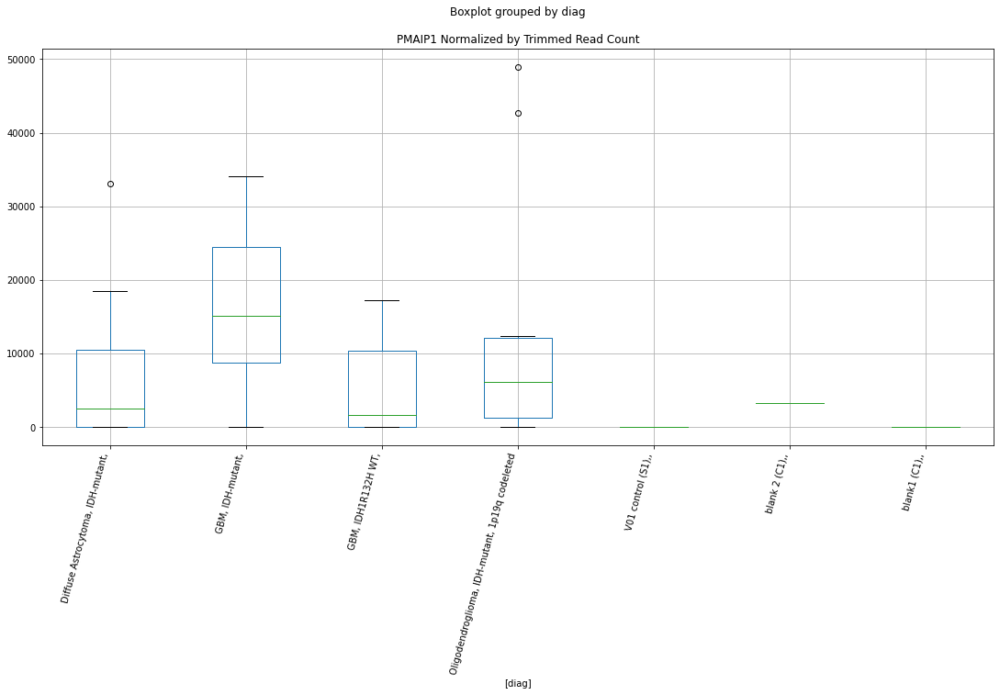

 p : 0.02774487296852693  ( t : 2.39438134262716 ) :  D-plex  :  bbduk2  :  SAMD10
Control and blanks
73     6184.07
337       0.00
Name: SAMD10, dtype: float64
205    5372.73
Name: SAMD10, dtype: float64
469    4732.22
Name: SAMD10, dtype: float64


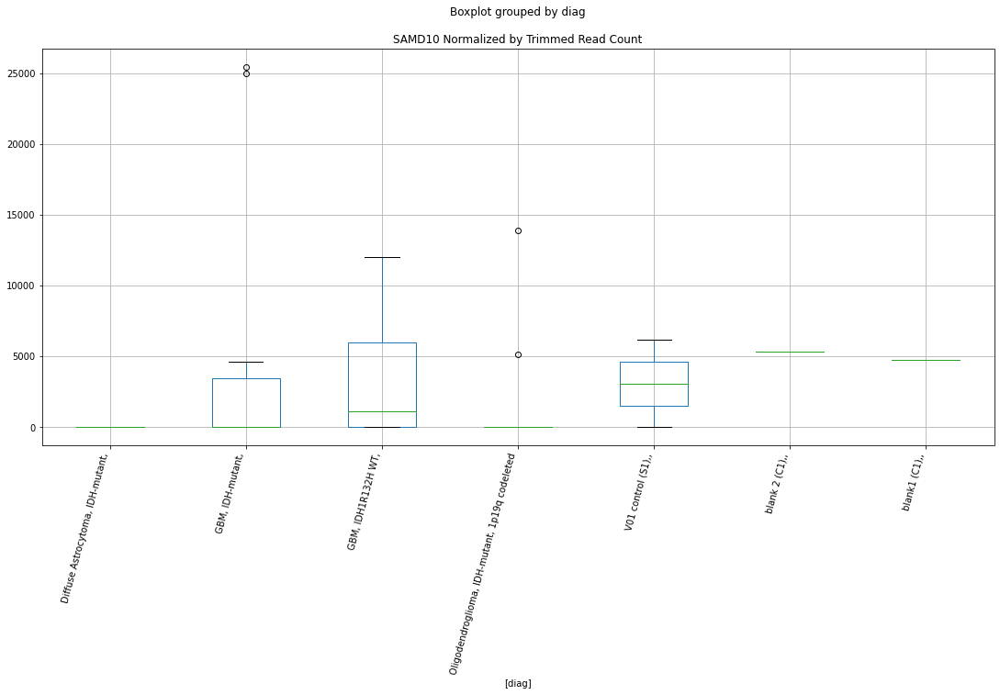

 p : 0.027791541329785615  ( t : 2.393561855397773 ) :  Lexogen  :  cutadapt2  :  PTPN14
Control and blanks
82     0.0
346    0.0
Name: PTPN14, dtype: float64
214    0.0
Name: PTPN14, dtype: float64
478    0.0
Name: PTPN14, dtype: float64


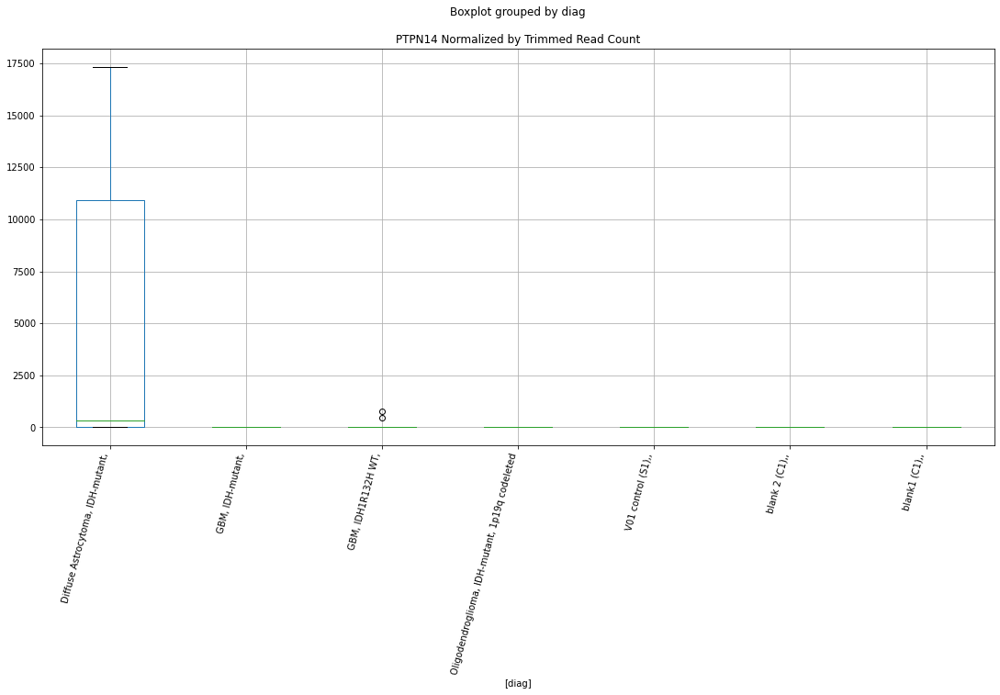

 p : 0.027825680965551162  ( t : 2.392963184235307 ) :  Lexogen  :  bbduk2  :  PIP5K1A
Control and blanks
79         0.00
343    14012.74
Name: PIP5K1A, dtype: float64
211    34709.9
Name: PIP5K1A, dtype: float64
475    11975.79
Name: PIP5K1A, dtype: float64


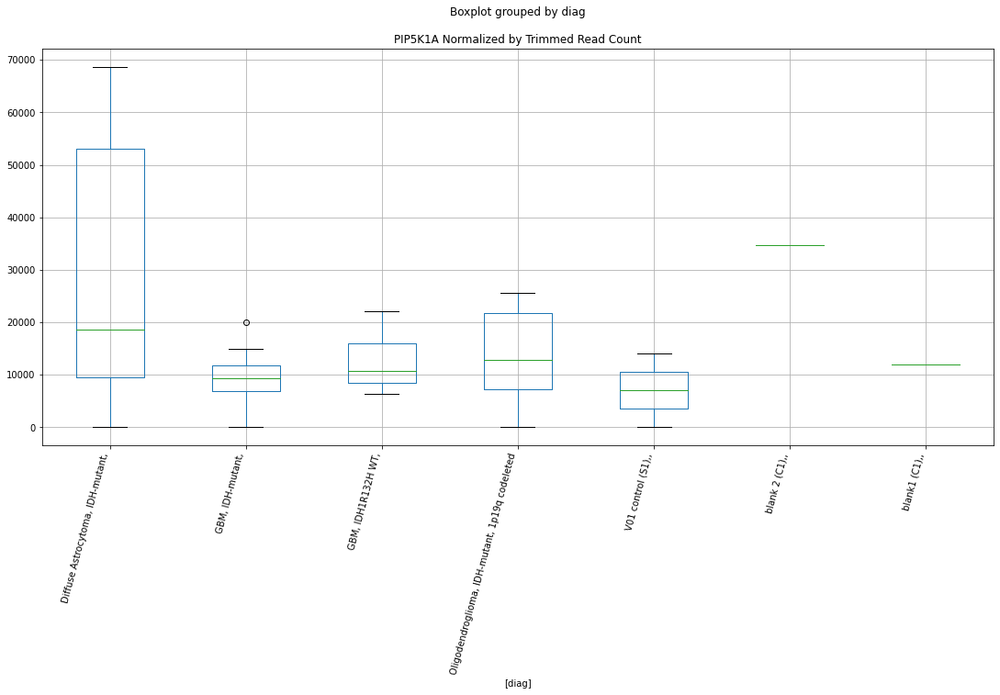

 p : 0.02784514760100571  ( t : 2.3926221253848867 ) :  D-plex  :  cutadapt2  :  SAMD10
Control and blanks
76     6060.91
340       0.00
Name: SAMD10, dtype: float64
208    4409.01
Name: SAMD10, dtype: float64
472    4623.65
Name: SAMD10, dtype: float64


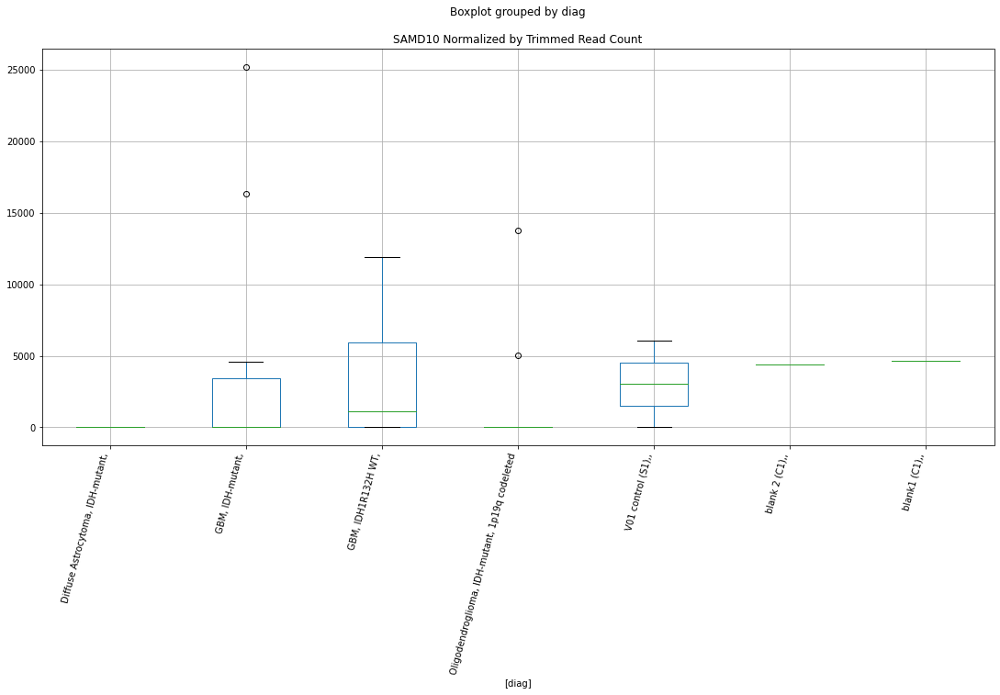

 p : 0.027913763467149123  ( t : 2.3914217376311724 ) :  D-plex  :  cutadapt2  :  PDE8A
Control and blanks
76     939441.62
340     17614.64
Name: PDE8A, dtype: float64
208    296814.25
Name: PDE8A, dtype: float64
472    468144.23
Name: PDE8A, dtype: float64


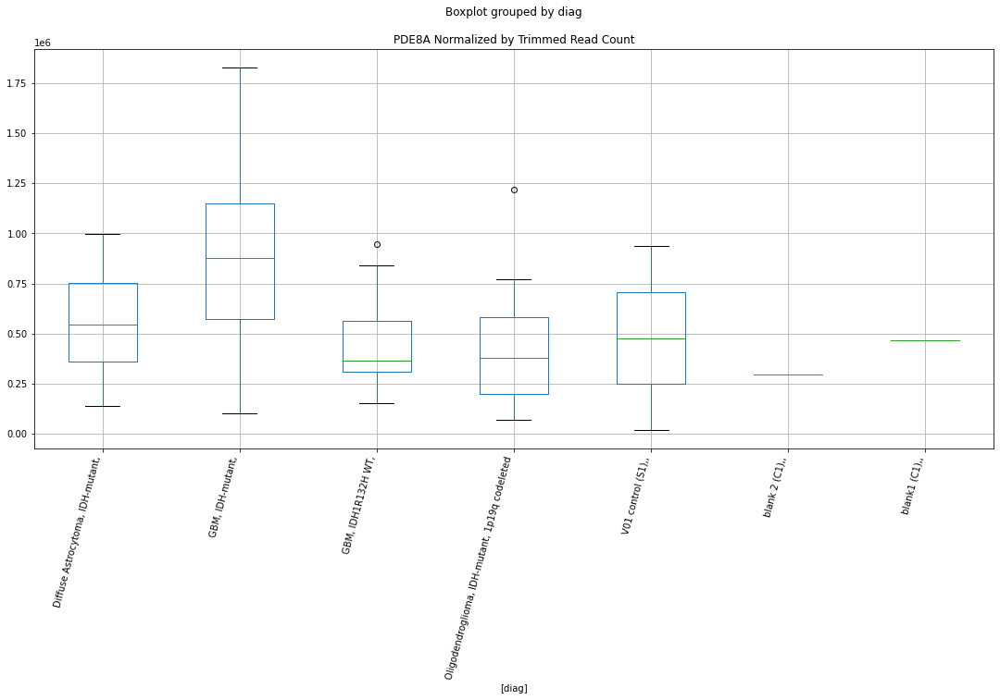

 p : 0.02797152756004879  ( t : 2.390413329890174 ) :  Lexogen  :  bbduk2  :  PTPN14
Control and blanks
79     1430.6
343       0.0
Name: PTPN14, dtype: float64
211    0.0
Name: PTPN14, dtype: float64
475    0.0
Name: PTPN14, dtype: float64


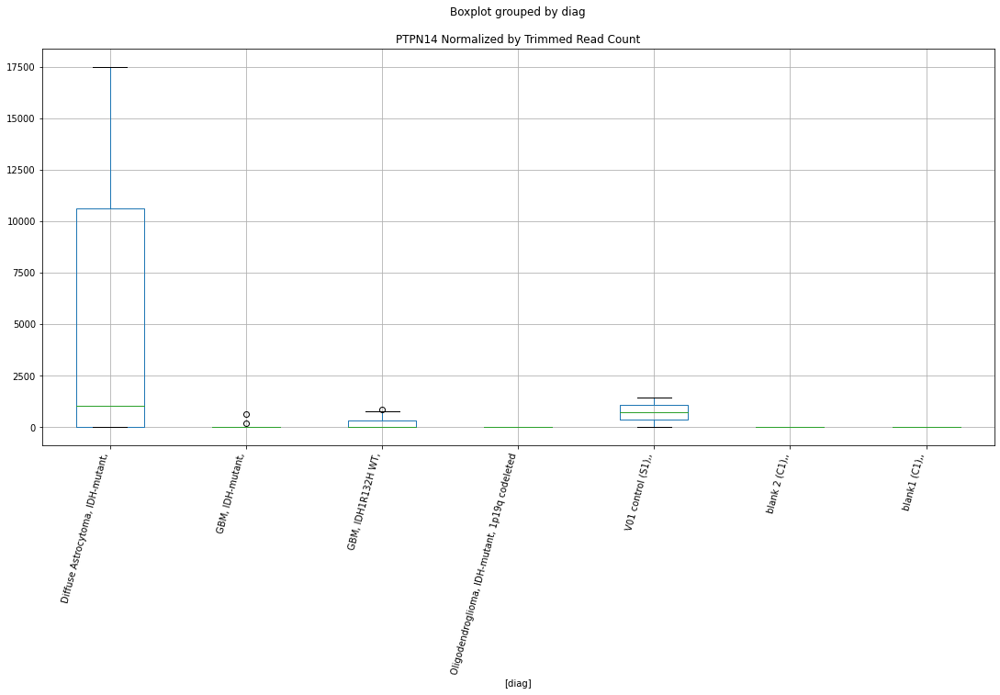

 p : 0.028032657191793785  ( t : 2.3893482856012276 ) :  D-plex  :  cutadapt2  :  SCTR
Control and blanks
76       0.00
340    880.73
Name: SCTR, dtype: float64
208    9876.17
Name: SCTR, dtype: float64
472    11559.12
Name: SCTR, dtype: float64


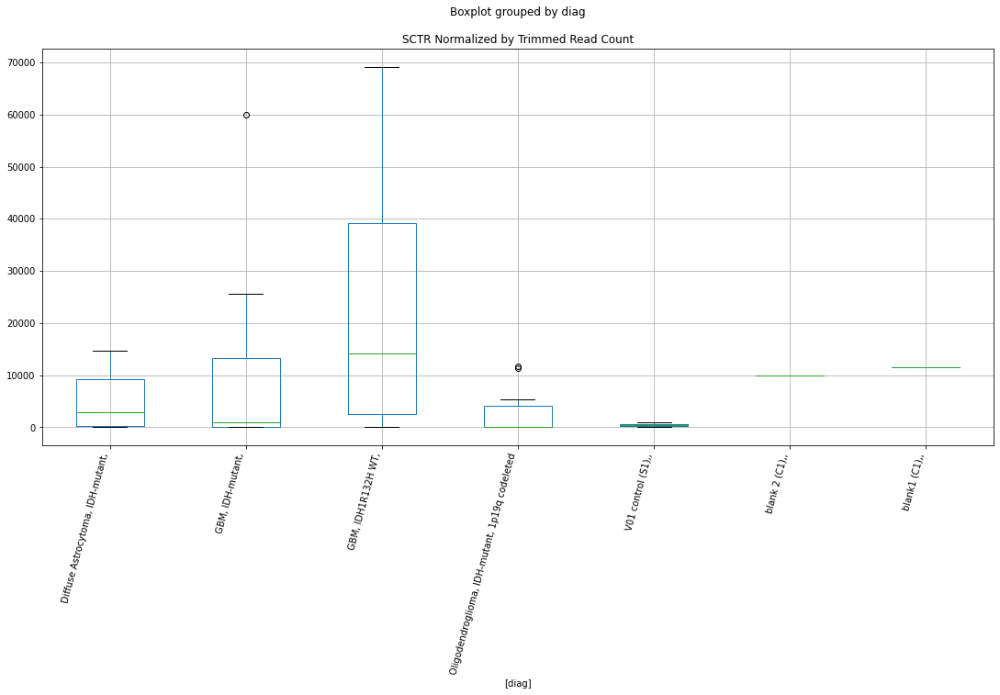

 p : 0.028055514718963896  ( t : 2.3889506026430967 ) :  D-plex  :  cutadapt2  :  RBM6
Control and blanks
76     757.61
340      0.00
Name: RBM6, dtype: float64
208    38093.81
Name: RBM6, dtype: float64
472    17916.63
Name: RBM6, dtype: float64


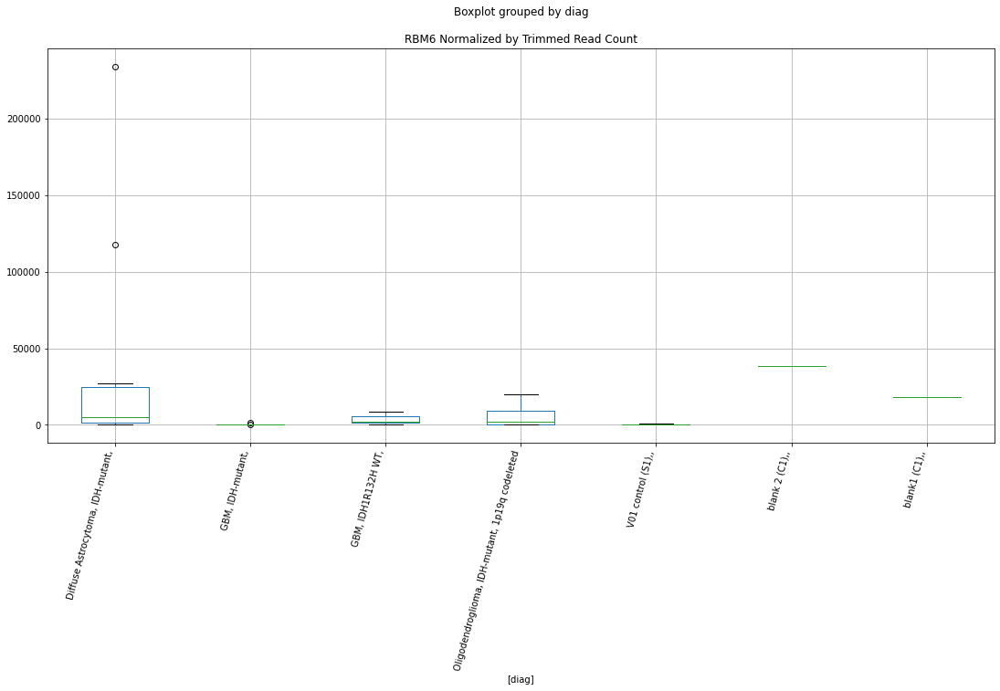

 p : 0.028061214632732874  ( t : 2.3888514807750845 ) :  D-plex  :  bbduk2  :  PDE8A
Control and blanks
73     943070.25
337     17803.15
Name: PDE8A, dtype: float64
205    301947.35
Name: PDE8A, dtype: float64
469    479137.13
Name: PDE8A, dtype: float64


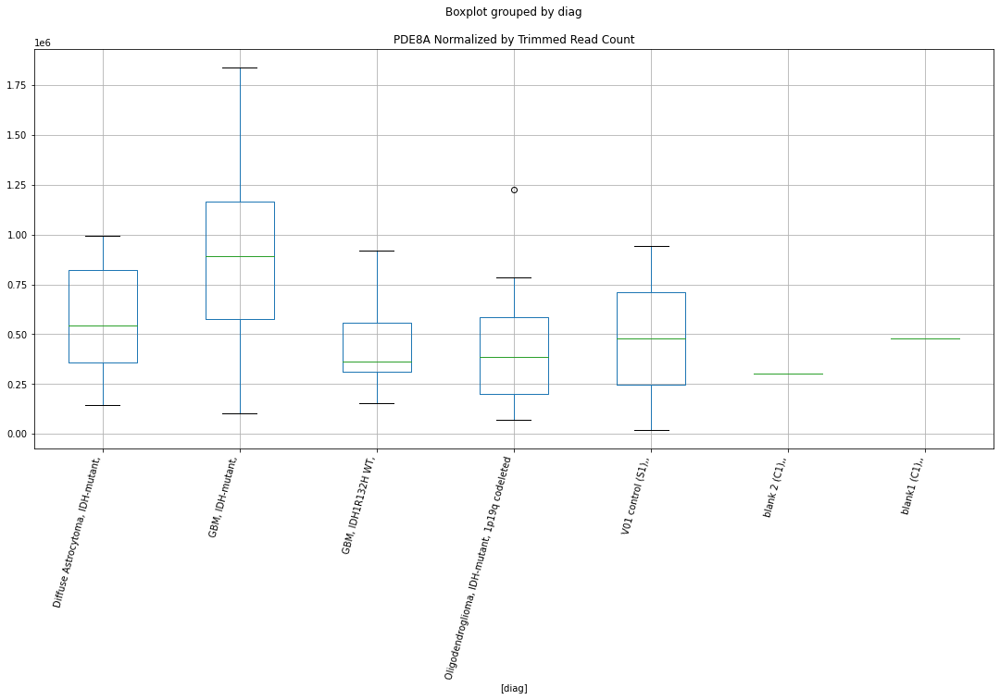

 p : 0.0281028782281372  ( t : 2.3881275188510362 ) :  D-plex  :  bbduk2  :  SLC25A33
Control and blanks
73     0.0
337    0.0
Name: SLC25A33, dtype: float64
205    1790.91
Name: SLC25A33, dtype: float64
469    0.0
Name: SLC25A33, dtype: float64


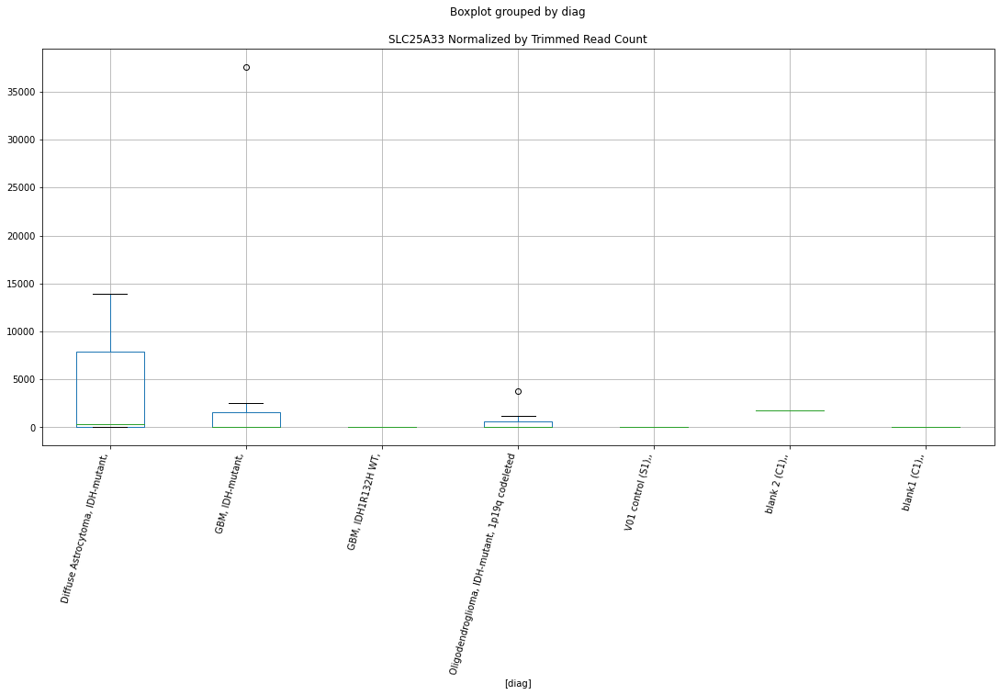

 p : 0.028160680963692317  ( t : 2.387124775944875 ) :  D-plex  :  bbduk2  :  RPA4
Control and blanks
73     1546.02
337       0.00
Name: RPA4, dtype: float64
205    358.18
Name: RPA4, dtype: float64
469    0.0
Name: RPA4, dtype: float64


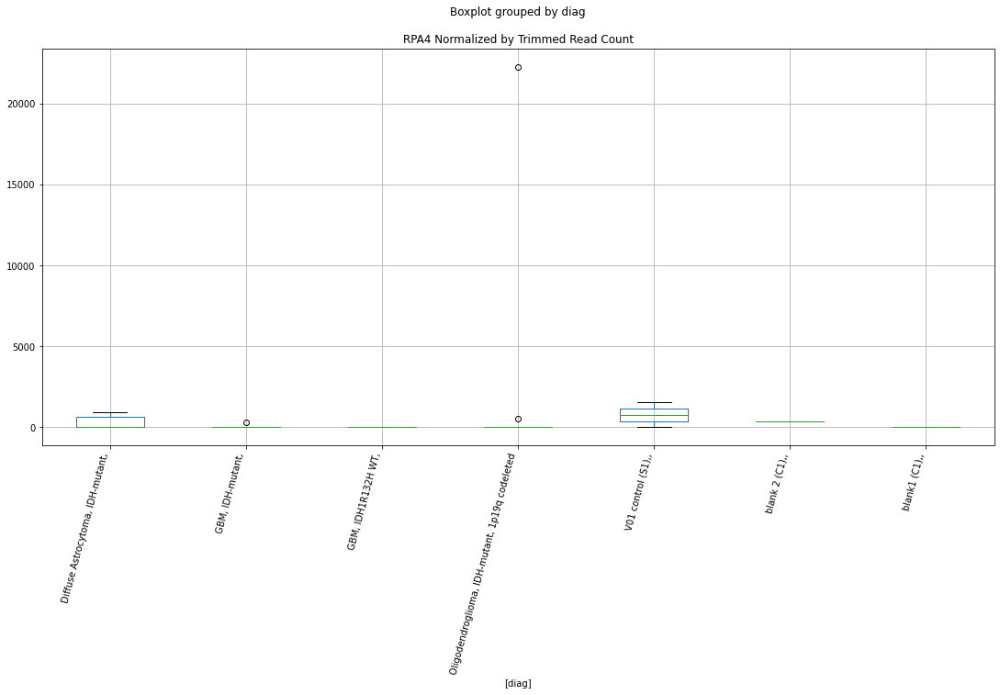

 p : 0.028379446338158944  ( t : 2.3833470313665077 ) :  Lexogen  :  cutadapt2  :  PSD3
Control and blanks
82        0.00
346    1683.48
Name: PSD3, dtype: float64
214    2169.81
Name: PSD3, dtype: float64
478    5699.05
Name: PSD3, dtype: float64


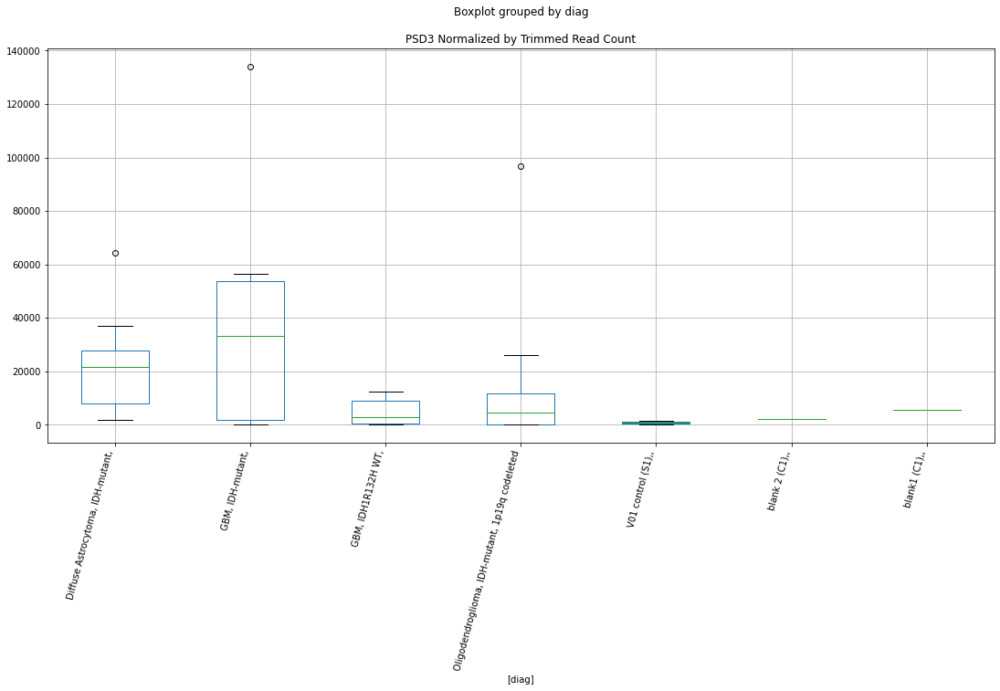

 p : 0.028459382640580424  ( t : 2.3819734340747547 ) :  D-plex  :  bbduk2  :  SCTR
Control and blanks
73     0.0
337    0.0
Name: SCTR, dtype: float64
205    10029.09
Name: SCTR, dtype: float64
469    11830.55
Name: SCTR, dtype: float64


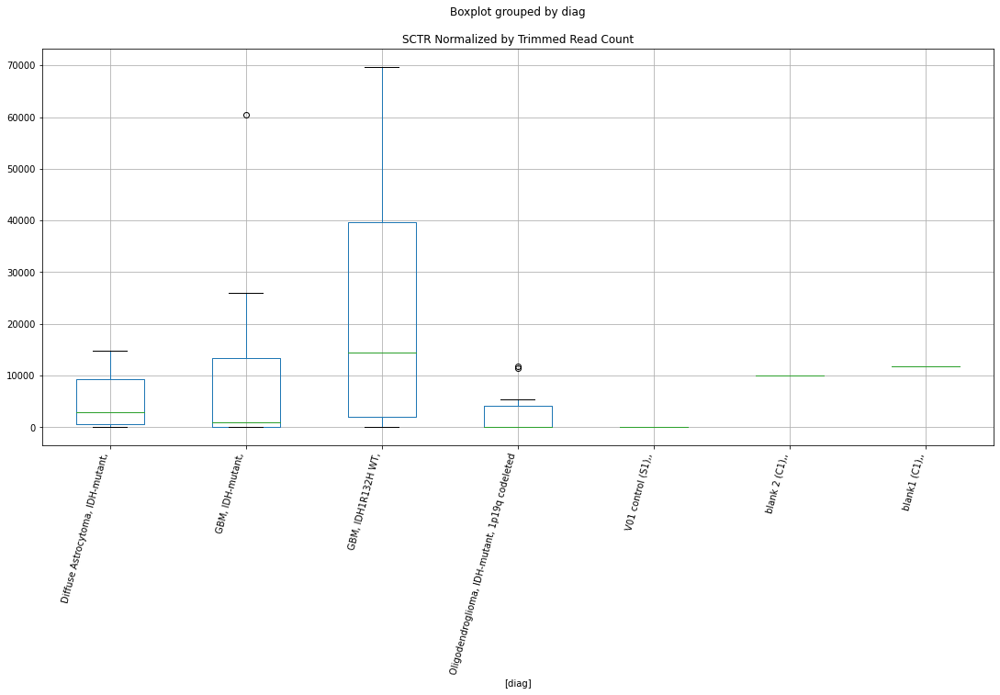

 p : 0.028465973425202507  ( t : 2.3818603411598174 ) :  Lexogen  :  cutadapt2  :  SORD
Control and blanks
82     0.0
346    0.0
Name: SORD, dtype: float64
214    0.0
Name: SORD, dtype: float64
478    0.0
Name: SORD, dtype: float64


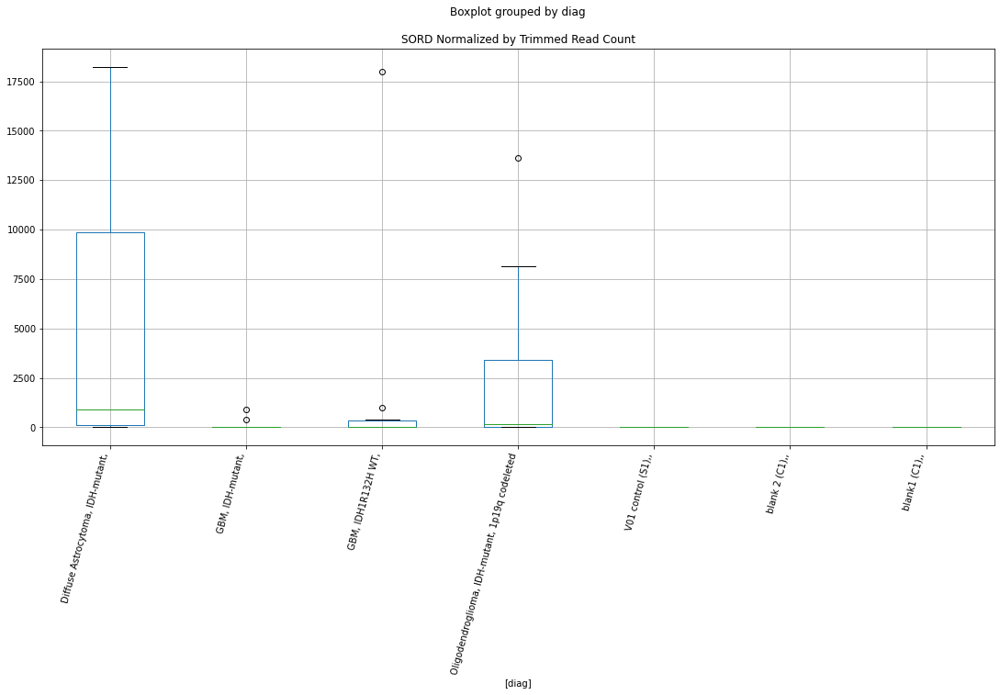

 p : 0.0284836432916706  ( t : 2.3815572601093296 ) :  D-plex  :  cutadapt2  :  SELENOKP3
Control and blanks
76     757.61
340    880.73
Name: SELENOKP3, dtype: float64
208    529.08
Name: SELENOKP3, dtype: float64
472    1155.91
Name: SELENOKP3, dtype: float64


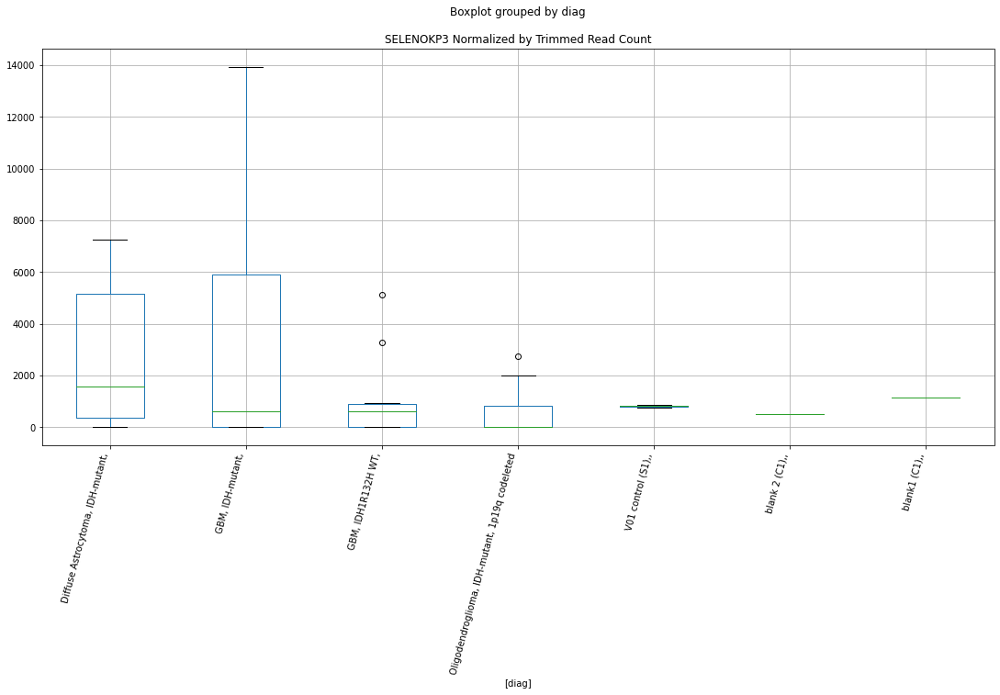

 p : 0.028554391555958368  ( t : 2.3803455116589998 ) :  D-plex  :  cutadapt2  :  PTPN11
Control and blanks
76      3788.07
340    81027.36
Name: PTPN11, dtype: float64
208    0.0
Name: PTPN11, dtype: float64
472    0.0
Name: PTPN11, dtype: float64


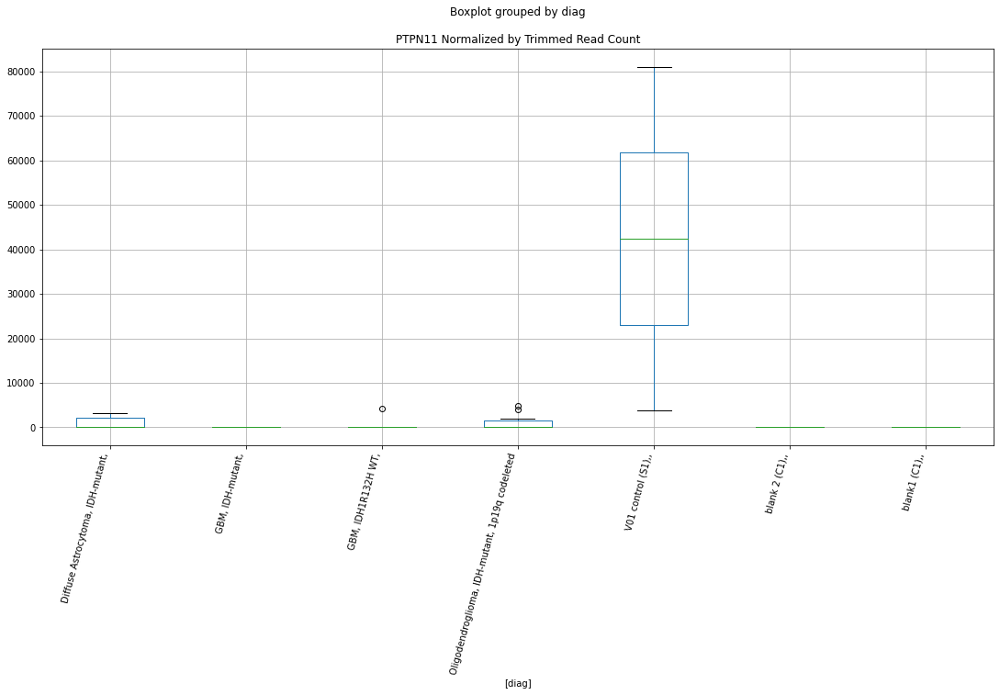

 p : 0.028740966979454916  ( t : 2.3771633119595004 ) :  Lexogen  :  bbduk2  :  RNF144A
Control and blanks
79       0.00
343    424.63
Name: RNF144A, dtype: float64
211    0.0
Name: RNF144A, dtype: float64
475    0.0
Name: RNF144A, dtype: float64


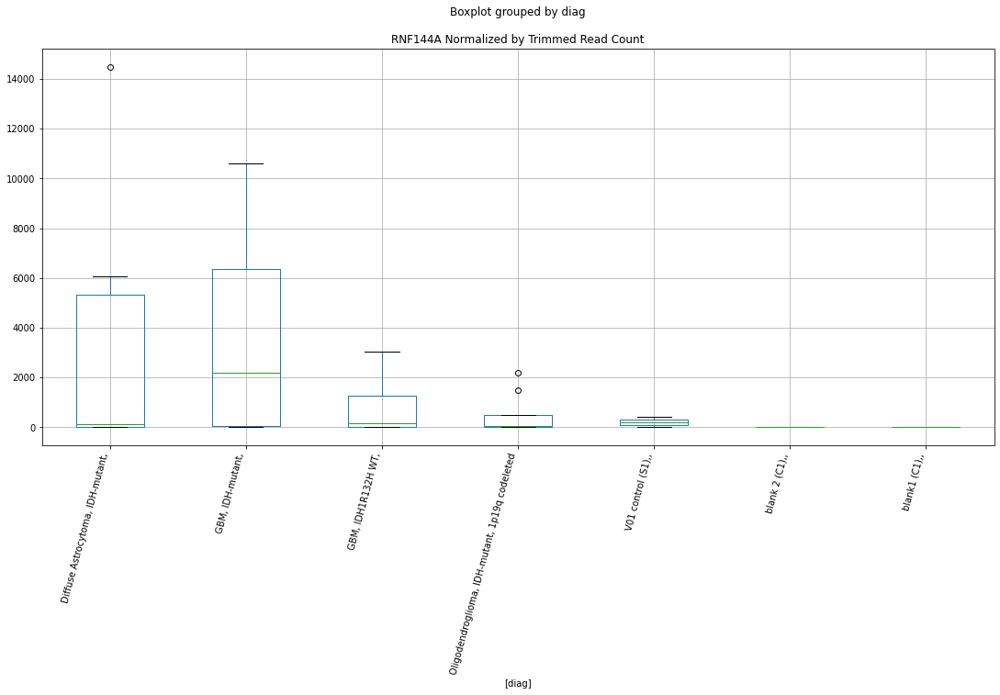

 p : 0.028757432210890436  ( t : 2.376883410277493 ) :  D-plex  :  cutadapt2  :  SLAMF1
Control and blanks
76     0.0
340    0.0
Name: SLAMF1, dtype: float64
208    7407.13
Name: SLAMF1, dtype: float64
472    20806.41
Name: SLAMF1, dtype: float64


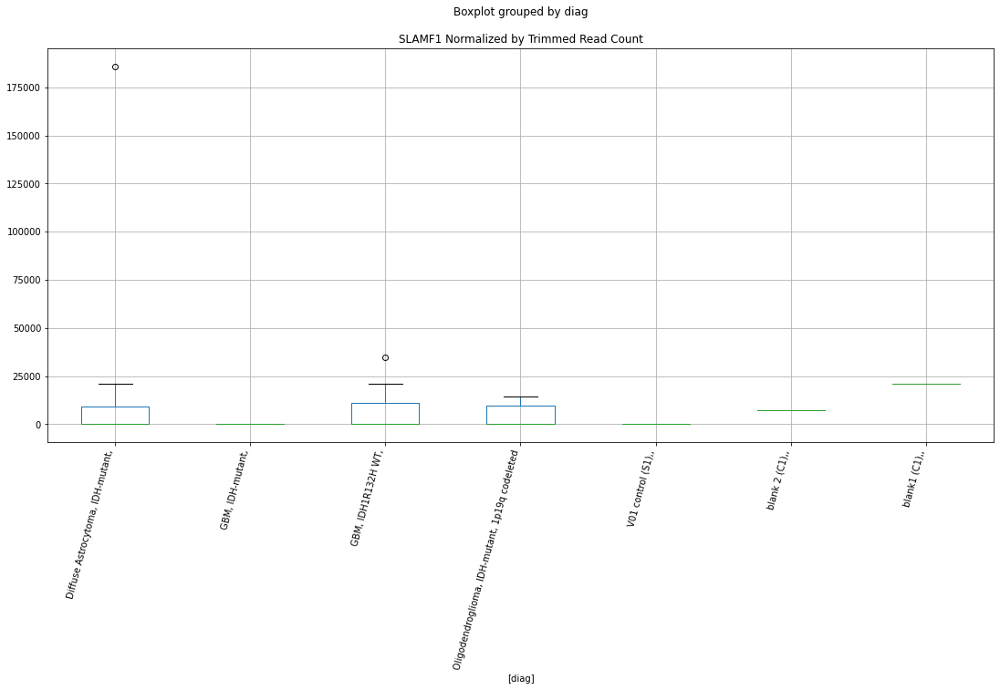

 p : 0.02884084273771376  ( t : 2.3754677619273816 ) :  D-plex  :  bbduk2  :  PRR16
Control and blanks
73     0.0
337    0.0
Name: PRR16, dtype: float64
205    1074.55
Name: PRR16, dtype: float64
469    5915.27
Name: PRR16, dtype: float64


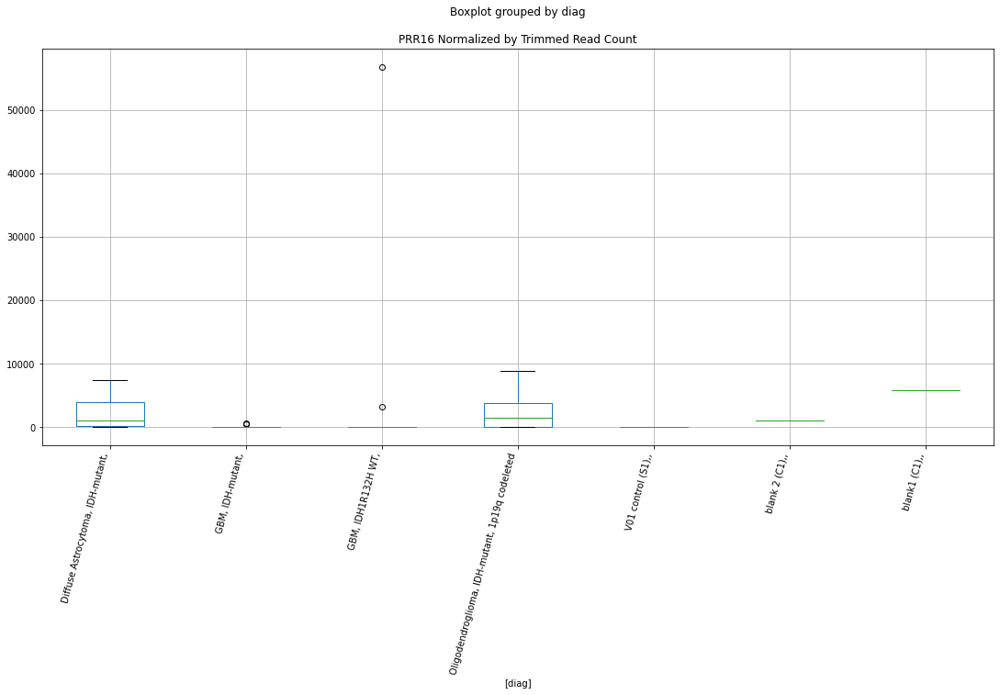

 p : 0.028847149197421297  ( t : 2.3753608837388724 ) :  D-plex  :  cutadapt2  :  SCHIP1
Control and blanks
76     109096.45
340         0.00
Name: SCHIP1, dtype: float64
208    2116.32
Name: SCHIP1, dtype: float64
472    6935.47
Name: SCHIP1, dtype: float64


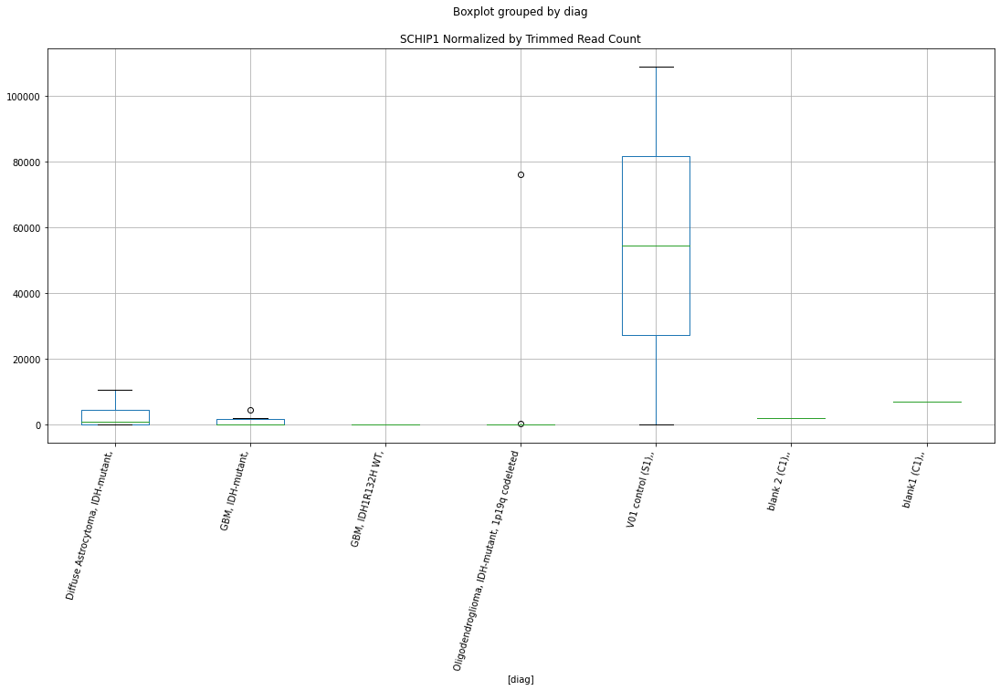

 p : 0.028857835597743995  ( t : 2.3751798266463418 ) :  Lexogen  :  bbduk2  :  SOST
Control and blanks
79     0.0
343    0.0
Name: SOST, dtype: float64
211    0.0
Name: SOST, dtype: float64
475    239.52
Name: SOST, dtype: float64


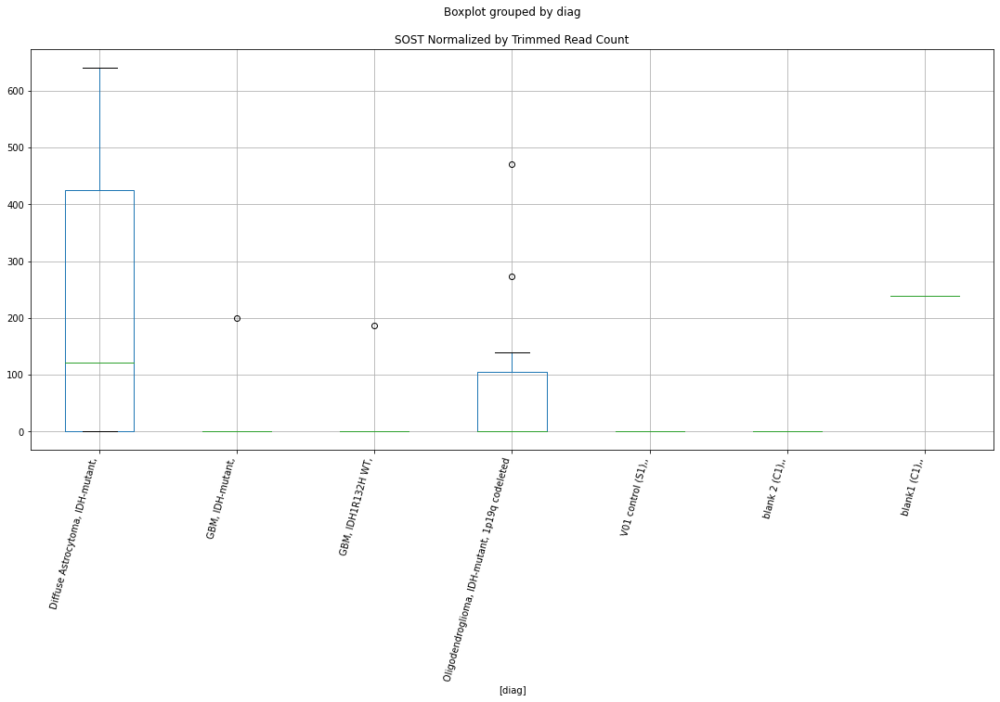

 p : 0.028995733625313744  ( t : 2.372849049250598 ) :  D-plex  :  bbduk2  :  SLC9A9-AS1
Control and blanks
73     57202.62
337      890.16
Name: SLC9A9-AS1, dtype: float64
205    895.45
Name: SLC9A9-AS1, dtype: float64
469    0.0
Name: SLC9A9-AS1, dtype: float64


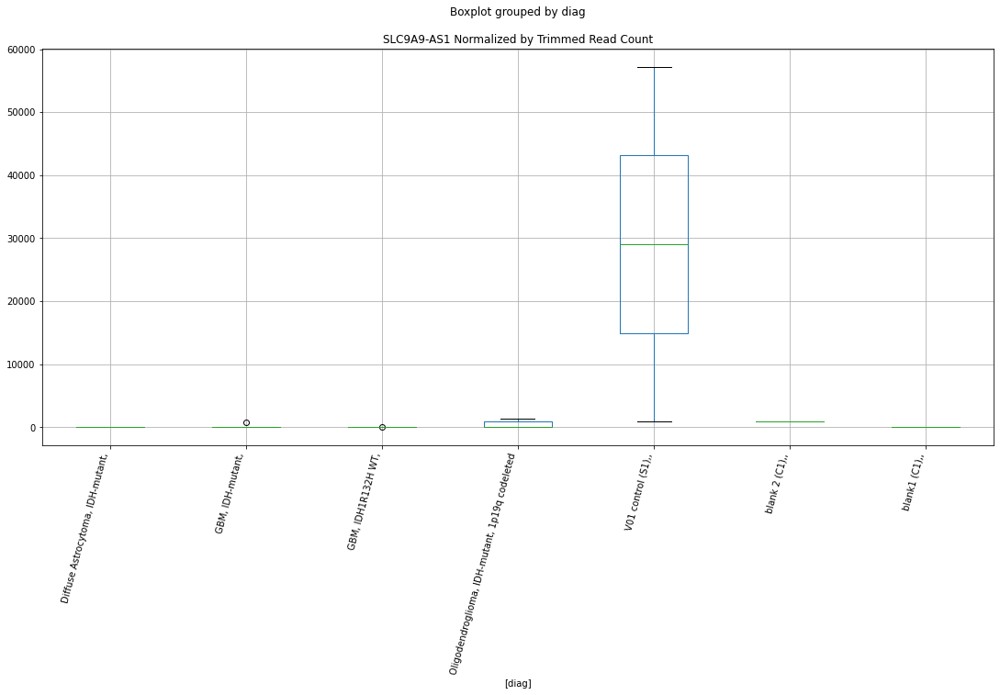

 p : 0.029036936149488678  ( t : 2.3721546433029728 ) :  D-plex  :  cutadapt2  :  SLC9A9-AS1
Control and blanks
76     56063.45
340      880.73
Name: SLC9A9-AS1, dtype: float64
208    881.8
Name: SLC9A9-AS1, dtype: float64
472    0.0
Name: SLC9A9-AS1, dtype: float64


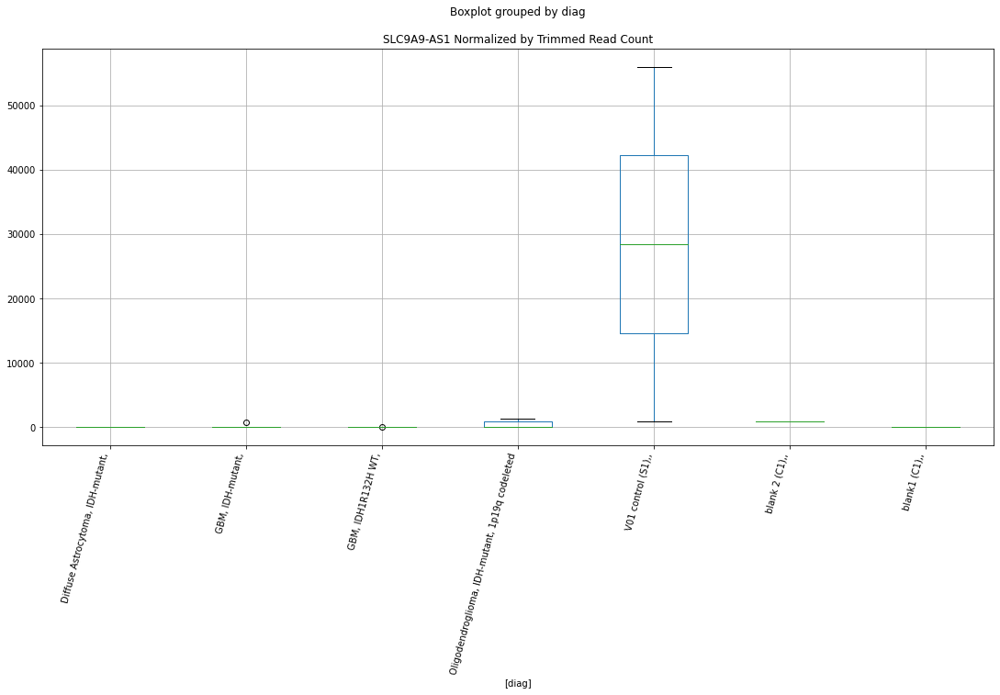

 p : 0.029053067435255667  ( t : 2.3718830253614587 ) :  D-plex  :  bbduk2  :  RAB4B
Control and blanks
73     76527.83
337     8011.42
Name: RAB4B, dtype: float64
205    73606.38
Name: RAB4B, dtype: float64
469    49688.29
Name: RAB4B, dtype: float64


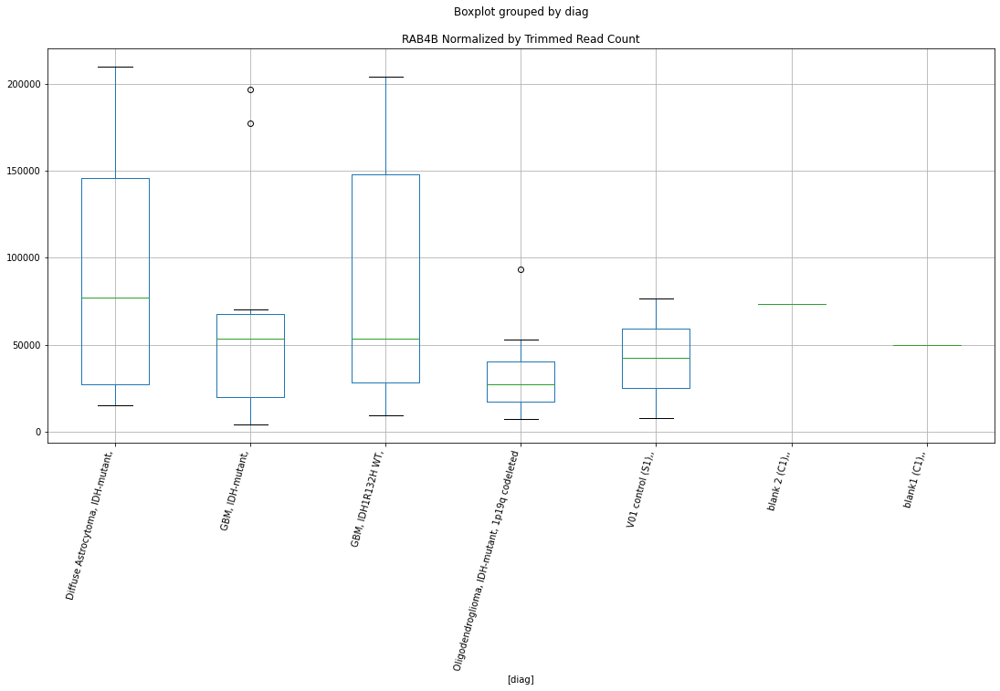

 p : 0.02917348253728037  ( t : 2.369859913953244 ) :  D-plex  :  cutadapt2  :  PRR7
Control and blanks
76     0.0
340    0.0
Name: PRR7, dtype: float64
208    1058.16
Name: PRR7, dtype: float64
472    4623.65
Name: PRR7, dtype: float64


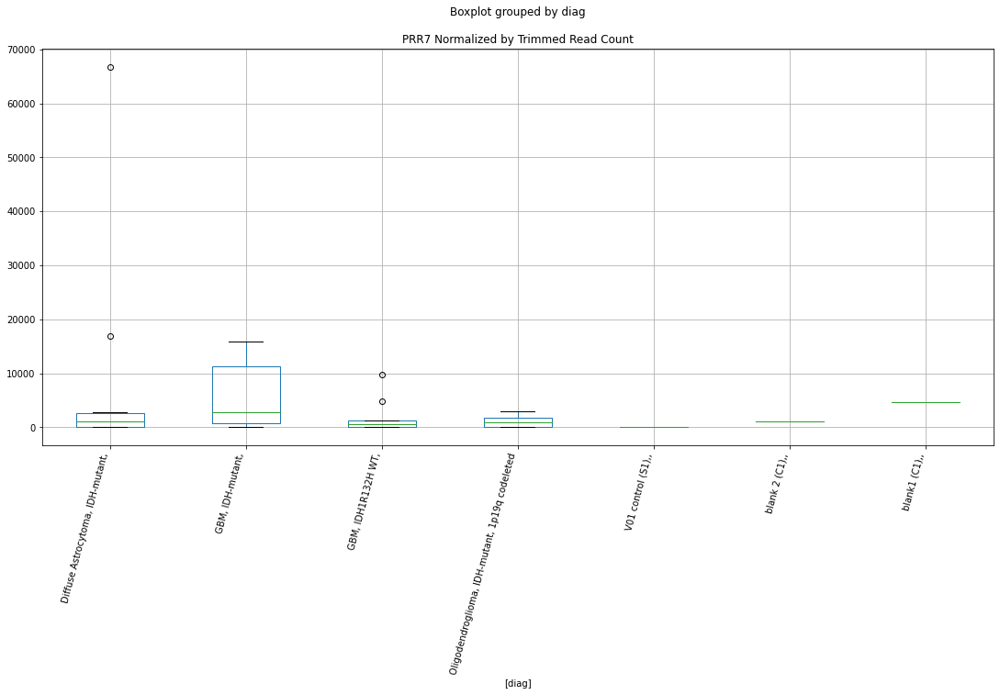

 p : 0.029229847931369537  ( t : 2.368915585823768 ) :  Lexogen  :  cutadapt2  :  RFC2
Control and blanks
82     12780.46
346        0.00
Name: RFC2, dtype: float64
214    0.0
Name: RFC2, dtype: float64
478    72662.91
Name: RFC2, dtype: float64


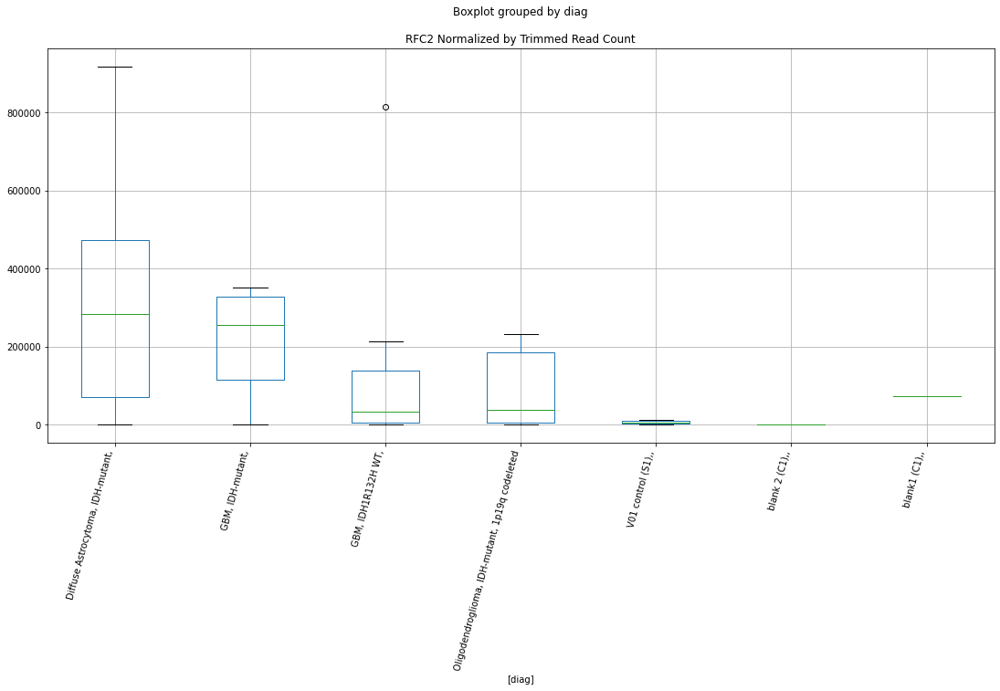

 p : 0.029261403968695598  ( t : 2.368387647191495 ) :  D-plex  :  cutadapt2  :  SAMD15
Control and blanks
76     1515.23
340       0.00
Name: SAMD15, dtype: float64
208    7230.77
Name: SAMD15, dtype: float64
472    9247.29
Name: SAMD15, dtype: float64


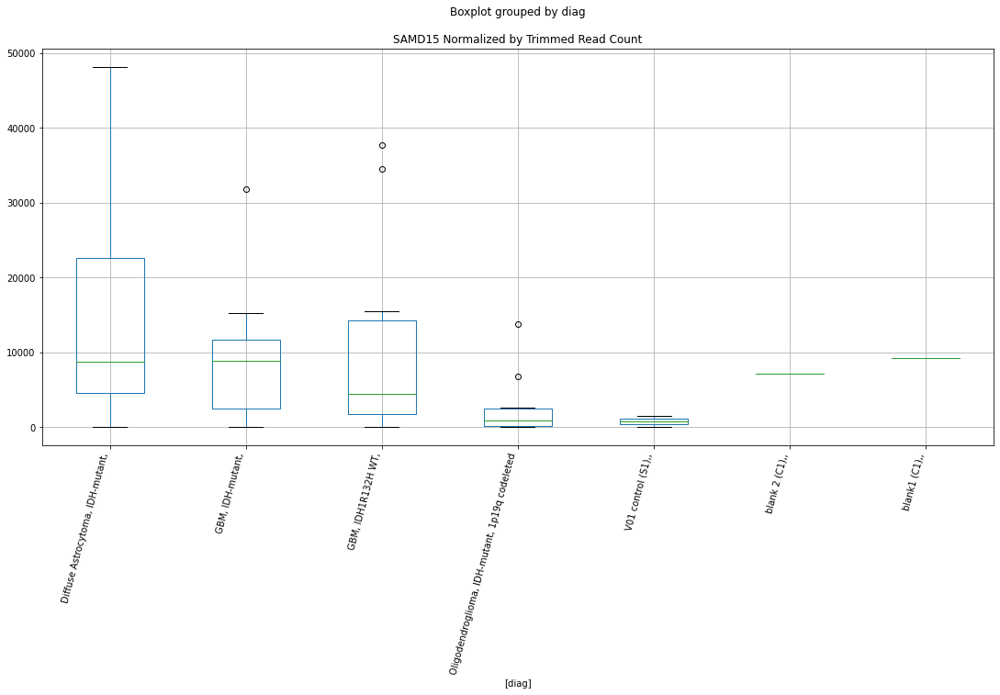

 p : 0.029317234934472046  ( t : 2.367454883697151 ) :  D-plex  :  cutadapt2  :  RMND5A
Control and blanks
76         0.00
340    17614.64
Name: RMND5A, dtype: float64
208    1058.16
Name: RMND5A, dtype: float64
472    577.96
Name: RMND5A, dtype: float64


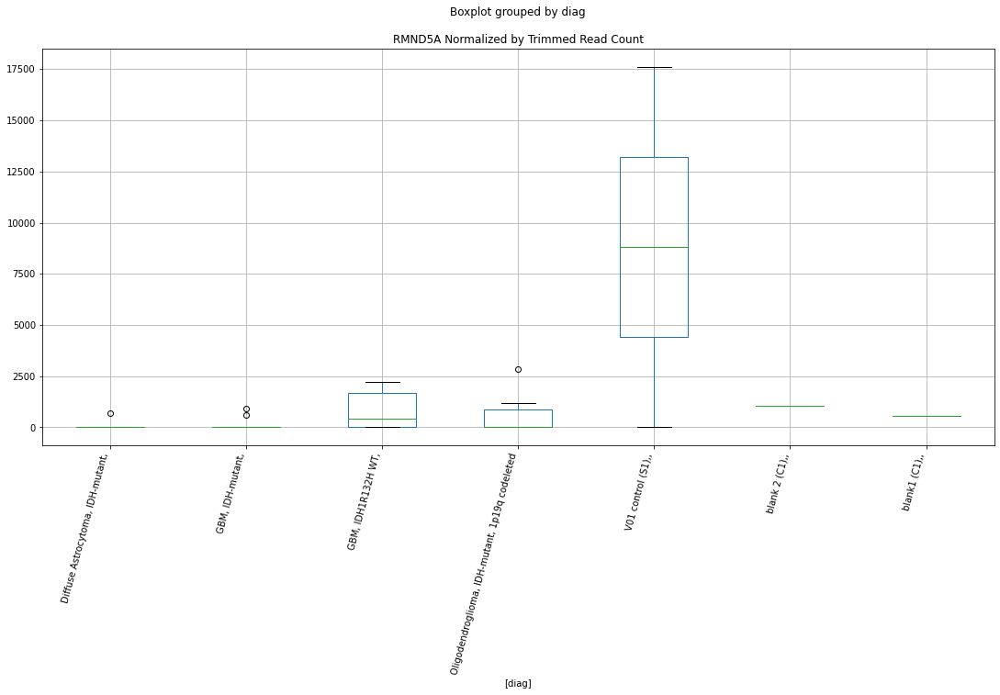

 p : 0.029322204537446737  ( t : 2.3673719372429054 ) :  D-plex  :  bbduk2  :  POU6F2
Control and blanks
73     0.0
337    0.0
Name: POU6F2, dtype: float64
205    3223.64
Name: POU6F2, dtype: float64
469    0.0
Name: POU6F2, dtype: float64


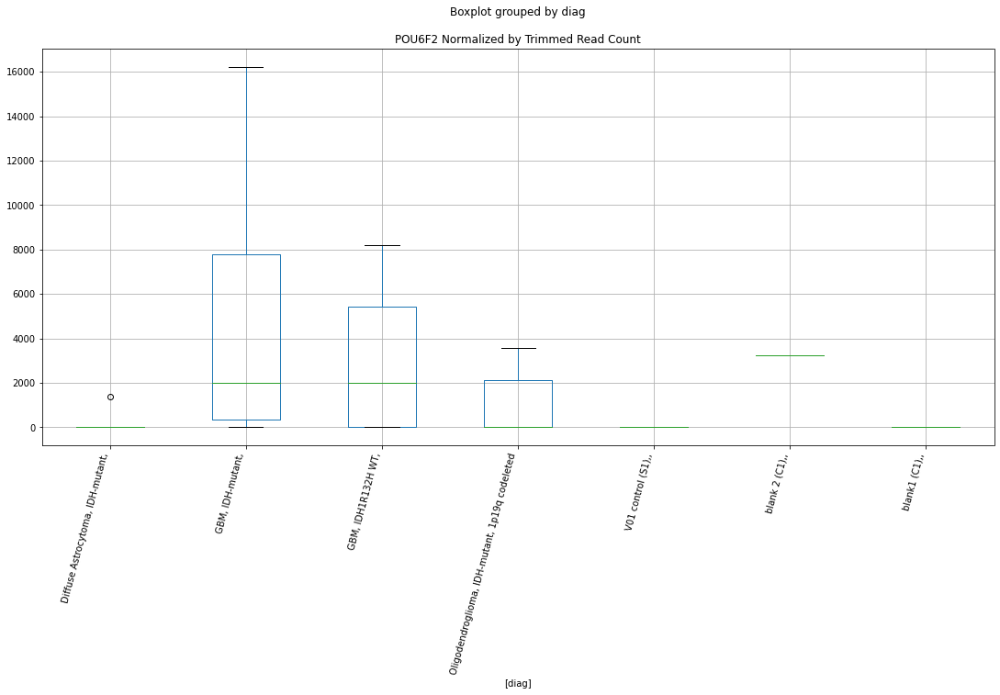

 p : 0.029360019094414557  ( t : 2.366741212564086 ) :  D-plex  :  bbduk2  :  RASL10A
Control and blanks
73     0.0
337    0.0
Name: RASL10A, dtype: float64
205    358.18
Name: RASL10A, dtype: float64
469    2366.11
Name: RASL10A, dtype: float64


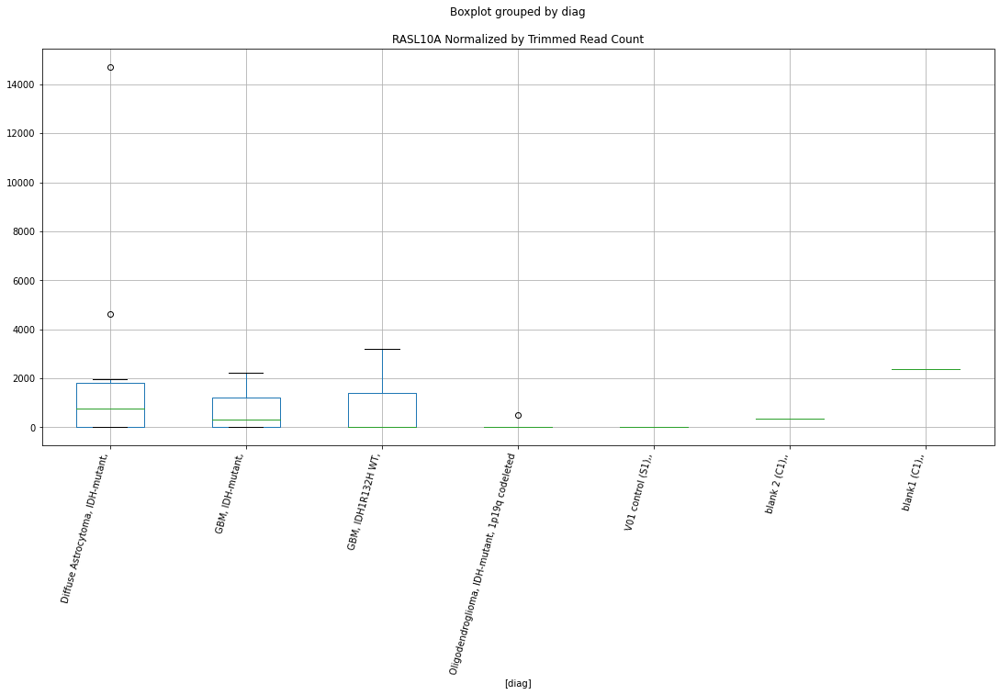

 p : 0.0293647937647958  ( t : 2.3666616277256978 ) :  Lexogen  :  cutadapt2  :  PLXNB3
Control and blanks
82     0.0
346    0.0
Name: PLXNB3, dtype: float64
214    0.0
Name: PLXNB3, dtype: float64
478    0.0
Name: PLXNB3, dtype: float64


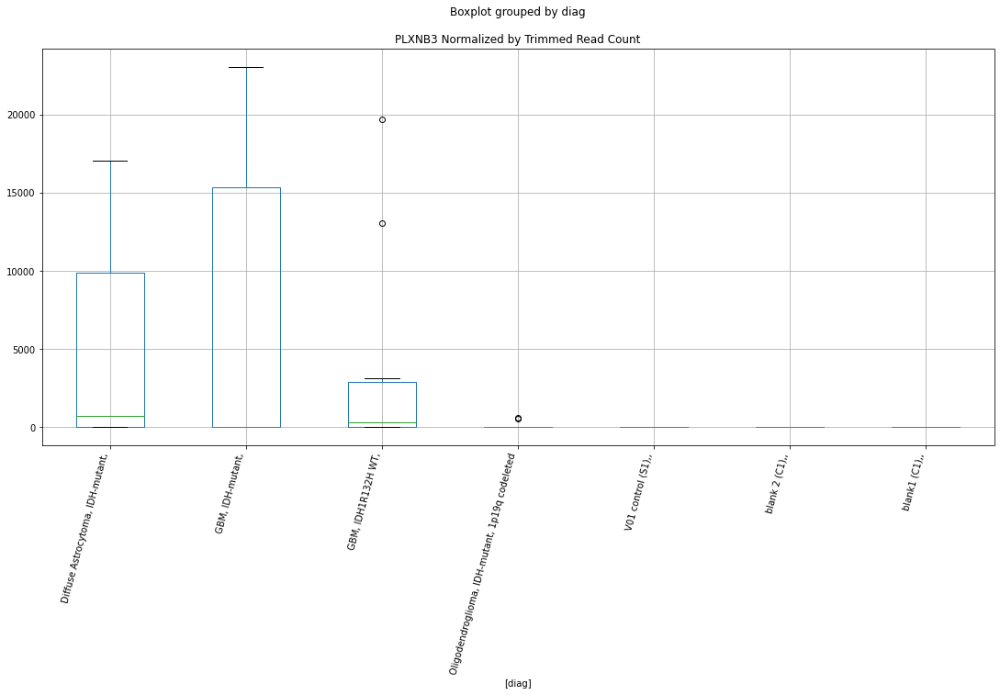

 p : 0.029404598540089713  ( t : 2.3659986256659735 ) :  Lexogen  :  bbduk2  :  RFC2
Control and blanks
79     12875.39
343        0.00
Name: RFC2, dtype: float64
211    0.0
Name: RFC2, dtype: float64
475    71136.17
Name: RFC2, dtype: float64


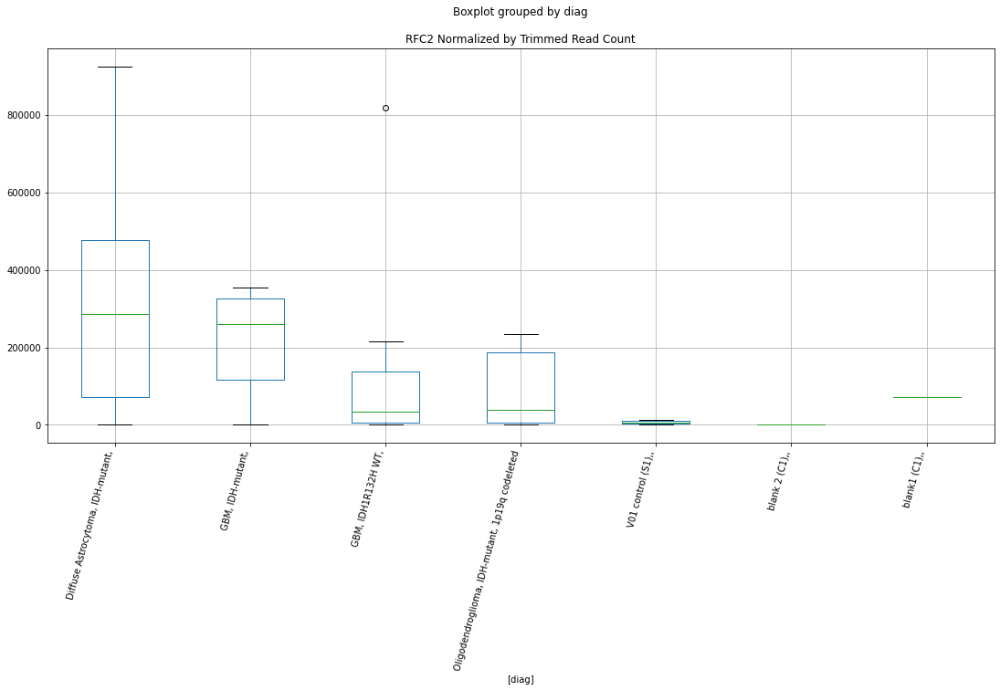

 p : 0.029415496143706265  ( t : 2.3658172573433798 ) :  D-plex  :  bbduk2  :  RAB4B-EGLN2
Control and blanks
73     76527.83
337     8011.42
Name: RAB4B-EGLN2, dtype: float64
205    73606.38
Name: RAB4B-EGLN2, dtype: float64
469    50871.35
Name: RAB4B-EGLN2, dtype: float64


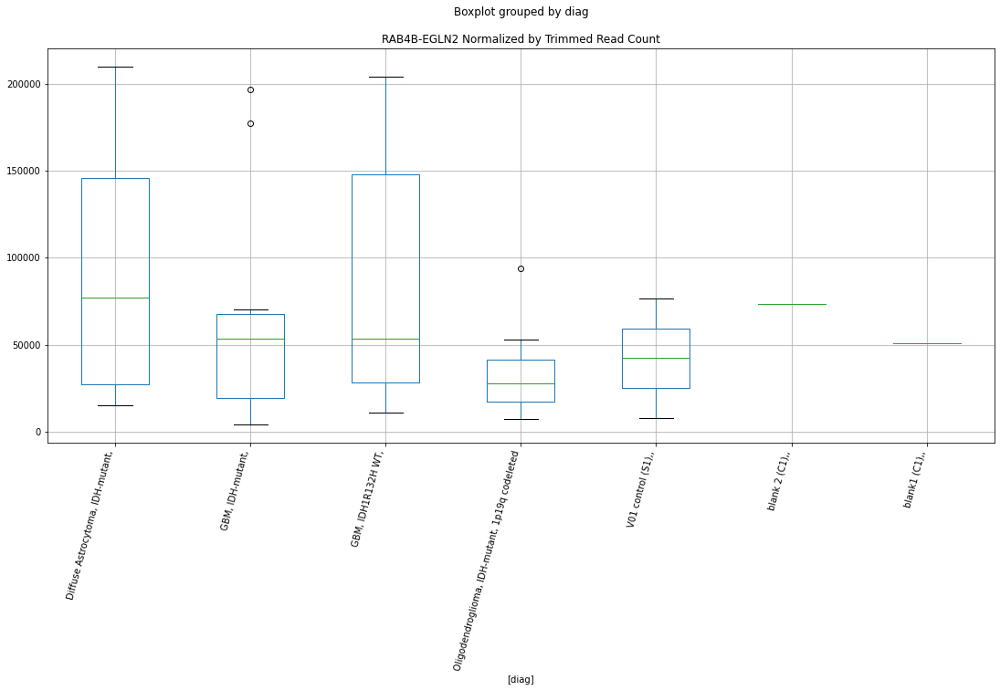

 p : 0.029428809105725595  ( t : 2.3655957753193757 ) :  D-plex  :  bbduk2  :  REPS2
Control and blanks
73     0.0
337    0.0
Name: REPS2, dtype: float64
205    4298.18
Name: REPS2, dtype: float64
469    7098.33
Name: REPS2, dtype: float64


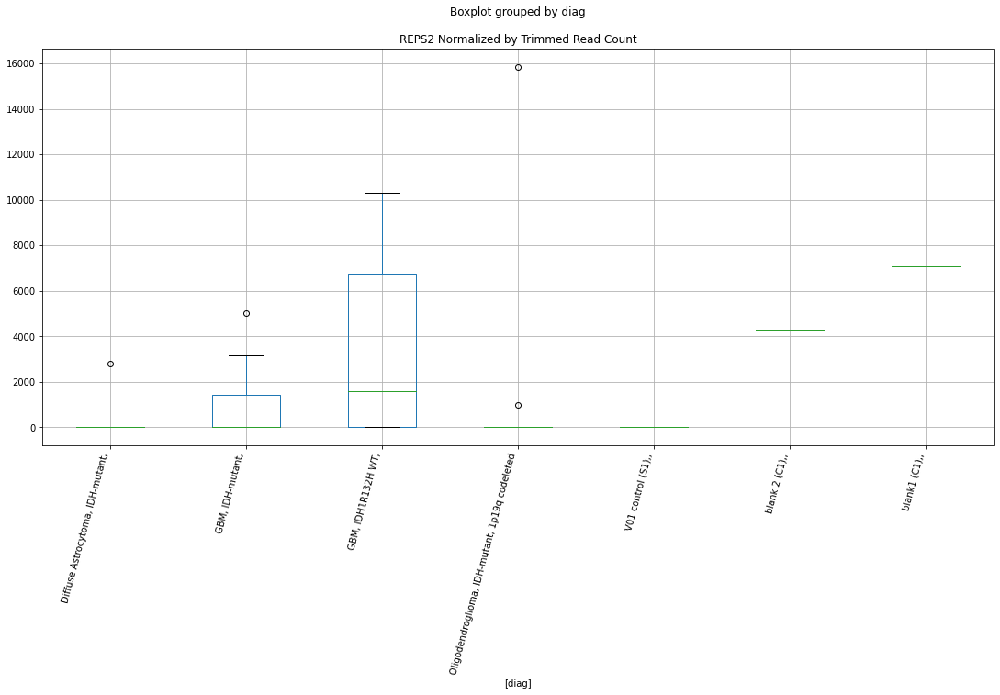

 p : 0.02954851108956731  ( t : 2.3636085303220002 ) :  D-plex  :  cutadapt2  :  PHF23
Control and blanks
76     0.0
340    0.0
Name: PHF23, dtype: float64
208    5819.89
Name: PHF23, dtype: float64
472    577.96
Name: PHF23, dtype: float64


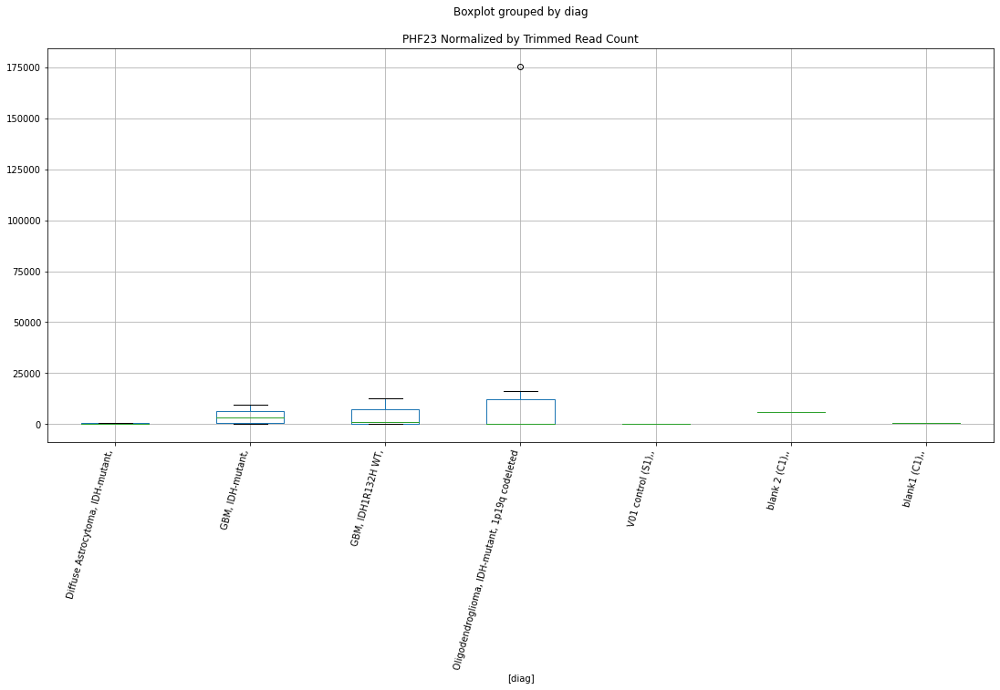

 p : 0.029576900063253937  ( t : 2.3631383289748937 ) :  D-plex  :  cutadapt2  :  PDE6G
Control and blanks
76     0.0
340    0.0
Name: PDE6G, dtype: float64
208    4232.65
Name: PDE6G, dtype: float64
472    13870.94
Name: PDE6G, dtype: float64


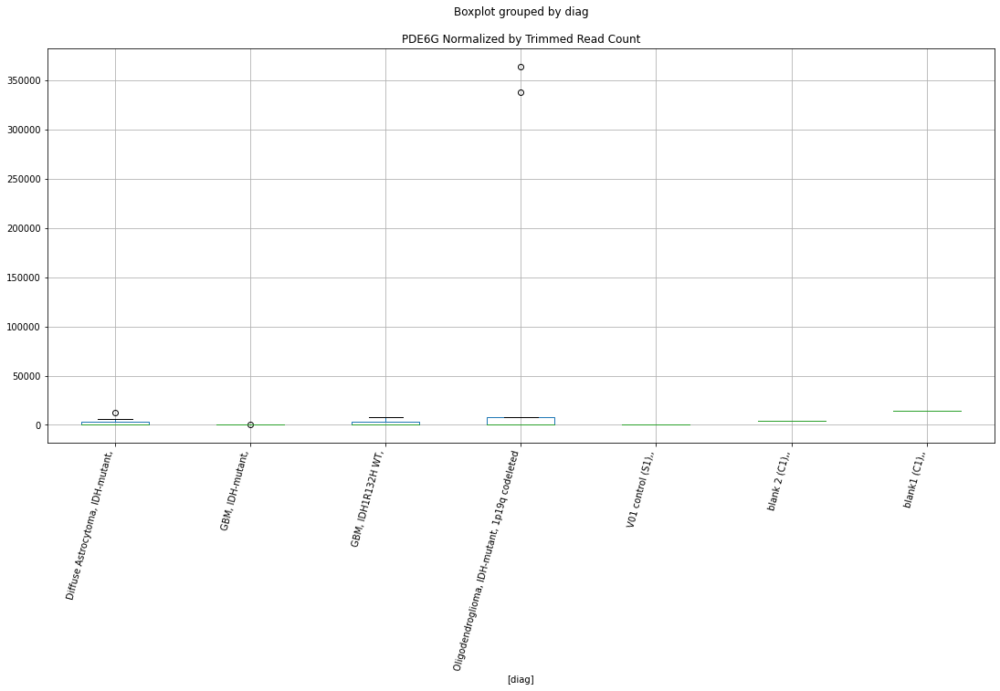

 p : 0.02965938175308628  ( t : 2.361774582900831 ) :  Lexogen  :  bbduk2  :  SORD
Control and blanks
79     0.0
343    0.0
Name: SORD, dtype: float64
211    0.0
Name: SORD, dtype: float64
475    0.0
Name: SORD, dtype: float64


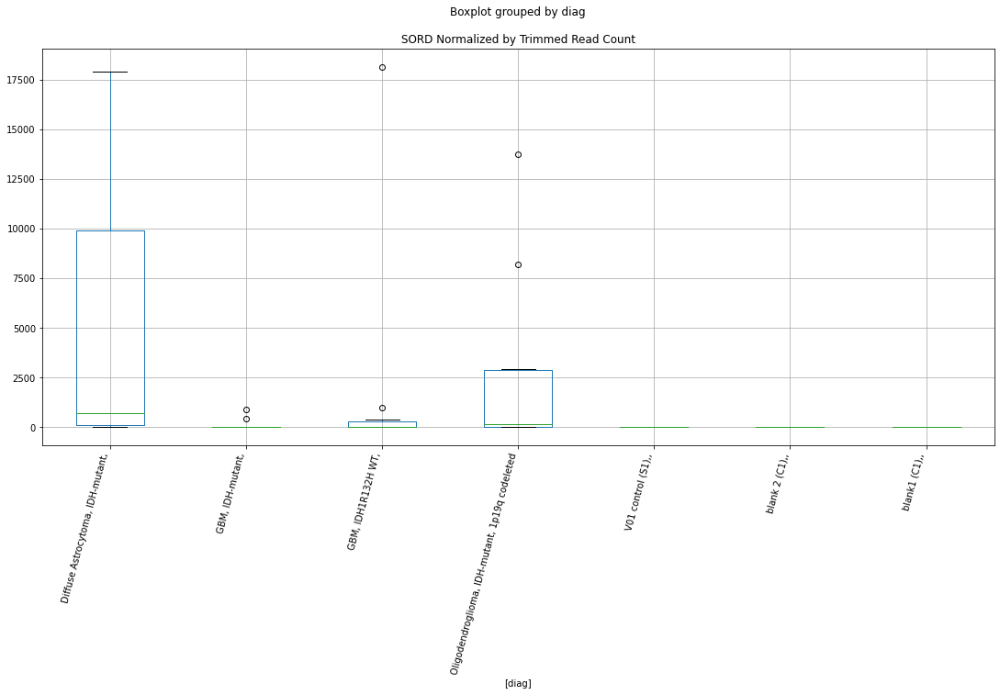

 p : 0.029666818215597957  ( t : 2.3616518027745776 ) :  Lexogen  :  bbduk2  :  PARP11
Control and blanks
79         0.00
343    21231.43
Name: PARP11, dtype: float64
211    2733.06
Name: PARP11, dtype: float64
475    7185.47
Name: PARP11, dtype: float64


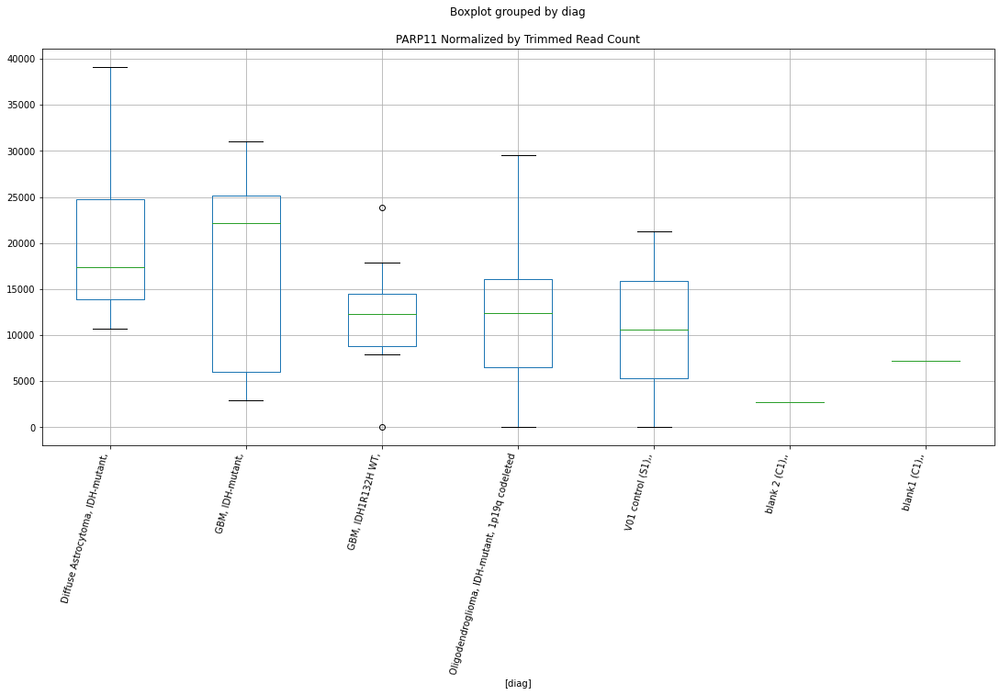

 p : 0.02966998426437012  ( t : 2.361599538257223 ) :  Lexogen  :  cutadapt2  :  SLC9A1
Control and blanks
82     0.0
346    0.0
Name: SLC9A1, dtype: float64
214    0.0
Name: SLC9A1, dtype: float64
478    949.84
Name: SLC9A1, dtype: float64


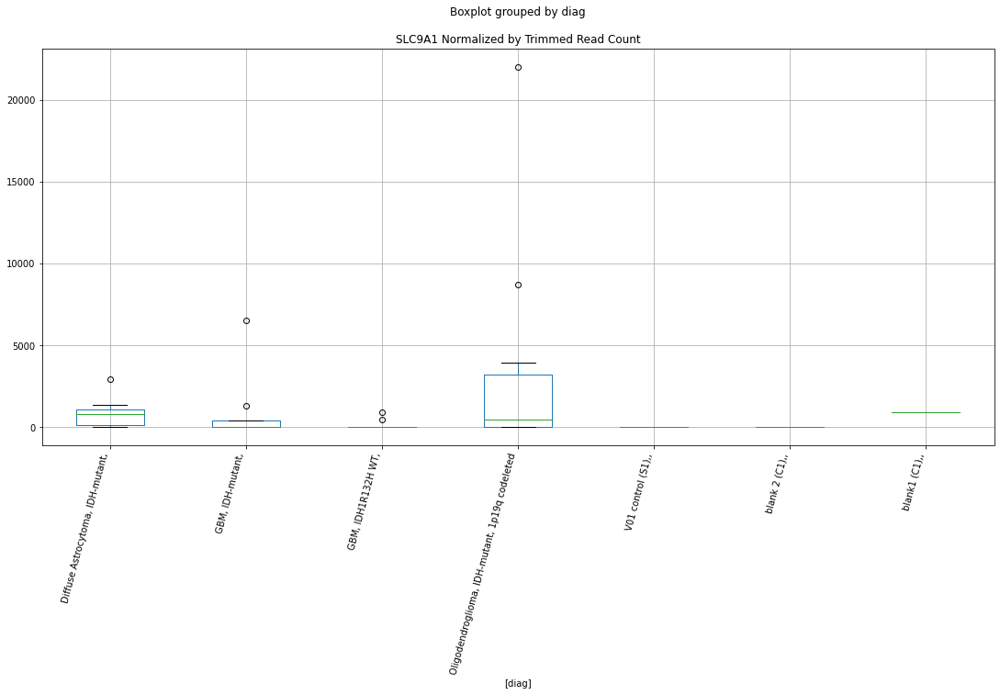

 p : 0.029676743721656837  ( t : 2.361487971845182 ) :  D-plex  :  bbduk2  :  PPP1R3E
Control and blanks
73     24736.27
337    40057.08
Name: PPP1R3E, dtype: float64
205    31699.1
Name: PPP1R3E, dtype: float64
469    28984.84
Name: PPP1R3E, dtype: float64


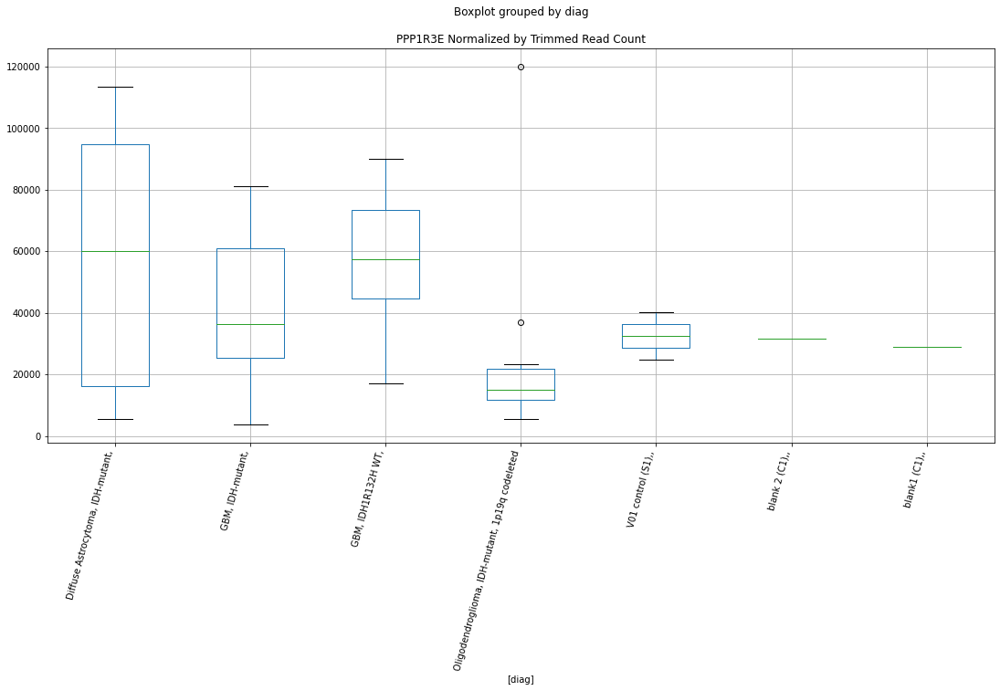

 p : 0.029822511190113747  ( t : 2.3590877904096317 ) :  Lexogen  :  bbduk2  :  ORAI2
Control and blanks
79       0.00
343    849.26
Name: ORAI2, dtype: float64
211    0.0
Name: ORAI2, dtype: float64
475    0.0
Name: ORAI2, dtype: float64


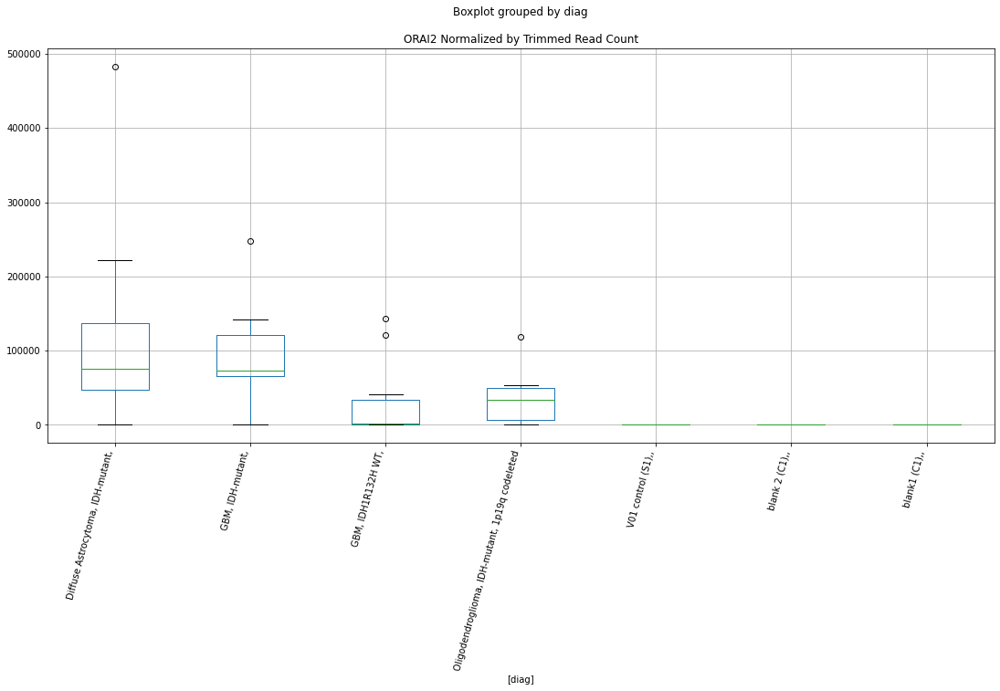

 p : 0.029878547674213822  ( t : 2.358168011864828 ) :  D-plex  :  cutadapt2  :  SMG1
Control and blanks
76     7576.14
340       0.00
Name: SMG1, dtype: float64
208    22926.83
Name: SMG1, dtype: float64
472    5779.56
Name: SMG1, dtype: float64


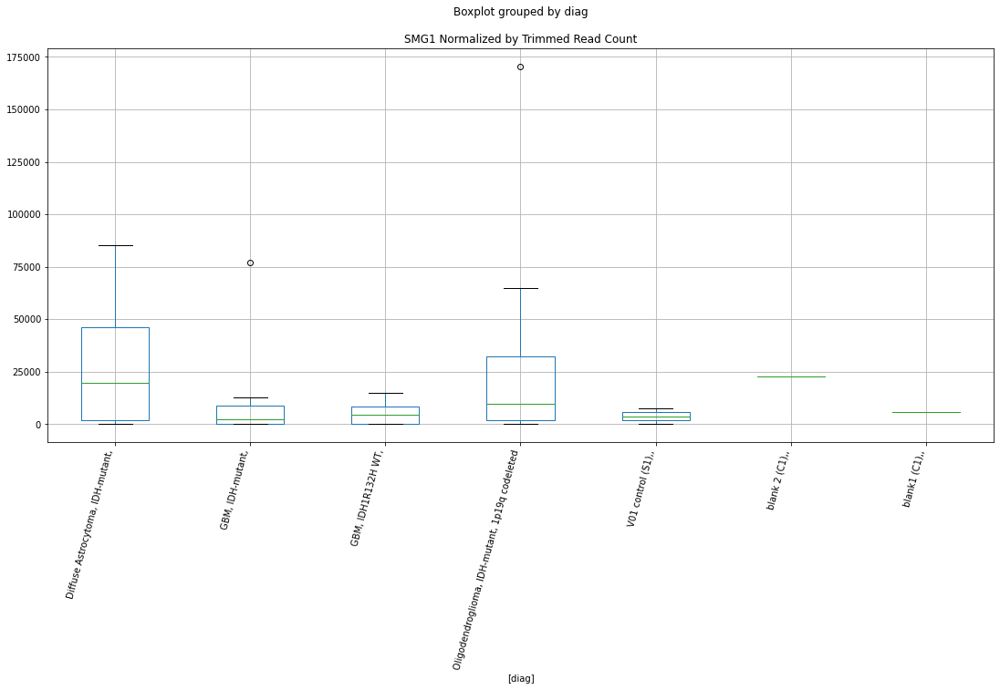

 p : 0.029901583356733808  ( t : 2.357790372076358 ) :  Lexogen  :  bbduk2  :  PRKCB
Control and blanks
79     0.0
343    0.0
Name: PRKCB, dtype: float64
211    2186.45
Name: PRKCB, dtype: float64
475    0.0
Name: PRKCB, dtype: float64


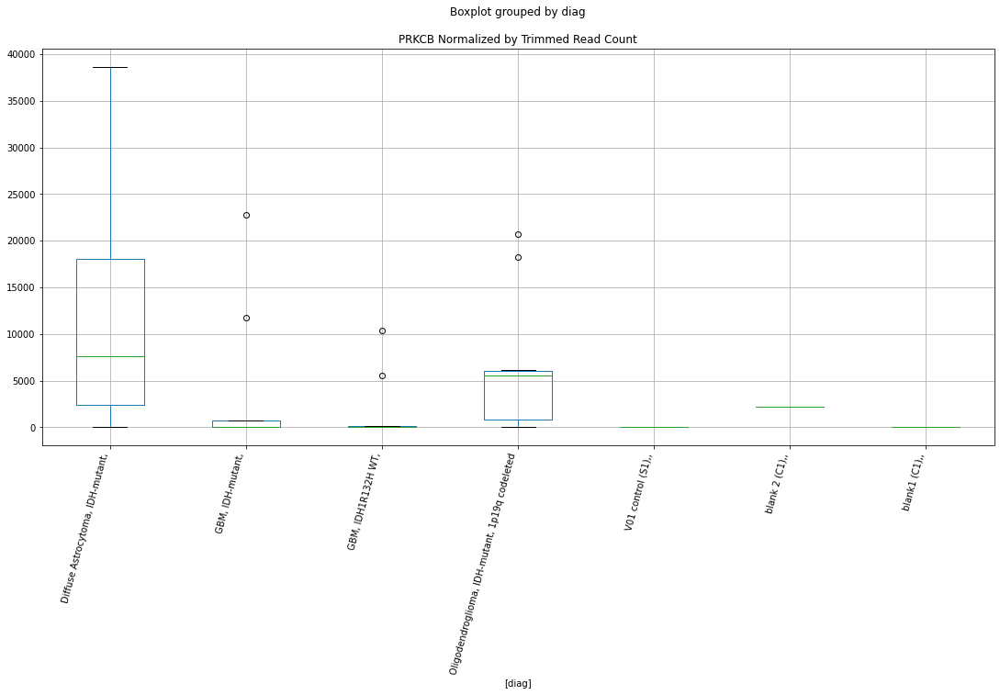

 p : 0.030005980152371943  ( t : 2.3560823143927627 ) :  D-plex  :  bbduk2  :  PYURF
Control and blanks
73     0.0
337    0.0
Name: PYURF, dtype: float64
205    179.09
Name: PYURF, dtype: float64
469    1183.05
Name: PYURF, dtype: float64


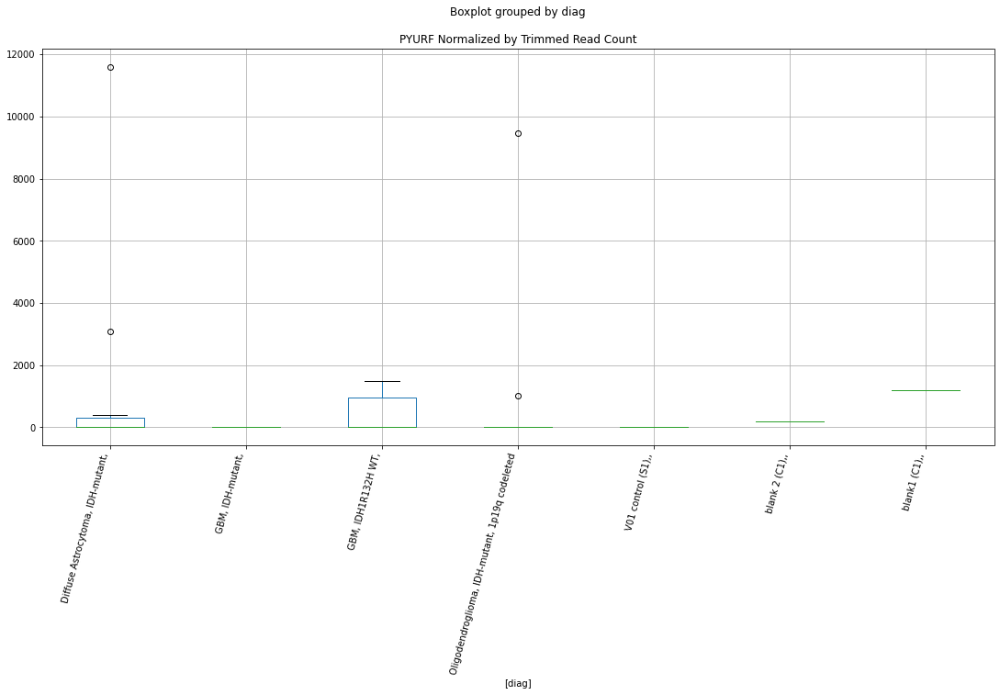

 p : 0.030010885157735877  ( t : 2.3560021988306734 ) :  D-plex  :  bbduk2  :  POTEC
Control and blanks
73         0.0
337    12462.2
Name: POTEC, dtype: float64
205    2328.18
Name: POTEC, dtype: float64
469    1183.05
Name: POTEC, dtype: float64


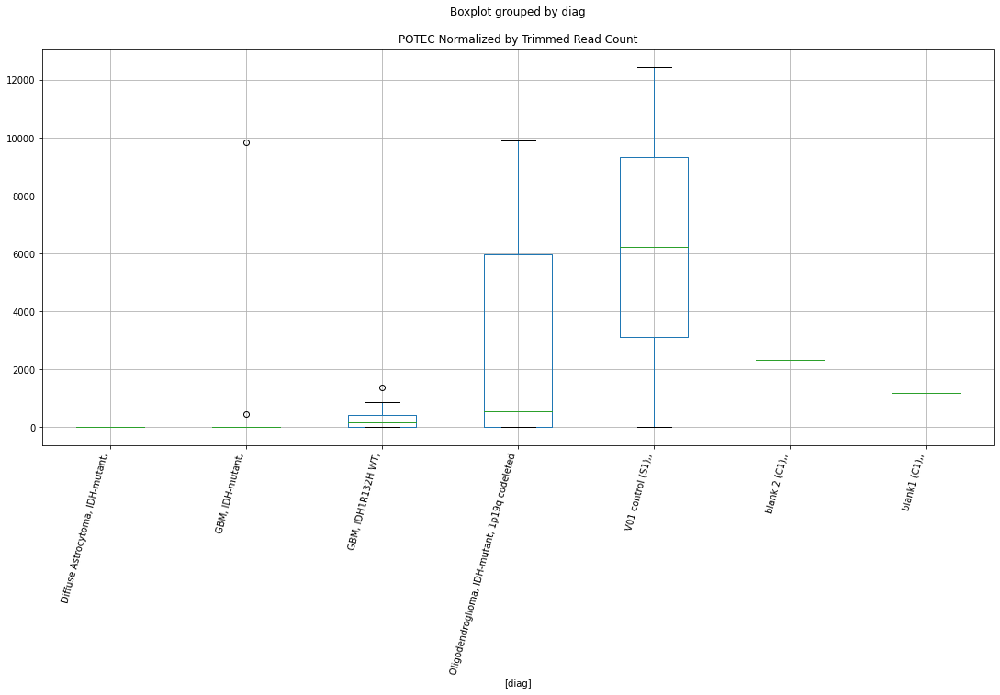

 p : 0.03009683595657327  ( t : 2.354600303598217 ) :  D-plex  :  cutadapt2  :  PYURF
Control and blanks
76     0.0
340    0.0
Name: PYURF, dtype: float64
208    176.36
Name: PYURF, dtype: float64
472    1155.91
Name: PYURF, dtype: float64


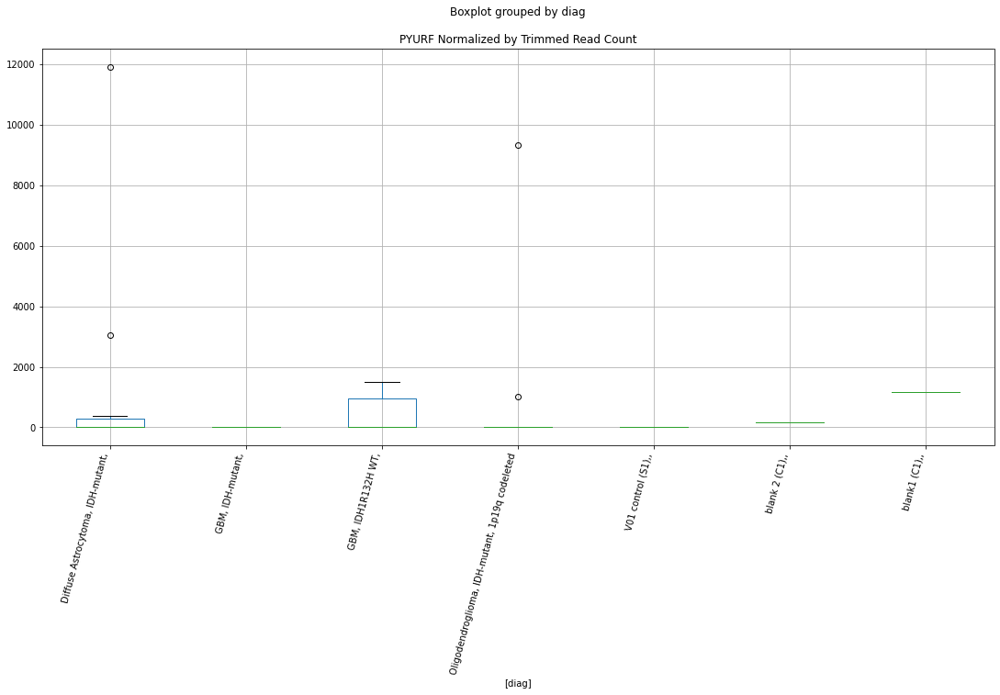

 p : 0.030174099000701806  ( t : 2.3533432888569665 ) :  D-plex  :  bbduk2  :  PFAS
Control and blanks
73     3092.03
337       0.00
Name: PFAS, dtype: float64
205    7700.91
Name: PFAS, dtype: float64
469    7098.33
Name: PFAS, dtype: float64


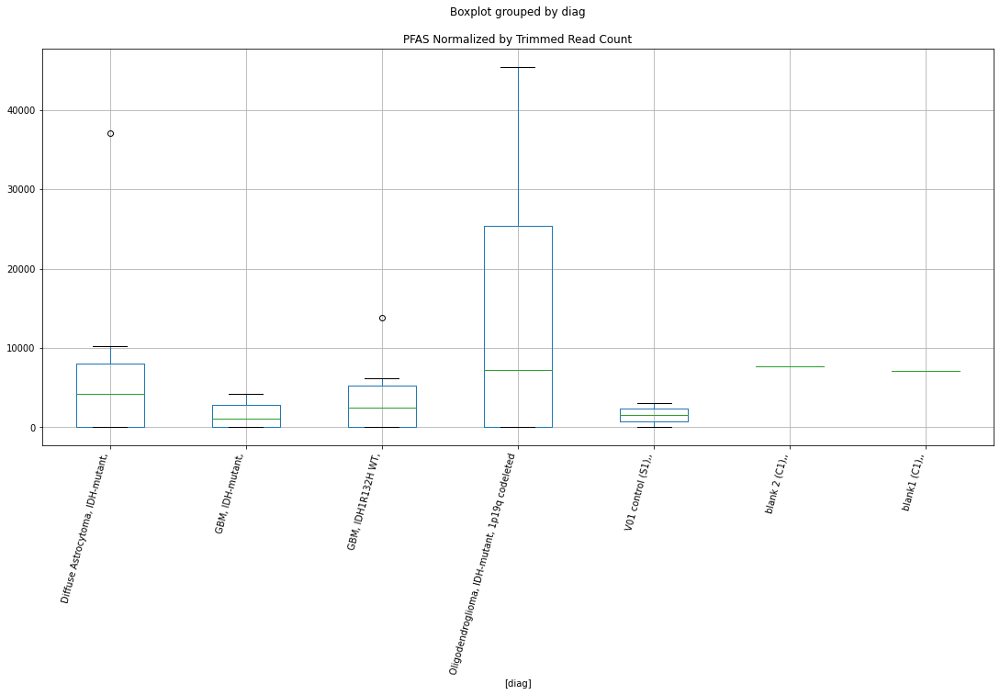

 p : 0.03020592864210637  ( t : 2.3528263149974022 ) :  Lexogen  :  bbduk2  :  PCDHA1
Control and blanks
79     17167.19
343    13375.80
Name: PCDHA1, dtype: float64
211    18584.83
Name: PCDHA1, dtype: float64
475    14370.94
Name: PCDHA1, dtype: float64


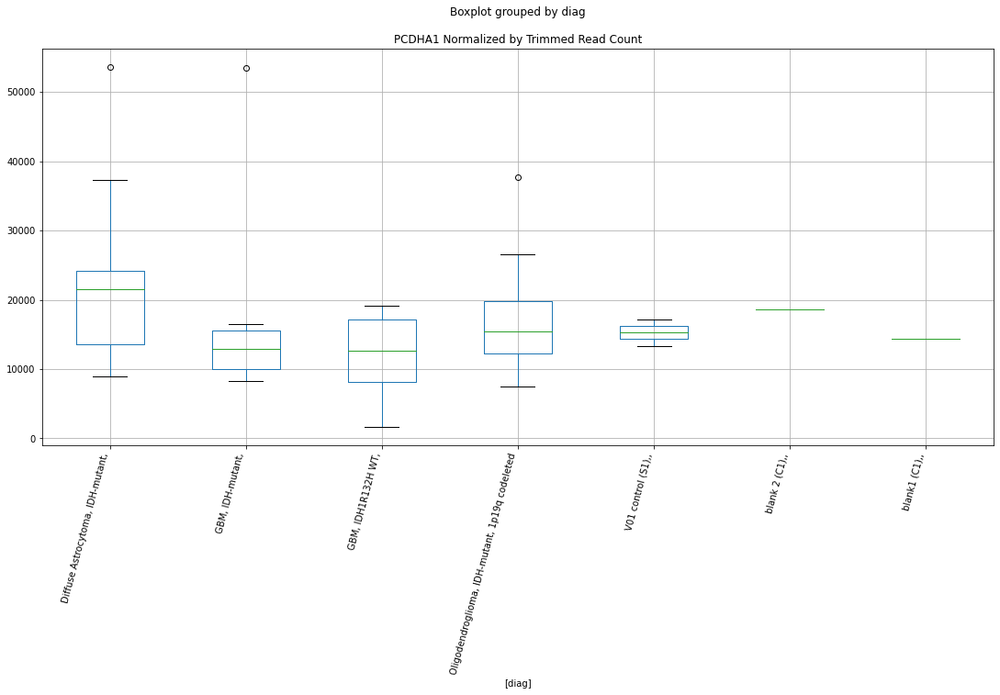

 p : 0.03025927527512183  ( t : 2.351961001029899 ) :  D-plex  :  cutadapt2  :  PLAUR
Control and blanks
76      7576.14
340    35229.29
Name: PLAUR, dtype: float64
208    79538.46
Name: PLAUR, dtype: float64
472    26585.97
Name: PLAUR, dtype: float64


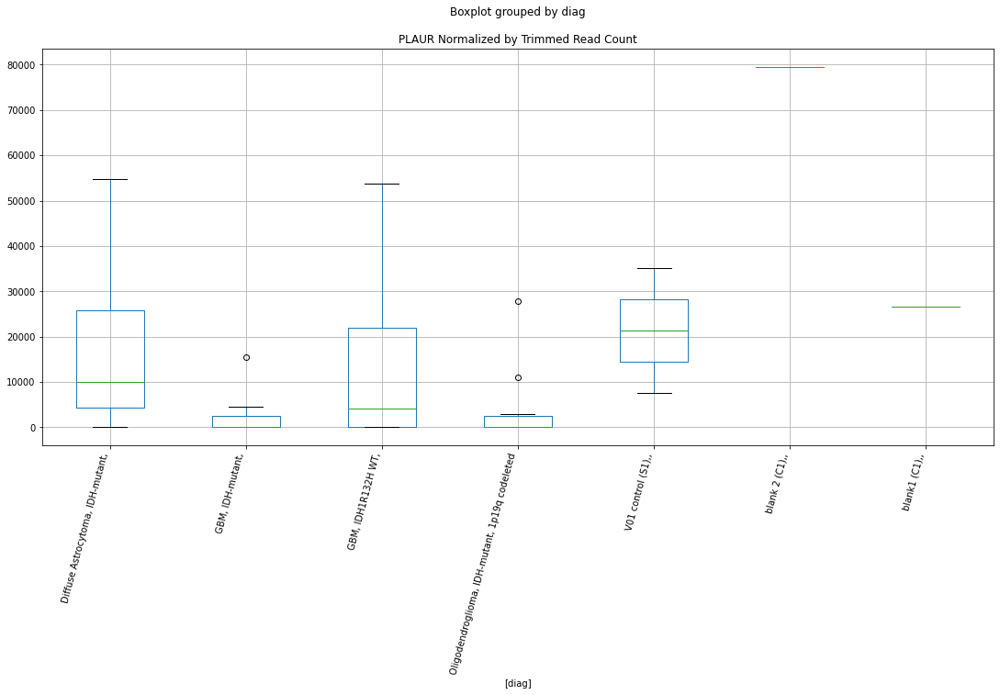

 p : 0.03027111834539389  ( t : 2.35176909215191 ) :  Lexogen  :  bbduk2  :  SLC2A2
Control and blanks
79     0.0
343    0.0
Name: SLC2A2, dtype: float64
211    0.0
Name: SLC2A2, dtype: float64
475    1197.58
Name: SLC2A2, dtype: float64


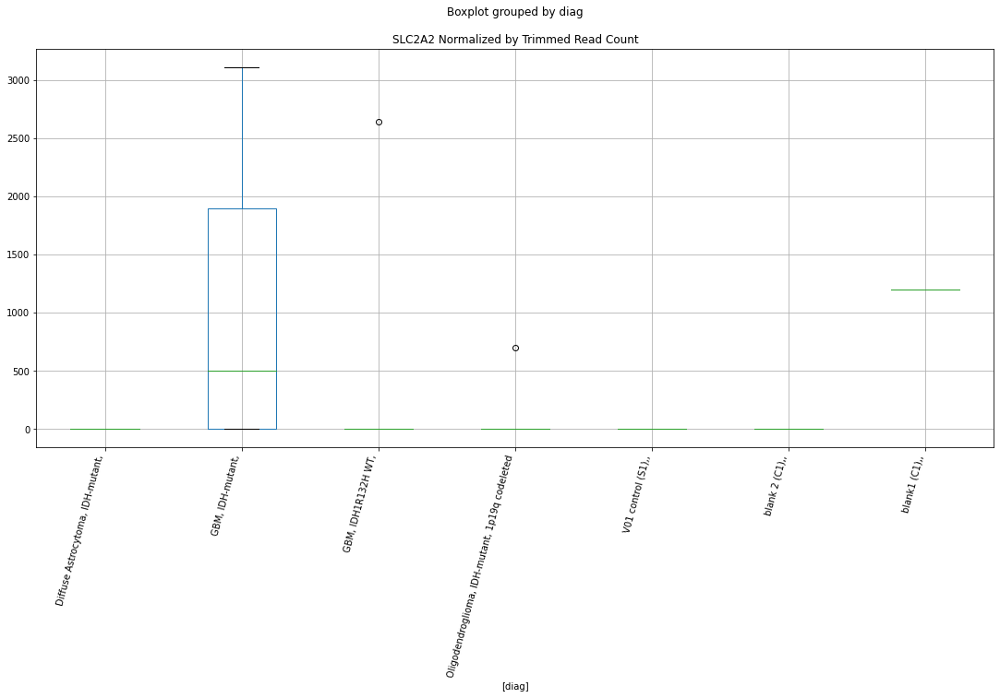

 p : 0.030277008697358148  ( t : 2.3516736690509656 ) :  D-plex  :  cutadapt2  :  RASSF3
Control and blanks
76     0.0
340    0.0
Name: RASSF3, dtype: float64
208    881.8
Name: RASSF3, dtype: float64
472    0.0
Name: RASSF3, dtype: float64


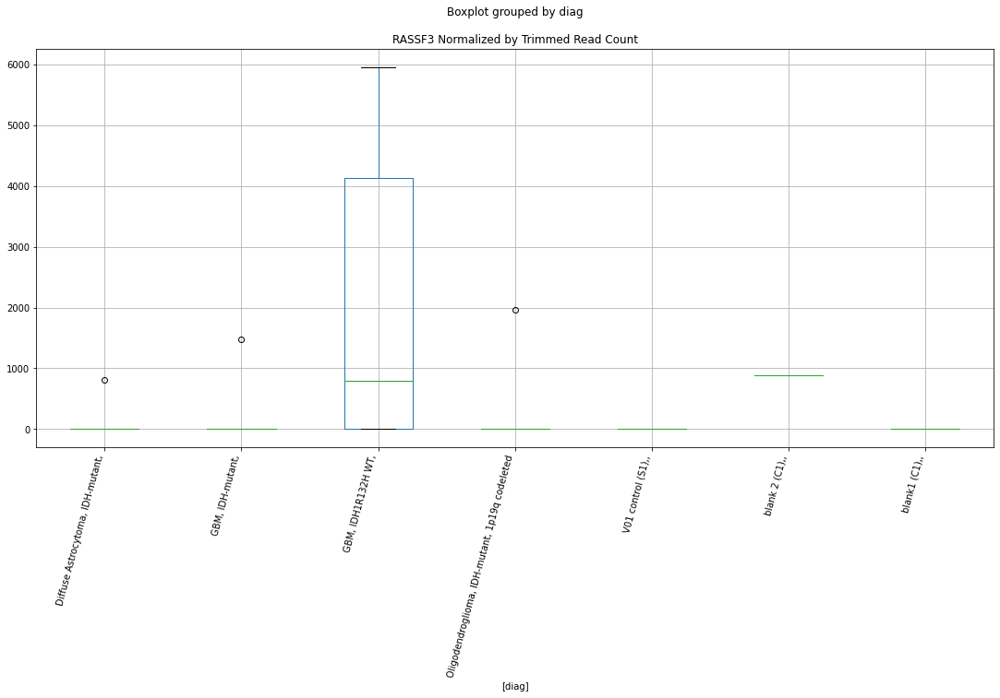

 p : 0.03027908260517238  ( t : 2.351640076071113 ) :  Lexogen  :  bbduk2  :  SOST
Control and blanks
79     0.0
343    0.0
Name: SOST, dtype: float64
211    0.0
Name: SOST, dtype: float64
475    239.52
Name: SOST, dtype: float64


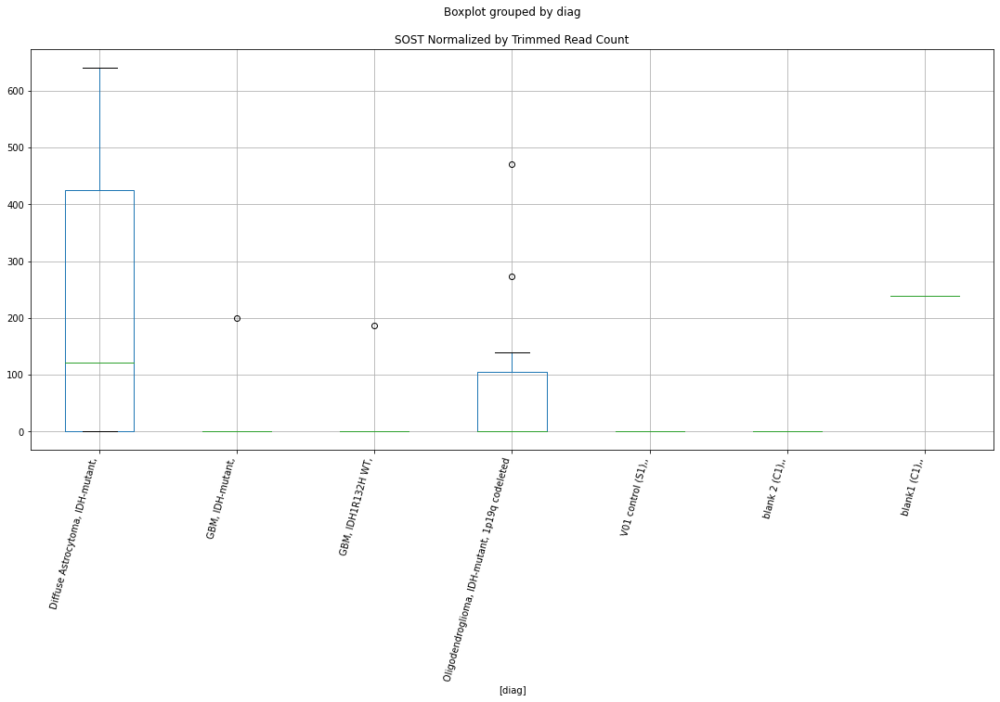

 p : 0.03036585653831595  ( t : 2.3502364362784087 ) :  D-plex  :  cutadapt2  :  SMIM28
Control and blanks
76       0.00
340    880.73
Name: SMIM28, dtype: float64
208    352.72
Name: SMIM28, dtype: float64
472    0.0
Name: SMIM28, dtype: float64


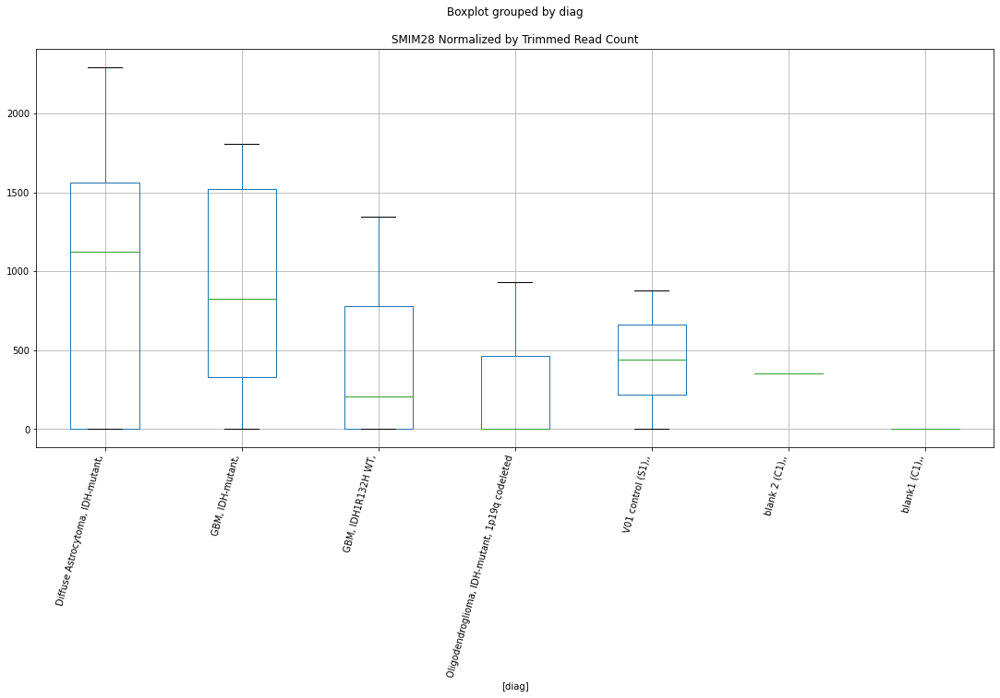

 p : 0.030476539475548427  ( t : 2.3484514591626326 ) :  D-plex  :  bbduk2  :  PLEKHS1
Control and blanks
73     0.0
337    0.0
Name: PLEKHS1, dtype: float64
205    0.0
Name: PLEKHS1, dtype: float64
469    0.0
Name: PLEKHS1, dtype: float64


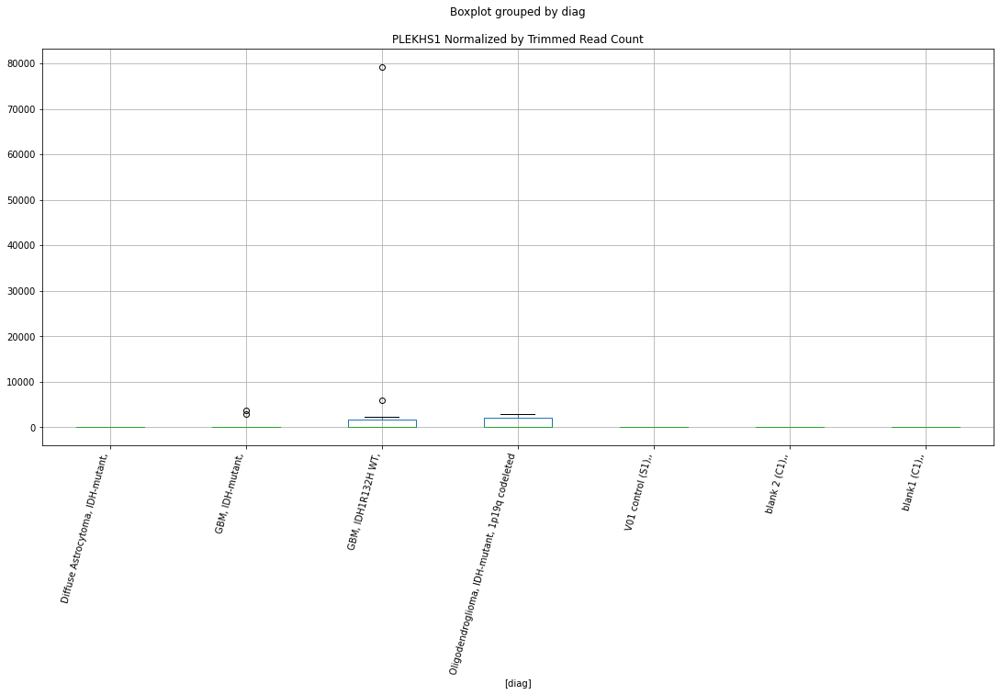

 p : 0.03047840007530798  ( t : 2.3484215049974617 ) :  Lexogen  :  bbduk2  :  PRRT3
Control and blanks
79     0.0
343    0.0
Name: PRRT3, dtype: float64
211    0.0
Name: PRRT3, dtype: float64
475    0.0
Name: PRRT3, dtype: float64


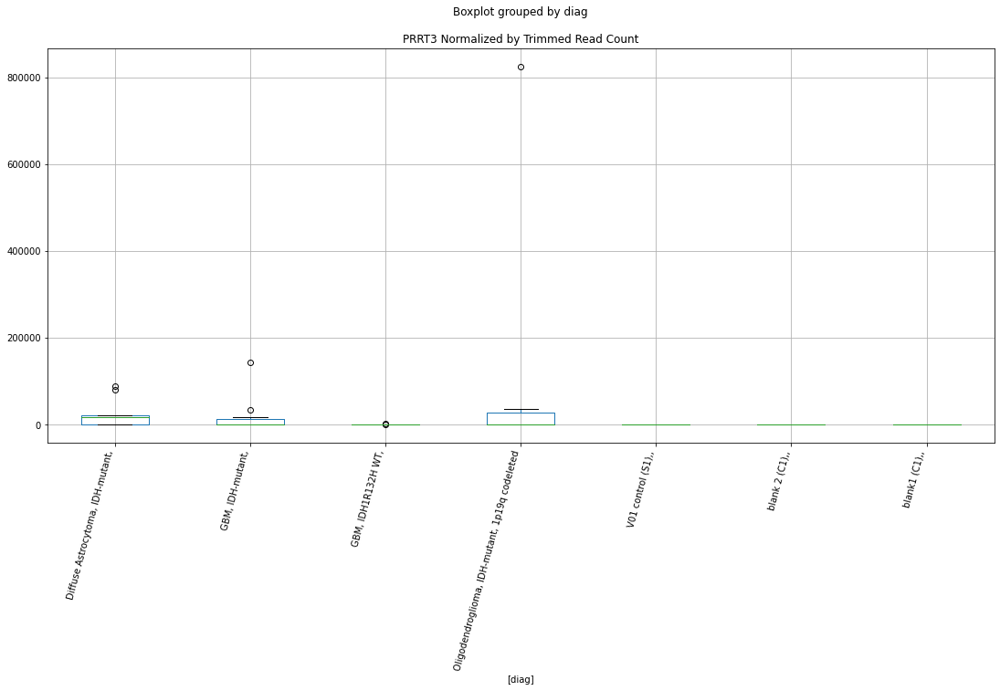

 p : 0.030480422802413556  ( t : 2.348388942643357 ) :  D-plex  :  bbduk2  :  SAMD15
Control and blanks
73     1546.02
337       0.00
Name: SAMD15, dtype: float64
205    7700.91
Name: SAMD15, dtype: float64
469    9464.44
Name: SAMD15, dtype: float64


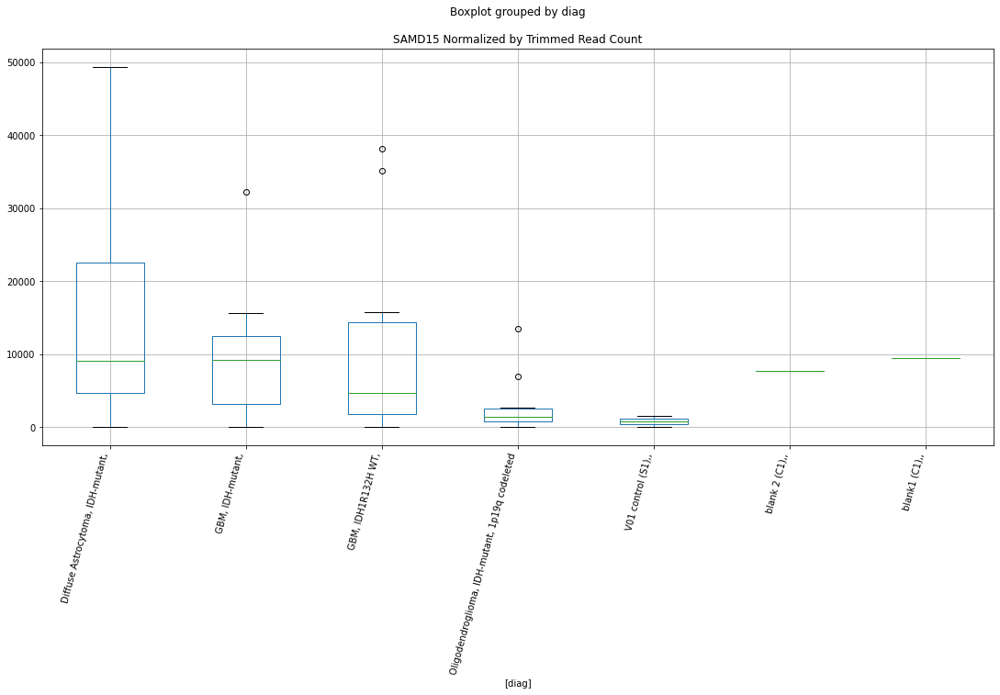

 p : 0.030538533212403518  ( t : 2.347454325165565 ) :  D-plex  :  cutadapt2  :  SLC22A12
Control and blanks
76     0.0
340    0.0
Name: SLC22A12, dtype: float64
208    4232.65
Name: SLC22A12, dtype: float64
472    3467.74
Name: SLC22A12, dtype: float64


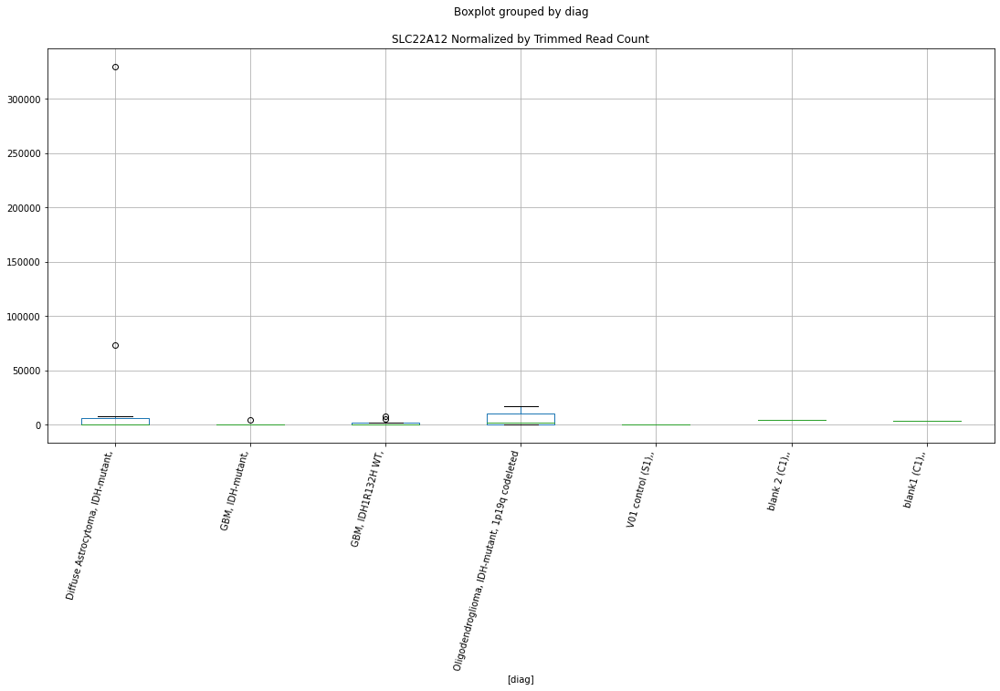

 p : 0.0305863795216469  ( t : 2.346686032122463 ) :  D-plex  :  bbduk2  :  SLC22A11
Control and blanks
73     0.0
337    0.0
Name: SLC22A11, dtype: float64
205    1074.55
Name: SLC22A11, dtype: float64
469    1774.58
Name: SLC22A11, dtype: float64


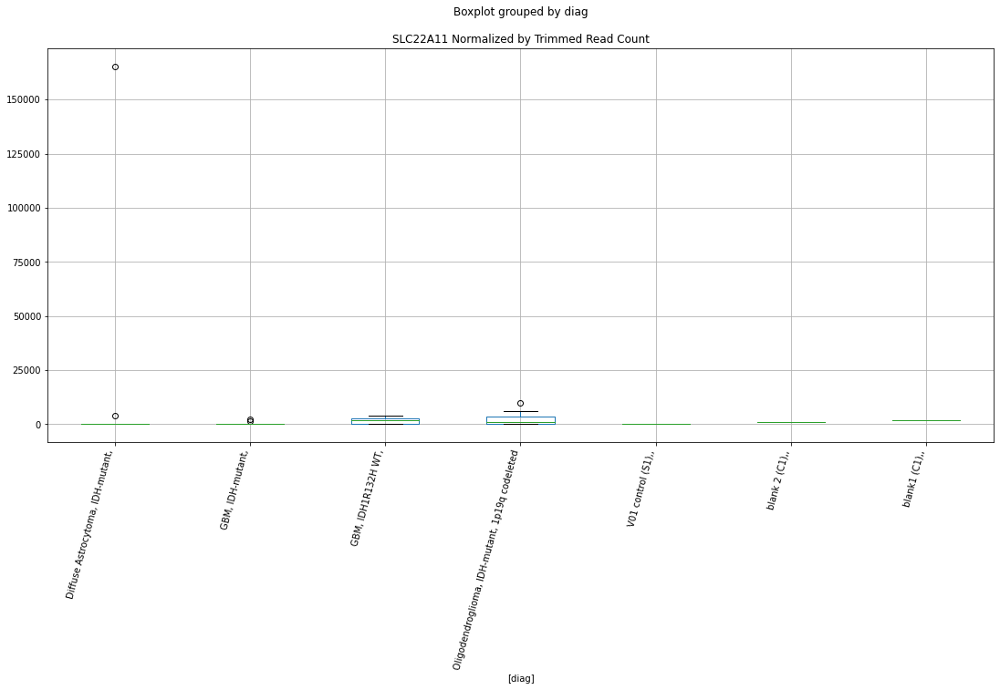

 p : 0.030587104167361608  ( t : 2.3466744047127657 ) :  D-plex  :  bbduk2  :  PHF20
Control and blanks
73      7730.08
337    17803.15
Name: PHF20, dtype: float64
205    5372.73
Name: PHF20, dtype: float64
469    11830.55
Name: PHF20, dtype: float64


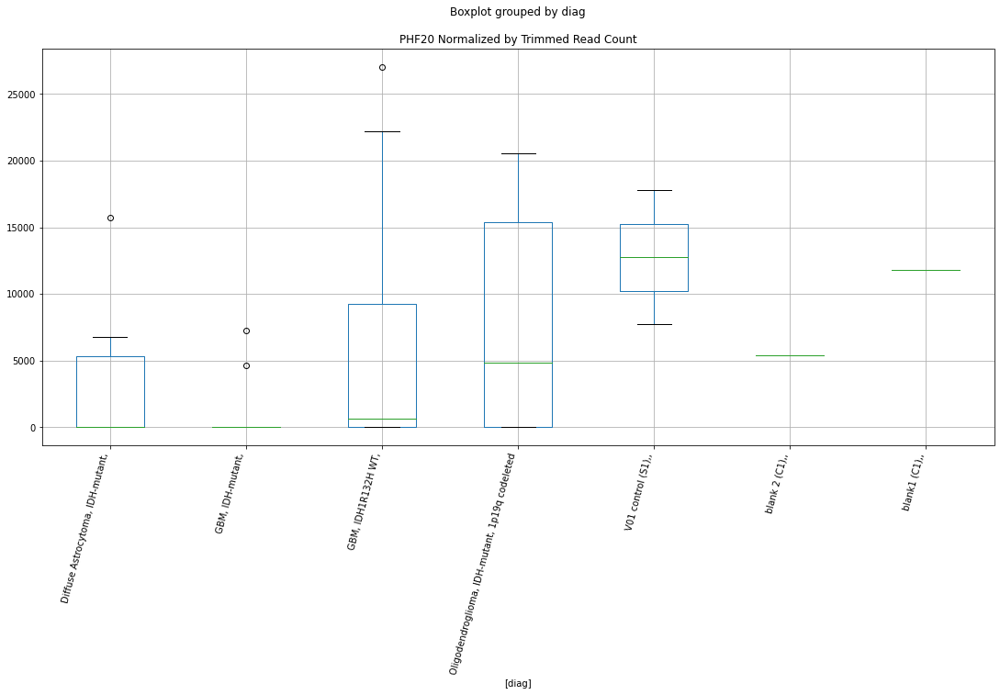

 p : 0.03062222228244265  ( t : 2.3461112189303237 ) :  D-plex  :  bbduk2  :  SLC22A12
Control and blanks
73     0.0
337    0.0
Name: SLC22A12, dtype: float64
205    4298.18
Name: SLC22A12, dtype: float64
469    3549.16
Name: SLC22A12, dtype: float64


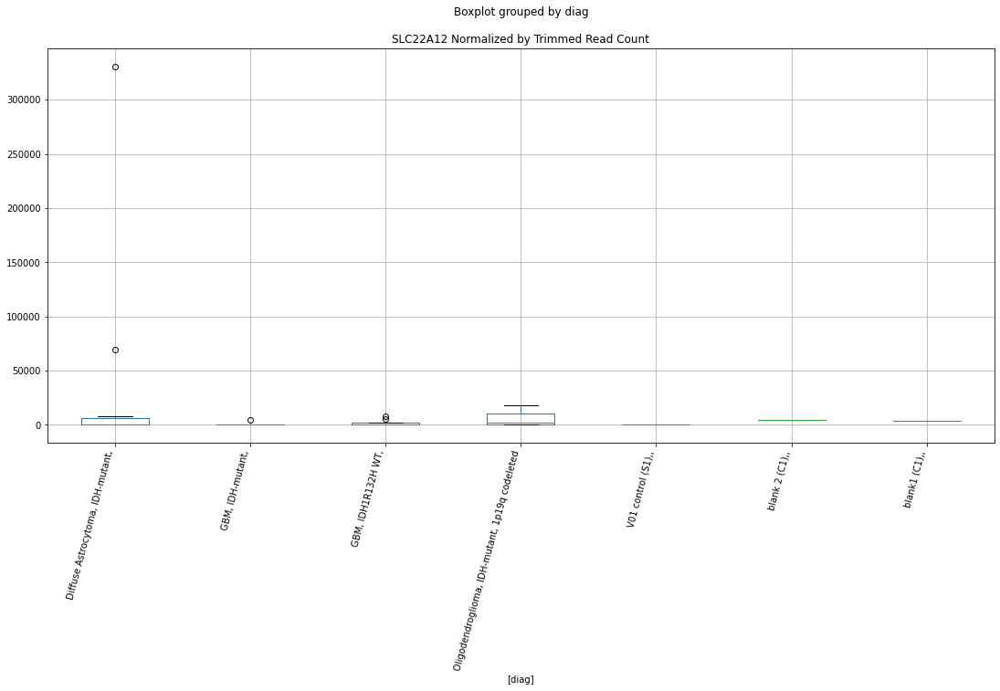

 p : 0.030681660154209412  ( t : 2.3451593880353205 ) :  Lexogen  :  cutadapt2  :  ORAI2
Control and blanks
82       0.00
346    841.74
Name: ORAI2, dtype: float64
214    0.0
Name: ORAI2, dtype: float64
478    0.0
Name: ORAI2, dtype: float64


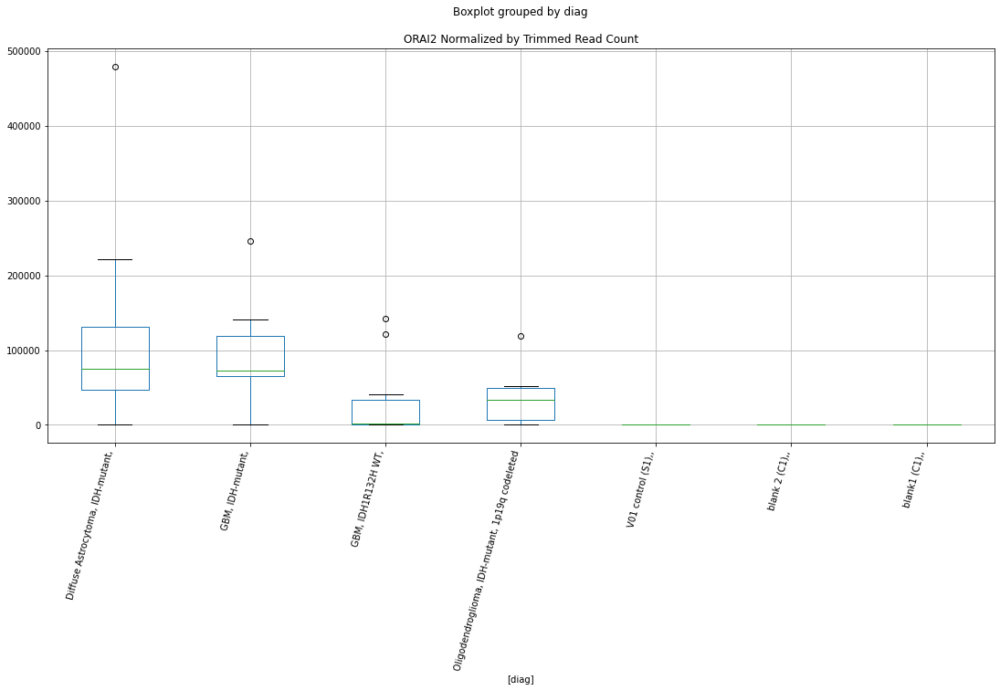

 p : 0.0307739093654012  ( t : 2.3436855138241652 ) :  Lexogen  :  cutadapt2  :  PIP5K1A
Control and blanks
82     0.0
346    0.0
Name: PIP5K1A, dtype: float64
214    0.0
Name: PIP5K1A, dtype: float64
478    0.0
Name: PIP5K1A, dtype: float64


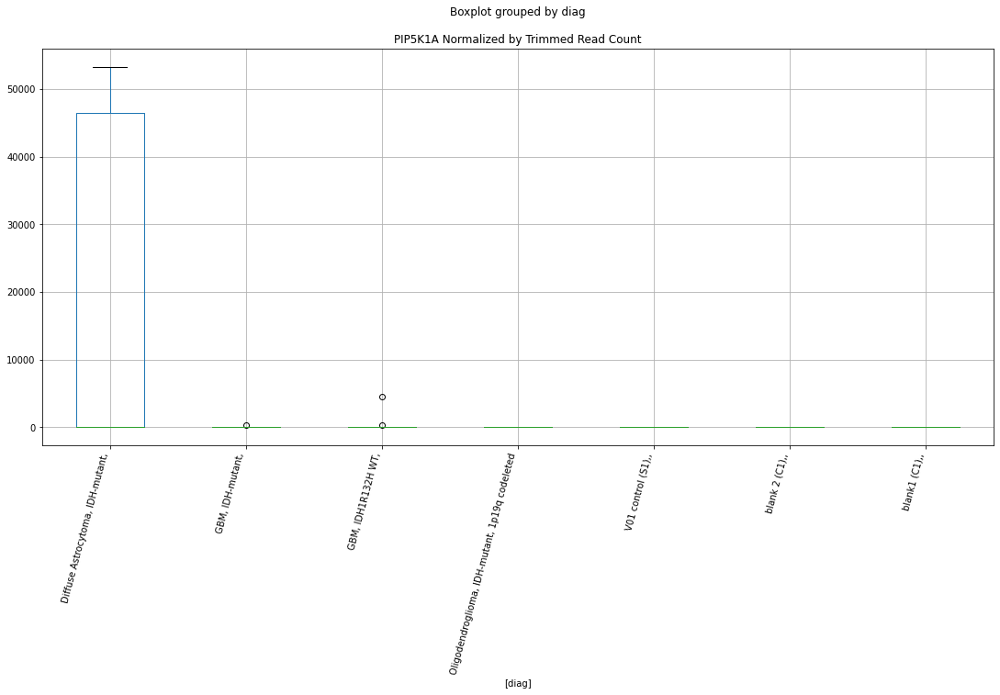

 p : 0.030901694678012823  ( t : 2.341650654218483 ) :  Lexogen  :  cutadapt2  :  PLXNA4
Control and blanks
82     0.0
346    0.0
Name: PLXNA4, dtype: float64
214    0.0
Name: PLXNA4, dtype: float64
478    0.0
Name: PLXNA4, dtype: float64


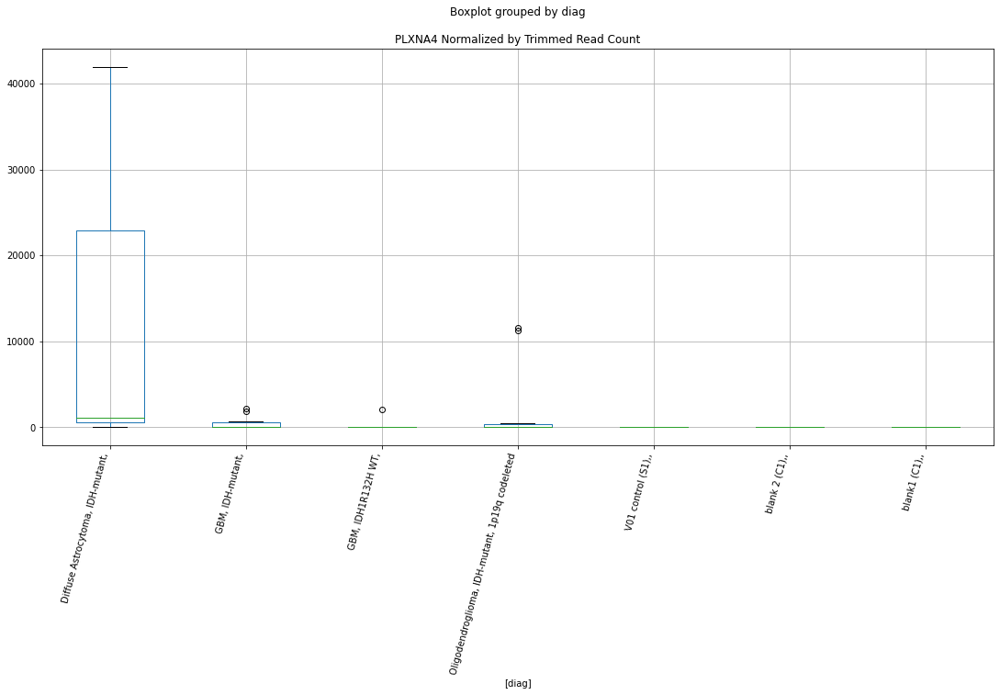

 p : 0.030921054841946485  ( t : 2.341343045264514 ) :  Lexogen  :  cutadapt2  :  SPATA17
Control and blanks
82       0.00
346    210.43
Name: SPATA17, dtype: float64
214    0.0
Name: SPATA17, dtype: float64
478    28495.26
Name: SPATA17, dtype: float64


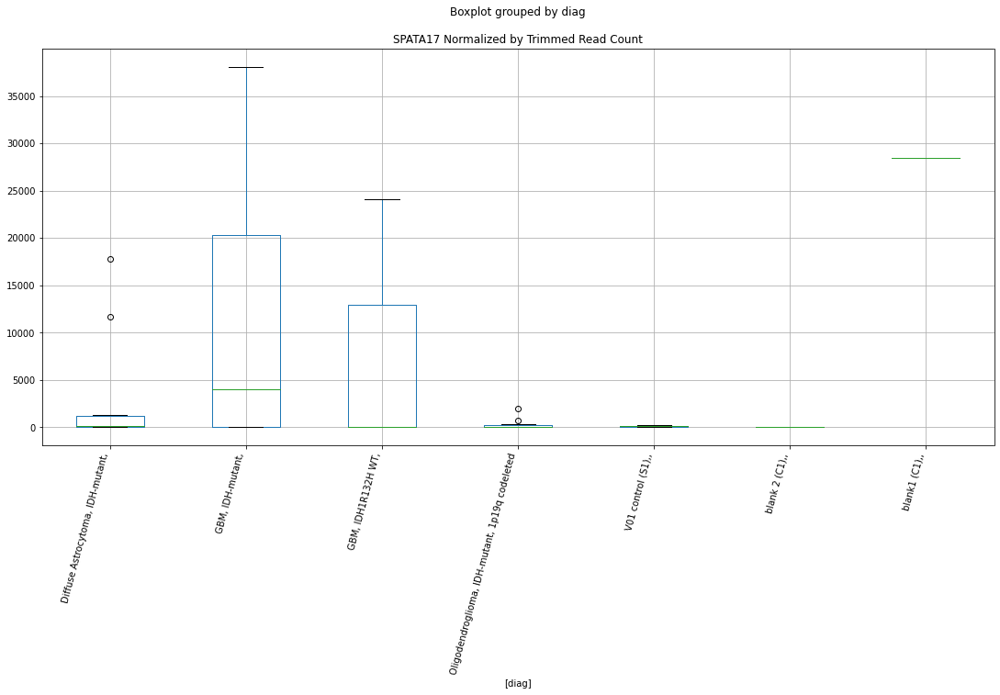

 p : 0.030967098251185637  ( t : 2.340612191982999 ) :  Lexogen  :  cutadapt2  :  RAB25
Control and blanks
82     0.0
346    0.0
Name: RAB25, dtype: float64
214    0.0
Name: RAB25, dtype: float64
478    474.92
Name: RAB25, dtype: float64


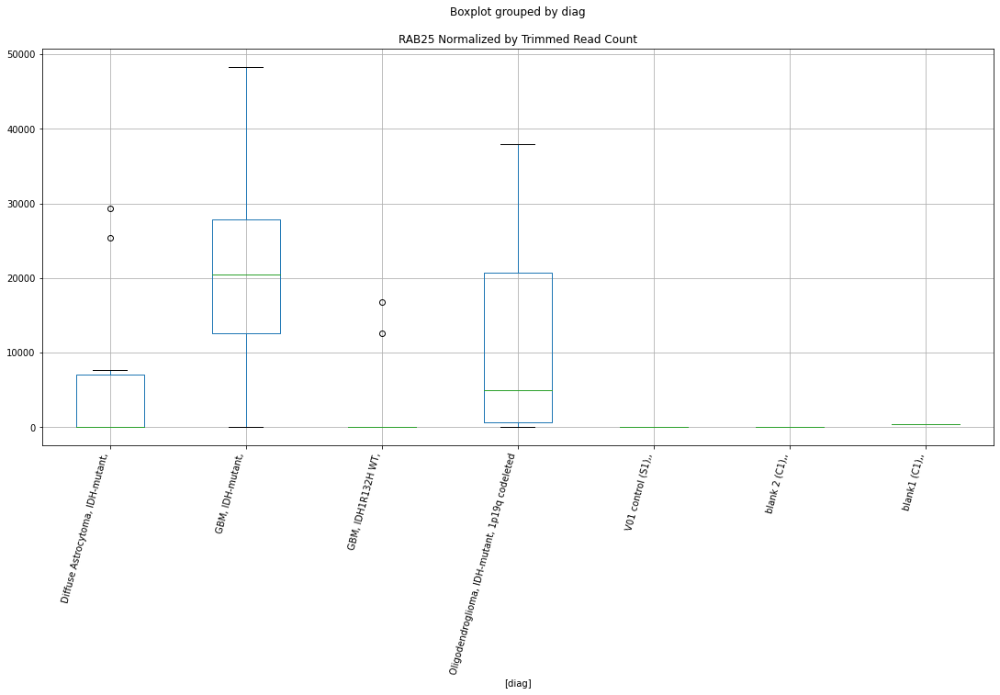

 p : 0.030978898152270555  ( t : 2.3404250533150206 ) :  D-plex  :  bbduk2  :  SLC9B1
Control and blanks
73     0.0
337    0.0
Name: SLC9B1, dtype: float64
205    0.0
Name: SLC9B1, dtype: float64
469    0.0
Name: SLC9B1, dtype: float64


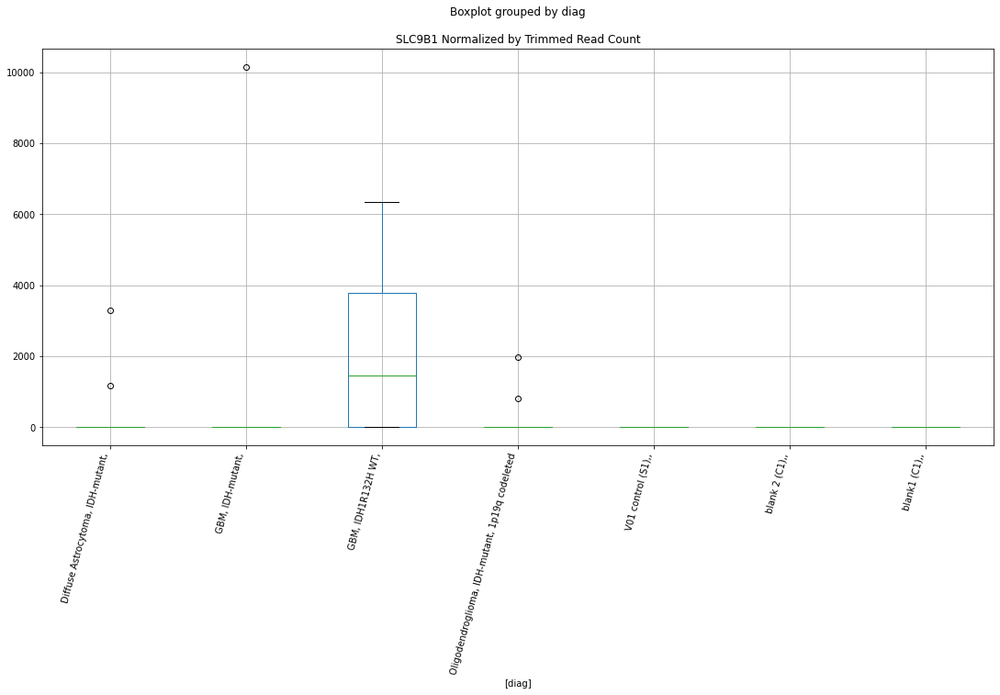

 p : 0.03105723525247037  ( t : 2.339184357399894 ) :  D-plex  :  cutadapt2  :  SIPA1L3
Control and blanks
76     156826.14
340         0.00
Name: SIPA1L3, dtype: float64
208    15872.42
Name: SIPA1L3, dtype: float64
472    25430.06
Name: SIPA1L3, dtype: float64


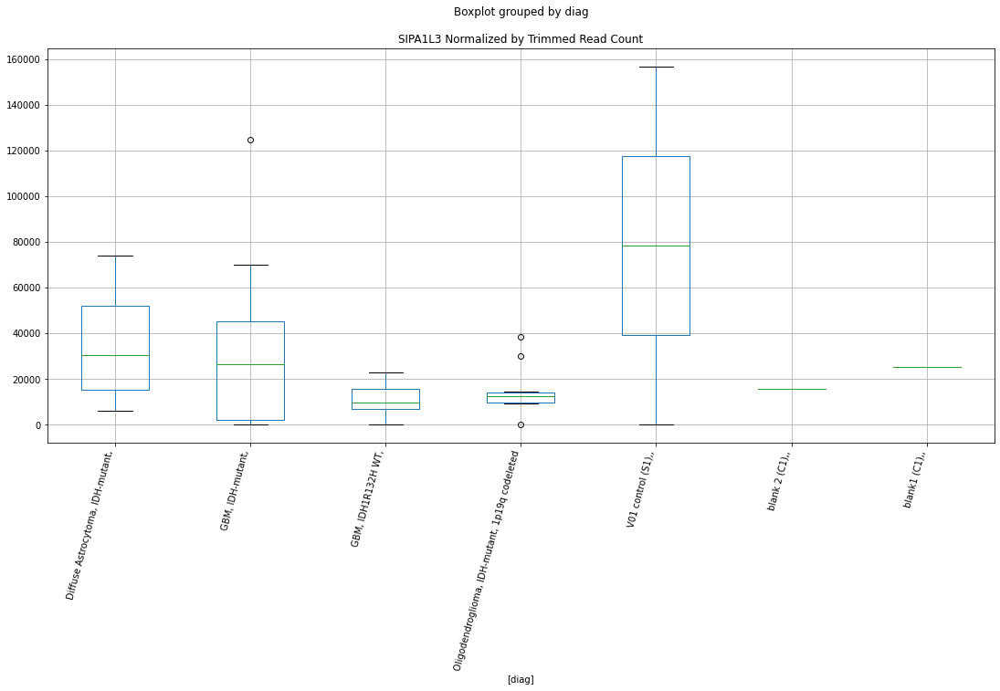

 p : 0.03105963841642419  ( t : 2.3391463423521257 ) :  D-plex  :  bbduk2  :  PCDHB10
Control and blanks
73     0.0
337    0.0
Name: PCDHB10, dtype: float64
205    30266.37
Name: PCDHB10, dtype: float64
469    591.53
Name: PCDHB10, dtype: float64


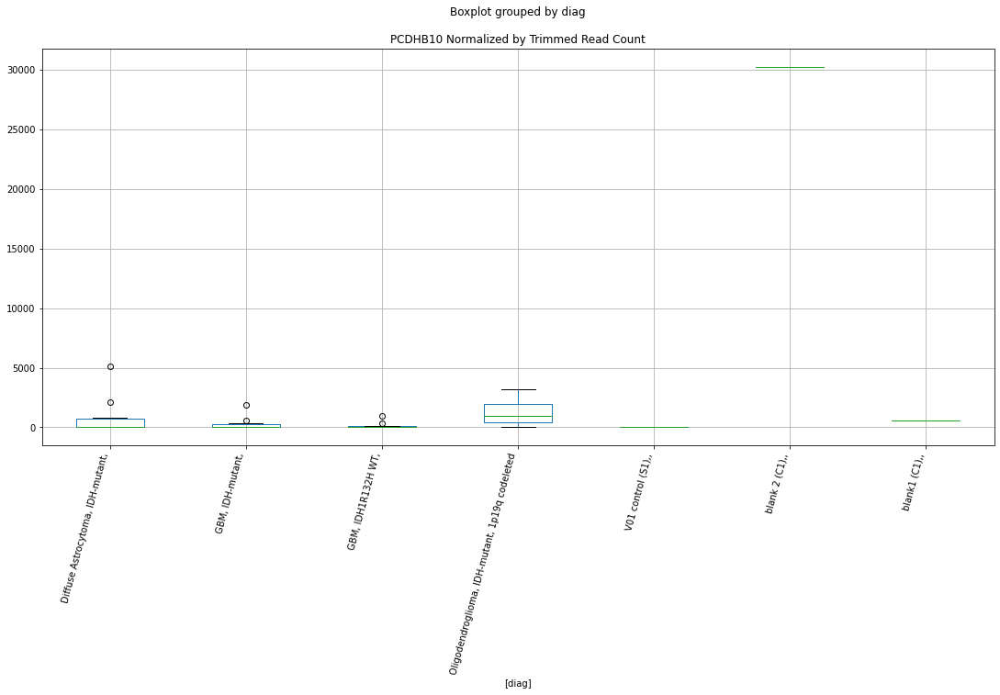

 p : 0.03106932438781462  ( t : 2.3389931501350087 ) :  D-plex  :  bbduk2  :  PRKX
Control and blanks
73     1546.02
337       0.00
Name: PRKX, dtype: float64
205    37430.01
Name: PRKX, dtype: float64
469    591.53
Name: PRKX, dtype: float64


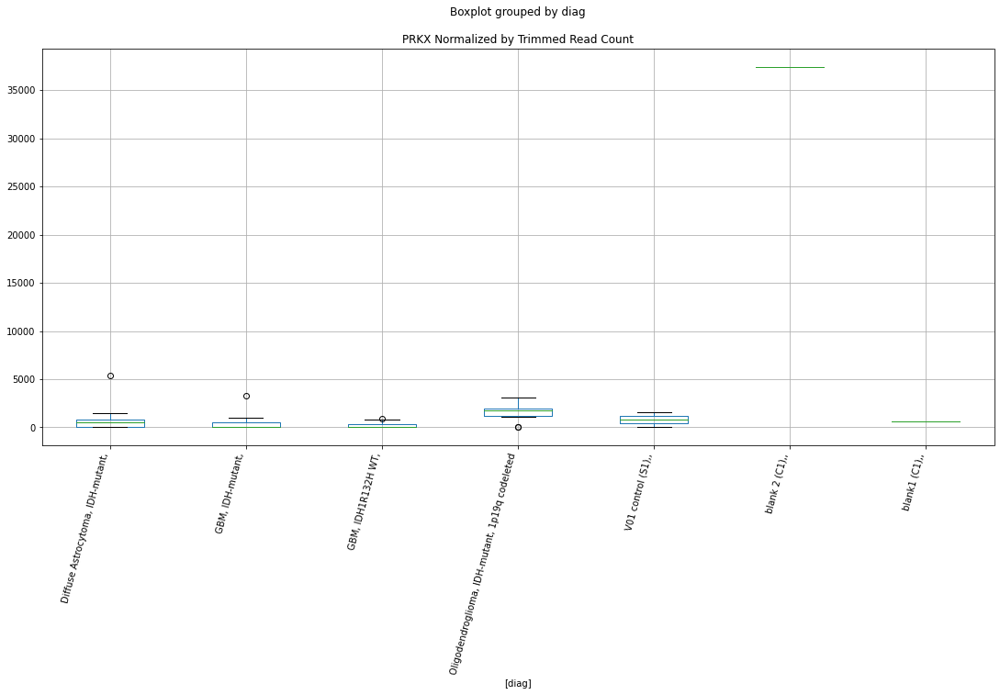

 p : 0.031099815701814446  ( t : 2.3385111928966915 ) :  D-plex  :  cutadapt2  :  RAB4B-EGLN2
Control and blanks
76     92428.93
340     6165.12
Name: RAB4B-EGLN2, dtype: float64
208    72131.33
Name: RAB4B-EGLN2, dtype: float64
472    50282.16
Name: RAB4B-EGLN2, dtype: float64


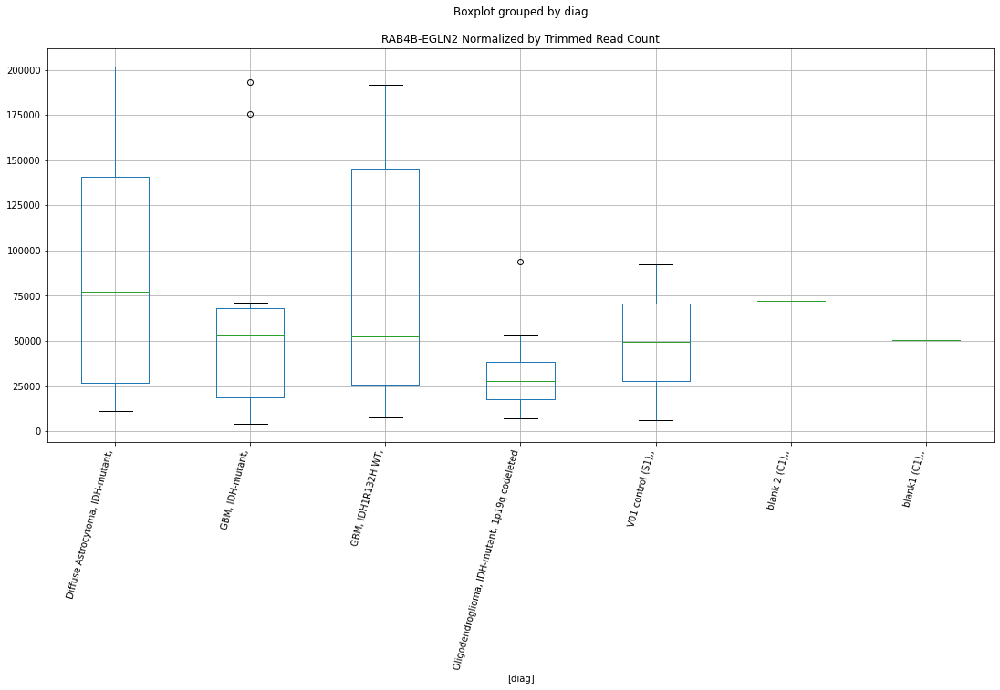

 p : 0.031103521458710034  ( t : 2.338452648262949 ) :  Lexogen  :  bbduk2  :  SPATA17
Control and blanks
79       0.00
343    212.31
Name: SPATA17, dtype: float64
211    0.0
Name: SPATA17, dtype: float64
475    28741.89
Name: SPATA17, dtype: float64


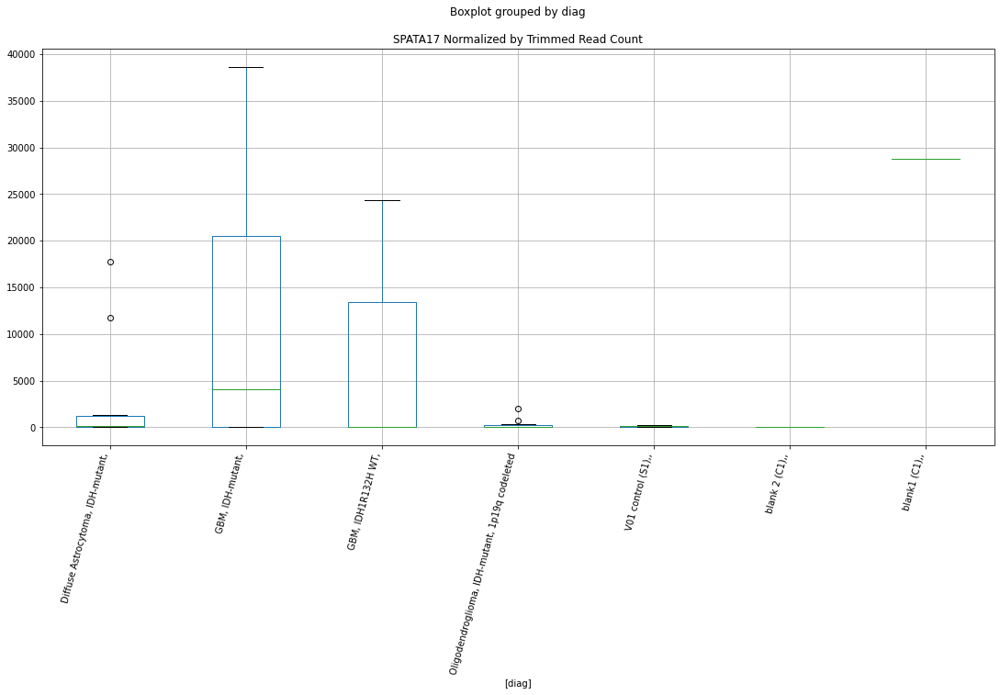

 p : 0.0311141287353018  ( t : 2.338285107258227 ) :  D-plex  :  cutadapt2  :  POLR2F
Control and blanks
76     0.0
340    0.0
Name: POLR2F, dtype: float64
208    1058.16
Name: POLR2F, dtype: float64
472    0.0
Name: POLR2F, dtype: float64


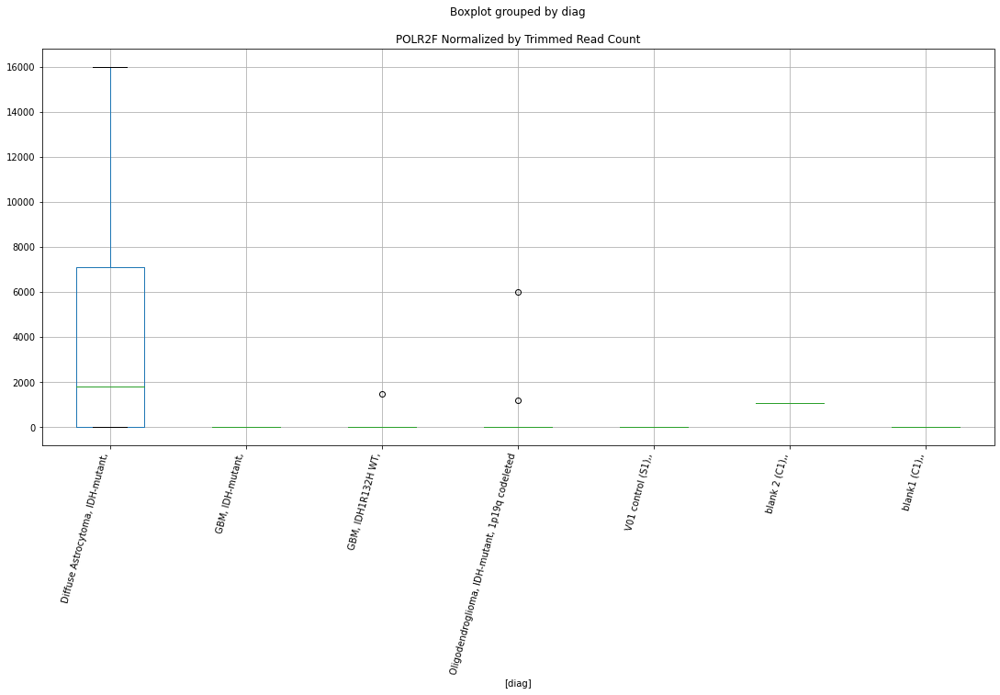

 p : 0.031192140848182035  ( t : 2.3370545425232567 ) :  Lexogen  :  bbduk2  :  SLC12A7
Control and blanks
79          0.00
343    147133.82
Name: SLC12A7, dtype: float64
211    0.0
Name: SLC12A7, dtype: float64
475    0.0
Name: SLC12A7, dtype: float64


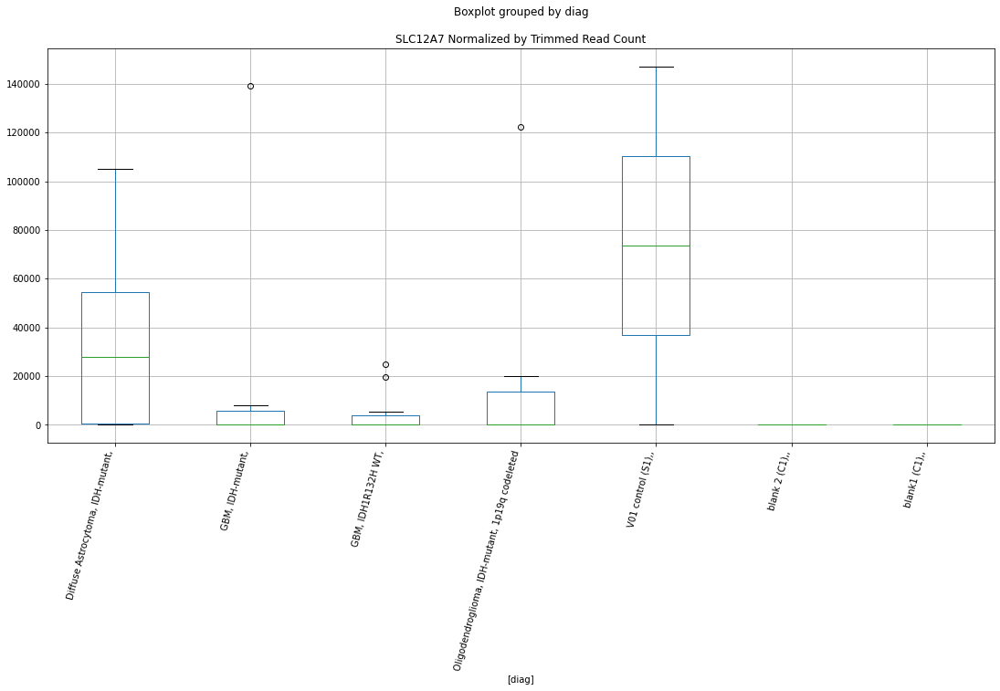

 p : 0.031196381420354517  ( t : 2.336987733711634 ) :  Lexogen  :  cutadapt2  :  PTPN14
Control and blanks
82     0.0
346    0.0
Name: PTPN14, dtype: float64
214    0.0
Name: PTPN14, dtype: float64
478    0.0
Name: PTPN14, dtype: float64


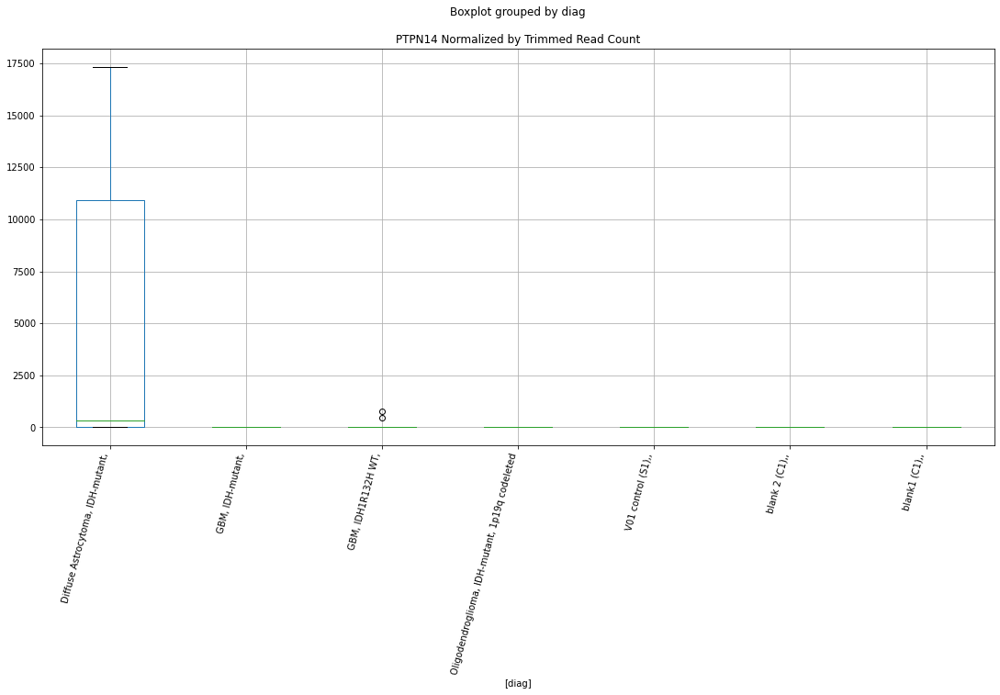

 p : 0.03132814350869134  ( t : 2.3349160628090146 ) :  D-plex  :  cutadapt2  :  PHGDH
Control and blanks
76       0.00
340    880.73
Name: PHGDH, dtype: float64
208    3879.92
Name: PHGDH, dtype: float64
472    3467.74
Name: PHGDH, dtype: float64


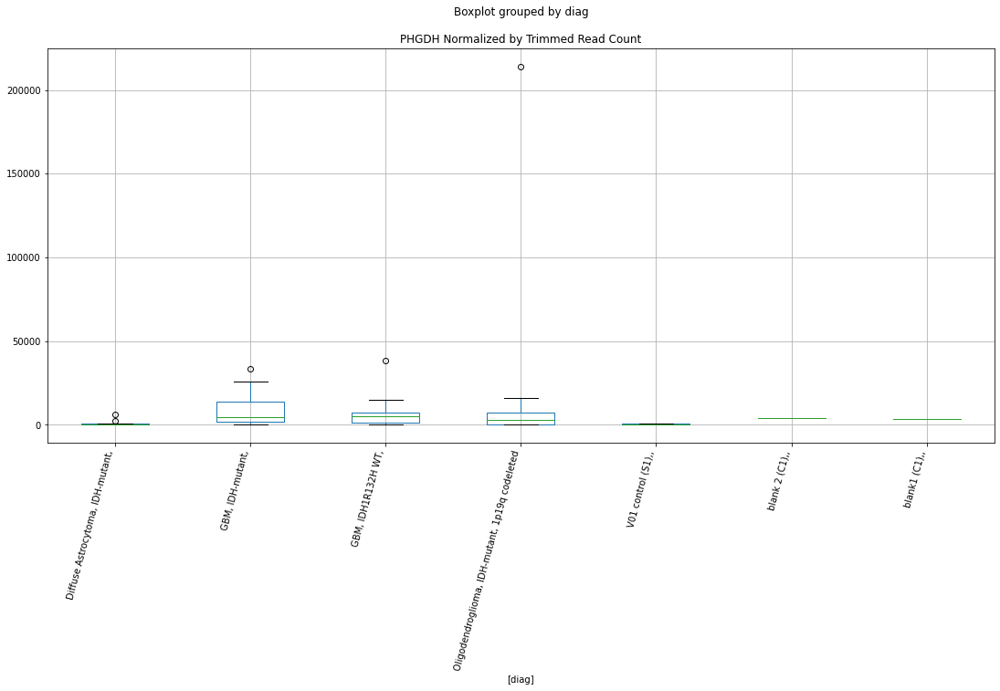

 p : 0.03134808975848085  ( t : 2.3346031580488984 ) :  D-plex  :  cutadapt2  :  PFDN4
Control and blanks
76     0.0
340    0.0
Name: PFDN4, dtype: float64
208    529.08
Name: PFDN4, dtype: float64
472    0.0
Name: PFDN4, dtype: float64


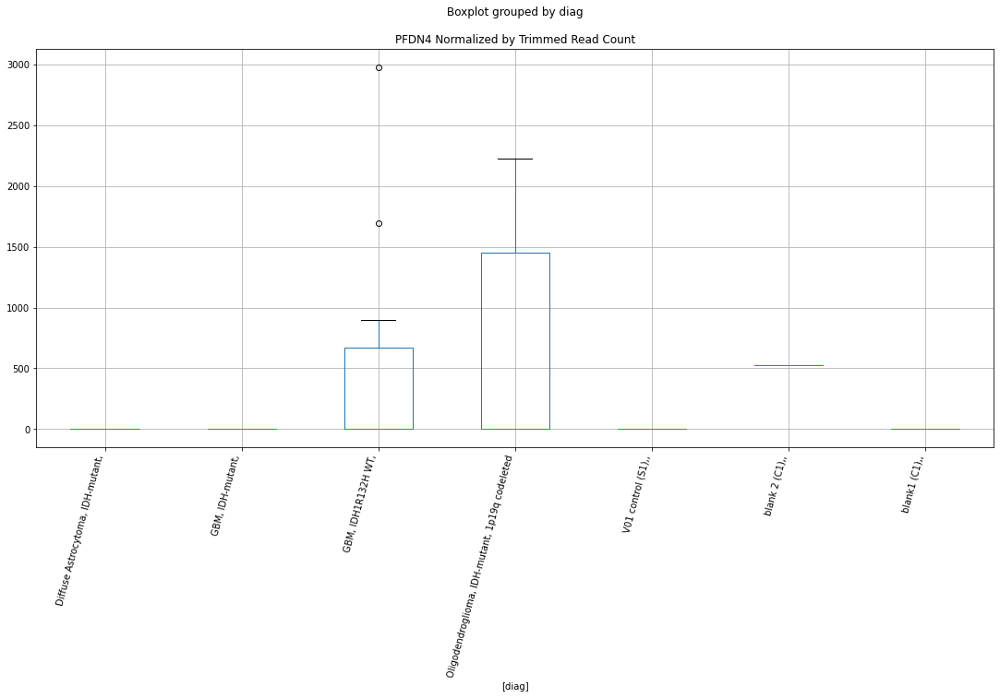

 p : 0.03135530810489831  ( t : 2.334489966598872 ) :  D-plex  :  bbduk2  :  PCDH9
Control and blanks
73          0.00
337    472673.51
Name: PCDH9, dtype: float64
205    15760.0
Name: PCDH9, dtype: float64
469    4732.22
Name: PCDH9, dtype: float64


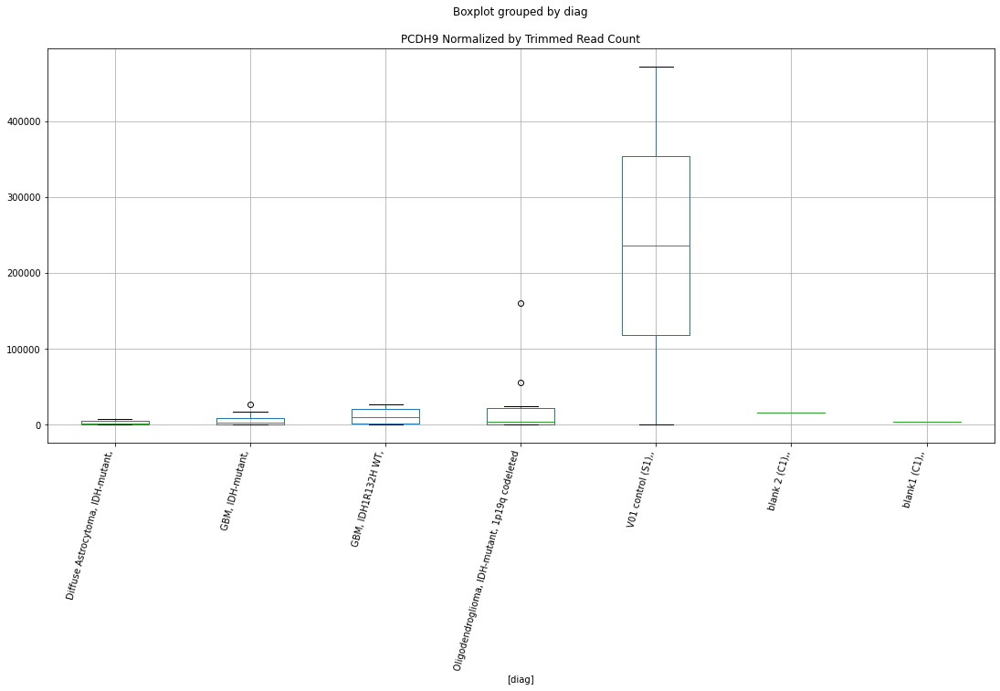

 p : 0.031375308765229475  ( t : 2.3341764612349847 ) :  D-plex  :  cutadapt2  :  PLPP6
Control and blanks
76     0.0
340    0.0
Name: PLPP6, dtype: float64
208    0.0
Name: PLPP6, dtype: float64
472    577.96
Name: PLPP6, dtype: float64


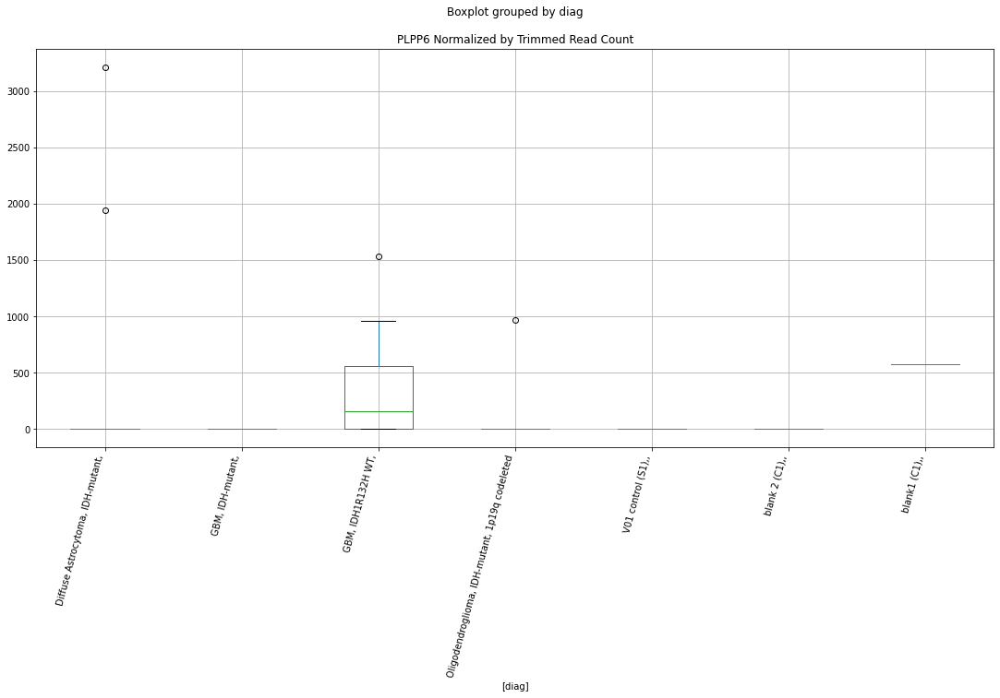

 p : 0.031427011738569585  ( t : 2.333366890332552 ) :  D-plex  :  bbduk2  :  SP4
Control and blanks
73      2319.03
337    28485.03
Name: SP4, dtype: float64
205    1253.64
Name: SP4, dtype: float64
469    0.0
Name: SP4, dtype: float64


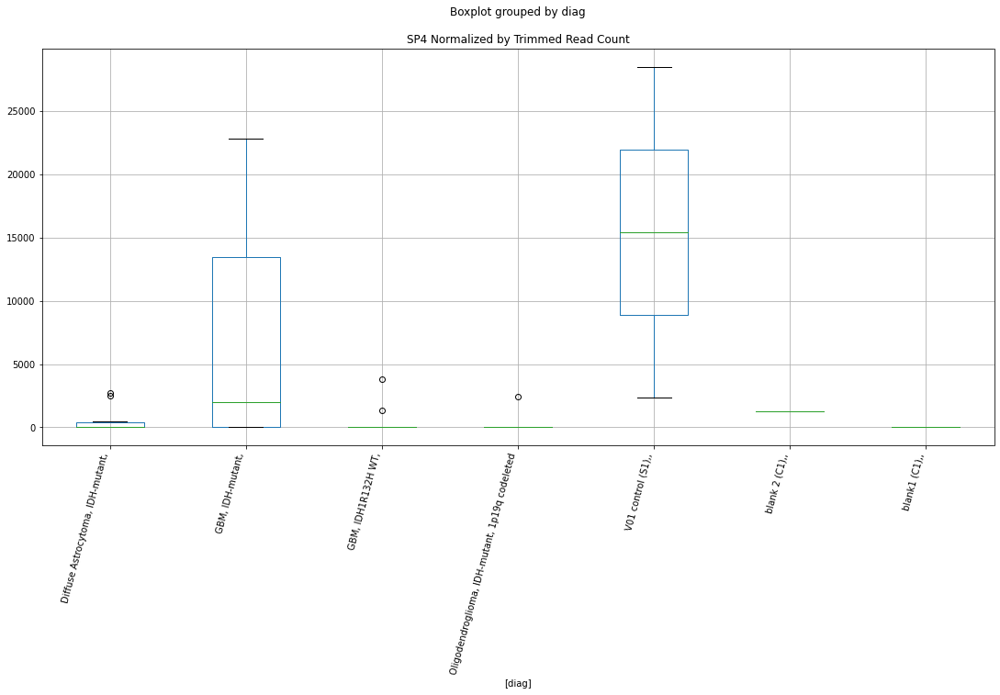

 p : 0.03151318294365679  ( t : 2.3320203599889537 ) :  D-plex  :  cutadapt2  :  SNX17
Control and blanks
76     0.0
340    0.0
Name: SNX17, dtype: float64
208    20986.87
Name: SNX17, dtype: float64
472    28897.79
Name: SNX17, dtype: float64


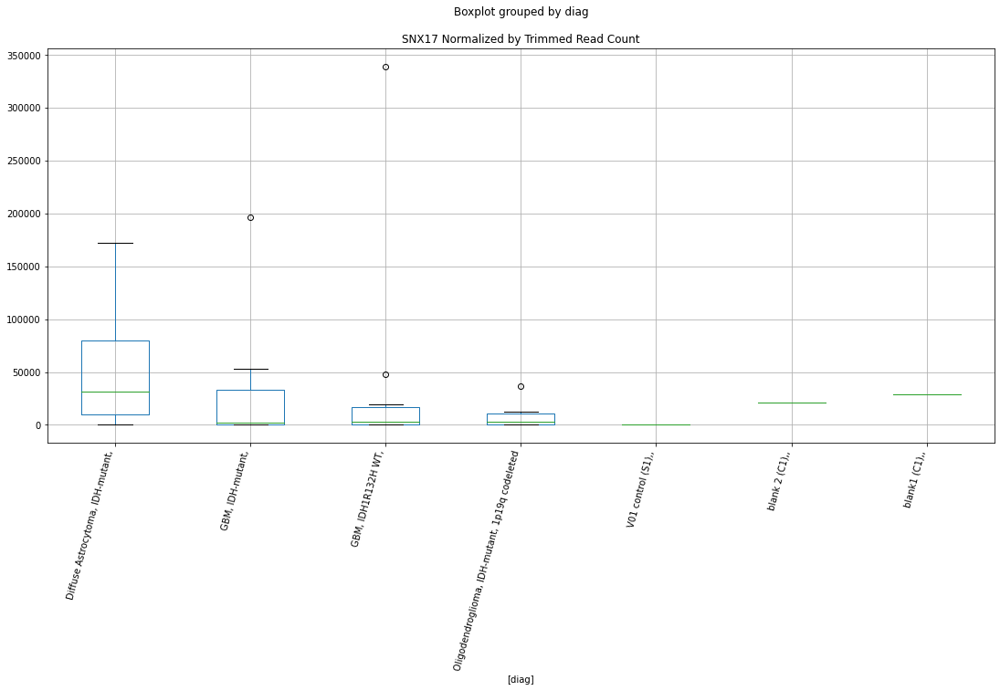

 p : 0.03151513611639501  ( t : 2.331989878973705 ) :  D-plex  :  bbduk2  :  RIC1
Control and blanks
73     332393.61
337         0.00
Name: RIC1, dtype: float64
205    5372.73
Name: RIC1, dtype: float64
469    5915.27
Name: RIC1, dtype: float64


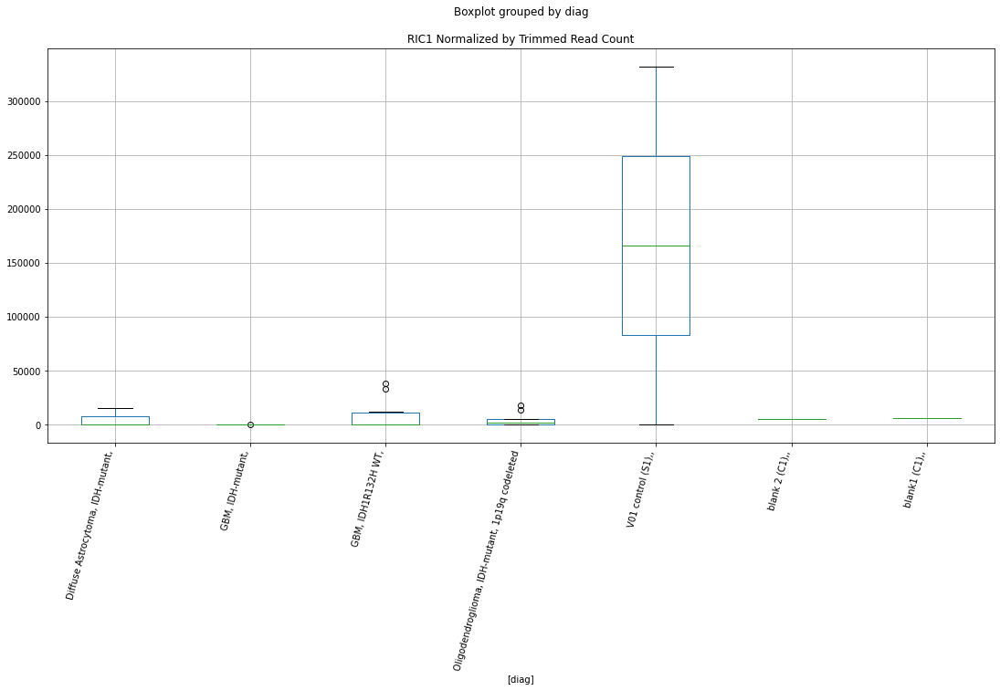

 p : 0.03157216456535313  ( t : 2.331100672167456 ) :  D-plex  :  bbduk2  :  SAPCD2
Control and blanks
73     0.0
337    0.0
Name: SAPCD2, dtype: float64
205    1432.73
Name: SAPCD2, dtype: float64
469    2366.11
Name: SAPCD2, dtype: float64


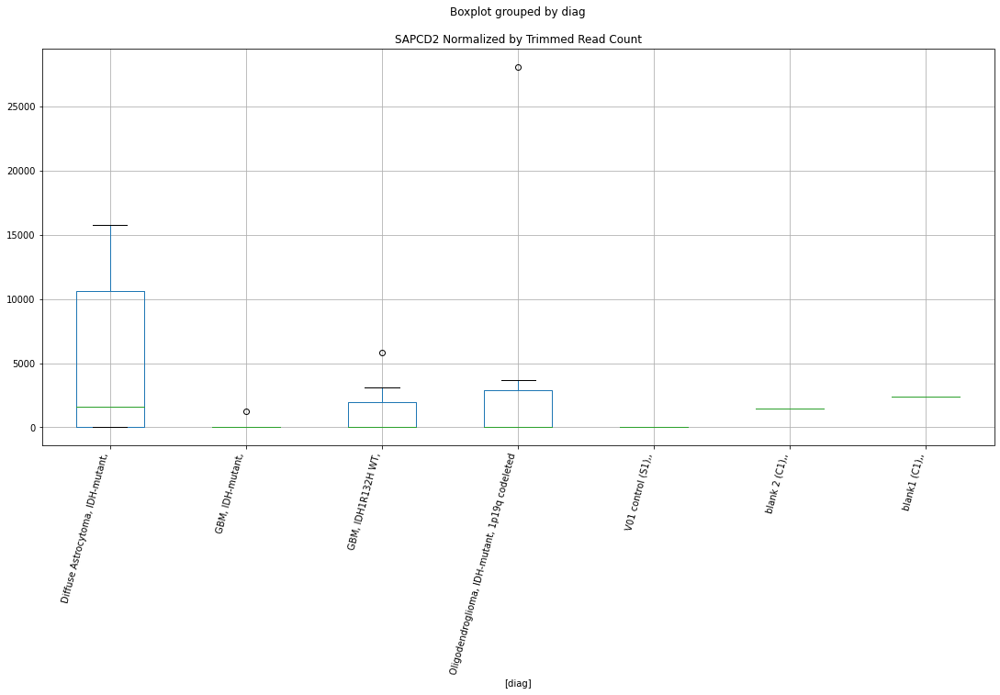

 p : 0.031592905658852685  ( t : 2.330777640297916 ) :  Lexogen  :  bbduk2  :  RAB25
Control and blanks
79     0.0
343    0.0
Name: RAB25, dtype: float64
211    0.0
Name: RAB25, dtype: float64
475    479.03
Name: RAB25, dtype: float64


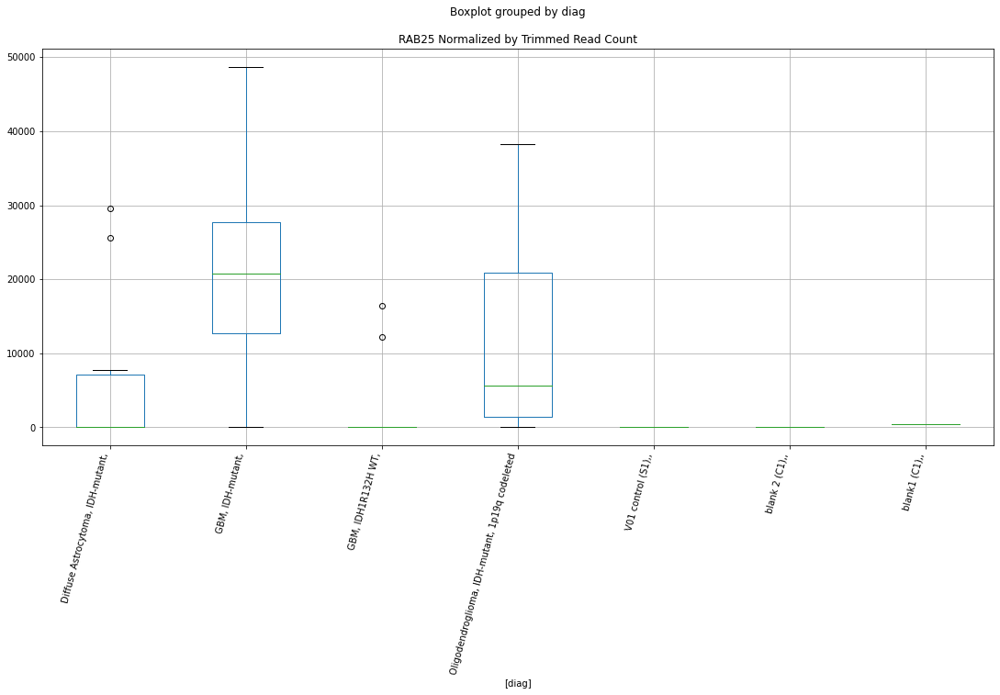

 p : 0.03160222094875214  ( t : 2.3306326235972468 ) :  D-plex  :  bbduk2  :  SLC25A14
Control and blanks
73     187841.04
337     24034.25
Name: SLC25A14, dtype: float64
205    51757.29
Name: SLC25A14, dtype: float64
469    69208.7
Name: SLC25A14, dtype: float64


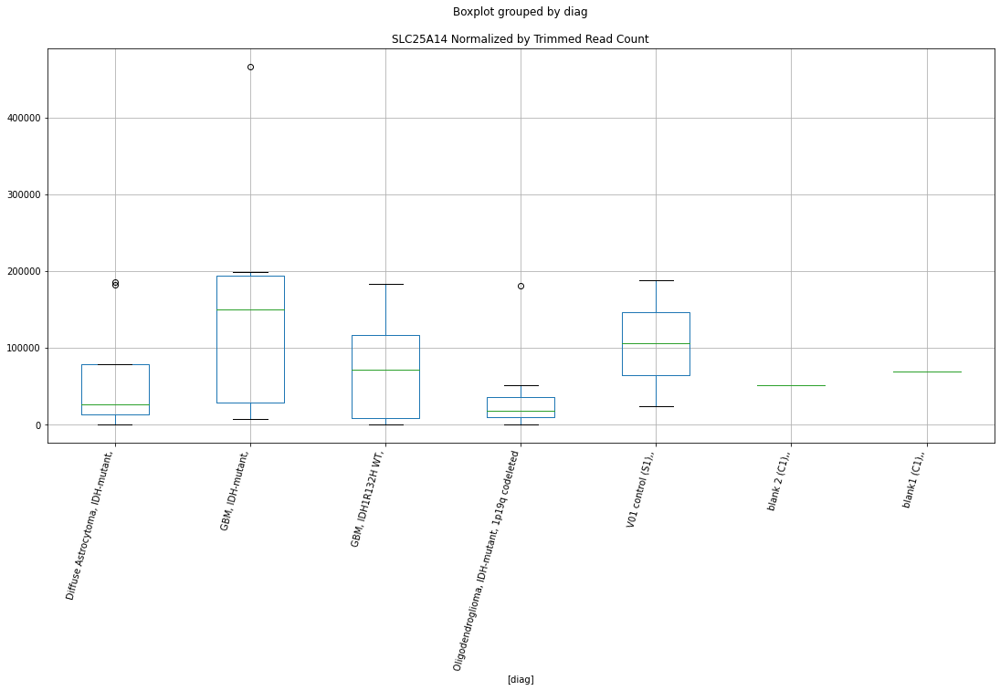

 p : 0.03161709110463766  ( t : 2.3304012132941962 ) :  Lexogen  :  cutadapt2  :  PAPLN
Control and blanks
82     0.0
346    0.0
Name: PAPLN, dtype: float64
214    0.0
Name: PAPLN, dtype: float64
478    0.0
Name: PAPLN, dtype: float64


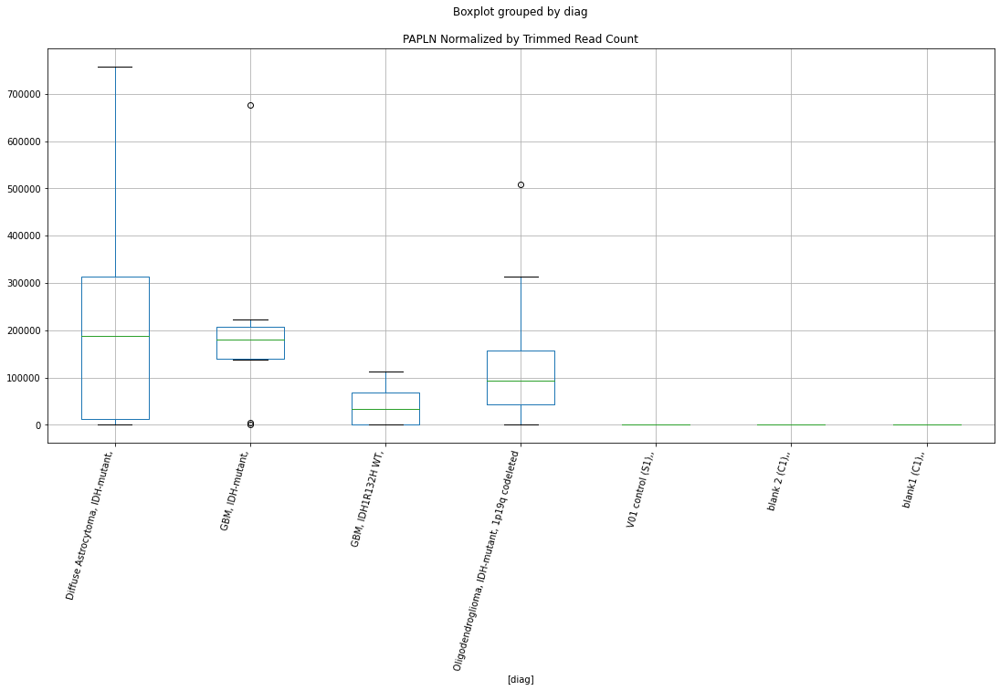

 p : 0.03166406434529156  ( t : 2.3296708767601406 ) :  Lexogen  :  cutadapt2  :  PRRT3
Control and blanks
82     0.0
346    0.0
Name: PRRT3, dtype: float64
214    0.0
Name: PRRT3, dtype: float64
478    0.0
Name: PRRT3, dtype: float64


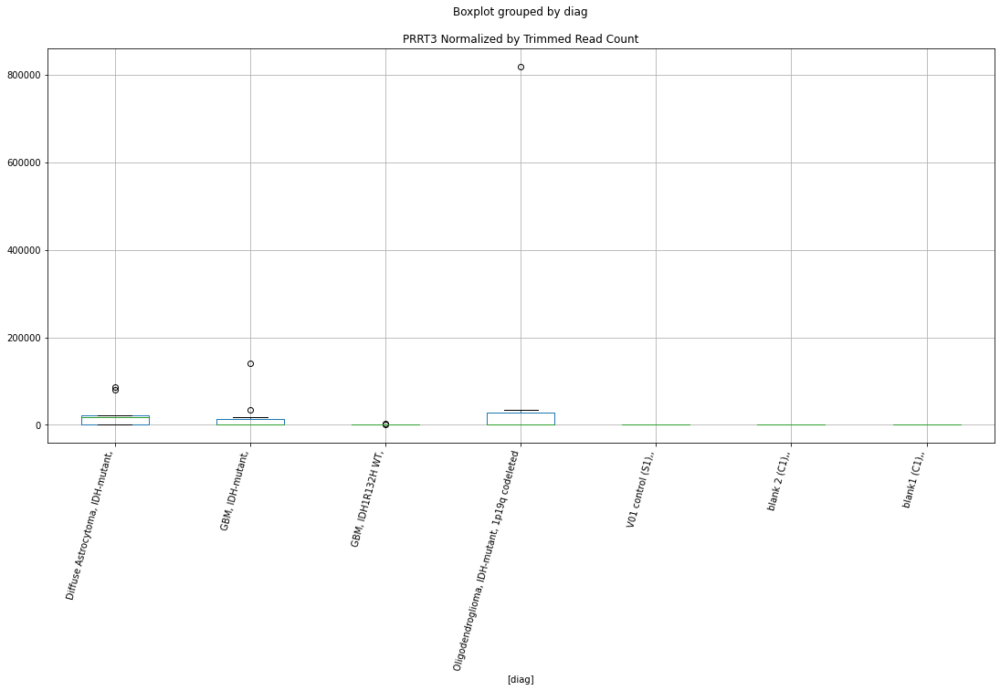

 p : 0.03179689056963192  ( t : 2.327611141037833 ) :  D-plex  :  cutadapt2  :  RIC1
Control and blanks
76     325774.11
340         0.00
Name: RIC1, dtype: float64
208    5290.81
Name: RIC1, dtype: float64
472    5779.56
Name: RIC1, dtype: float64


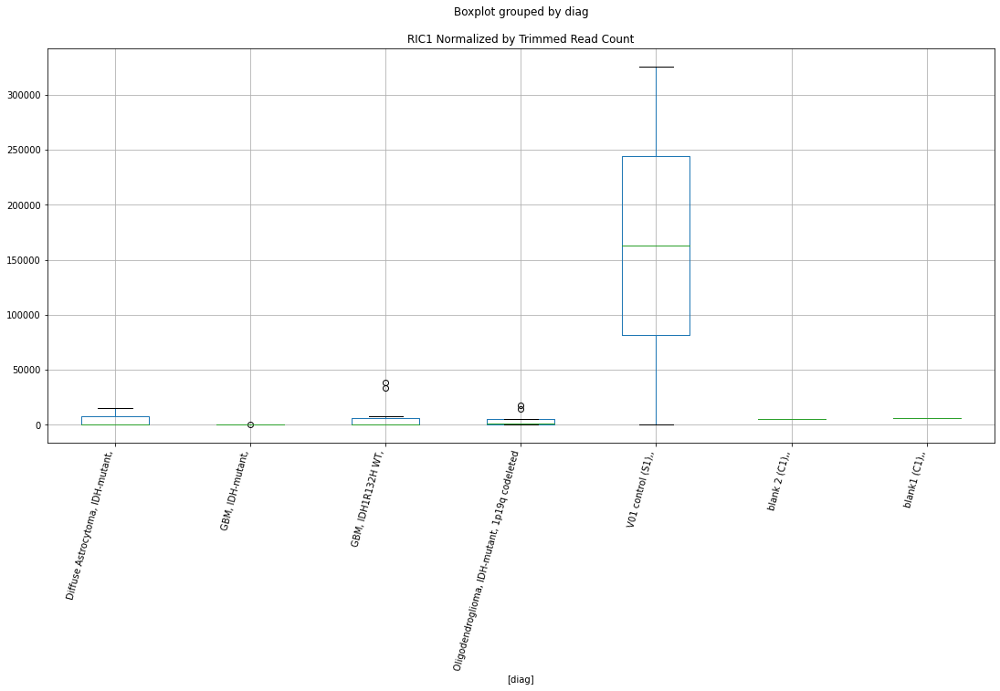

 p : 0.03181021398357537  ( t : 2.327404976424468 ) :  Lexogen  :  bbduk2  :  PAPLN
Control and blanks
79     0.0
343    0.0
Name: PAPLN, dtype: float64
211    0.0
Name: PAPLN, dtype: float64
475    0.0
Name: PAPLN, dtype: float64


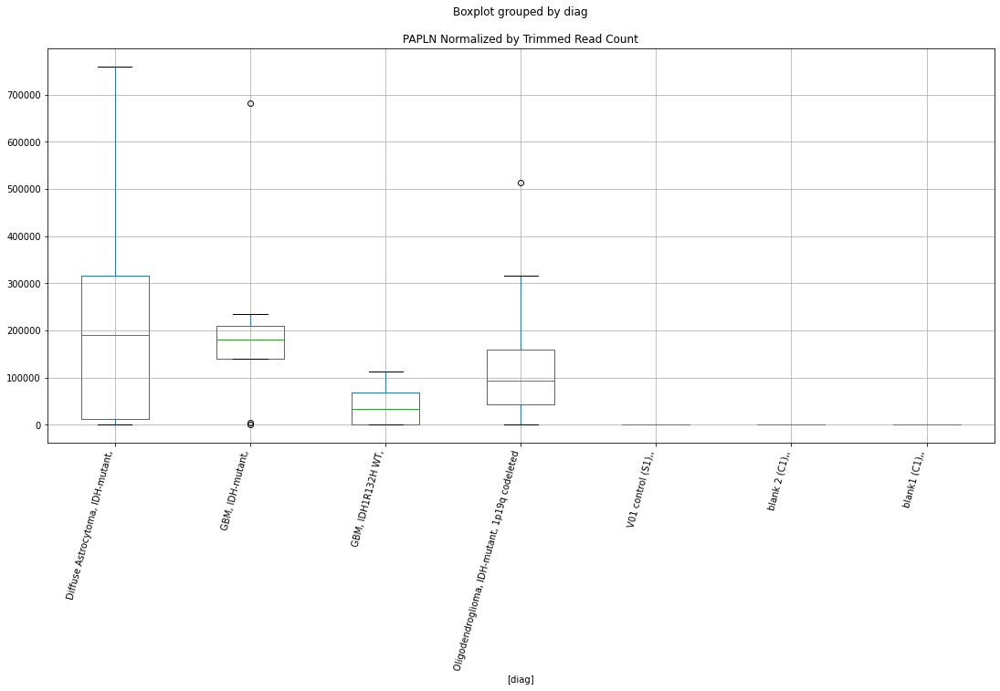

 p : 0.03197291850402165  ( t : 2.3248937624728305 ) :  D-plex  :  cutadapt2  :  SCGB2B2
Control and blanks
76     0.0
340    0.0
Name: SCGB2B2, dtype: float64
208    176.36
Name: SCGB2B2, dtype: float64
472    0.0
Name: SCGB2B2, dtype: float64


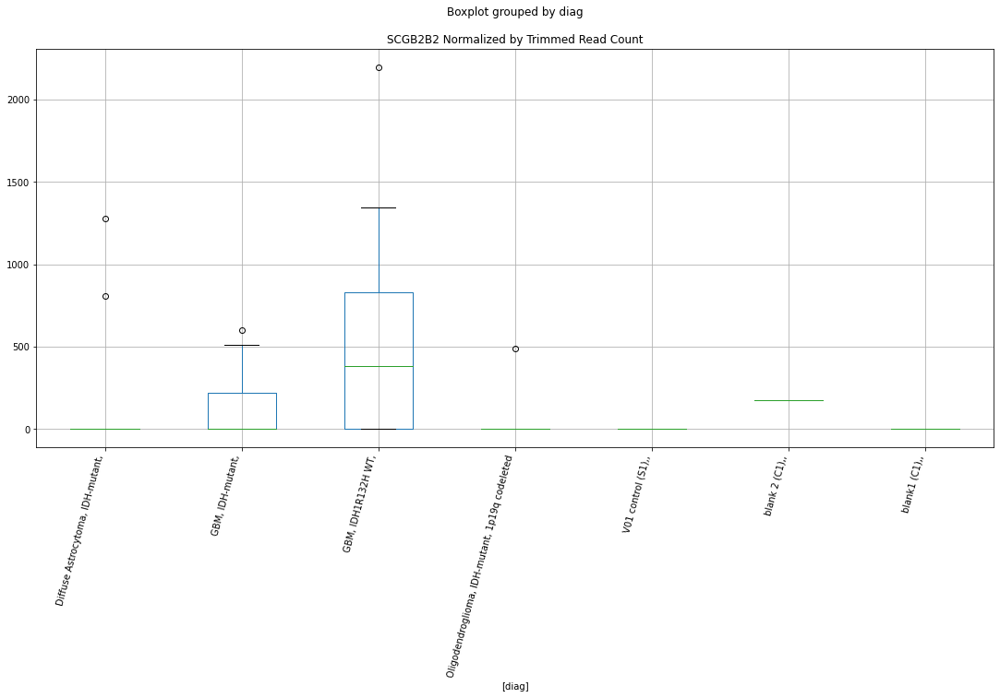

 p : 0.03201254492419097  ( t : 2.3242839587713084 ) :  D-plex  :  cutadapt2  :  ORAI3
Control and blanks
76     0.0
340    0.0
Name: ORAI3, dtype: float64
208    529.08
Name: ORAI3, dtype: float64
472    577.96
Name: ORAI3, dtype: float64


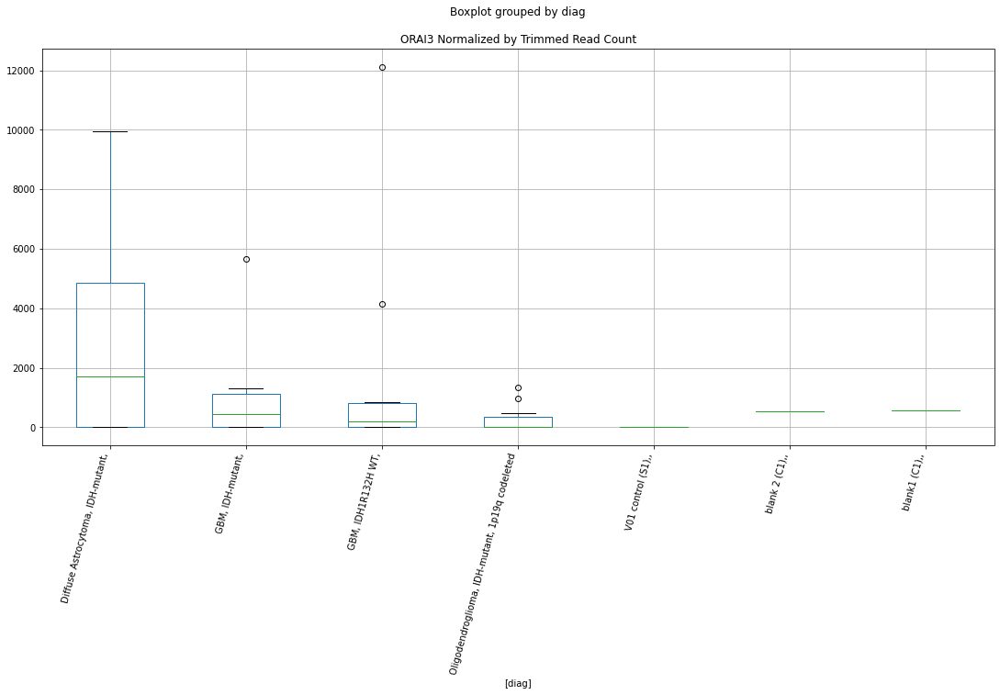

 p : 0.0320986086166302  ( t : 2.322961952391906 ) :  D-plex  :  cutadapt2  :  PHYKPL
Control and blanks
76        0.00
340    4403.66
Name: PHYKPL, dtype: float64
208    66840.52
Name: PHYKPL, dtype: float64
472    113857.3
Name: PHYKPL, dtype: float64


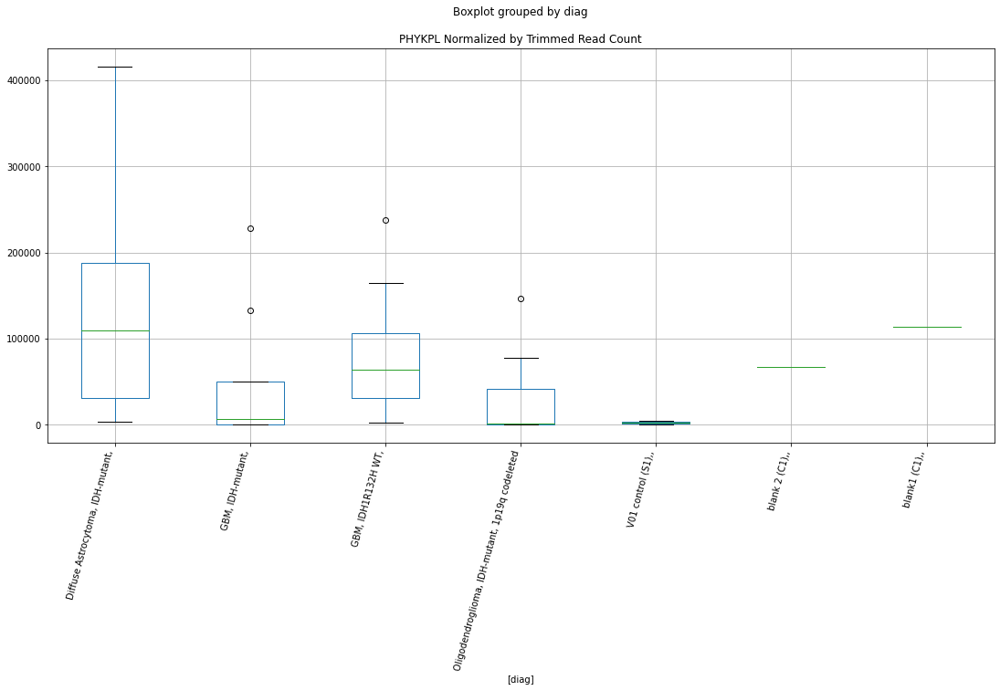

 p : 0.032179837628333534  ( t : 2.321717227690073 ) :  D-plex  :  cutadapt2  :  PPP2R3A
Control and blanks
76     0.0
340    0.0
Name: PPP2R3A, dtype: float64
208    2998.12
Name: PPP2R3A, dtype: float64
472    10403.21
Name: PPP2R3A, dtype: float64


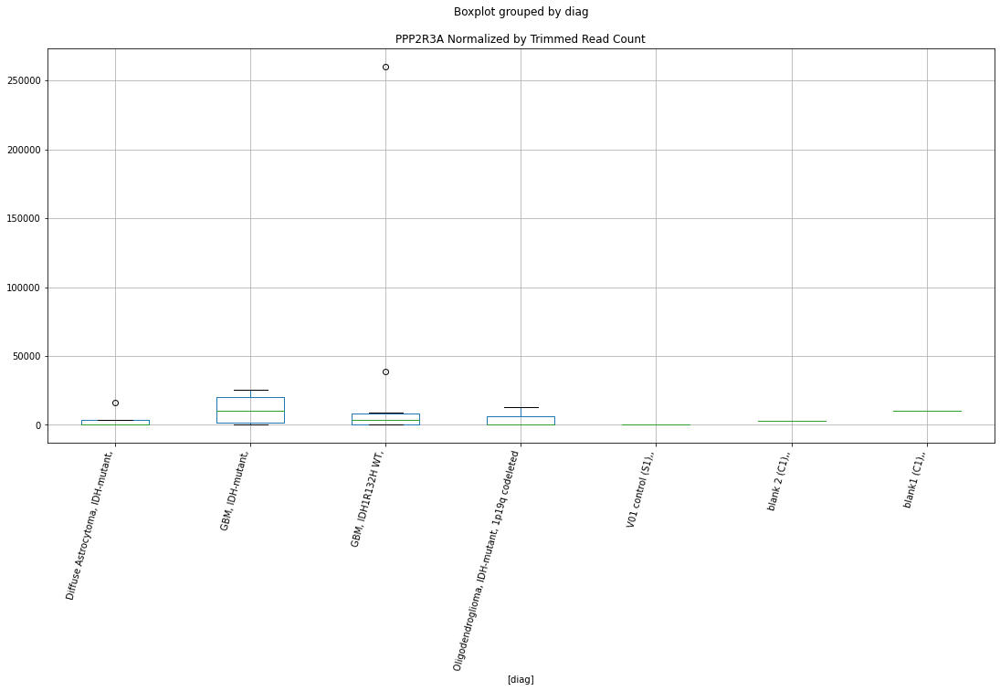

 p : 0.03222857253019651  ( t : 2.320971831336996 ) :  D-plex  :  bbduk2  :  PINK1-AS
Control and blanks
73     0.0
337    0.0
Name: PINK1-AS, dtype: float64
205    537.27
Name: PINK1-AS, dtype: float64
469    591.53
Name: PINK1-AS, dtype: float64


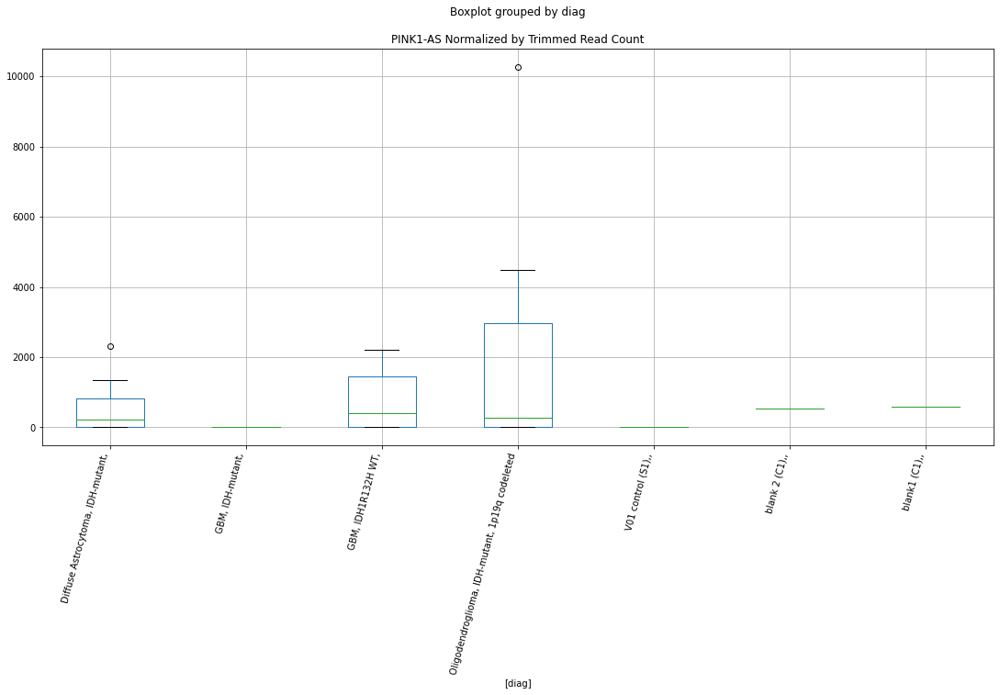

 p : 0.03226050682069876  ( t : 2.3204839665348698 ) :  D-plex  :  bbduk2  :  RGS3
Control and blanks
73     0.0
337    0.0
Name: RGS3, dtype: float64
205    0.0
Name: RGS3, dtype: float64
469    0.0
Name: RGS3, dtype: float64


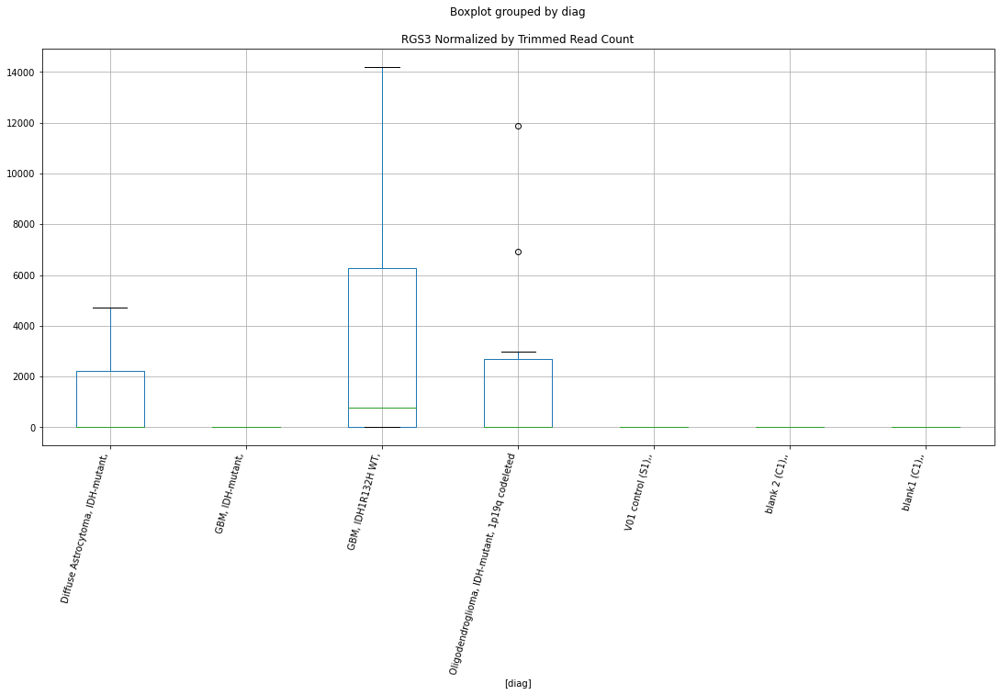

 p : 0.03227263358414517  ( t : 2.3202988217036666 ) :  D-plex  :  bbduk2  :  SLC25A40
Control and blanks
73         0.00
337    13352.36
Name: SLC25A40, dtype: float64
205    0.0
Name: SLC25A40, dtype: float64
469    0.0
Name: SLC25A40, dtype: float64


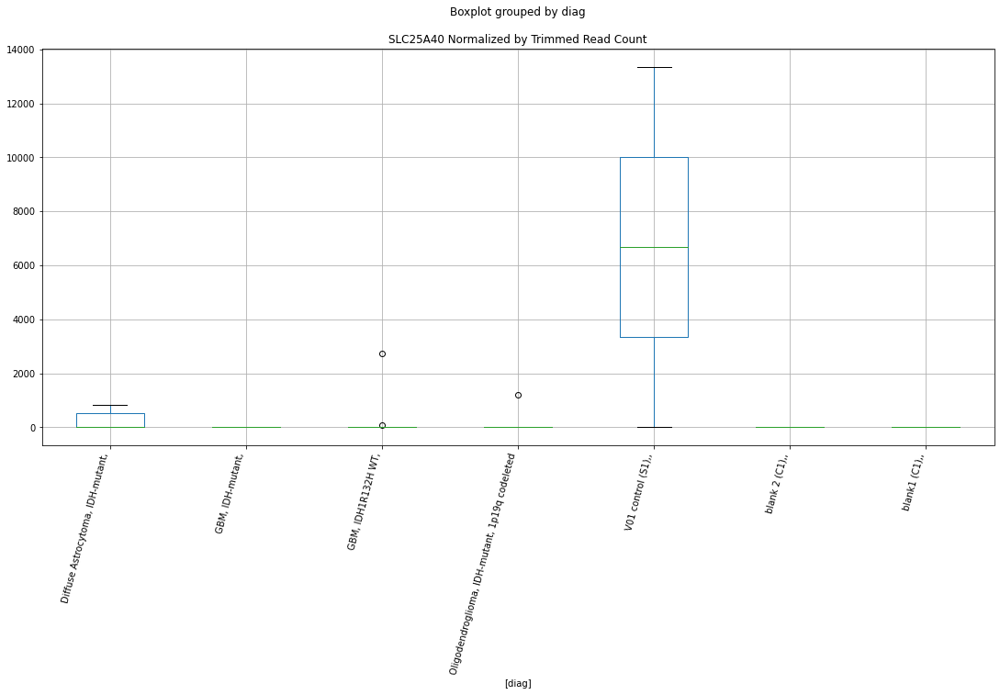

 p : 0.03237829485590964  ( t : 2.3186883713609614 ) :  D-plex  :  bbduk2  :  SEC62
Control and blanks
73     0.0
337    0.0
Name: SEC62, dtype: float64
205    0.0
Name: SEC62, dtype: float64
469    2366.11
Name: SEC62, dtype: float64


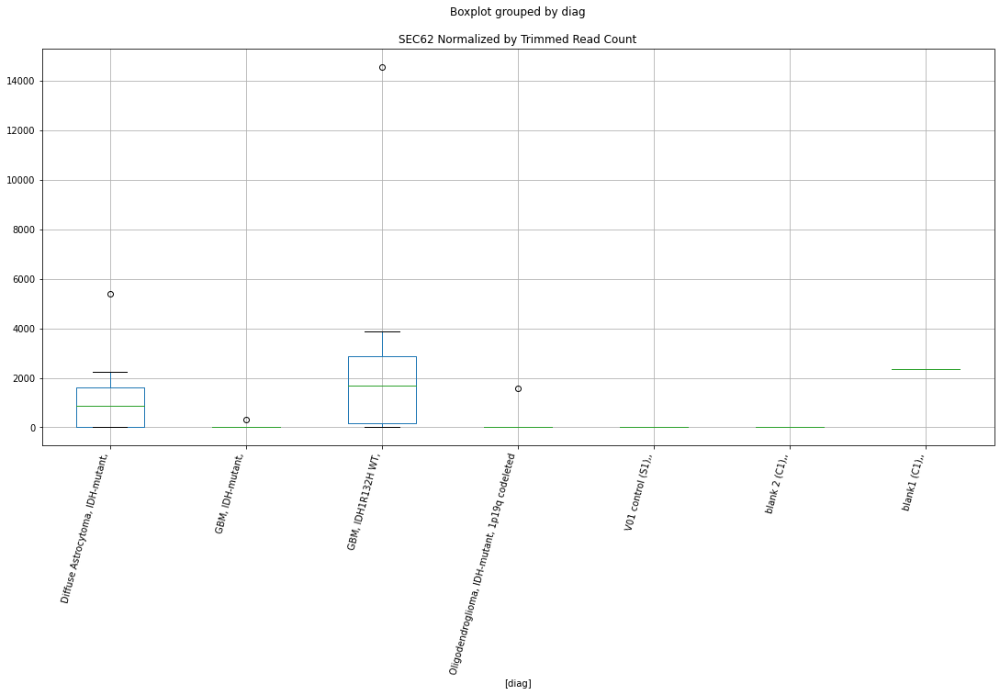

 p : 0.0324153421910767  ( t : 2.3181248649118156 ) :  D-plex  :  cutadapt2  :  PLA2G4B
Control and blanks
76     38638.32
340        0.00
Name: PLA2G4B, dtype: float64
208    352.72
Name: PLA2G4B, dtype: float64
472    1155.91
Name: PLA2G4B, dtype: float64


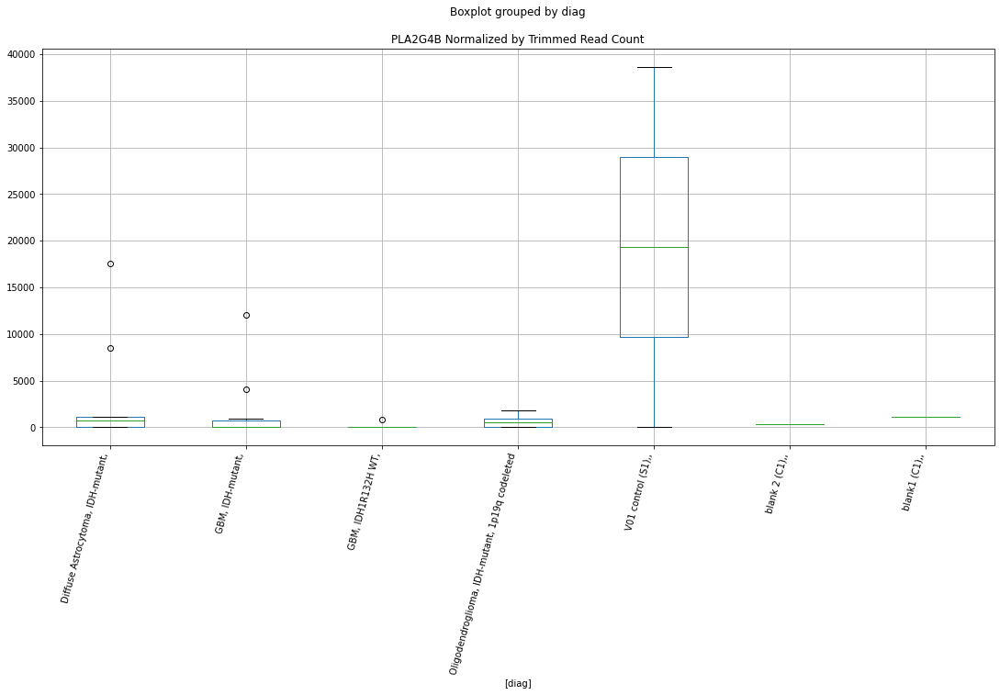

 p : 0.0324479984448386  ( t : 2.317628644461008 ) :  D-plex  :  cutadapt2  :  SIX2
Control and blanks
76     0.0
340    0.0
Name: SIX2, dtype: float64
208    0.0
Name: SIX2, dtype: float64
472    0.0
Name: SIX2, dtype: float64


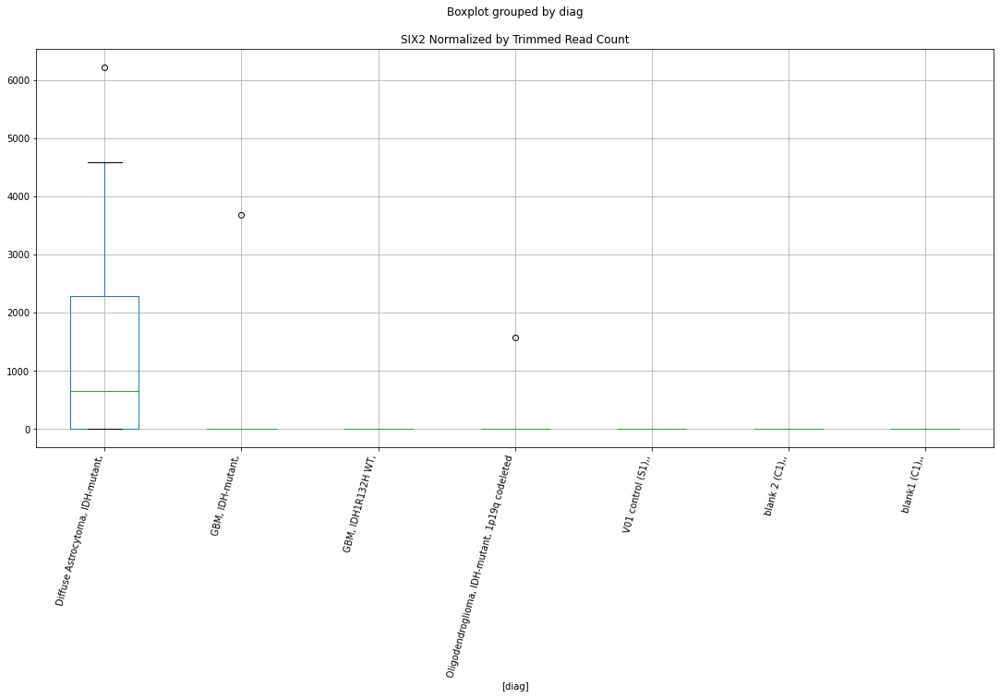

 p : 0.03246992815566803  ( t : 2.317295676876119 ) :  D-plex  :  bbduk2  :  SEC22B3P
Control and blanks
73      773.01
337    8011.42
Name: SEC22B3P, dtype: float64
205    2865.46
Name: SEC22B3P, dtype: float64
469    1774.58
Name: SEC22B3P, dtype: float64


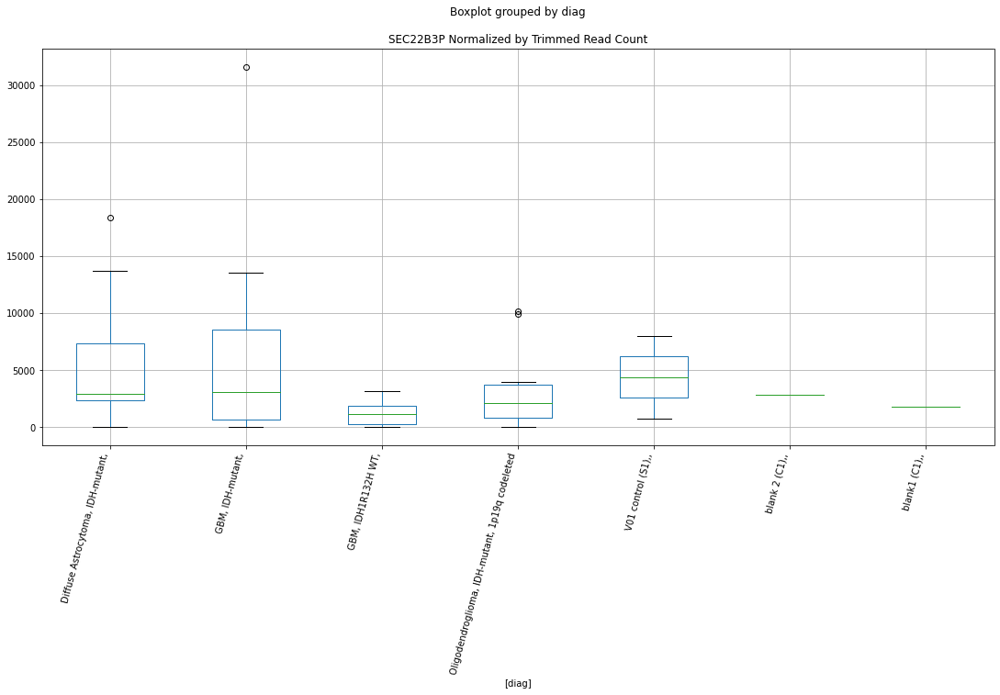

 p : 0.03252175901814476  ( t : 2.316509537337424 ) :  D-plex  :  bbduk2  :  PHGDH
Control and blanks
73       0.00
337    890.16
Name: PHGDH, dtype: float64
205    10387.28
Name: PHGDH, dtype: float64
469    0.0
Name: PHGDH, dtype: float64


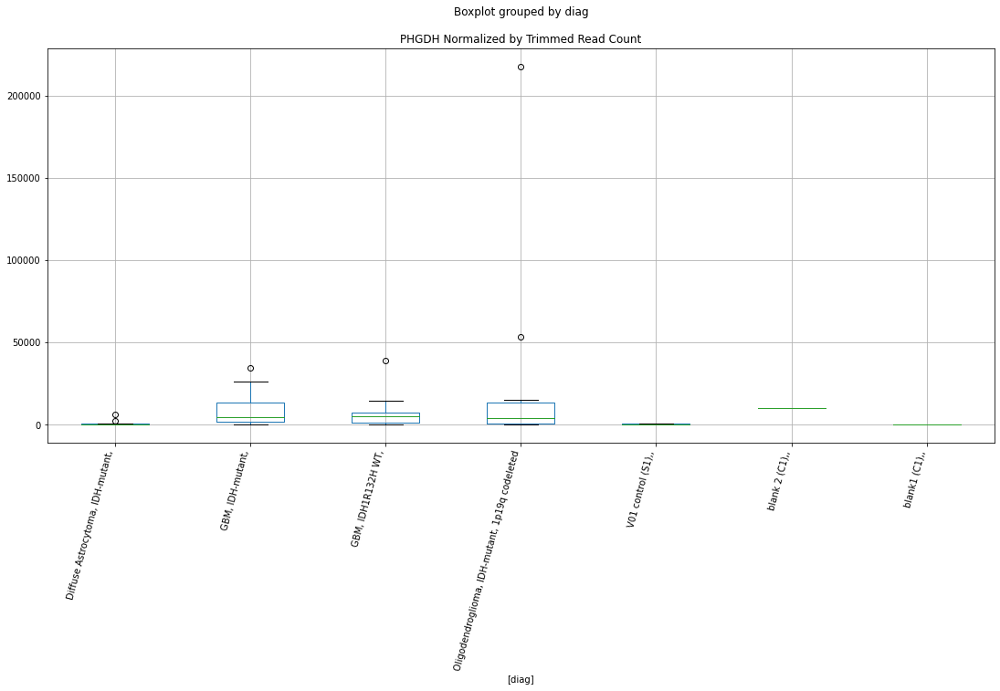

 p : 0.03255587333129712  ( t : 2.3159927463736913 ) :  Lexogen  :  cutadapt2  :  PLD6
Control and blanks
82     0.0
346    0.0
Name: PLD6, dtype: float64
214    0.0
Name: PLD6, dtype: float64
478    0.0
Name: PLD6, dtype: float64


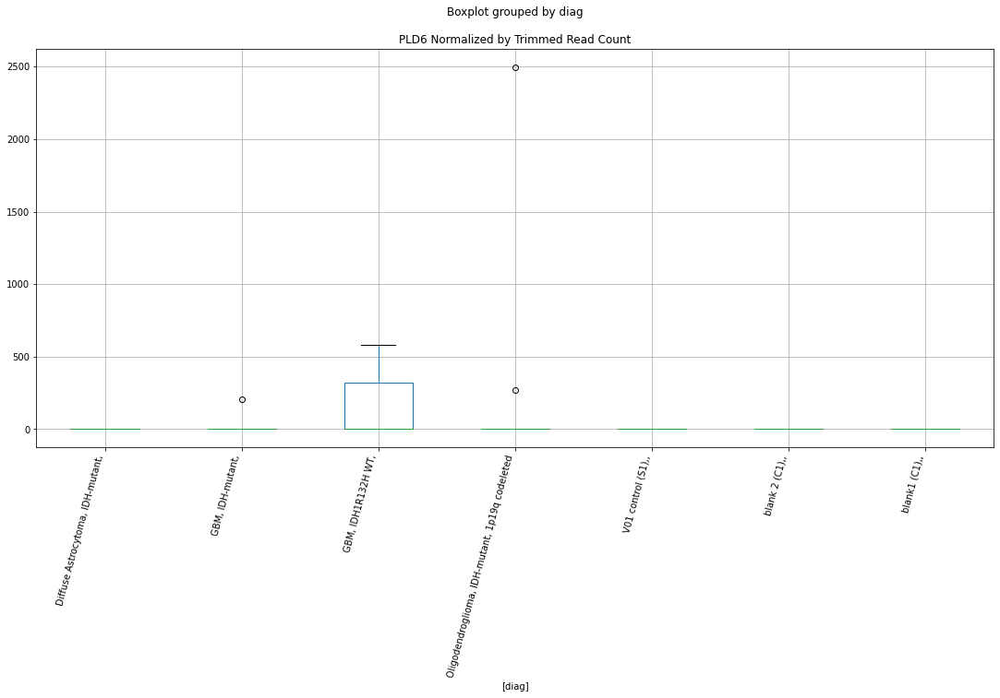

 p : 0.03256372650440791  ( t : 2.3158738514051582 ) :  D-plex  :  cutadapt2  :  RNA45SN1
Control and blanks
76     4.24e+06
340    2.53e+06
Name: RNA45SN1, dtype: float64
208    2.49e+06
Name: RNA45SN1, dtype: float64
472    2.57e+06
Name: RNA45SN1, dtype: float64


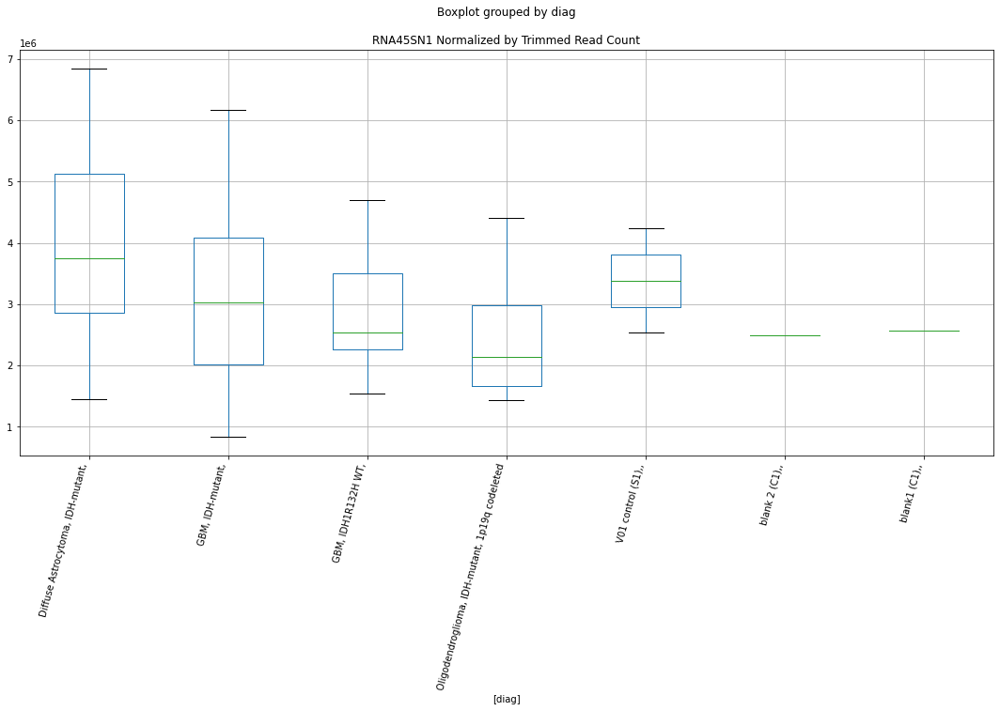

 p : 0.032589922997839006  ( t : 2.31547743582283 ) :  D-plex  :  cutadapt2  :  SEC62
Control and blanks
76     0.0
340    0.0
Name: SEC62, dtype: float64
208    0.0
Name: SEC62, dtype: float64
472    2311.82
Name: SEC62, dtype: float64


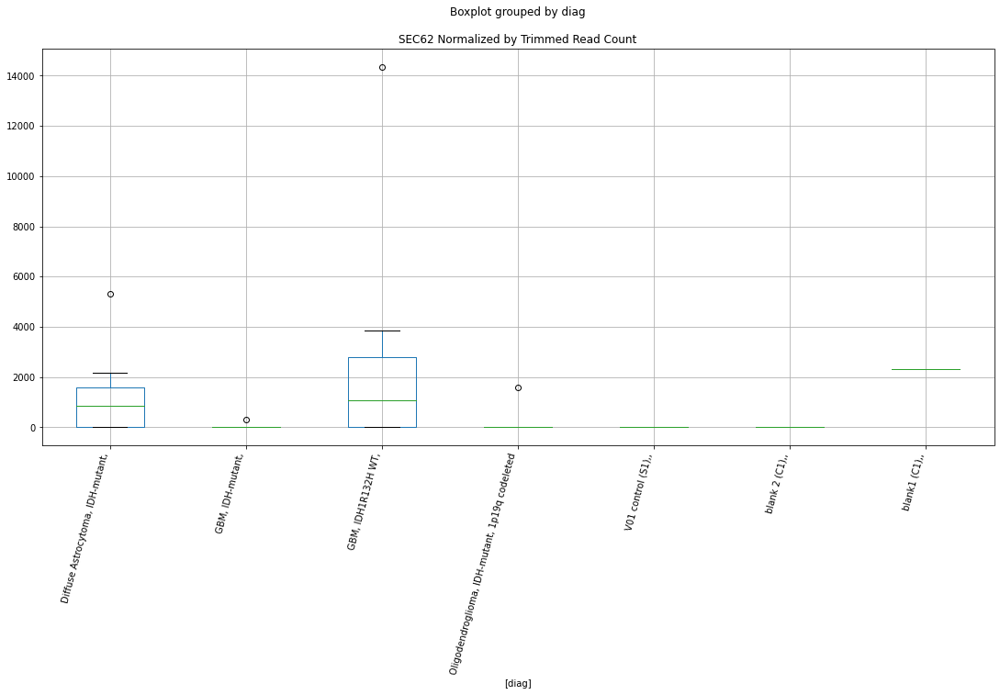

 p : 0.03260414149739352  ( t : 2.3152623997664743 ) :  D-plex  :  cutadapt2  :  POTEC
Control and blanks
76         0.00
340    12330.25
Name: POTEC, dtype: float64
208    1939.96
Name: POTEC, dtype: float64
472    1155.91
Name: POTEC, dtype: float64


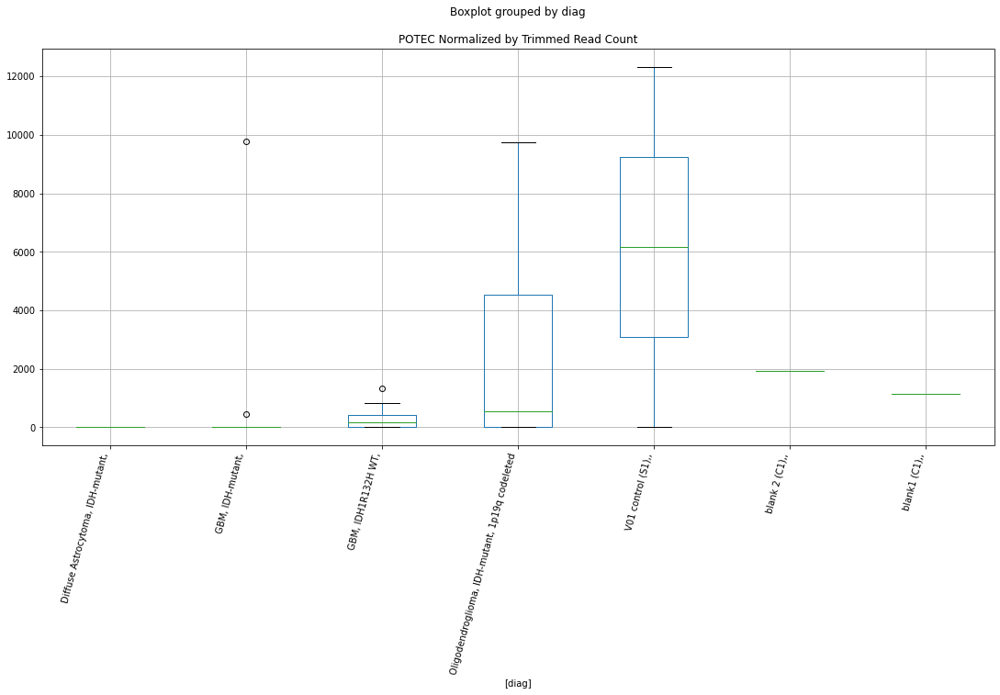

 p : 0.03269591204475841  ( t : 2.313876581838858 ) :  D-plex  :  cutadapt2  :  RNA45SN5
Control and blanks
76     4.24e+06
340    2.53e+06
Name: RNA45SN5, dtype: float64
208    2.48e+06
Name: RNA45SN5, dtype: float64
472    2.56e+06
Name: RNA45SN5, dtype: float64


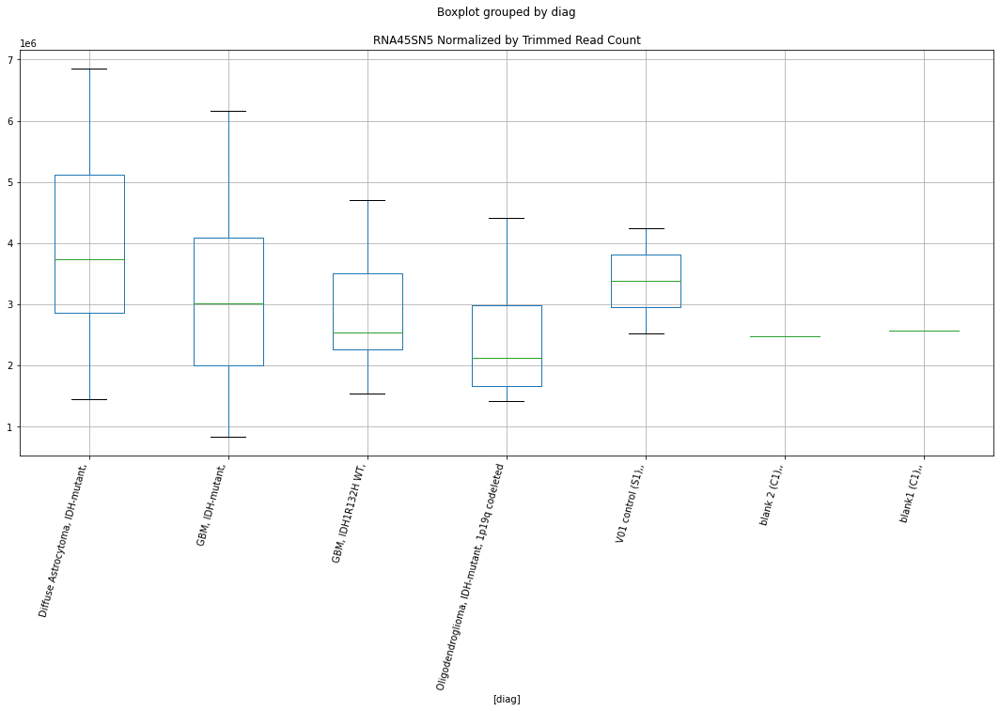

 p : 0.03269892201459278  ( t : 2.313831189766299 ) :  Lexogen  :  cutadapt2  :  RPS6KA3
Control and blanks
82         0.00
346    19991.28
Name: RPS6KA3, dtype: float64
214    36073.12
Name: RPS6KA3, dtype: float64
478    9023.5
Name: RPS6KA3, dtype: float64


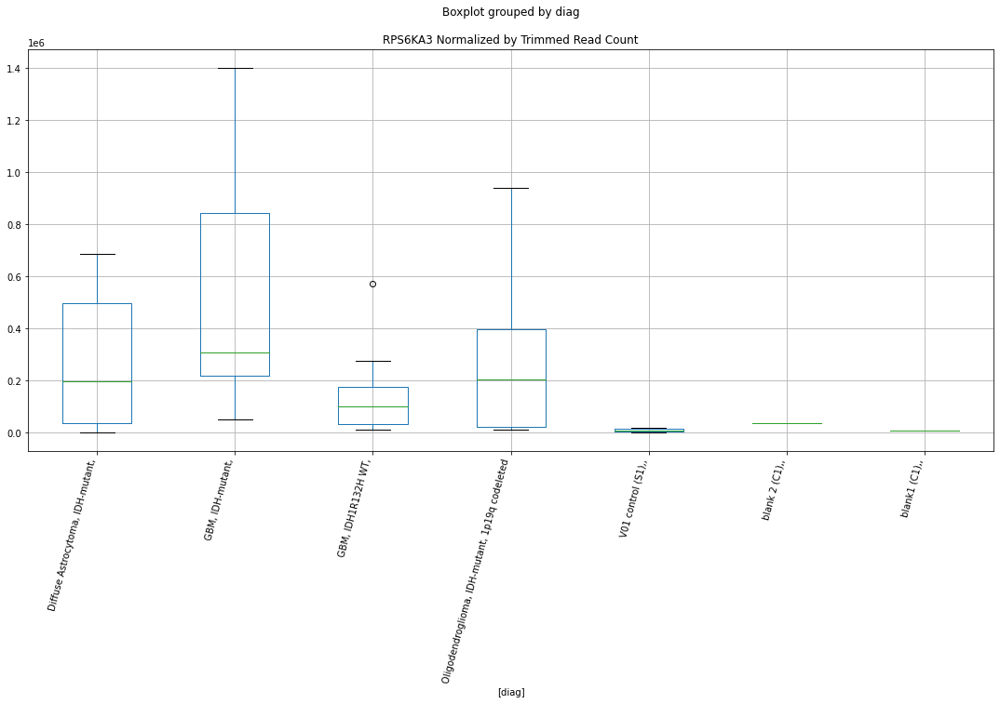

 p : 0.032717814207598984  ( t : 2.313546373190736 ) :  Lexogen  :  cutadapt2  :  SOX11
Control and blanks
82       0.00
346    210.43
Name: SOX11, dtype: float64
214    0.0
Name: SOX11, dtype: float64
478    0.0
Name: SOX11, dtype: float64


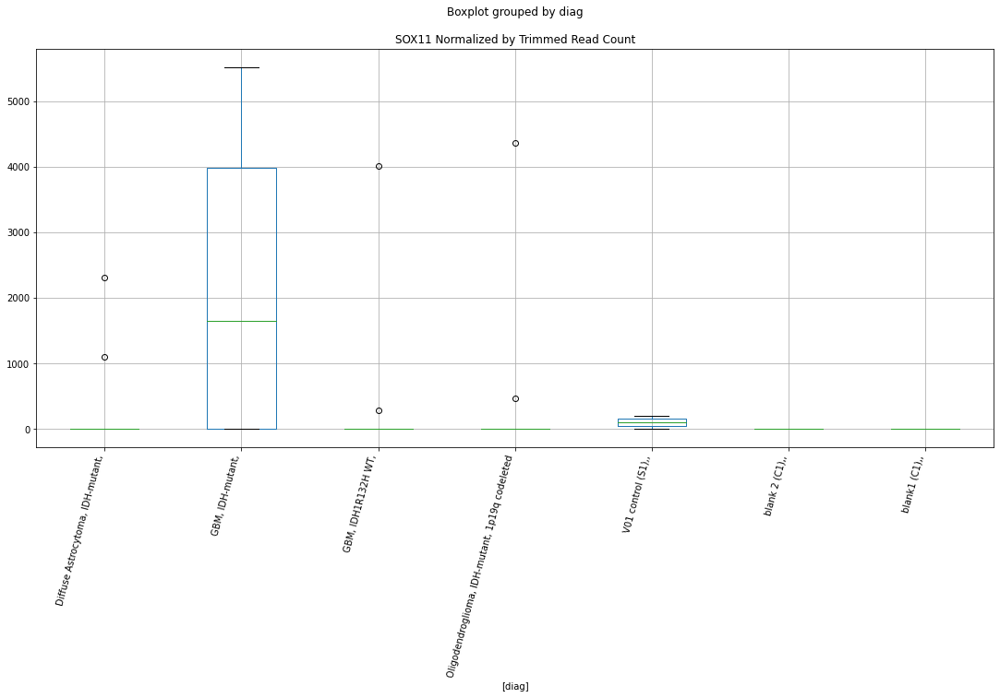

 p : 0.03275718809256356  ( t : 2.3129532672154642 ) :  D-plex  :  cutadapt2  :  OXA1L
Control and blanks
76     757.61
340      0.00
Name: OXA1L, dtype: float64
208    352.72
Name: OXA1L, dtype: float64
472    0.0
Name: OXA1L, dtype: float64


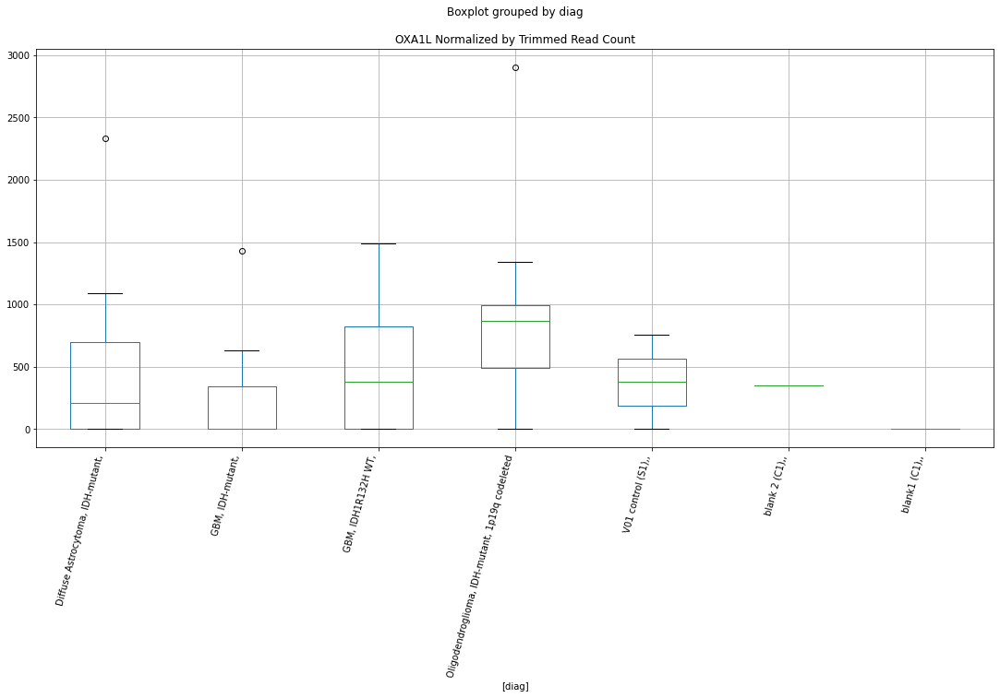

 p : 0.03280572904191406  ( t : 2.312222983801411 ) :  D-plex  :  cutadapt2  :  RAB4B
Control and blanks
76     93186.55
340     6165.12
Name: RAB4B, dtype: float64
208    72131.33
Name: RAB4B, dtype: float64
472    49126.25
Name: RAB4B, dtype: float64


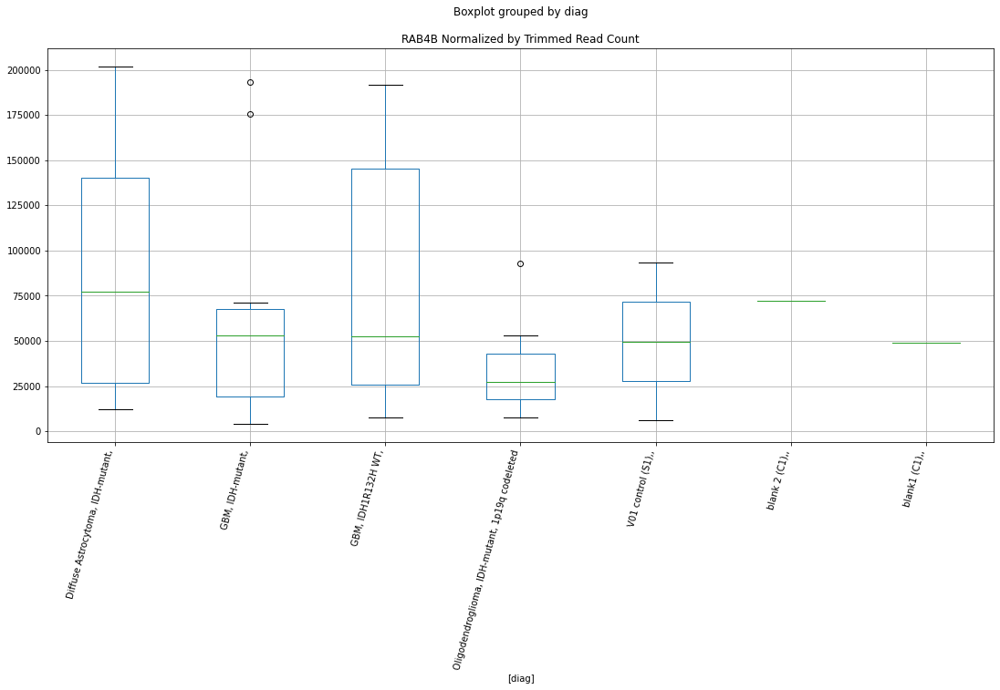

 p : 0.032813690624003036  ( t : 2.31210330003361 ) :  D-plex  :  bbduk2  :  SLC9A9-AS1
Control and blanks
73     57202.62
337      890.16
Name: SLC9A9-AS1, dtype: float64
205    895.45
Name: SLC9A9-AS1, dtype: float64
469    0.0
Name: SLC9A9-AS1, dtype: float64


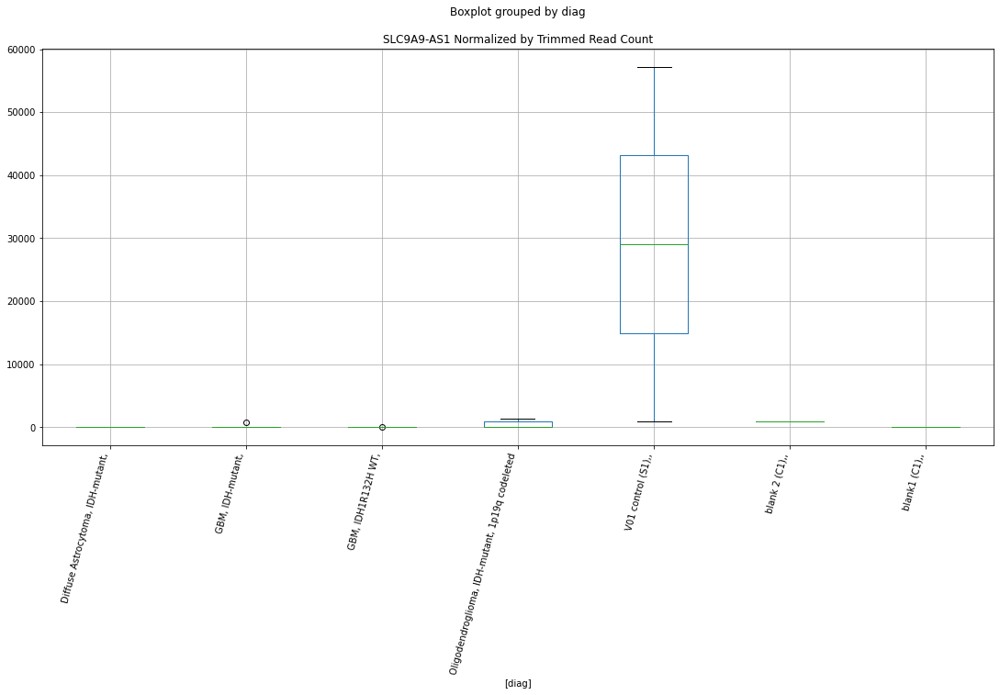

 p : 0.03283583556960949  ( t : 2.3117705442441334 ) :  Lexogen  :  cutadapt2  :  SERPINB6
Control and blanks
82     0.0
346    0.0
Name: SERPINB6, dtype: float64
214    0.0
Name: SERPINB6, dtype: float64
478    8073.66
Name: SERPINB6, dtype: float64


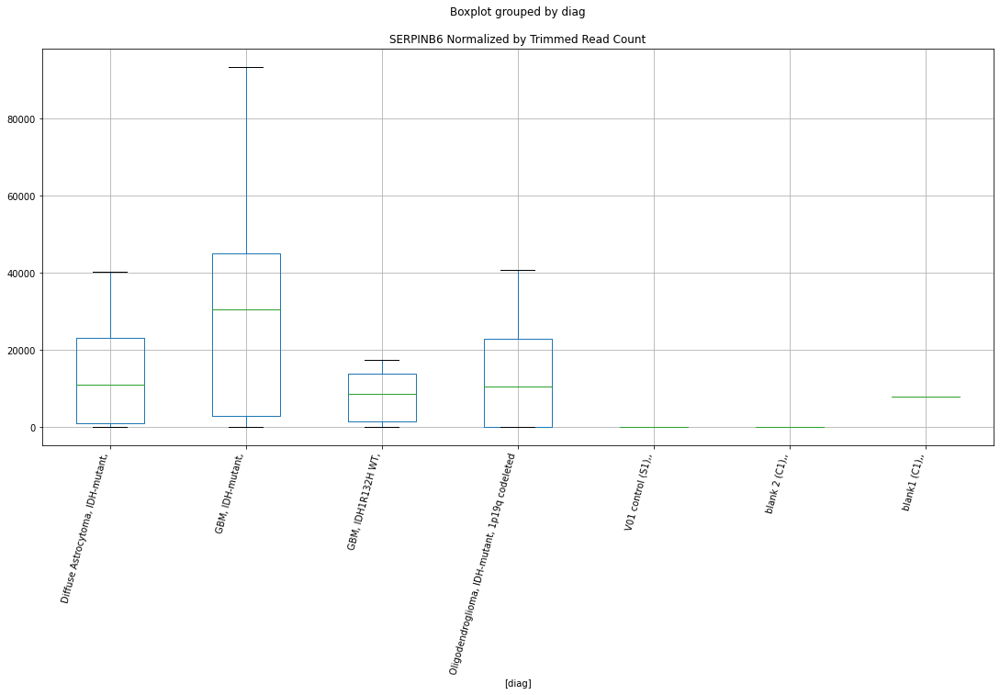

 p : 0.03283607351776857  ( t : 2.3117669699034944 ) :  D-plex  :  bbduk2  :  RNF43
Control and blanks
73     4638.05
337       0.00
Name: RNF43, dtype: float64
205    14685.46
Name: RNF43, dtype: float64
469    28393.31
Name: RNF43, dtype: float64


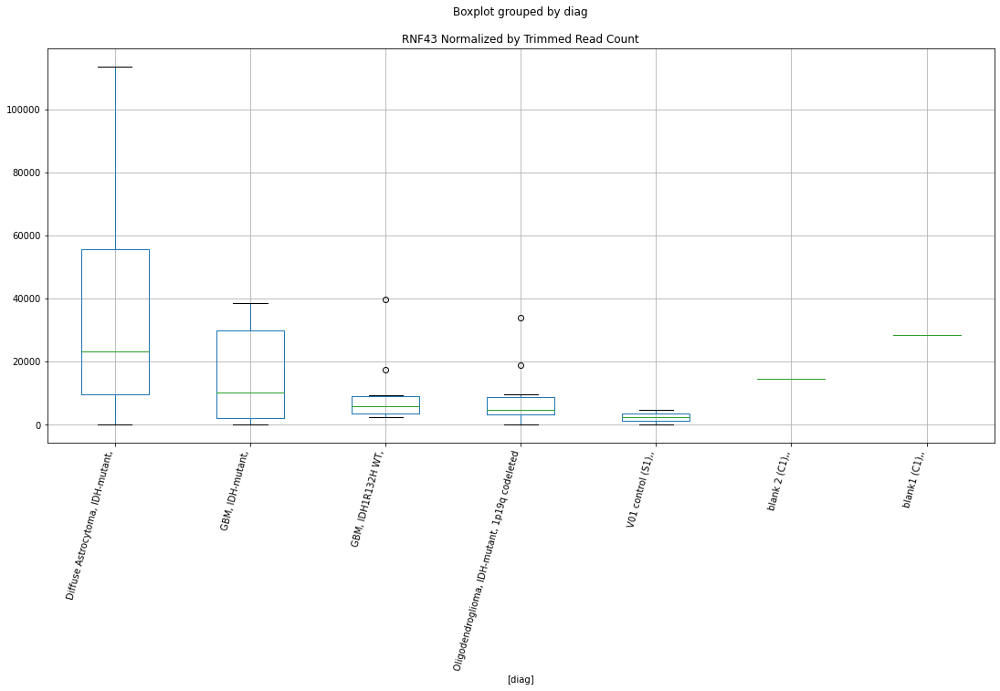

 p : 0.0328996707171387  ( t : 2.310812504654983 ) :  D-plex  :  cutadapt2  :  SLC9A9-AS1
Control and blanks
76     56063.45
340      880.73
Name: SLC9A9-AS1, dtype: float64
208    881.8
Name: SLC9A9-AS1, dtype: float64
472    0.0
Name: SLC9A9-AS1, dtype: float64


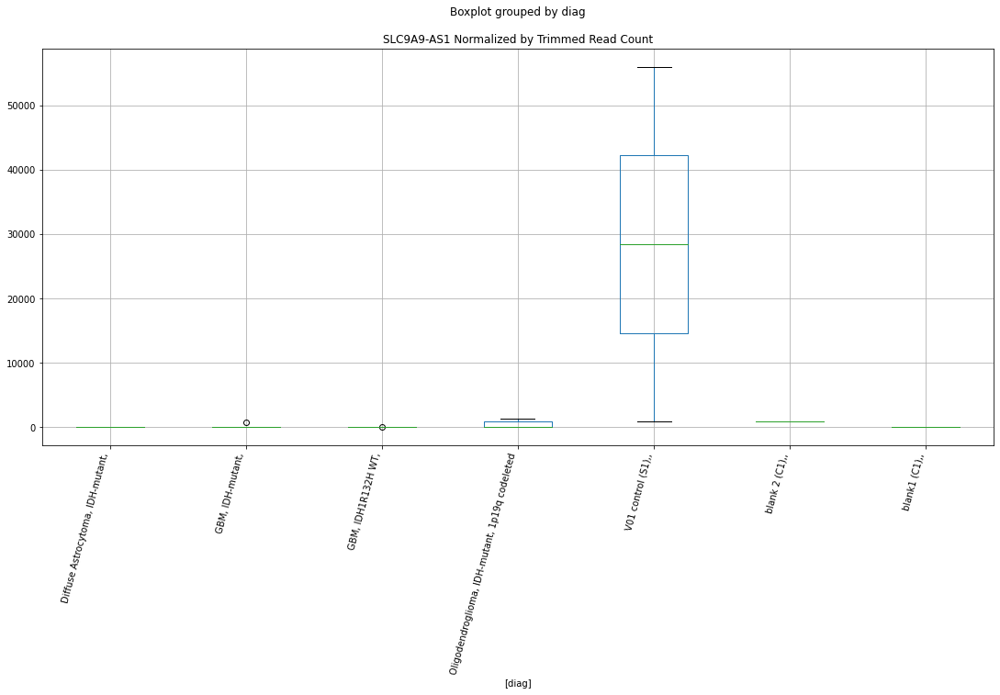

 p : 0.03299740128023241  ( t : 2.3093490986566607 ) :  D-plex  :  cutadapt2  :  PPP1R12B
Control and blanks
76     9091.37
340       0.00
Name: PPP1R12B, dtype: float64
208    17988.74
Name: PPP1R12B, dtype: float64
472    13292.98
Name: PPP1R12B, dtype: float64


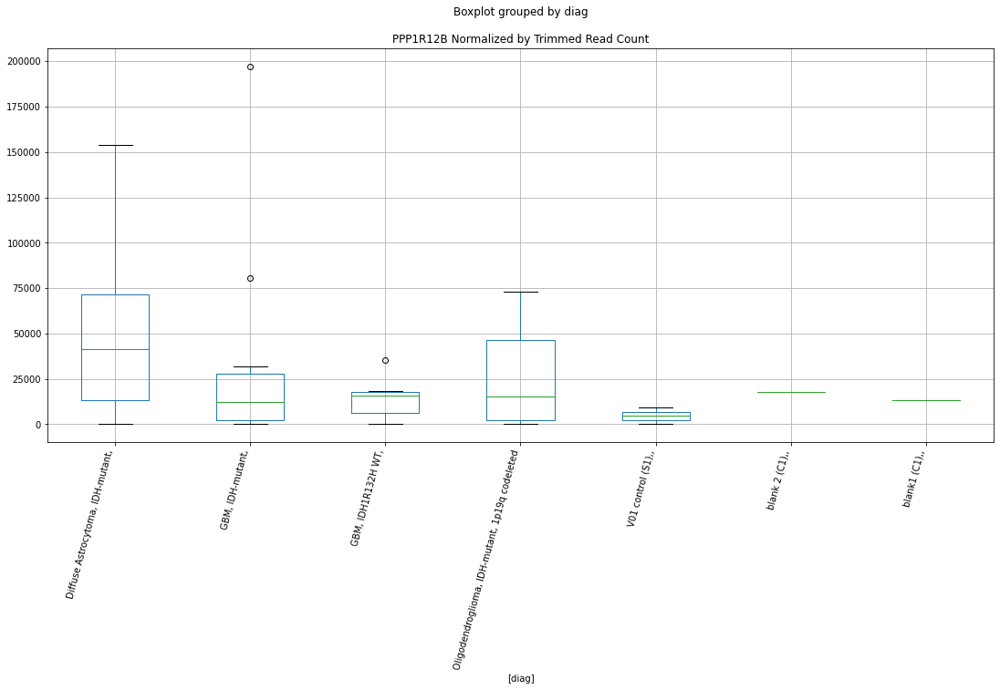

 p : 0.03308133778588386  ( t : 2.3080954499906756 ) :  D-plex  :  bbduk2  :  SMG1
Control and blanks
73     0.0
337    0.0
Name: SMG1, dtype: float64
205    33131.83
Name: SMG1, dtype: float64
469    17745.82
Name: SMG1, dtype: float64


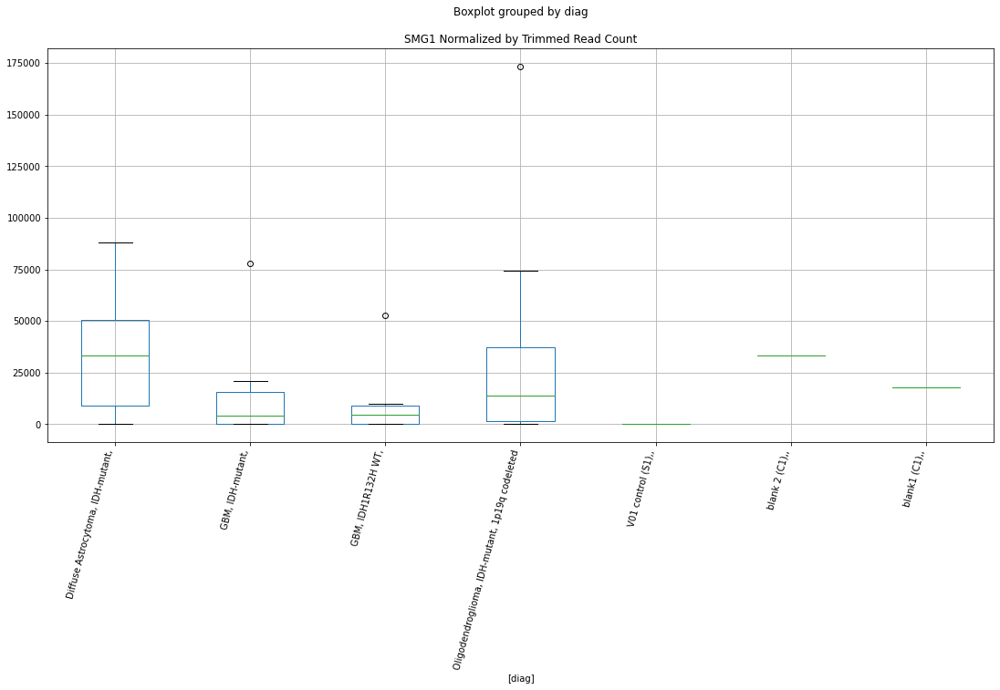

 p : 0.03312080536482638  ( t : 2.3075069946692643 ) :  Lexogen  :  bbduk2  :  SKIL
Control and blanks
79     0.0
343    0.0
Name: SKIL, dtype: float64
211    0.0
Name: SKIL, dtype: float64
475    1437.09
Name: SKIL, dtype: float64


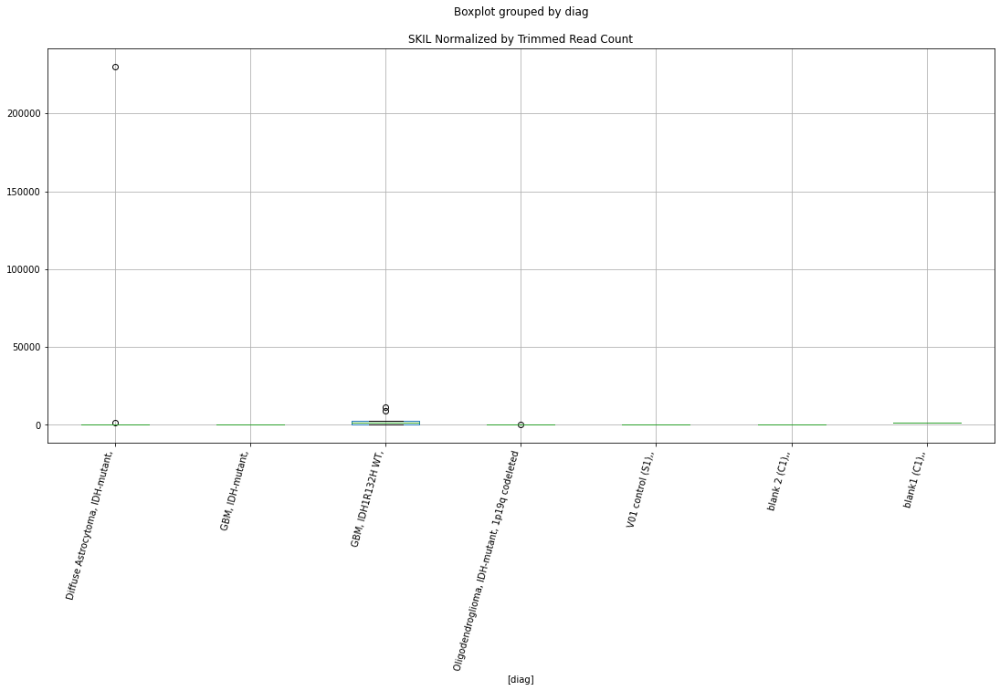

 p : 0.03325530597515502  ( t : 2.3055064860839867 ) :  D-plex  :  bbduk2  :  RBM15
Control and blanks
73     0.0
337    0.0
Name: RBM15, dtype: float64
205    1432.73
Name: RBM15, dtype: float64
469    3549.16
Name: RBM15, dtype: float64


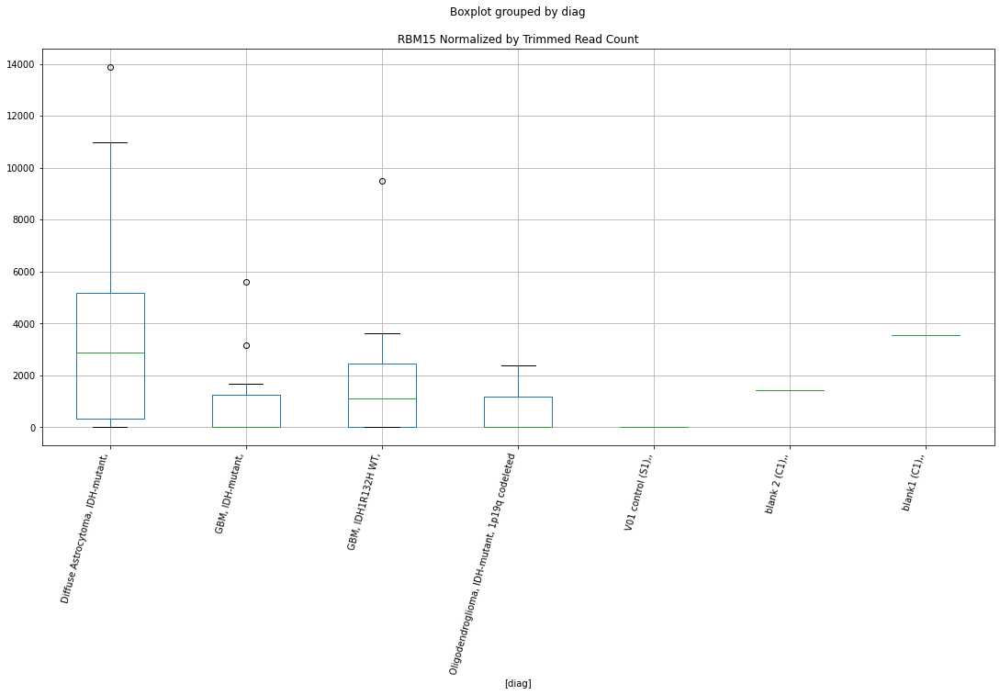

 p : 0.03326495488431498  ( t : 2.3053632607241927 ) :  D-plex  :  bbduk2  :  RNA45SN1
Control and blanks
73     4.29e+06
337    2.62e+06
Name: RNA45SN1, dtype: float64
205    2.54e+06
Name: RNA45SN1, dtype: float64
469    2.64e+06
Name: RNA45SN1, dtype: float64


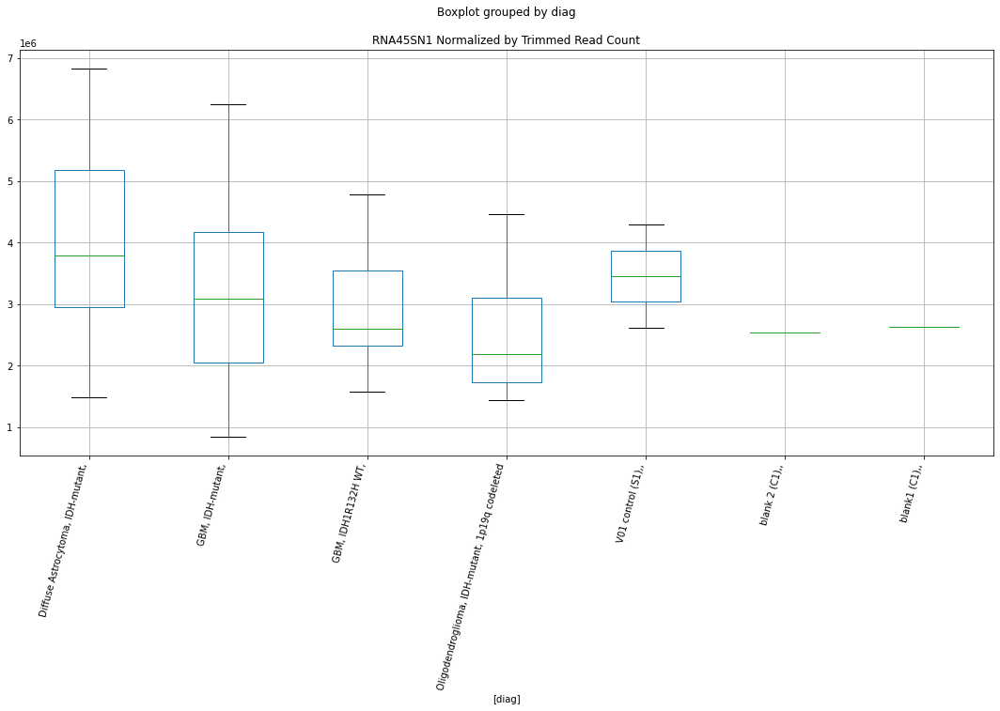

 p : 0.0332772124201871  ( t : 2.305181369292208 ) :  D-plex  :  bbduk2  :  PLPBP
Control and blanks
73     0.0
337    0.0
Name: PLPBP, dtype: float64
205    1970.0
Name: PLPBP, dtype: float64
469    2366.11
Name: PLPBP, dtype: float64


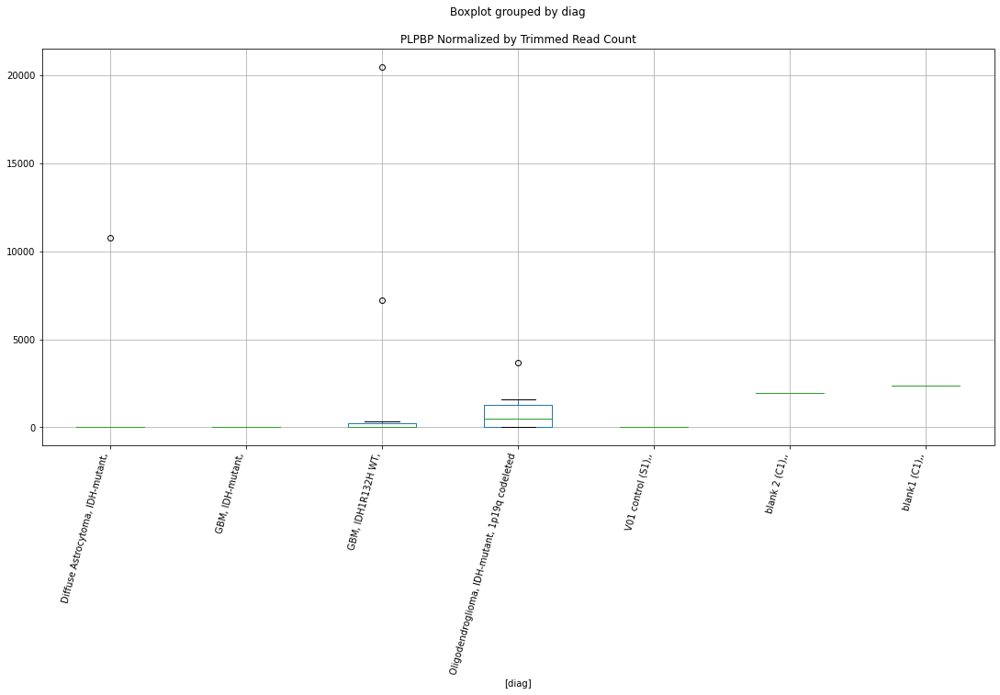

 p : 0.033388559733303215  ( t : 2.3035319098552884 ) :  D-plex  :  bbduk2  :  POU4F3
Control and blanks
73       0.00
337    890.16
Name: POU4F3, dtype: float64
205    15580.91
Name: POU4F3, dtype: float64
469    2957.64
Name: POU4F3, dtype: float64


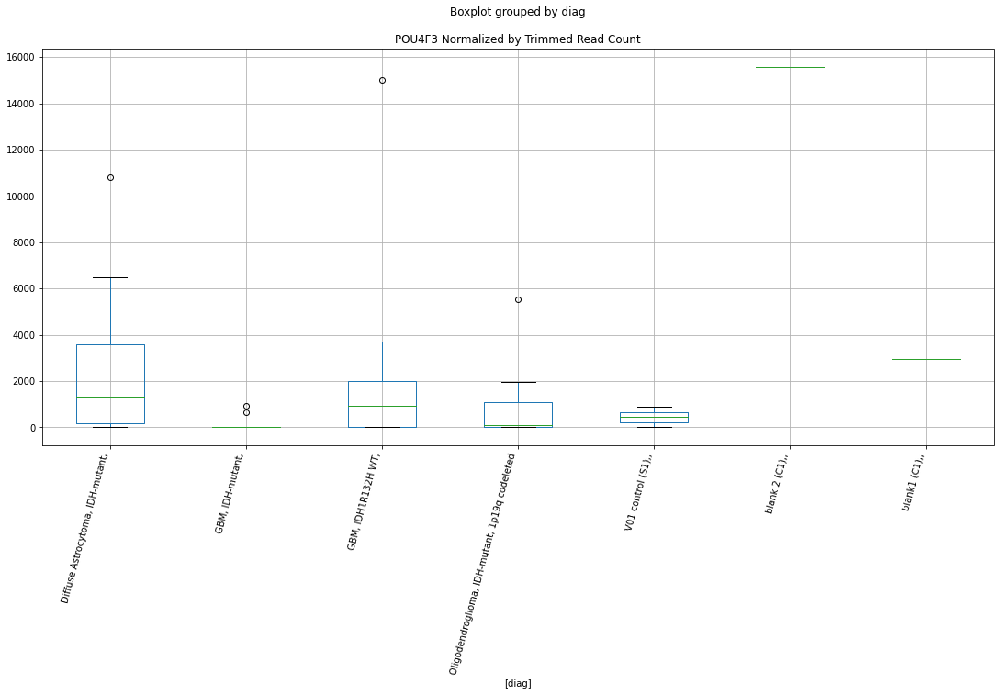

 p : 0.03339819330183526  ( t : 2.303389441484904 ) :  Lexogen  :  bbduk2  :  RORB
Control and blanks
79     0.0
343    0.0
Name: RORB, dtype: float64
211    0.0
Name: RORB, dtype: float64
475    0.0
Name: RORB, dtype: float64


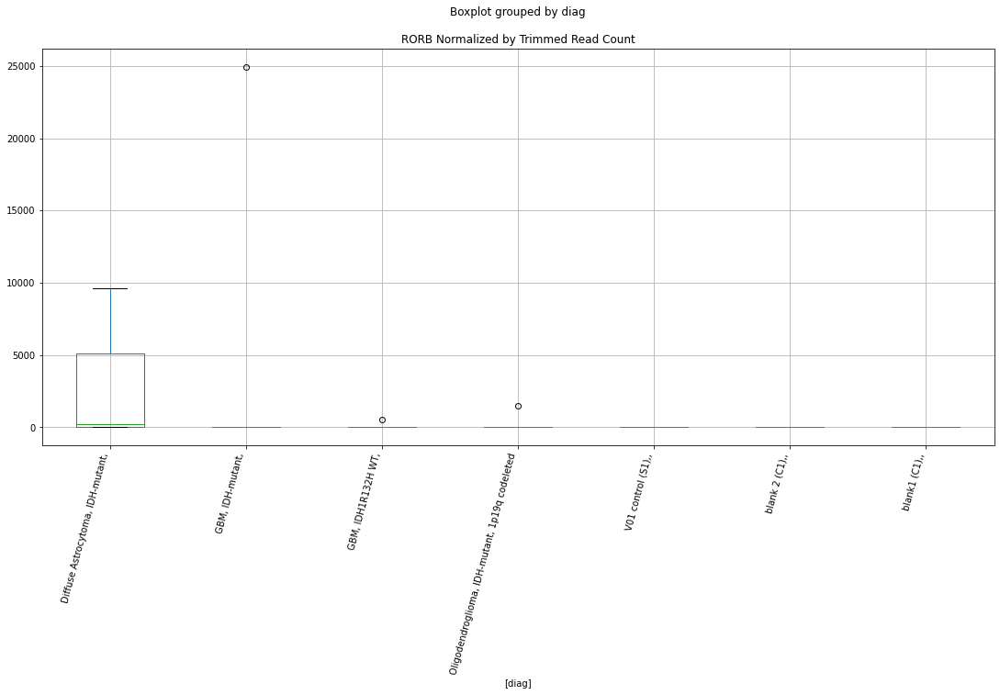

 p : 0.033422732130256316  ( t : 2.303026715154063 ) :  D-plex  :  bbduk2  :  RNA45SN5
Control and blanks
73     4.29e+06
337    2.62e+06
Name: RNA45SN5, dtype: float64
205    2.54e+06
Name: RNA45SN5, dtype: float64
469    2.64e+06
Name: RNA45SN5, dtype: float64


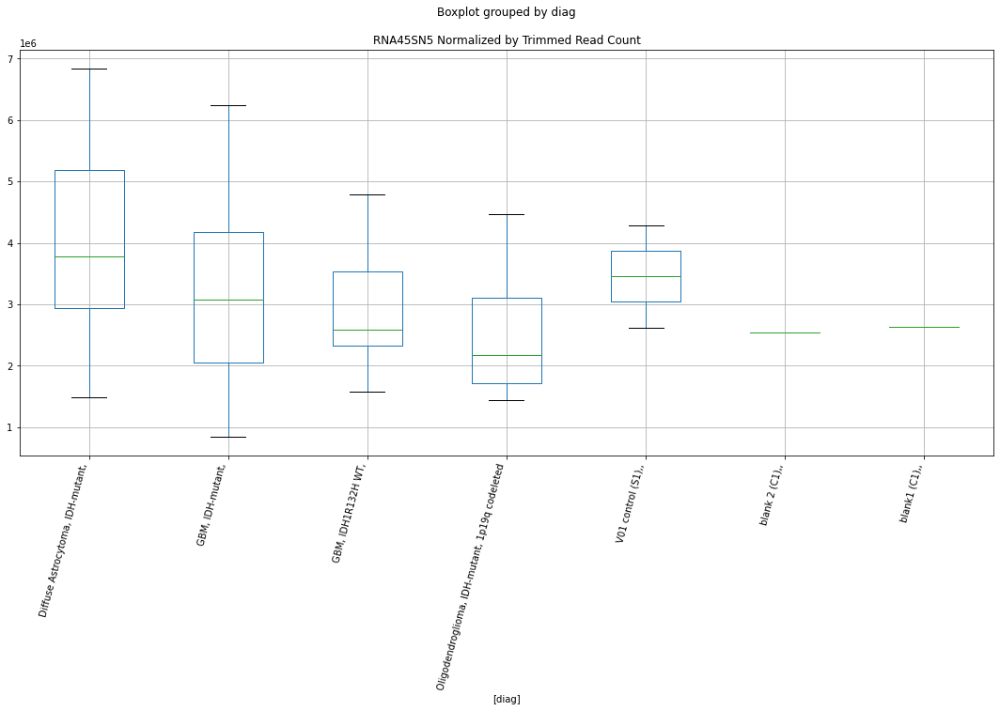

 p : 0.033442134753431586  ( t : 2.3027400856154174 ) :  D-plex  :  bbduk2  :  PLAUR
Control and blanks
73      7730.08
337    35606.29
Name: PLAUR, dtype: float64
205    80053.66
Name: PLAUR, dtype: float64
469    25435.67
Name: PLAUR, dtype: float64


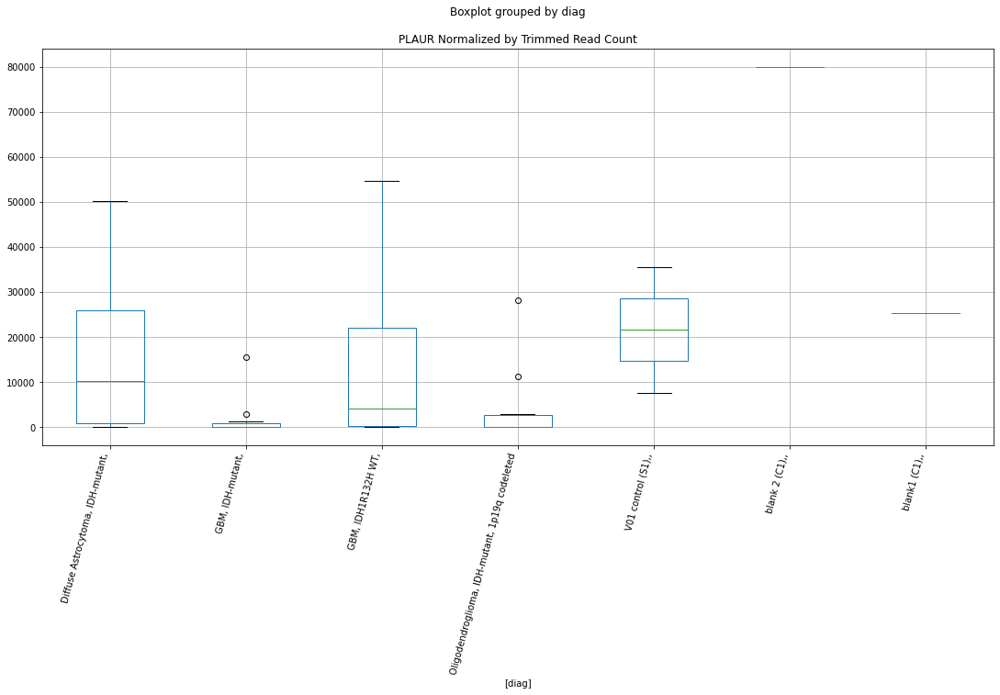

 p : 0.03344440008645882  ( t : 2.302706630536856 ) :  Lexogen  :  bbduk2  :  PLXNA4
Control and blanks
79     0.0
343    0.0
Name: PLXNA4, dtype: float64
211    0.0
Name: PLXNA4, dtype: float64
475    0.0
Name: PLXNA4, dtype: float64


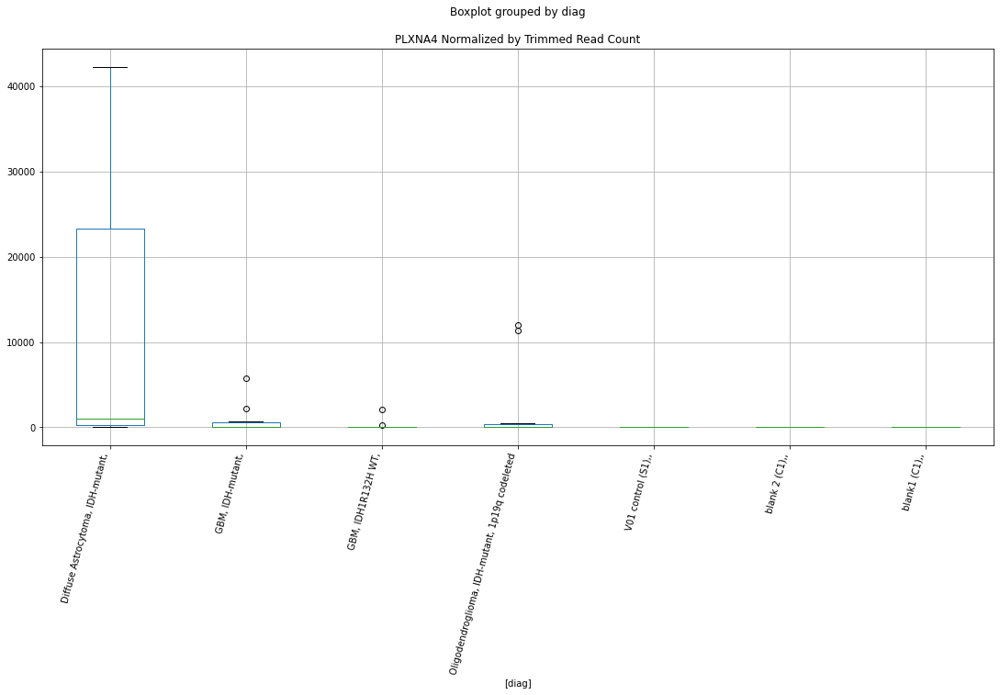

 p : 0.03349068937787619  ( t : 2.302023476952654 ) :  D-plex  :  cutadapt2  :  RNF165
Control and blanks
76        0.00
340    9688.05
Name: RNF165, dtype: float64
208    20986.87
Name: RNF165, dtype: float64
472    20228.45
Name: RNF165, dtype: float64


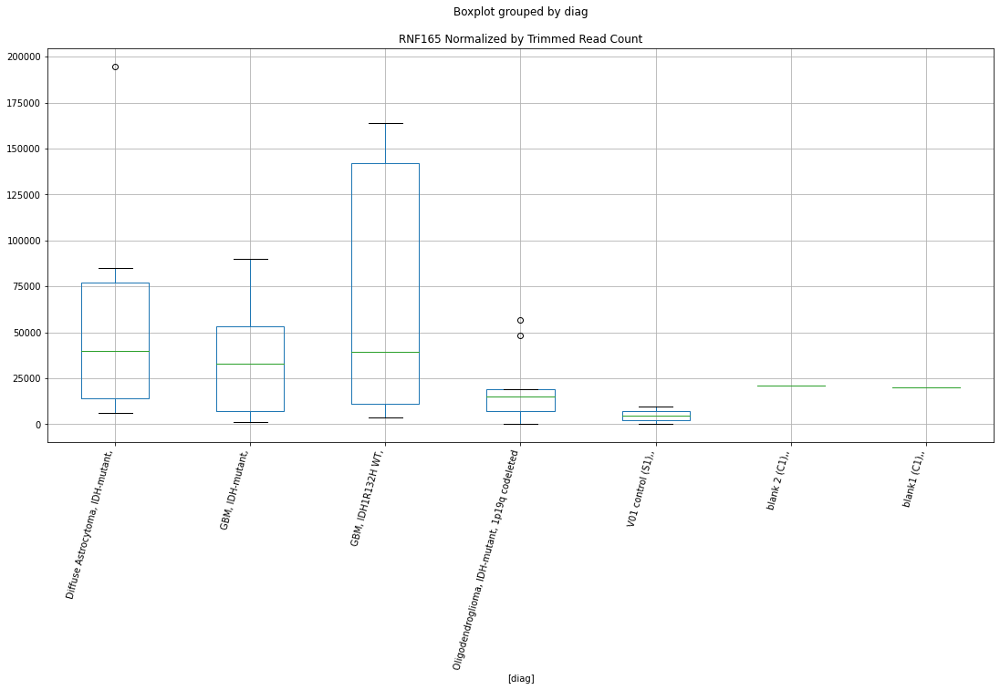

 p : 0.03350026978347657  ( t : 2.3018821953354545 ) :  D-plex  :  bbduk2  :  PFDN4
Control and blanks
73     0.0
337    0.0
Name: PFDN4, dtype: float64
205    537.27
Name: PFDN4, dtype: float64
469    0.0
Name: PFDN4, dtype: float64


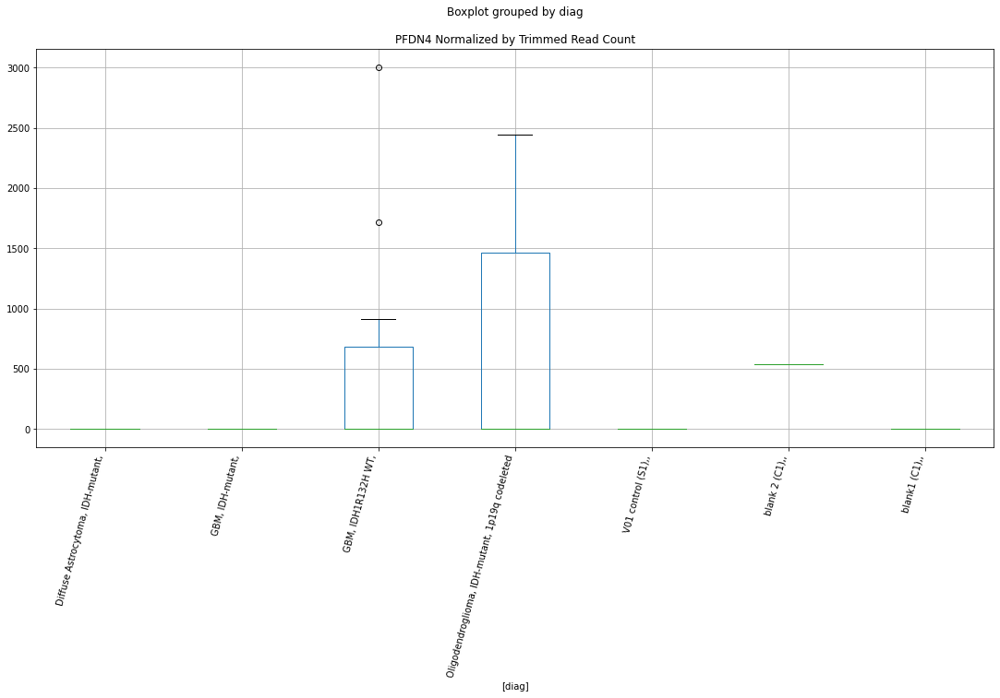

 p : 0.03360633222714  ( t : 2.300320597568769 ) :  D-plex  :  cutadapt2  :  SLC16A4
Control and blanks
76     0.0
340    0.0
Name: SLC16A4, dtype: float64
208    1058.16
Name: SLC16A4, dtype: float64
472    5779.56
Name: SLC16A4, dtype: float64


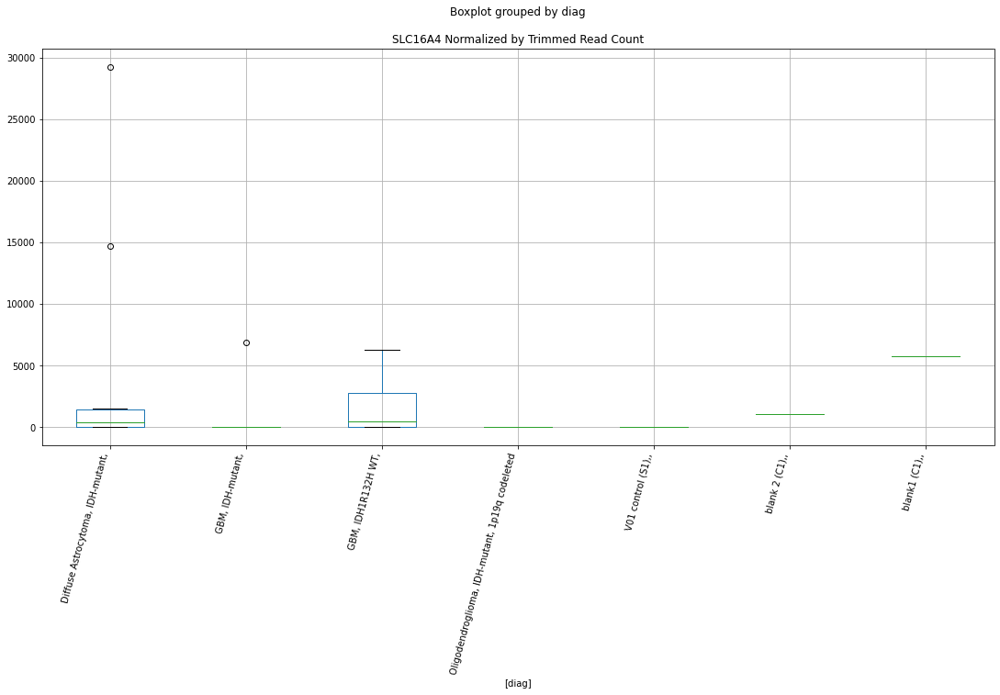

 p : 0.033606336351143545  ( t : 2.3003205369383846 ) :  D-plex  :  cutadapt2  :  SIGLEC1
Control and blanks
76     7576.14
340       0.00
Name: SIGLEC1, dtype: float64
208    9876.17
Name: SIGLEC1, dtype: float64
472    11559.12
Name: SIGLEC1, dtype: float64


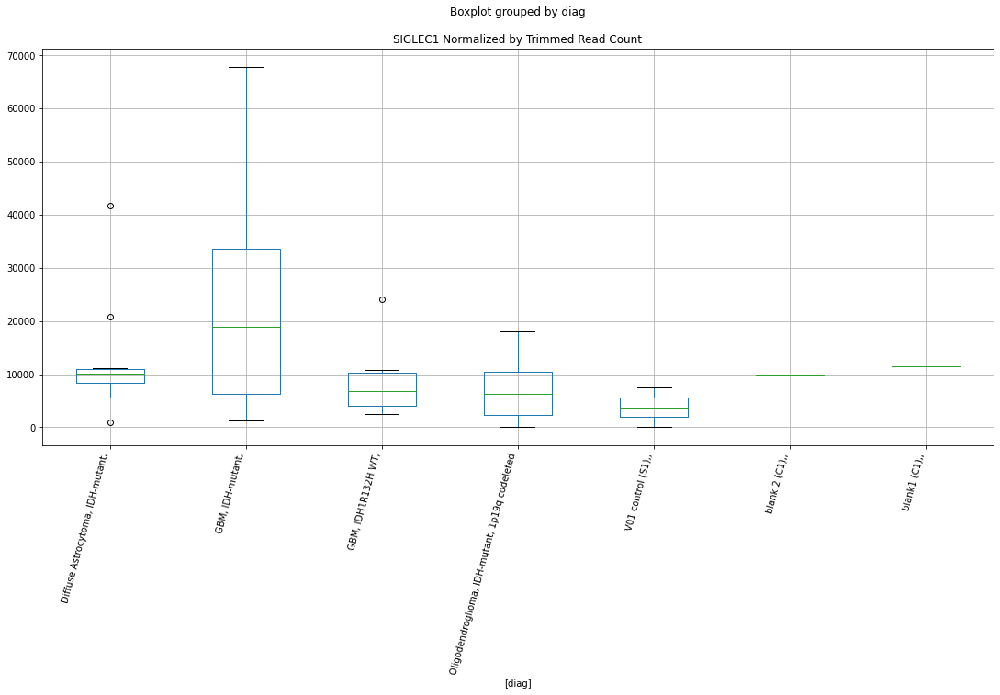

 p : 0.033631711893272444  ( t : 2.299947600660922 ) :  Lexogen  :  bbduk2  :  SMOC2
Control and blanks
79       0.00
343    849.26
Name: SMOC2, dtype: float64
211    22957.73
Name: SMOC2, dtype: float64
475    0.0
Name: SMOC2, dtype: float64


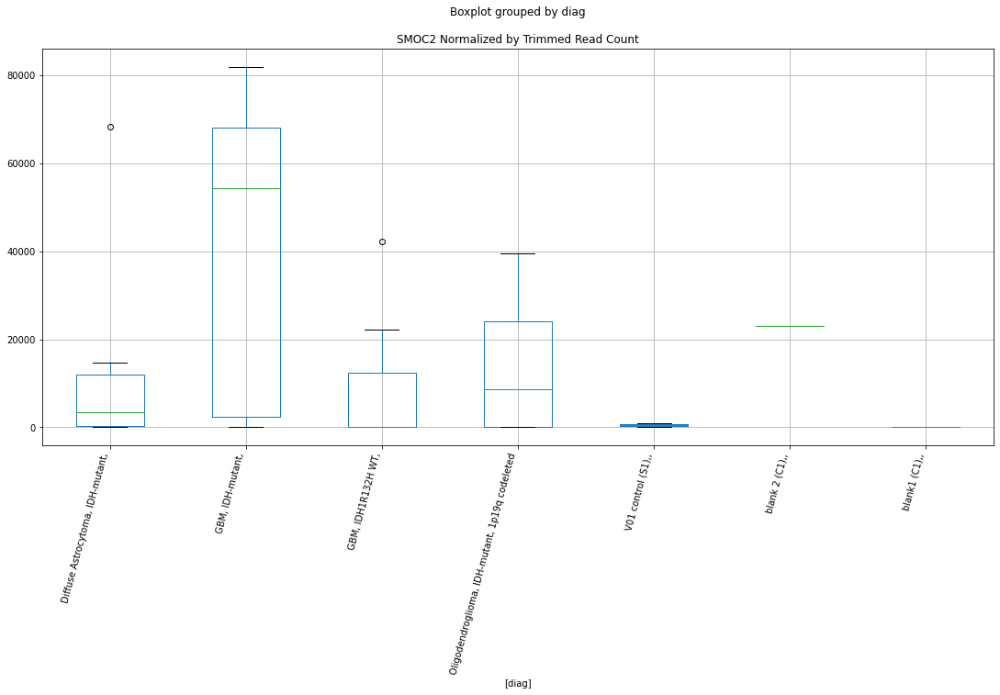

 p : 0.03365389804384084  ( t : 2.299621751544329 ) :  Lexogen  :  cutadapt2  :  PES1
Control and blanks
82     0.0
346    0.0
Name: PES1, dtype: float64
214    37429.25
Name: PES1, dtype: float64
478    0.0
Name: PES1, dtype: float64


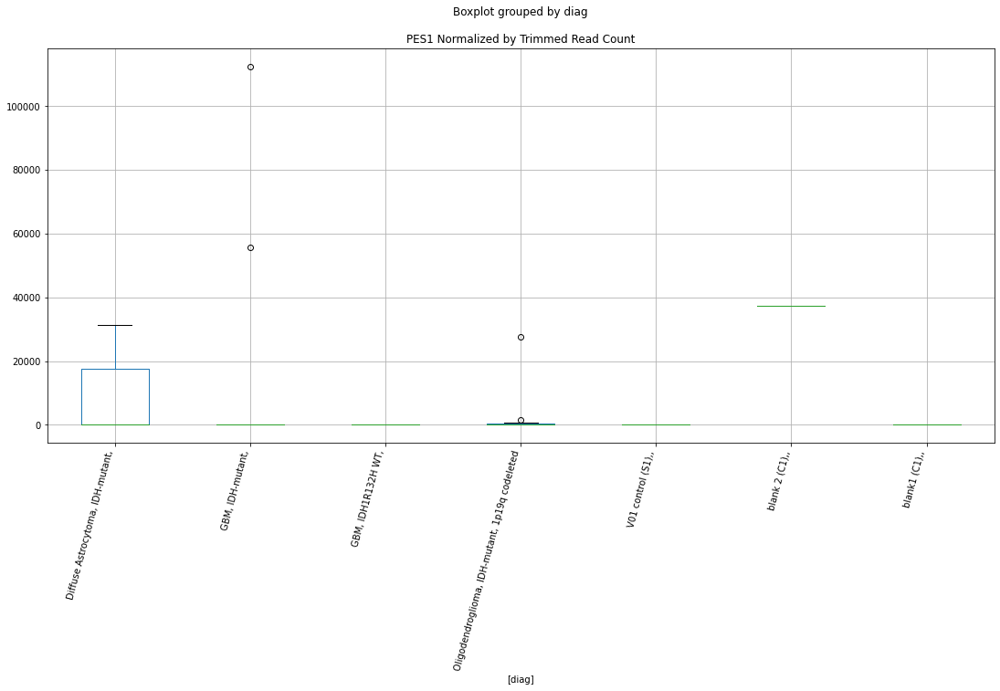

 p : 0.03370581379874911  ( t : 2.298860039764886 ) :  D-plex  :  bbduk2  :  PLD5
Control and blanks
73     0.0
337    0.0
Name: PLD5, dtype: float64
205    9850.0
Name: PLD5, dtype: float64
469    2957.64
Name: PLD5, dtype: float64


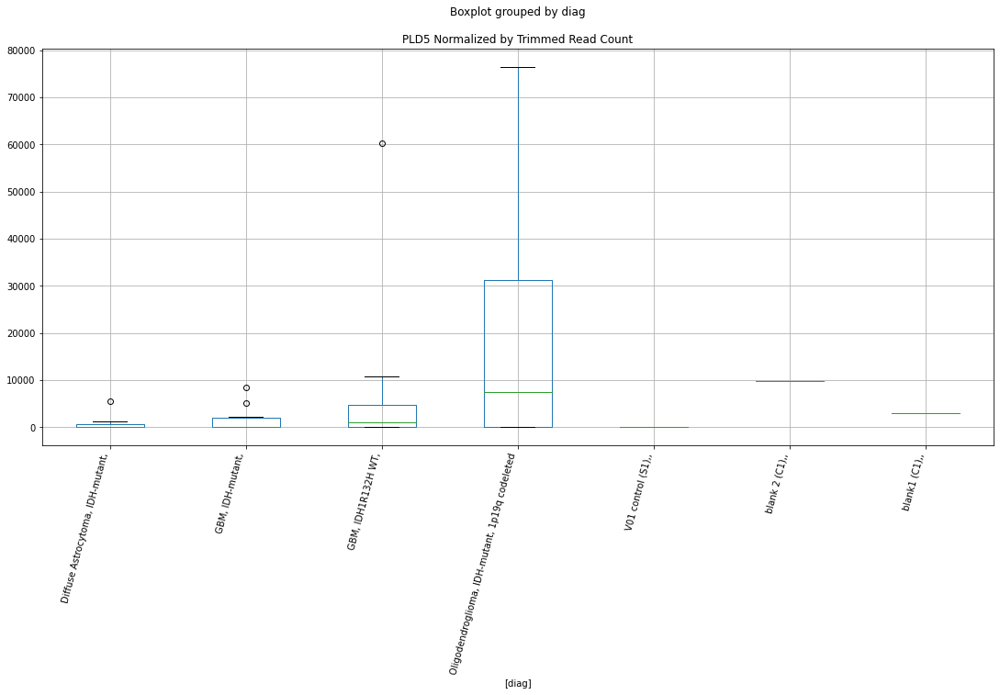

 p : 0.03372060700202158  ( t : 2.298643191904629 ) :  D-plex  :  cutadapt2  :  PLPBP
Control and blanks
76     0.0
340    0.0
Name: PLPBP, dtype: float64
208    1939.96
Name: PLPBP, dtype: float64
472    2311.82
Name: PLPBP, dtype: float64


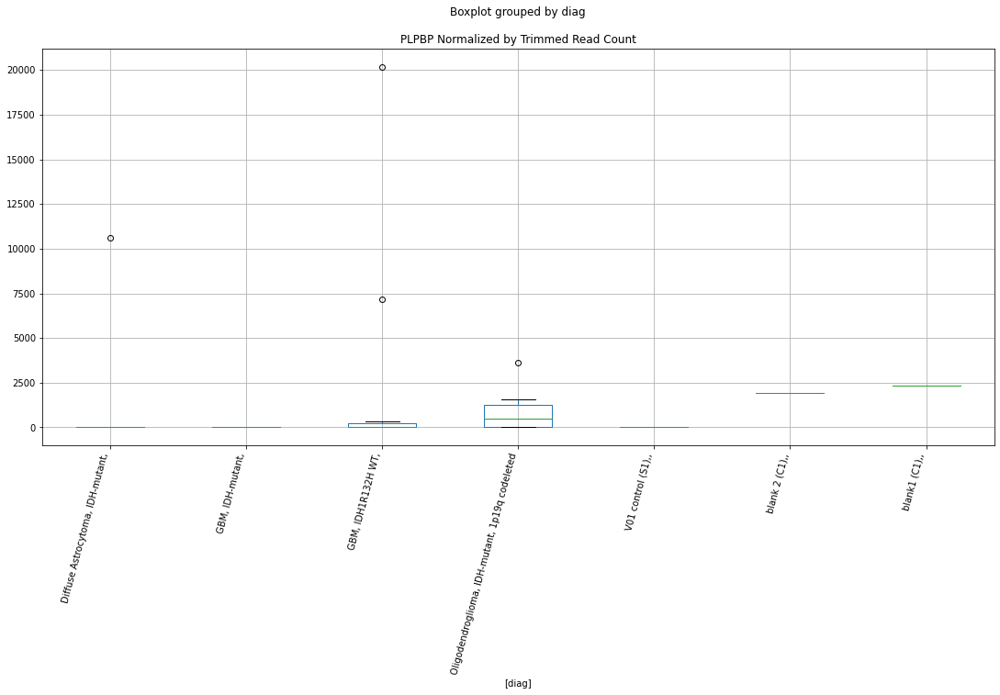

 p : 0.03392680422143559  ( t : 2.295629771580102 ) :  D-plex  :  cutadapt2  :  RBM15
Control and blanks
76     0.0
340    0.0
Name: RBM15, dtype: float64
208    1763.6
Name: RBM15, dtype: float64
472    3467.74
Name: RBM15, dtype: float64


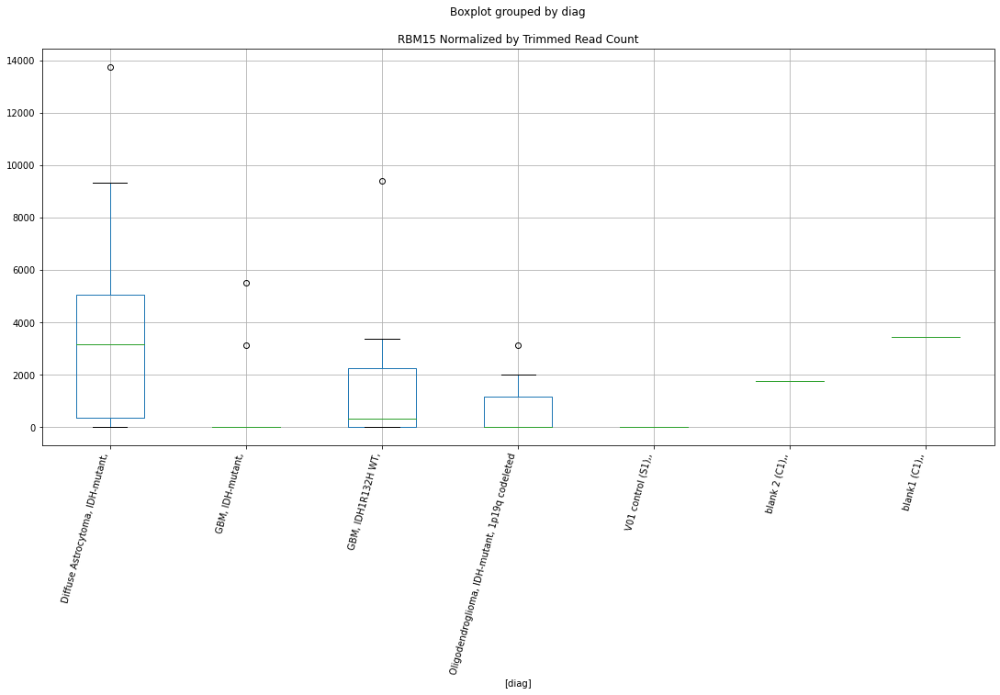

 p : 0.033939960616332254  ( t : 2.2954380771257994 ) :  D-plex  :  bbduk2  :  PALB2
Control and blanks
73     125227.36
337         0.00
Name: PALB2, dtype: float64
205    1074.55
Name: PALB2, dtype: float64
469    11830.55
Name: PALB2, dtype: float64


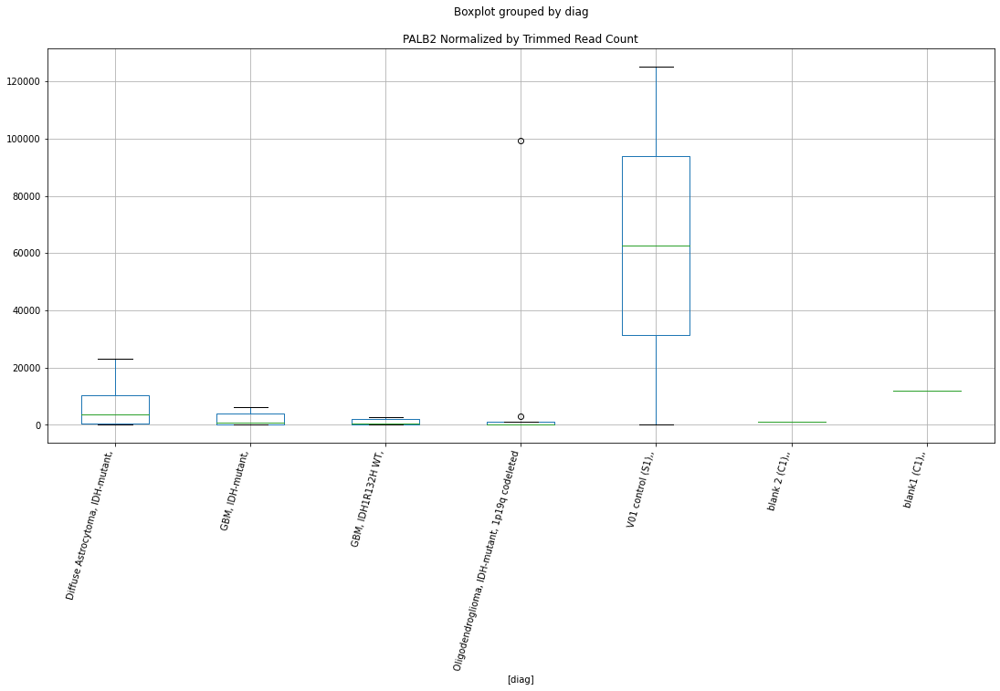

 p : 0.03396459403533992  ( t : 2.295079342485998 ) :  D-plex  :  cutadapt2  :  POU4F3
Control and blanks
76       0.00
340    880.73
Name: POU4F3, dtype: float64
208    15343.34
Name: POU4F3, dtype: float64
472    2889.78
Name: POU4F3, dtype: float64


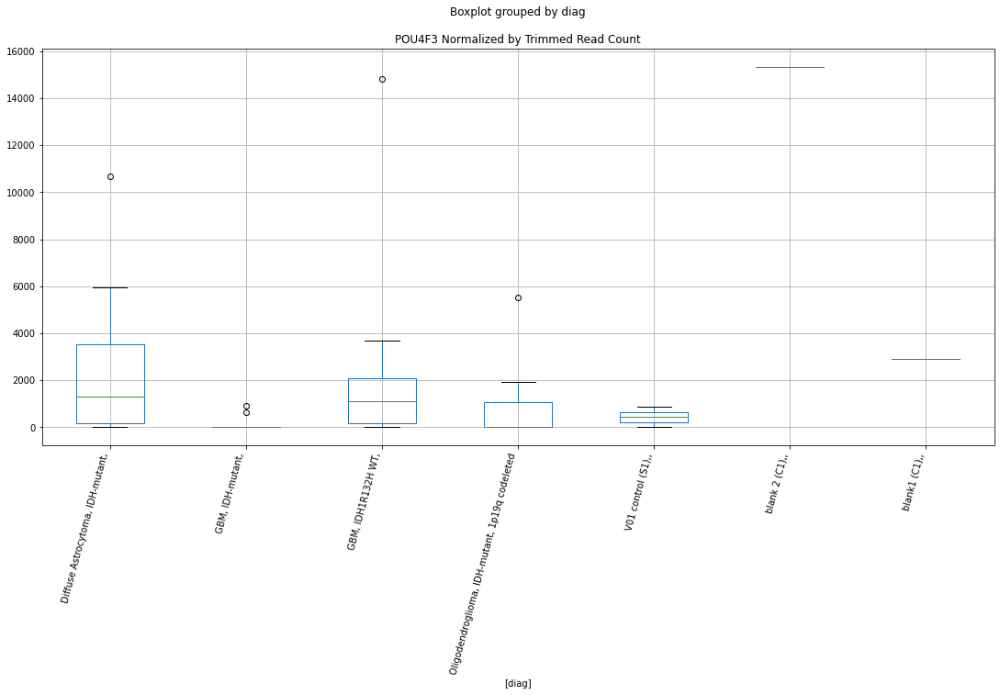

 p : 0.03434299531147013  ( t : 2.2895987956355834 ) :  D-plex  :  bbduk2  :  SNHG31
Control and blanks
73     0.0
337    0.0
Name: SNHG31, dtype: float64
205    0.0
Name: SNHG31, dtype: float64
469    591.53
Name: SNHG31, dtype: float64


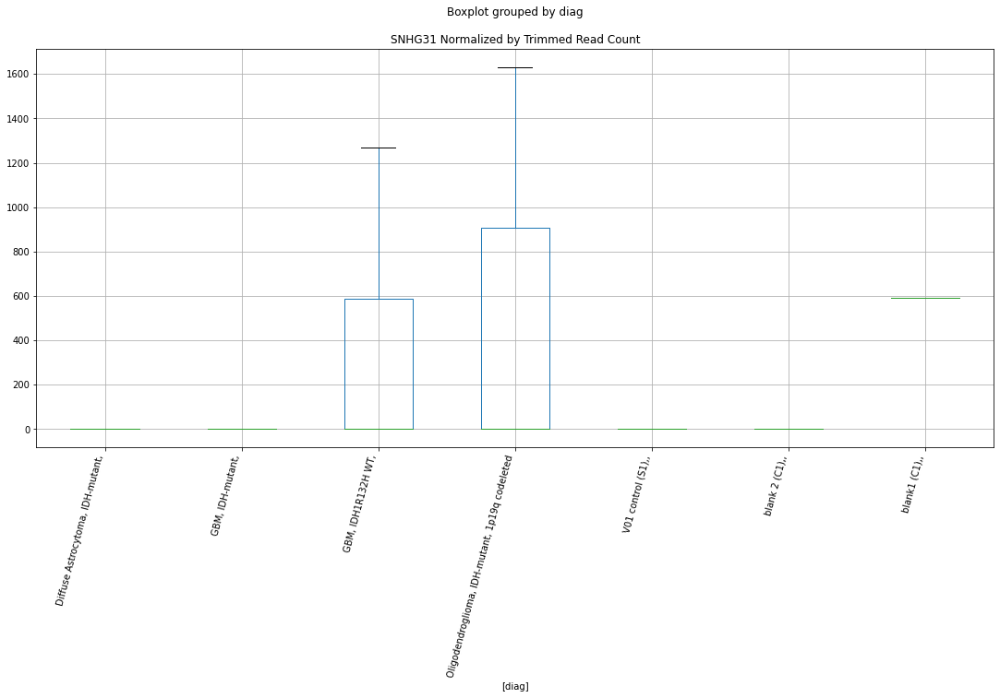

 p : 0.034454699661117104  ( t : 2.287991626595306 ) :  Lexogen  :  bbduk2  :  RELT
Control and blanks
79     0.0
343    0.0
Name: RELT, dtype: float64
211    0.0
Name: RELT, dtype: float64
475    0.0
Name: RELT, dtype: float64


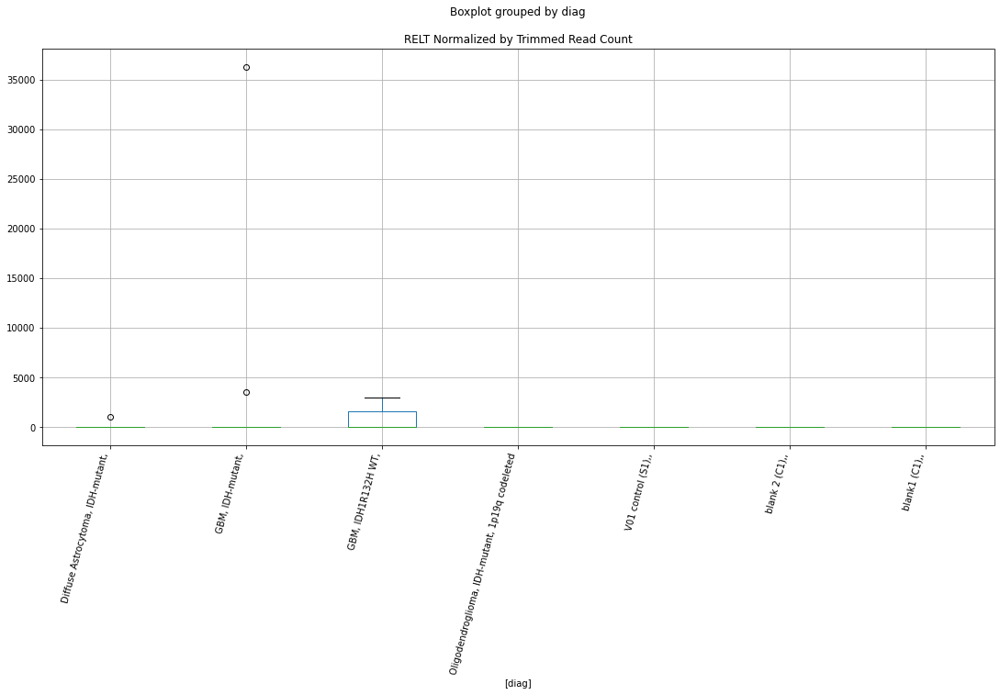

 p : 0.034476458191429145  ( t : 2.2876791329471513 ) :  D-plex  :  cutadapt2  :  POMC
Control and blanks
76     6060.91
340       0.00
Name: POMC, dtype: float64
208    7759.85
Name: POMC, dtype: float64
472    13292.98
Name: POMC, dtype: float64


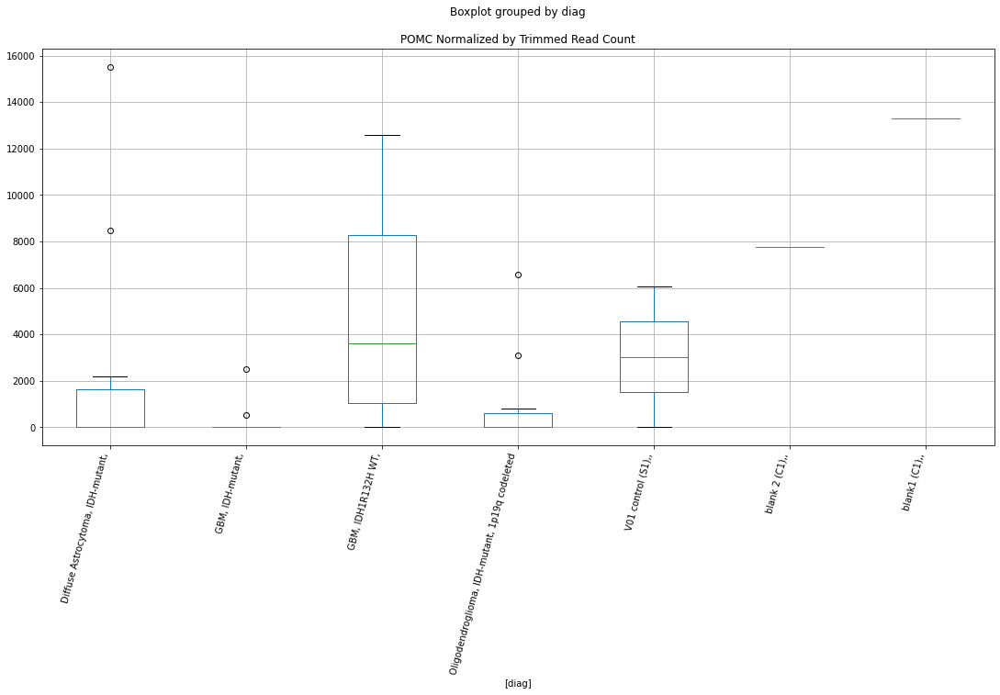

 p : 0.034489459762845114  ( t : 2.2874924929523948 ) :  Lexogen  :  cutadapt2  :  RELT
Control and blanks
82     0.0
346    0.0
Name: RELT, dtype: float64
214    0.0
Name: RELT, dtype: float64
478    0.0
Name: RELT, dtype: float64


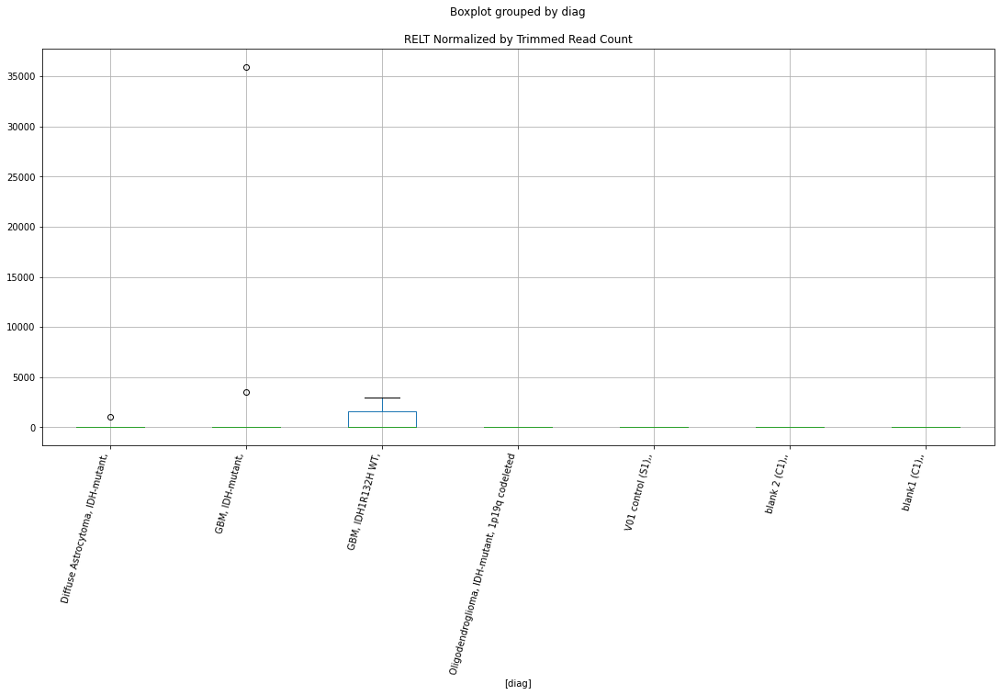

 p : 0.03451369383218108  ( t : 2.287144782182024 ) :  Lexogen  :  bbduk2  :  SMOC2
Control and blanks
79       0.00
343    849.26
Name: SMOC2, dtype: float64
211    22957.73
Name: SMOC2, dtype: float64
475    0.0
Name: SMOC2, dtype: float64


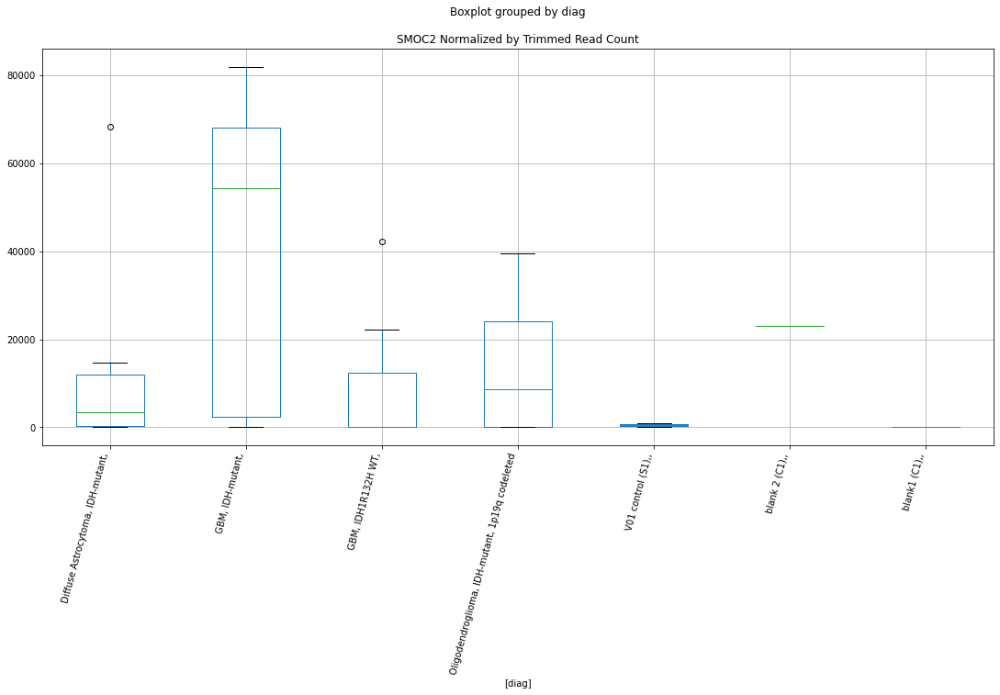

 p : 0.034516171684607286  ( t : 2.287109242661489 ) :  Lexogen  :  bbduk2  :  RXFP3
Control and blanks
79       0.00
343    849.26
Name: RXFP3, dtype: float64
211    0.0
Name: RXFP3, dtype: float64
475    0.0
Name: RXFP3, dtype: float64


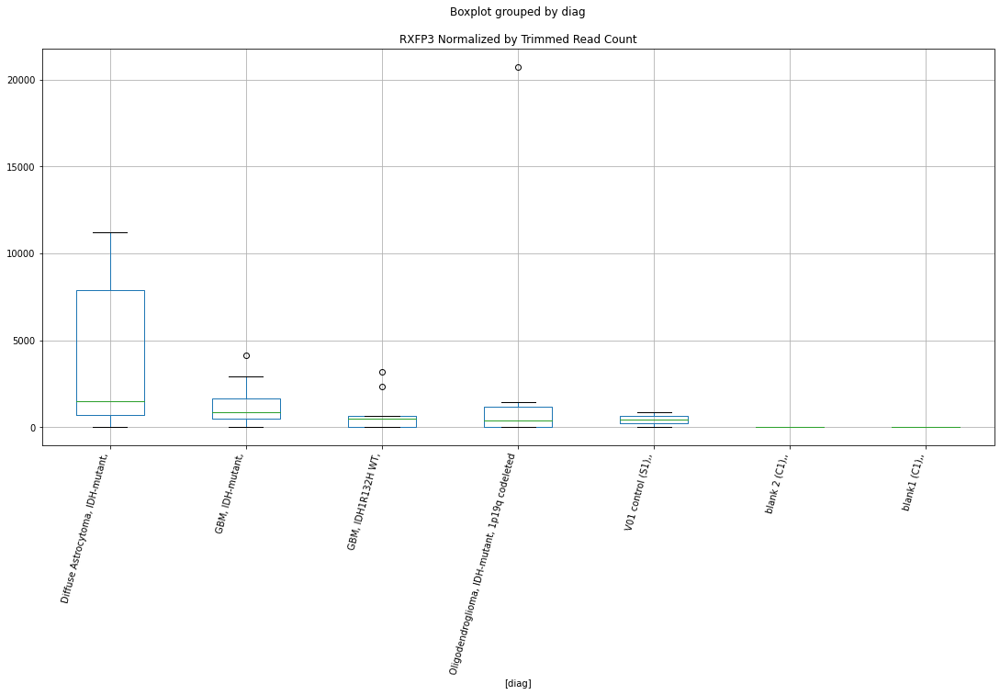

 p : 0.03453535495838175  ( t : 2.286834179338238 ) :  D-plex  :  cutadapt2  :  SNHG31
Control and blanks
76     1515.23
340       0.00
Name: SNHG31, dtype: float64
208    0.0
Name: SNHG31, dtype: float64
472    577.96
Name: SNHG31, dtype: float64


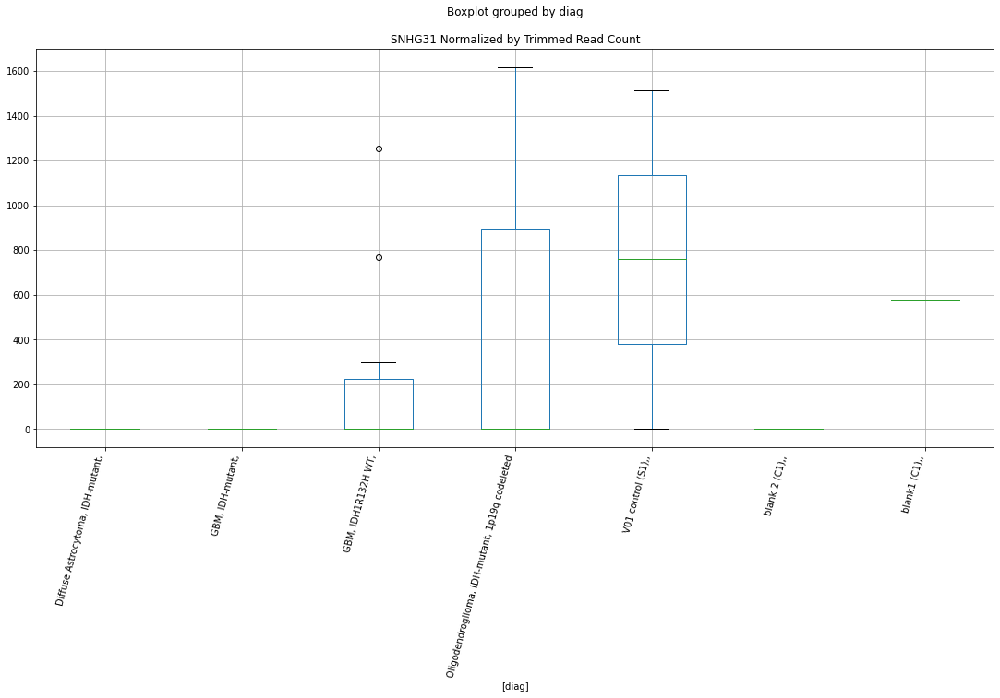

 p : 0.03456834093759567  ( t : 2.28636153370985 ) :  Lexogen  :  bbduk2  :  PPM1L
Control and blanks
79       0.00
343    849.26
Name: PPM1L, dtype: float64
211    0.0
Name: PPM1L, dtype: float64
475    0.0
Name: PPM1L, dtype: float64


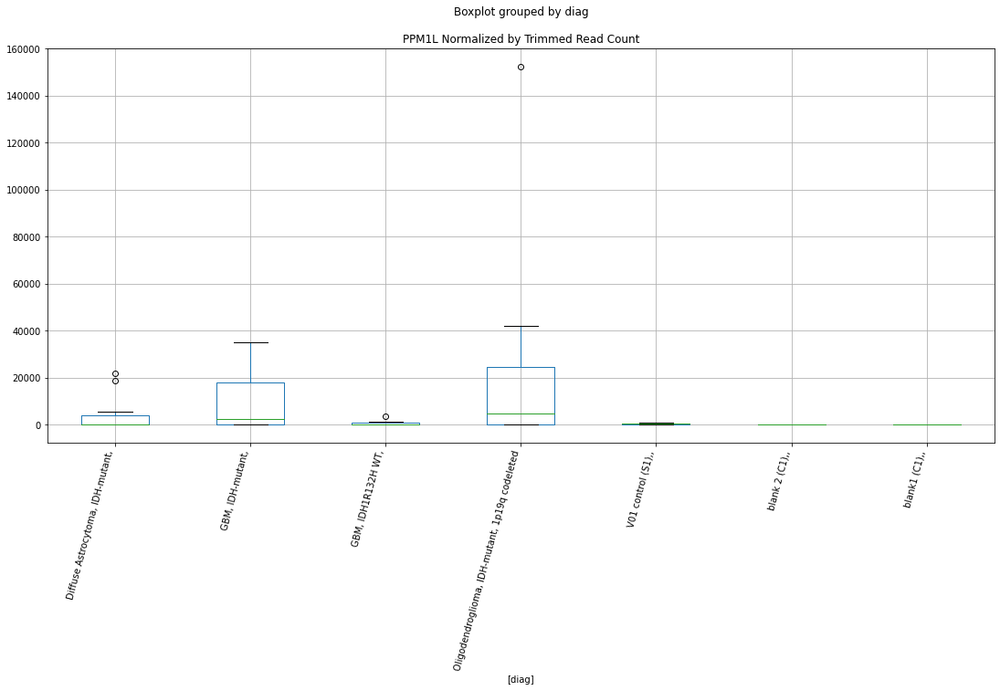

 p : 0.03457332922901935  ( t : 2.286290094420355 ) :  Lexogen  :  cutadapt2  :  PLXNA4
Control and blanks
82     0.0
346    0.0
Name: PLXNA4, dtype: float64
214    0.0
Name: PLXNA4, dtype: float64
478    0.0
Name: PLXNA4, dtype: float64


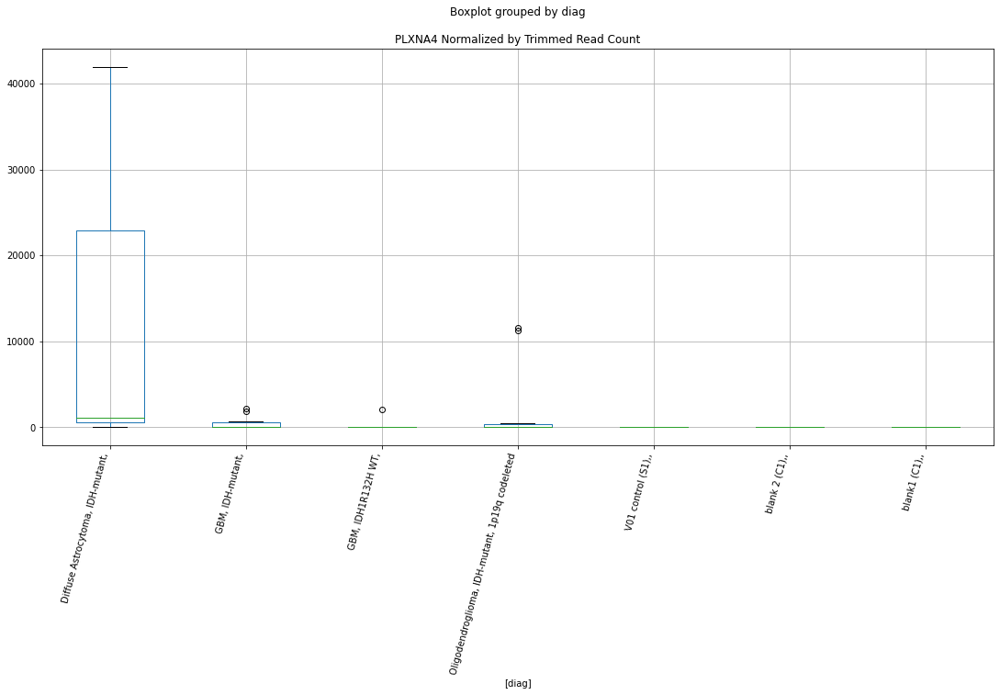

 p : 0.03479131941255423  ( t : 2.2831774546500045 ) :  Lexogen  :  bbduk2  :  RAB6D
Control and blanks
79     0.0
343    0.0
Name: RAB6D, dtype: float64
211    0.0
Name: RAB6D, dtype: float64
475    0.0
Name: RAB6D, dtype: float64


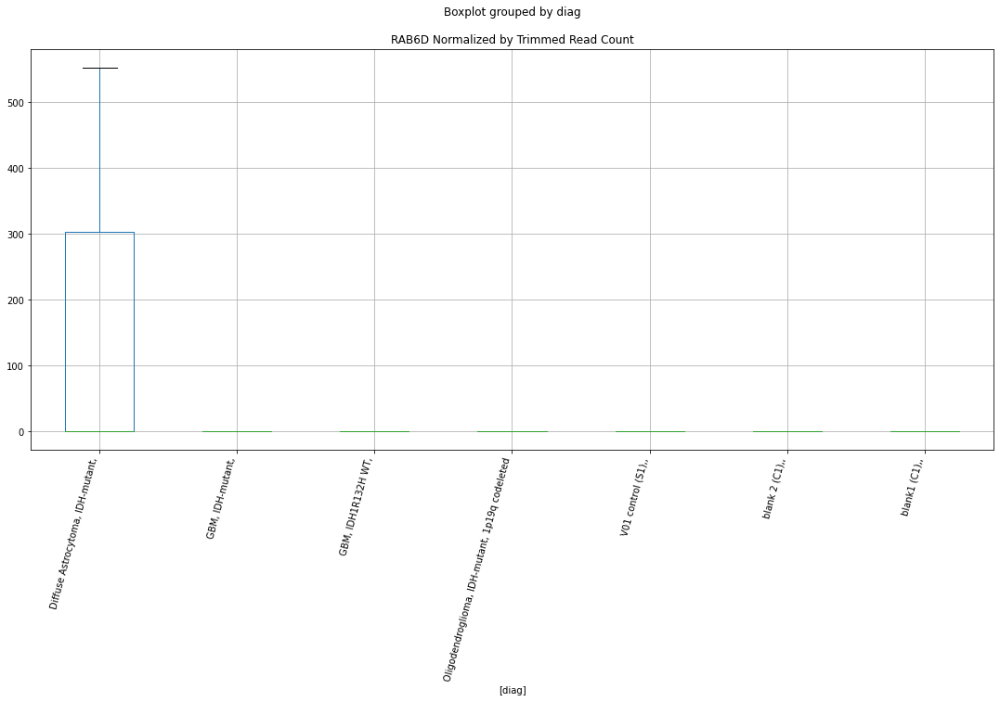

 p : 0.03491562571972021  ( t : 2.2814105823696553 ) :  Lexogen  :  bbduk2  :  PES1
Control and blanks
79        0.00
343    1273.89
Name: PES1, dtype: float64
211    37716.27
Name: PES1, dtype: float64
475    0.0
Name: PES1, dtype: float64


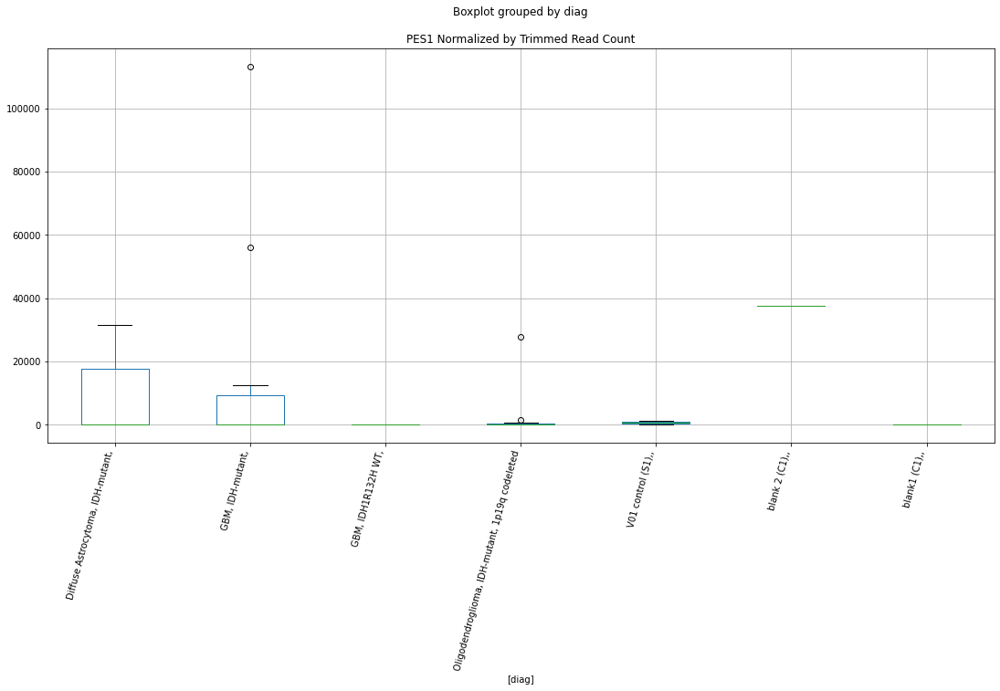

 p : 0.035012752500971585  ( t : 2.2800340831403063 ) :  D-plex  :  bbduk2  :  SEC14L6
Control and blanks
73     0.0
337    0.0
Name: SEC14L6, dtype: float64
205    0.0
Name: SEC14L6, dtype: float64
469    6506.8
Name: SEC14L6, dtype: float64


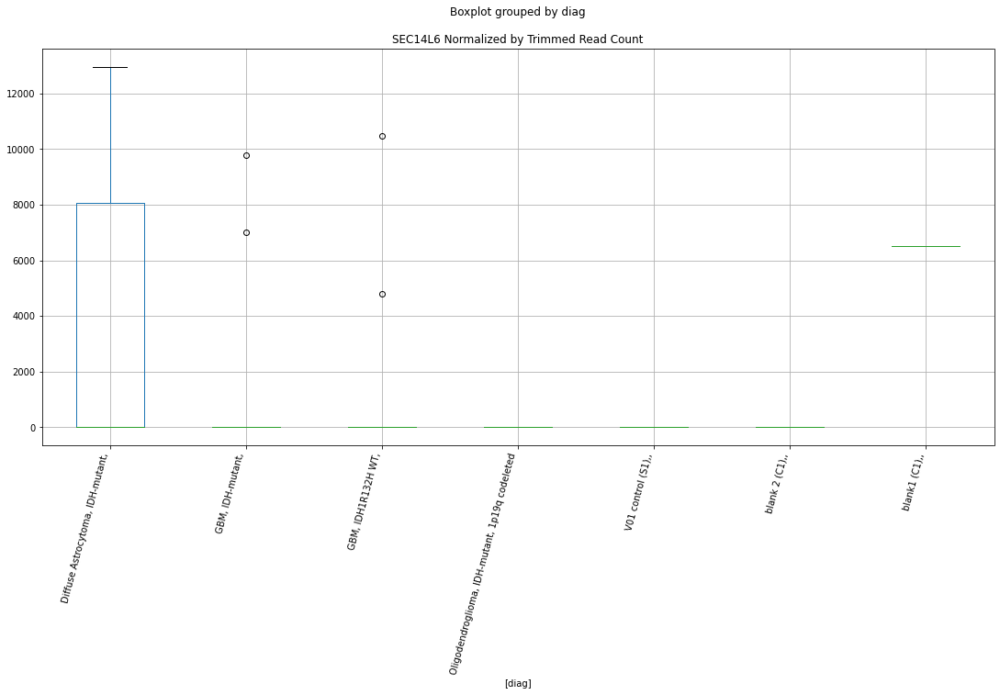

 p : 0.035018598636838455  ( t : 2.279951343387357 ) :  Lexogen  :  bbduk2  :  PJA1
Control and blanks
79     0.0
343    0.0
Name: PJA1, dtype: float64
211    1366.53
Name: PJA1, dtype: float64
475    0.0
Name: PJA1, dtype: float64


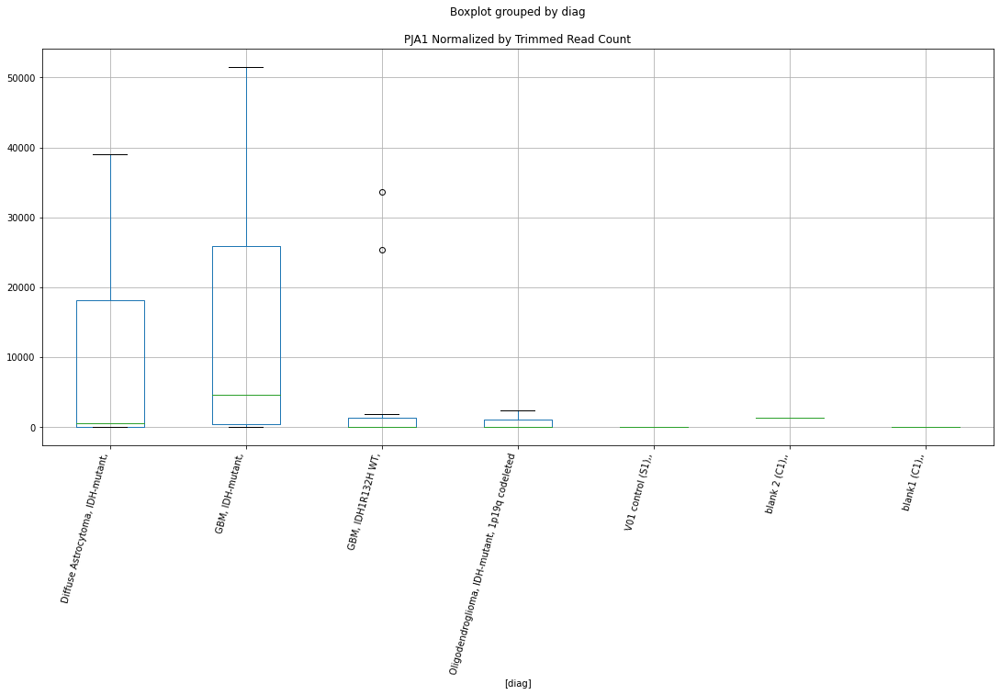

 p : 0.035068304773457584  ( t : 2.279248373514594 ) :  Lexogen  :  bbduk2  :  POLE4
Control and blanks
79     0.0
343    0.0
Name: POLE4, dtype: float64
211    0.0
Name: POLE4, dtype: float64
475    0.0
Name: POLE4, dtype: float64


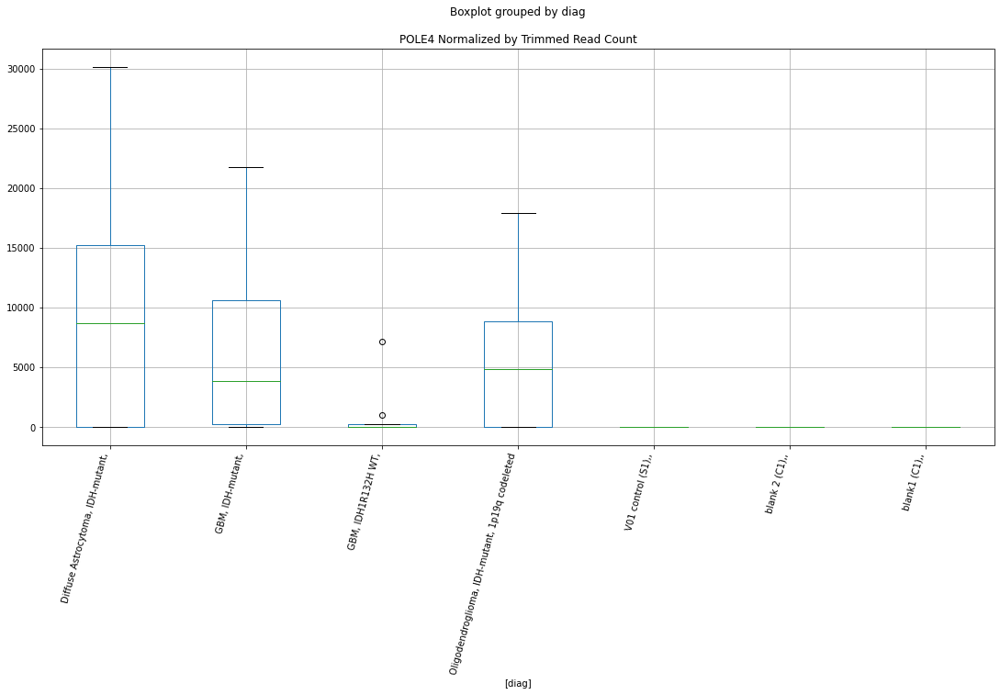

 p : 0.03507349510290093  ( t : 2.279175022368066 ) :  D-plex  :  cutadapt2  :  POTEC
Control and blanks
76         0.00
340    12330.25
Name: POTEC, dtype: float64
208    1939.96
Name: POTEC, dtype: float64
472    1155.91
Name: POTEC, dtype: float64


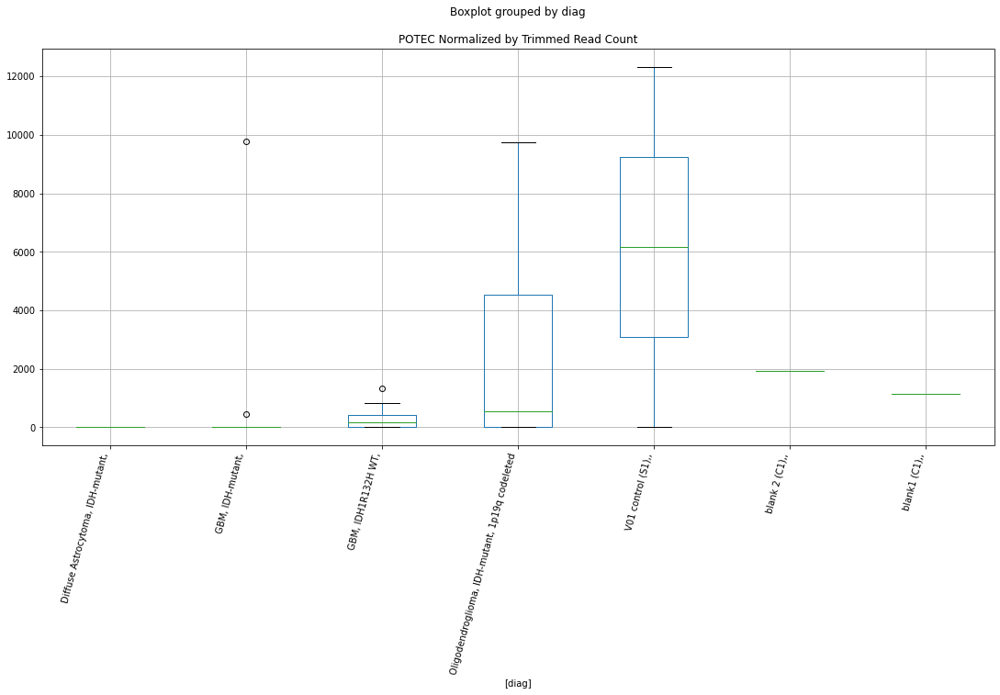

 p : 0.035119003118776554  ( t : 2.278532320483766 ) :  Lexogen  :  cutadapt2  :  RXFP3
Control and blanks
82       0.00
346    841.74
Name: RXFP3, dtype: float64
214    0.0
Name: RXFP3, dtype: float64
478    0.0
Name: RXFP3, dtype: float64


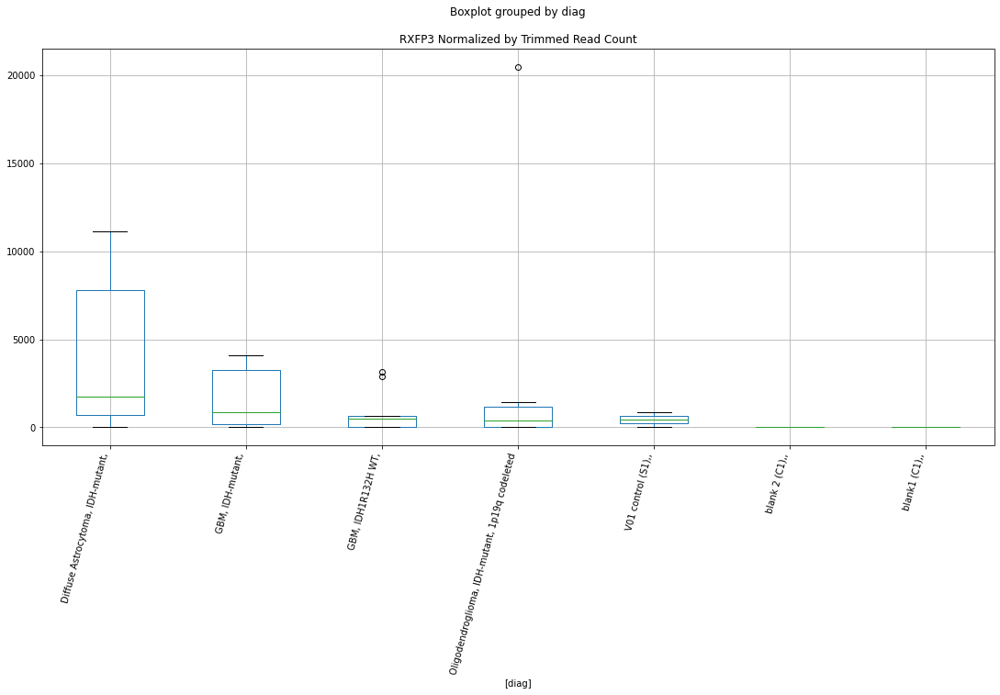

 p : 0.03515828091968747  ( t : 2.2779782261380097 ) :  D-plex  :  bbduk2  :  POLI
Control and blanks
73     0.0
337    0.0
Name: POLI, dtype: float64
205    9312.73
Name: POLI, dtype: float64
469    0.0
Name: POLI, dtype: float64


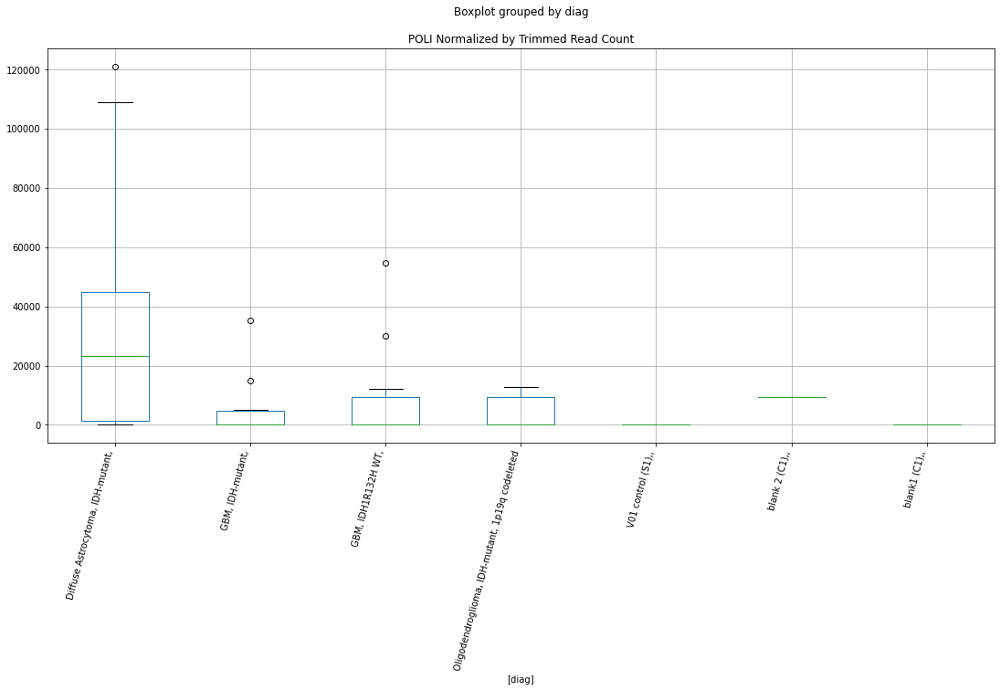

 p : 0.035167182051163925  ( t : 2.2778527369392325 ) :  D-plex  :  bbduk2  :  PKD1
Control and blanks
73     773.01
337      0.00
Name: PKD1, dtype: float64
205    21670.01
Name: PKD1, dtype: float64
469    11239.02
Name: PKD1, dtype: float64


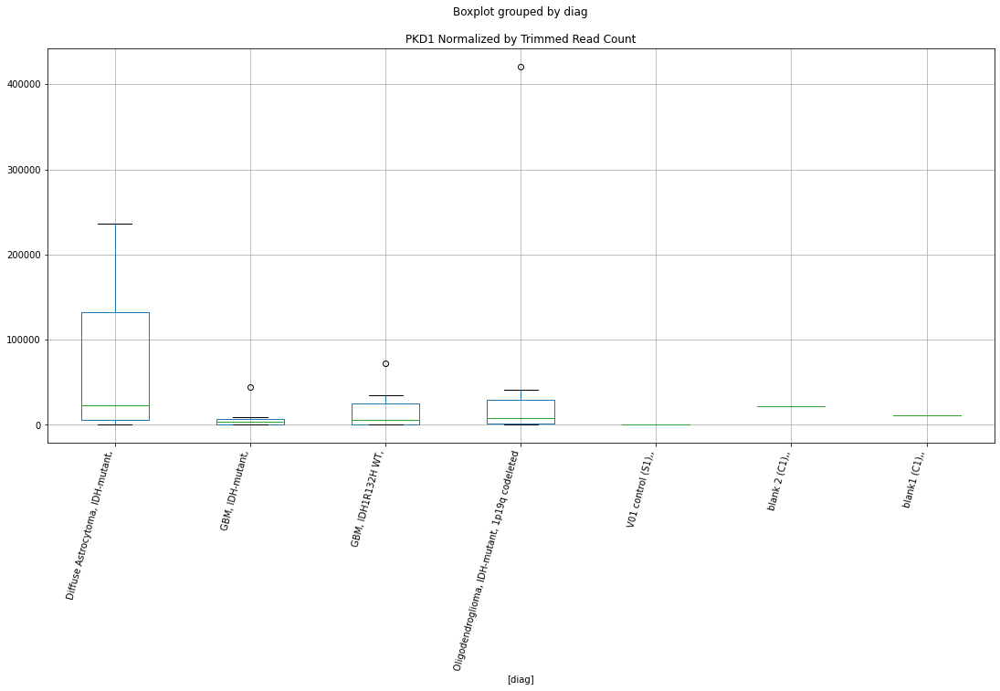

 p : 0.03518118228310329  ( t : 2.2776554194719965 ) :  D-plex  :  bbduk2  :  POTEC
Control and blanks
73         0.0
337    12462.2
Name: POTEC, dtype: float64
205    2328.18
Name: POTEC, dtype: float64
469    1183.05
Name: POTEC, dtype: float64


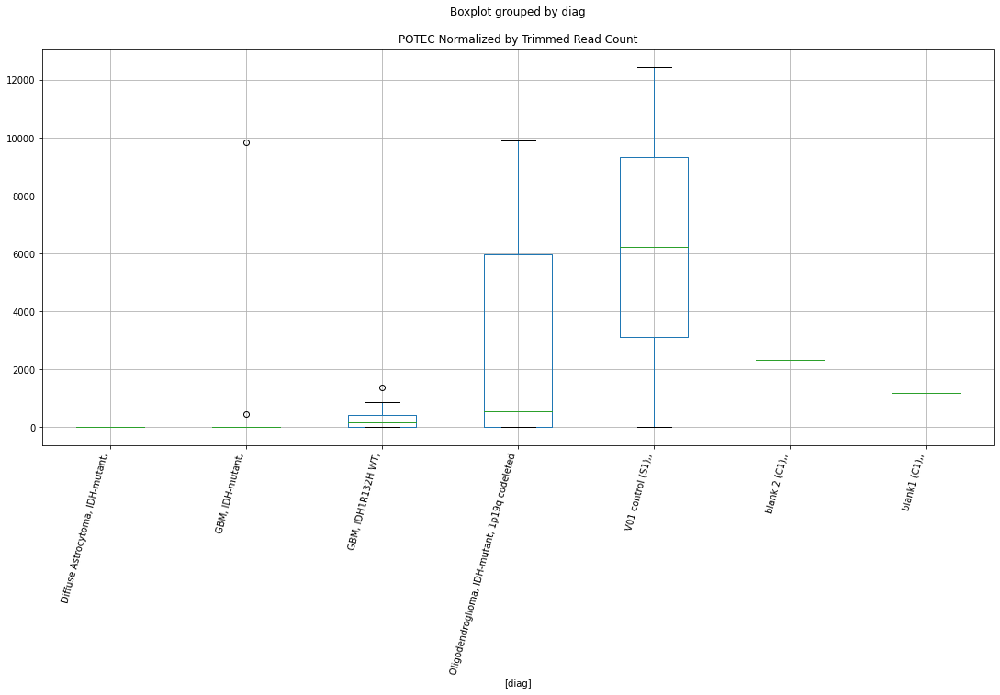

 p : 0.0351936444319878  ( t : 2.277479840656081 ) :  Lexogen  :  bbduk2  :  SHARPIN
Control and blanks
79     0.0
343    0.0
Name: SHARPIN, dtype: float64
211    0.0
Name: SHARPIN, dtype: float64
475    0.0
Name: SHARPIN, dtype: float64


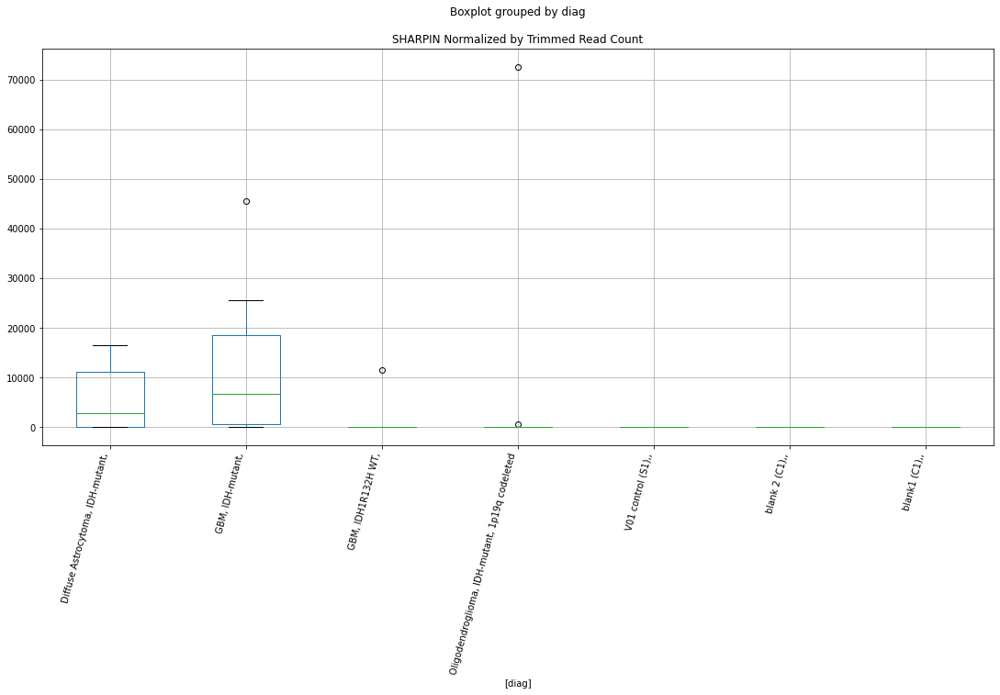

 p : 0.035208091176445466  ( t : 2.277276372914995 ) :  D-plex  :  cutadapt2  :  RAB30-DT
Control and blanks
76     0.0
340    0.0
Name: RAB30-DT, dtype: float64
208    881.8
Name: RAB30-DT, dtype: float64
472    0.0
Name: RAB30-DT, dtype: float64


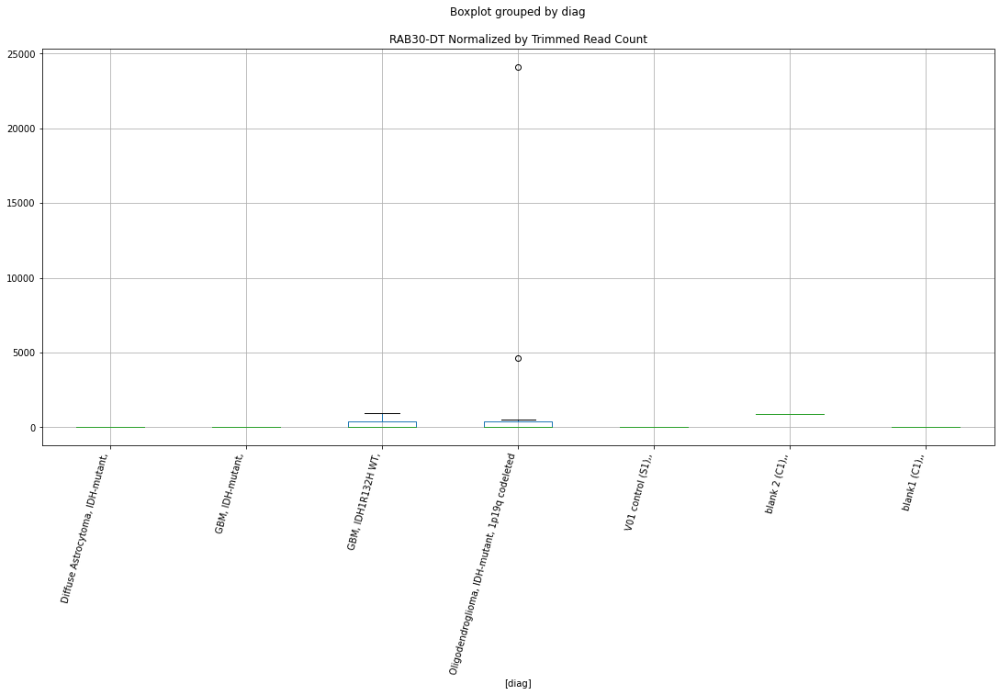

 p : 0.03523085024113935  ( t : 2.276955991213564 ) :  D-plex  :  cutadapt2  :  PHETA1
Control and blanks
76     0.0
340    0.0
Name: PHETA1, dtype: float64
208    4232.65
Name: PHETA1, dtype: float64
472    13870.94
Name: PHETA1, dtype: float64


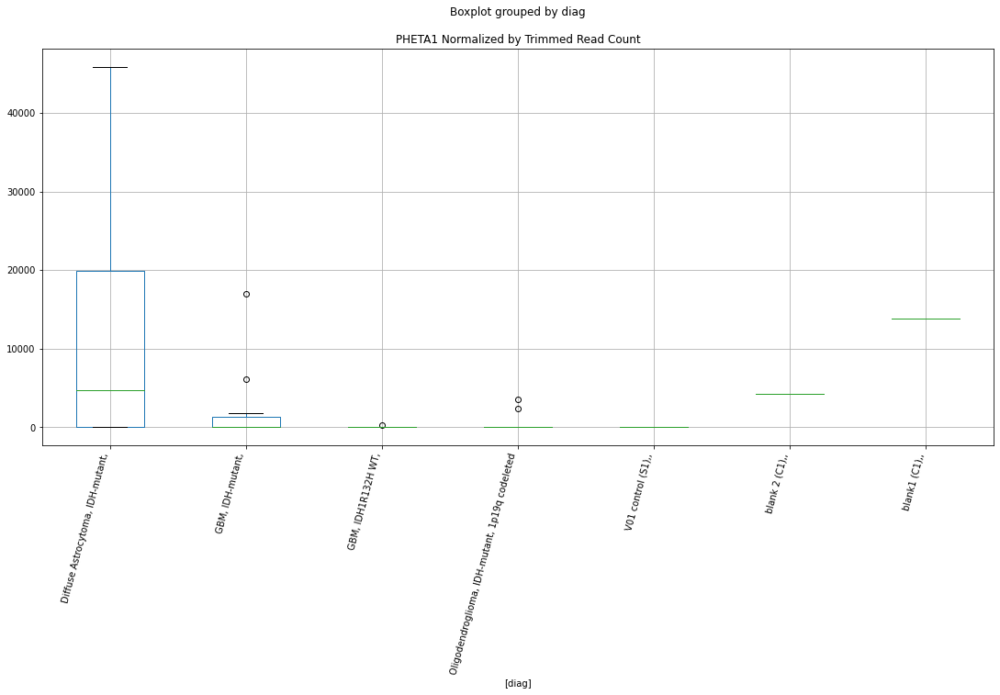

 p : 0.03523941300637772  ( t : 2.2768355018544804 ) :  D-plex  :  bbduk2  :  PLPPR3
Control and blanks
73         0.00
337    69432.27
Name: PLPPR3, dtype: float64
205    2328.18
Name: PLPPR3, dtype: float64
469    1774.58
Name: PLPPR3, dtype: float64


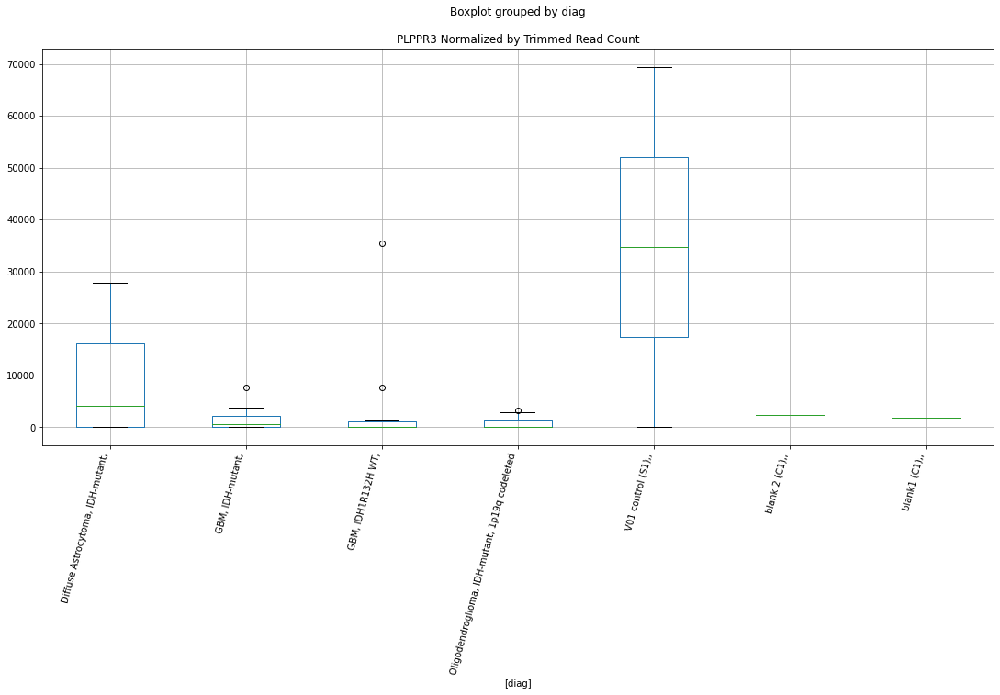

 p : 0.03526471461831844  ( t : 2.2764796331218067 ) :  D-plex  :  cutadapt2  :  PDK2
Control and blanks
76     0.0
340    0.0
Name: PDK2, dtype: float64
208    529.08
Name: PDK2, dtype: float64
472    0.0
Name: PDK2, dtype: float64


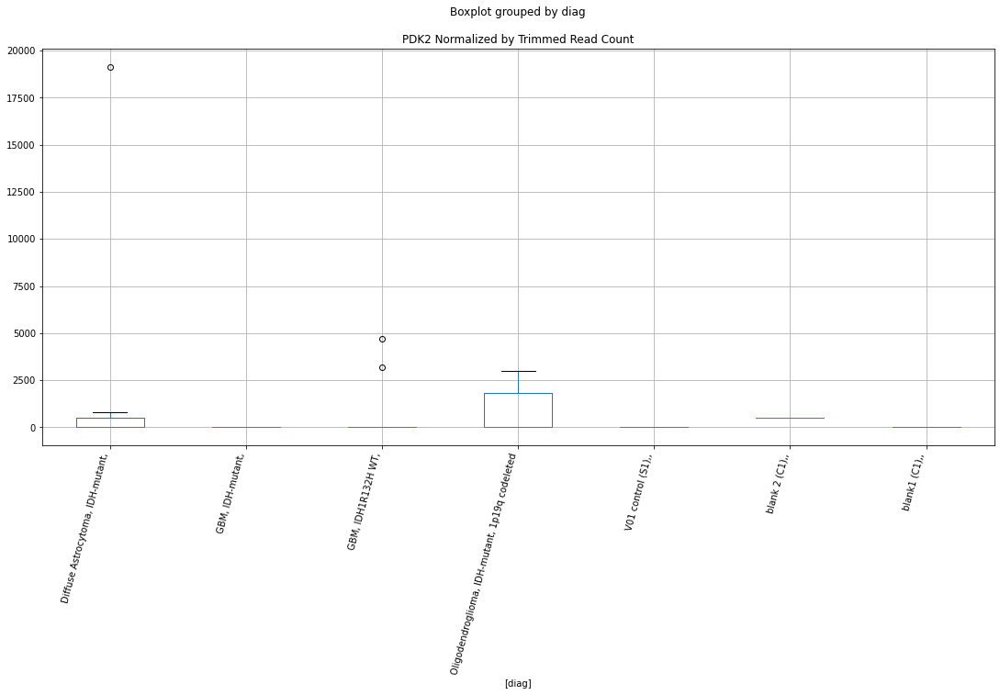

 p : 0.03528159072814789  ( t : 2.276242400891109 ) :  Lexogen  :  cutadapt2  :  RAP1B
Control and blanks
82     0.0
346    0.0
Name: RAP1B, dtype: float64
214    1627.36
Name: RAP1B, dtype: float64
478    1424.76
Name: RAP1B, dtype: float64


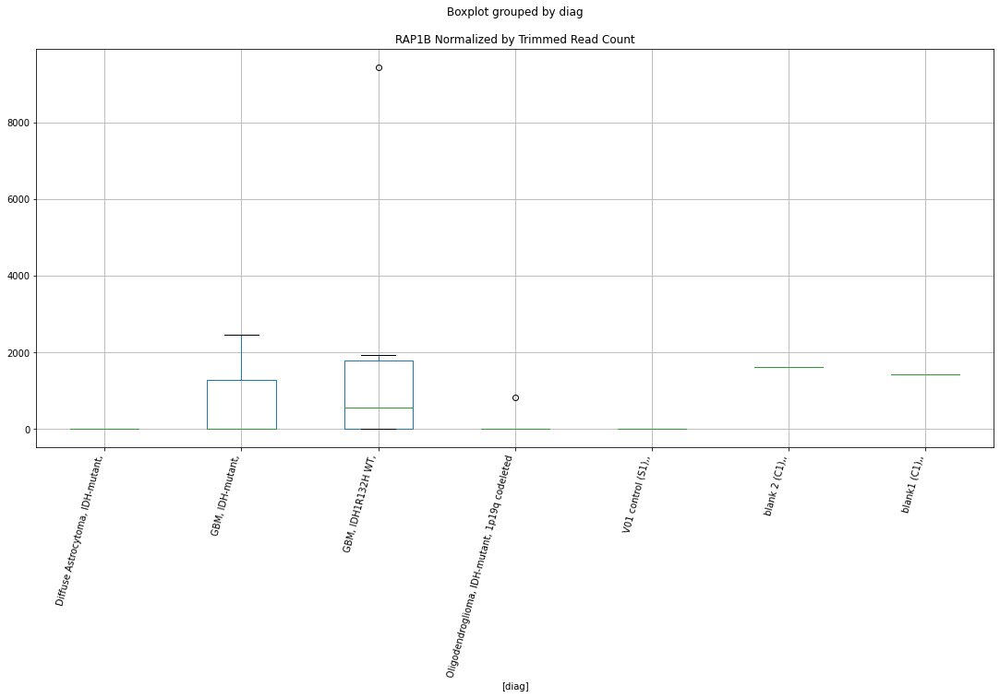

 p : 0.03529882539289501  ( t : 2.2760002366724414 ) :  D-plex  :  cutadapt2  :  PUS1
Control and blanks
76     0.0
340    0.0
Name: PUS1, dtype: float64
208    881.8
Name: PUS1, dtype: float64
472    2889.78
Name: PUS1, dtype: float64


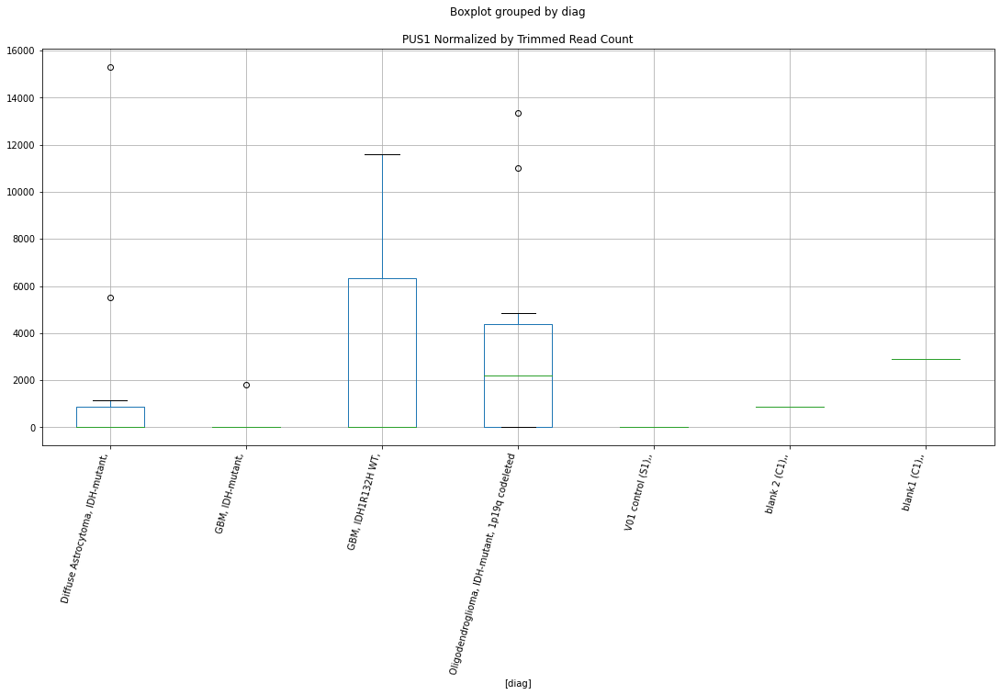

 p : 0.03537349031932529  ( t : 2.2749523817549226 ) :  Lexogen  :  cutadapt2  :  SHARPIN
Control and blanks
82     0.0
346    0.0
Name: SHARPIN, dtype: float64
214    0.0
Name: SHARPIN, dtype: float64
478    0.0
Name: SHARPIN, dtype: float64


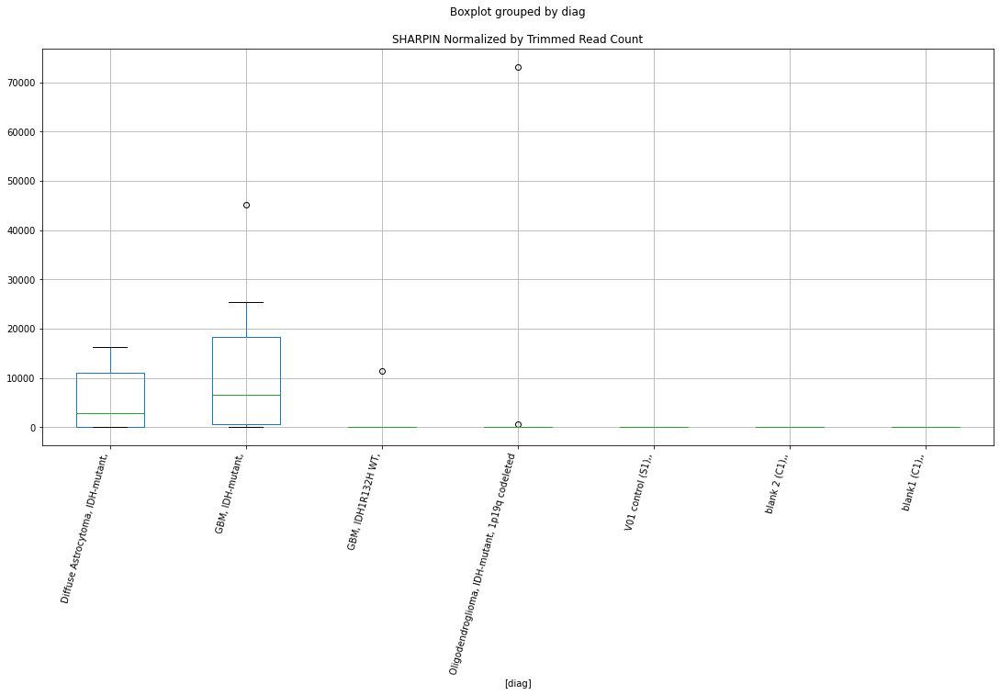

 p : 0.03542397105914985  ( t : 2.274245088669914 ) :  Lexogen  :  cutadapt2  :  SLC12A7
Control and blanks
82          0.00
346    145831.12
Name: SLC12A7, dtype: float64
214    0.0
Name: SLC12A7, dtype: float64
478    0.0
Name: SLC12A7, dtype: float64


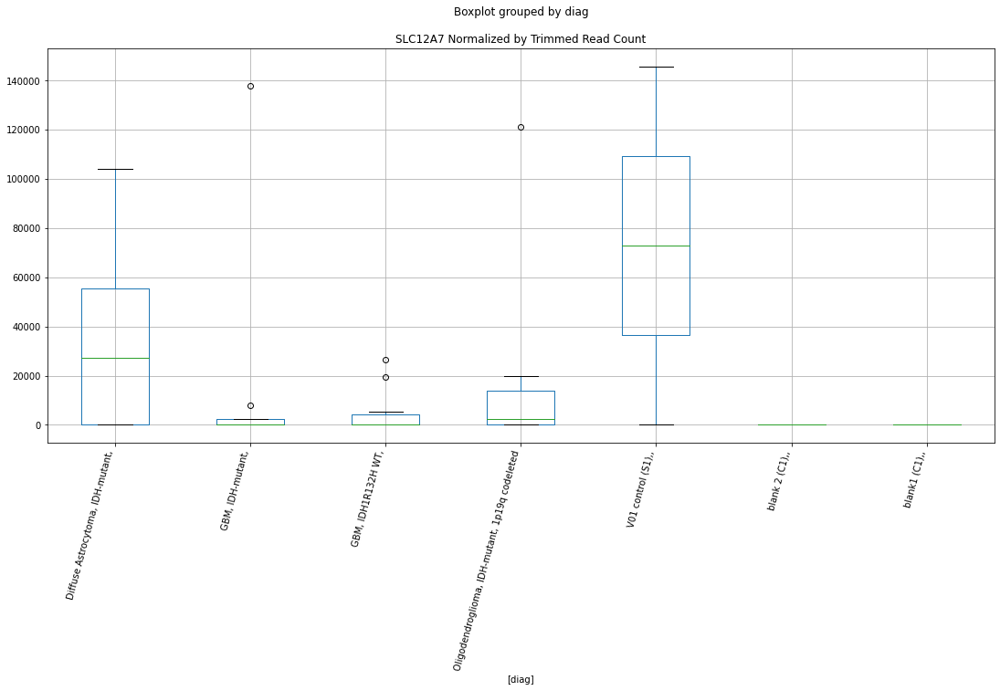

 p : 0.0354369676294841  ( t : 2.274063142717581 ) :  D-plex  :  bbduk2  :  RAB30-DT
Control and blanks
73     0.0
337    0.0
Name: RAB30-DT, dtype: float64
205    895.45
Name: RAB30-DT, dtype: float64
469    0.0
Name: RAB30-DT, dtype: float64


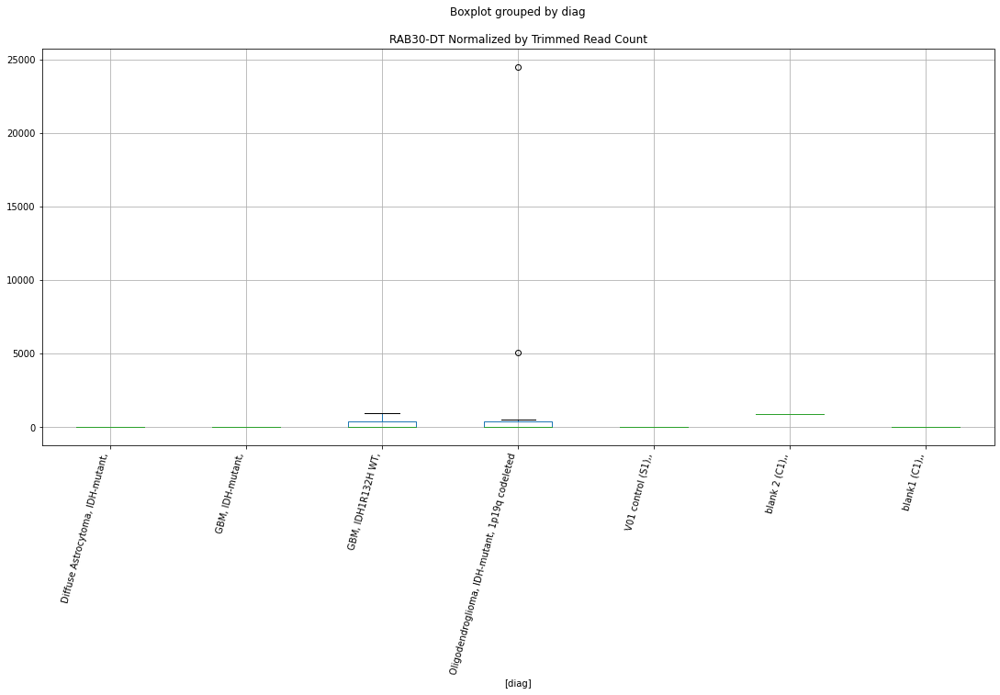

 p : 0.03551874455724884  ( t : 2.272919717586917 ) :  Lexogen  :  bbduk2  :  PNPLA6
Control and blanks
79          0.00
343    156051.02
Name: PNPLA6, dtype: float64
211    0.0
Name: PNPLA6, dtype: float64
475    0.0
Name: PNPLA6, dtype: float64


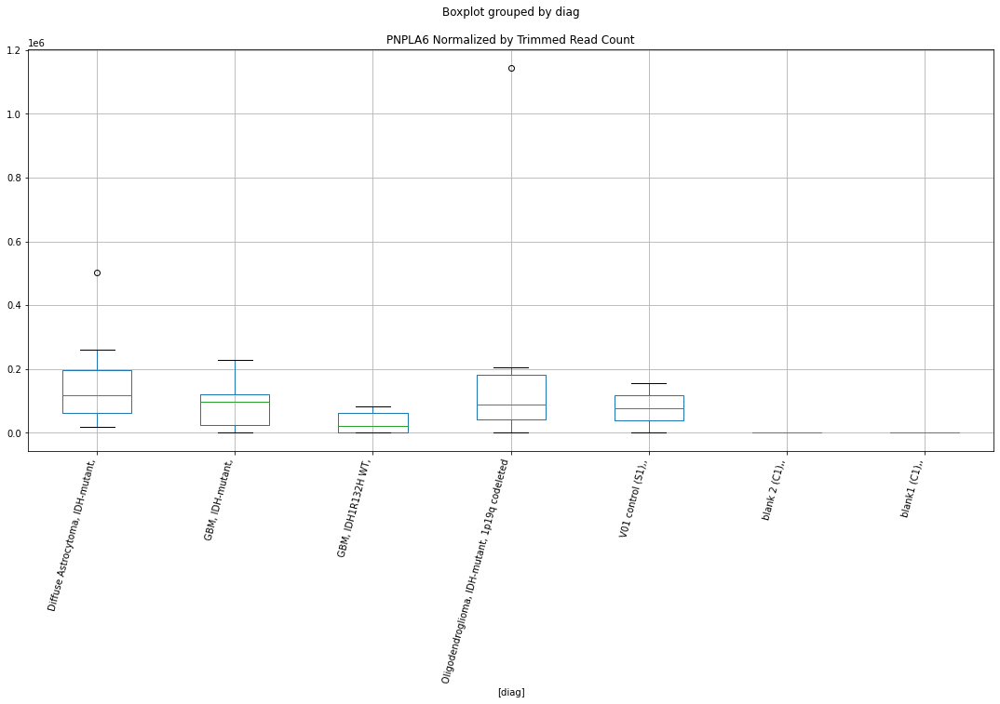

 p : 0.03558541663709777  ( t : 2.2719892923765324 ) :  D-plex  :  bbduk2  :  PSMD12
Control and blanks
73     0.0
337    0.0
Name: PSMD12, dtype: float64
205    0.0
Name: PSMD12, dtype: float64
469    0.0
Name: PSMD12, dtype: float64


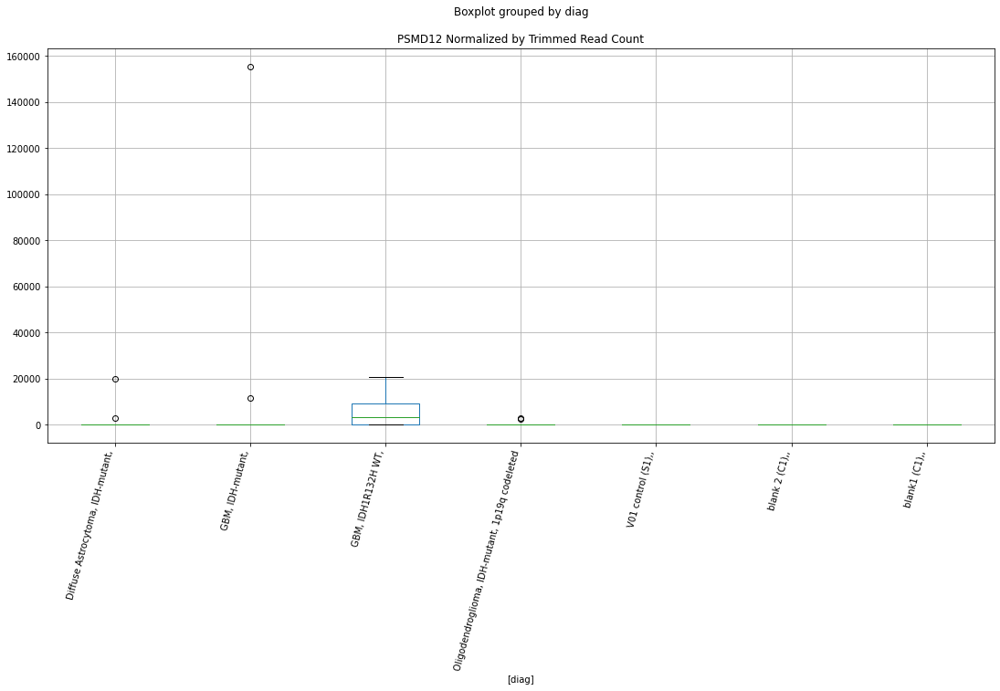

 p : 0.035604769380762874  ( t : 2.2717195219689734 ) :  D-plex  :  bbduk2  :  PHF14
Control and blanks
73     0.0
337    0.0
Name: PHF14, dtype: float64
205    1432.73
Name: PHF14, dtype: float64
469    1183.05
Name: PHF14, dtype: float64


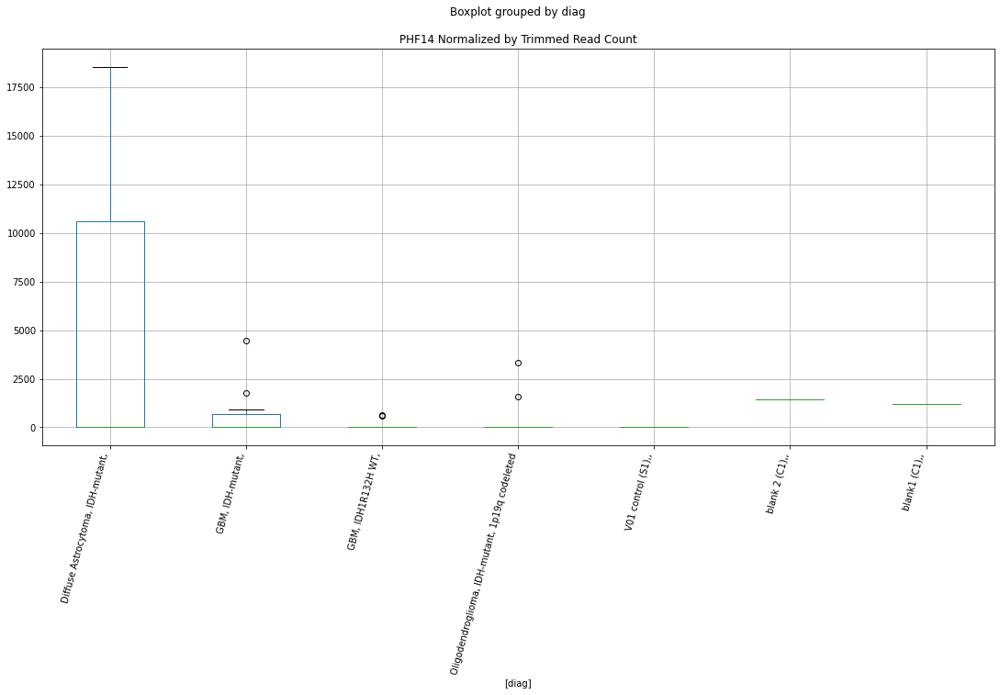

 p : 0.03570793749538245  ( t : 2.270283678912972 ) :  D-plex  :  bbduk2  :  PDK2
Control and blanks
73     0.0
337    0.0
Name: PDK2, dtype: float64
205    537.27
Name: PDK2, dtype: float64
469    0.0
Name: PDK2, dtype: float64


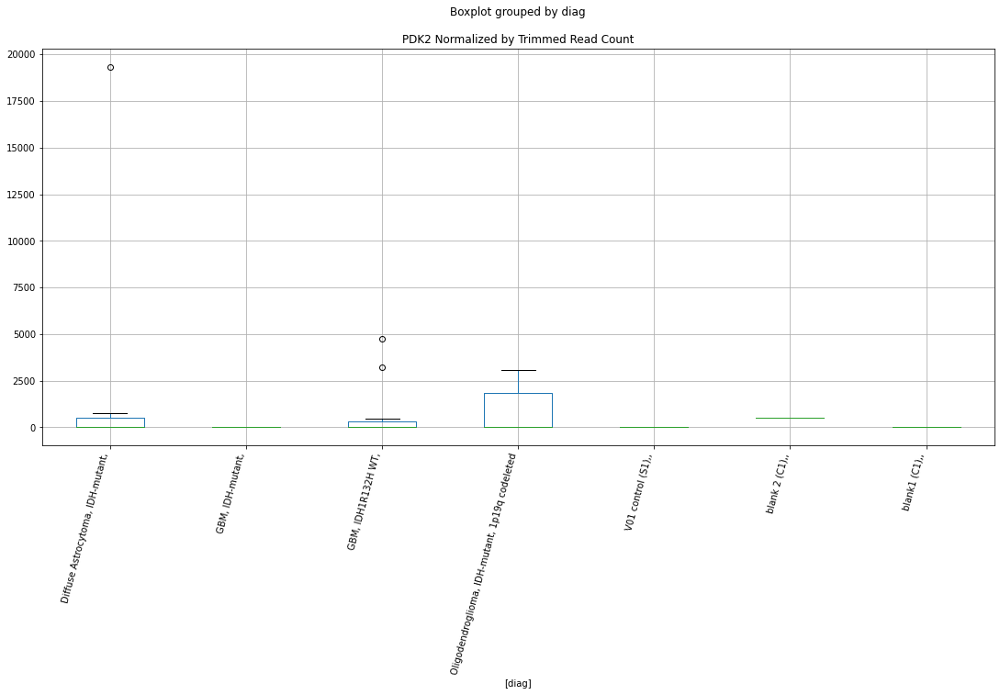

 p : 0.03571172165252588  ( t : 2.2702310858366324 ) :  D-plex  :  cutadapt2  :  PRKAA1
Control and blanks
76     0.0
340    0.0
Name: PRKAA1, dtype: float64
208    352.72
Name: PRKAA1, dtype: float64
472    11559.12
Name: PRKAA1, dtype: float64


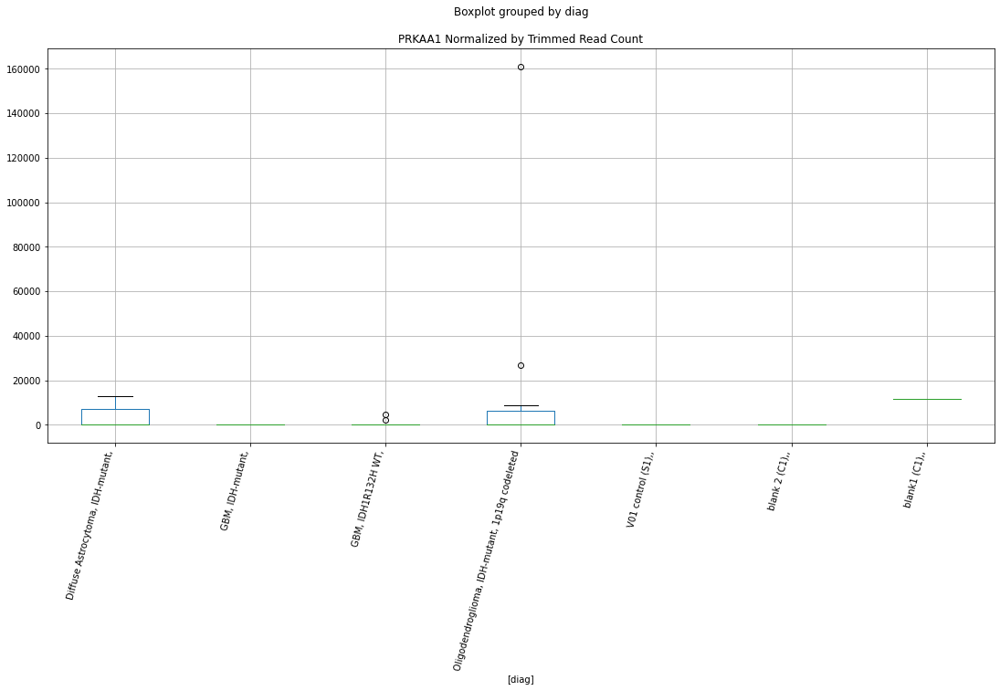

 p : 0.03573731835015699  ( t : 2.2698754723576586 ) :  D-plex  :  cutadapt2  :  PTGER1
Control and blanks
76     0.0
340    0.0
Name: PTGER1, dtype: float64
208    529.08
Name: PTGER1, dtype: float64
472    1155.91
Name: PTGER1, dtype: float64


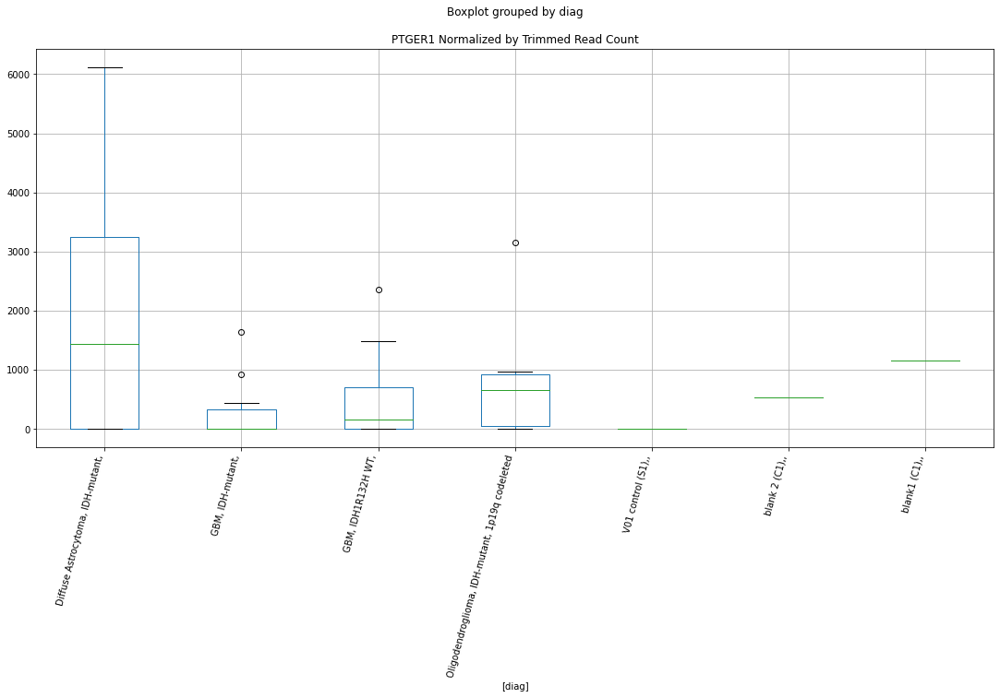

 p : 0.035769039131228454  ( t : 2.269435103930565 ) :  D-plex  :  bbduk2  :  PTGER2
Control and blanks
73     0.0
337    0.0
Name: PTGER2, dtype: float64
205    60174.56
Name: PTGER2, dtype: float64
469    1774.58
Name: PTGER2, dtype: float64


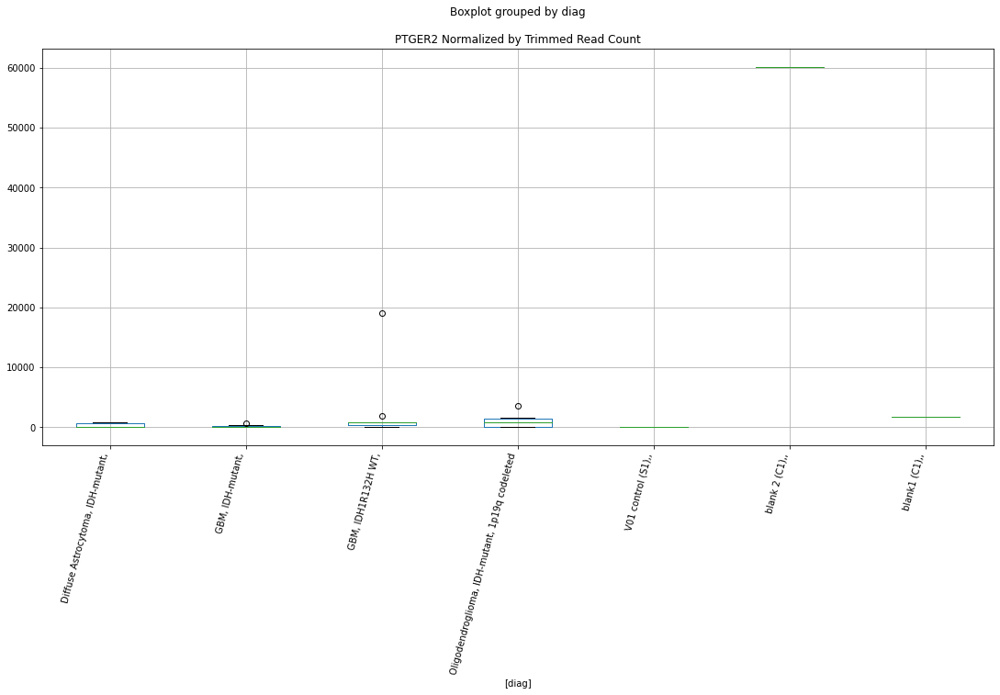

 p : 0.03585498808337896  ( t : 2.2682437168607197 ) :  Lexogen  :  bbduk2  :  SKIL
Control and blanks
79     0.0
343    0.0
Name: SKIL, dtype: float64
211    0.0
Name: SKIL, dtype: float64
475    1437.09
Name: SKIL, dtype: float64


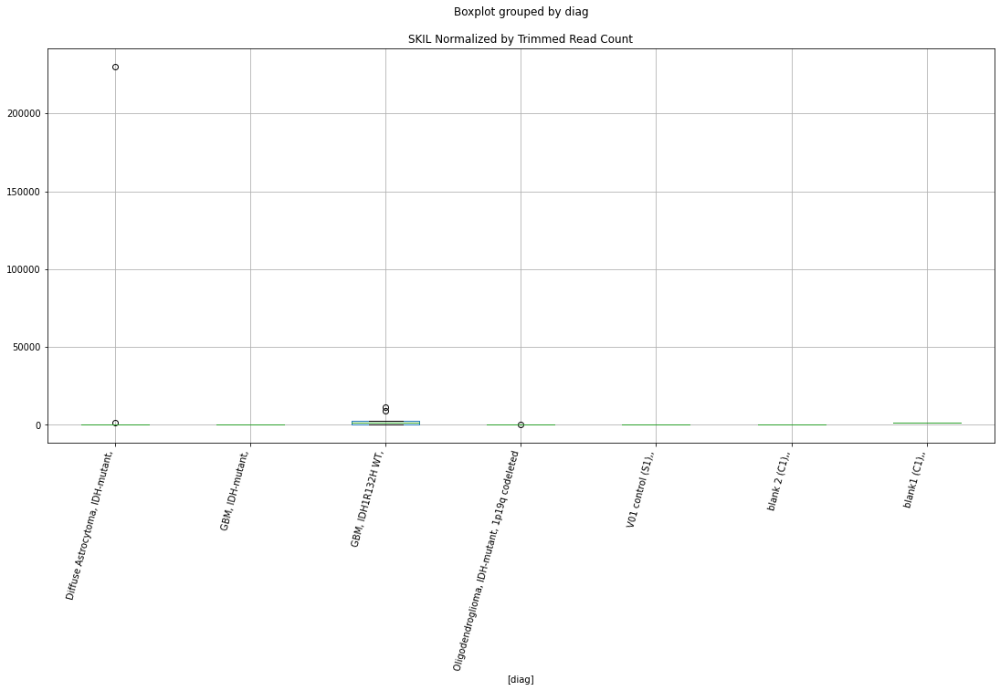

 p : 0.03588148137608526  ( t : 2.267877010637933 ) :  D-plex  :  bbduk2  :  PCGF2
Control and blanks
73     0.0
337    0.0
Name: PCGF2, dtype: float64
205    716.36
Name: PCGF2, dtype: float64
469    0.0
Name: PCGF2, dtype: float64


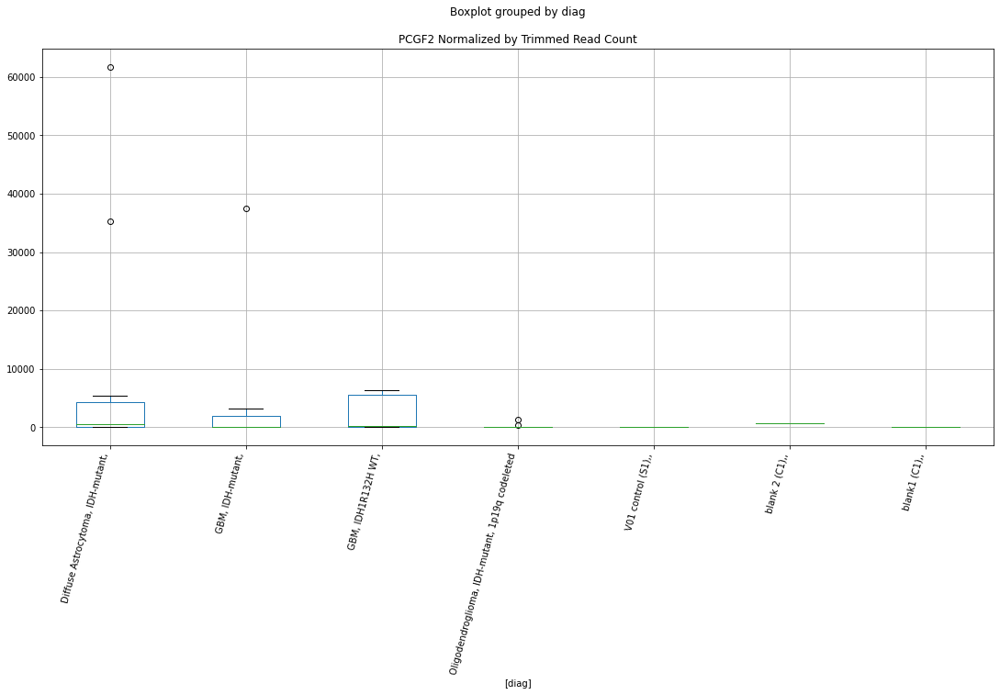

 p : 0.035887995241605894  ( t : 2.267786887472271 ) :  D-plex  :  bbduk2  :  SNHG28
Control and blanks
73     0.0
337    0.0
Name: SNHG28, dtype: float64
205    716.36
Name: SNHG28, dtype: float64
469    0.0
Name: SNHG28, dtype: float64


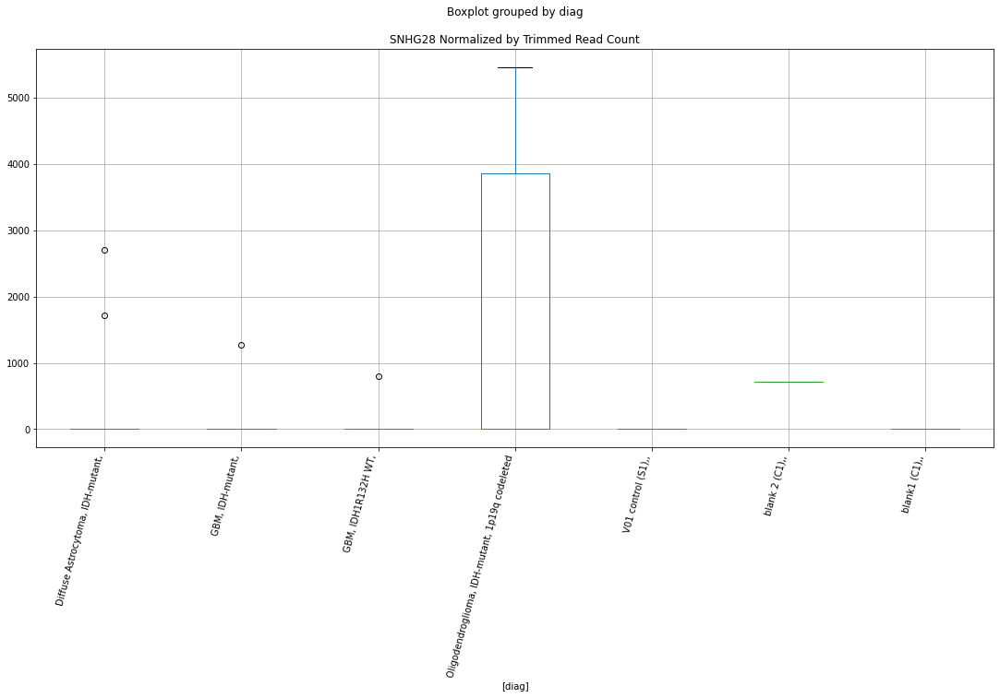

 p : 0.03589292313467142  ( t : 2.2677187172156565 ) :  Lexogen  :  cutadapt2  :  PLXNC1
Control and blanks
82     0.0
346    0.0
Name: PLXNC1, dtype: float64
214    2441.04
Name: PLXNC1, dtype: float64
478    0.0
Name: PLXNC1, dtype: float64


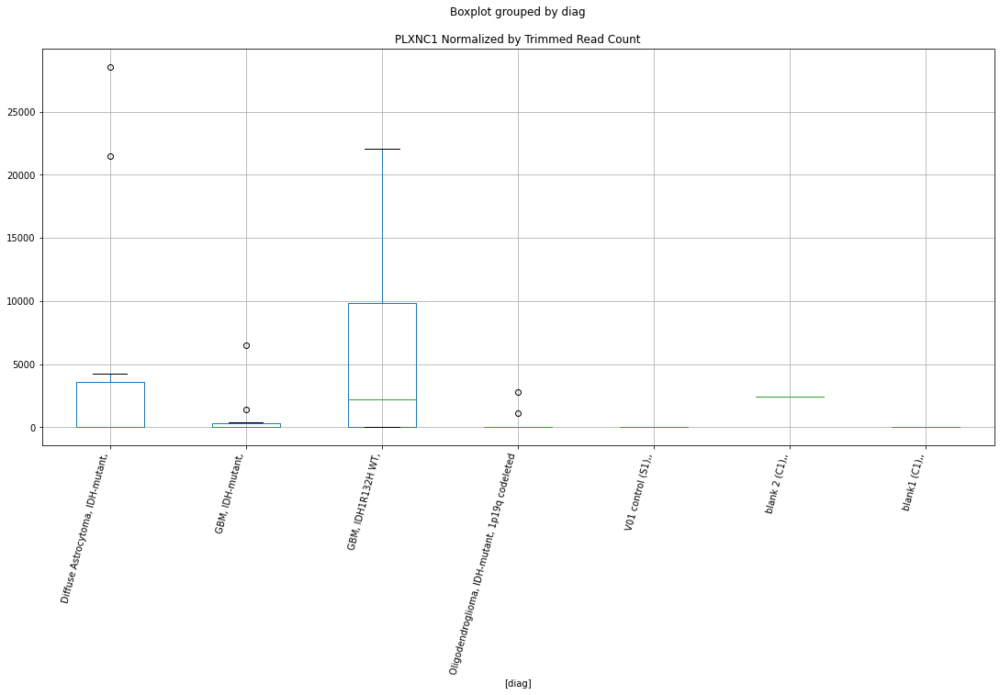

 p : 0.03591793172479783  ( t : 2.267372892930443 ) :  Lexogen  :  cutadapt2  :  RPE65
Control and blanks
82     0.0
346    0.0
Name: RPE65, dtype: float64
214    0.0
Name: RPE65, dtype: float64
478    0.0
Name: RPE65, dtype: float64


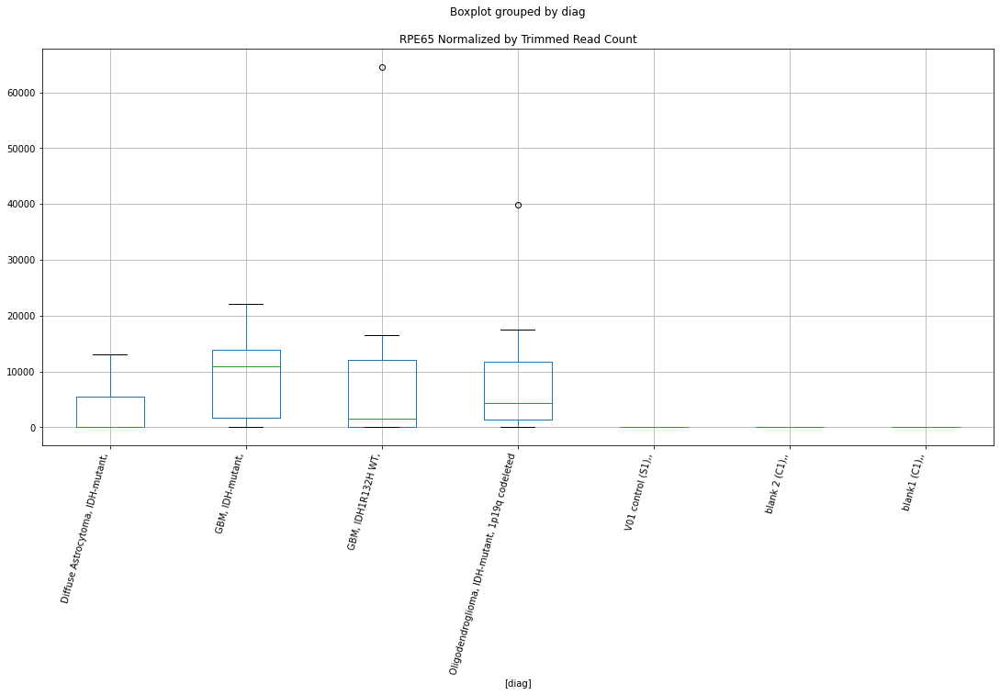

 p : 0.03595095855849699  ( t : 2.2669165314994597 ) :  D-plex  :  bbduk2  :  RBM6
Control and blanks
73     773.01
337      0.00
Name: RBM6, dtype: float64
205    40474.56
Name: RBM6, dtype: float64
469    18337.35
Name: RBM6, dtype: float64


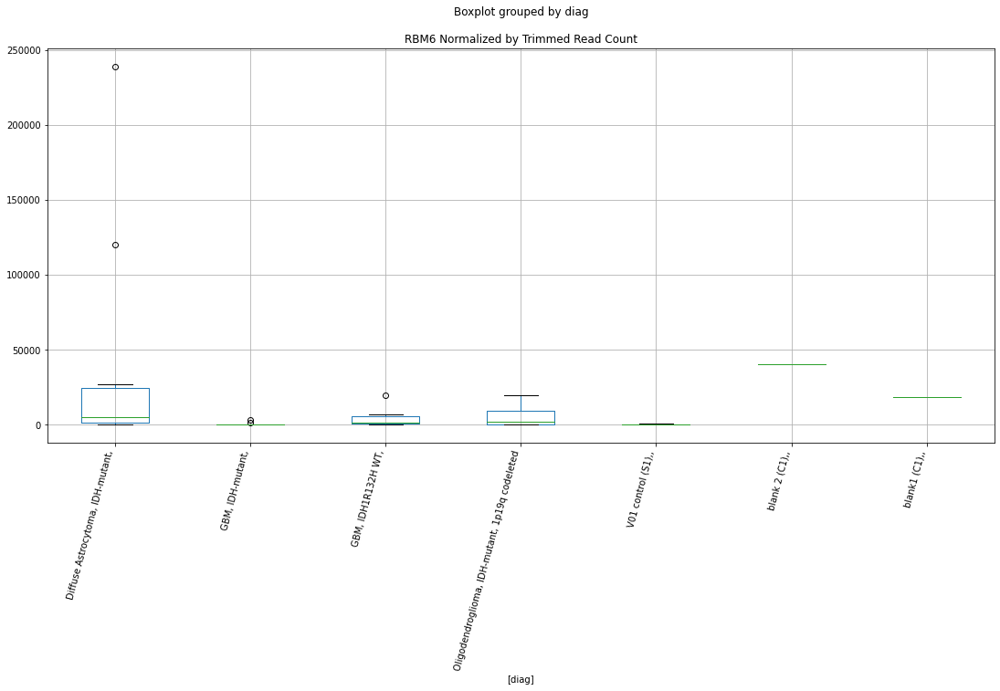

 p : 0.03602119268465596  ( t : 2.265947330312579 ) :  D-plex  :  bbduk2  :  RASA4DP
Control and blanks
73     0.0
337    0.0
Name: RASA4DP, dtype: float64
205    2149.09
Name: RASA4DP, dtype: float64
469    0.0
Name: RASA4DP, dtype: float64


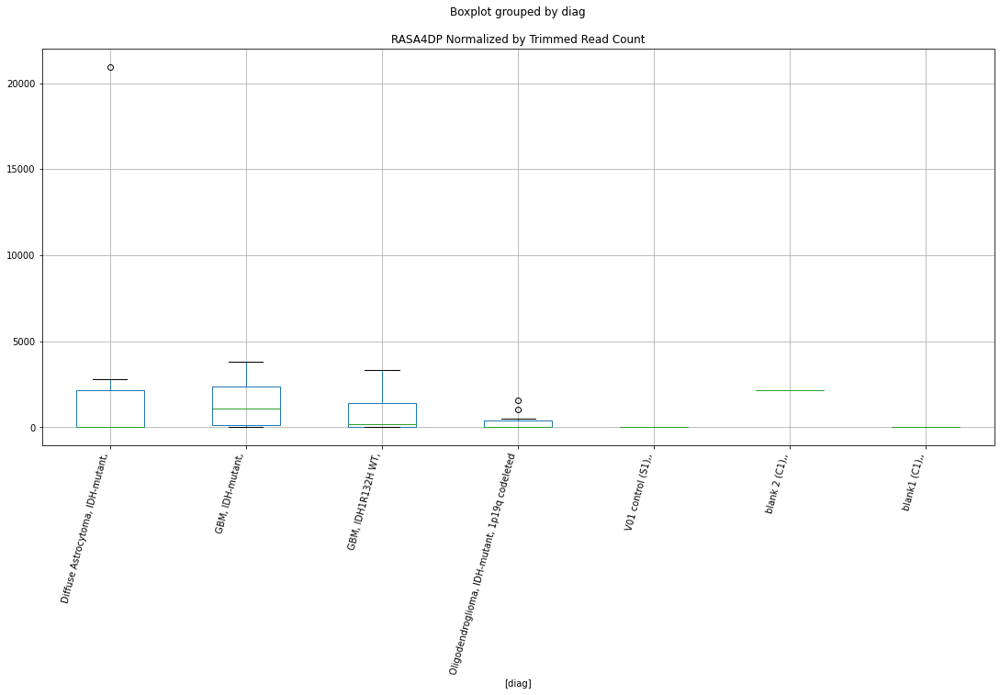

 p : 0.036062433084316524  ( t : 2.2653790438289128 ) :  D-plex  :  bbduk2  :  RSBN1
Control and blanks
73     0.0
337    0.0
Name: RSBN1, dtype: float64
205    3402.73
Name: RSBN1, dtype: float64
469    4732.22
Name: RSBN1, dtype: float64


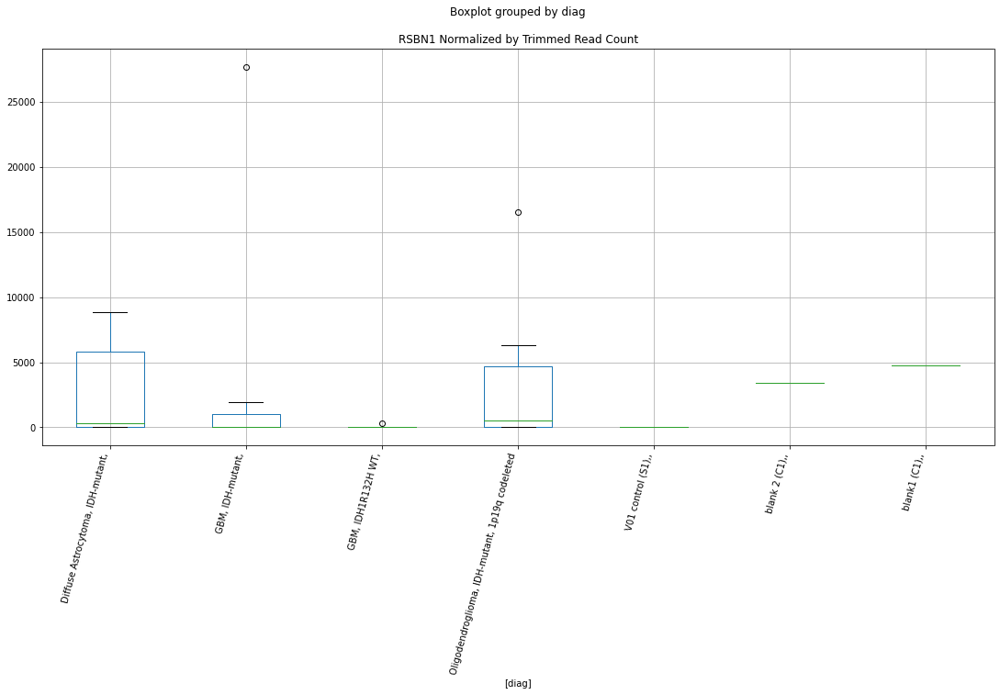

 p : 0.03607211162308514  ( t : 2.2652457620456743 ) :  Lexogen  :  bbduk2  :  SCARNA17
Control and blanks
79      2861.20
343    14437.37
Name: SCARNA17, dtype: float64
211    14211.93
Name: SCARNA17, dtype: float64
475    958.06
Name: SCARNA17, dtype: float64


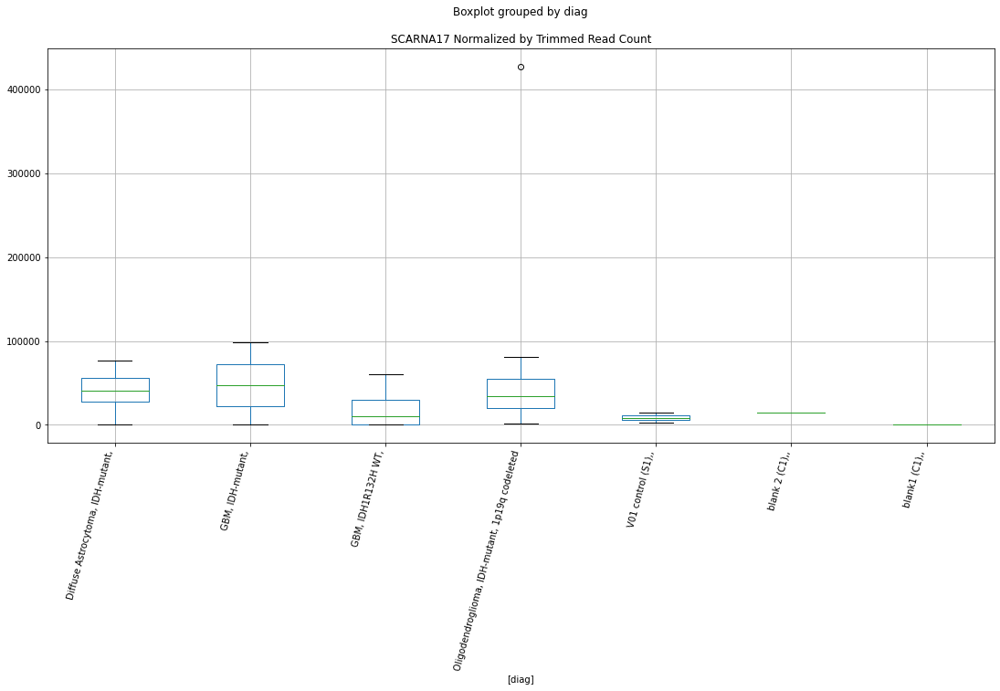

 p : 0.03608640132592889  ( t : 2.2650490409819932 ) :  Lexogen  :  bbduk2  :  RAPGEF5
Control and blanks
79       0.00
343    212.31
Name: RAPGEF5, dtype: float64
211    0.0
Name: RAPGEF5, dtype: float64
475    239.52
Name: RAPGEF5, dtype: float64


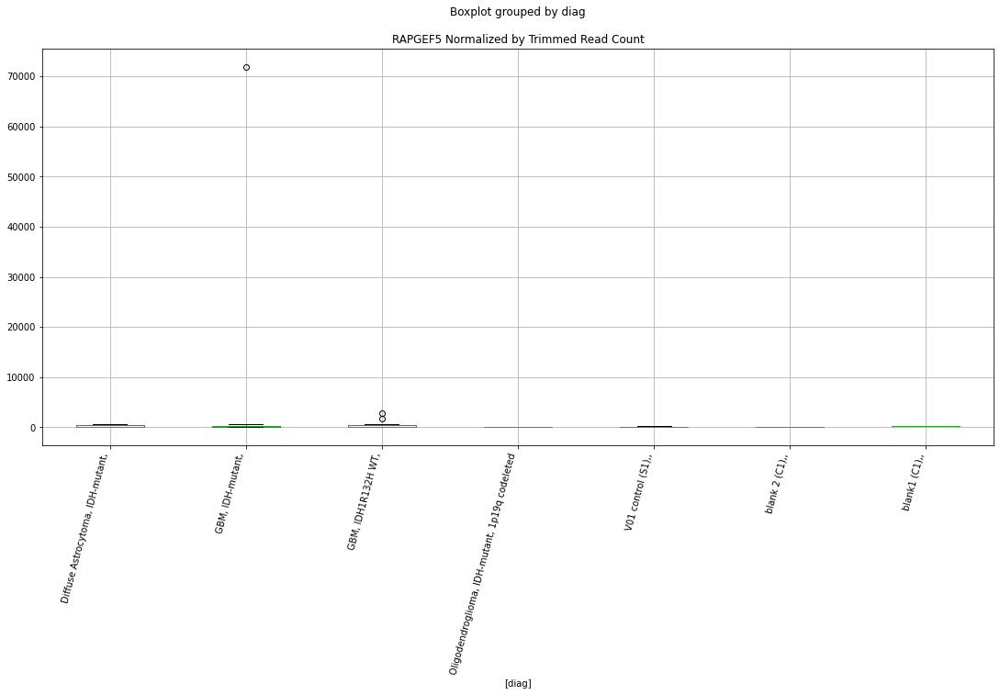

 p : 0.03611507381513924  ( t : 2.2646545344541407 ) :  Lexogen  :  cutadapt2  :  PRKCB
Control and blanks
82     0.0
346    0.0
Name: PRKCB, dtype: float64
214    2169.81
Name: PRKCB, dtype: float64
478    0.0
Name: PRKCB, dtype: float64


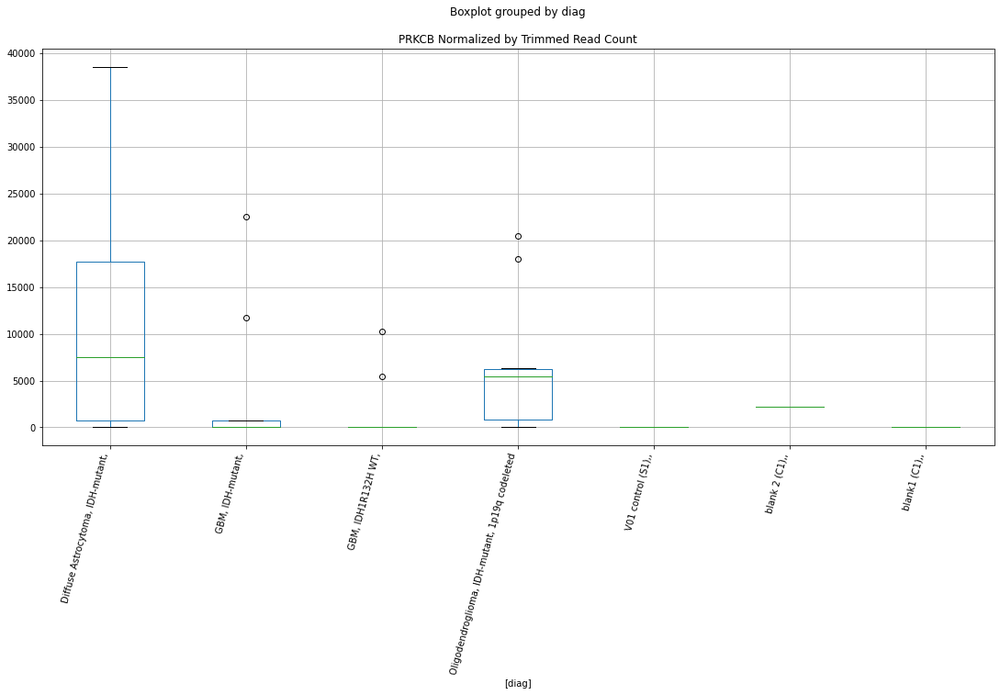

 p : 0.0361200415940517  ( t : 2.2645862119011055 ) :  Lexogen  :  cutadapt2  :  SCARNA17
Control and blanks
82      2840.10
346    14309.55
Name: SCARNA17, dtype: float64
214    14375.0
Name: SCARNA17, dtype: float64
478    949.84
Name: SCARNA17, dtype: float64


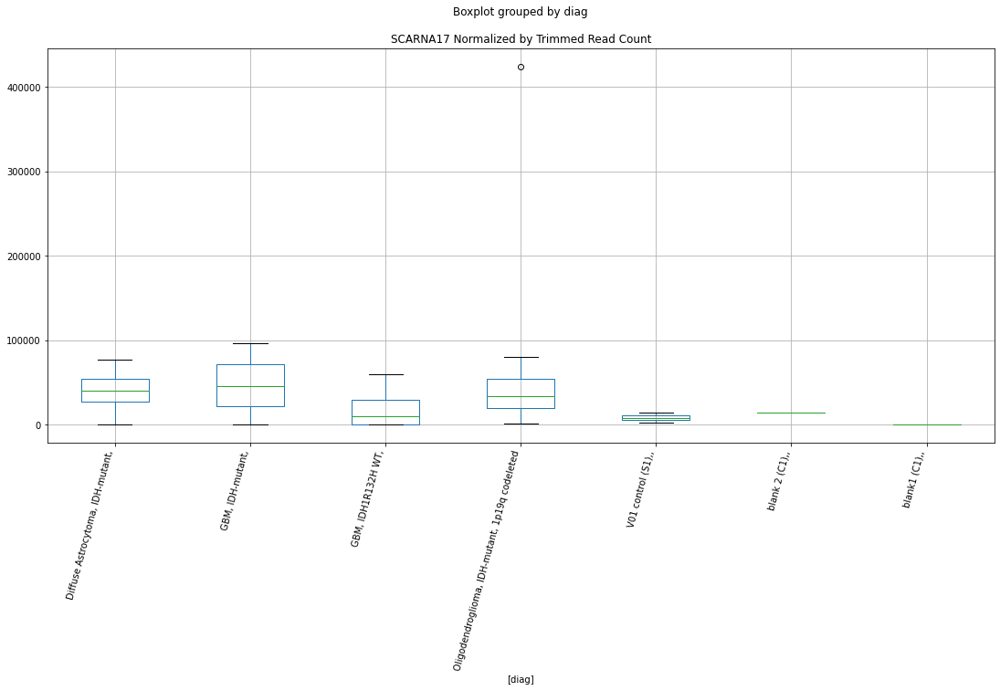

 p : 0.036134807548110326  ( t : 2.2643831849369165 ) :  D-plex  :  cutadapt2  :  RNA45SN2
Control and blanks
76     4.34e+06
340    2.62e+06
Name: RNA45SN2, dtype: float64
208    2.53e+06
Name: RNA45SN2, dtype: float64
472    2.62e+06
Name: RNA45SN2, dtype: float64


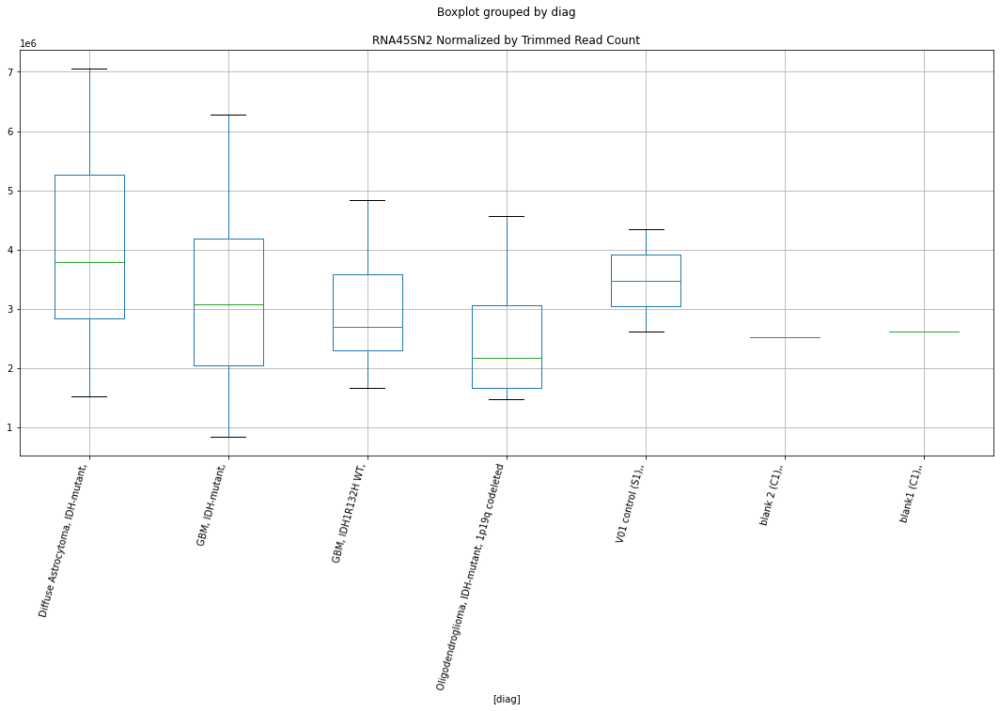

 p : 0.03614717762318349  ( t : 2.2642131595201263 ) :  Lexogen  :  bbduk2  :  RPS6KA3
Control and blanks
79         0.00
343    20169.86
Name: RPS6KA3, dtype: float64
211    36349.74
Name: RPS6KA3, dtype: float64
475    13652.4
Name: RPS6KA3, dtype: float64


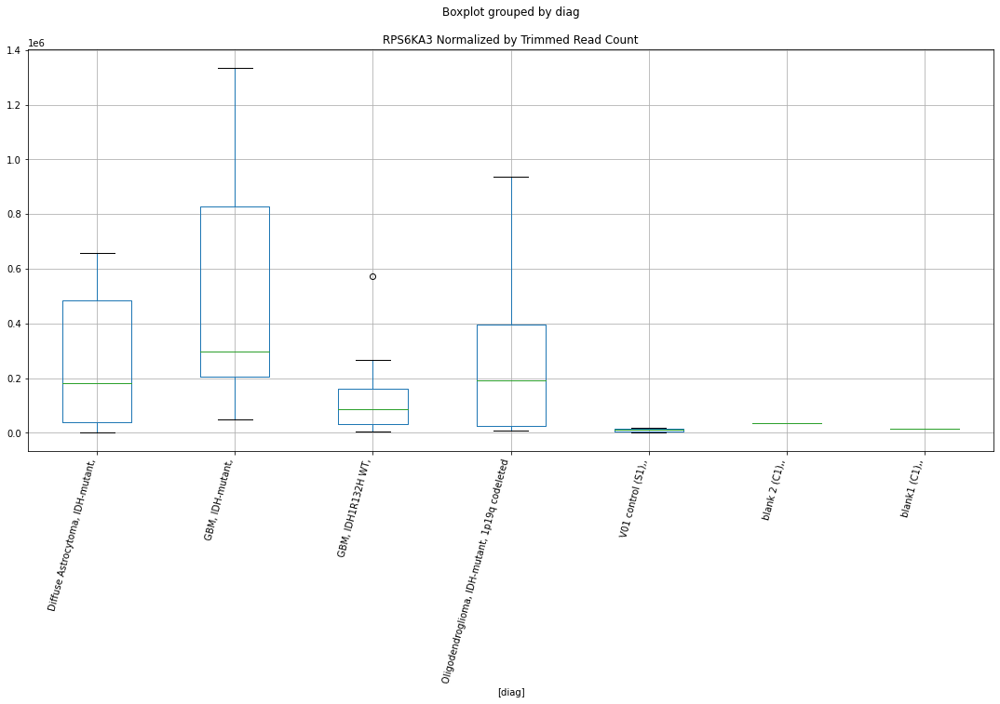

 p : 0.036157923186985755  ( t : 2.26406550647827 ) :  Lexogen  :  bbduk2  :  SLC25A23
Control and blanks
79     0.0
343    0.0
Name: SLC25A23, dtype: float64
211    0.0
Name: SLC25A23, dtype: float64
475    0.0
Name: SLC25A23, dtype: float64


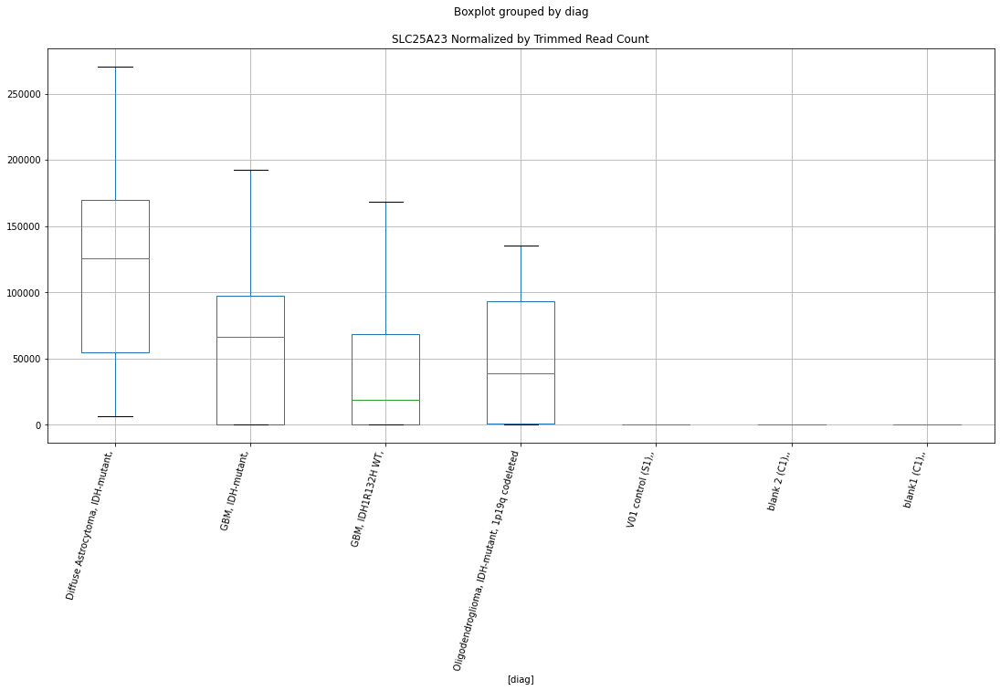

 p : 0.036189275310332746  ( t : 2.263634933681522 ) :  D-plex  :  cutadapt2  :  RCOR2
Control and blanks
76     0.0
340    0.0
Name: RCOR2, dtype: float64
208    705.44
Name: RCOR2, dtype: float64
472    0.0
Name: RCOR2, dtype: float64


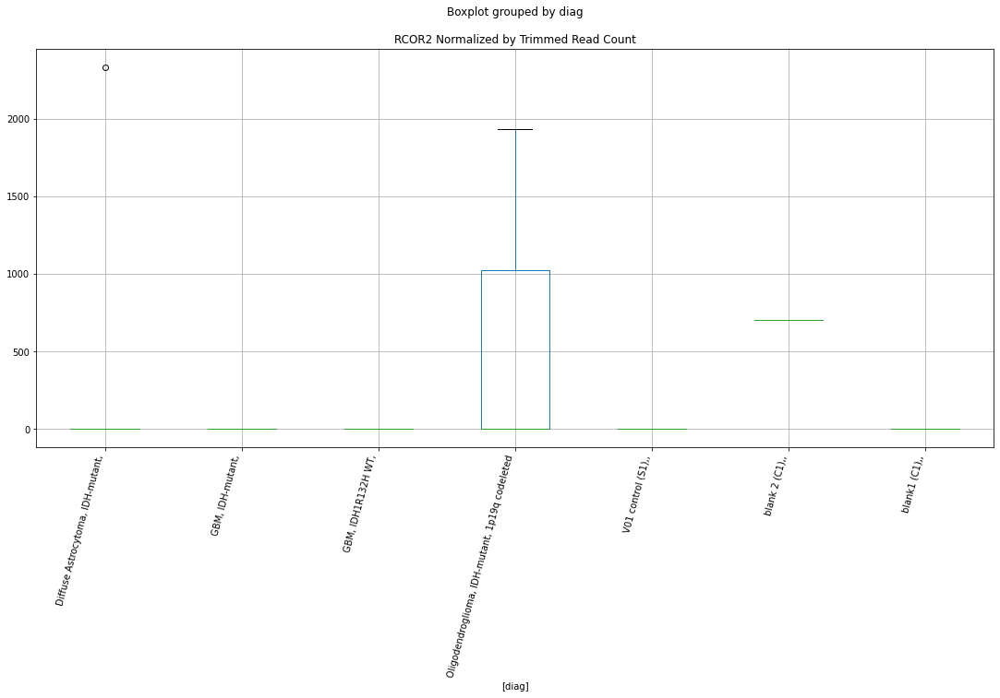

 p : 0.03620270920851857  ( t : 2.263450545400154 ) :  Lexogen  :  cutadapt2  :  SLC25A23
Control and blanks
82     0.0
346    0.0
Name: SLC25A23, dtype: float64
214    0.0
Name: SLC25A23, dtype: float64
478    0.0
Name: SLC25A23, dtype: float64


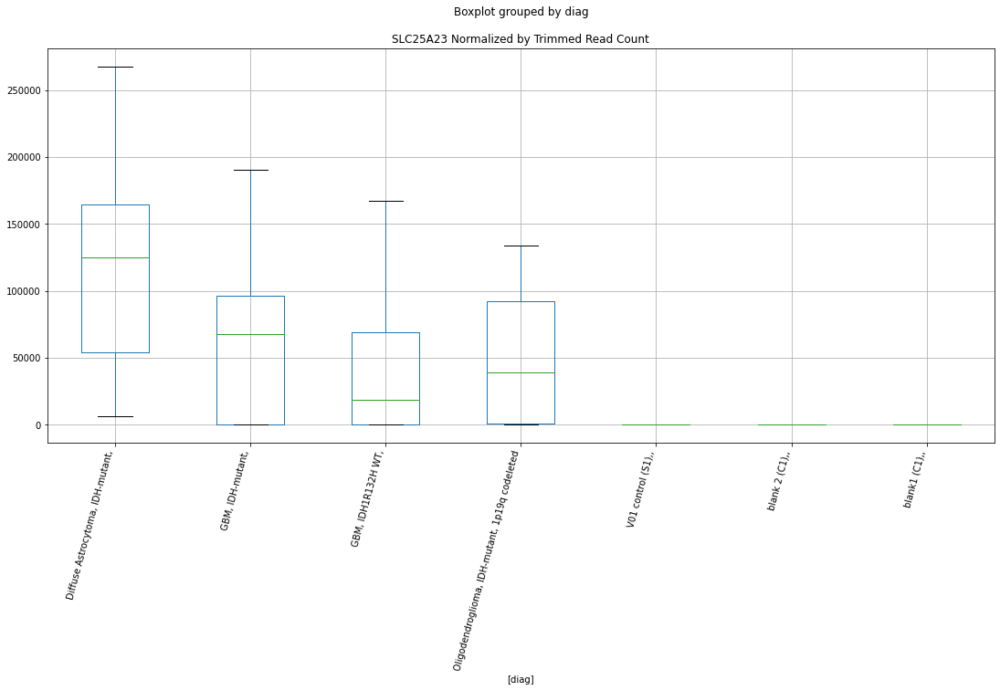

 p : 0.036261353048444814  ( t : 2.262646363301296 ) :  Lexogen  :  cutadapt2  :  PNPLA6
Control and blanks
82          0.00
346    155721.55
Name: PNPLA6, dtype: float64
214    0.0
Name: PNPLA6, dtype: float64
478    0.0
Name: PNPLA6, dtype: float64


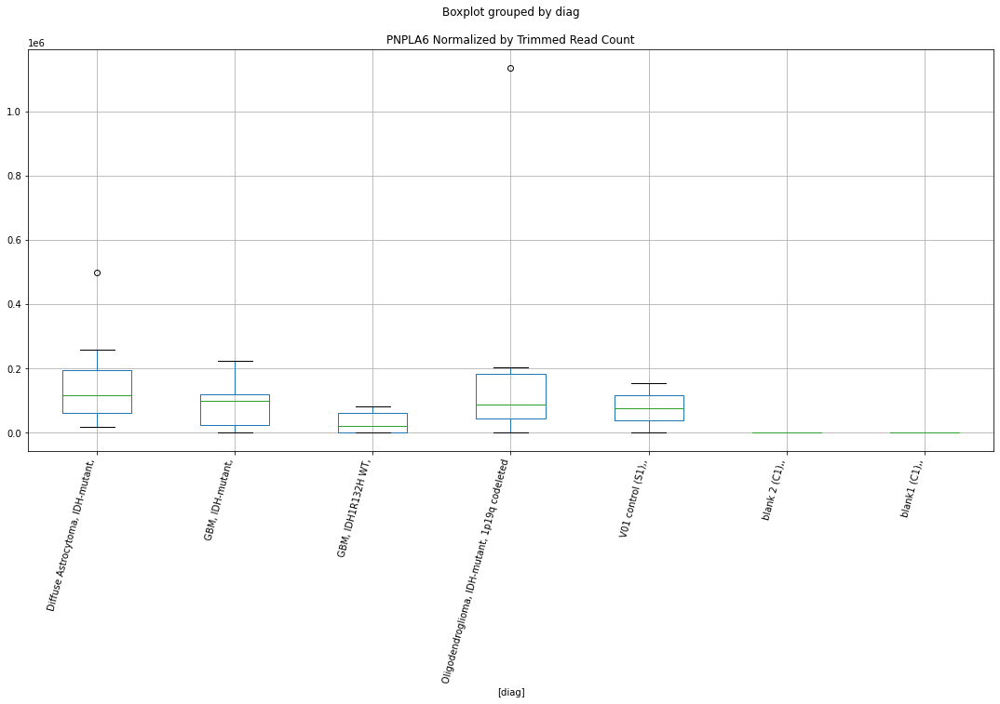

 p : 0.03627057525168555  ( t : 2.2625200087245565 ) :  D-plex  :  cutadapt2  :  PHLDB3
Control and blanks
76     0.0
340    0.0
Name: PHLDB3, dtype: float64
208    1234.52
Name: PHLDB3, dtype: float64
472    5779.56
Name: PHLDB3, dtype: float64


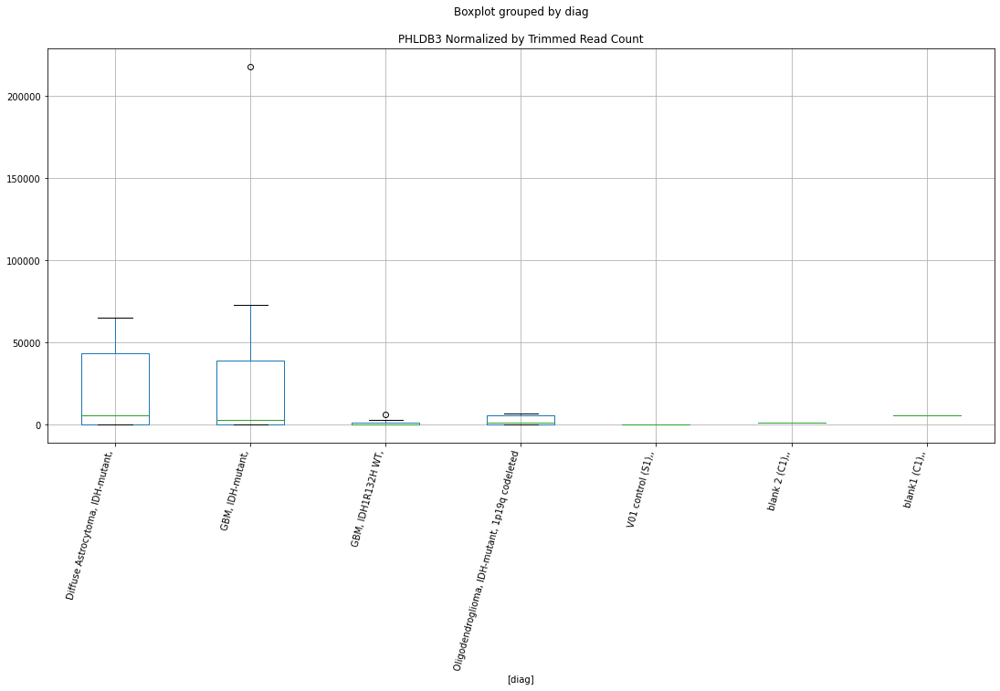

 p : 0.03634423940107833  ( t : 2.2615117909868516 ) :  D-plex  :  cutadapt2  :  PDPN
Control and blanks
76        0.00
340    7926.59
Name: PDPN, dtype: float64
208    448660.39
Name: PDPN, dtype: float64
472    26585.97
Name: PDPN, dtype: float64


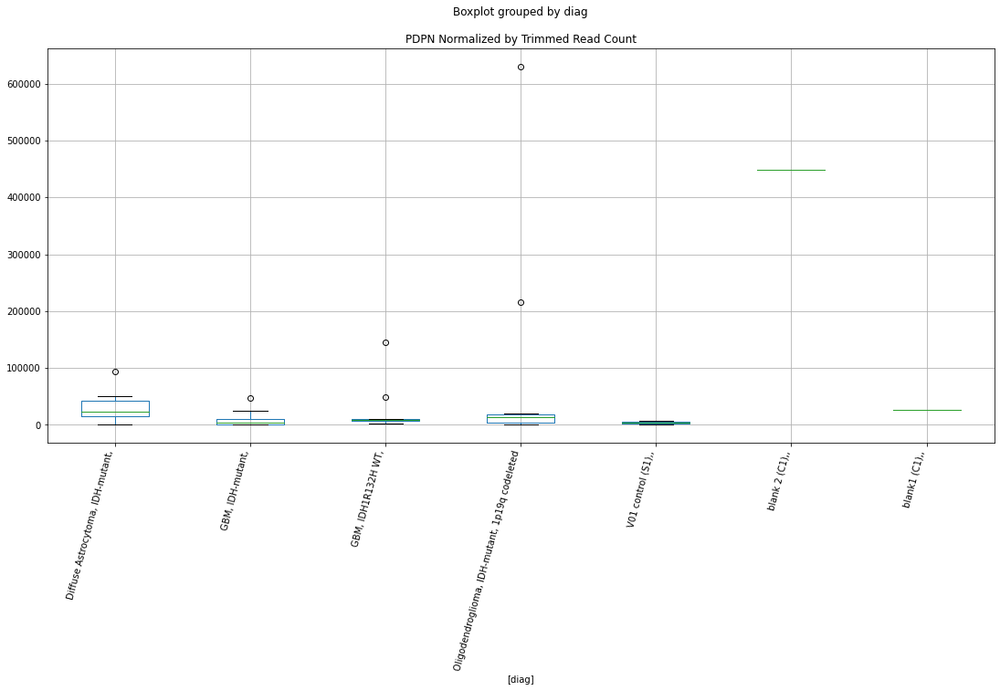

 p : 0.03637410983212602  ( t : 2.2611035018051364 ) :  Lexogen  :  bbduk2  :  POU6F2
Control and blanks
79     0.0
343    0.0
Name: POU6F2, dtype: float64
211    0.0
Name: POU6F2, dtype: float64
475    0.0
Name: POU6F2, dtype: float64


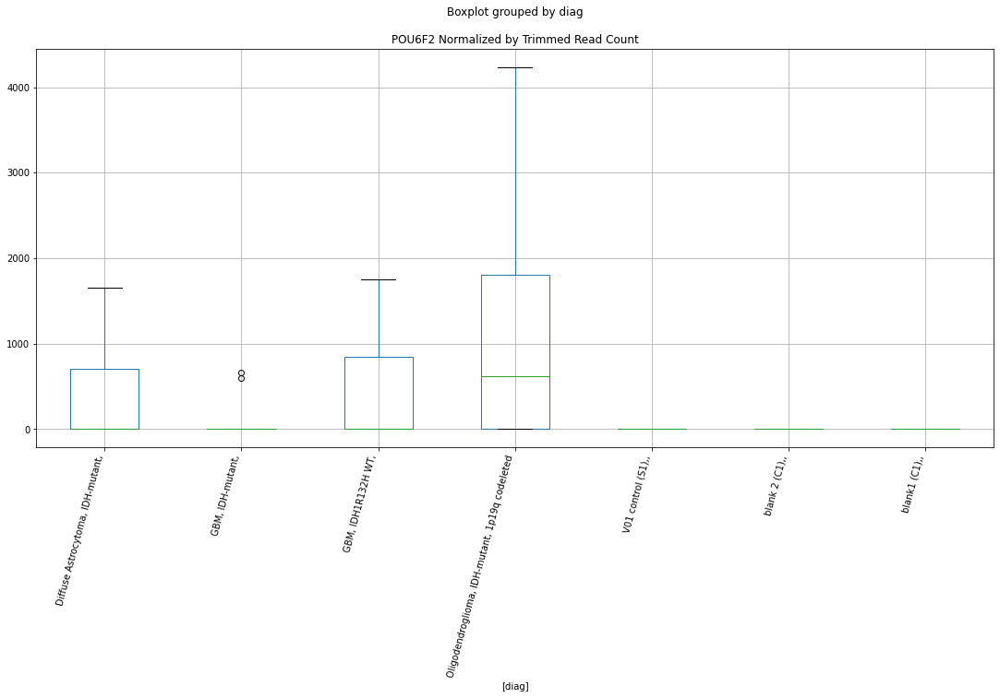

 p : 0.036432596810160485  ( t : 2.260304958557182 ) :  Lexogen  :  bbduk2  :  SNRNP200
Control and blanks
79     0.0
343    0.0
Name: SNRNP200, dtype: float64
211    11752.17
Name: SNRNP200, dtype: float64
475    5508.86
Name: SNRNP200, dtype: float64


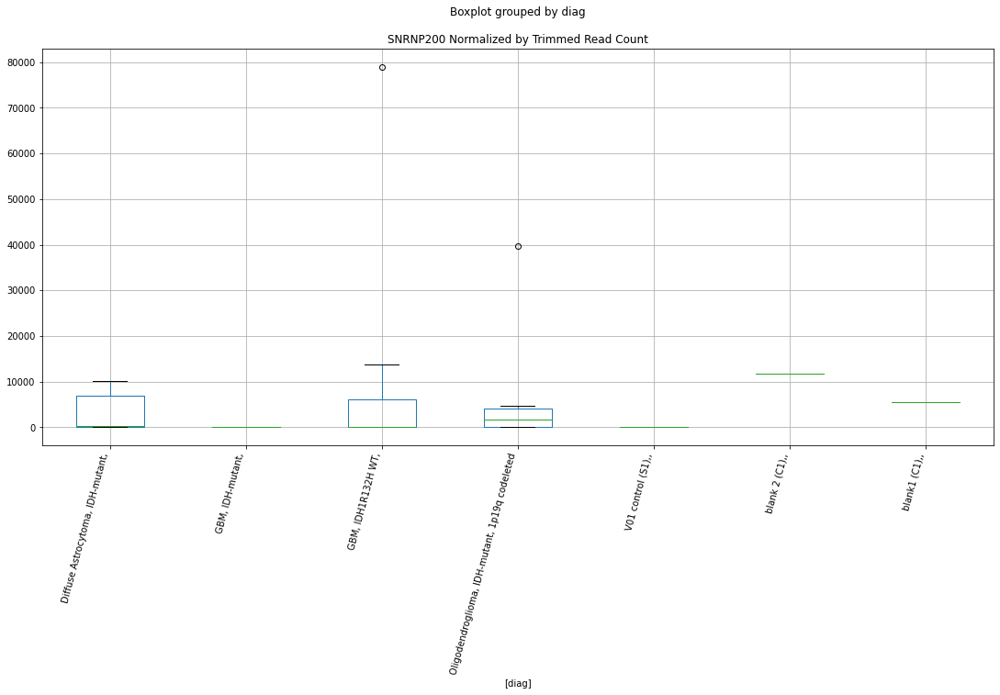

 p : 0.03644714665314425  ( t : 2.2601064883871276 ) :  Lexogen  :  cutadapt2  :  PPM1L
Control and blanks
82        0.00
346    1683.48
Name: PPM1L, dtype: float64
214    0.0
Name: PPM1L, dtype: float64
478    0.0
Name: PPM1L, dtype: float64


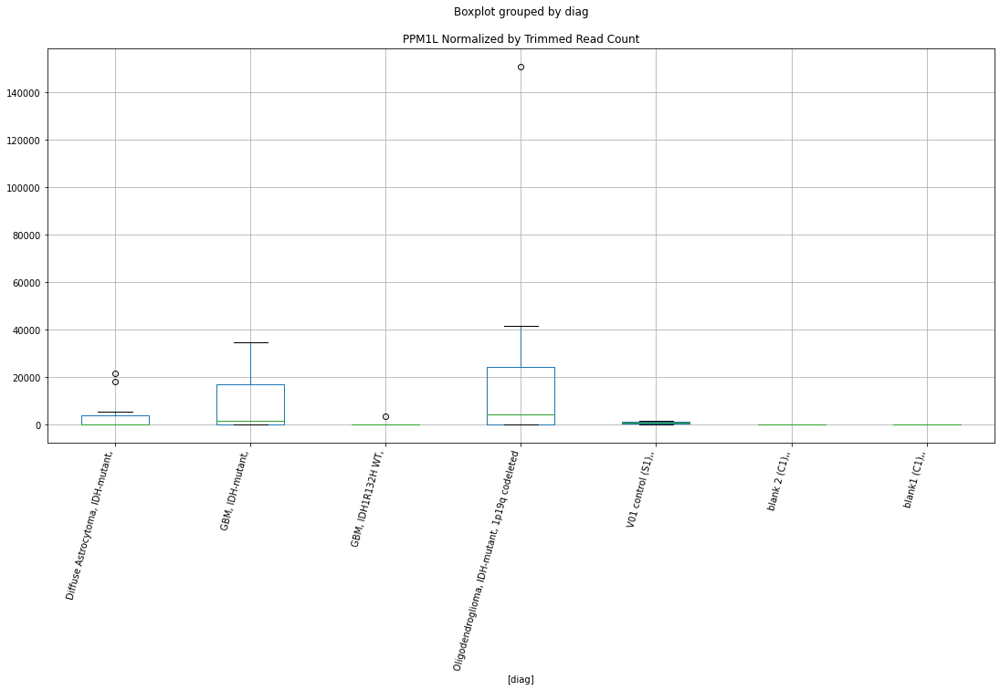

 p : 0.03646042960257041  ( t : 2.259925363437583 ) :  Lexogen  :  cutadapt2  :  SNRNP200
Control and blanks
82     0.0
346    0.0
Name: SNRNP200, dtype: float64
214    11662.74
Name: SNRNP200, dtype: float64
478    5461.59
Name: SNRNP200, dtype: float64


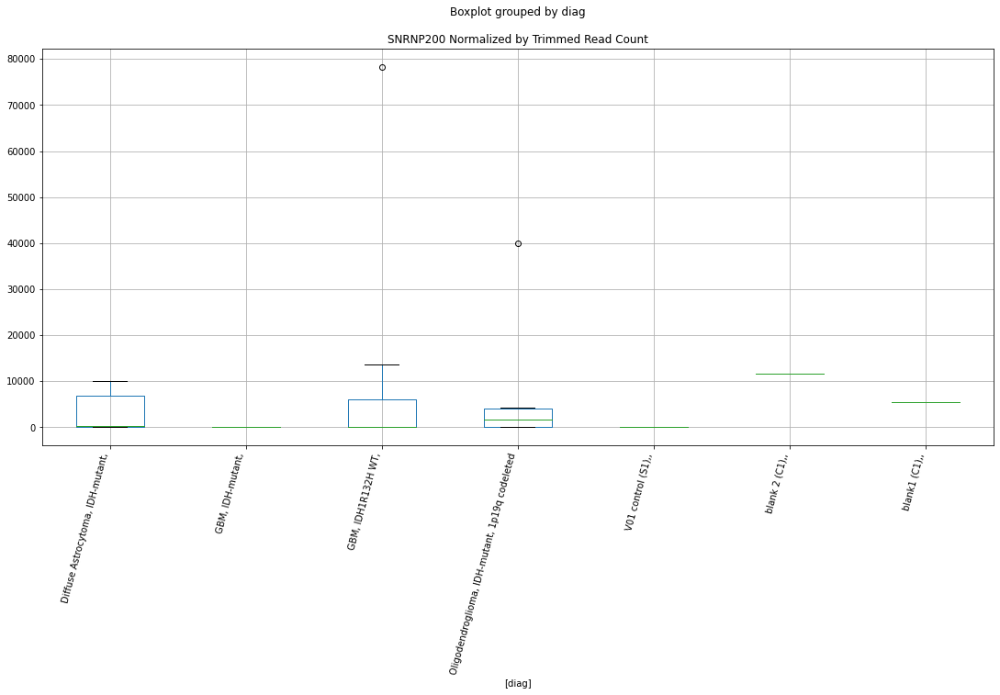

 p : 0.03652704041536986  ( t : 2.259017983345866 ) :  D-plex  :  cutadapt2  :  POLI
Control and blanks
76     0.0
340    0.0
Name: POLI, dtype: float64
208    9170.73
Name: POLI, dtype: float64
472    0.0
Name: POLI, dtype: float64


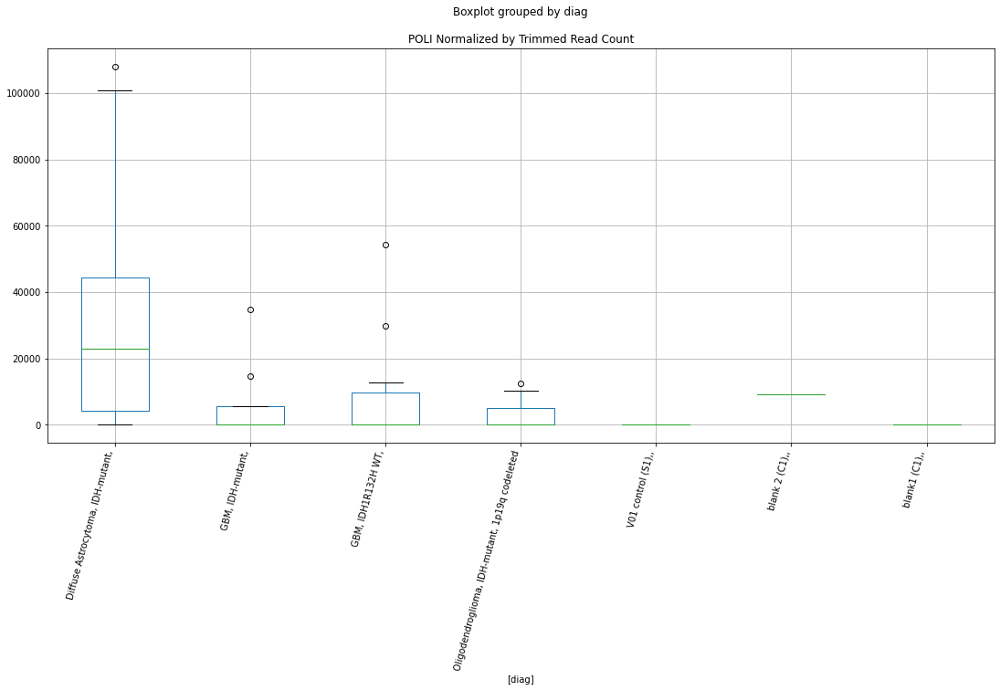

 p : 0.036527421046083516  ( t : 2.259012802743942 ) :  D-plex  :  bbduk2  :  PDPN
Control and blanks
73        0.0
337    6231.1
Name: PDPN, dtype: float64
205    450592.84
Name: PDPN, dtype: float64
469    26027.2
Name: PDPN, dtype: float64


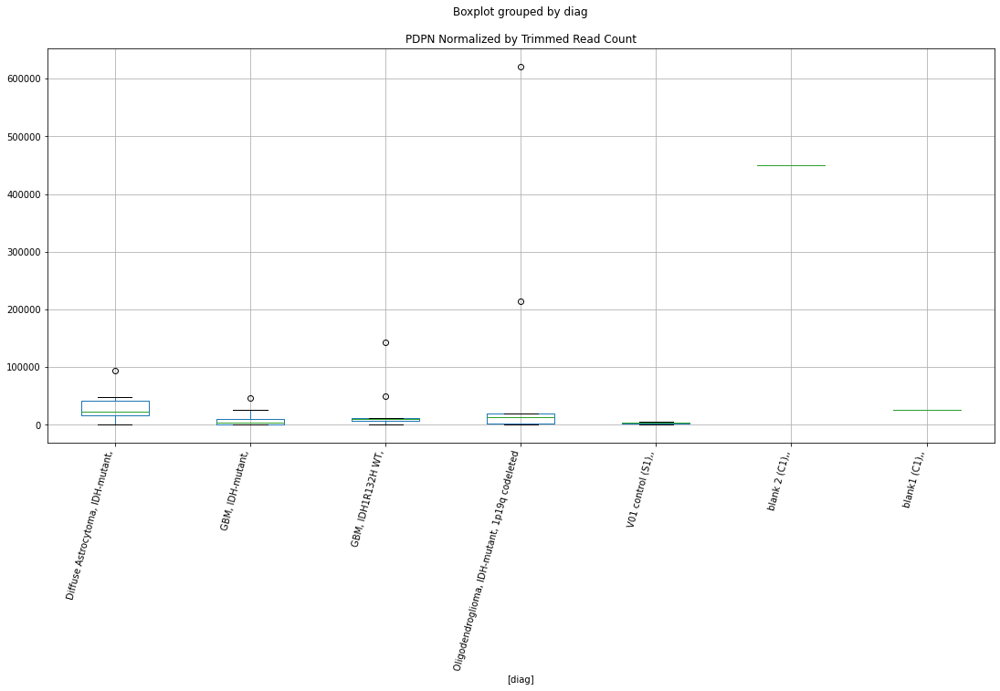

 p : 0.036537530013051364  ( t : 2.2588752321596757 ) :  D-plex  :  cutadapt2  :  POLQ
Control and blanks
76     0.0
340    0.0
Name: POLQ, dtype: float64
208    352.72
Name: POLQ, dtype: float64
472    0.0
Name: POLQ, dtype: float64


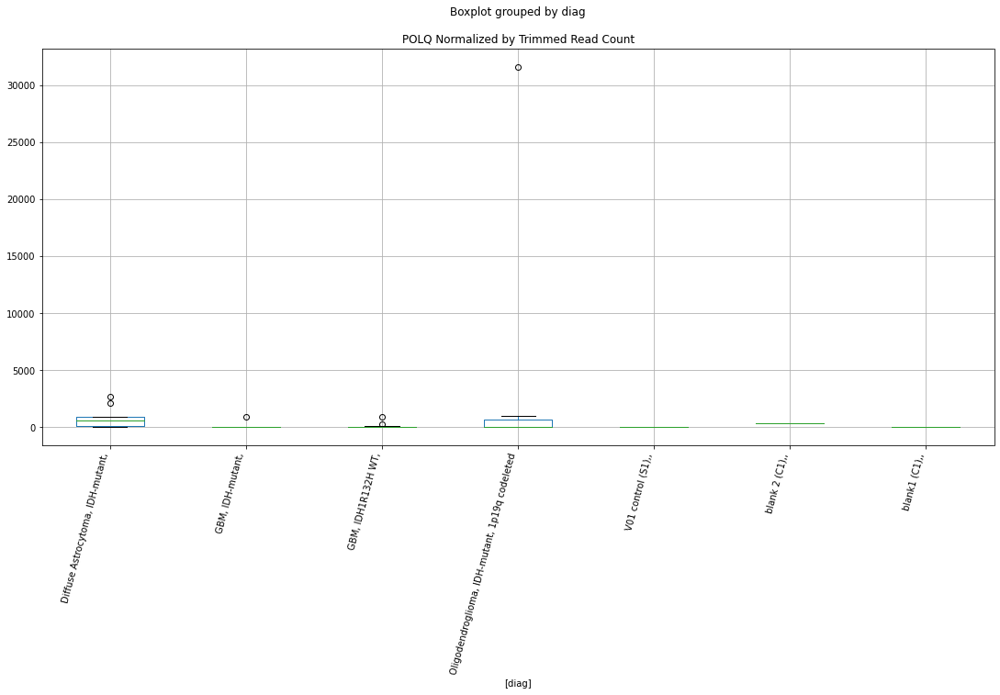

 p : 0.03663677717996692  ( t : 2.2575264640955996 ) :  Lexogen  :  bbduk2  :  PACRG
Control and blanks
79       0.00
343    424.63
Name: PACRG, dtype: float64
211    273.31
Name: PACRG, dtype: float64
475    479.03
Name: PACRG, dtype: float64


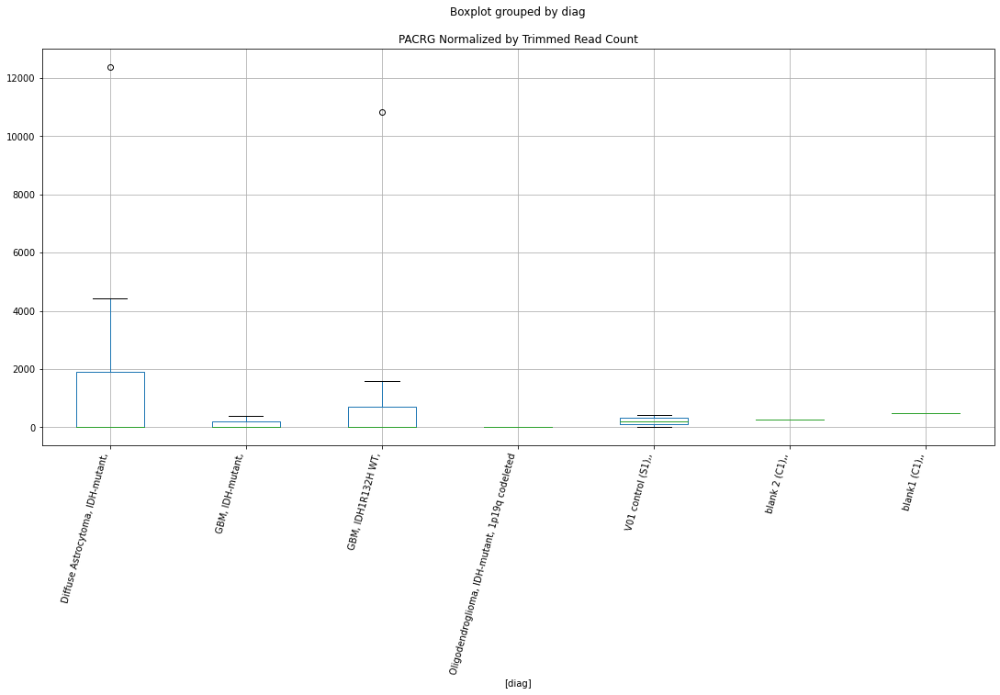

 p : 0.03664832239575389  ( t : 2.2573697838799713 ) :  Lexogen  :  cutadapt2  :  POLE4
Control and blanks
82     0.0
346    0.0
Name: POLE4, dtype: float64
214    0.0
Name: POLE4, dtype: float64
478    0.0
Name: POLE4, dtype: float64


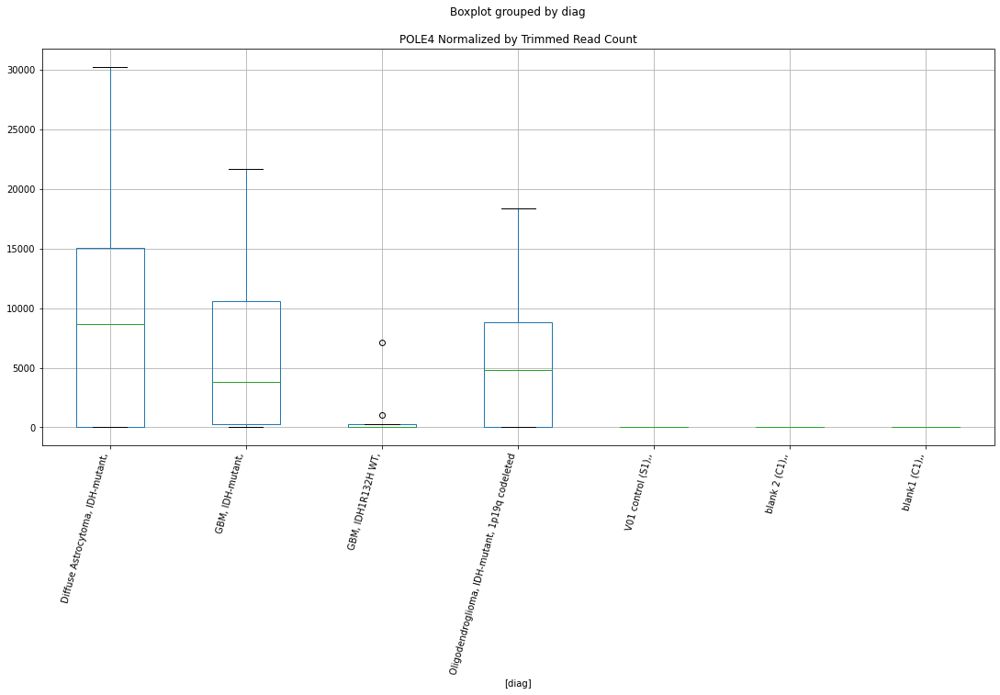

 p : 0.036650310325401954  ( t : 2.25734281027094 ) :  D-plex  :  bbduk2  :  RBM26
Control and blanks
73     30147.33
337        0.00
Name: RBM26, dtype: float64
205    80053.66
Name: RBM26, dtype: float64
469    26027.2
Name: RBM26, dtype: float64


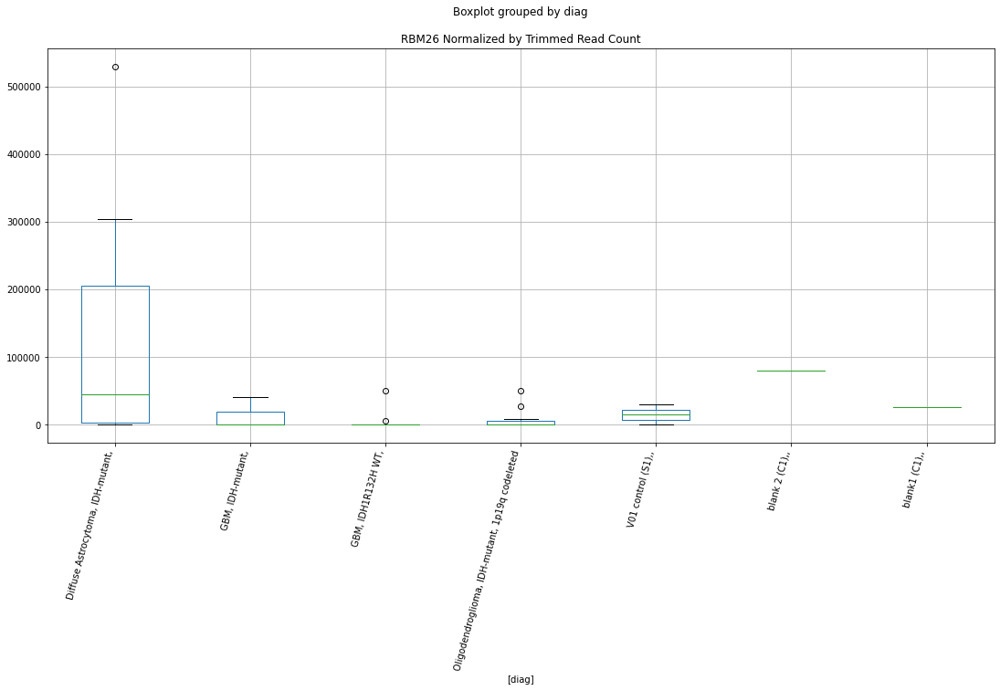

 p : 0.036686087858393834  ( t : 2.256857586702812 ) :  D-plex  :  bbduk2  :  QPCTL
Control and blanks
73     0.0
337    0.0
Name: QPCTL, dtype: float64
205    0.0
Name: QPCTL, dtype: float64
469    0.0
Name: QPCTL, dtype: float64


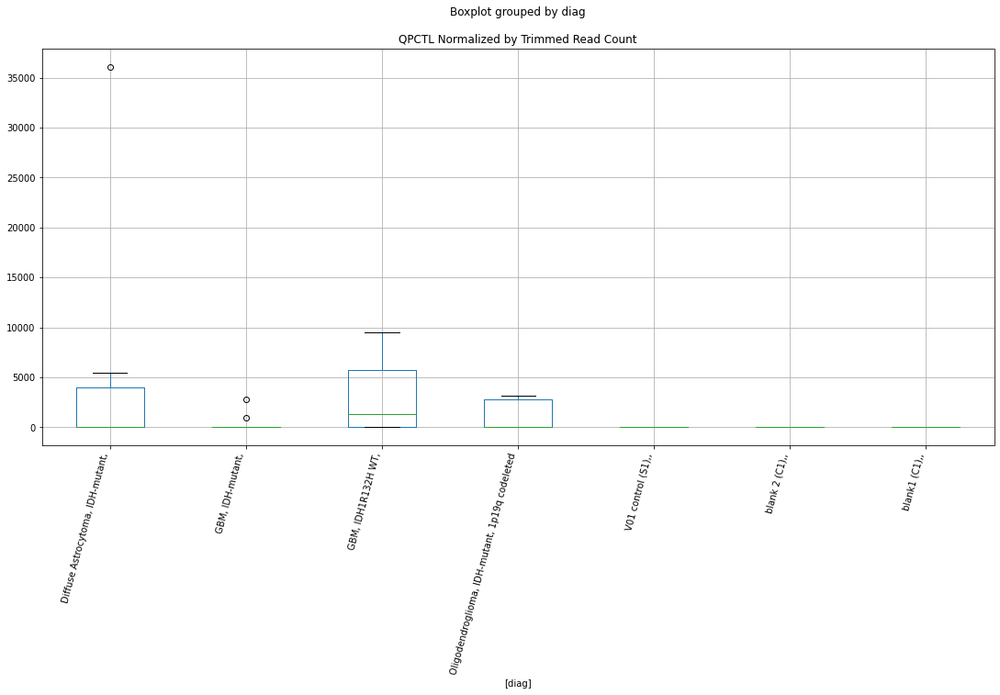

 p : 0.03669603005267497  ( t : 2.256722825844539 ) :  Lexogen  :  cutadapt2  :  SMOC2
Control and blanks
82       0.00
346    841.74
Name: SMOC2, dtype: float64
214    19528.3
Name: SMOC2, dtype: float64
478    0.0
Name: SMOC2, dtype: float64


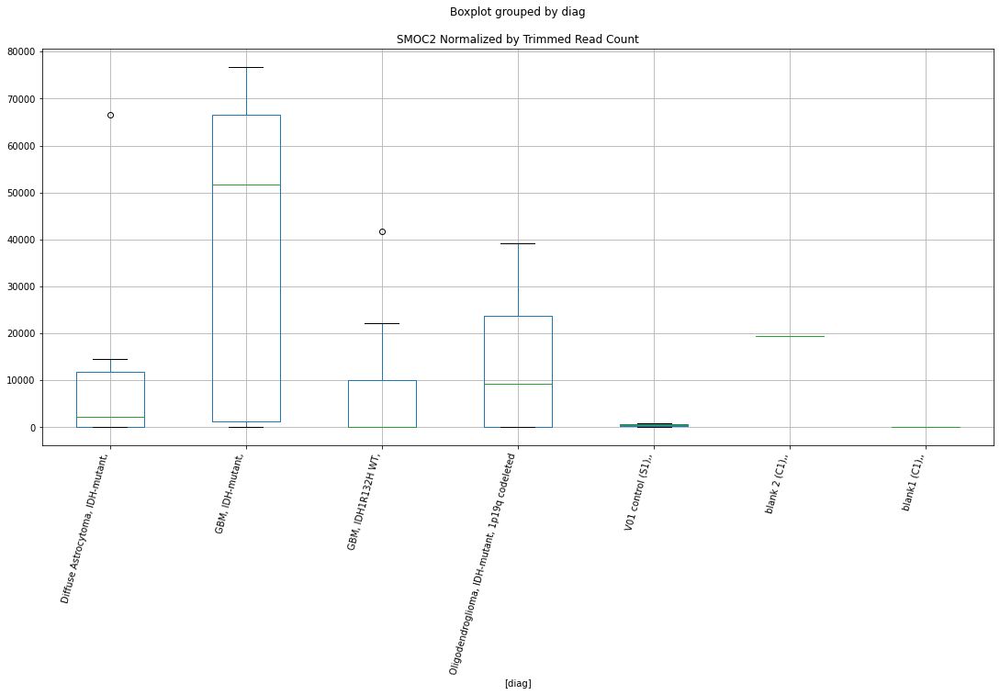

 p : 0.03670185405075141  ( t : 2.2566439004811936 ) :  D-plex  :  bbduk2  :  POU3F1
Control and blanks
73     0.0
337    0.0
Name: POU3F1, dtype: float64
205    358.18
Name: POU3F1, dtype: float64
469    591.53
Name: POU3F1, dtype: float64


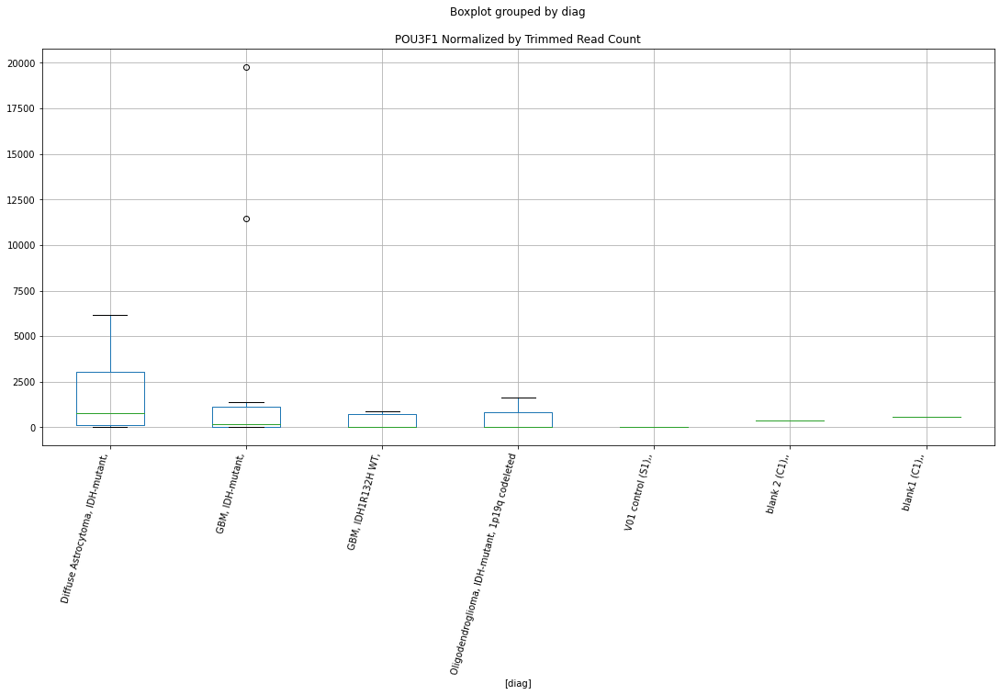

 p : 0.036723774632597746  ( t : 2.256346941891066 ) :  D-plex  :  cutadapt2  :  SETDB1
Control and blanks
76     0.0
340    0.0
Name: SETDB1, dtype: float64
208    14461.54
Name: SETDB1, dtype: float64
472    24274.15
Name: SETDB1, dtype: float64


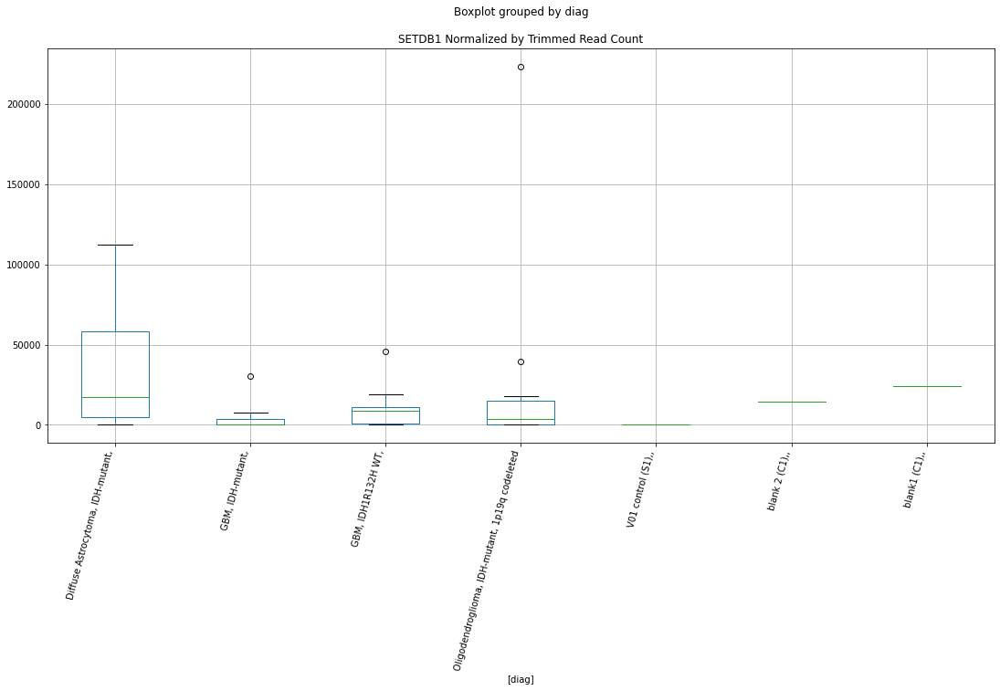

 p : 0.03677858015843698  ( t : 2.255605205821805 ) :  D-plex  :  cutadapt2  :  QPCTL
Control and blanks
76     0.0
340    0.0
Name: QPCTL, dtype: float64
208    0.0
Name: QPCTL, dtype: float64
472    0.0
Name: QPCTL, dtype: float64


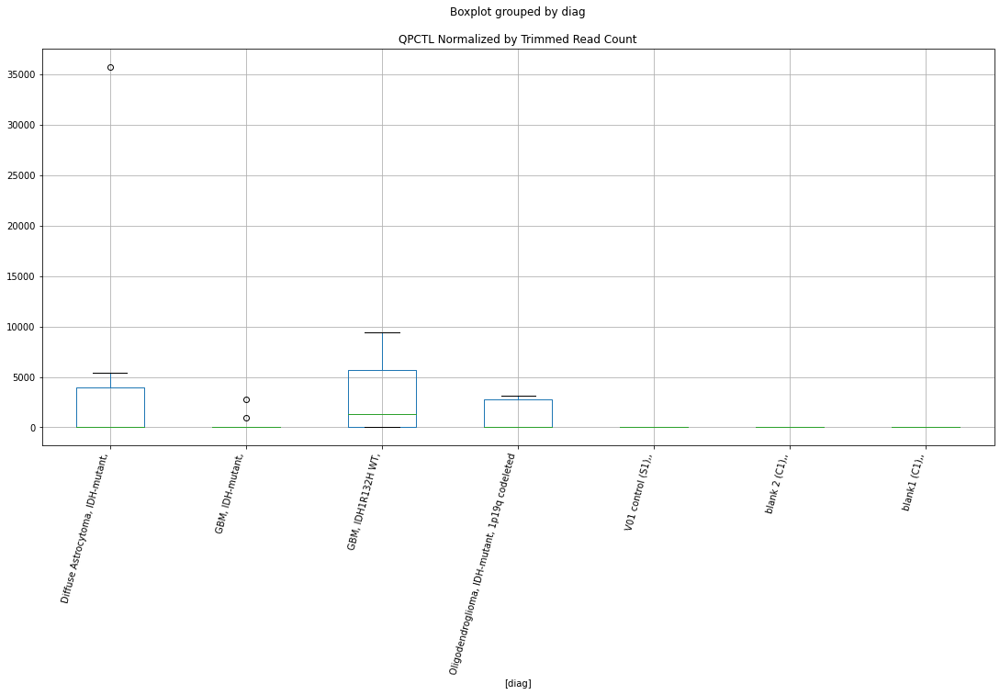

 p : 0.036838355364993025  ( t : 2.2547973729251725 ) :  Lexogen  :  bbduk2  :  POLE4
Control and blanks
79     0.0
343    0.0
Name: POLE4, dtype: float64
211    0.0
Name: POLE4, dtype: float64
475    0.0
Name: POLE4, dtype: float64


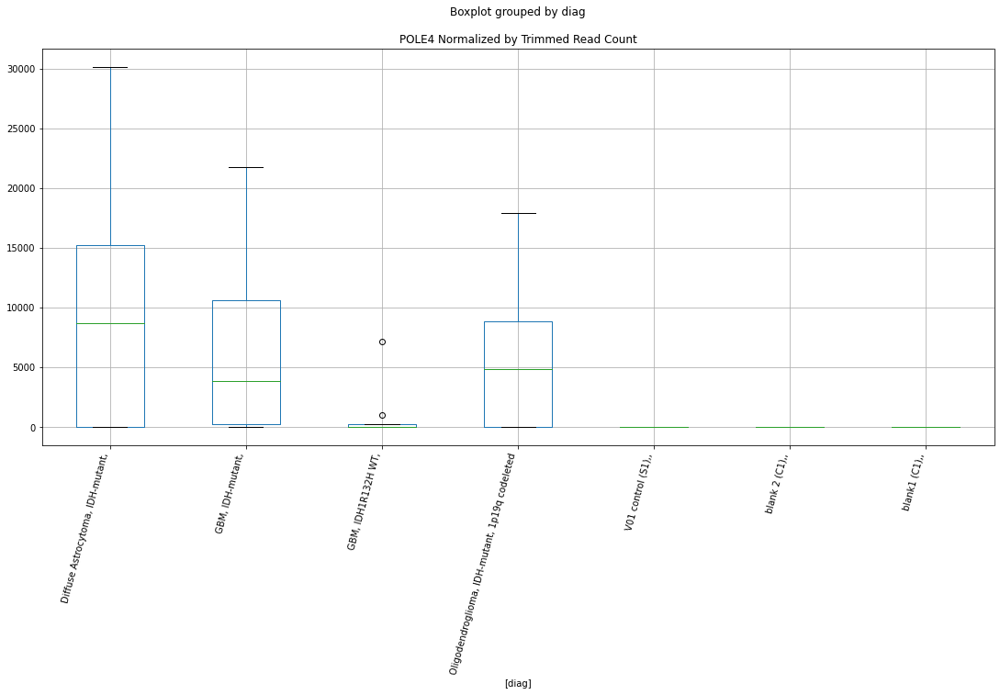

 p : 0.03690653847597146  ( t : 2.25387738749402 ) :  D-plex  :  bbduk2  :  PNISR
Control and blanks
73     2319.03
337       0.00
Name: PNISR, dtype: float64
205    1611.82
Name: PNISR, dtype: float64
469    1774.58
Name: PNISR, dtype: float64


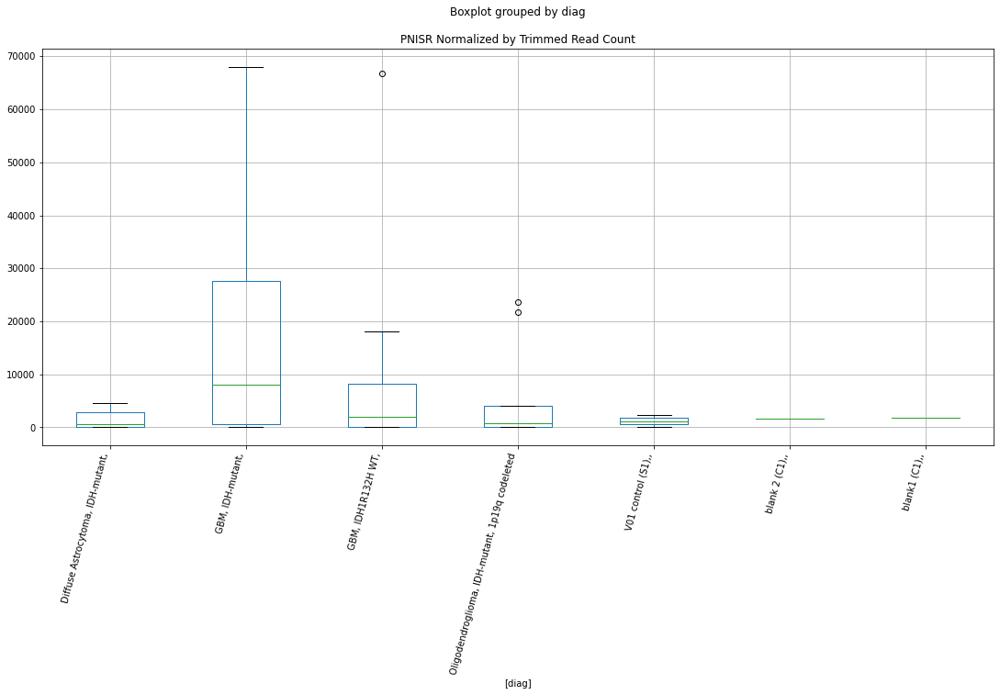

 p : 0.036954753811633496  ( t : 2.253227771150105 ) :  D-plex  :  bbduk2  :  RMND5A
Control and blanks
73         0.00
337    17803.15
Name: RMND5A, dtype: float64
205    1074.55
Name: RMND5A, dtype: float64
469    591.53
Name: RMND5A, dtype: float64


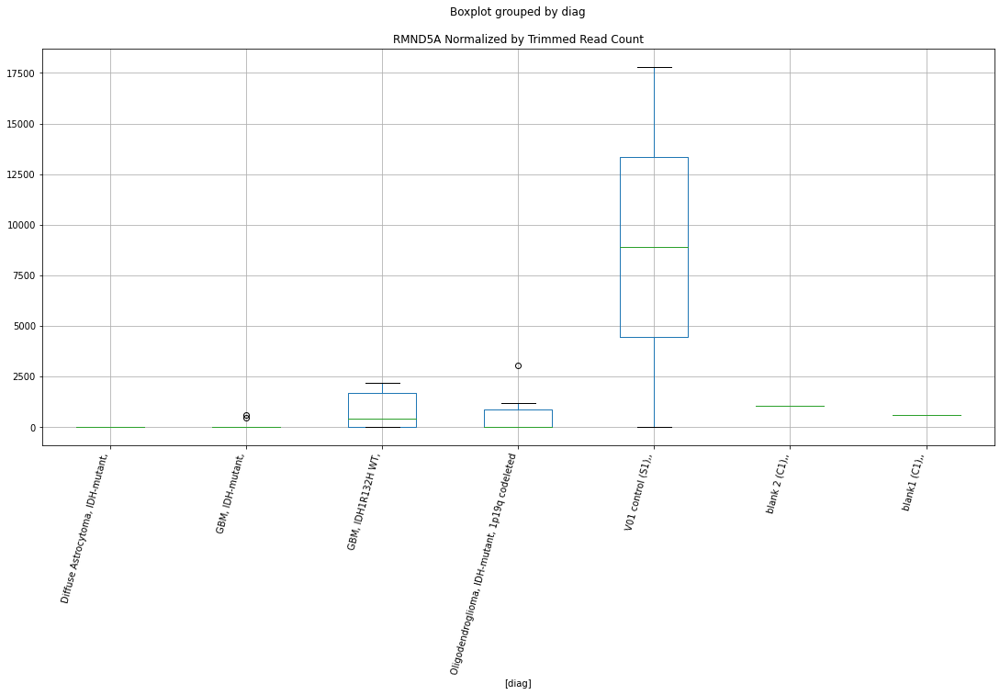

 p : 0.036967299279923  ( t : 2.2530588714394884 ) :  D-plex  :  cutadapt2  :  PRR16
Control and blanks
76     0.0
340    0.0
Name: PRR16, dtype: float64
208    1058.16
Name: PRR16, dtype: float64
472    2889.78
Name: PRR16, dtype: float64


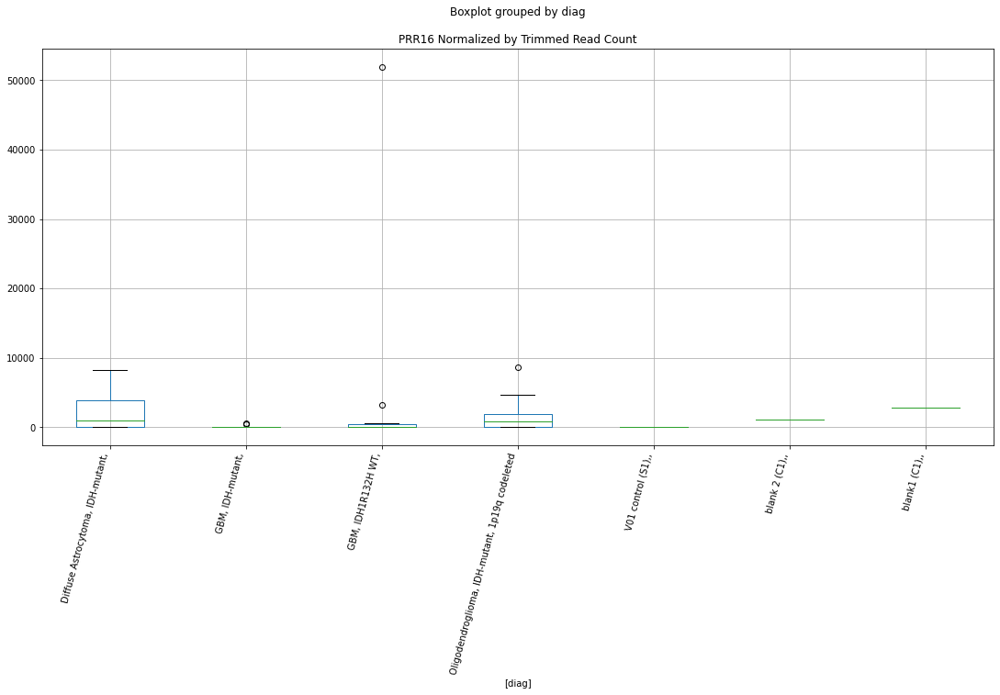

 p : 0.036983821850661645  ( t : 2.252836508688645 ) :  Lexogen  :  cutadapt2  :  POLE4
Control and blanks
82     0.0
346    0.0
Name: POLE4, dtype: float64
214    0.0
Name: POLE4, dtype: float64
478    0.0
Name: POLE4, dtype: float64


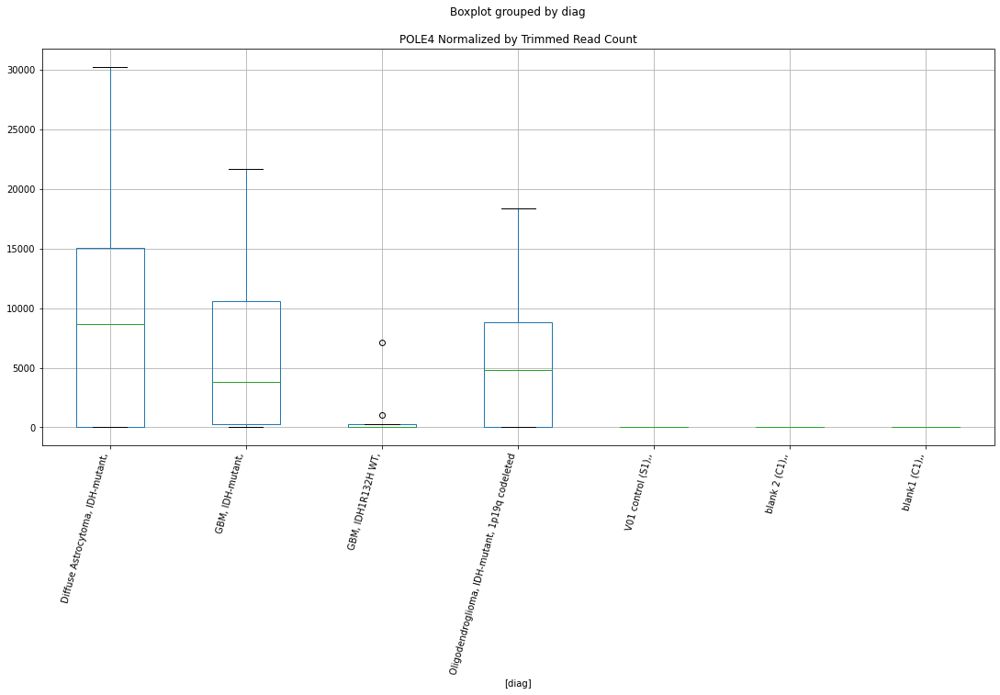

 p : 0.0371012473453106  ( t : 2.2512588186529716 ) :  D-plex  :  cutadapt2  :  PDGFB
Control and blanks
76         0.00
340    26421.96
Name: PDGFB, dtype: float64
208    1939.96
Name: PDGFB, dtype: float64
472    577.96
Name: PDGFB, dtype: float64


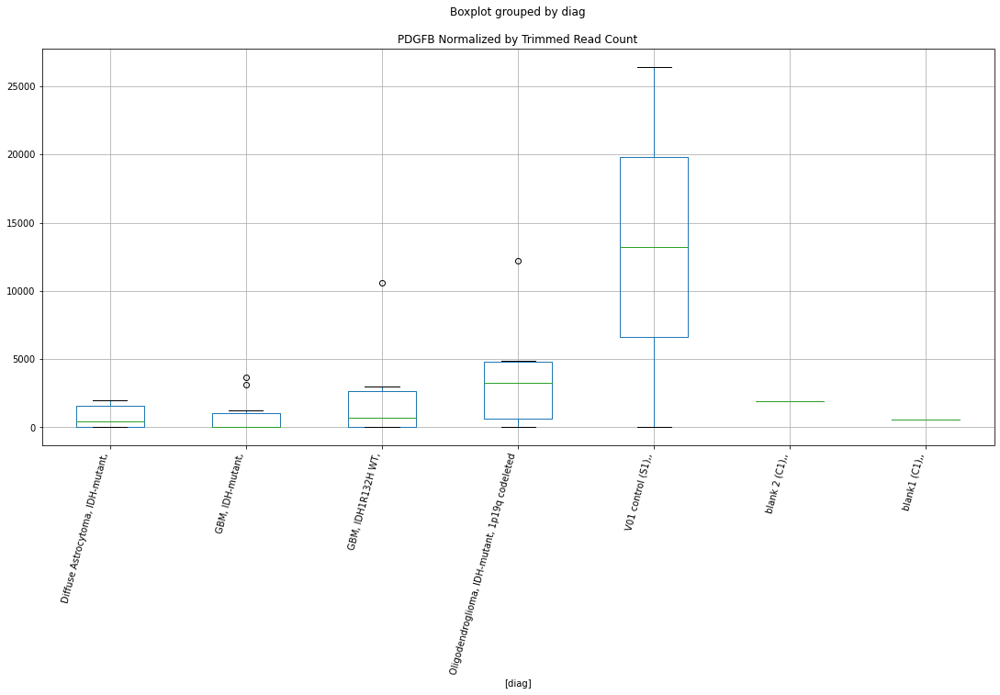

 p : 0.0371596048330233  ( t : 2.2504764603993905 ) :  Lexogen  :  cutadapt2  :  SORBS2
Control and blanks
82     0.0
346    0.0
Name: SORBS2, dtype: float64
214    0.0
Name: SORBS2, dtype: float64
478    0.0
Name: SORBS2, dtype: float64


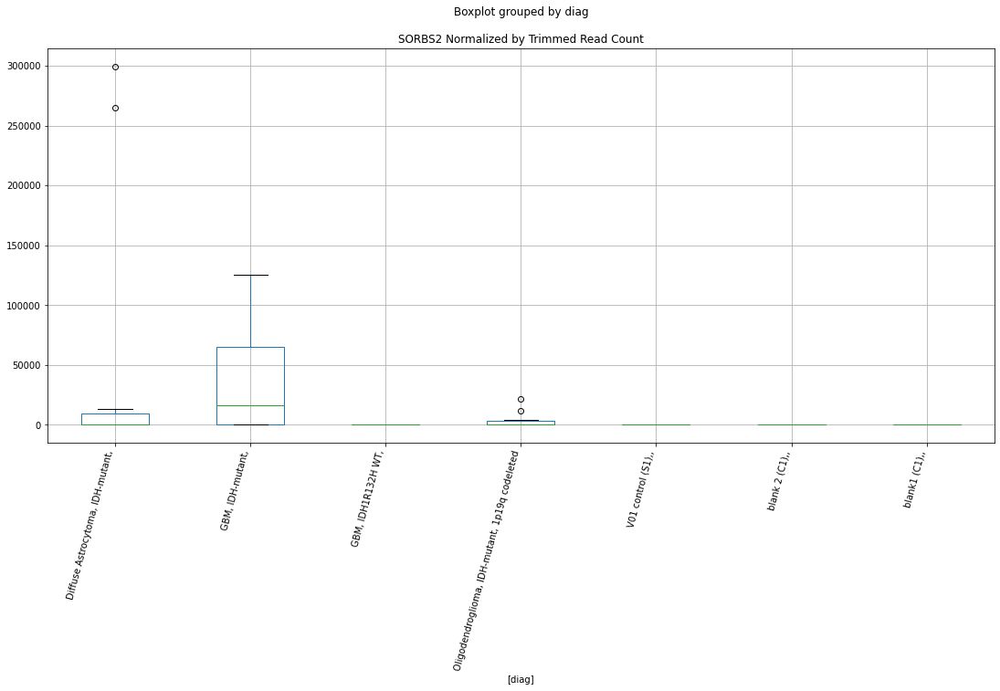

 p : 0.03718456572710217  ( t : 2.2501421732274838 ) :  Lexogen  :  cutadapt2  :  RABGAP1
Control and blanks
82     0.0
346    0.0
Name: RABGAP1, dtype: float64
214    0.0
Name: RABGAP1, dtype: float64
478    0.0
Name: RABGAP1, dtype: float64


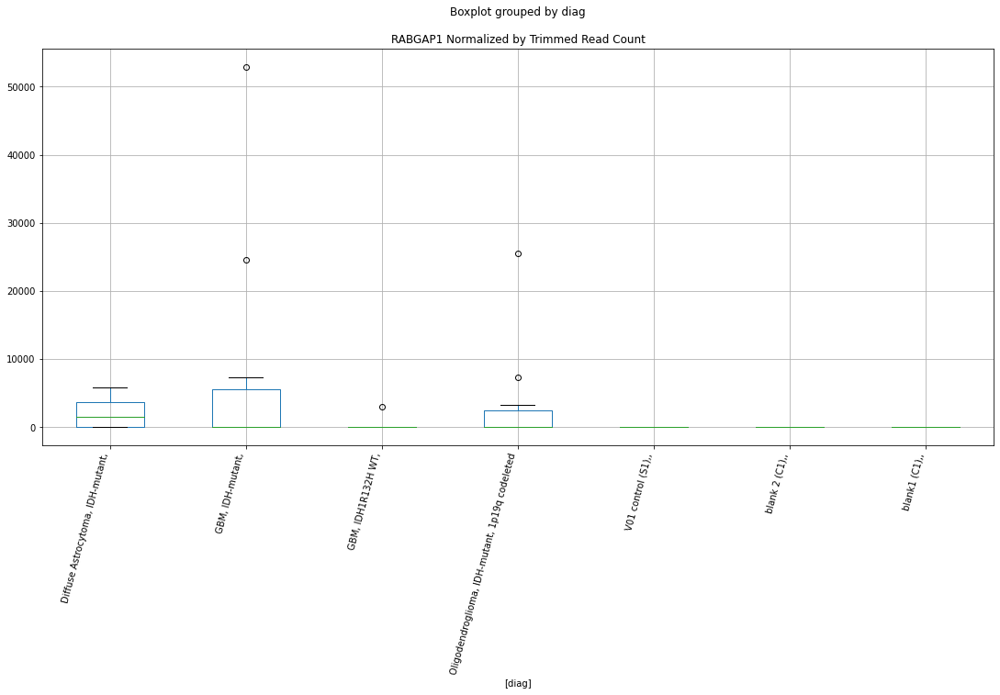

 p : 0.03718968299415156  ( t : 2.2500736661373284 ) :  D-plex  :  bbduk2  :  RNF165
Control and blanks
73        0.00
337    9791.73
Name: RNF165, dtype: float64
205    20774.55
Name: RNF165, dtype: float64
469    20703.46
Name: RNF165, dtype: float64


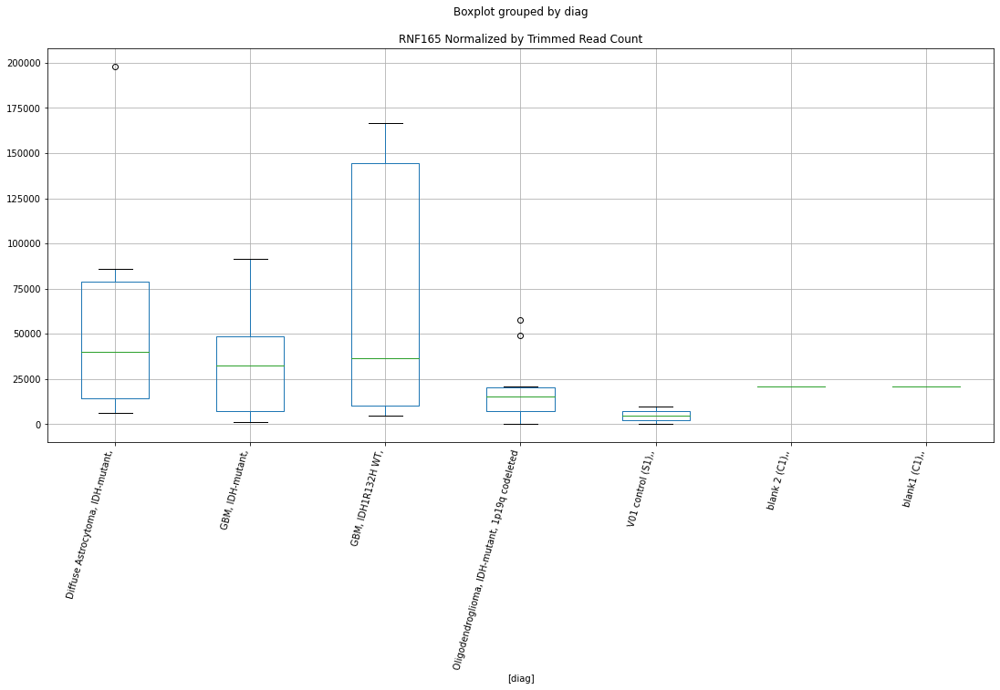

 p : 0.037254030945765806  ( t : 2.2492129536345025 ) :  Lexogen  :  bbduk2  :  RPE65
Control and blanks
79     0.0
343    0.0
Name: RPE65, dtype: float64
211    0.0
Name: RPE65, dtype: float64
475    0.0
Name: RPE65, dtype: float64


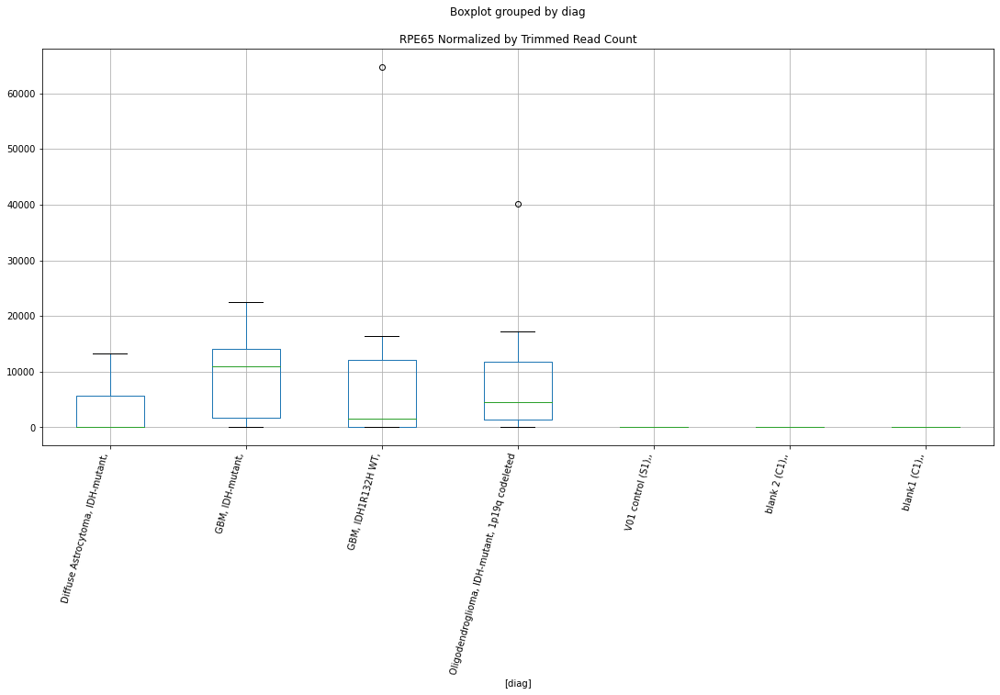

 p : 0.03729670005319036  ( t : 2.2486429715706695 ) :  D-plex  :  cutadapt2  :  RNA45SN3
Control and blanks
76     4.23e+06
340    2.61e+06
Name: RNA45SN3, dtype: float64
208    2.51e+06
Name: RNA45SN3, dtype: float64
472    2.60e+06
Name: RNA45SN3, dtype: float64


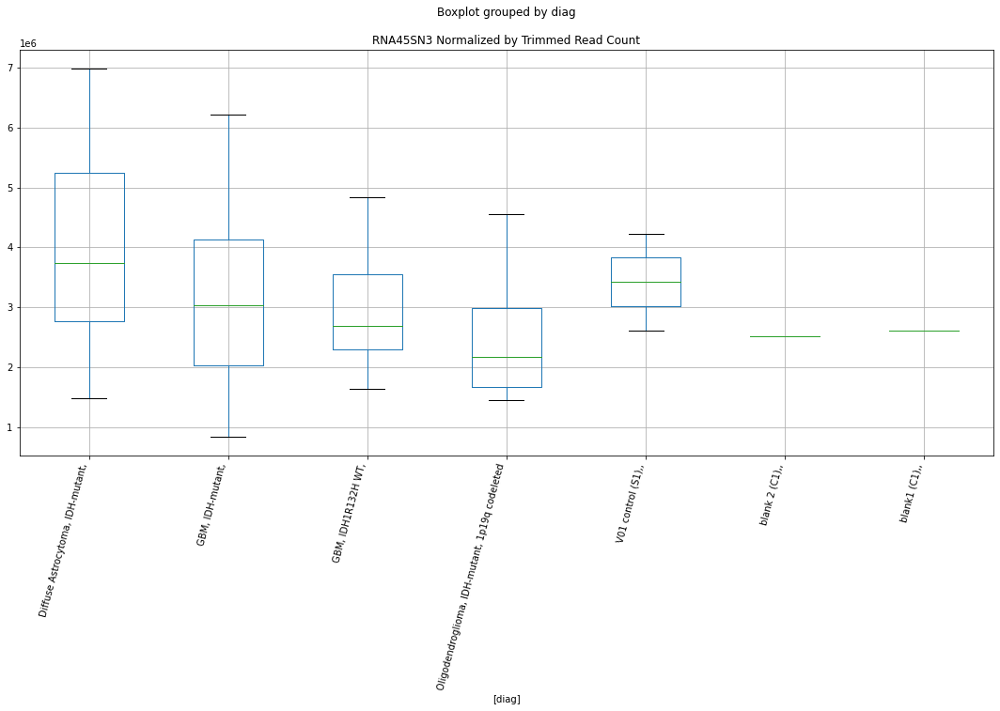

 p : 0.037355435802416924  ( t : 2.2478593516408374 ) :  D-plex  :  bbduk2  :  RNA45SN2
Control and blanks
73     4.38e+06
337    2.71e+06
Name: RNA45SN2, dtype: float64
205    2.58e+06
Name: RNA45SN2, dtype: float64
469    2.70e+06
Name: RNA45SN2, dtype: float64


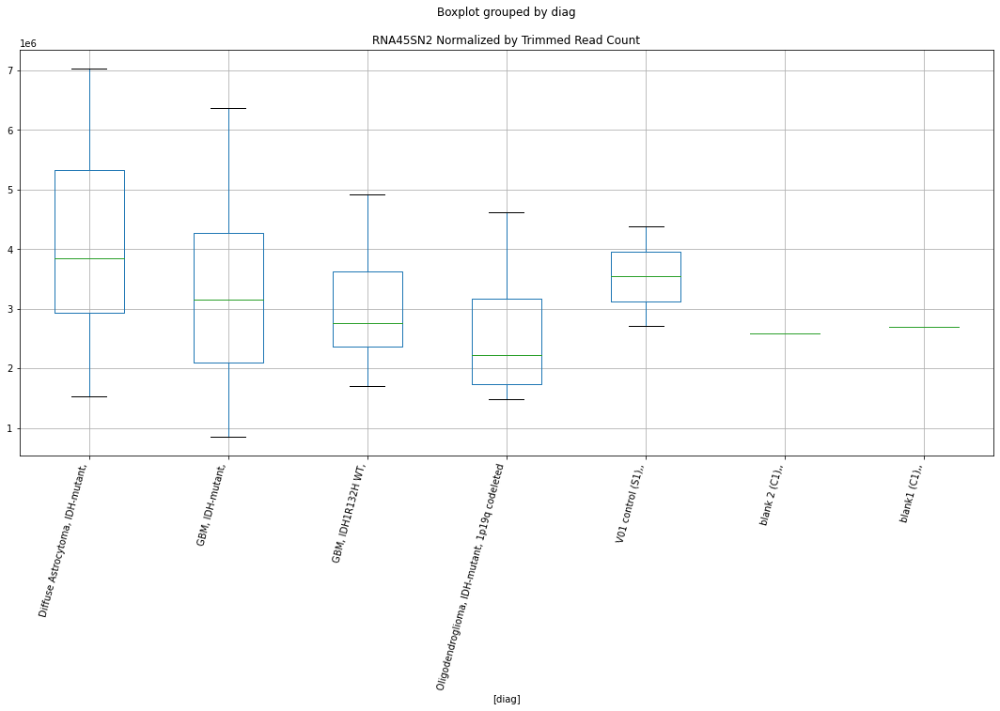

 p : 0.03736107946500267  ( t : 2.2477841168878356 ) :  D-plex  :  cutadapt2  :  PHF20
Control and blanks
76         0.00
340    17614.64
Name: PHF20, dtype: float64
208    5290.81
Name: PHF20, dtype: float64
472    11559.12
Name: PHF20, dtype: float64


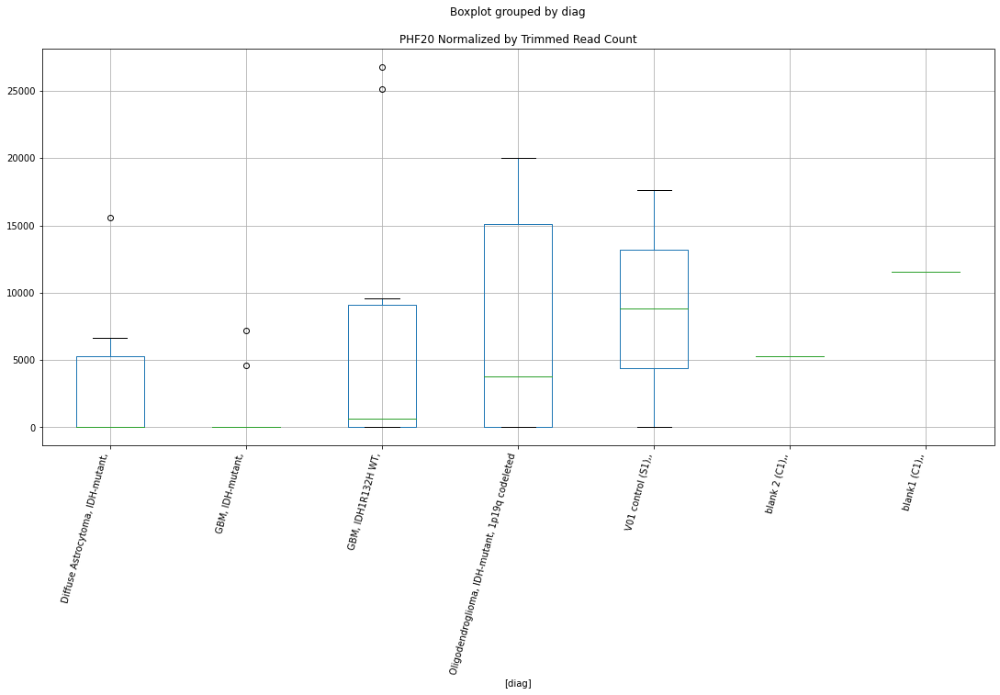

 p : 0.037510143467888925  ( t : 2.2458007549977714 ) :  Lexogen  :  cutadapt2  :  RORB
Control and blanks
82     0.0
346    0.0
Name: RORB, dtype: float64
214    0.0
Name: RORB, dtype: float64
478    0.0
Name: RORB, dtype: float64


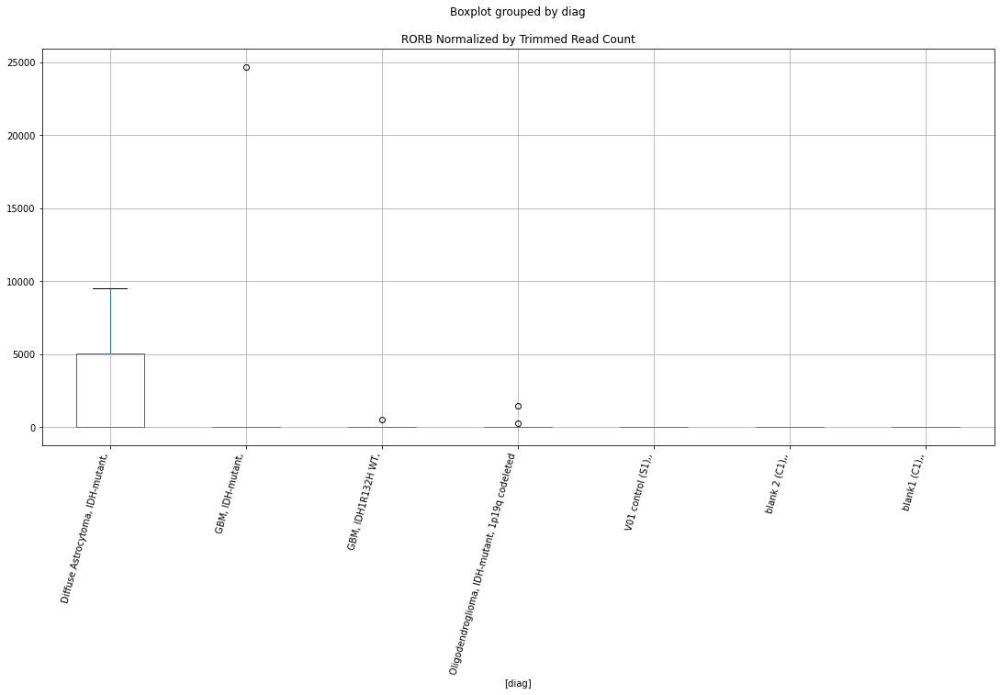

 p : 0.037519526420032374  ( t : 2.2456761540926857 ) :  Lexogen  :  bbduk2  :  SLC9A1
Control and blanks
79     0.0
343    0.0
Name: SLC9A1, dtype: float64
211    0.0
Name: SLC9A1, dtype: float64
475    958.06
Name: SLC9A1, dtype: float64


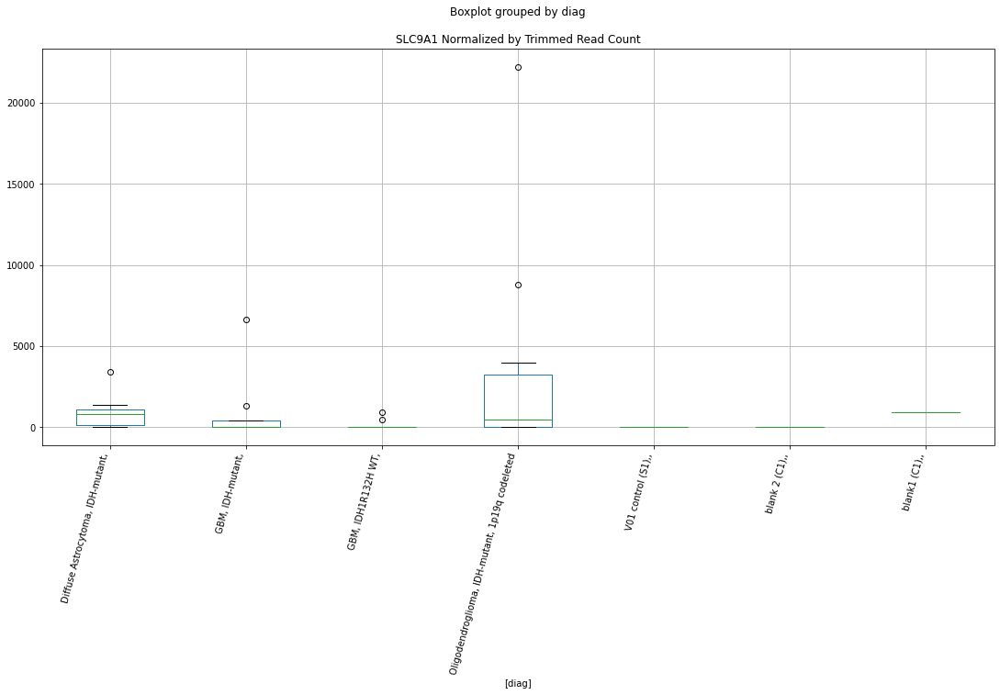

 p : 0.03756281600261793  ( t : 2.245101662083717 ) :  D-plex  :  bbduk2  :  RAB11FIP4
Control and blanks
73     0.0
337    0.0
Name: RAB11FIP4, dtype: float64
205    1611.82
Name: RAB11FIP4, dtype: float64
469    8872.91
Name: RAB11FIP4, dtype: float64


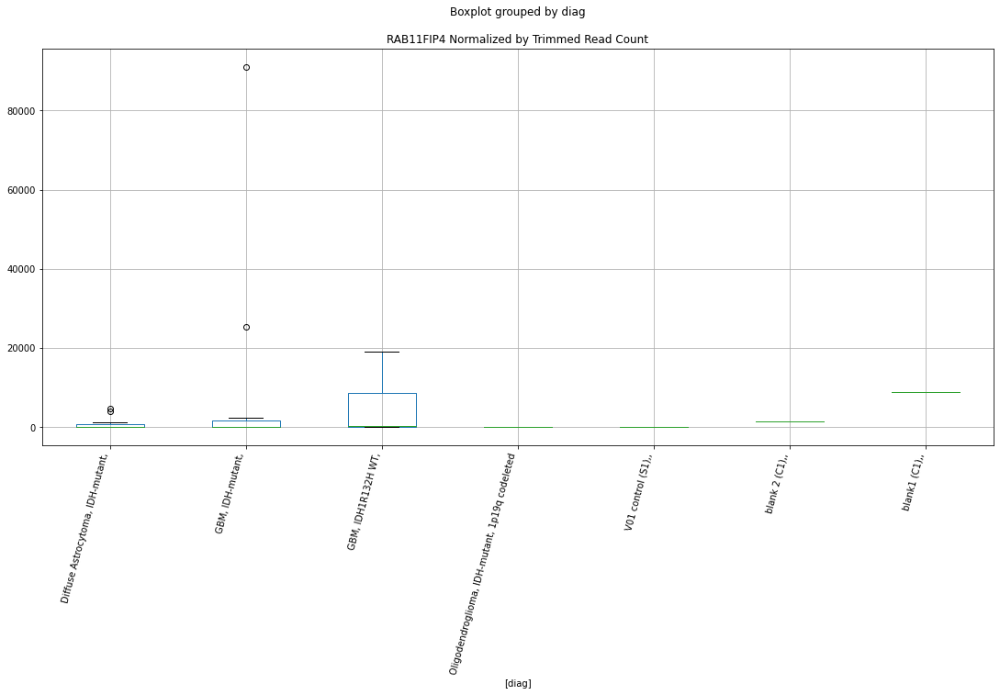

 p : 0.037639825221772685  ( t : 2.2440811877685096 ) :  D-plex  :  bbduk2  :  PHETA1
Control and blanks
73     0.0
337    0.0
Name: PHETA1, dtype: float64
205    4298.18
Name: PHETA1, dtype: float64
469    14788.18
Name: PHETA1, dtype: float64


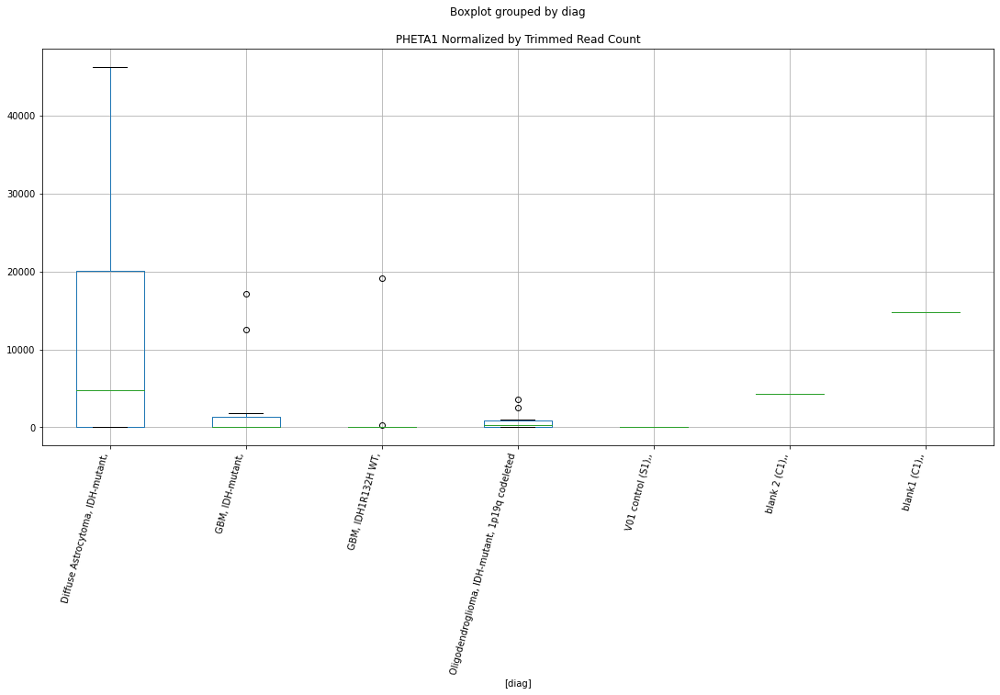

 p : 0.037696075828549086  ( t : 2.2433370089035374 ) :  D-plex  :  bbduk2  :  PKIA-AS1
Control and blanks
73     0.0
337    0.0
Name: PKIA-AS1, dtype: float64
205    0.0
Name: PKIA-AS1, dtype: float64
469    0.0
Name: PKIA-AS1, dtype: float64


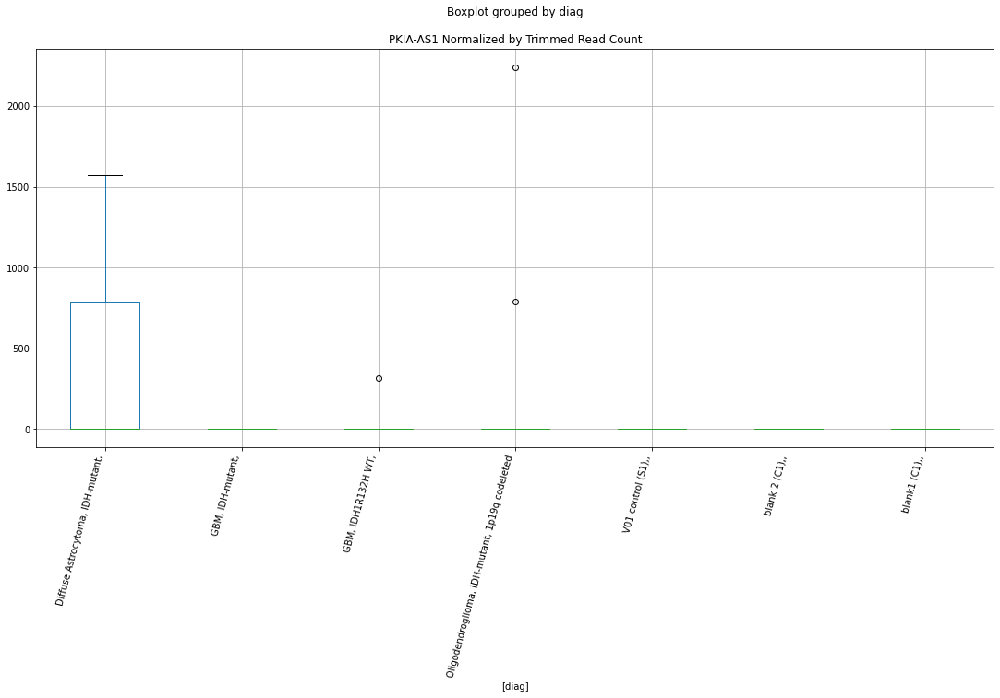

 p : 0.037754890120312405  ( t : 2.2425600076678527 ) :  D-plex  :  bbduk2  :  SNX17
Control and blanks
73     10049.11
337        0.00
Name: SNX17, dtype: float64
205    23640.01
Name: SNX17, dtype: float64
469    29576.37
Name: SNX17, dtype: float64


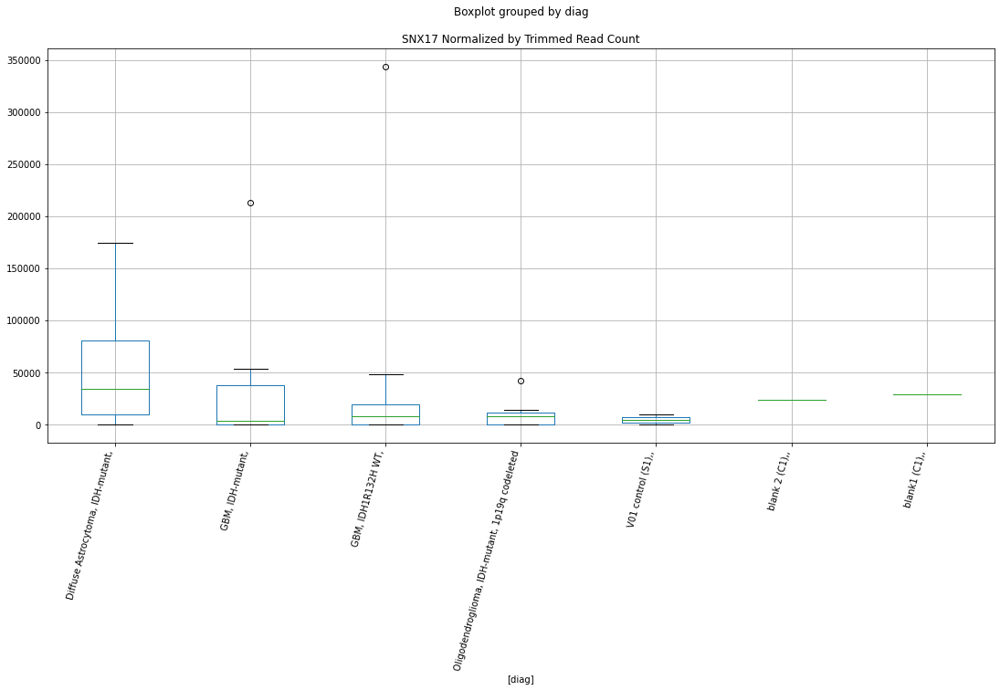

 p : 0.03776333128843499  ( t : 2.2424485822007836 ) :  Lexogen  :  cutadapt2  :  RNA5-8SN1
Control and blanks
82         0.00
346    62078.18
Name: RNA5-8SN1, dtype: float64
214    271.23
Name: RNA5-8SN1, dtype: float64
478    474.92
Name: RNA5-8SN1, dtype: float64


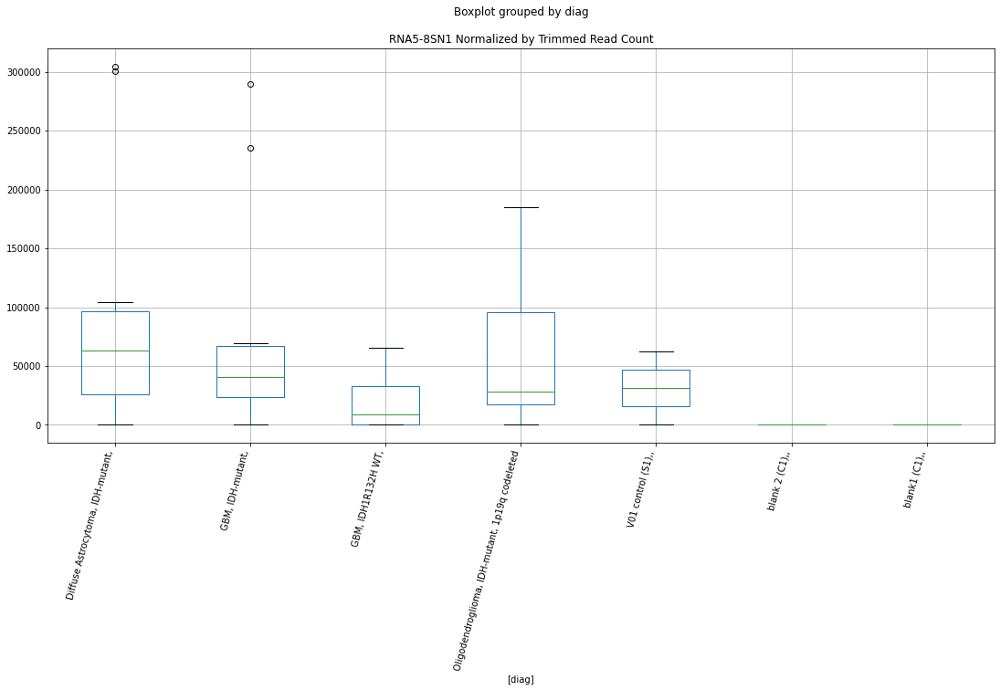

 p : 0.03776333128843499  ( t : 2.2424485822007836 ) :  Lexogen  :  cutadapt2  :  RNA5-8SN5
Control and blanks
82         0.00
346    62078.18
Name: RNA5-8SN5, dtype: float64
214    271.23
Name: RNA5-8SN5, dtype: float64
478    474.92
Name: RNA5-8SN5, dtype: float64


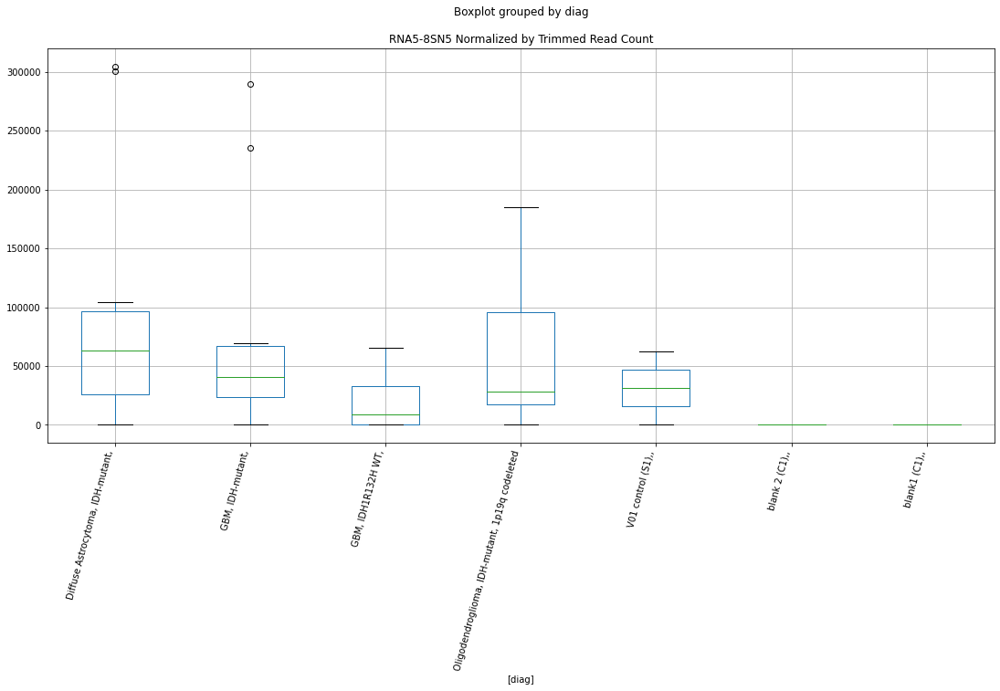

 p : 0.03776333128843499  ( t : 2.2424485822007836 ) :  Lexogen  :  cutadapt2  :  RNA5-8SN3
Control and blanks
82         0.00
346    62078.18
Name: RNA5-8SN3, dtype: float64
214    271.23
Name: RNA5-8SN3, dtype: float64
478    474.92
Name: RNA5-8SN3, dtype: float64


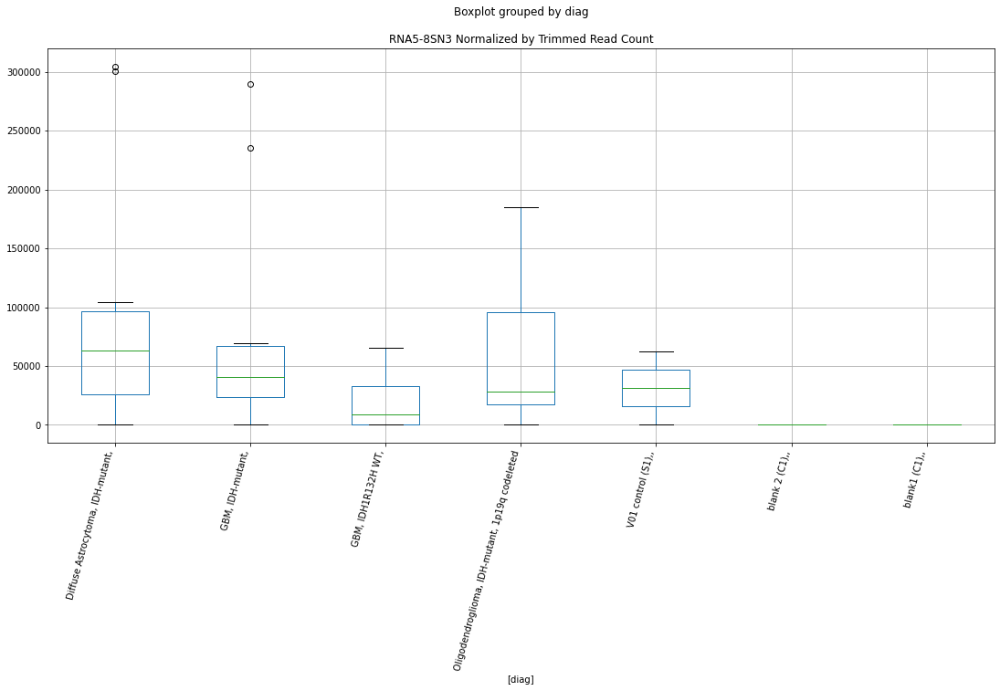

 p : 0.03776333128843499  ( t : 2.2424485822007836 ) :  Lexogen  :  cutadapt2  :  RNA5-8SN2
Control and blanks
82         0.00
346    62078.18
Name: RNA5-8SN2, dtype: float64
214    271.23
Name: RNA5-8SN2, dtype: float64
478    474.92
Name: RNA5-8SN2, dtype: float64


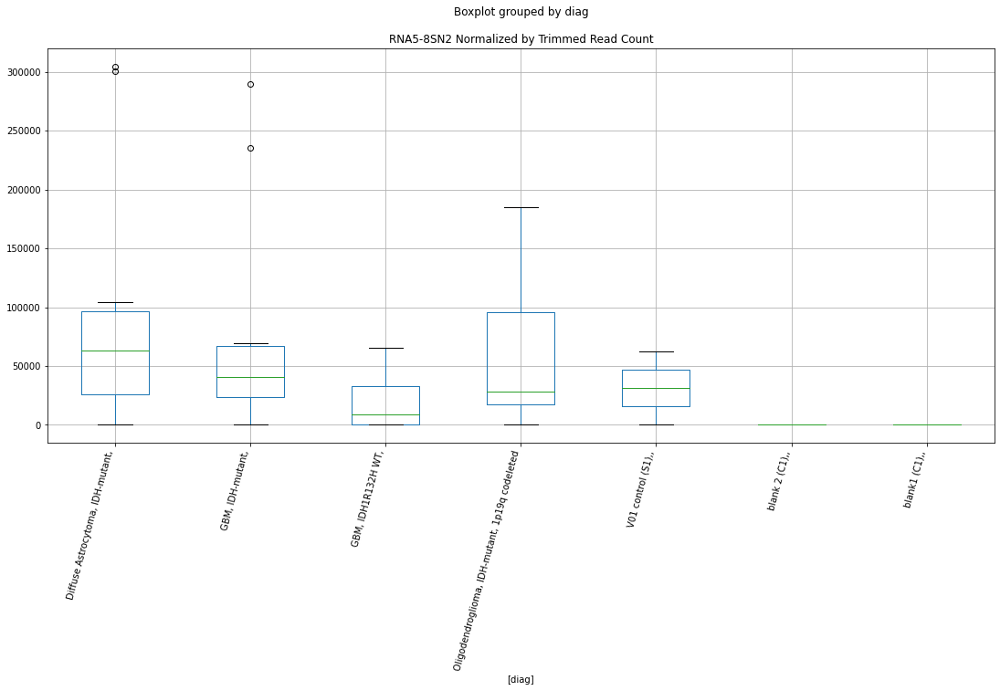

 p : 0.03778904064652129  ( t : 2.2421093538897066 ) :  D-plex  :  bbduk2  :  POLQ
Control and blanks
73        0.00
337    8011.42
Name: POLQ, dtype: float64
205    1253.64
Name: POLQ, dtype: float64
469    0.0
Name: POLQ, dtype: float64


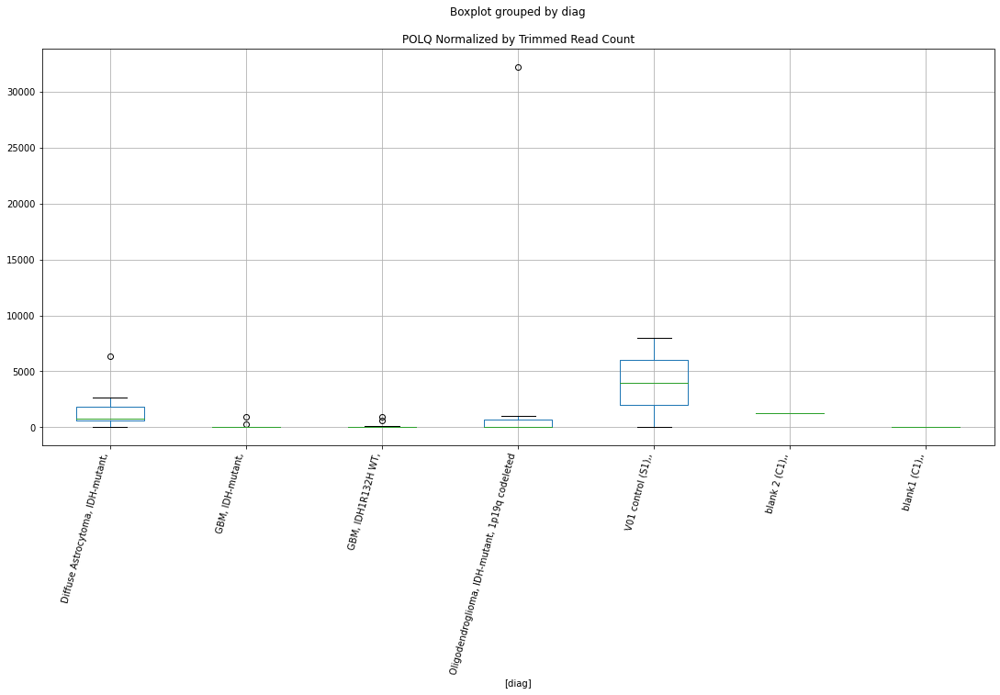

 p : 0.037829229311912994  ( t : 2.241579501000631 ) :  Lexogen  :  bbduk2  :  SLC39A14
Control and blanks
79        0.00
343    2760.09
Name: SLC39A14, dtype: float64
211    0.0
Name: SLC39A14, dtype: float64
475    0.0
Name: SLC39A14, dtype: float64


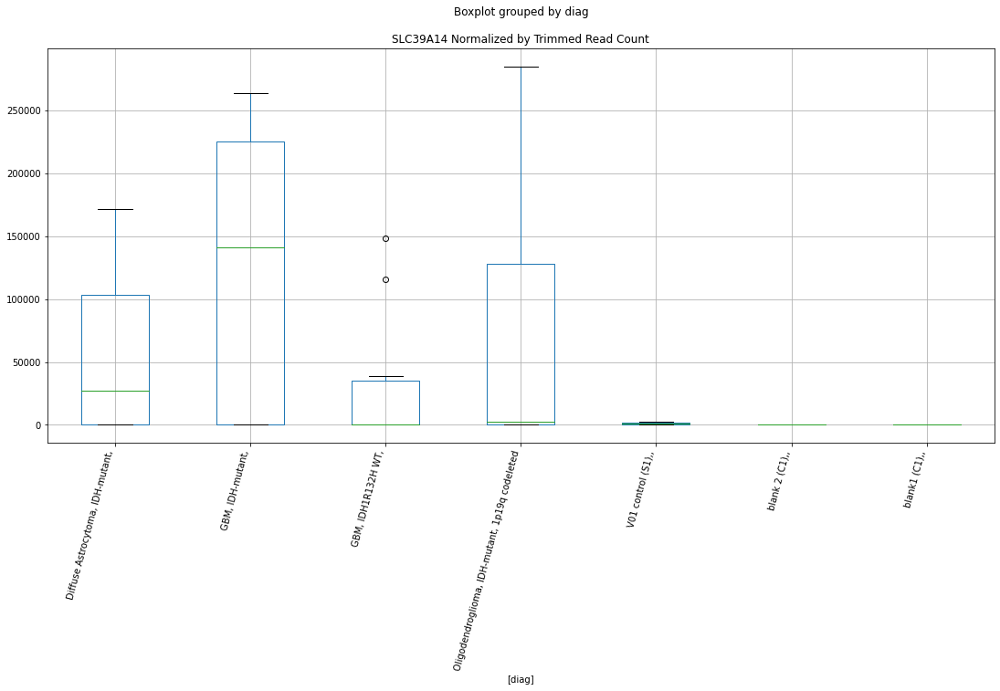

 p : 0.037880732487512614  ( t : 2.2409012343547876 ) :  D-plex  :  cutadapt2  :  SEPTIN9
Control and blanks
76     150765.23
340         0.00
Name: SEPTIN9, dtype: float64
208    126273.92
Name: SEPTIN9, dtype: float64
472    109233.65
Name: SEPTIN9, dtype: float64


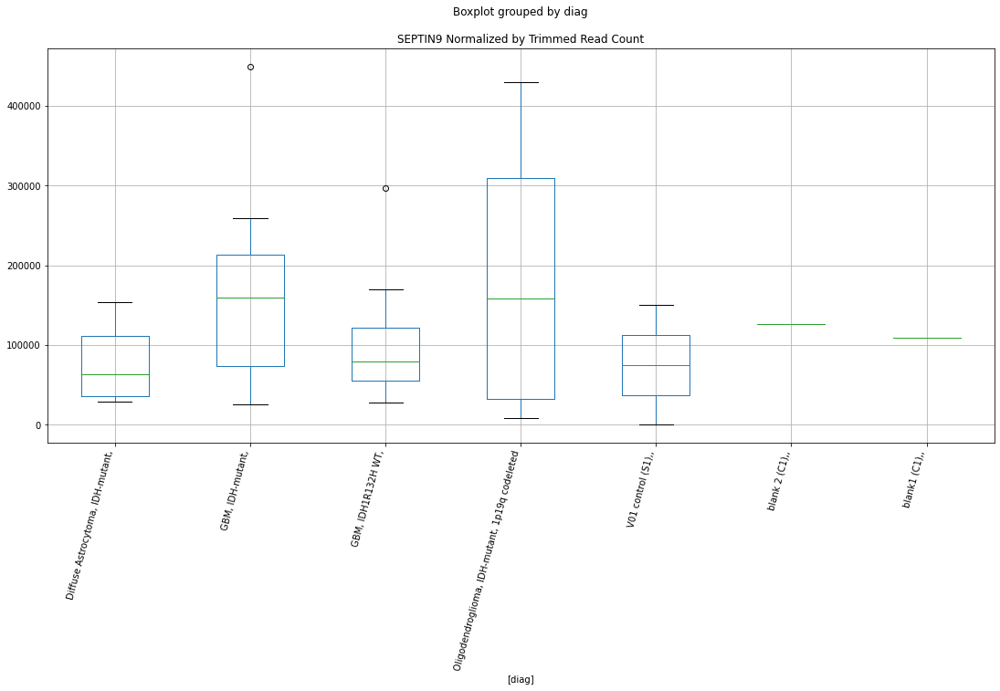

 p : 0.037955746205317734  ( t : 2.2399148671798366 ) :  D-plex  :  cutadapt2  :  PLPPR3
Control and blanks
76         0.00
340    68697.11
Name: PLPPR3, dtype: float64
208    1763.6
Name: PLPPR3, dtype: float64
472    1733.87
Name: PLPPR3, dtype: float64


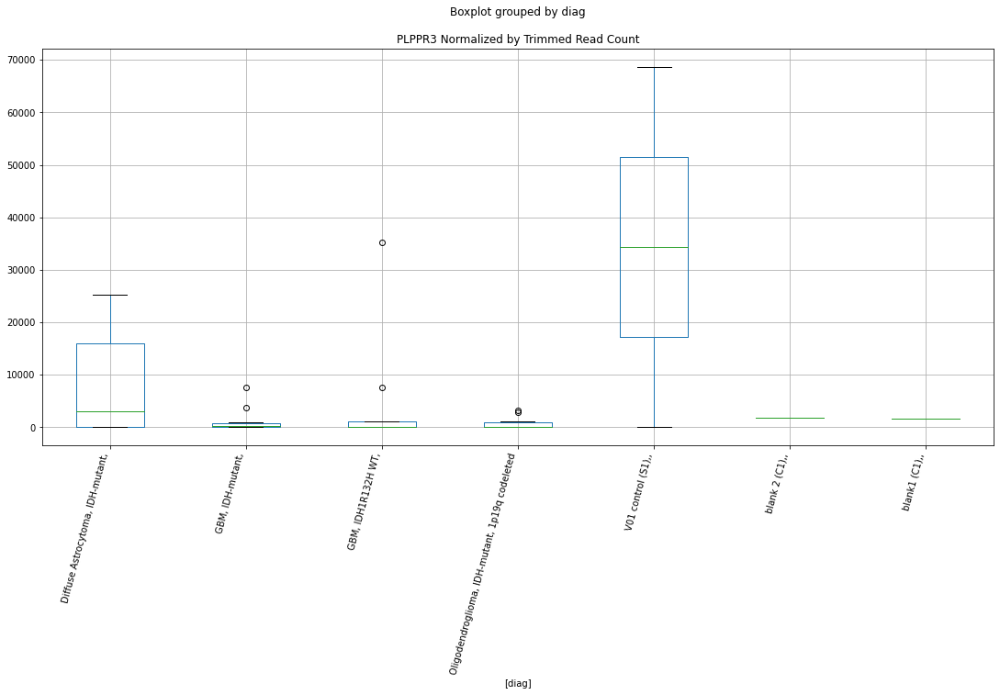

 p : 0.037966915553243316  ( t : 2.239768153424403 ) :  Lexogen  :  bbduk2  :  RNA5-8SN2
Control and blanks
79         0.00
343    62420.41
Name: RNA5-8SN2, dtype: float64
211    273.31
Name: RNA5-8SN2, dtype: float64
475    479.03
Name: RNA5-8SN2, dtype: float64


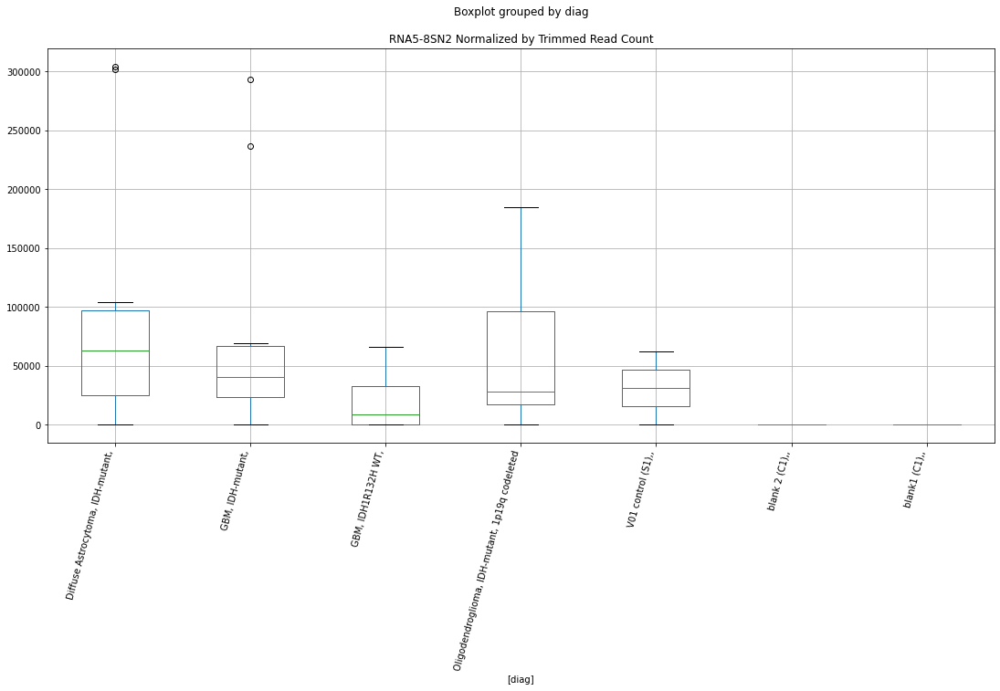

 p : 0.037966915553243316  ( t : 2.239768153424403 ) :  Lexogen  :  bbduk2  :  RNA5-8SN3
Control and blanks
79         0.00
343    62420.41
Name: RNA5-8SN3, dtype: float64
211    273.31
Name: RNA5-8SN3, dtype: float64
475    479.03
Name: RNA5-8SN3, dtype: float64


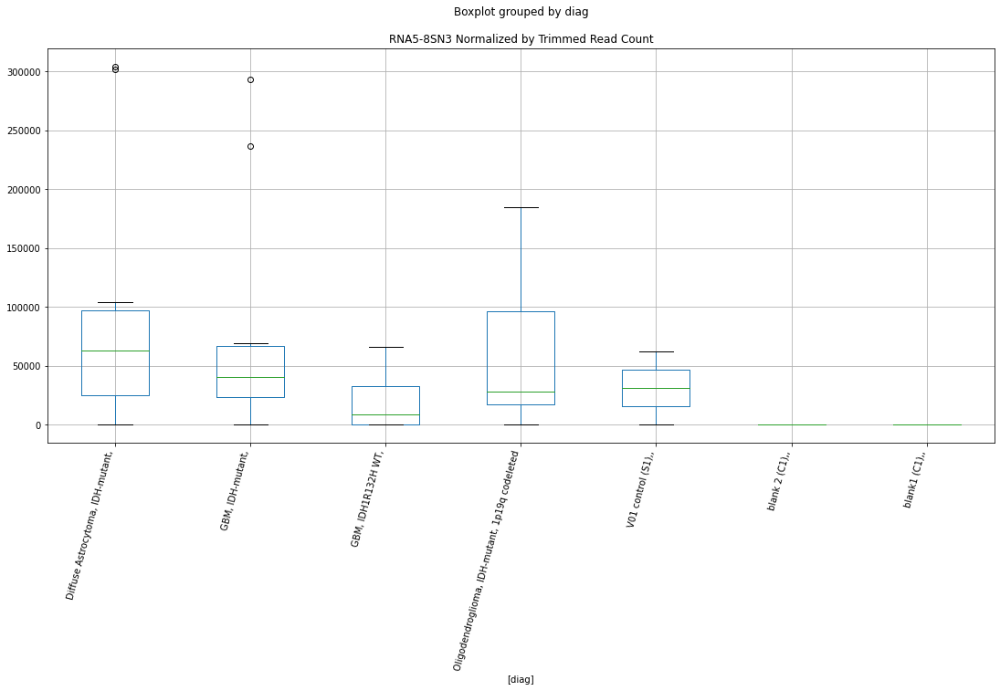

 p : 0.037966915553243316  ( t : 2.239768153424403 ) :  Lexogen  :  bbduk2  :  RNA5-8SN5
Control and blanks
79         0.00
343    62420.41
Name: RNA5-8SN5, dtype: float64
211    273.31
Name: RNA5-8SN5, dtype: float64
475    479.03
Name: RNA5-8SN5, dtype: float64


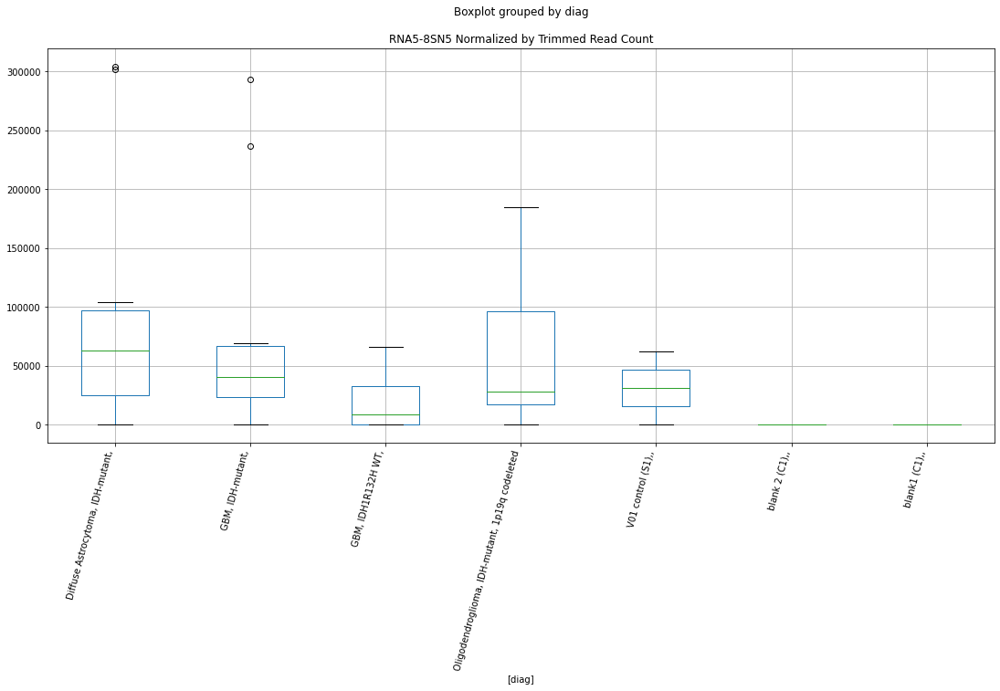

 p : 0.037966915553243316  ( t : 2.239768153424403 ) :  Lexogen  :  bbduk2  :  RNA5-8SN1
Control and blanks
79         0.00
343    62420.41
Name: RNA5-8SN1, dtype: float64
211    273.31
Name: RNA5-8SN1, dtype: float64
475    479.03
Name: RNA5-8SN1, dtype: float64


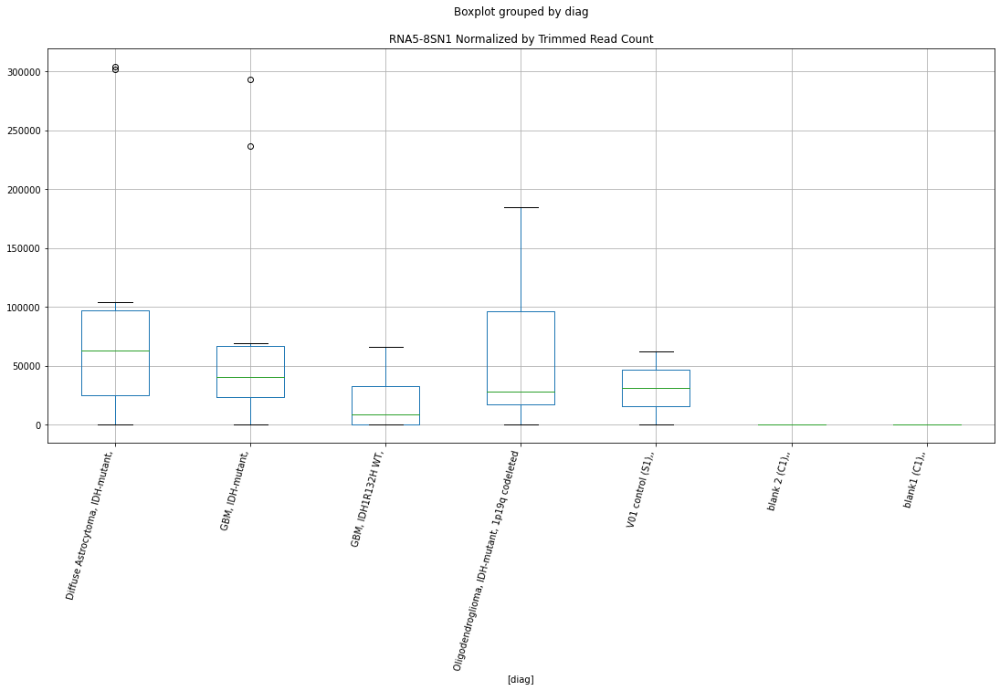

 p : 0.03798438151465523  ( t : 2.239538810931692 ) :  D-plex  :  cutadapt2  :  PKIA-AS1
Control and blanks
76     0.0
340    0.0
Name: PKIA-AS1, dtype: float64
208    0.0
Name: PKIA-AS1, dtype: float64
472    0.0
Name: PKIA-AS1, dtype: float64


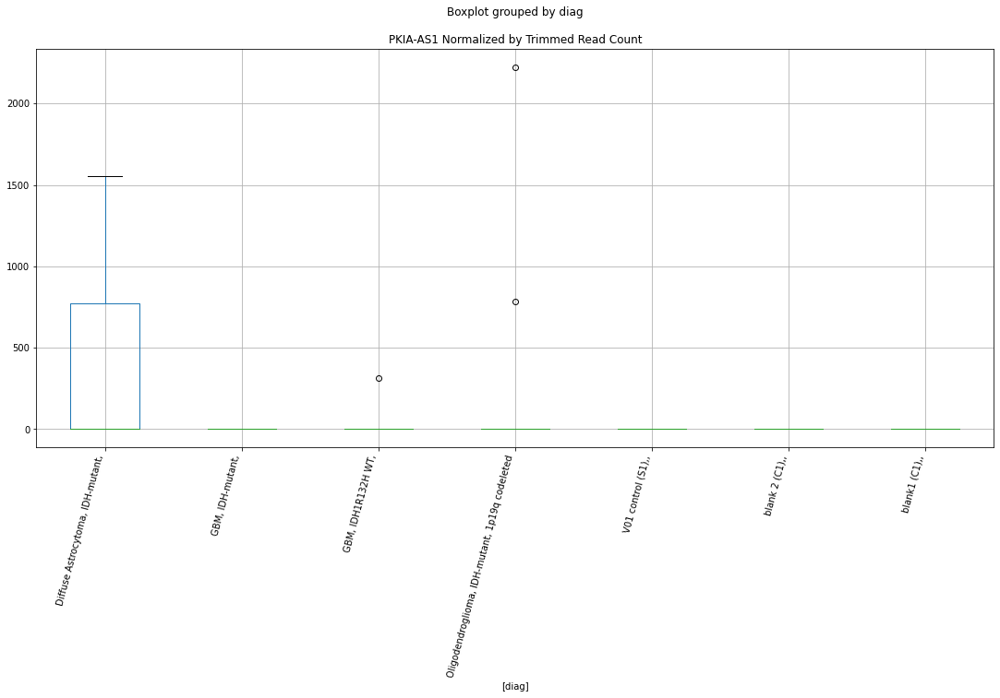

 p : 0.037992628920520556  ( t : 2.2394305494753026 ) :  D-plex  :  bbduk2  :  RIC1
Control and blanks
73     332393.61
337         0.00
Name: RIC1, dtype: float64
205    5372.73
Name: RIC1, dtype: float64
469    5915.27
Name: RIC1, dtype: float64


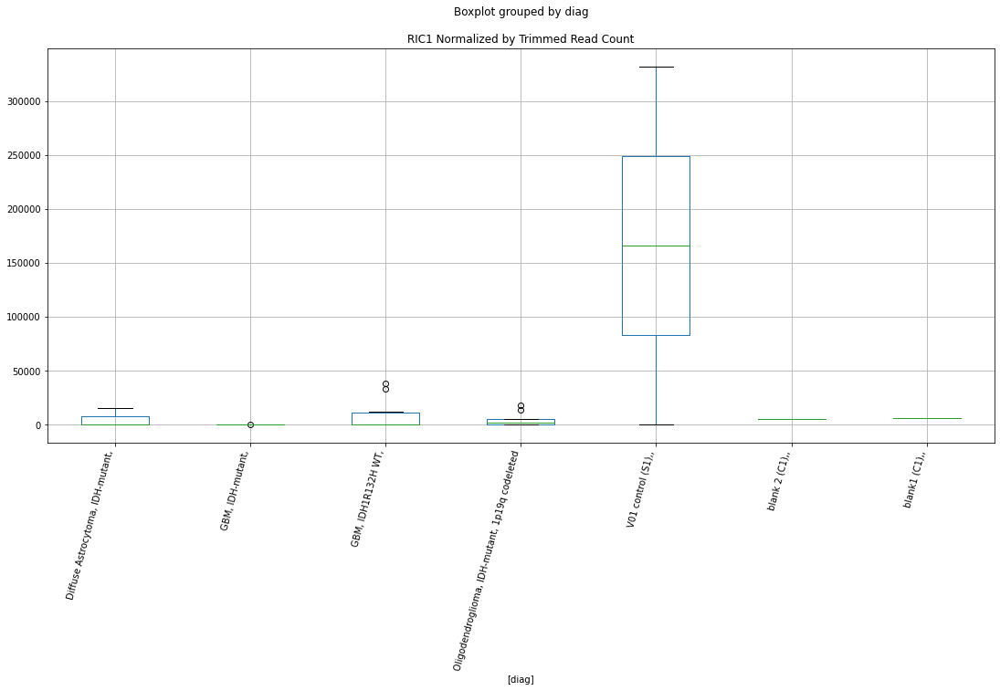

 p : 0.03801169715929083  ( t : 2.239180328815718 ) :  Lexogen  :  bbduk2  :  OTOG
Control and blanks
79        0.00
343    3397.03
Name: OTOG, dtype: float64
211    4919.51
Name: OTOG, dtype: float64
475    3353.22
Name: OTOG, dtype: float64


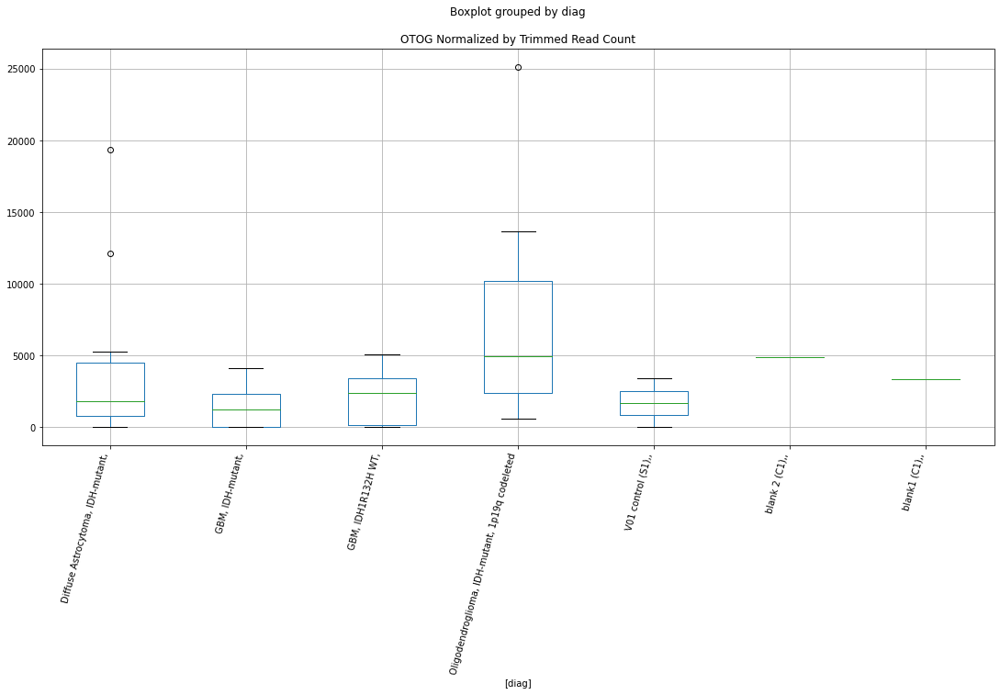

 p : 0.0380465637055192  ( t : 2.2387230958677646 ) :  D-plex  :  cutadapt2  :  PRUNE2
Control and blanks
76         0.00
340    28183.43
Name: PRUNE2, dtype: float64
208    28217.63
Name: PRUNE2, dtype: float64
472    19072.54
Name: PRUNE2, dtype: float64


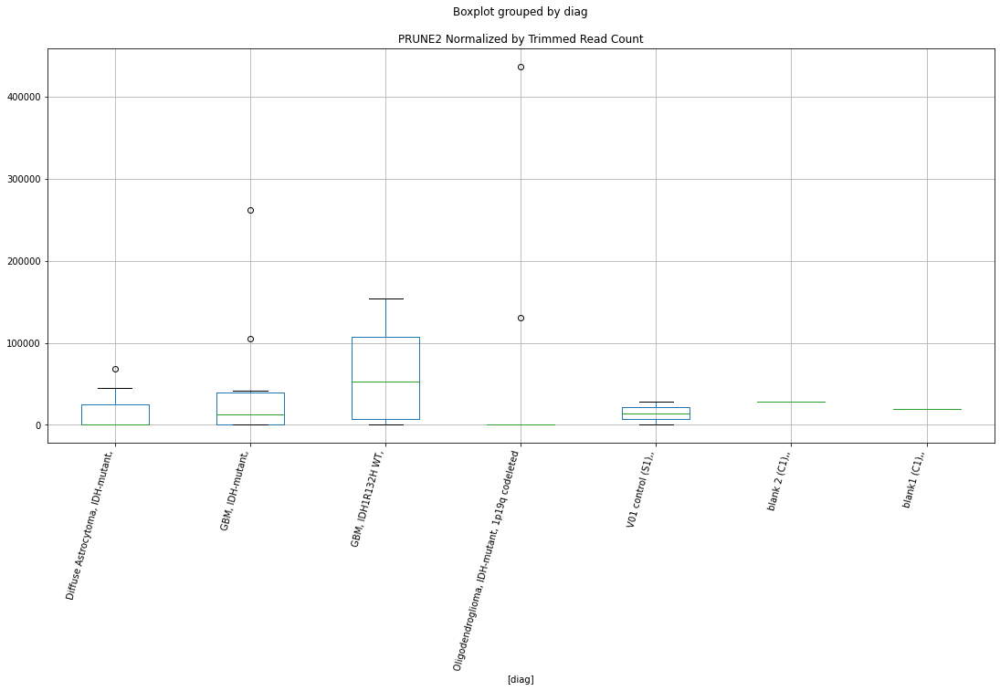

 p : 0.03811552453623544  ( t : 2.237819893632728 ) :  D-plex  :  bbduk2  :  RNA45SN3
Control and blanks
73     4.26e+06
337    2.71e+06
Name: RNA45SN3, dtype: float64
205    2.56e+06
Name: RNA45SN3, dtype: float64
469    2.68e+06
Name: RNA45SN3, dtype: float64


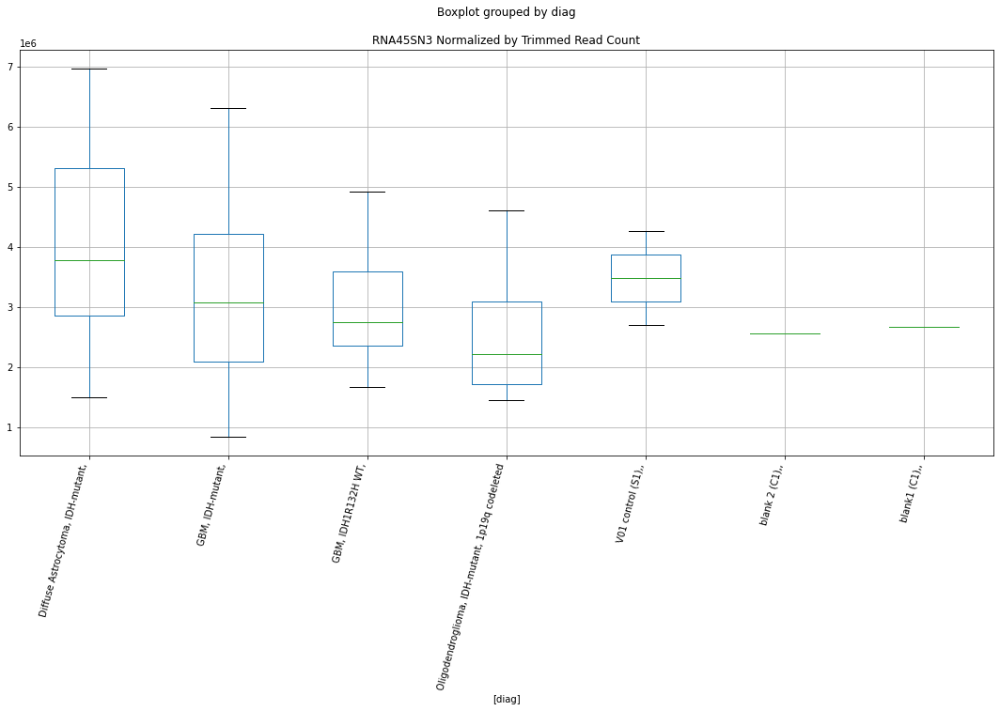

 p : 0.03818083704305115  ( t : 2.236965862473184 ) :  D-plex  :  bbduk2  :  SLC25A26
Control and blanks
73     0.0
337    0.0
Name: SLC25A26, dtype: float64
205    1253.64
Name: SLC25A26, dtype: float64
469    0.0
Name: SLC25A26, dtype: float64


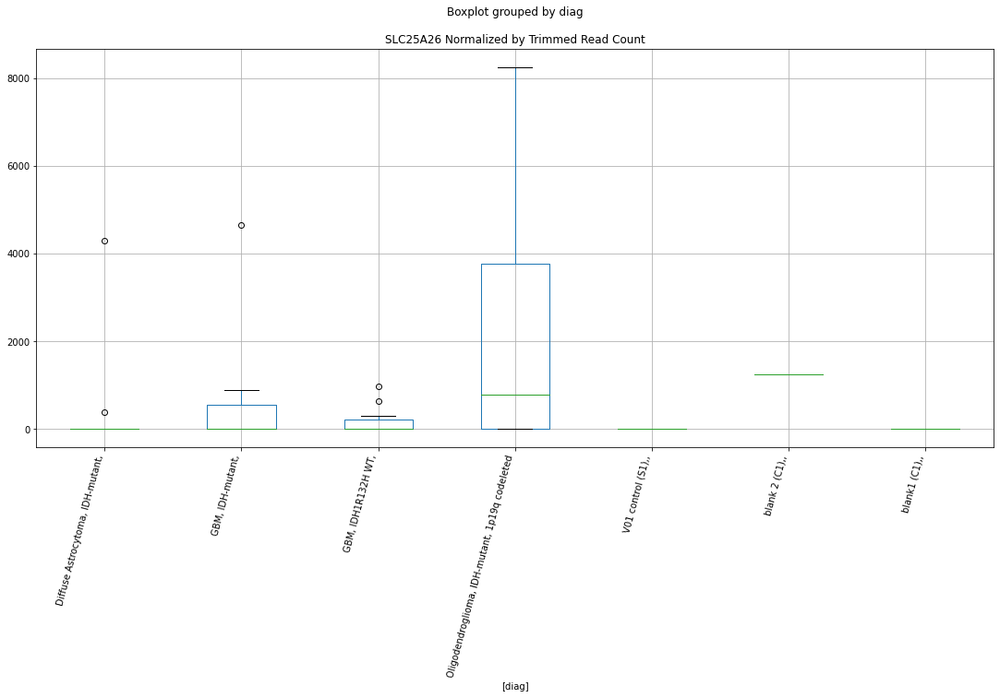

 p : 0.0381892003116747  ( t : 2.23685660102456 ) :  Lexogen  :  bbduk2  :  PRORY
Control and blanks
79     2861.20
343     849.26
Name: PRORY, dtype: float64
211    546.61
Name: PRORY, dtype: float64
475    479.03
Name: PRORY, dtype: float64


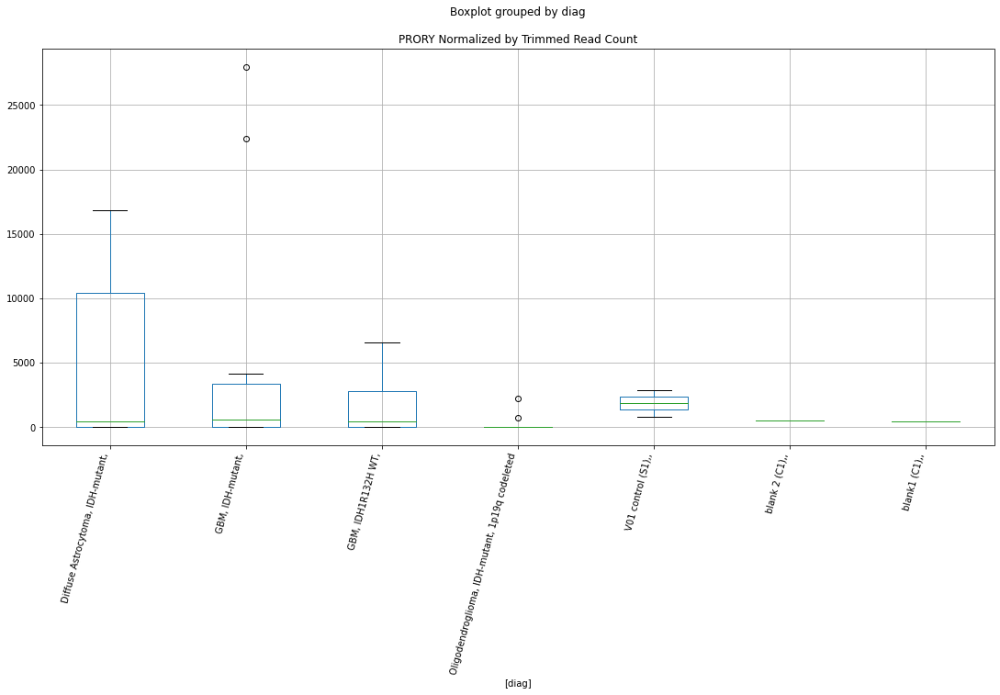

 p : 0.03818994124480378  ( t : 2.23684692220922 ) :  D-plex  :  cutadapt2  :  PPP2R2D
Control and blanks
76     0.0
340    0.0
Name: PPP2R2D, dtype: float64
208    881.8
Name: PPP2R2D, dtype: float64
472    577.96
Name: PPP2R2D, dtype: float64


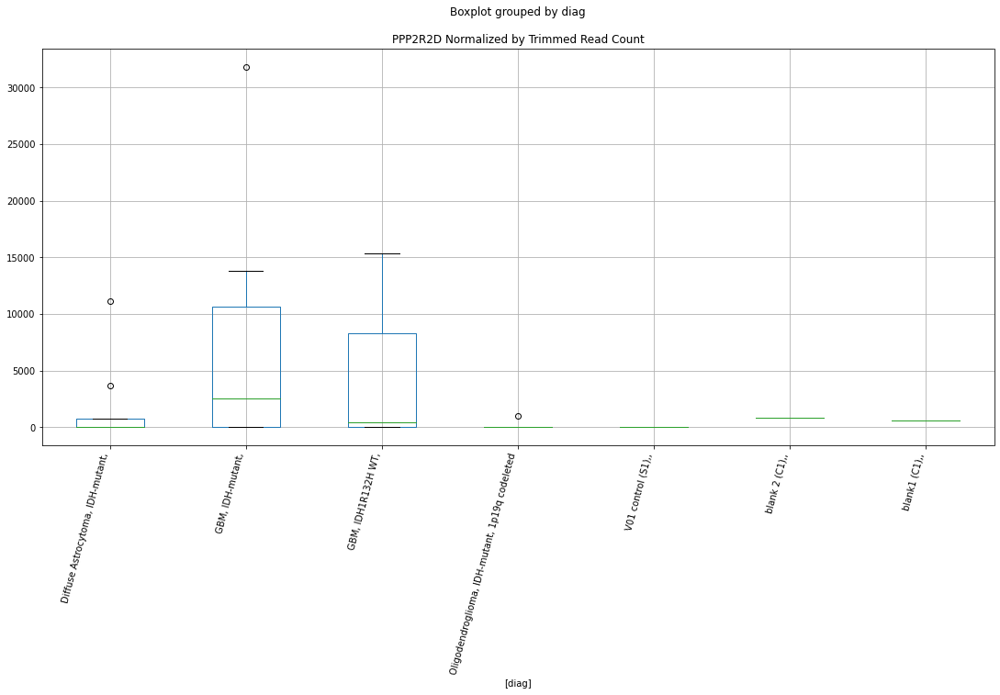

 p : 0.03836264837052511  ( t : 2.2345955557298374 ) :  D-plex  :  cutadapt2  :  PACC1
Control and blanks
76     0.0
340    0.0
Name: PACC1, dtype: float64
208    2292.68
Name: PACC1, dtype: float64
472    6935.47
Name: PACC1, dtype: float64


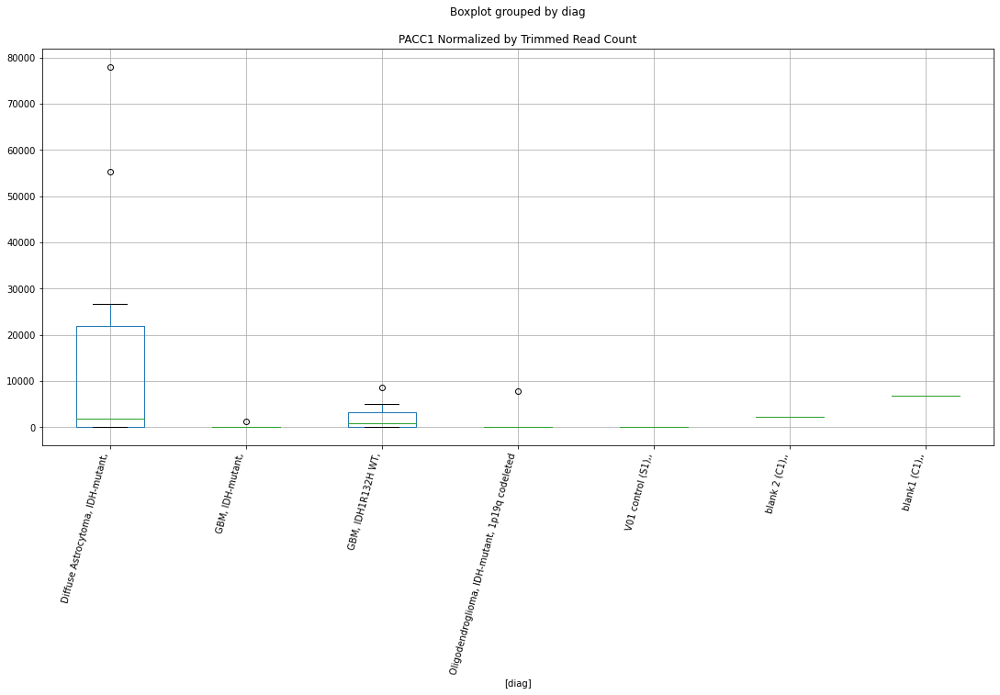

 p : 0.03837688256960874  ( t : 2.2344104191783383 ) :  D-plex  :  bbduk2  :  PRCC
Control and blanks
73     0.0
337    0.0
Name: PRCC, dtype: float64
205    179.09
Name: PRCC, dtype: float64
469    2957.64
Name: PRCC, dtype: float64


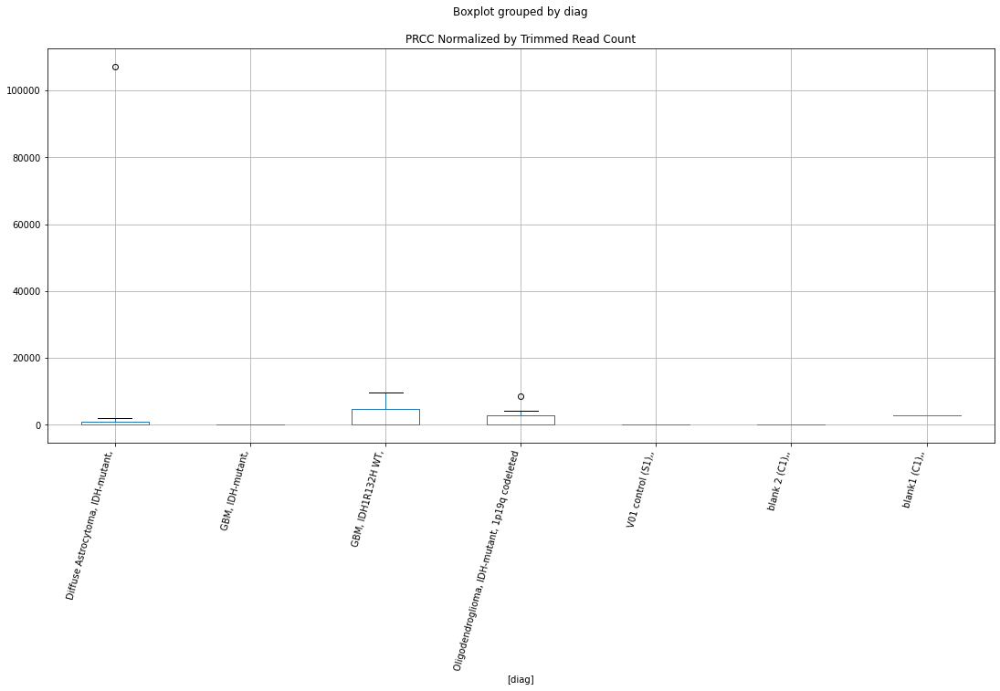

 p : 0.03841205778145383  ( t : 2.233953185410117 ) :  Lexogen  :  bbduk2  :  RTN4R
Control and blanks
79     0.0
343    0.0
Name: RTN4R, dtype: float64
211    4099.6
Name: RTN4R, dtype: float64
475    0.0
Name: RTN4R, dtype: float64


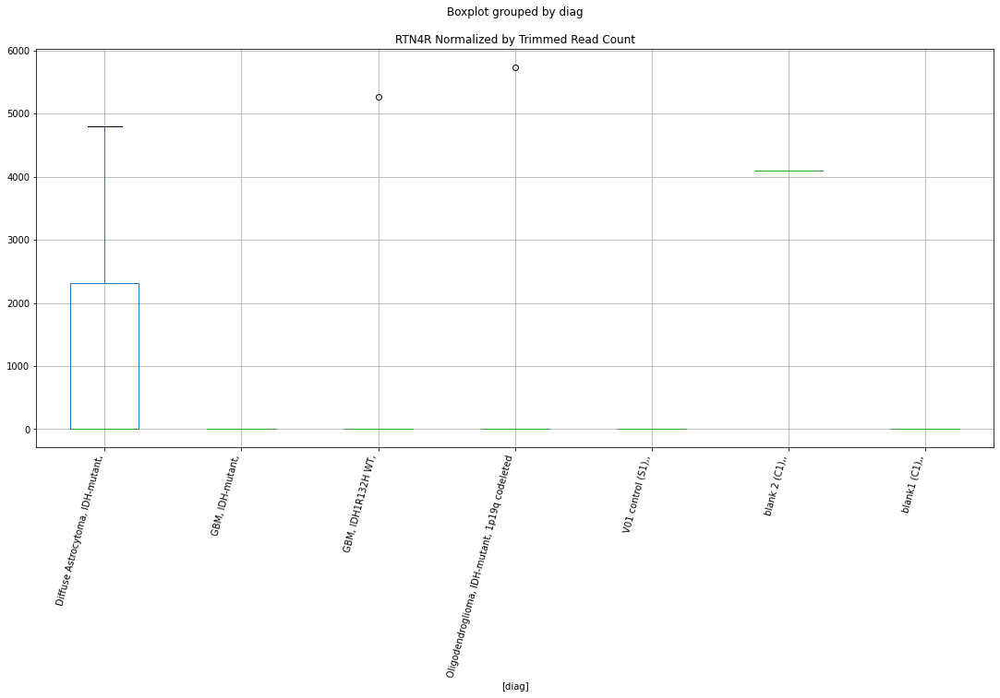

 p : 0.038418911157518915  ( t : 2.233864145001413 ) :  D-plex  :  bbduk2  :  RBMX
Control and blanks
73     0.0
337    0.0
Name: RBMX, dtype: float64
205    895.45
Name: RBMX, dtype: float64
469    0.0
Name: RBMX, dtype: float64


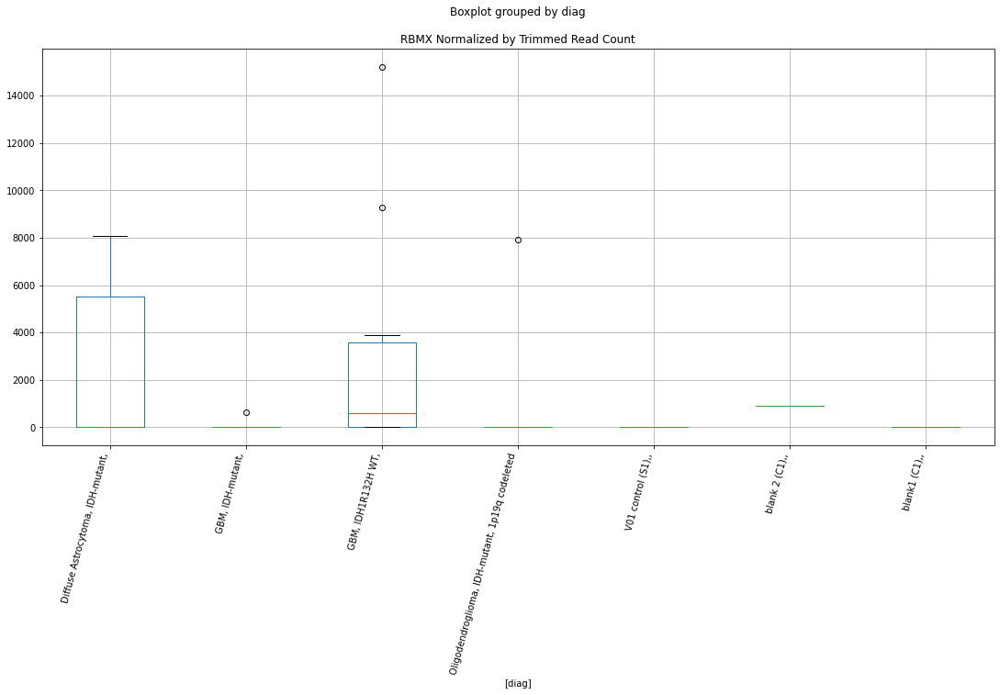

 p : 0.0384328695650893  ( t : 2.233682839877719 ) :  Lexogen  :  bbduk2  :  RFC2
Control and blanks
79     12875.39
343        0.00
Name: RFC2, dtype: float64
211    0.0
Name: RFC2, dtype: float64
475    71136.17
Name: RFC2, dtype: float64


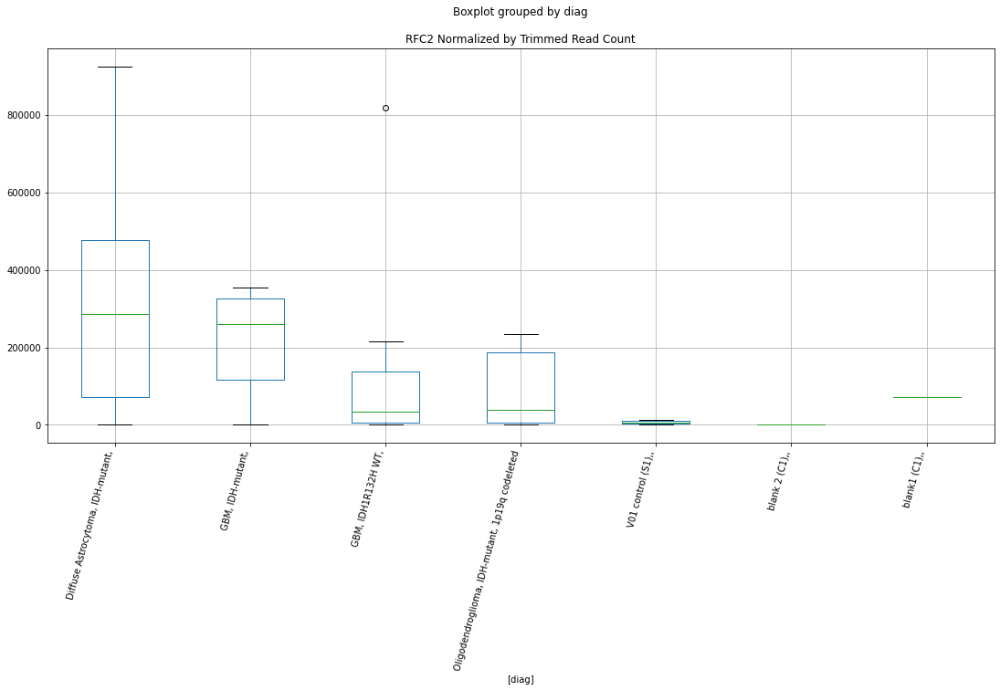

 p : 0.038470157997091144  ( t : 2.23319879948847 ) :  D-plex  :  bbduk2  :  PACC1
Control and blanks
73     0.0
337    0.0
Name: PACC1, dtype: float64
205    2328.18
Name: PACC1, dtype: float64
469    7098.33
Name: PACC1, dtype: float64


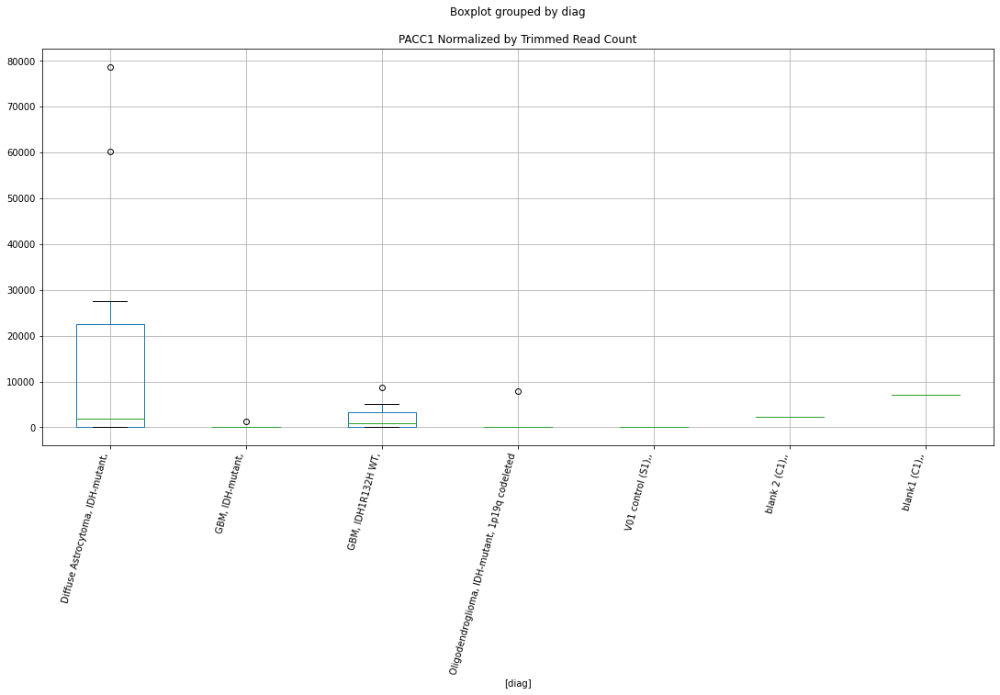

 p : 0.0385054516687781  ( t : 2.2327410510892967 ) :  Lexogen  :  cutadapt2  :  RFC2
Control and blanks
82     12780.46
346        0.00
Name: RFC2, dtype: float64
214    0.0
Name: RFC2, dtype: float64
478    72662.91
Name: RFC2, dtype: float64


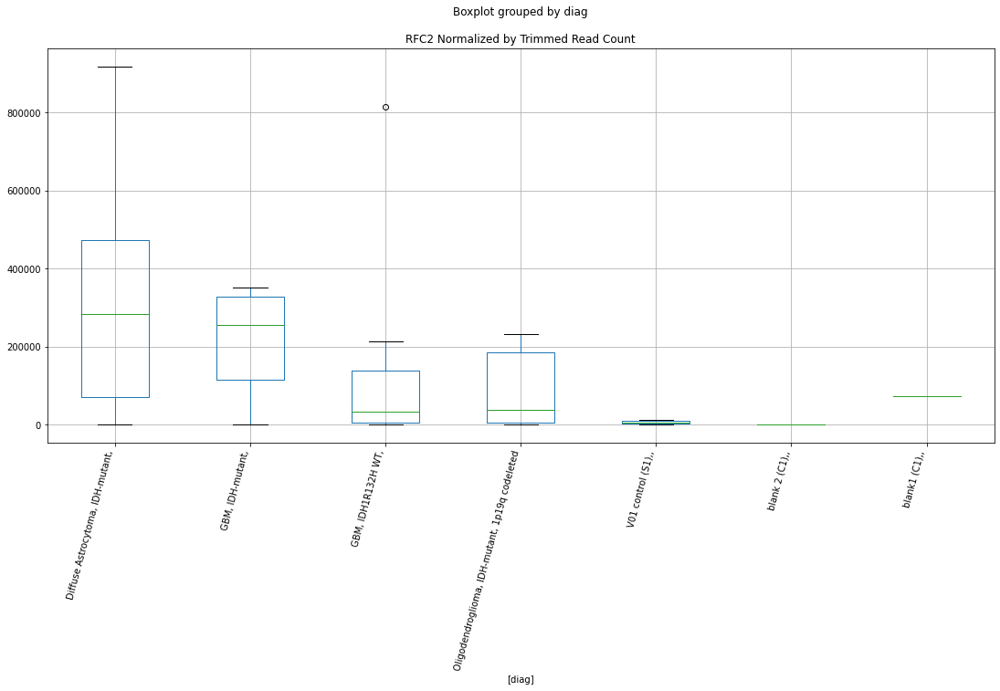

 p : 0.03851538172839984  ( t : 2.232612330857561 ) :  D-plex  :  cutadapt2  :  PCNX1
Control and blanks
76      9091.37
340    10568.79
Name: PCNX1, dtype: float64
208    38093.81
Name: PCNX1, dtype: float64
472    34677.35
Name: PCNX1, dtype: float64


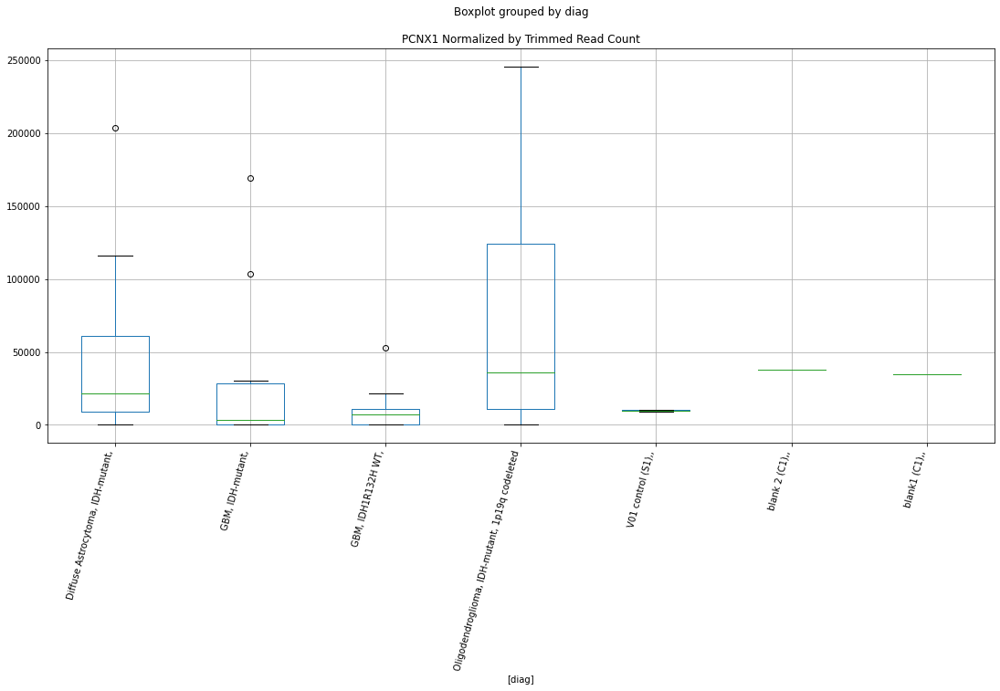

 p : 0.038564990051530905  ( t : 2.2319697313647042 ) :  D-plex  :  cutadapt2  :  SEC22B3P
Control and blanks
76       757.61
340    14091.71
Name: SEC22B3P, dtype: float64
208    2821.76
Name: SEC22B3P, dtype: float64
472    1733.87
Name: SEC22B3P, dtype: float64


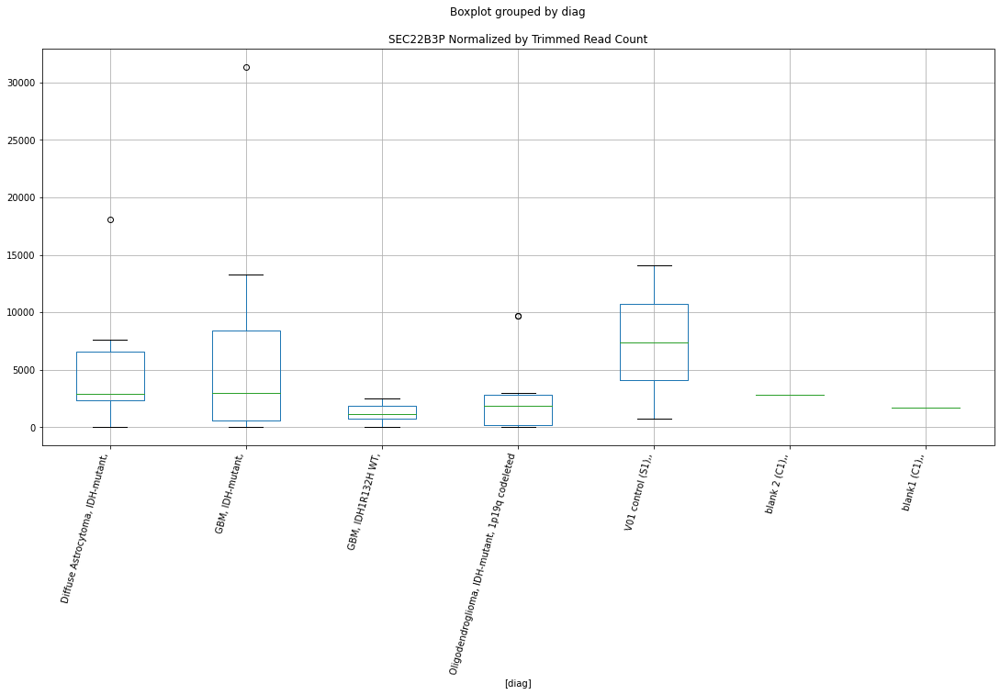

 p : 0.03858942059160071  ( t : 2.2316535511215254 ) :  D-plex  :  bbduk2  :  SIGLEC1
Control and blanks
73     3092.03
337       0.00
Name: SIGLEC1, dtype: float64
205    7880.0
Name: SIGLEC1, dtype: float64
469    9464.44
Name: SIGLEC1, dtype: float64


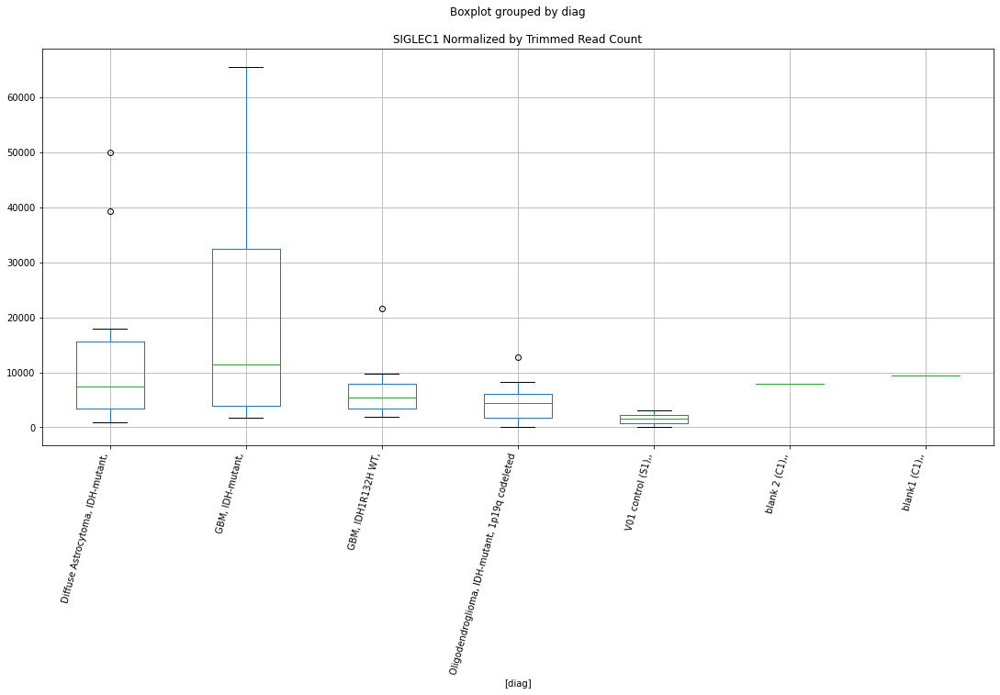

 p : 0.038609358729005054  ( t : 2.2313956482171453 ) :  D-plex  :  bbduk2  :  PHYKPL
Control and blanks
73        0.00
337    8011.42
Name: PHYKPL, dtype: float64
205    67875.47
Name: PHYKPL, dtype: float64
469    133093.65
Name: PHYKPL, dtype: float64


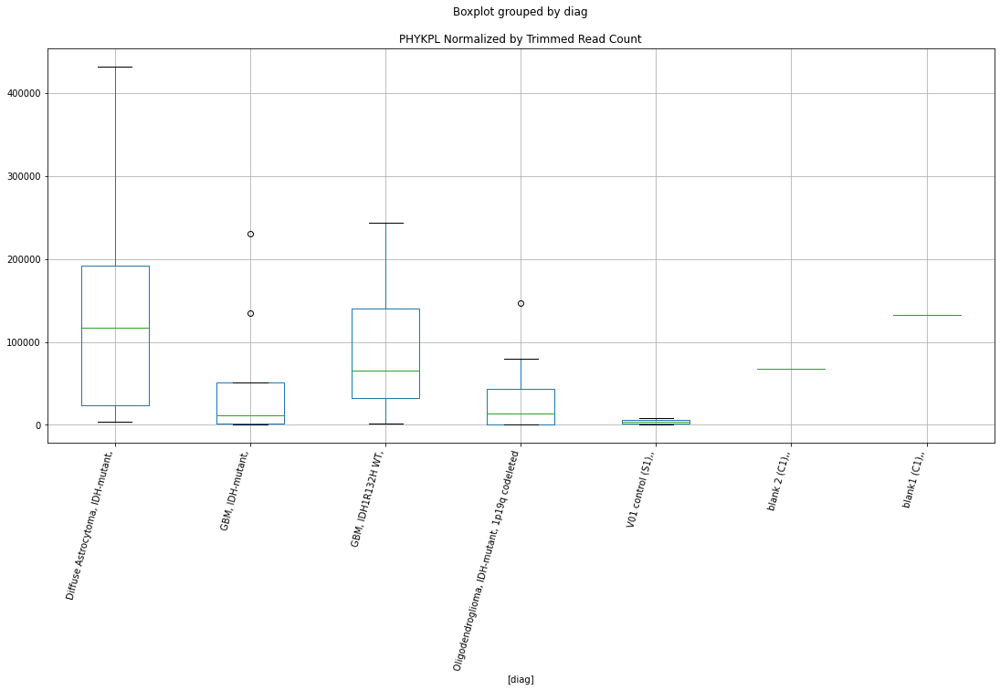

 p : 0.03863739222206885  ( t : 2.231033238075957 ) :  D-plex  :  cutadapt2  :  RNA28SN4
Control and blanks
76     2.26e+06
340    1.33e+06
Name: RNA28SN4, dtype: float64
208    1.50e+06
Name: RNA28SN4, dtype: float64
472    1.39e+06
Name: RNA28SN4, dtype: float64


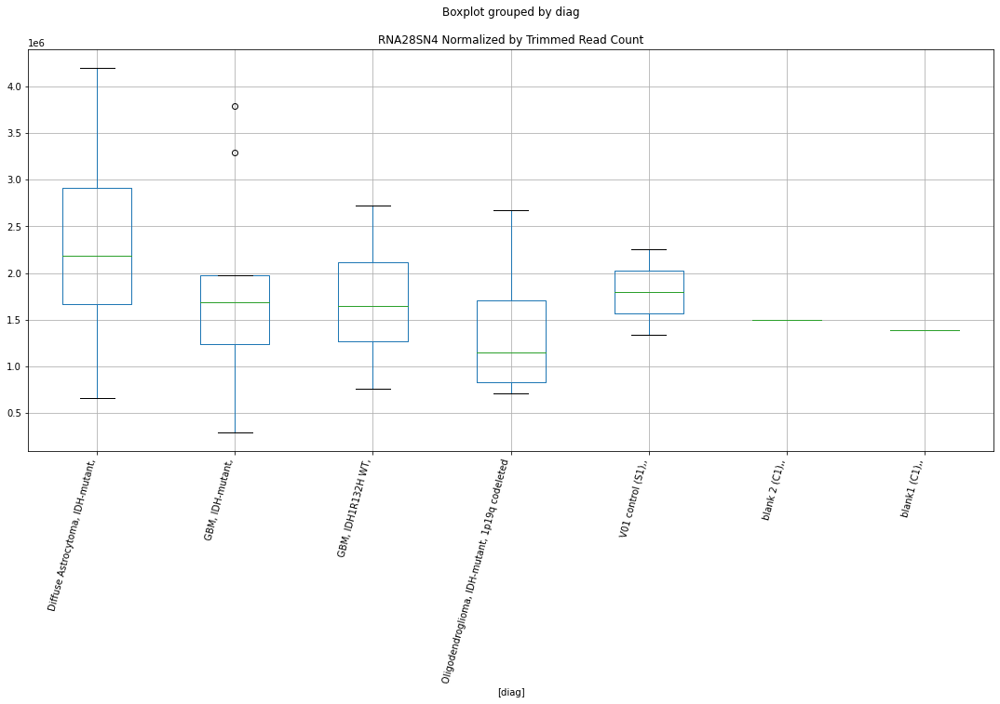

 p : 0.03867624002115998  ( t : 2.2305314234288804 ) :  D-plex  :  bbduk2  :  RTN3
Control and blanks
73     3865.04
337    4450.79
Name: RTN3, dtype: float64
205    7342.73
Name: RTN3, dtype: float64
469    16562.76
Name: RTN3, dtype: float64


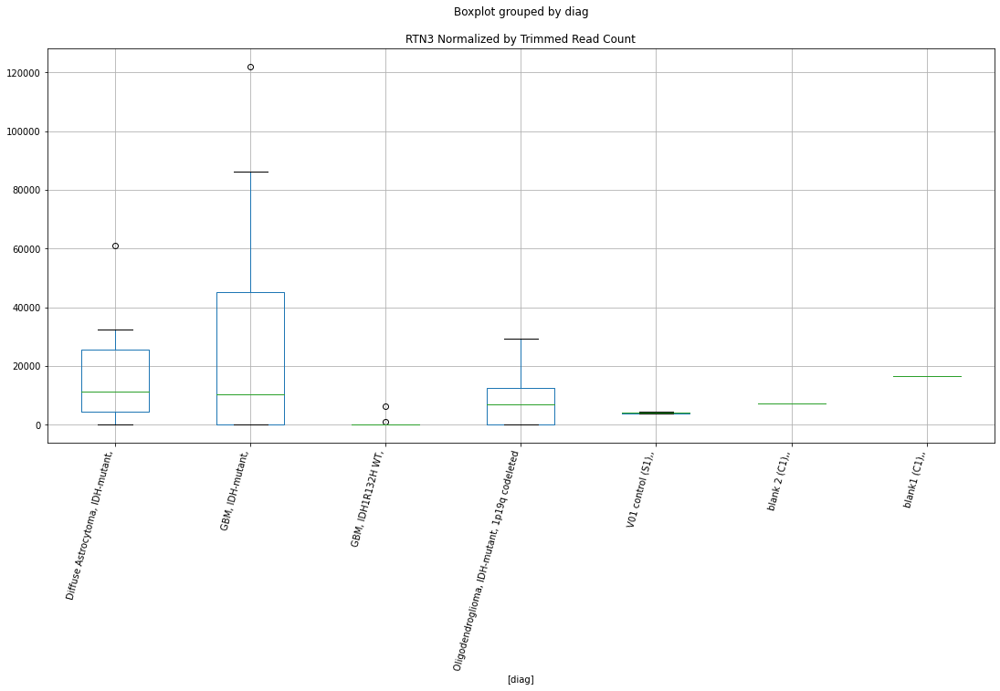

 p : 0.038765774203575847  ( t : 2.2293766355776303 ) :  D-plex  :  bbduk2  :  RNA18SN1
Control and blanks
73     1.99e+06
337    1.21e+06
Name: RNA18SN1, dtype: float64
205    950435.68
Name: RNA18SN1, dtype: float64
469    1.14e+06
Name: RNA18SN1, dtype: float64


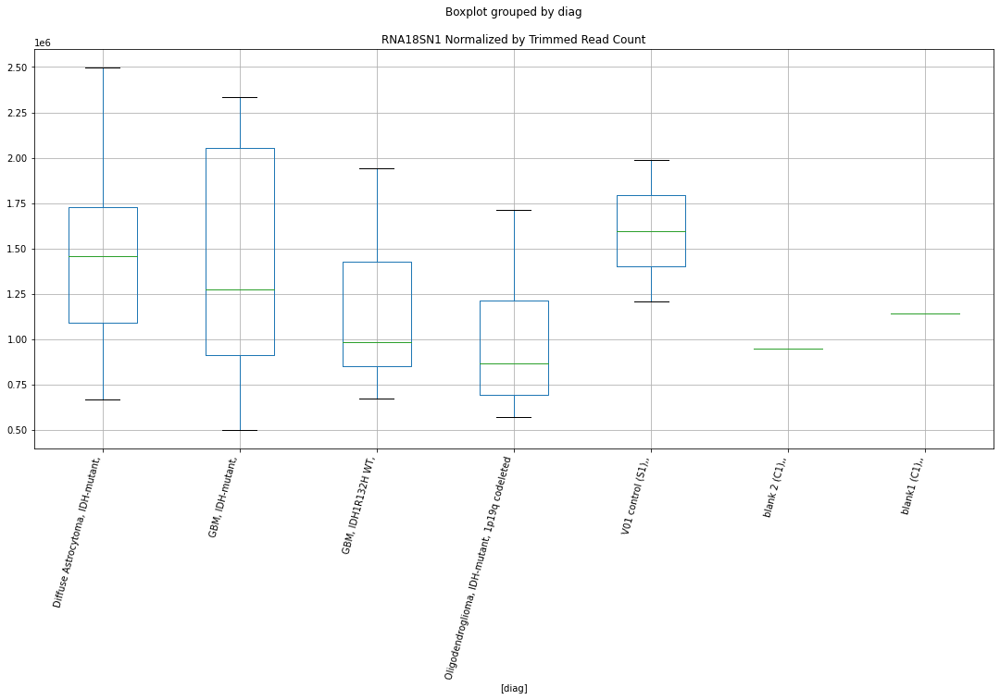

 p : 0.038777573179185086  ( t : 2.229224638794684 ) :  D-plex  :  bbduk2  :  RNA18SN5
Control and blanks
73     1.99e+06
337    1.21e+06
Name: RNA18SN5, dtype: float64
205    950435.68
Name: RNA18SN5, dtype: float64
469    1.14e+06
Name: RNA18SN5, dtype: float64


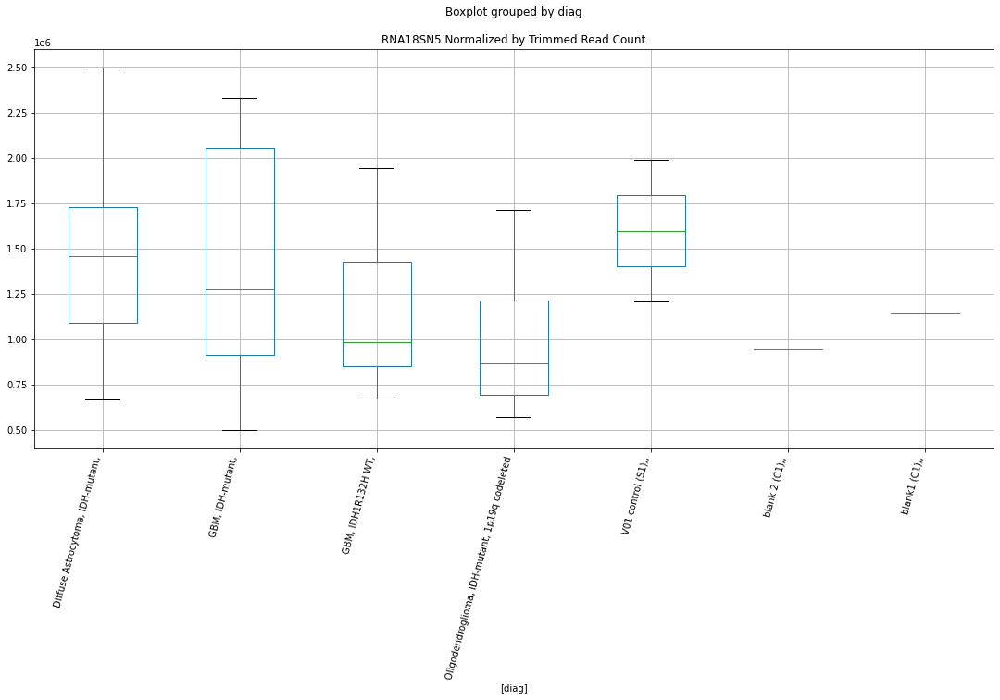

 p : 0.038783609814996414  ( t : 2.229146890105586 ) :  D-plex  :  bbduk2  :  PRDM16
Control and blanks
73     1546.02
337       0.00
Name: PRDM16, dtype: float64
205    27221.82
Name: PRDM16, dtype: float64
469    2366.11
Name: PRDM16, dtype: float64


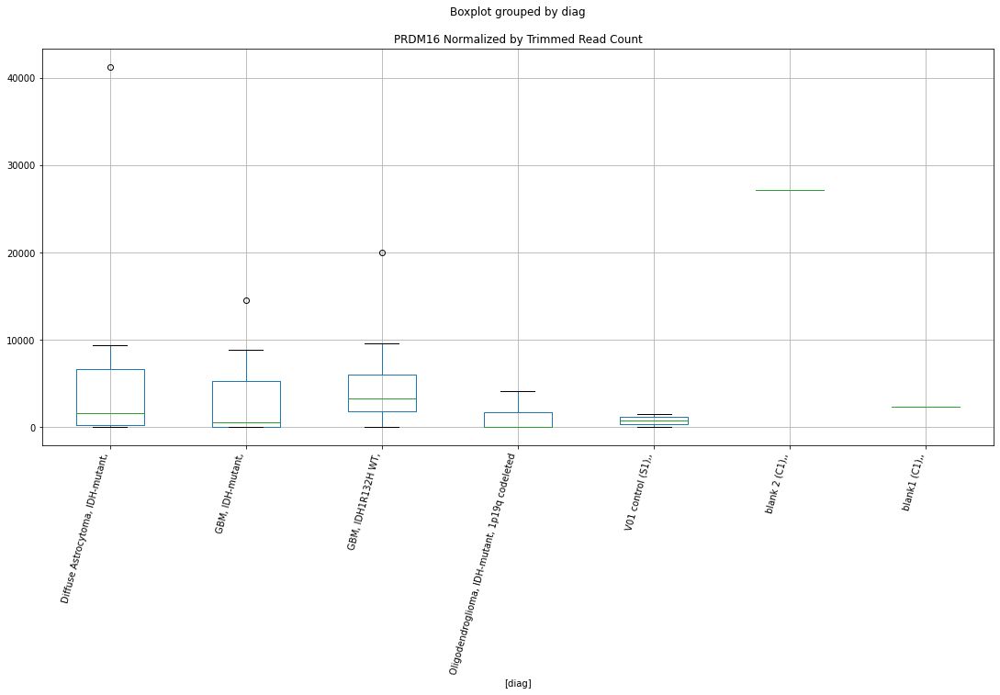

 p : 0.038857148533587335  ( t : 2.228200643973392 ) :  Lexogen  :  cutadapt2  :  SLC39A14
Control and blanks
82     0.0
346    0.0
Name: SLC39A14, dtype: float64
214    0.0
Name: SLC39A14, dtype: float64
478    0.0
Name: SLC39A14, dtype: float64


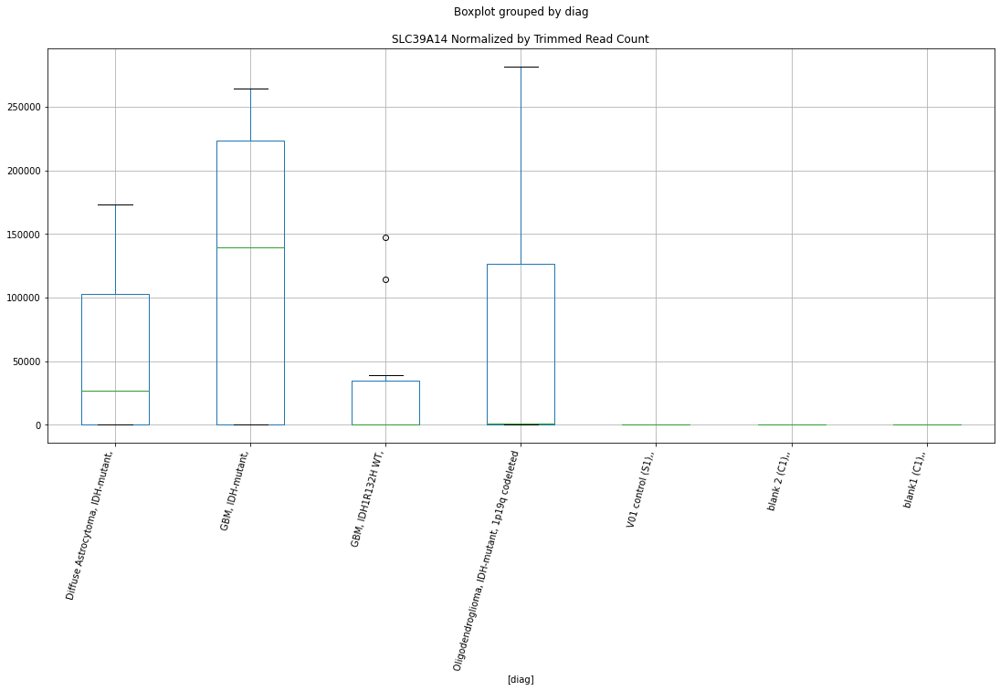

 p : 0.038860490386370544  ( t : 2.2281576824763007 ) :  D-plex  :  cutadapt2  :  SEC14L6
Control and blanks
76     0.0
340    0.0
Name: SEC14L6, dtype: float64
208    0.0
Name: SEC14L6, dtype: float64
472    6357.51
Name: SEC14L6, dtype: float64


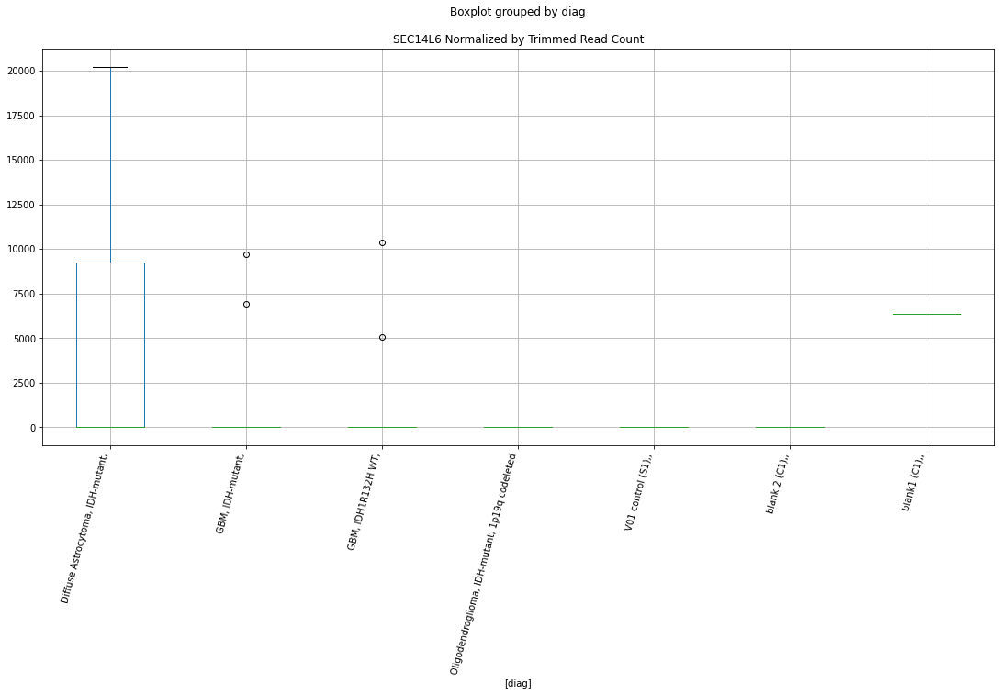

 p : 0.03886567921610768  ( t : 2.228090983738552 ) :  Lexogen  :  cutadapt2  :  PJA1
Control and blanks
82     0.0
346    0.0
Name: PJA1, dtype: float64
214    1356.13
Name: PJA1, dtype: float64
478    0.0
Name: PJA1, dtype: float64


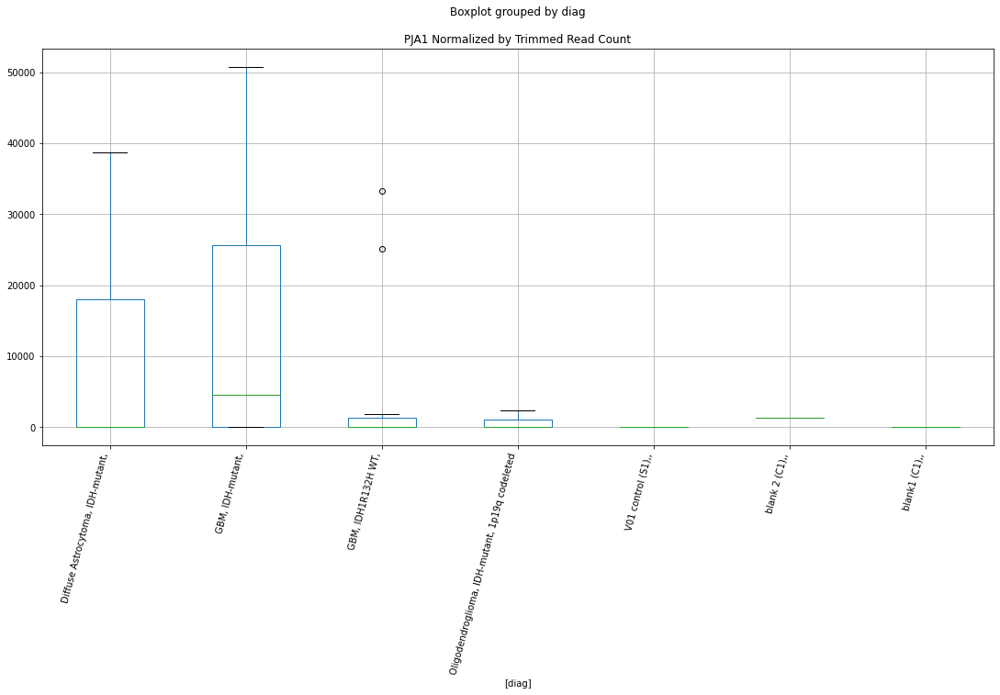

 p : 0.03887633735615271  ( t : 2.227954006601319 ) :  D-plex  :  cutadapt2  :  RNA18SN1
Control and blanks
76     1.96e+06
340    1.15e+06
Name: RNA18SN1, dtype: float64
208    936472.76
Name: RNA18SN1, dtype: float64
472    1.11e+06
Name: RNA18SN1, dtype: float64


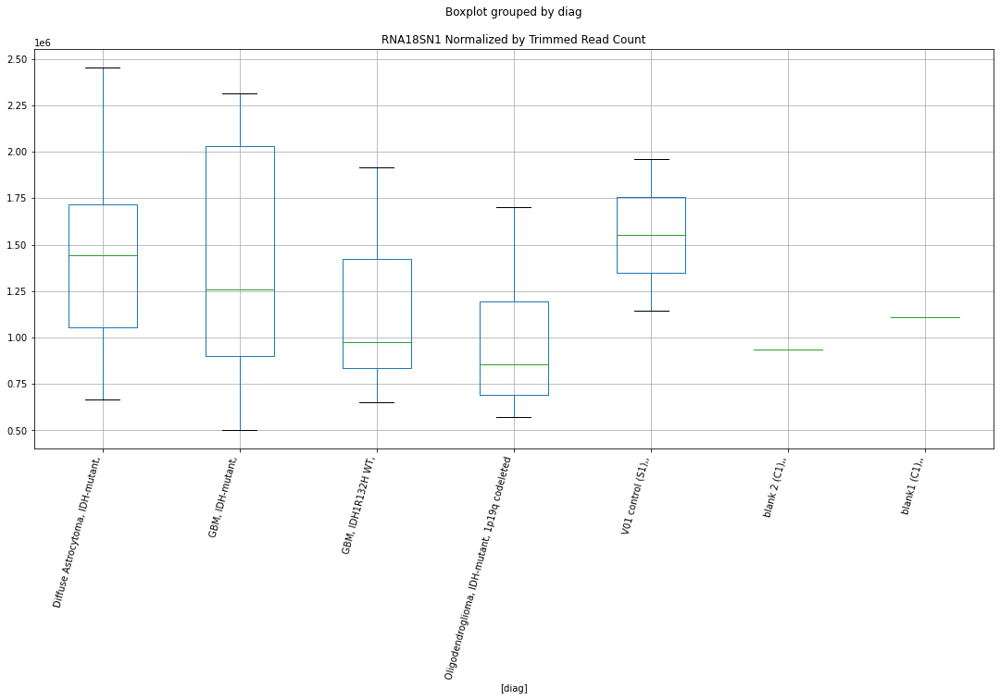

 p : 0.03888395127072027  ( t : 2.2278561746599315 ) :  D-plex  :  cutadapt2  :  RNF43
Control and blanks
76     4545.69
340       0.00
Name: RNF43, dtype: float64
208    12345.22
Name: RNF43, dtype: float64
472    17338.68
Name: RNF43, dtype: float64


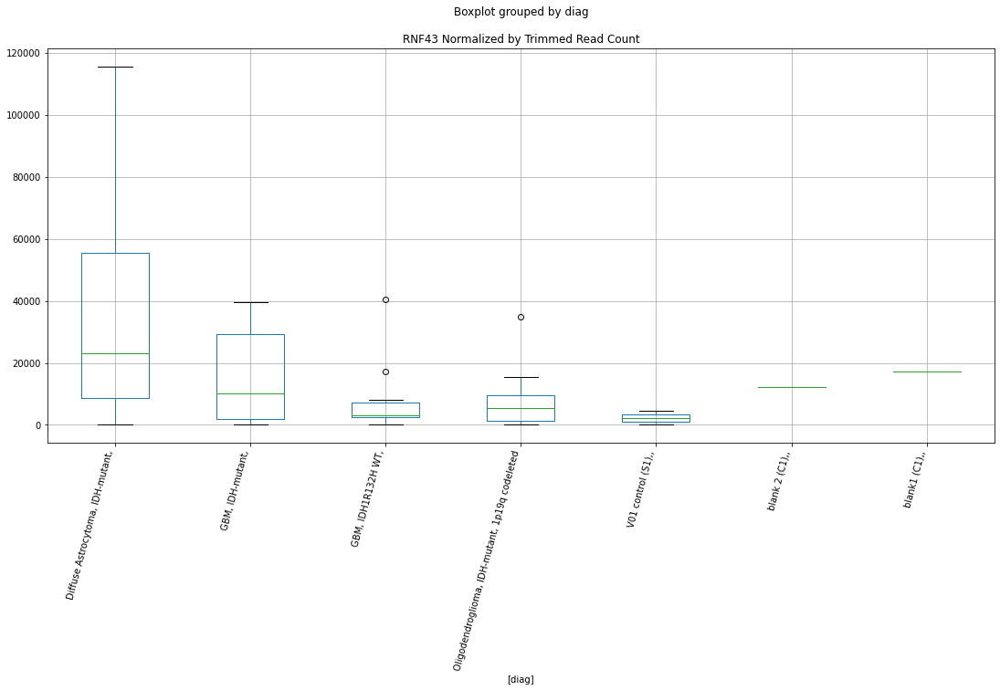

 p : 0.03888428721179978  ( t : 2.2278518585261393 ) :  D-plex  :  cutadapt2  :  PERP
Control and blanks
76        0.00
340    7045.86
Name: PERP, dtype: float64
208    881.8
Name: PERP, dtype: float64
472    1733.87
Name: PERP, dtype: float64


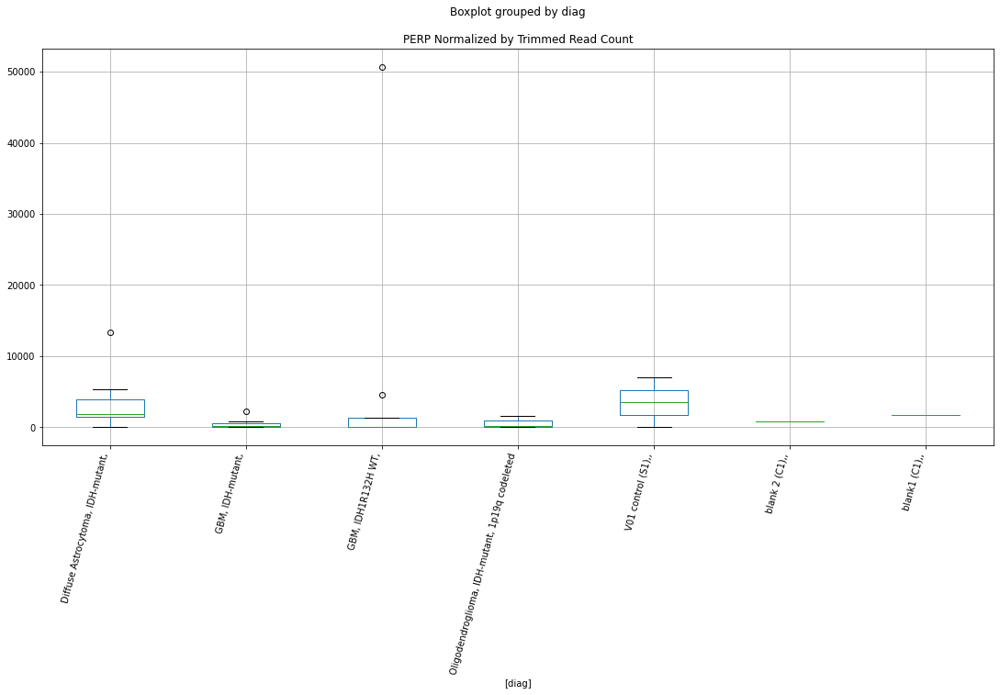

 p : 0.038887893021413725  ( t : 2.2278055336457108 ) :  D-plex  :  cutadapt2  :  RNA18SN5
Control and blanks
76     1.96e+06
340    1.15e+06
Name: RNA18SN5, dtype: float64
208    936472.76
Name: RNA18SN5, dtype: float64
472    1.11e+06
Name: RNA18SN5, dtype: float64


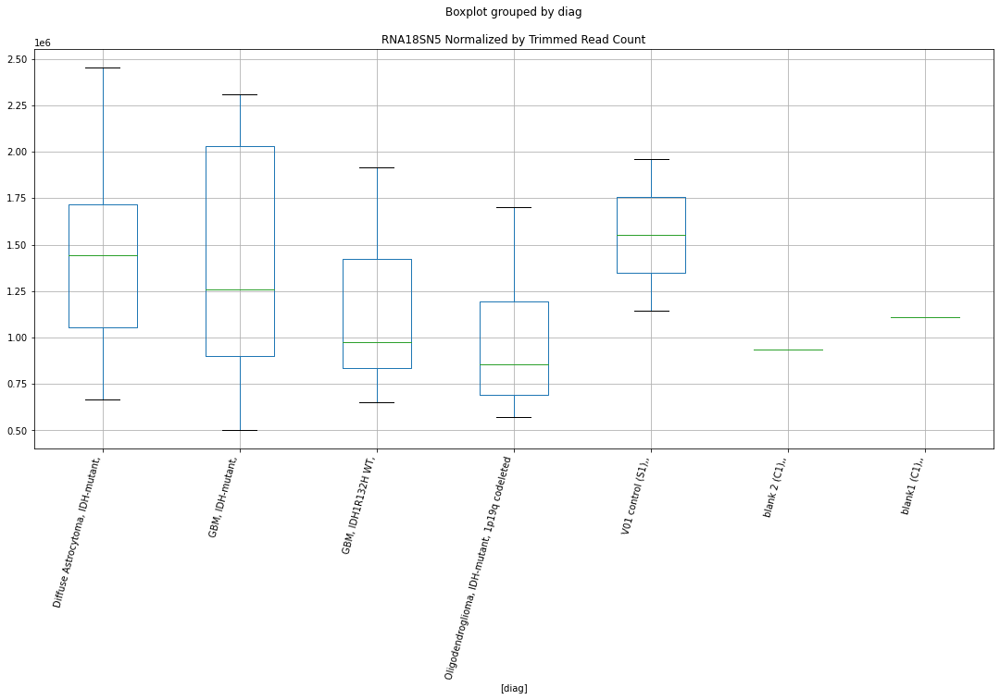

 p : 0.03893773677242744  ( t : 2.227165581463319 ) :  D-plex  :  bbduk2  :  SLAMF1
Control and blanks
73     0.0
337    0.0
Name: SLAMF1, dtype: float64
205    9133.64
Name: SLAMF1, dtype: float64
469    21294.98
Name: SLAMF1, dtype: float64


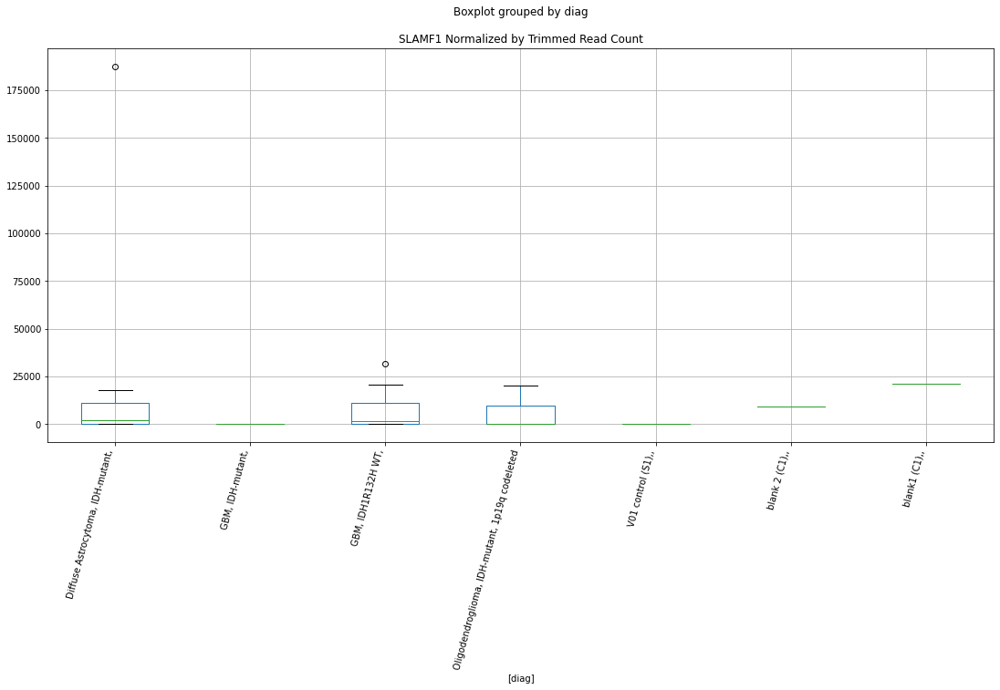

 p : 0.03894600200263084  ( t : 2.227059535725332 ) :  D-plex  :  cutadapt2  :  SLC25A11
Control and blanks
76     3030.46
340       0.00
Name: SLC25A11, dtype: float64
208    705.44
Name: SLC25A11, dtype: float64
472    0.0
Name: SLC25A11, dtype: float64


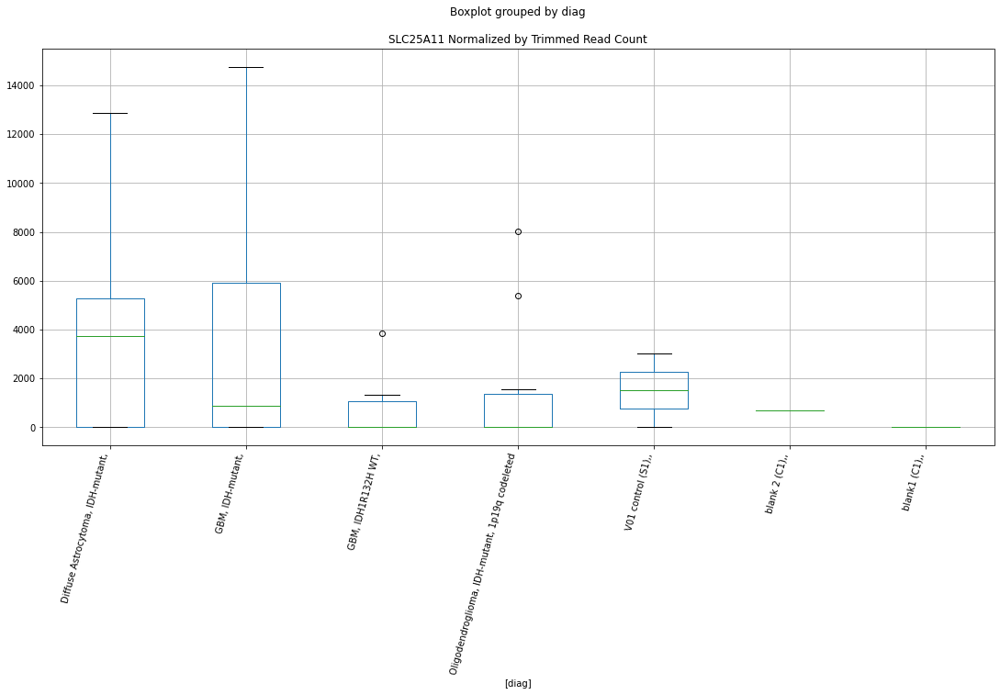

 p : 0.03894816749358661  ( t : 2.2270317551597922 ) :  D-plex  :  cutadapt2  :  SHROOM4
Control and blanks
76     0.0
340    0.0
Name: SHROOM4, dtype: float64
208    9170.73
Name: SHROOM4, dtype: float64
472    17338.68
Name: SHROOM4, dtype: float64


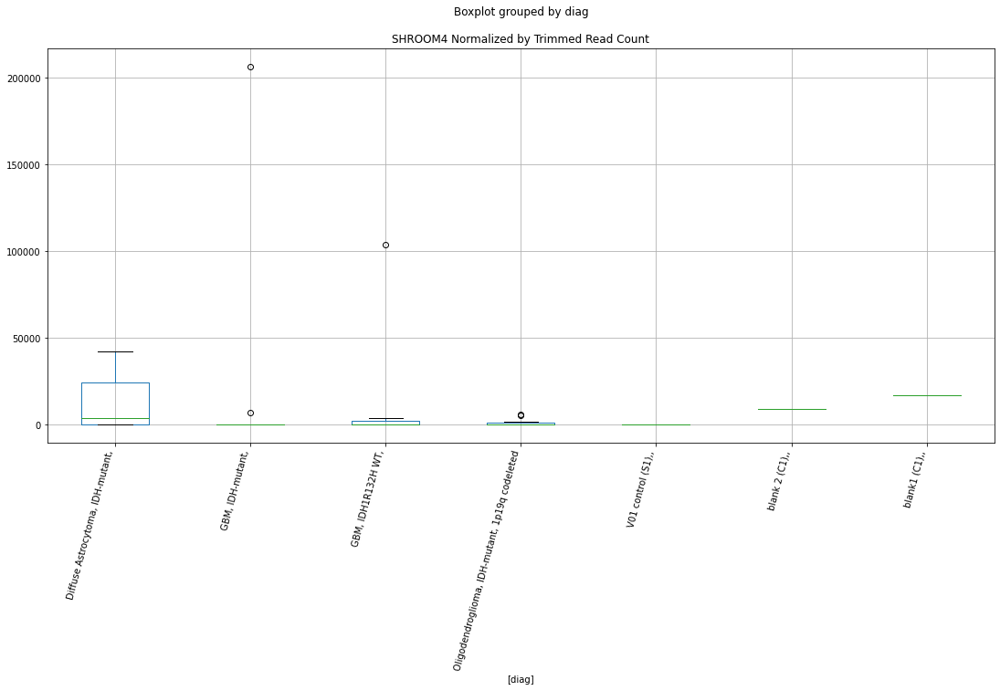

 p : 0.03895963167342961  ( t : 2.2268847076299956 ) :  D-plex  :  cutadapt2  :  SNRNP200
Control and blanks
76     0.0
340    0.0
Name: SNRNP200, dtype: float64
208    176.36
Name: SNRNP200, dtype: float64
472    577.96
Name: SNRNP200, dtype: float64


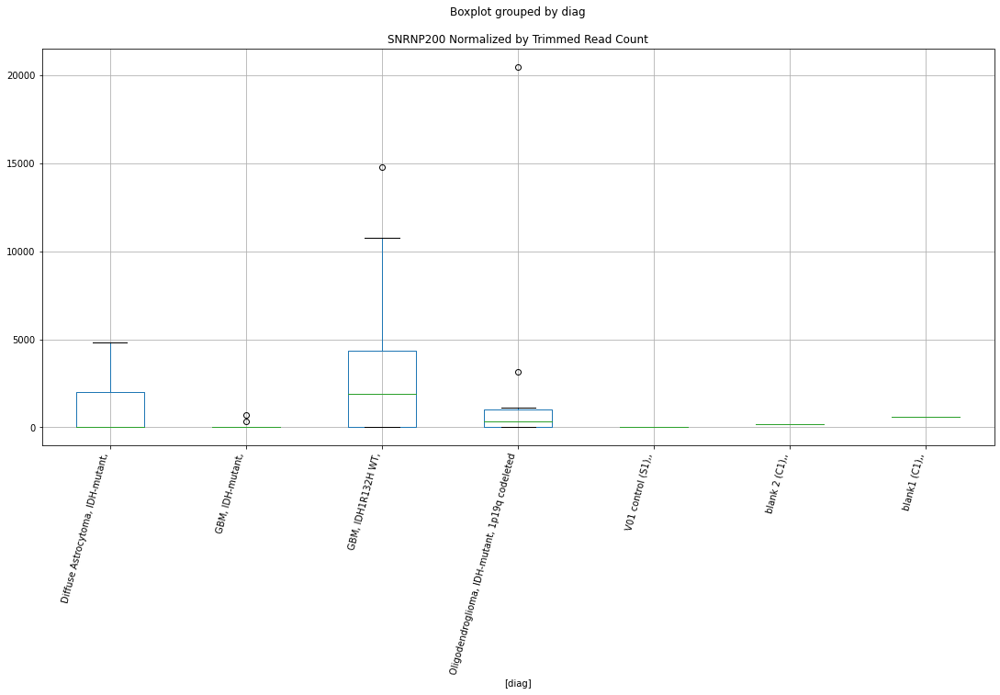

 p : 0.03898493849954921  ( t : 2.226560245709534 ) :  Lexogen  :  cutadapt2  :  SBF1
Control and blanks
82     0.0
346    0.0
Name: SBF1, dtype: float64
214    0.0
Name: SBF1, dtype: float64
478    0.0
Name: SBF1, dtype: float64


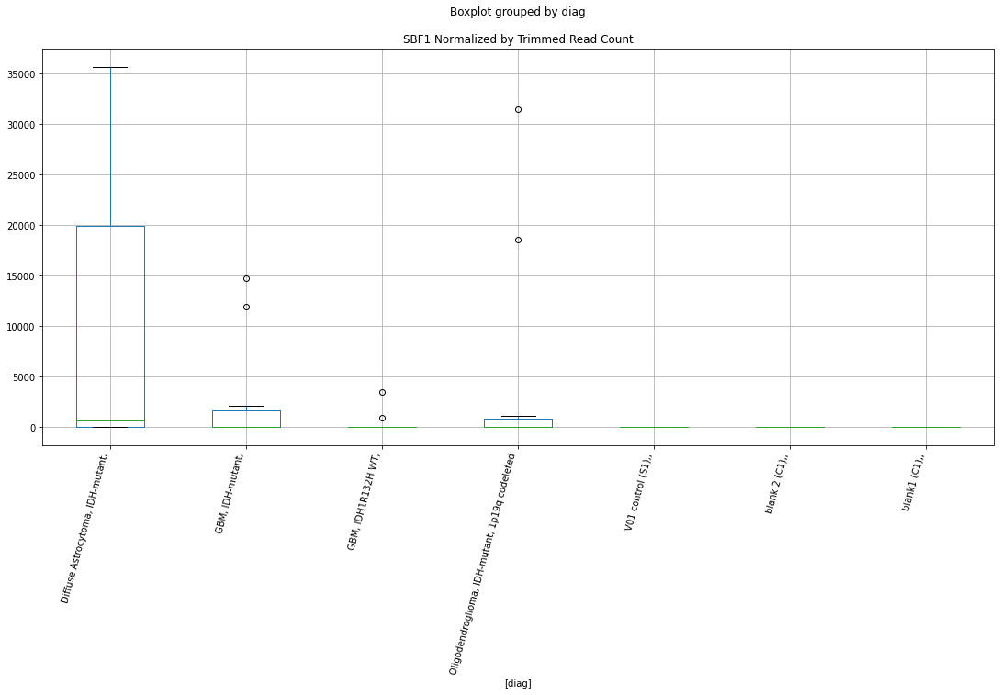

 p : 0.0389953814891709  ( t : 2.2264264113830965 ) :  D-plex  :  bbduk2  :  PHF23
Control and blanks
73     0.0
337    0.0
Name: PHF23, dtype: float64
205    4298.18
Name: PHF23, dtype: float64
469    5323.75
Name: PHF23, dtype: float64


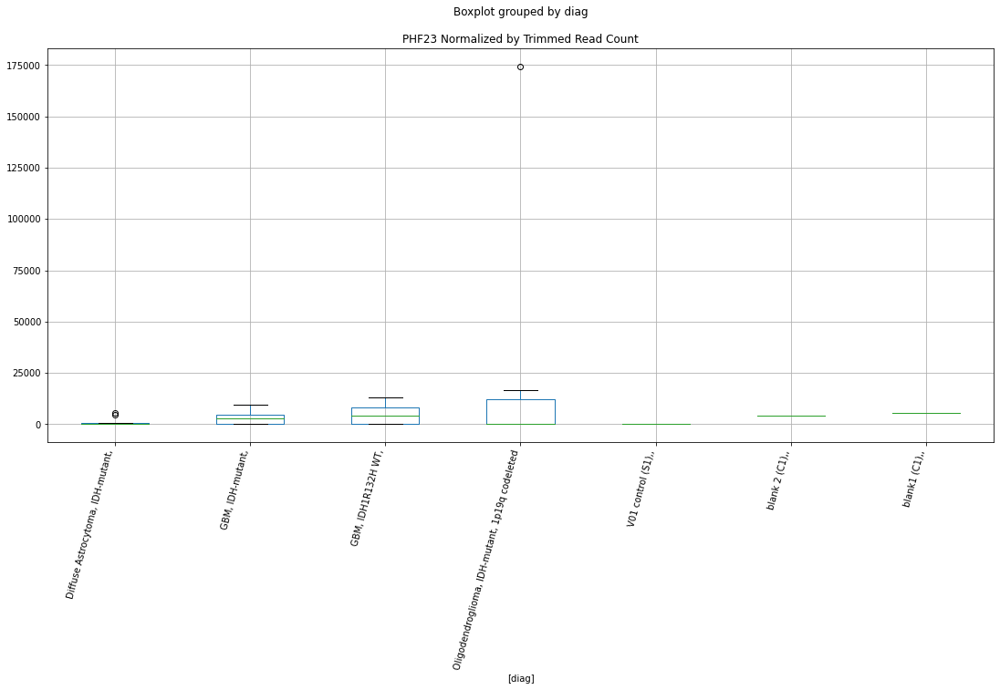

 p : 0.03904691767893384  ( t : 2.2257664214168864 ) :  D-plex  :  bbduk2  :  RAX
Control and blanks
73     5411.06
337       0.00
Name: RAX, dtype: float64
205    716.36
Name: RAX, dtype: float64
469    1774.58
Name: RAX, dtype: float64


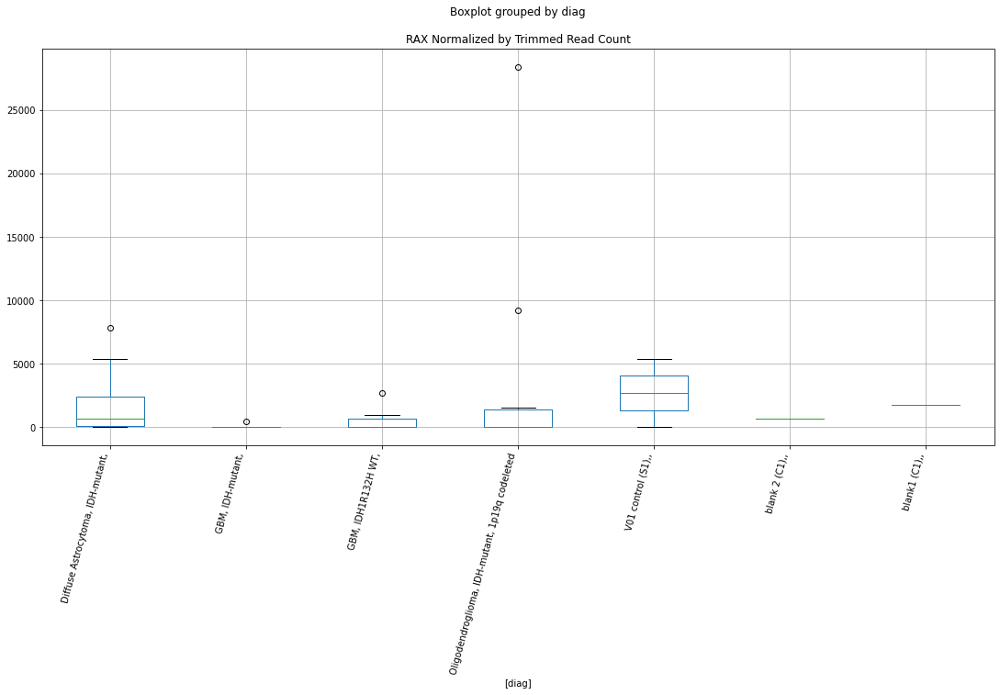

 p : 0.03909066976023768  ( t : 2.2252067465503536 ) :  Lexogen  :  cutadapt2  :  SMOC2
Control and blanks
82       0.00
346    841.74
Name: SMOC2, dtype: float64
214    19528.3
Name: SMOC2, dtype: float64
478    0.0
Name: SMOC2, dtype: float64


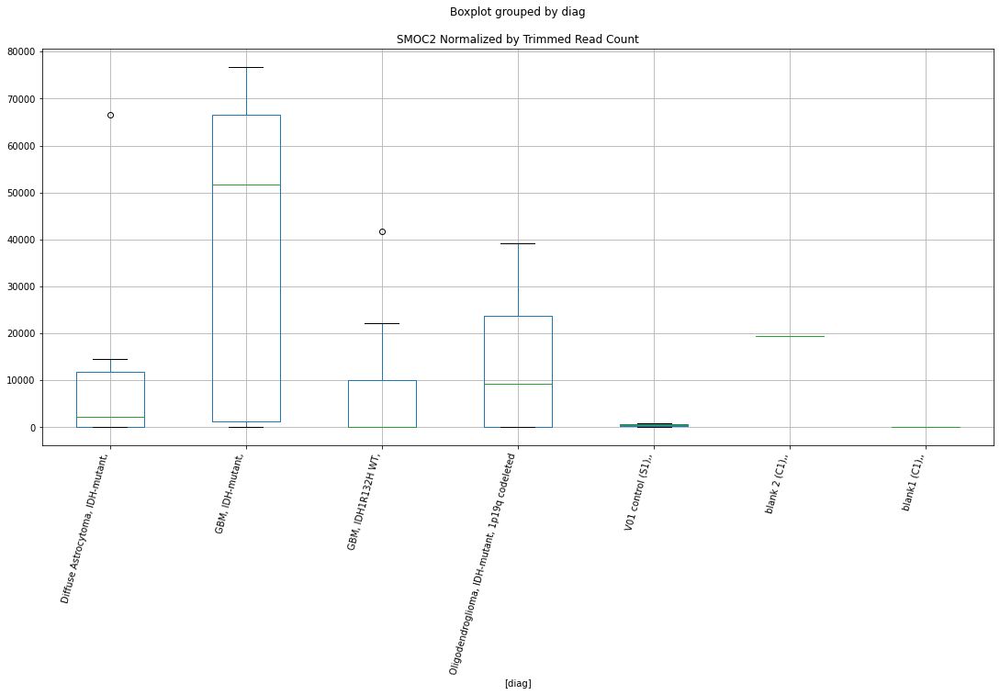

 p : 0.039091065952693474  ( t : 2.225201681107763 ) :  D-plex  :  bbduk2  :  RHBDF2
Control and blanks
73         0.00
337    16022.83
Name: RHBDF2, dtype: float64
205    8059.09
Name: RHBDF2, dtype: float64
469    0.0
Name: RHBDF2, dtype: float64


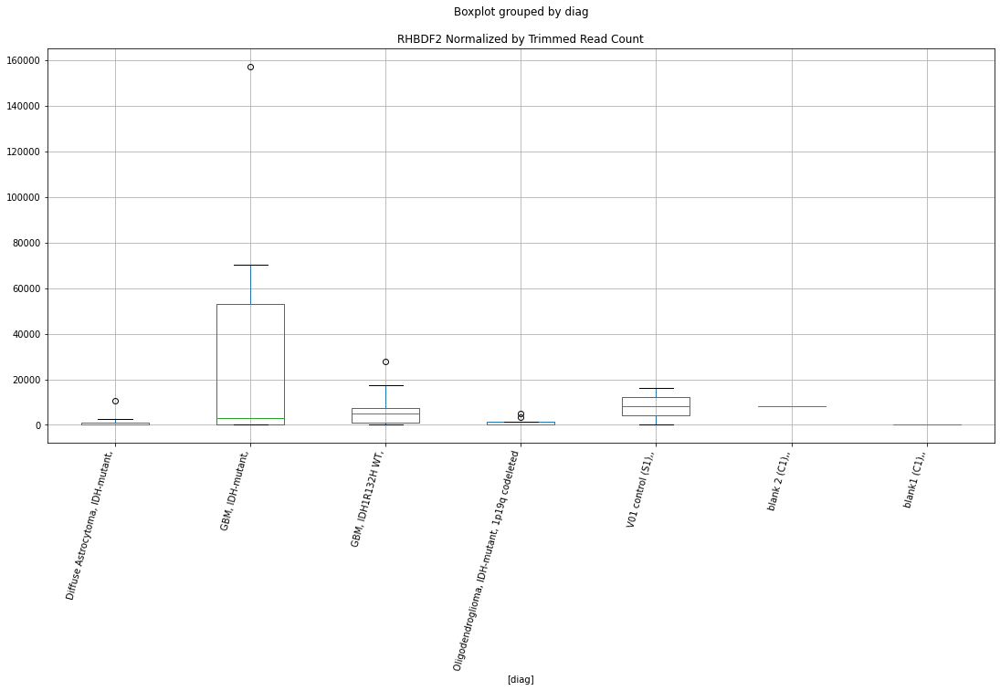

 p : 0.03909655934652653  ( t : 2.225131451246083 ) :  D-plex  :  bbduk2  :  SHISAL1
Control and blanks
73     773.01
337      0.00
Name: SHISAL1, dtype: float64
205    1253.64
Name: SHISAL1, dtype: float64
469    2957.64
Name: SHISAL1, dtype: float64


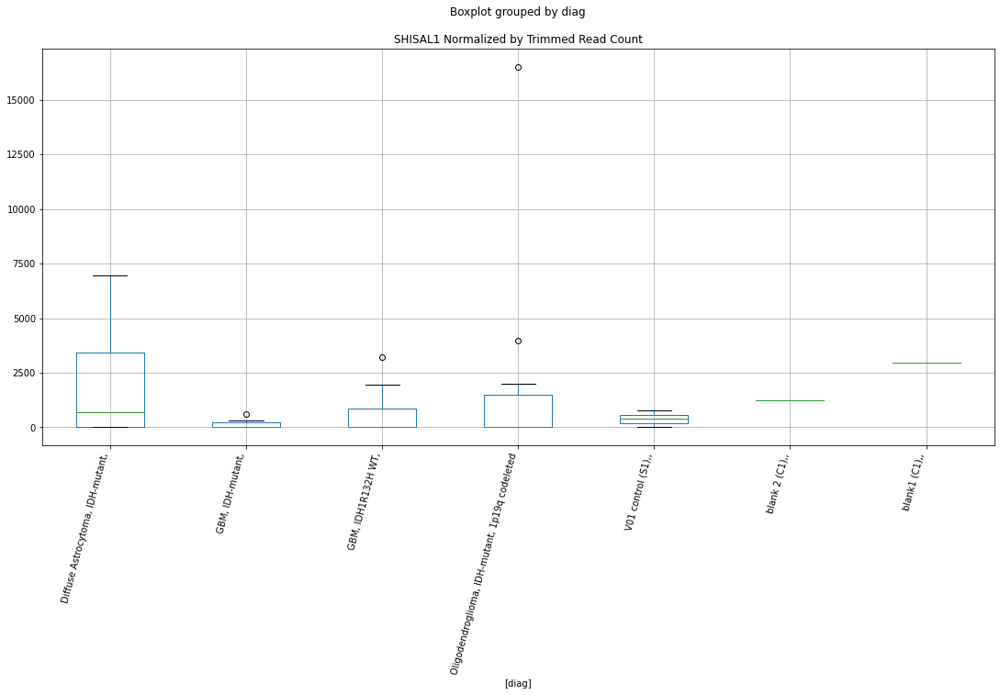

 p : 0.03917272494562737  ( t : 2.2241586531656865 ) :  D-plex  :  cutadapt2  :  RNA28SN1
Control and blanks
76     2.22e+06
340    1.33e+06
Name: RNA28SN1, dtype: float64
208    1.50e+06
Name: RNA28SN1, dtype: float64
472    1.40e+06
Name: RNA28SN1, dtype: float64


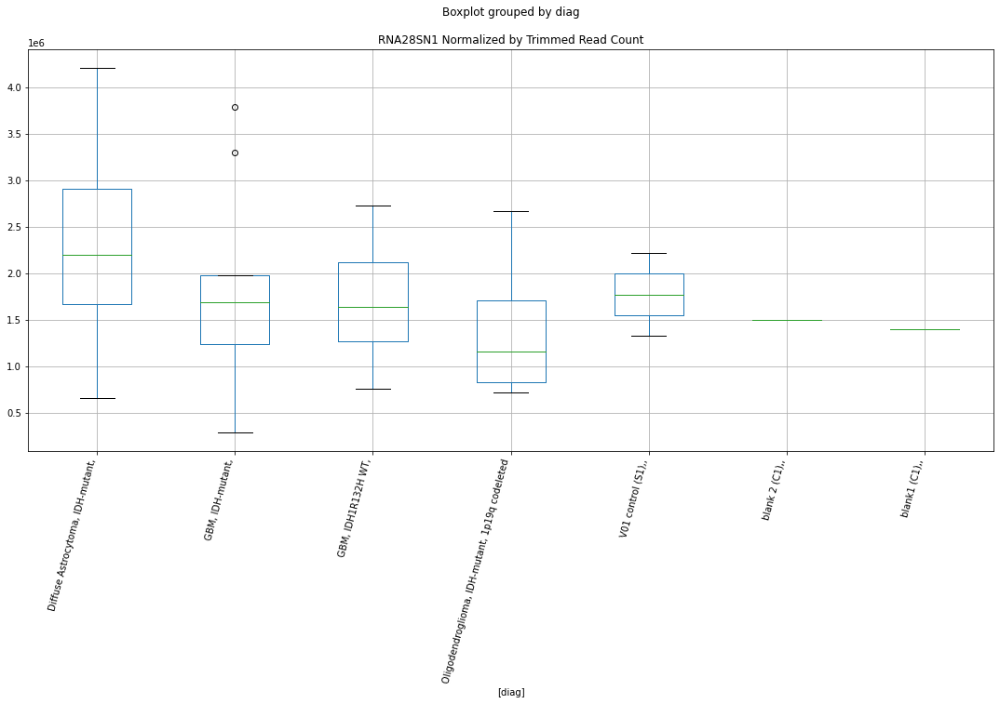

 p : 0.03918631127122688  ( t : 2.2239853096720443 ) :  D-plex  :  cutadapt2  :  PERP
Control and blanks
76        0.00
340    7045.86
Name: PERP, dtype: float64
208    881.8
Name: PERP, dtype: float64
472    1733.87
Name: PERP, dtype: float64


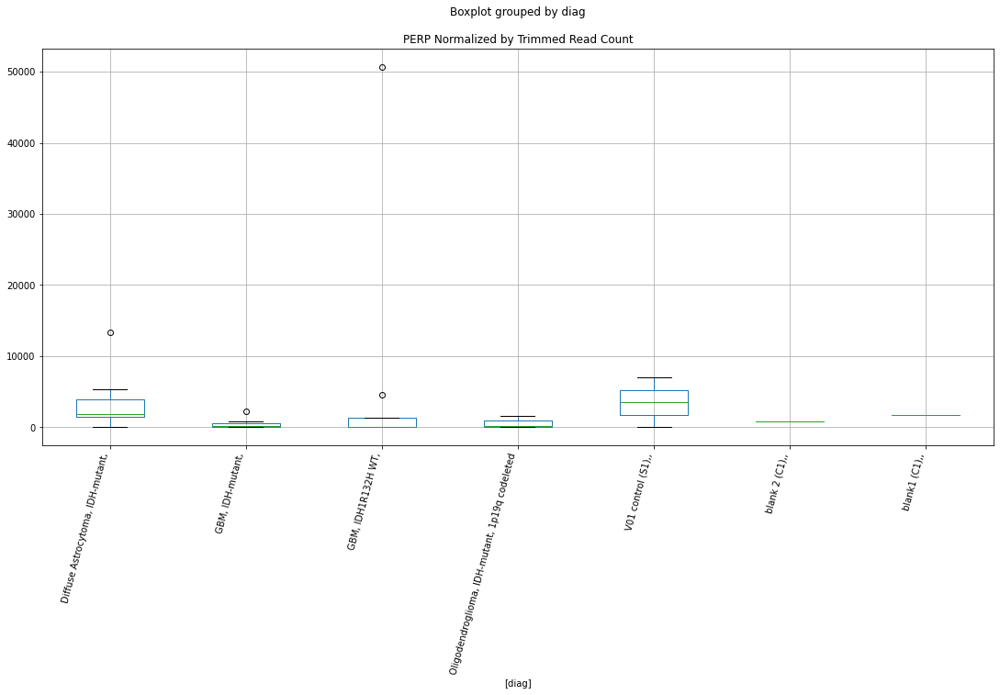

 p : 0.03932034027926651  ( t : 2.222278235825929 ) :  Lexogen  :  cutadapt2  :  PRKD3
Control and blanks
82       0.00
346    210.43
Name: PRKD3, dtype: float64
214    0.0
Name: PRKD3, dtype: float64
478    33244.47
Name: PRKD3, dtype: float64


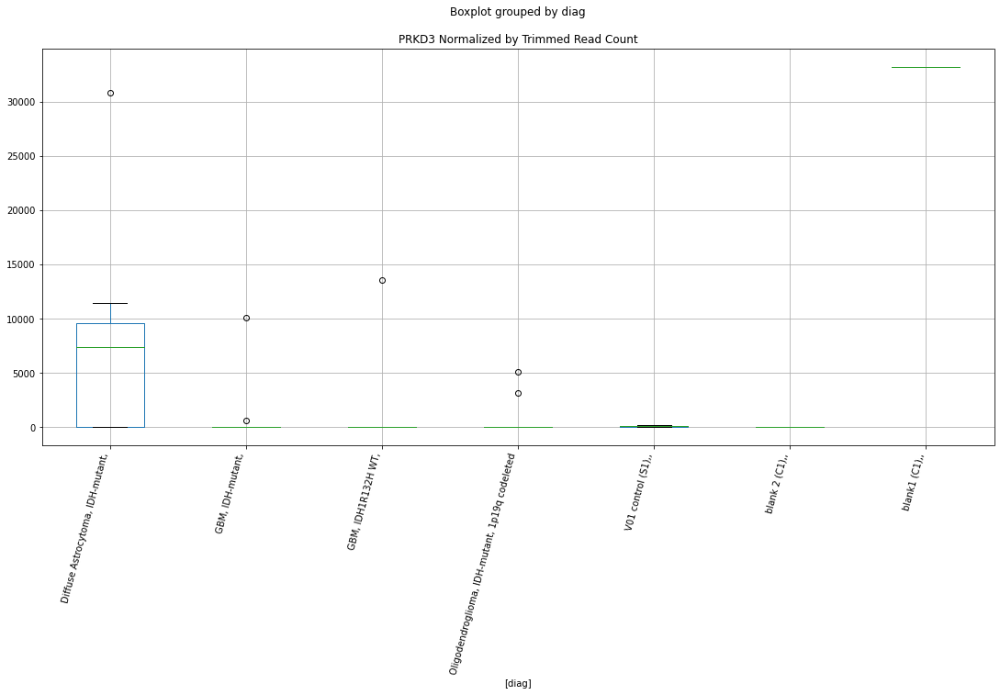

 p : 0.03935370752466122  ( t : 2.221854083287502 ) :  D-plex  :  cutadapt2  :  SLC25A3
Control and blanks
76     58336.29
340        0.00
Name: SLC25A3, dtype: float64
208    1410.88
Name: SLC25A3, dtype: float64
472    5201.6
Name: SLC25A3, dtype: float64


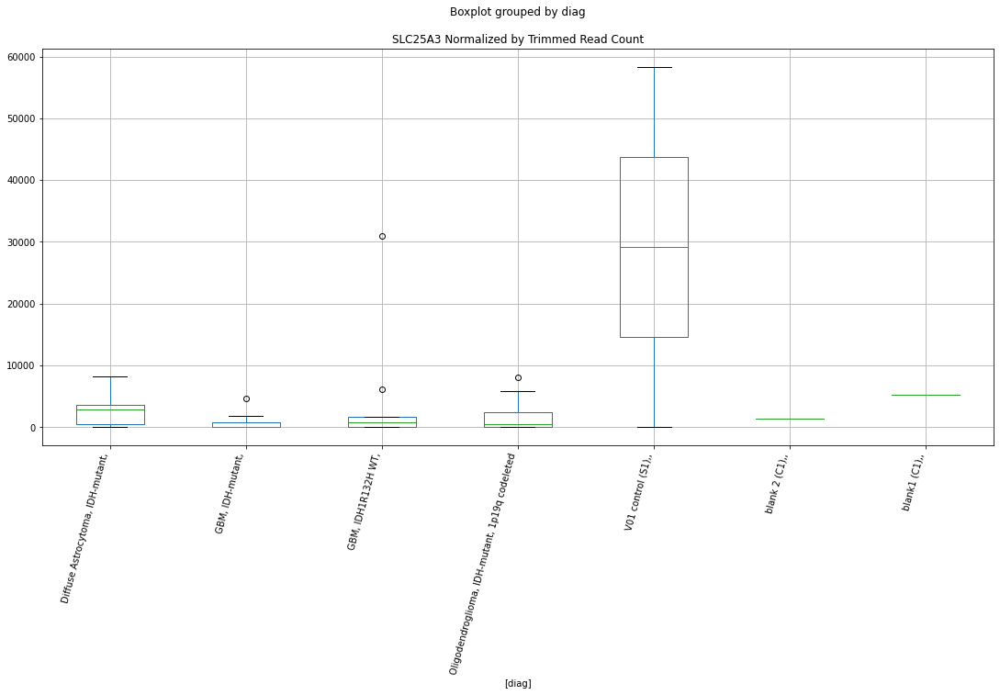

 p : 0.039375787587244374  ( t : 2.2215735913400723 ) :  D-plex  :  bbduk2  :  SLC26A6
Control and blanks
73     0.0
337    0.0
Name: SLC26A6, dtype: float64
205    895.45
Name: SLC26A6, dtype: float64
469    2957.64
Name: SLC26A6, dtype: float64


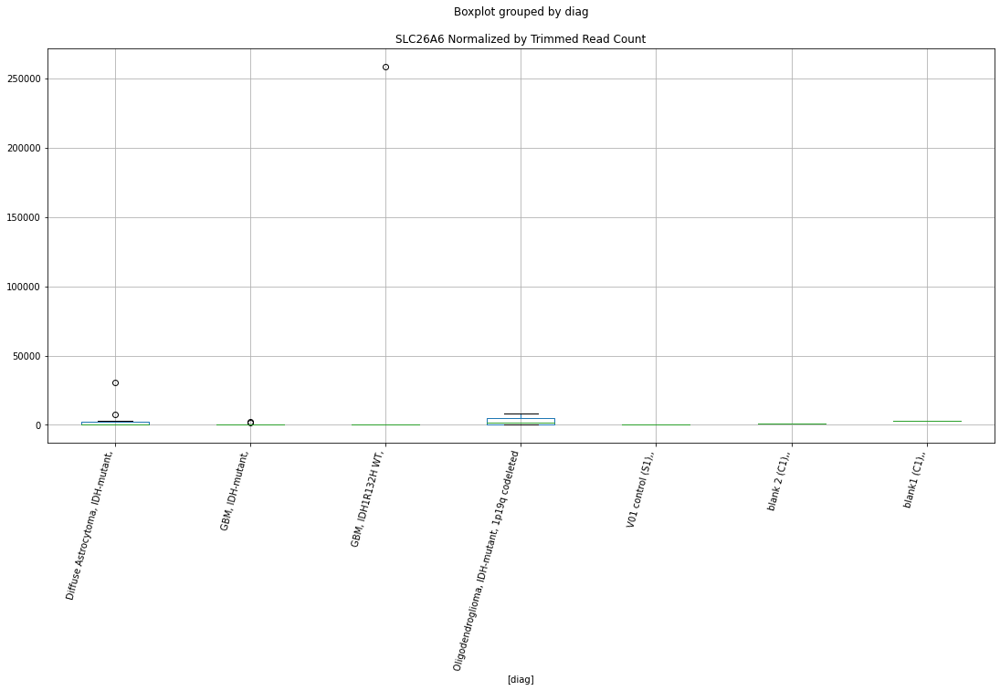

 p : 0.039431214899816554  ( t : 2.220870113080476 ) :  D-plex  :  bbduk2  :  SP4
Control and blanks
73      2319.03
337    28485.03
Name: SP4, dtype: float64
205    1253.64
Name: SP4, dtype: float64
469    0.0
Name: SP4, dtype: float64


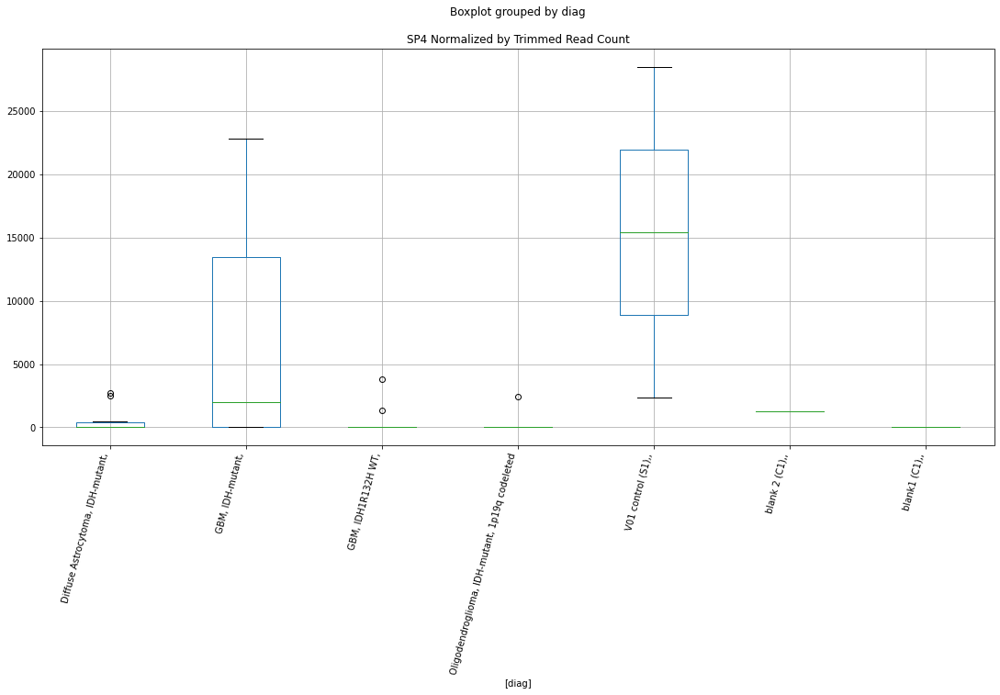

 p : 0.039448186262028576  ( t : 2.22065489611808 ) :  Lexogen  :  cutadapt2  :  RTN4R
Control and blanks
82     0.0
346    0.0
Name: RTN4R, dtype: float64
214    4068.4
Name: RTN4R, dtype: float64
478    0.0
Name: RTN4R, dtype: float64


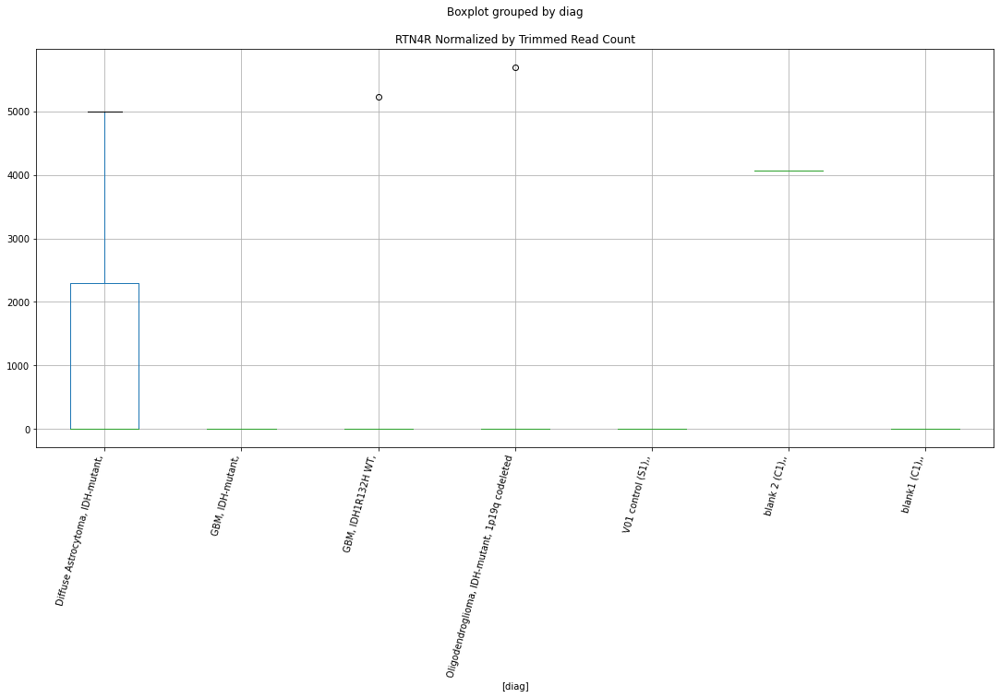

 p : 0.03946331525339807  ( t : 2.220463114420693 ) :  Lexogen  :  cutadapt2  :  SOX4
Control and blanks
82     0.0
346    0.0
Name: SOX4, dtype: float64
214    0.0
Name: SOX4, dtype: float64
478    0.0
Name: SOX4, dtype: float64


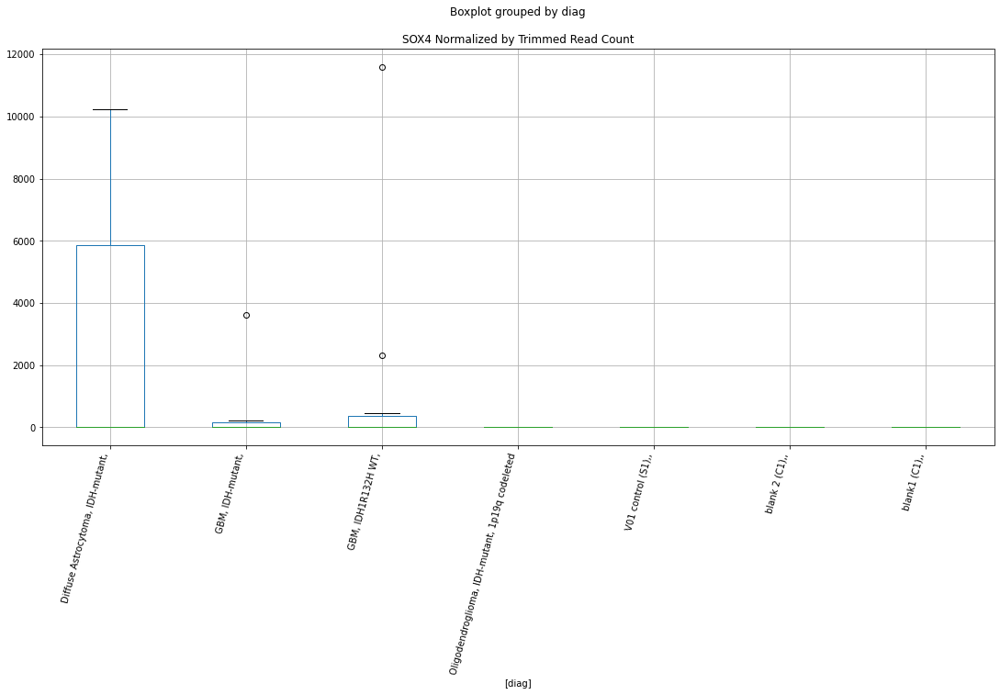

 p : 0.03946629972217444  ( t : 2.220425289982056 ) :  D-plex  :  bbduk2  :  PRDM7
Control and blanks
73     2319.03
337       0.00
Name: PRDM7, dtype: float64
205    3223.64
Name: PRDM7, dtype: float64
469    7098.33
Name: PRDM7, dtype: float64


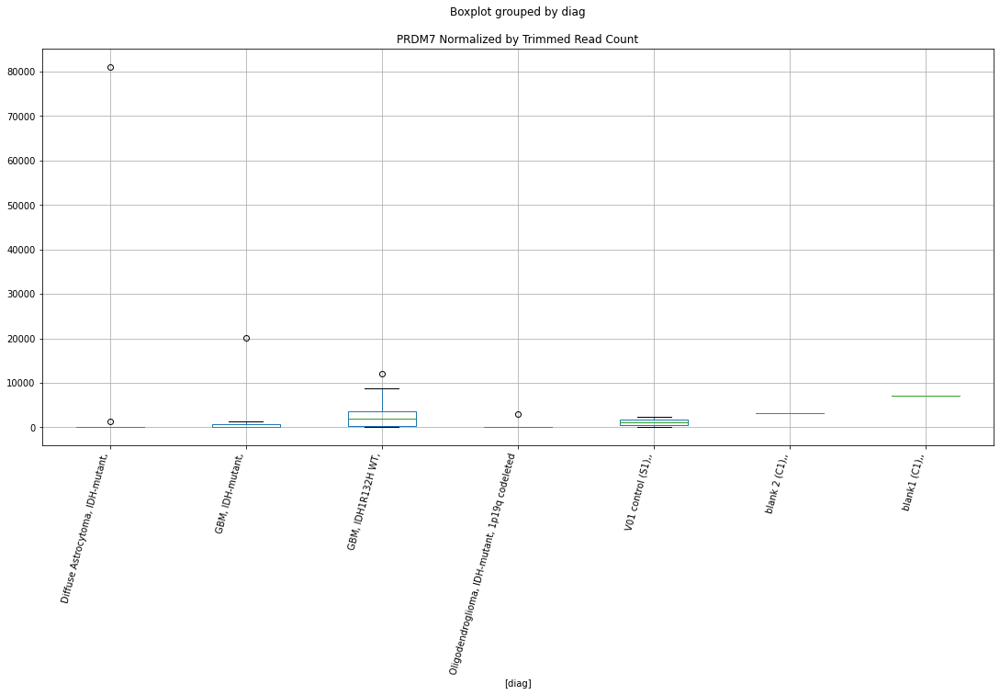

 p : 0.039500266750001546  ( t : 2.219994985402162 ) :  D-plex  :  bbduk2  :  QSOX1
Control and blanks
73         0.00
337    30265.35
Name: QSOX1, dtype: float64
205    358.18
Name: QSOX1, dtype: float64
469    591.53
Name: QSOX1, dtype: float64


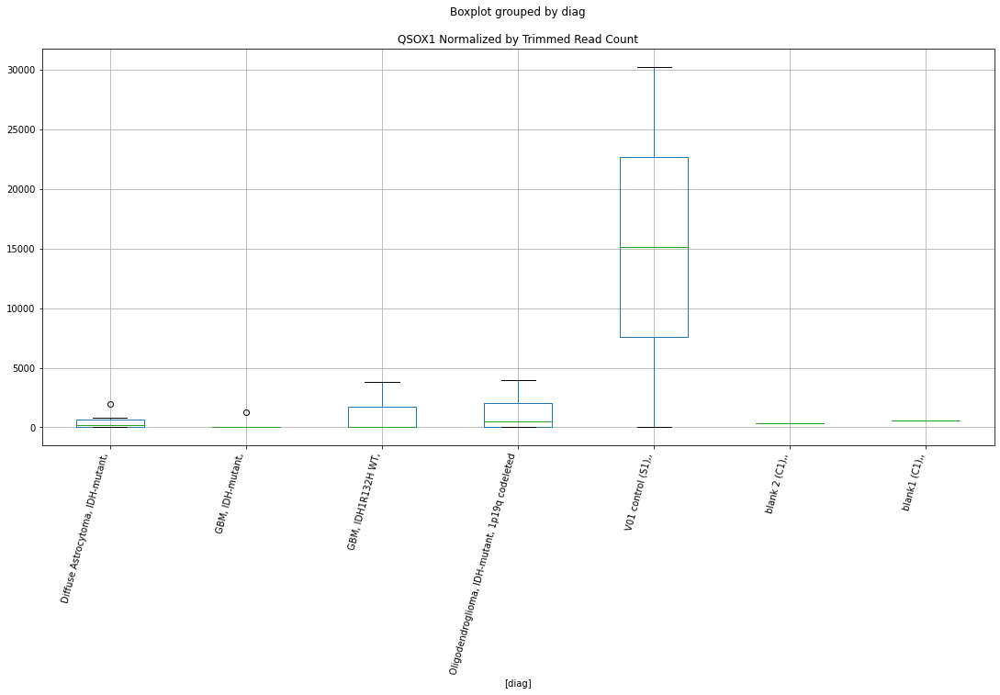

 p : 0.039503292377937815  ( t : 2.2199566723502433 ) :  Lexogen  :  bbduk2  :  ORAI2
Control and blanks
79       0.00
343    849.26
Name: ORAI2, dtype: float64
211    0.0
Name: ORAI2, dtype: float64
475    0.0
Name: ORAI2, dtype: float64


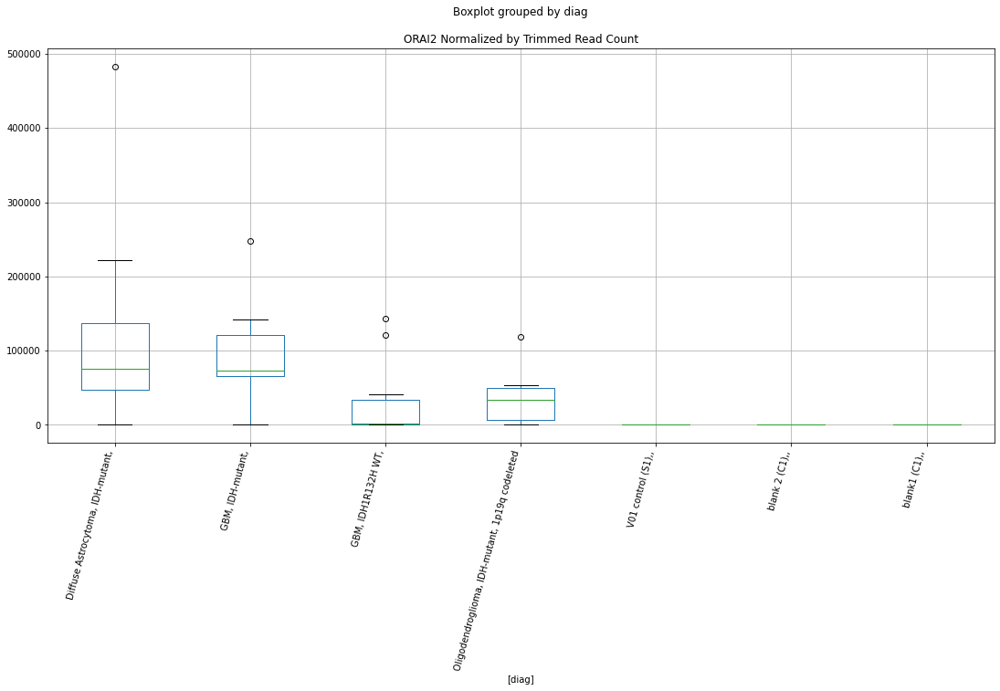

 p : 0.039505417111332486  ( t : 2.219929768798486 ) :  D-plex  :  cutadapt2  :  SMIM24
Control and blanks
76     0.0
340    0.0
Name: SMIM24, dtype: float64
208    176.36
Name: SMIM24, dtype: float64
472    0.0
Name: SMIM24, dtype: float64


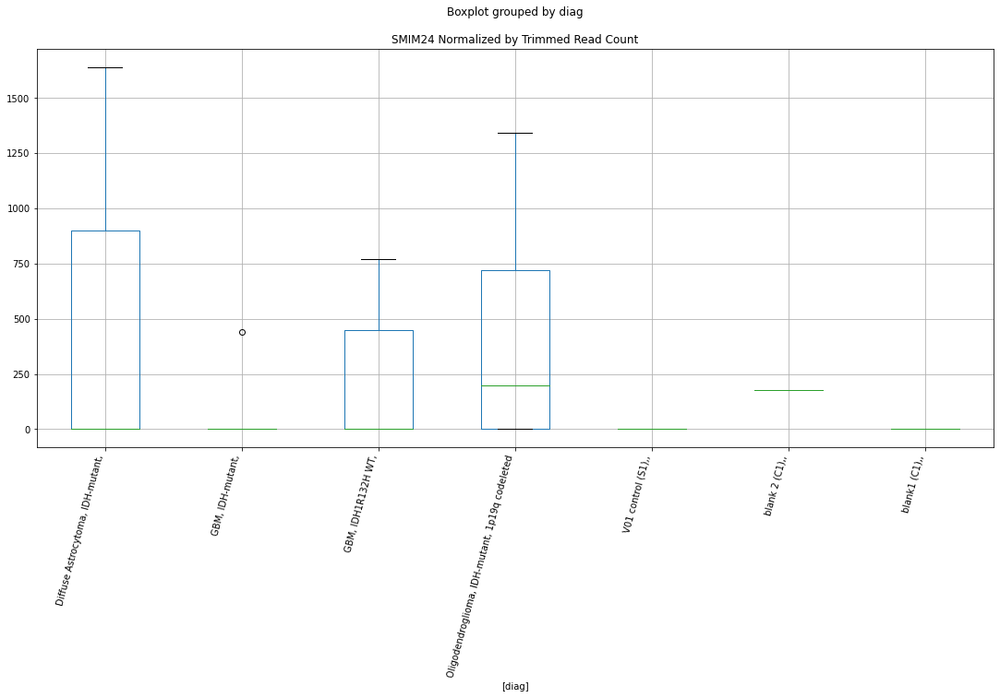

 p : 0.039521441954175215  ( t : 2.219726903778513 ) :  D-plex  :  cutadapt2  :  RNA28SN5
Control and blanks
76     2.22e+06
340    1.33e+06
Name: RNA28SN5, dtype: float64
208    1.50e+06
Name: RNA28SN5, dtype: float64
472    1.39e+06
Name: RNA28SN5, dtype: float64


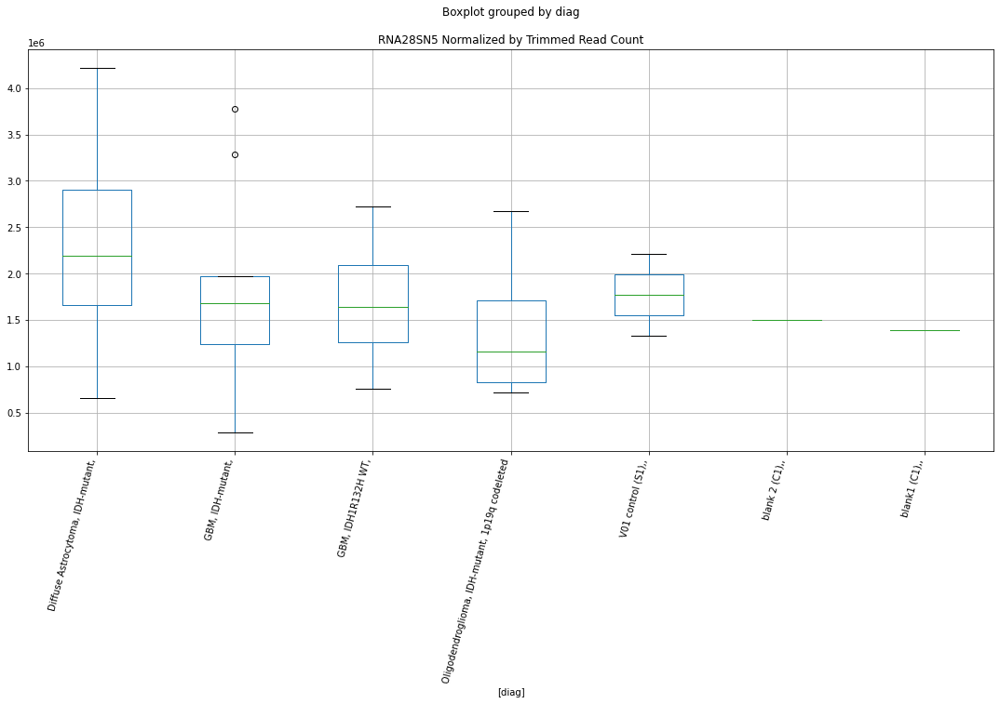

 p : 0.03954880408269091  ( t : 2.219380690326066 ) :  D-plex  :  bbduk2  :  SNX5
Control and blanks
73     0.0
337    0.0
Name: SNX5, dtype: float64
205    537.27
Name: SNX5, dtype: float64
469    3549.16
Name: SNX5, dtype: float64


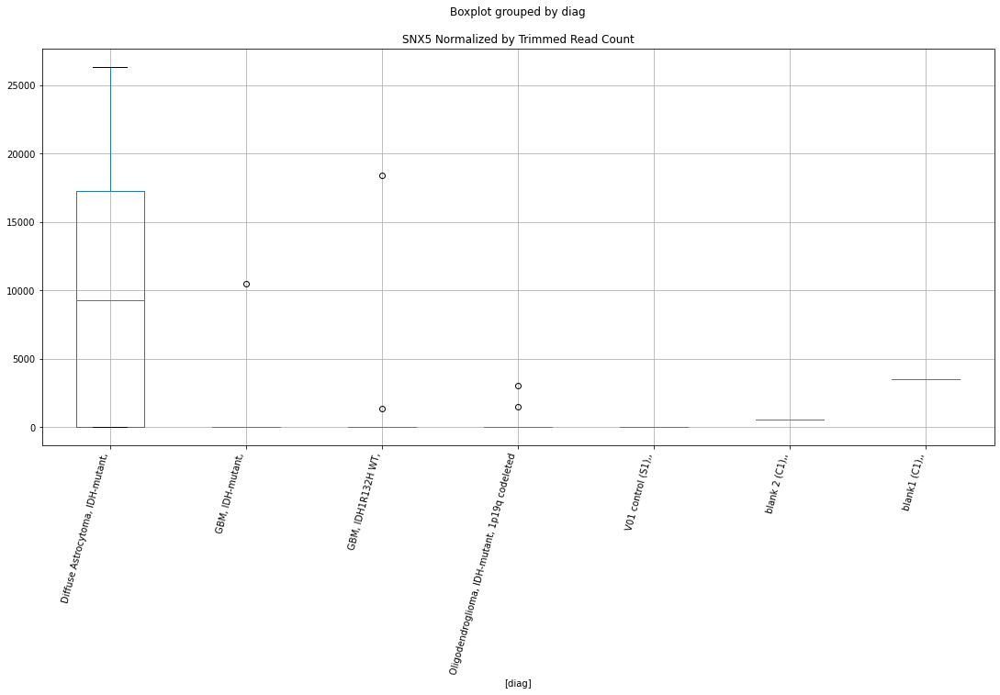

 p : 0.03955533178000472  ( t : 2.219298127829938 ) :  D-plex  :  bbduk2  :  SLC4A3
Control and blanks
73        0.00
337    4450.79
Name: SLC4A3, dtype: float64
205    12894.55
Name: SLC4A3, dtype: float64
469    20111.93
Name: SLC4A3, dtype: float64


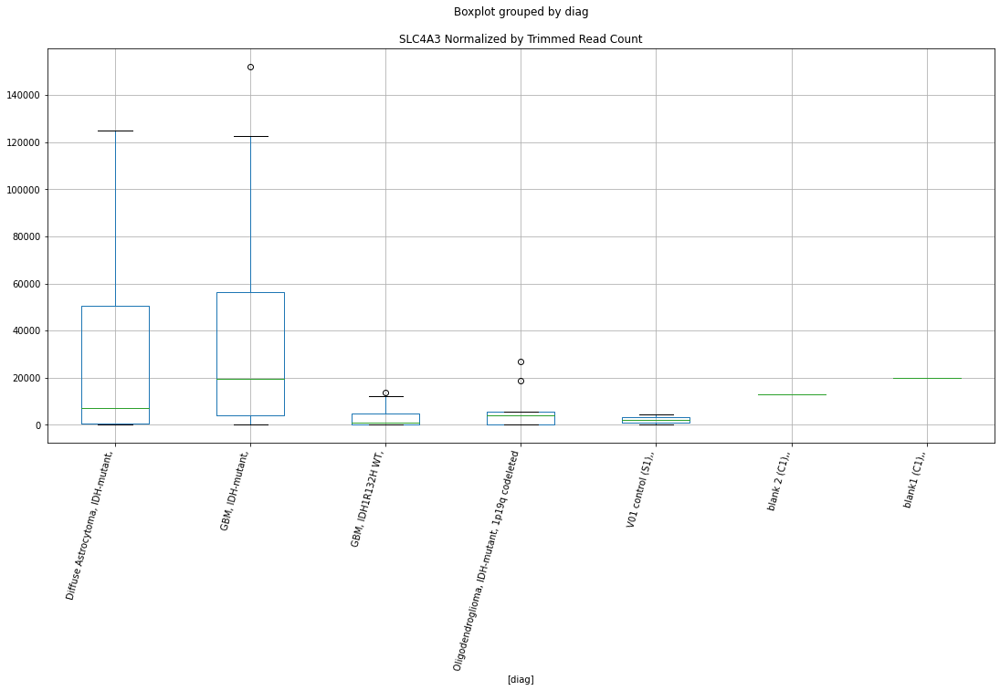

 p : 0.039566468927078435  ( t : 2.2191572938228696 ) :  D-plex  :  bbduk2  :  PERP
Control and blanks
73        0.00
337    7121.26
Name: PERP, dtype: float64
205    1253.64
Name: PERP, dtype: float64
469    1774.58
Name: PERP, dtype: float64


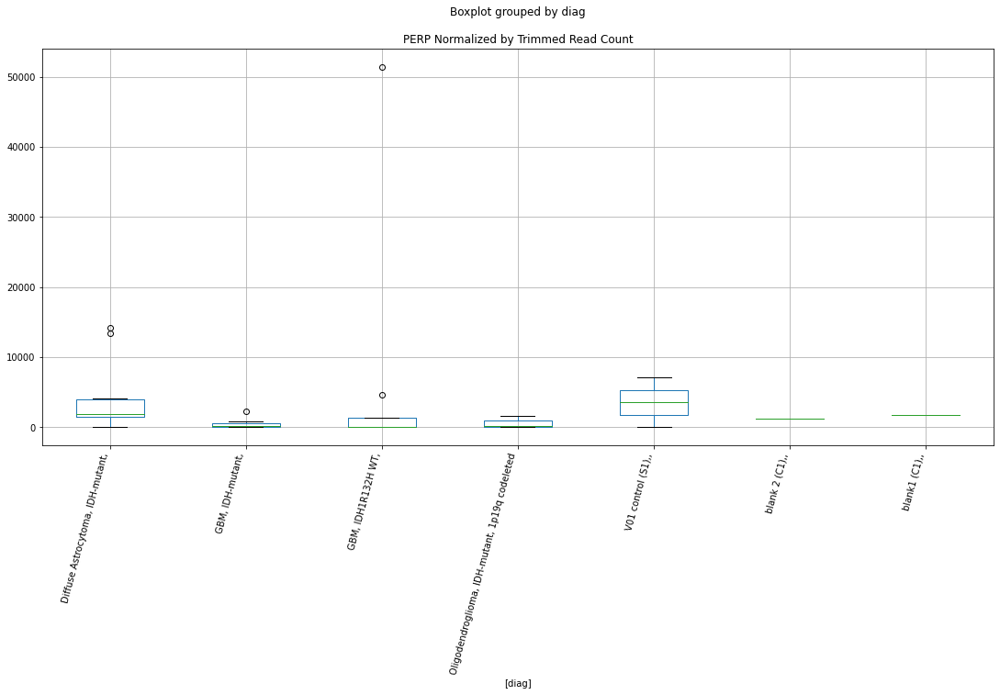

 p : 0.039585425528995175  ( t : 2.2189176633095133 ) :  D-plex  :  bbduk2  :  SMIM24
Control and blanks
73     0.0
337    0.0
Name: SMIM24, dtype: float64
205    179.09
Name: SMIM24, dtype: float64
469    0.0
Name: SMIM24, dtype: float64


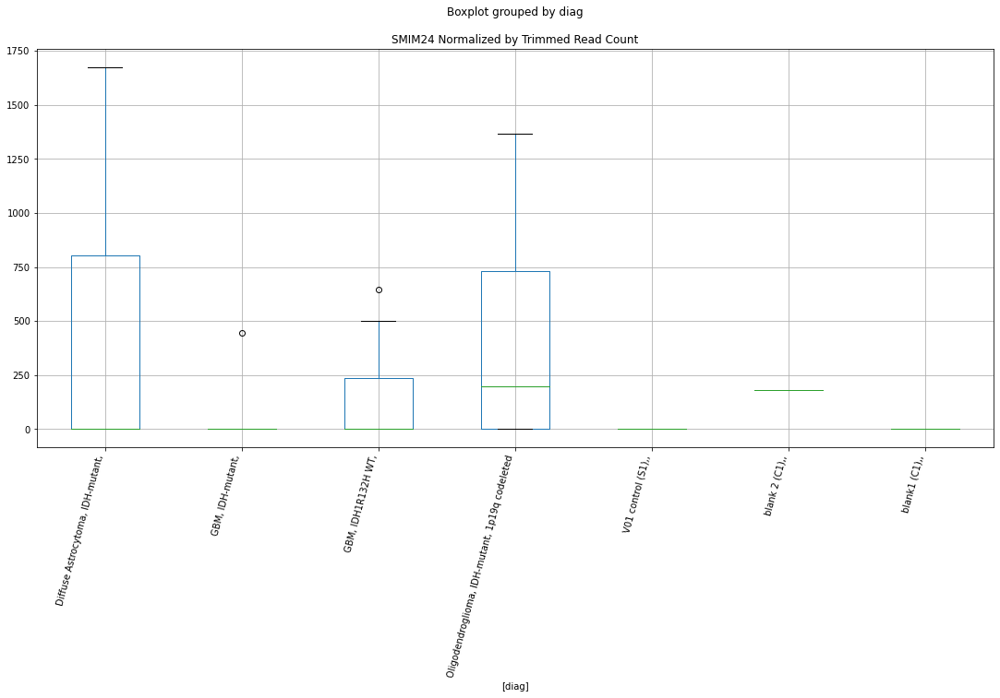

 p : 0.03961310011705693  ( t : 2.2185680182006977 ) :  D-plex  :  bbduk2  :  P2RX2
Control and blanks
73     0.0
337    0.0
Name: P2RX2, dtype: float64
205    3223.64
Name: P2RX2, dtype: float64
469    7689.86
Name: P2RX2, dtype: float64


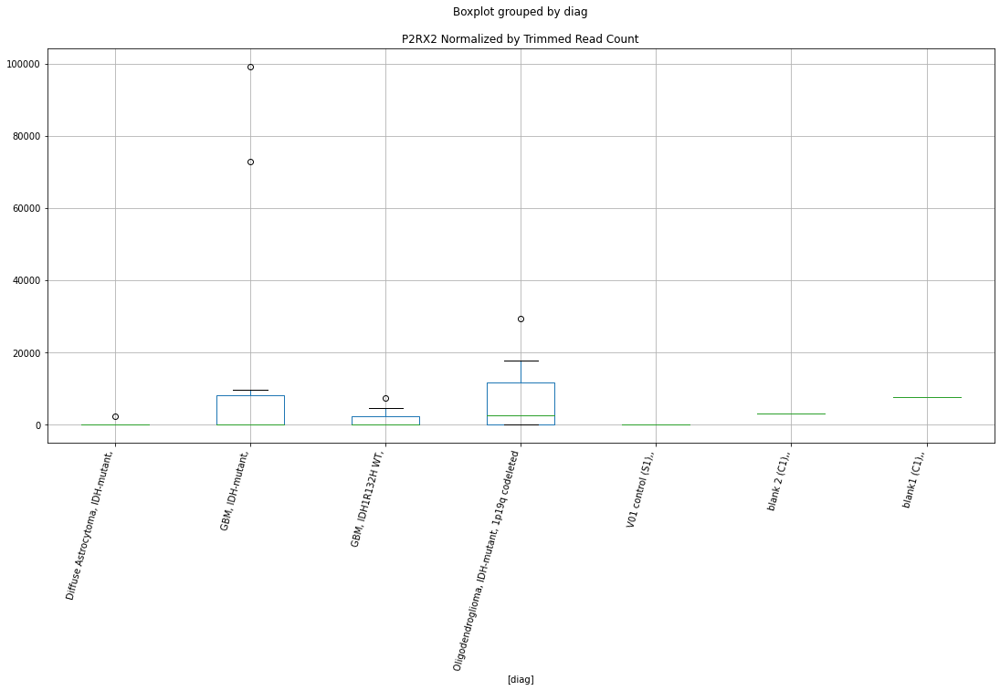

 p : 0.03963470893457112  ( t : 2.218295165211584 ) :  D-plex  :  bbduk2  :  RHCE
Control and blanks
73      7730.08
337    65871.64
Name: RHCE, dtype: float64
205    4477.27
Name: RHCE, dtype: float64
469    4732.22
Name: RHCE, dtype: float64


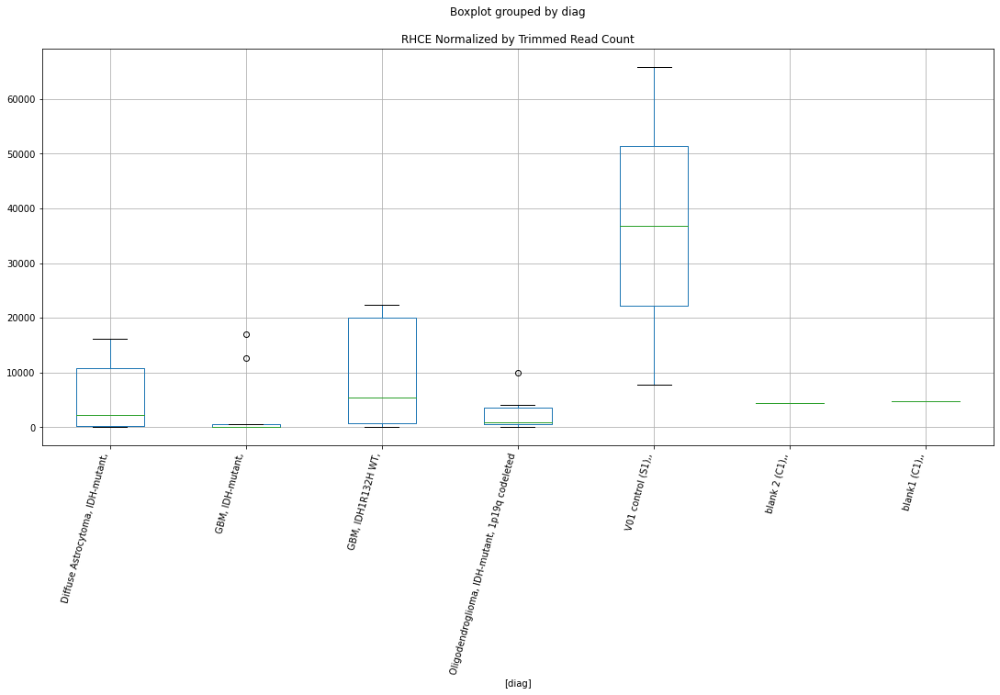

 p : 0.03965006856879221  ( t : 2.2181013034163346 ) :  D-plex  :  cutadapt2  :  SNX5
Control and blanks
76     0.0
340    0.0
Name: SNX5, dtype: float64
208    529.08
Name: SNX5, dtype: float64
472    3467.74
Name: SNX5, dtype: float64


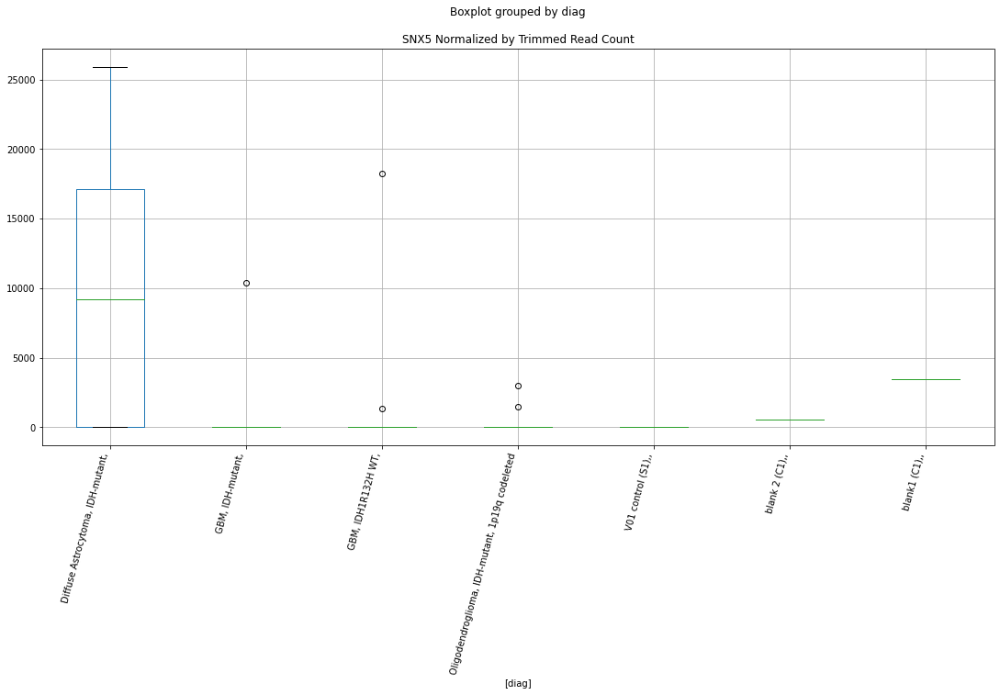

 p : 0.03968815571840818  ( t : 2.2176208839483285 ) :  D-plex  :  bbduk2  :  PDE6H
Control and blanks
73     1546.02
337    1780.31
Name: PDE6H, dtype: float64
205    113901.85
Name: PDE6H, dtype: float64
469    642398.67
Name: PDE6H, dtype: float64


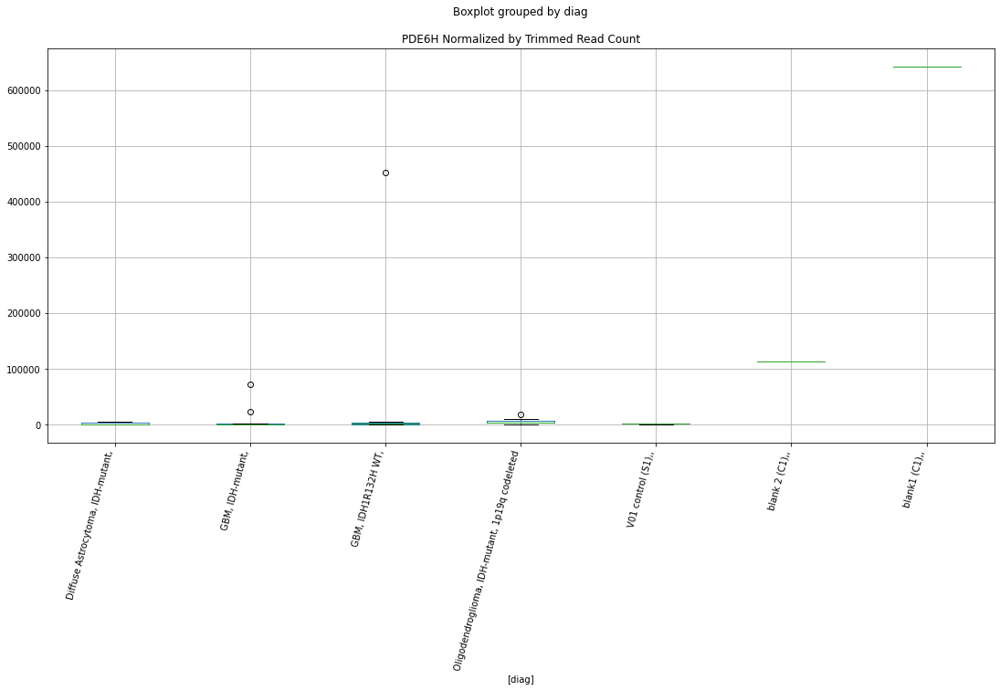

 p : 0.03969959161307675  ( t : 2.2174767179227026 ) :  D-plex  :  cutadapt2  :  PRDM7
Control and blanks
76     2272.84
340       0.00
Name: PRDM7, dtype: float64
208    3174.48
Name: PRDM7, dtype: float64
472    6935.47
Name: PRDM7, dtype: float64


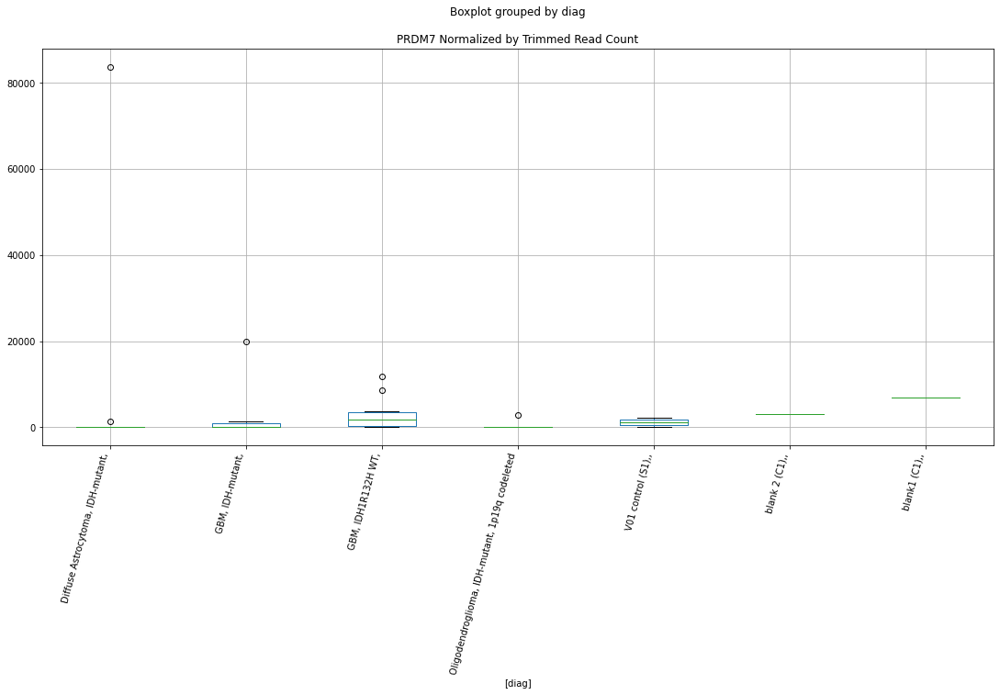

 p : 0.03971231908320853  ( t : 2.217316314630566 ) :  D-plex  :  cutadapt2  :  PRKX
Control and blanks
76     1515.23
340       0.00
Name: PRKX, dtype: float64
208    36859.29
Name: PRKX, dtype: float64
472    0.0
Name: PRKX, dtype: float64


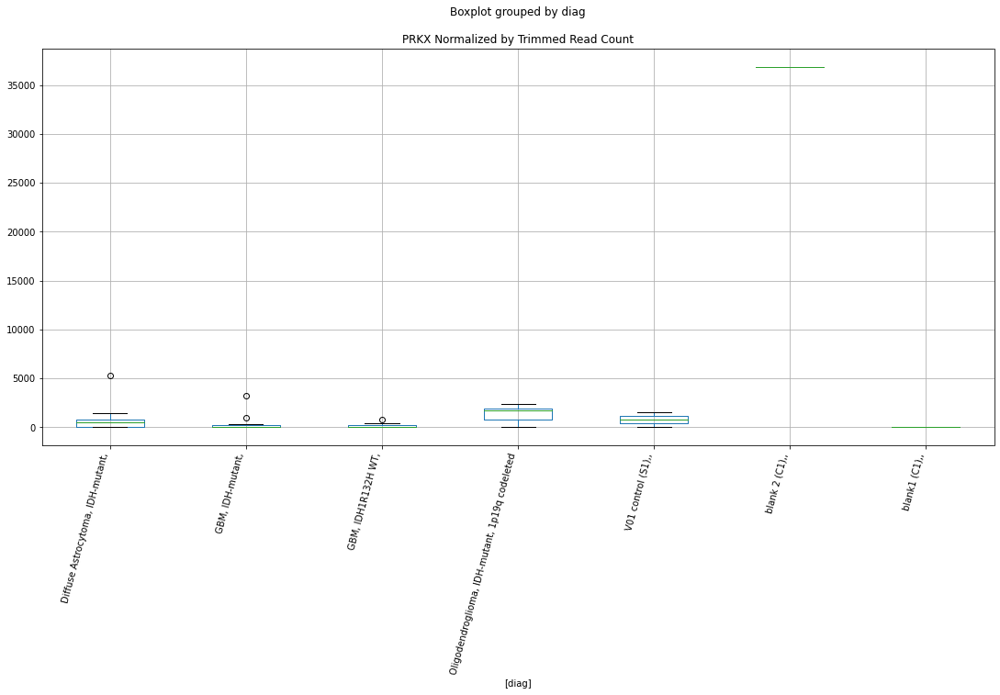

 p : 0.03971801671797196  ( t : 2.2172445231175573 ) :  D-plex  :  bbduk2  :  SLC31A1
Control and blanks
73     60294.66
337        0.00
Name: SLC31A1, dtype: float64
205    2149.09
Name: SLC31A1, dtype: float64
469    255539.8
Name: SLC31A1, dtype: float64


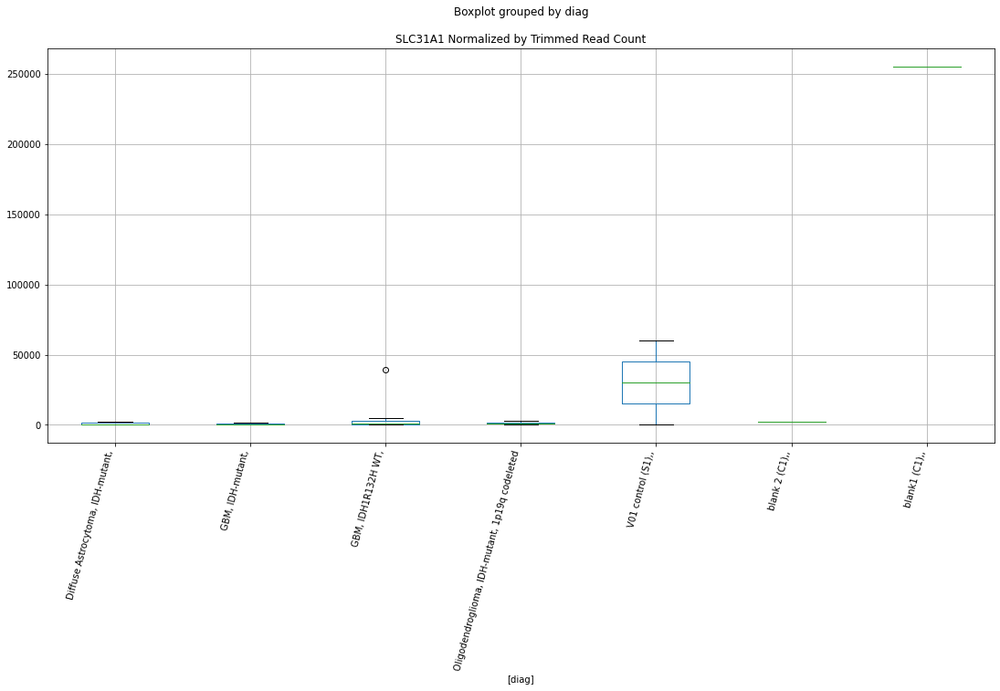

 p : 0.03984079116420054  ( t : 2.215699833820289 ) :  D-plex  :  bbduk2  :  PELI3
Control and blanks
73        0.00
337    5340.94
Name: PELI3, dtype: float64
205    20058.19
Name: PELI3, dtype: float64
469    24844.15
Name: PELI3, dtype: float64


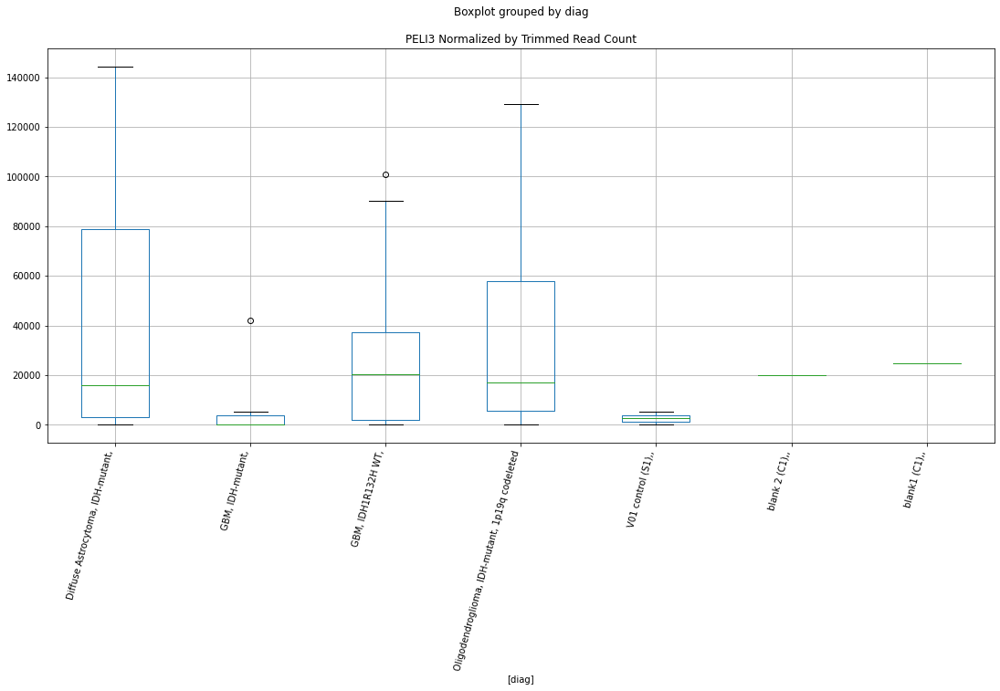

 p : 0.03986962187529198  ( t : 2.215337734507515 ) :  D-plex  :  cutadapt2  :  RRAGD
Control and blanks
76     0.0
340    0.0
Name: RRAGD, dtype: float64
208    2469.04
Name: RRAGD, dtype: float64
472    3467.74
Name: RRAGD, dtype: float64


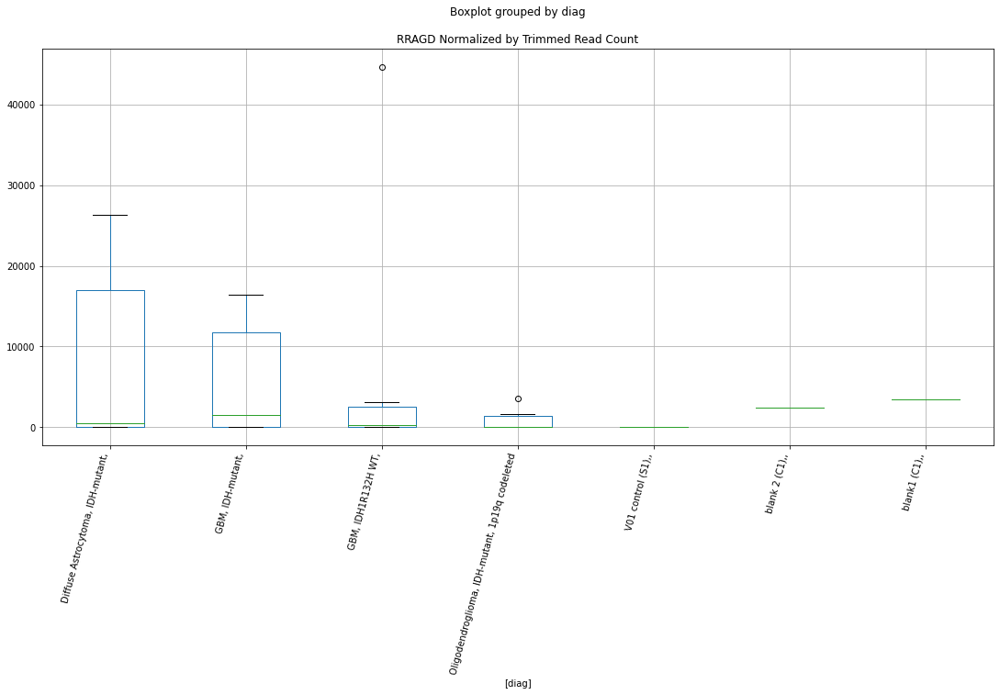

 p : 0.04001942405520076  ( t : 2.213460161755457 ) :  D-plex  :  cutadapt2  :  PCDHGB1
Control and blanks
76     0.0
340    0.0
Name: PCDHGB1, dtype: float64
208    2469.04
Name: PCDHGB1, dtype: float64
472    1733.87
Name: PCDHGB1, dtype: float64


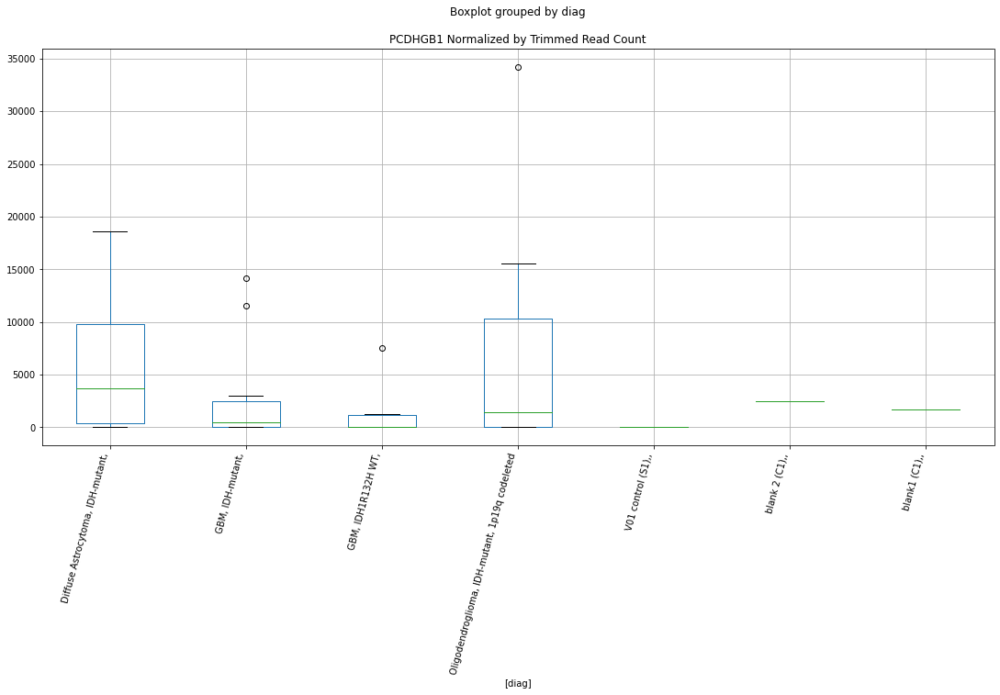

 p : 0.04012134842838824  ( t : 2.2121863654810534 ) :  D-plex  :  bbduk2  :  PERP
Control and blanks
73        0.00
337    7121.26
Name: PERP, dtype: float64
205    1253.64
Name: PERP, dtype: float64
469    1774.58
Name: PERP, dtype: float64


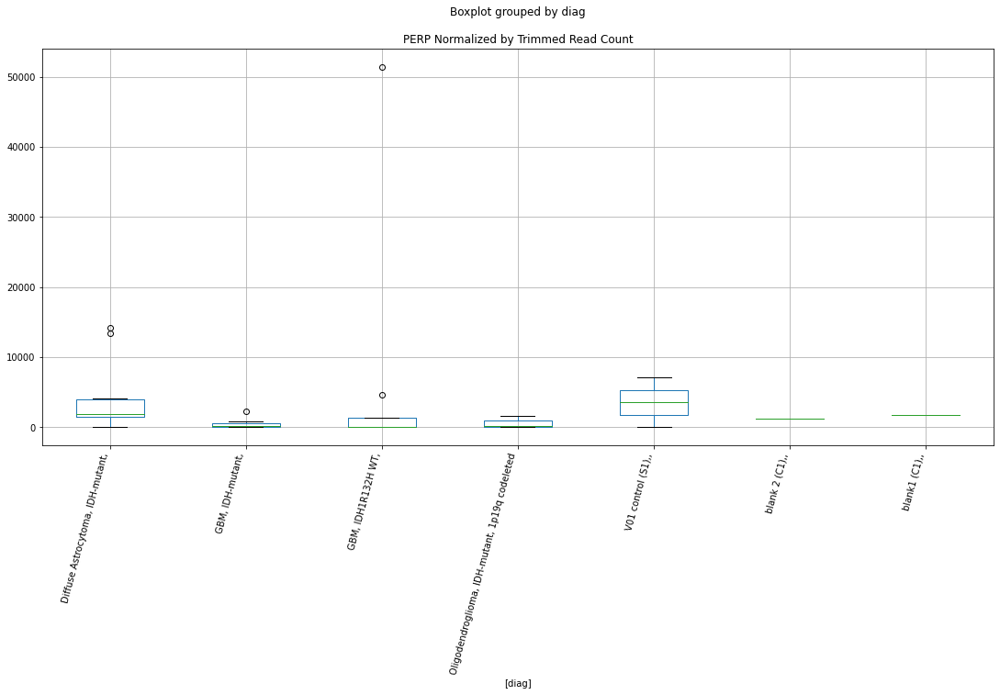

 p : 0.040144530725667746  ( t : 2.2118970609223605 ) :  Lexogen  :  bbduk2  :  RORB
Control and blanks
79     0.0
343    0.0
Name: RORB, dtype: float64
211    0.0
Name: RORB, dtype: float64
475    0.0
Name: RORB, dtype: float64


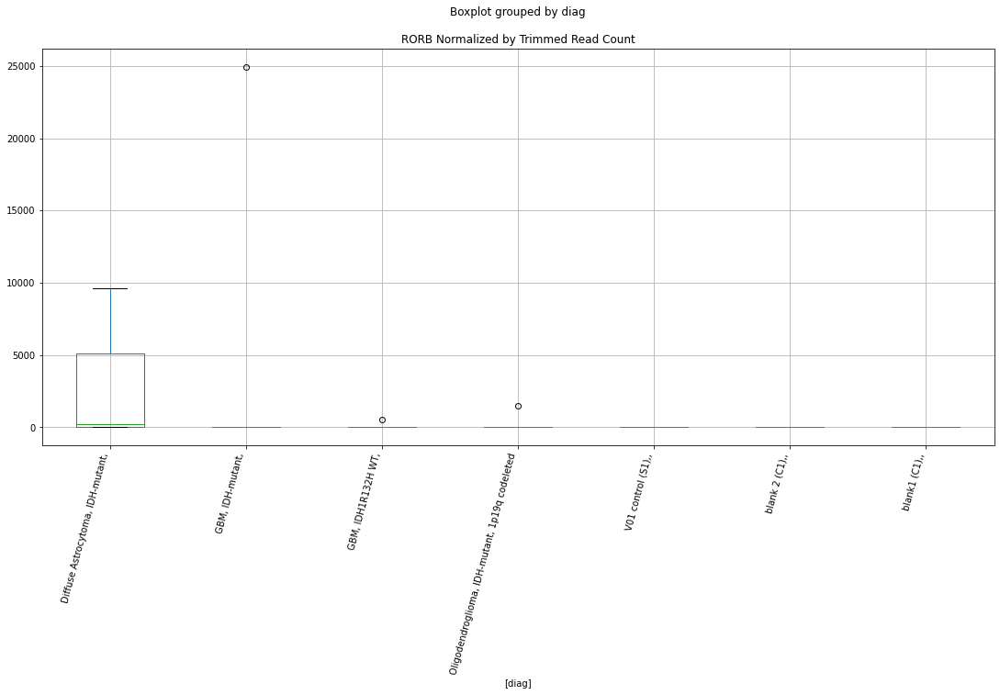

 p : 0.04016683887770404  ( t : 2.2116188102947922 ) :  Lexogen  :  cutadapt2  :  ORAI2
Control and blanks
82       0.00
346    841.74
Name: ORAI2, dtype: float64
214    0.0
Name: ORAI2, dtype: float64
478    0.0
Name: ORAI2, dtype: float64


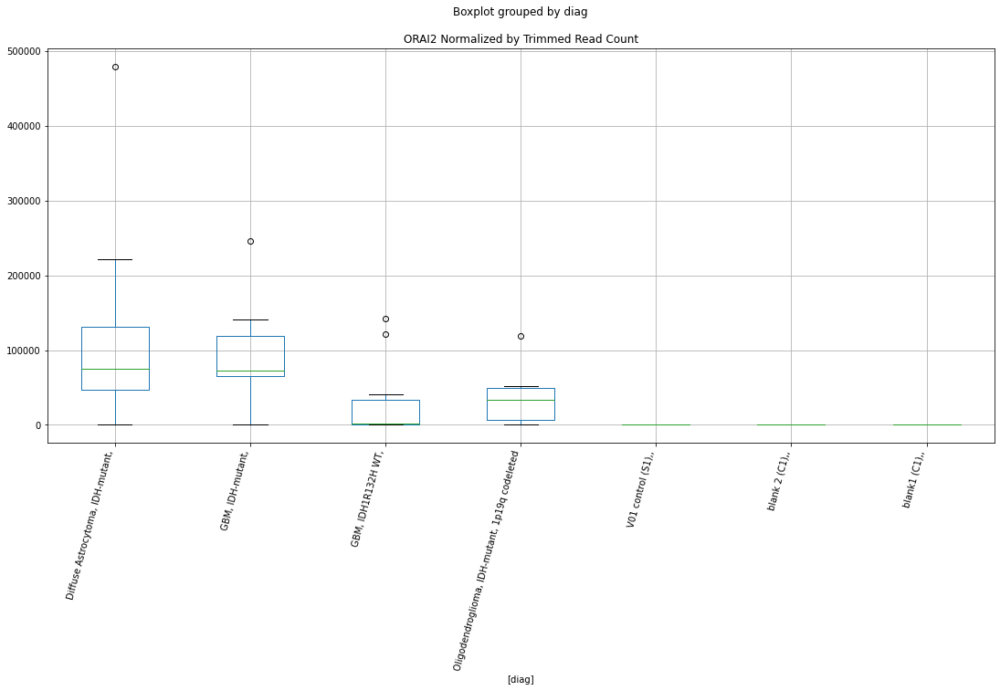

 p : 0.040169243710496884  ( t : 2.2115888231872227 ) :  Lexogen  :  cutadapt2  :  SLC24A2
Control and blanks
82     0.0
346    0.0
Name: SLC24A2, dtype: float64
214    0.0
Name: SLC24A2, dtype: float64
478    0.0
Name: SLC24A2, dtype: float64


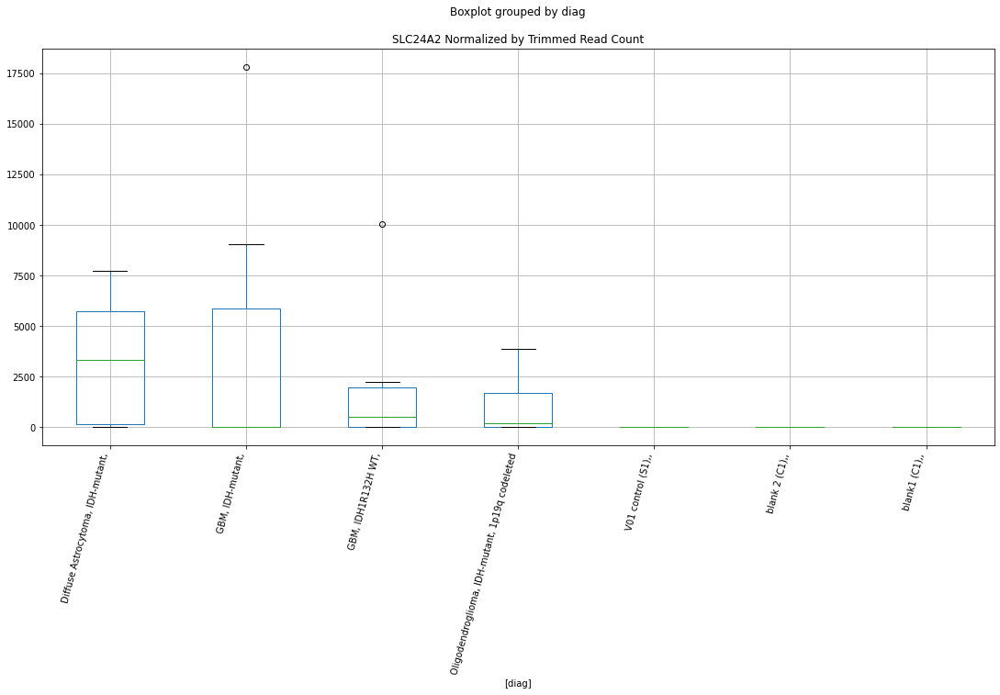

 p : 0.04023615752155043  ( t : 2.210755101384758 ) :  D-plex  :  cutadapt2  :  SH2D4B
Control and blanks
76     0.0
340    0.0
Name: SH2D4B, dtype: float64
208    529.08
Name: SH2D4B, dtype: float64
472    0.0
Name: SH2D4B, dtype: float64


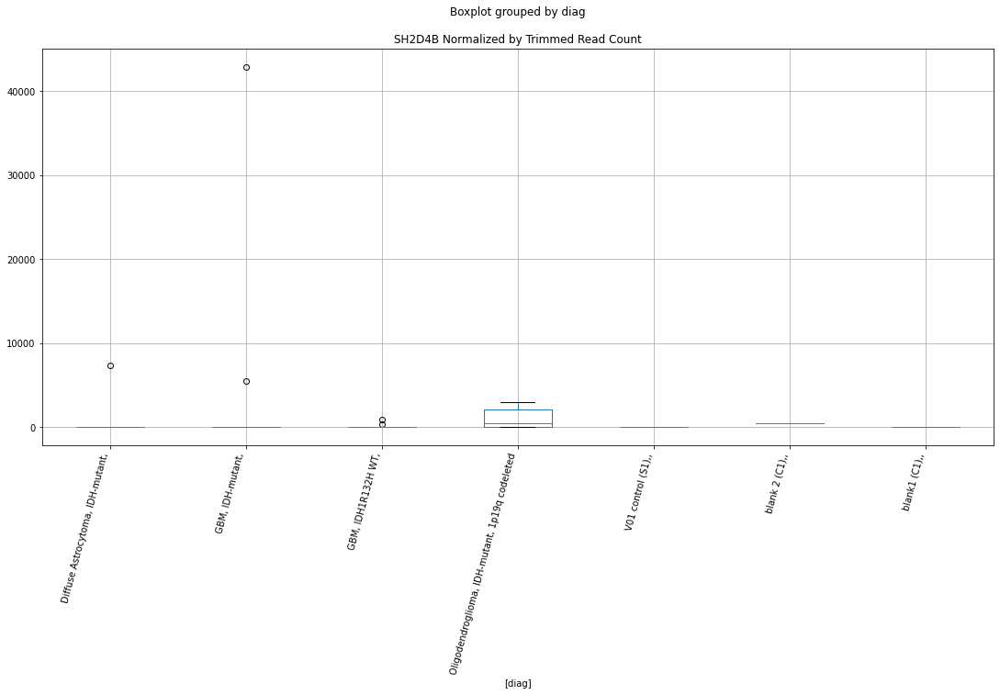

 p : 0.04023799536521819  ( t : 2.2107322205110744 ) :  D-plex  :  cutadapt2  :  SLC16A5
Control and blanks
76     0.0
340    0.0
Name: SLC16A5, dtype: float64
208    1410.88
Name: SLC16A5, dtype: float64
472    0.0
Name: SLC16A5, dtype: float64


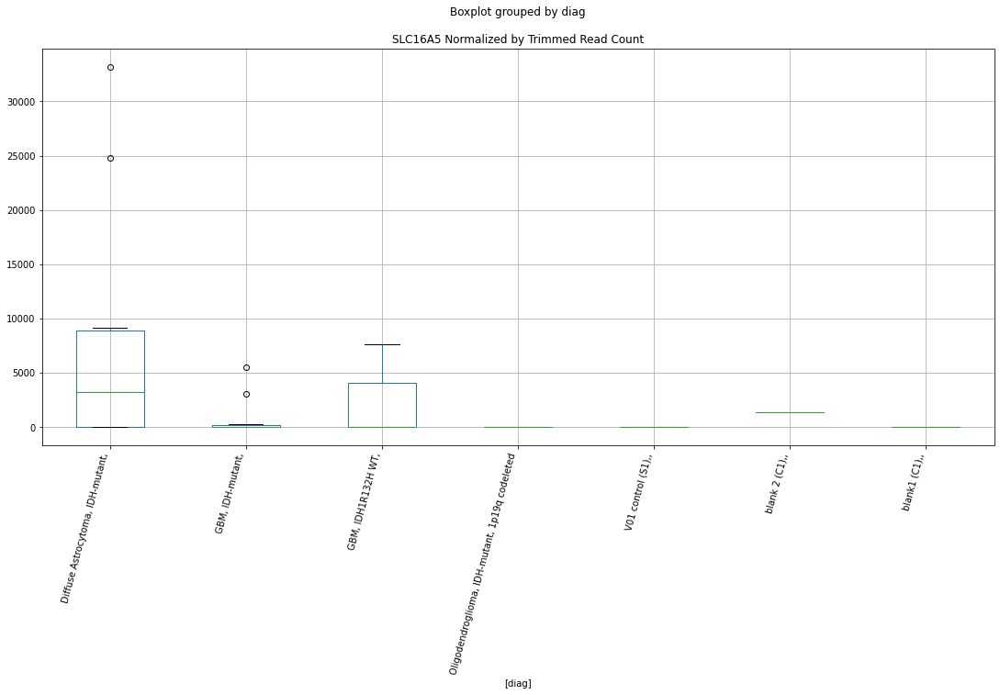

 p : 0.04024153908404613  ( t : 2.210688104463773 ) :  Lexogen  :  bbduk2  :  PPP4R1L
Control and blanks
79         0.0
343    13375.8
Name: PPP4R1L, dtype: float64
211    0.0
Name: PPP4R1L, dtype: float64
475    0.0
Name: PPP4R1L, dtype: float64


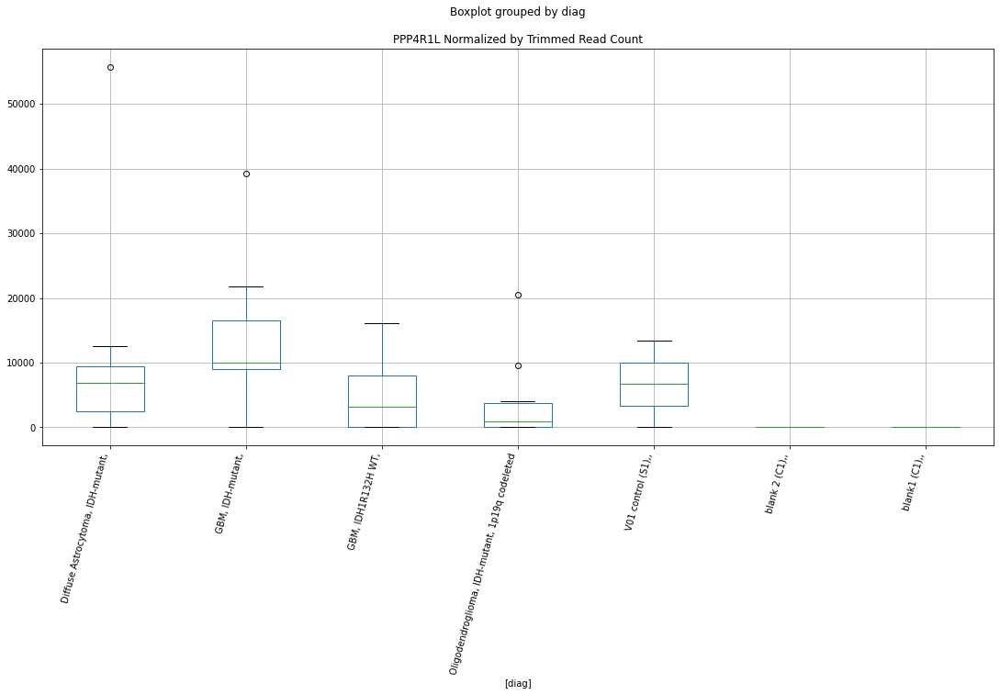

 p : 0.04026011758153493  ( t : 2.2104568776491638 ) :  D-plex  :  cutadapt2  :  RNA28SN2
Control and blanks
76     2.29e+06
340    1.41e+06
Name: RNA28SN2, dtype: float64
208    1.53e+06
Name: RNA28SN2, dtype: float64
472    1.43e+06
Name: RNA28SN2, dtype: float64


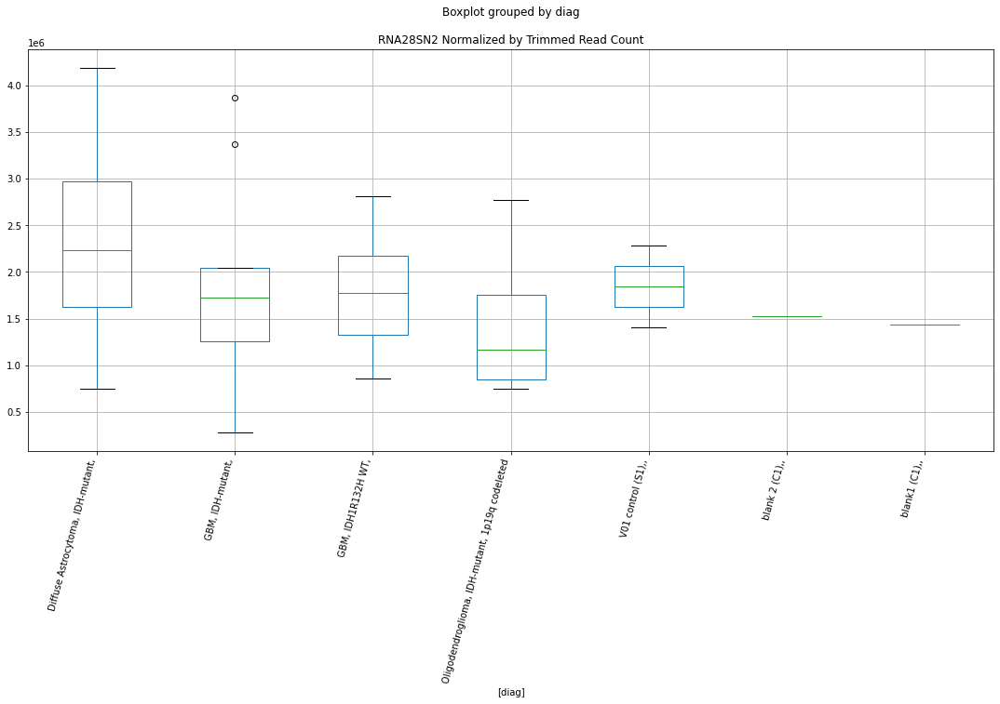

 p : 0.040264806254733575  ( t : 2.210398538218886 ) :  D-plex  :  bbduk2  :  PRPF38B
Control and blanks
73     0.0
337    0.0
Name: PRPF38B, dtype: float64
205    15580.91
Name: PRPF38B, dtype: float64
469    21294.98
Name: PRPF38B, dtype: float64


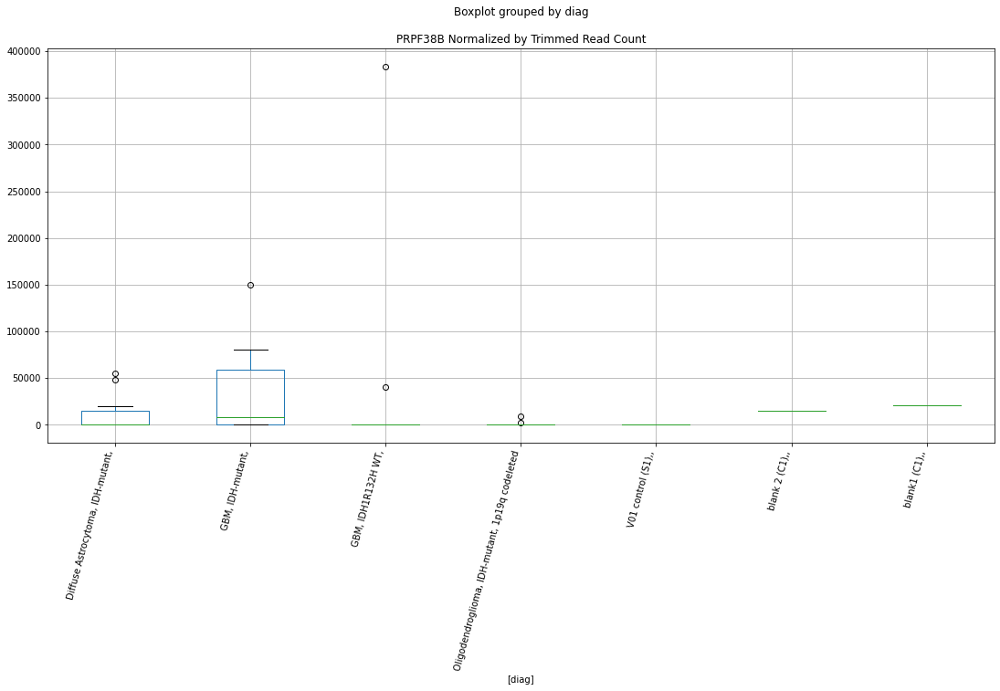

 p : 0.04027024316008043  ( t : 2.2103308966314796 ) :  D-plex  :  cutadapt2  :  P2RX2
Control and blanks
76     0.0
340    0.0
Name: P2RX2, dtype: float64
208    3174.48
Name: P2RX2, dtype: float64
472    7513.43
Name: P2RX2, dtype: float64


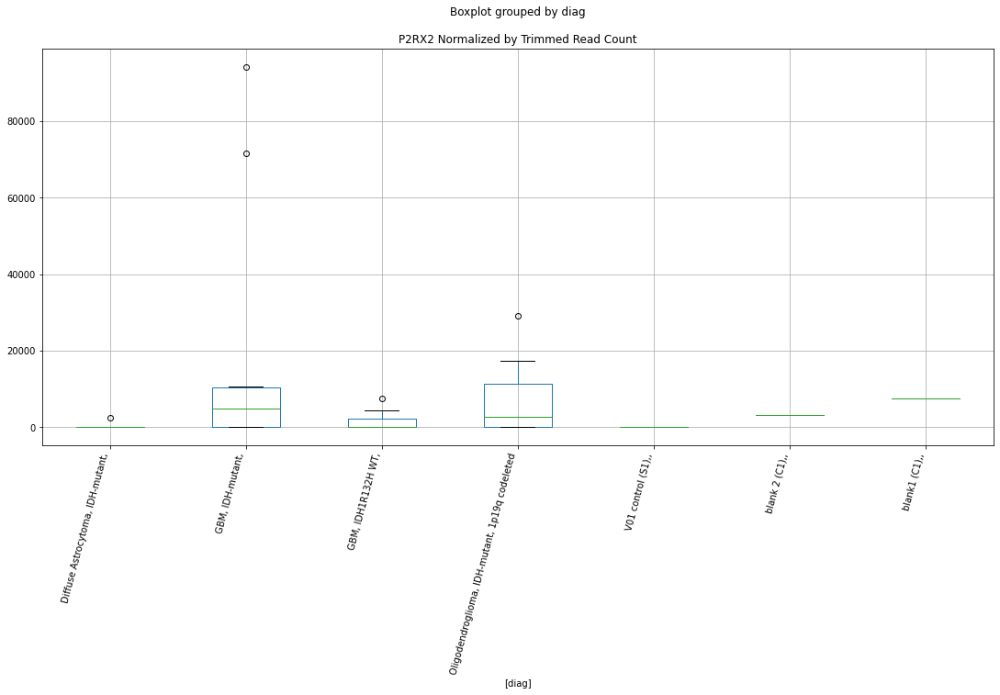

 p : 0.040296882302098096  ( t : 2.2099995952251694 ) :  D-plex  :  bbduk2  :  SLC5A5
Control and blanks
73     3865.04
337       0.00
Name: SLC5A5, dtype: float64
205    5372.73
Name: SLC5A5, dtype: float64
469    2957.64
Name: SLC5A5, dtype: float64


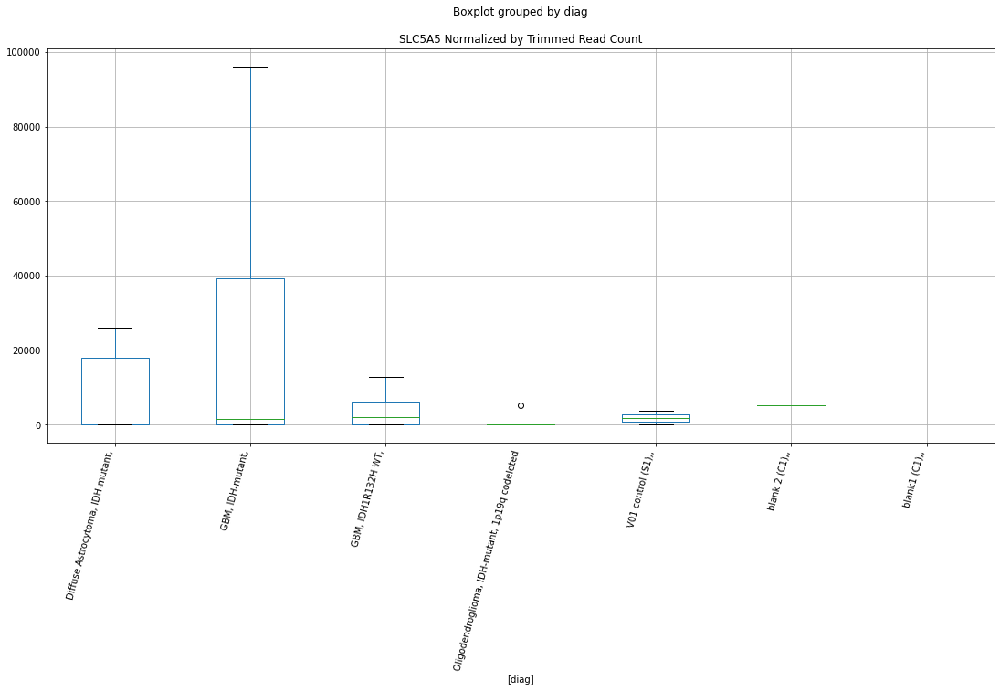

 p : 0.04032631318886297  ( t : 2.209633807908054 ) :  Lexogen  :  cutadapt2  :  PIWIL4
Control and blanks
82       0.00
346    420.87
Name: PIWIL4, dtype: float64
214    0.0
Name: PIWIL4, dtype: float64
478    0.0
Name: PIWIL4, dtype: float64


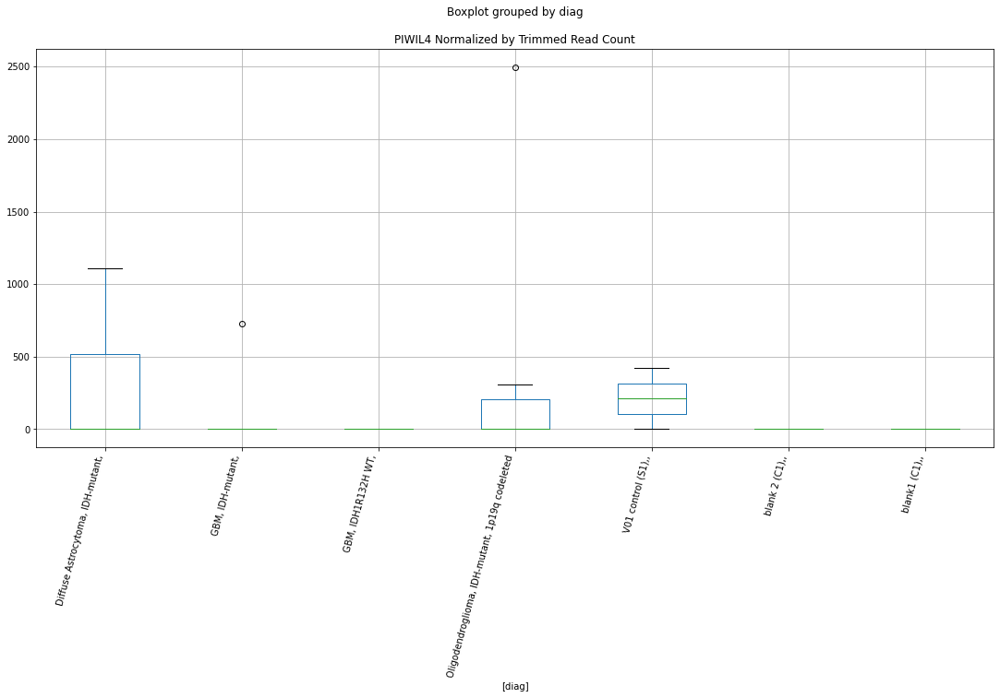

 p : 0.040413177040063634  ( t : 2.2085556333820975 ) :  D-plex  :  bbduk2  :  SP4
Control and blanks
73      2319.03
337    28485.03
Name: SP4, dtype: float64
205    1253.64
Name: SP4, dtype: float64
469    0.0
Name: SP4, dtype: float64


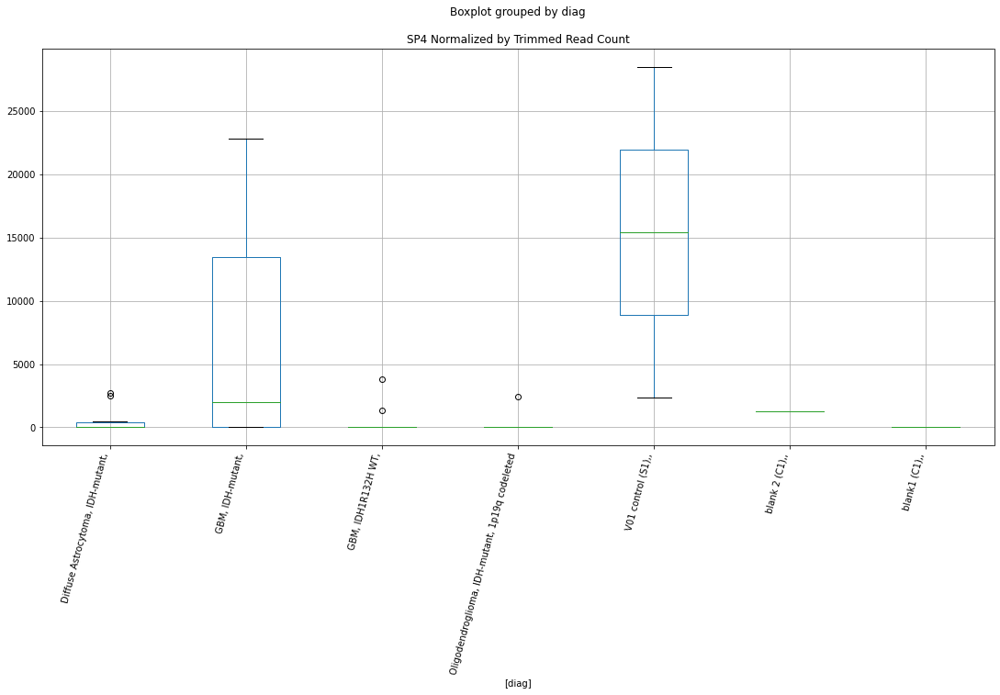

 p : 0.04042928903371884  ( t : 2.2083558817631137 ) :  D-plex  :  cutadapt2  :  RAX
Control and blanks
76     5303.3
340       0.0
Name: RAX, dtype: float64
208    352.72
Name: RAX, dtype: float64
472    1733.87
Name: RAX, dtype: float64


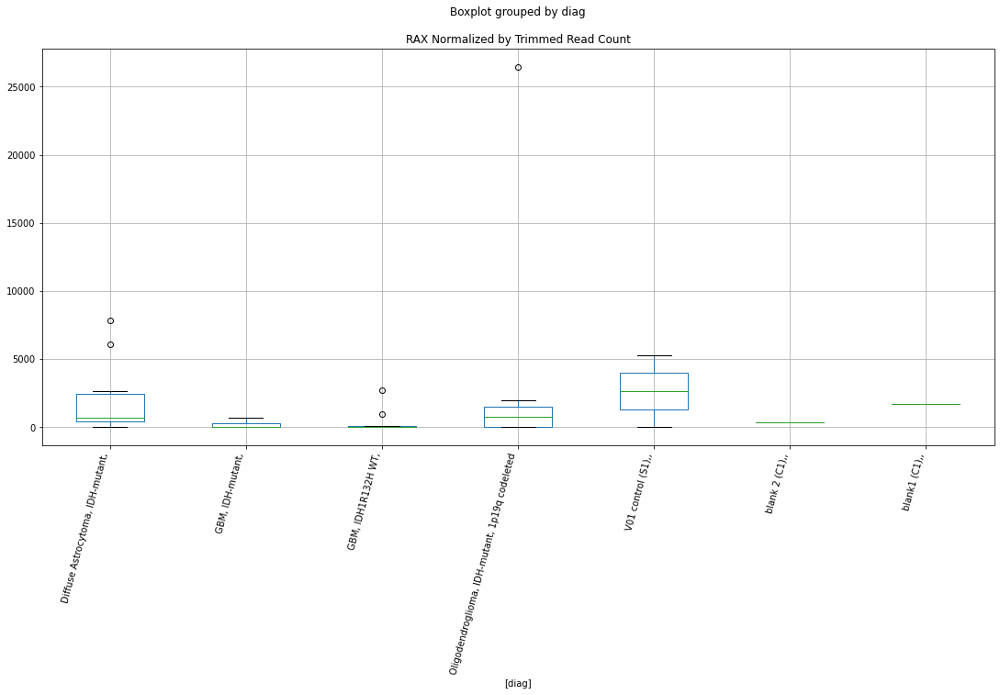

 p : 0.040434094646636026  ( t : 2.2082963173956203 ) :  Lexogen  :  cutadapt2  :  PPP4R1L
Control and blanks
82         0.00
346    13467.81
Name: PPP4R1L, dtype: float64
214    0.0
Name: PPP4R1L, dtype: float64
478    0.0
Name: PPP4R1L, dtype: float64


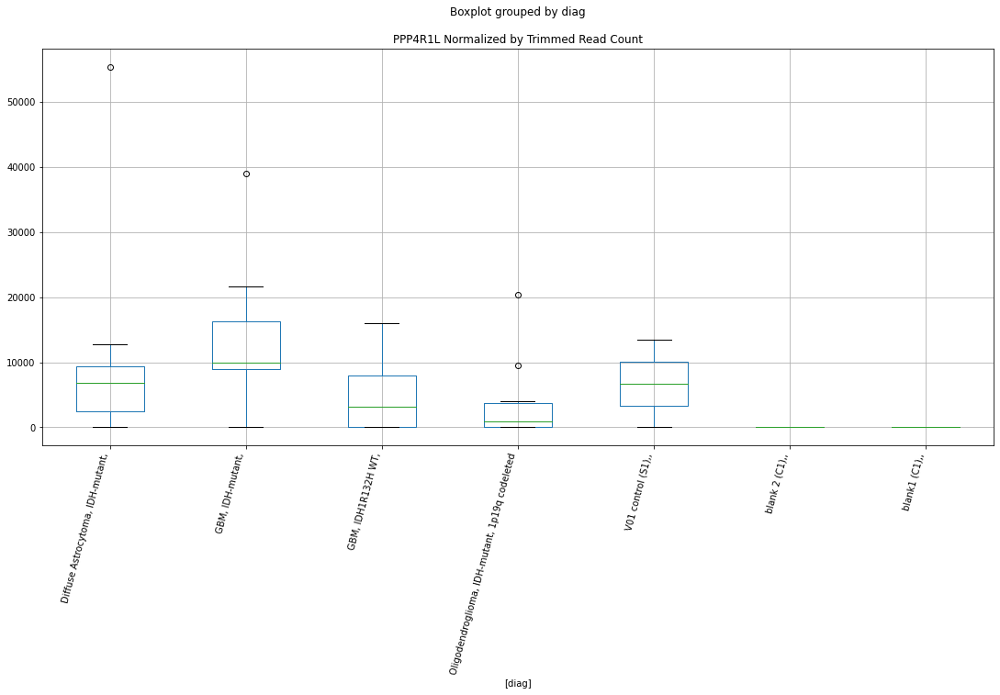

 p : 0.0405007988342949  ( t : 2.2074702069857124 ) :  Lexogen  :  bbduk2  :  PC
Control and blanks
79        0.0
343    2972.4
Name: PC, dtype: float64
211    0.0
Name: PC, dtype: float64
475    0.0
Name: PC, dtype: float64


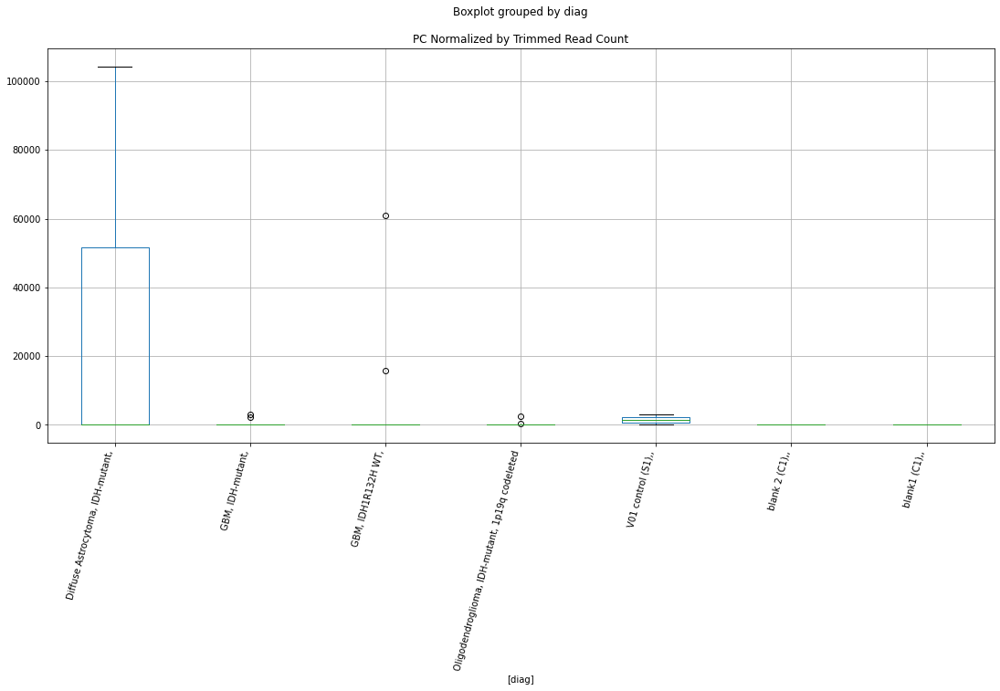

 p : 0.04052219093164864  ( t : 2.207205537392853 ) :  D-plex  :  bbduk2  :  SARS2
Control and blanks
73       9276.10
337    163788.94
Name: SARS2, dtype: float64
205    186970.95
Name: SARS2, dtype: float64
469    52054.4
Name: SARS2, dtype: float64


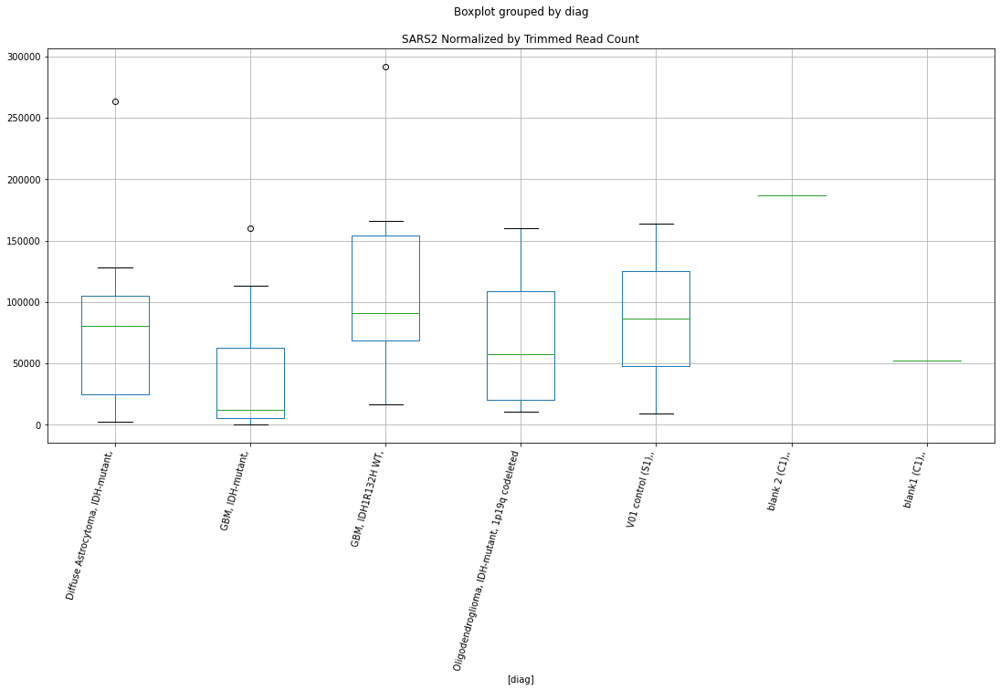

 p : 0.04061632615038117  ( t : 2.2060423912238916 ) :  D-plex  :  cutadapt2  :  PP2672
Control and blanks
76     0.0
340    0.0
Name: PP2672, dtype: float64
208    176.36
Name: PP2672, dtype: float64
472    1155.91
Name: PP2672, dtype: float64


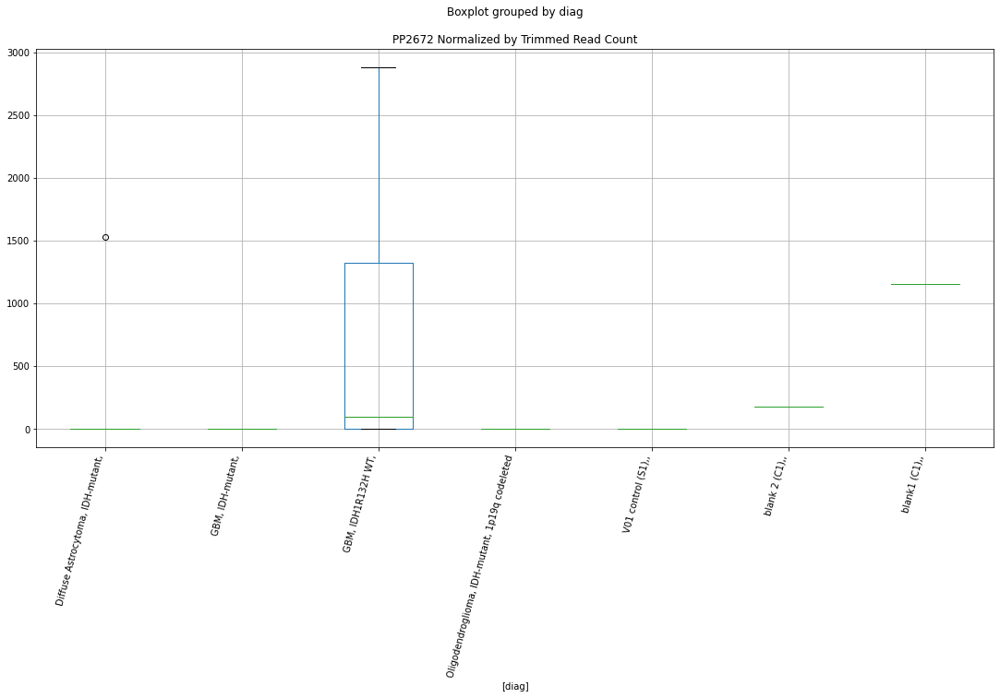

 p : 0.04065030834089954  ( t : 2.2056231116539404 ) :  D-plex  :  bbduk2  :  SALL3
Control and blanks
73     4638.05
337       0.00
Name: SALL3, dtype: float64
205    2686.36
Name: SALL3, dtype: float64
469    3549.16
Name: SALL3, dtype: float64


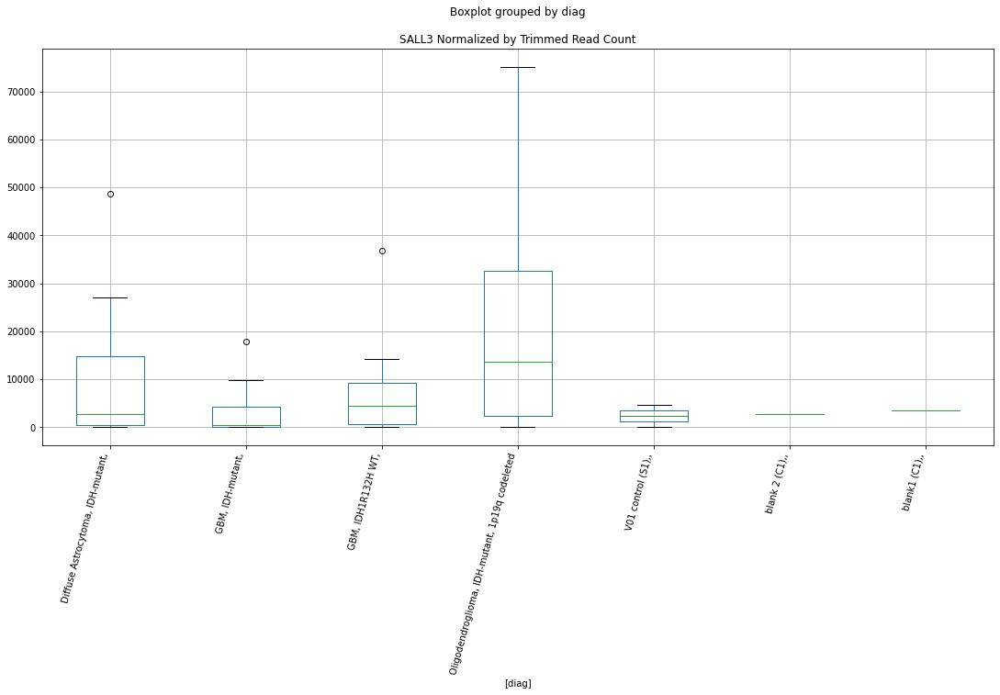

 p : 0.040664406540336956  ( t : 2.2054492595607234 ) :  D-plex  :  bbduk2  :  PPP2R3A
Control and blanks
73     0.0
337    0.0
Name: PPP2R3A, dtype: float64
205    2328.18
Name: PPP2R3A, dtype: float64
469    10647.49
Name: PPP2R3A, dtype: float64


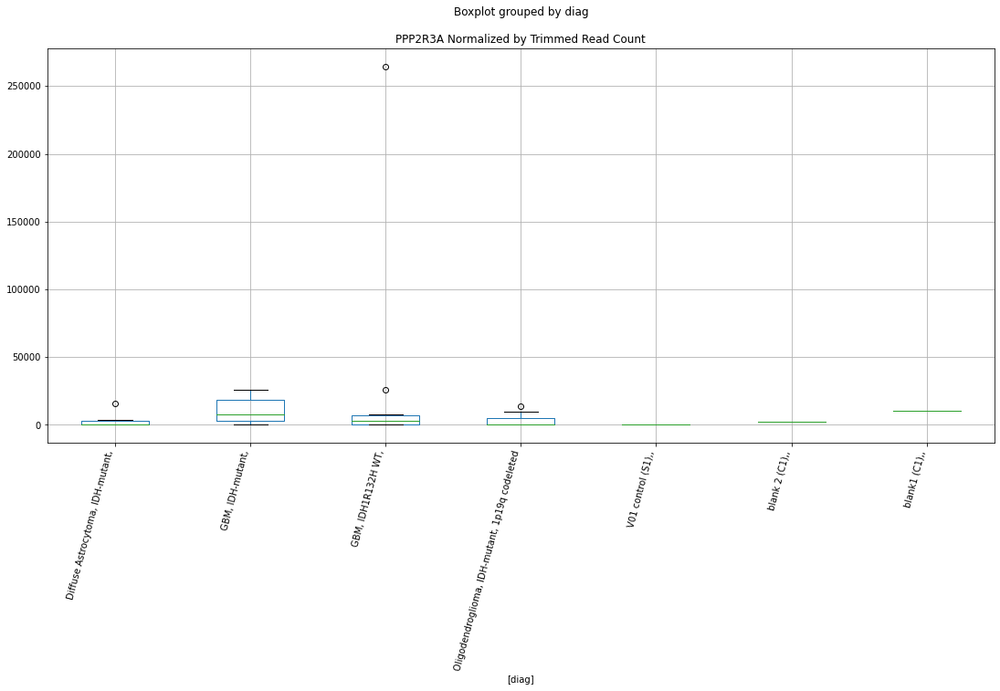

 p : 0.040675230999816396  ( t : 2.2053158152084342 ) :  D-plex  :  bbduk2  :  RNA45SN4
Control and blanks
73     4.36e+06
337    2.63e+06
Name: RNA45SN4, dtype: float64
205    2.56e+06
Name: RNA45SN4, dtype: float64
469    2.67e+06
Name: RNA45SN4, dtype: float64


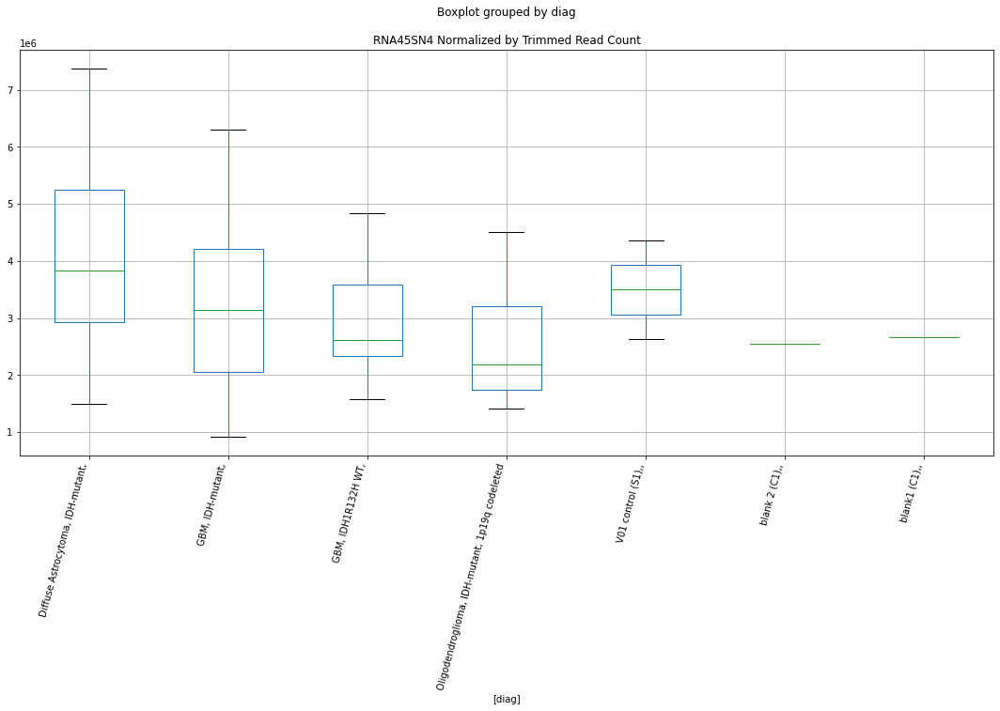

 p : 0.04067661882451891  ( t : 2.2052987084123 ) :  D-plex  :  cutadapt2  :  RNA45SN4
Control and blanks
76     4.33e+06
340    2.54e+06
Name: RNA45SN4, dtype: float64
208    2.51e+06
Name: RNA45SN4, dtype: float64
472    2.60e+06
Name: RNA45SN4, dtype: float64


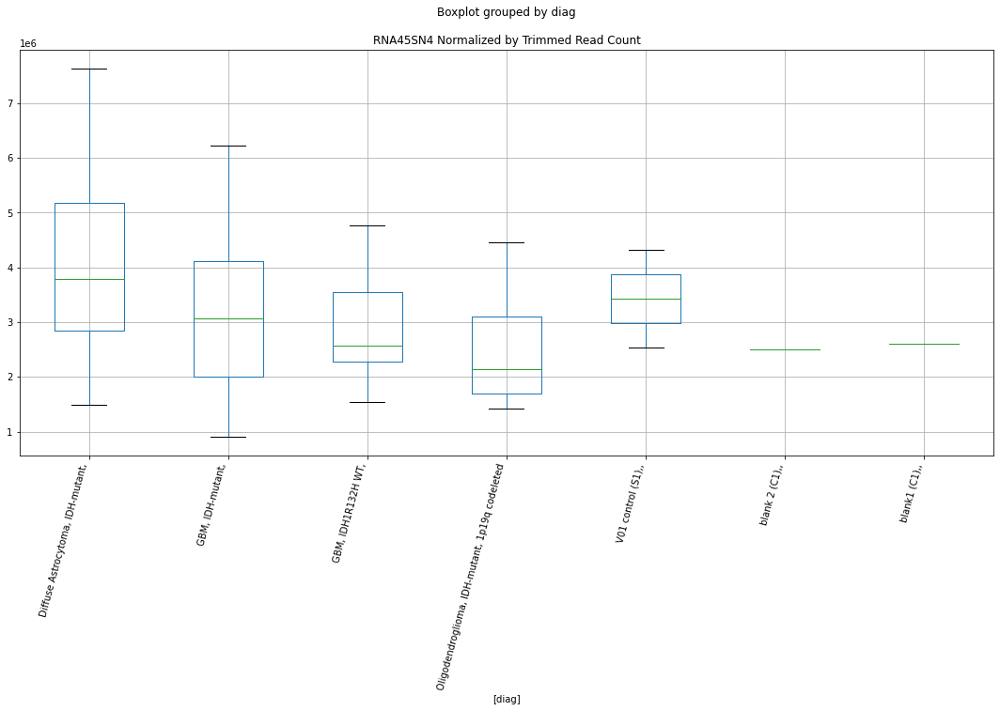

 p : 0.040714738098989775  ( t : 2.2048290468979665 ) :  D-plex  :  cutadapt2  :  PARG
Control and blanks
76     0.0
340    0.0
Name: PARG, dtype: float64
208    5290.81
Name: PARG, dtype: float64
472    0.0
Name: PARG, dtype: float64


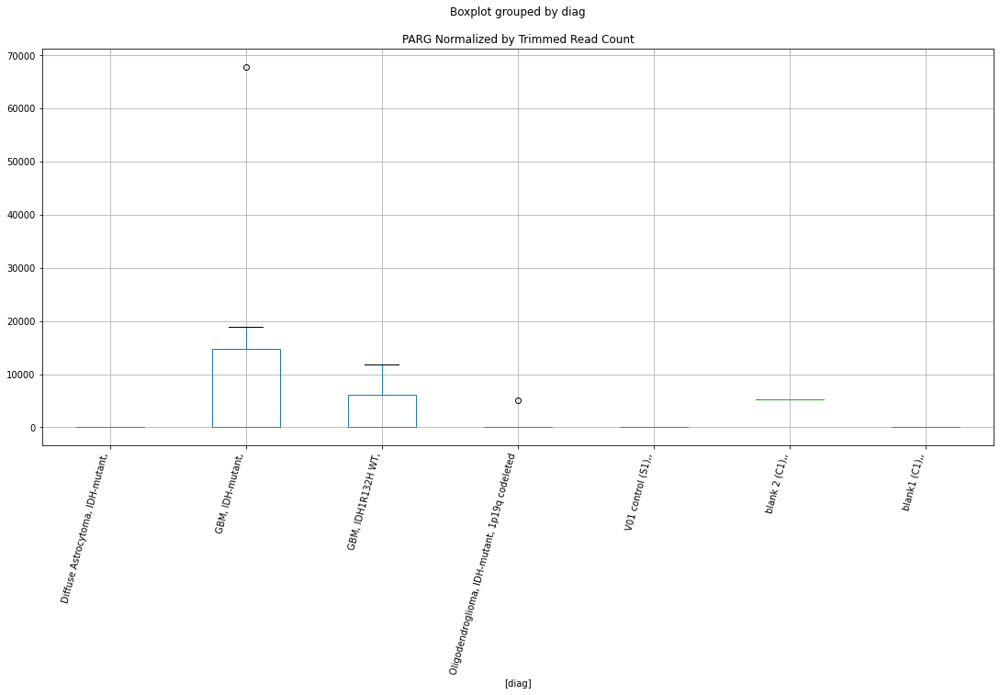

 p : 0.04073274120836078  ( t : 2.204607373905029 ) :  D-plex  :  bbduk2  :  RBM4
Control and blanks
73     6184.07
337       0.00
Name: RBM4, dtype: float64
205    358.18
Name: RBM4, dtype: float64
469    0.0
Name: RBM4, dtype: float64


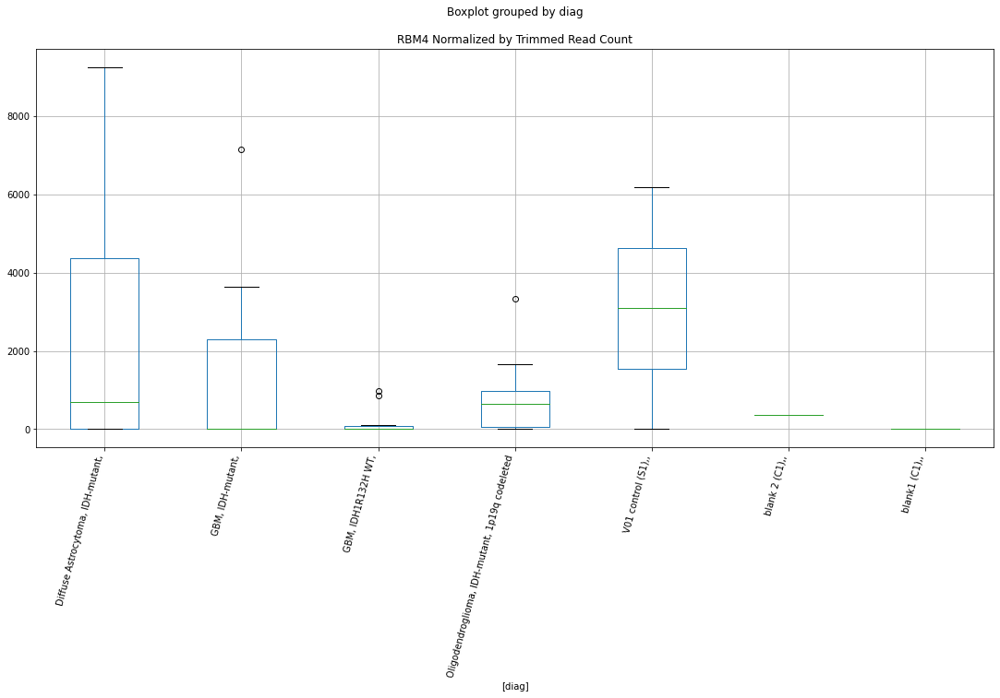

 p : 0.04073925613574936  ( t : 2.204527177530263 ) :  Lexogen  :  bbduk2  :  RYR2
Control and blanks
79     0.0
343    0.0
Name: RYR2, dtype: float64
211    0.0
Name: RYR2, dtype: float64
475    0.0
Name: RYR2, dtype: float64


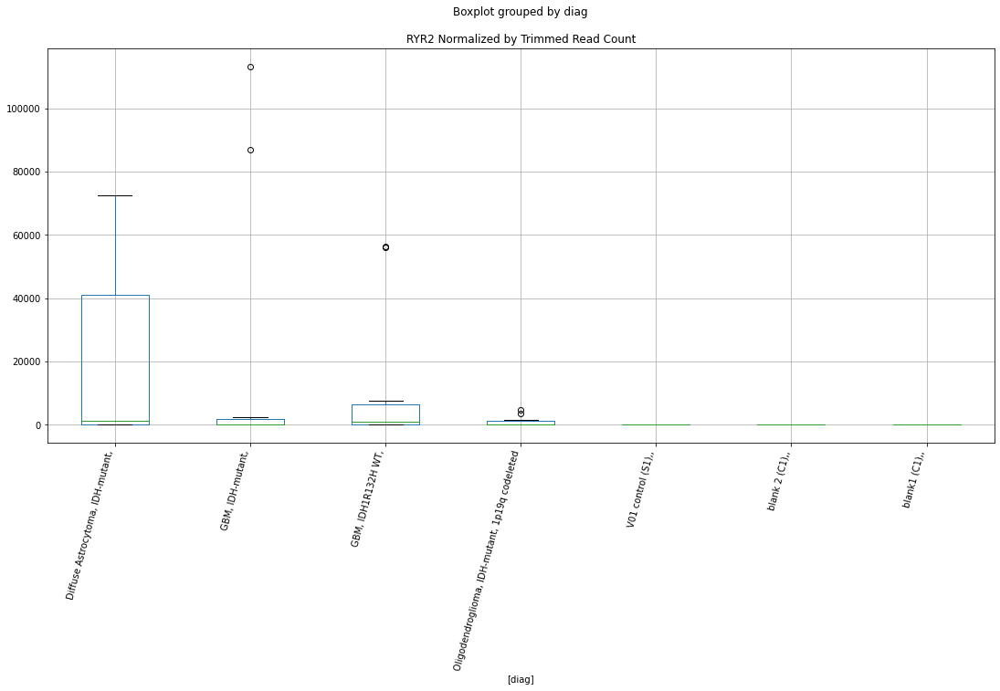

 p : 0.040759064928471006  ( t : 2.2042834108932334 ) :  D-plex  :  bbduk2  :  RNA28SN4
Control and blanks
73     2.27e+06
337    1.36e+06
Name: RNA28SN4, dtype: float64
205    1.54e+06
Name: RNA28SN4, dtype: float64
469    1.43e+06
Name: RNA28SN4, dtype: float64


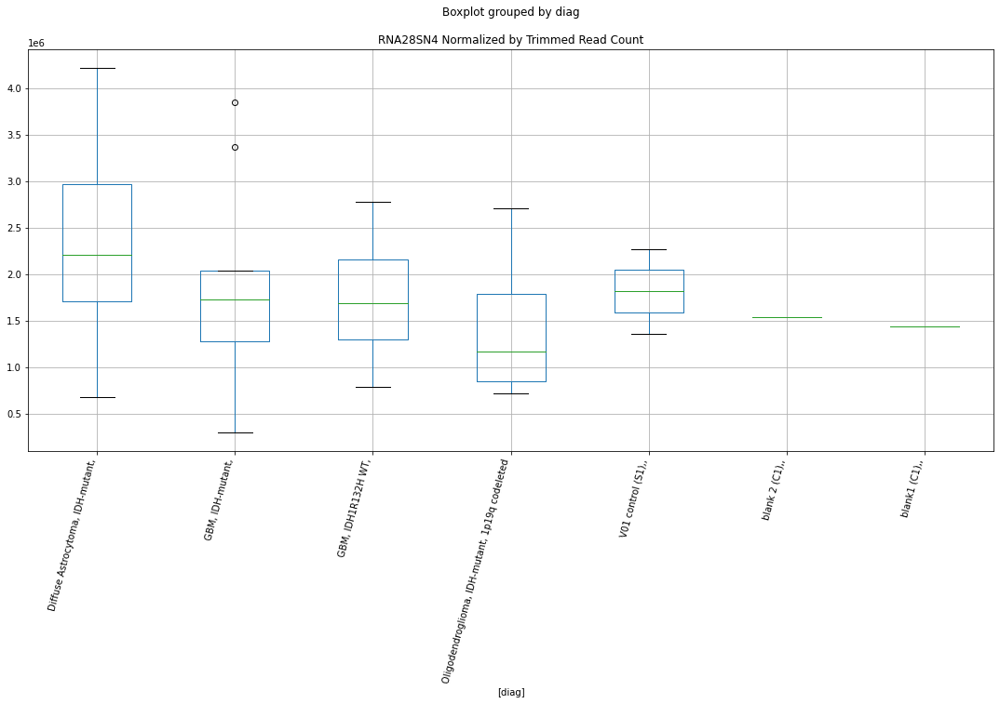

 p : 0.040773952224044875  ( t : 2.204100279740893 ) :  D-plex  :  cutadapt2  :  PHF14
Control and blanks
76     0.0
340    0.0
Name: PHF14, dtype: float64
208    1410.88
Name: PHF14, dtype: float64
472    1155.91
Name: PHF14, dtype: float64


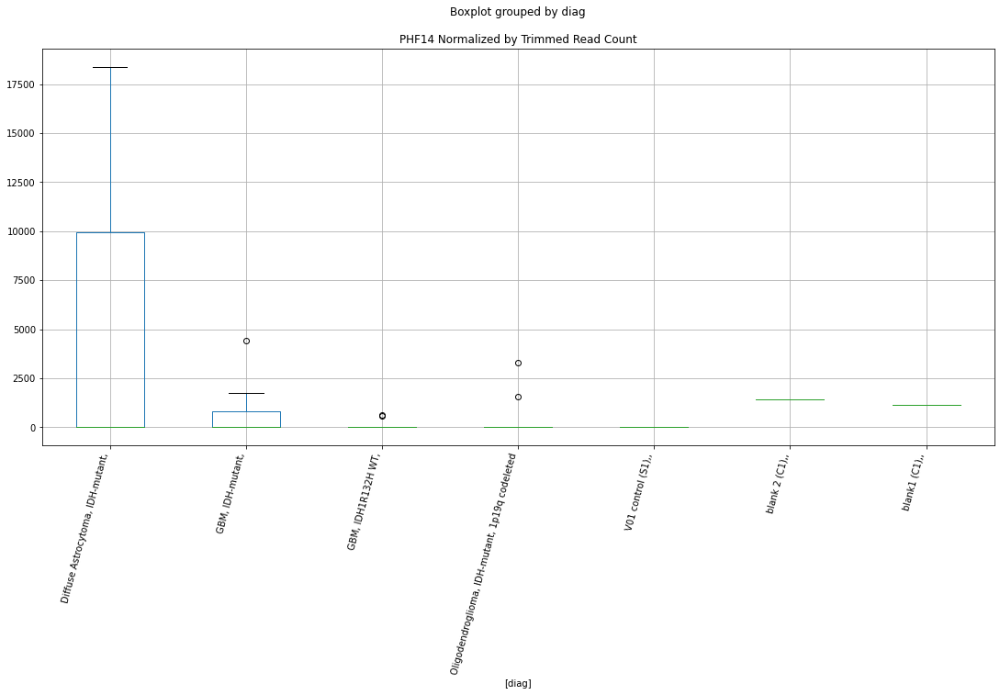

 p : 0.040774357905254875  ( t : 2.204095290247286 ) :  D-plex  :  bbduk2  :  PCDH15
Control and blanks
73     15460.17
337    33825.98
Name: PCDH15, dtype: float64
205    144168.22
Name: PCDH15, dtype: float64
469    138417.39
Name: PCDH15, dtype: float64


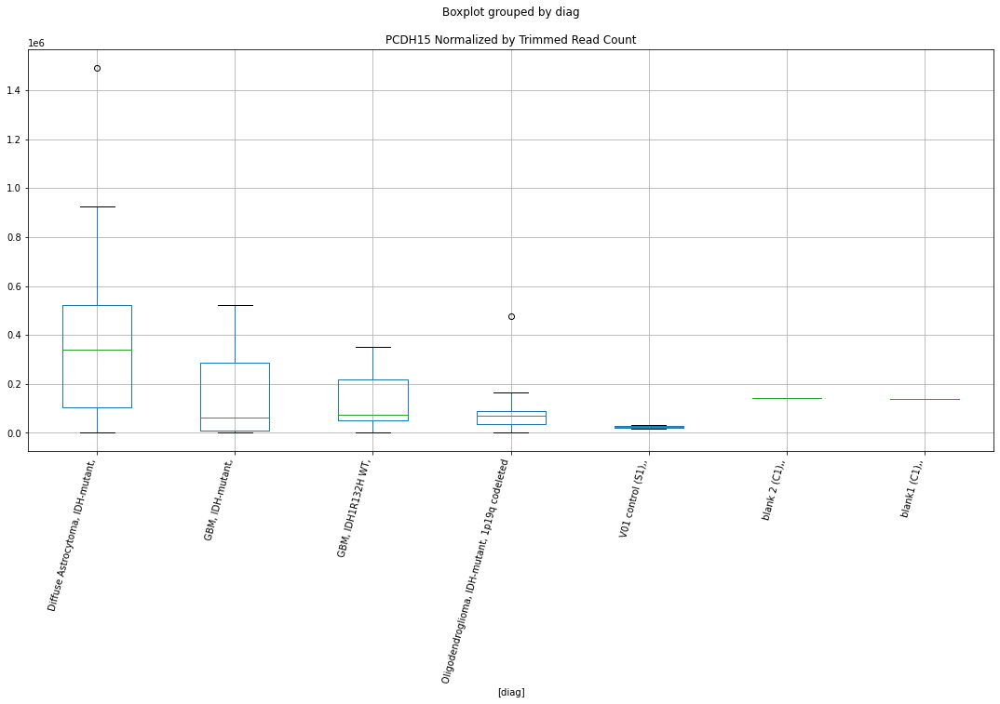

 p : 0.04082209194674023  ( t : 2.2035085250373205 ) :  D-plex  :  cutadapt2  :  PIEZO2
Control and blanks
76     27274.11
340     5284.39
Name: PIEZO2, dtype: float64
208    111636.02
Name: PIEZO2, dtype: float64
472    108077.74
Name: PIEZO2, dtype: float64


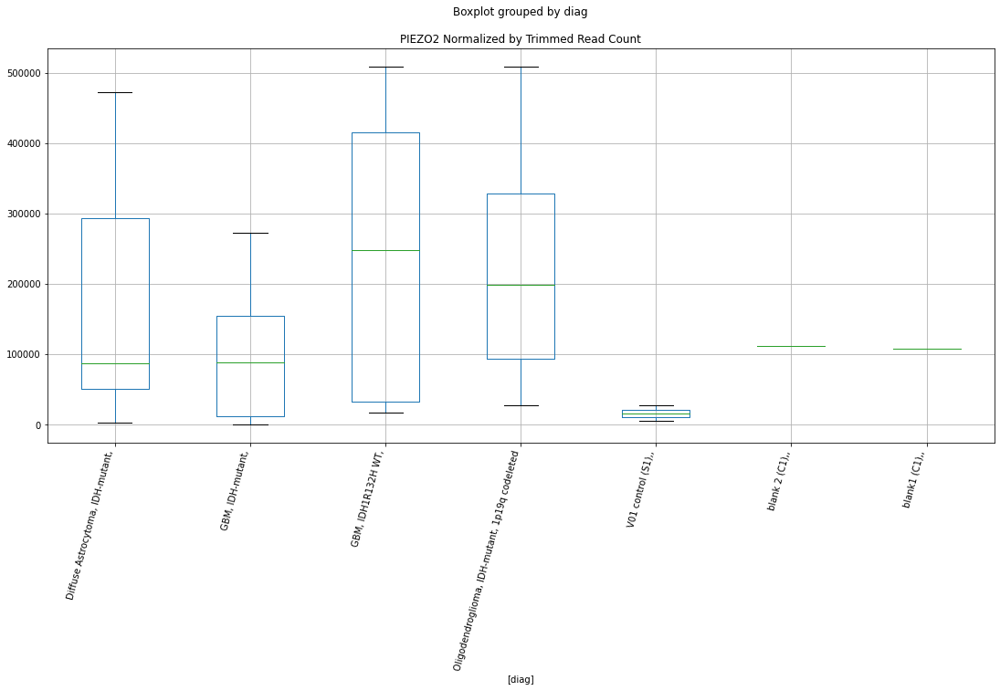

 p : 0.04083669018220187  ( t : 2.2033292037716503 ) :  D-plex  :  cutadapt2  :  RNF187
Control and blanks
76     0.0
340    0.0
Name: RNF187, dtype: float64
208    0.0
Name: RNF187, dtype: float64
472    2311.82
Name: RNF187, dtype: float64


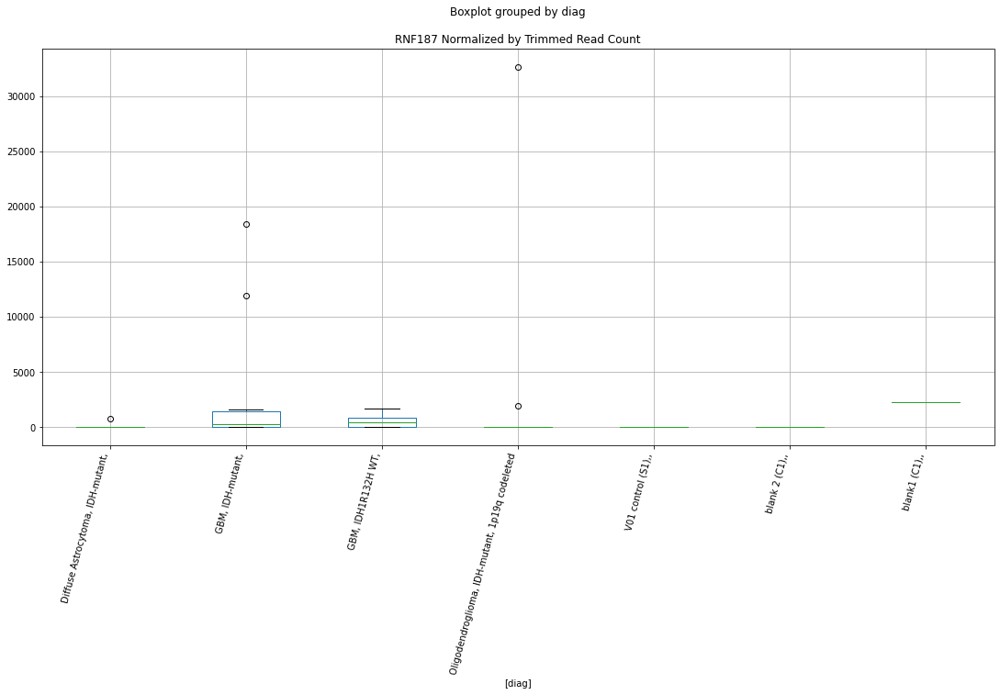

 p : 0.040860892005073694  ( t : 2.2030320440201607 ) :  D-plex  :  bbduk2  :  SIDT1
Control and blanks
73     0.0
337    0.0
Name: SIDT1, dtype: float64
205    8238.18
Name: SIDT1, dtype: float64
469    13605.13
Name: SIDT1, dtype: float64


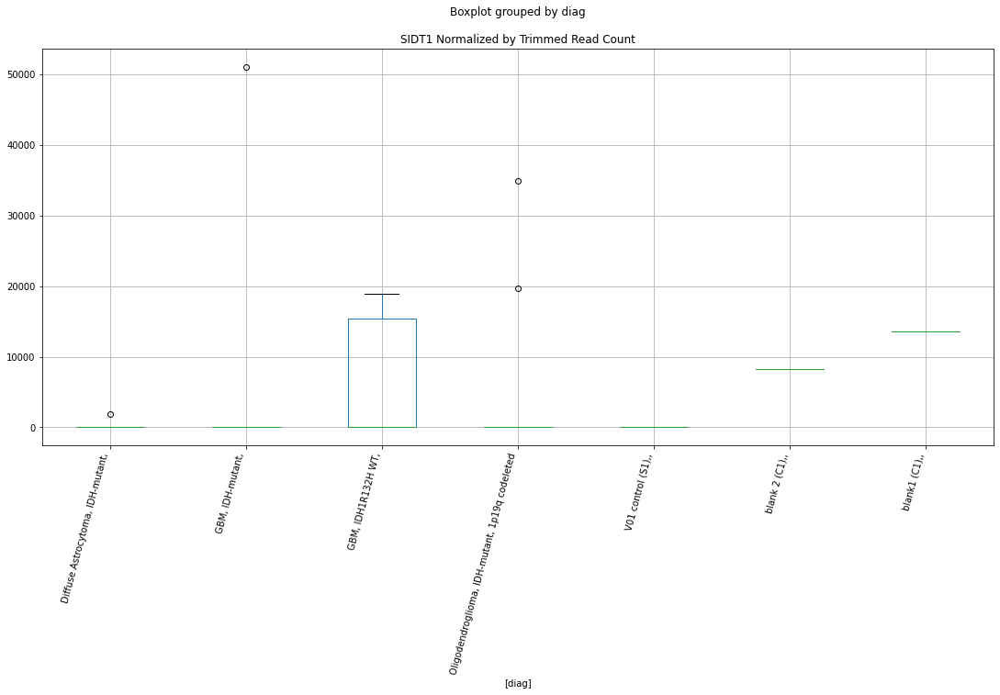

 p : 0.04087252008592237  ( t : 2.2028893272513086 ) :  D-plex  :  cutadapt2  :  SALL3
Control and blanks
76     2272.84
340       0.00
Name: SALL3, dtype: float64
208    2116.32
Name: SALL3, dtype: float64
472    1733.87
Name: SALL3, dtype: float64


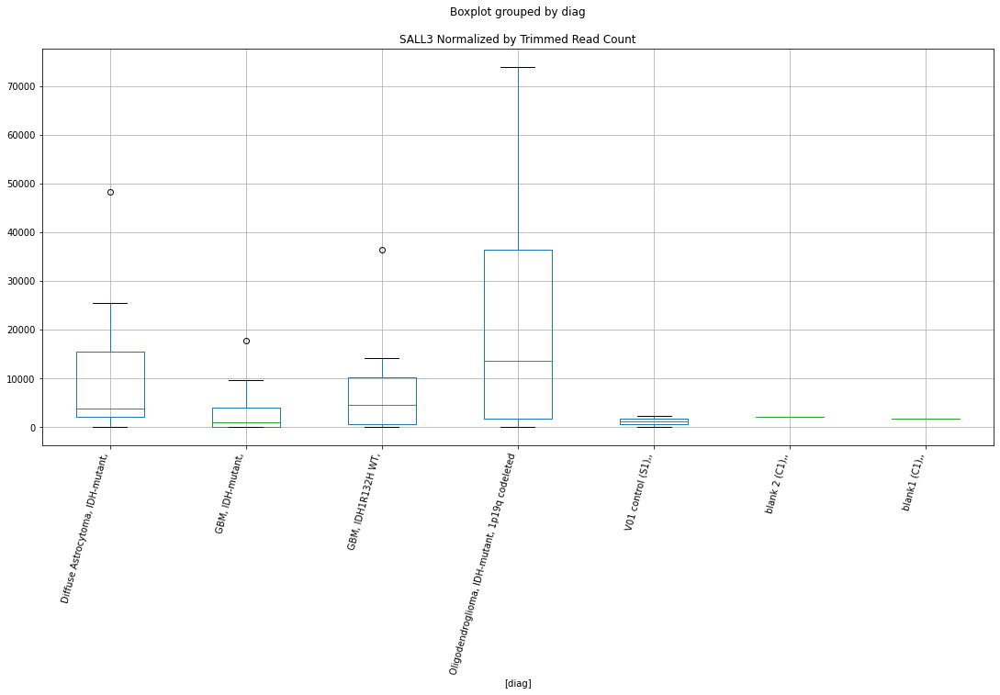

 p : 0.04093783106586876  ( t : 2.2020884280443833 ) :  D-plex  :  bbduk2  :  RNA28SN1
Control and blanks
73     2.23e+06
337    1.36e+06
Name: RNA28SN1, dtype: float64
205    1.54e+06
Name: RNA28SN1, dtype: float64
469    1.44e+06
Name: RNA28SN1, dtype: float64


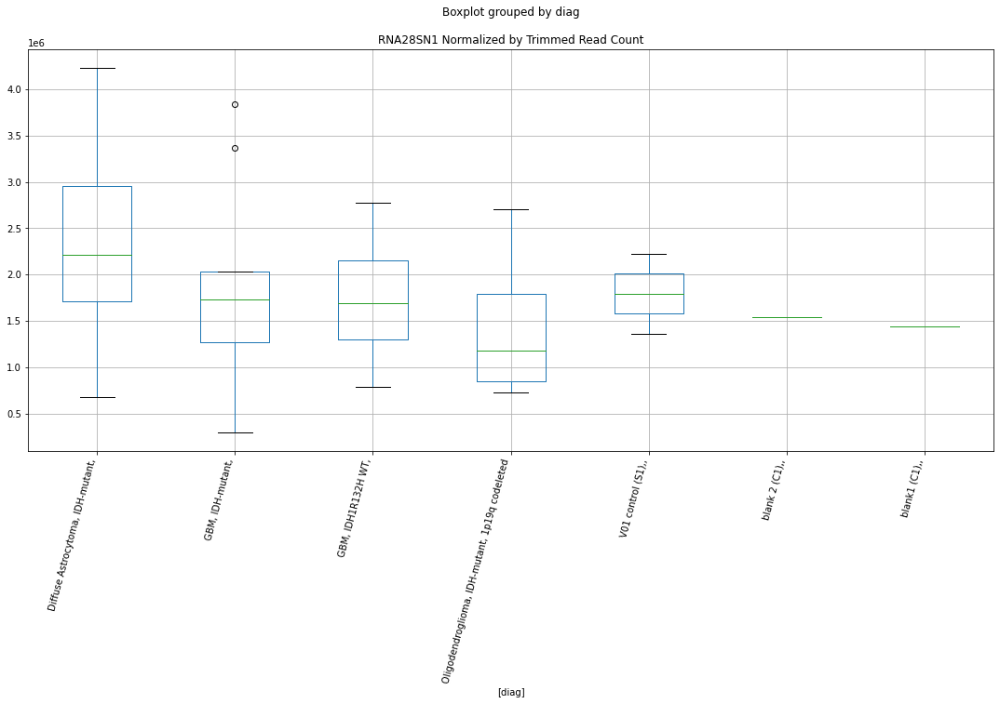

 p : 0.04099503551927582  ( t : 2.201387901645671 ) :  Lexogen  :  bbduk2  :  SLC23A2
Control and blanks
79     0.0
343    0.0
Name: SLC23A2, dtype: float64
211    0.0
Name: SLC23A2, dtype: float64
475    0.0
Name: SLC23A2, dtype: float64


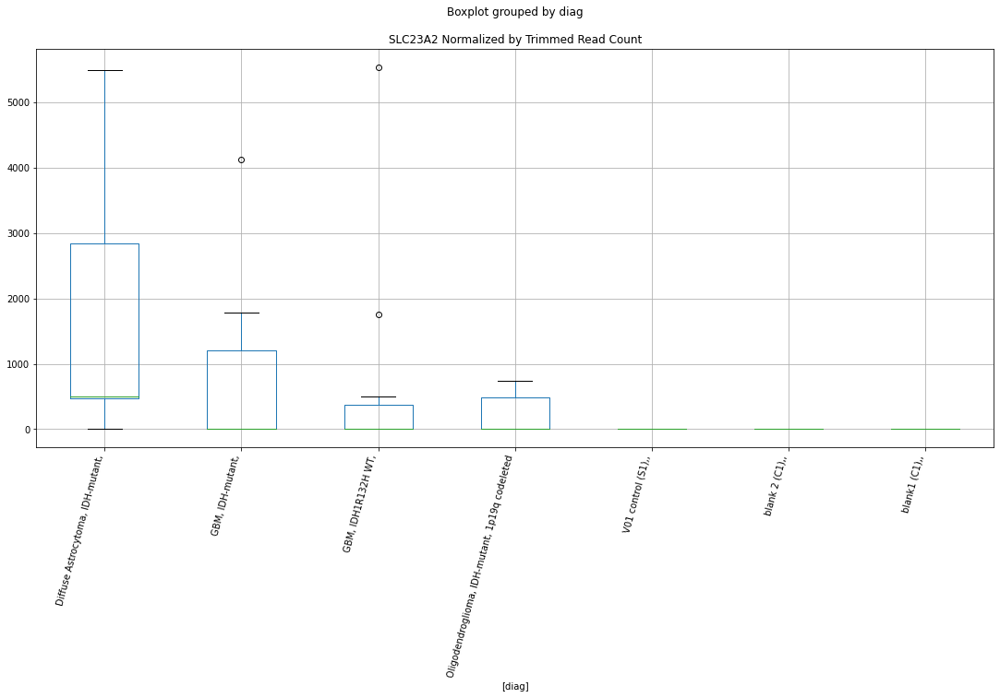

 p : 0.04101654180016297  ( t : 2.201124767694696 ) :  D-plex  :  bbduk2  :  PTPN18
Control and blanks
73     0.0
337    0.0
Name: PTPN18, dtype: float64
205    5372.73
Name: PTPN18, dtype: float64
469    0.0
Name: PTPN18, dtype: float64


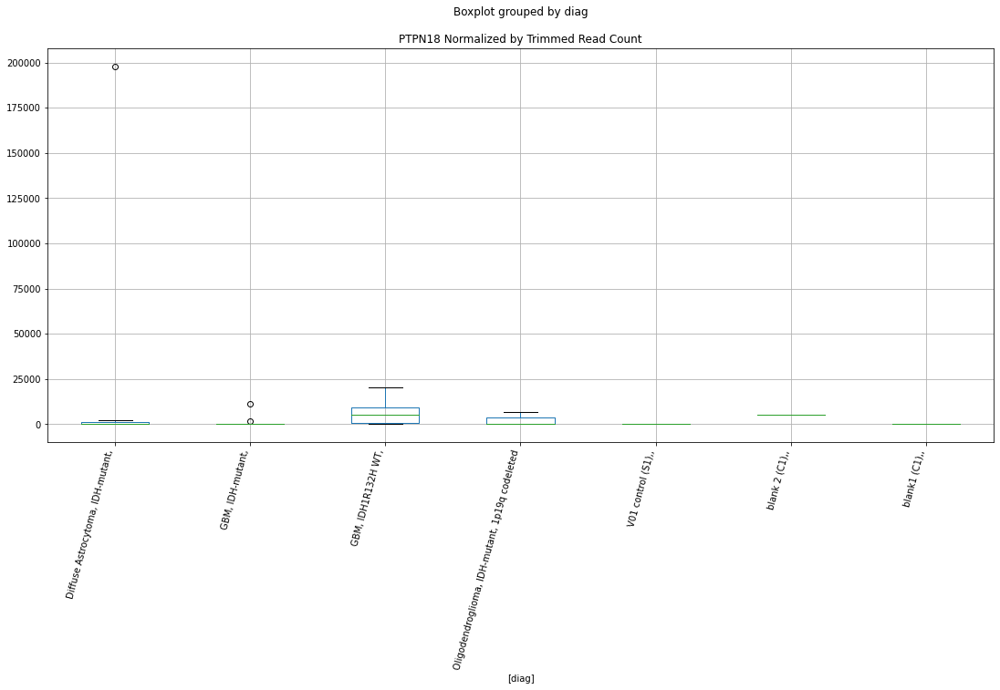

 p : 0.04106019590826899  ( t : 2.2005910397818775 ) :  D-plex  :  cutadapt2  :  RNF43
Control and blanks
76     4545.69
340       0.00
Name: RNF43, dtype: float64
208    12345.22
Name: RNF43, dtype: float64
472    17338.68
Name: RNF43, dtype: float64


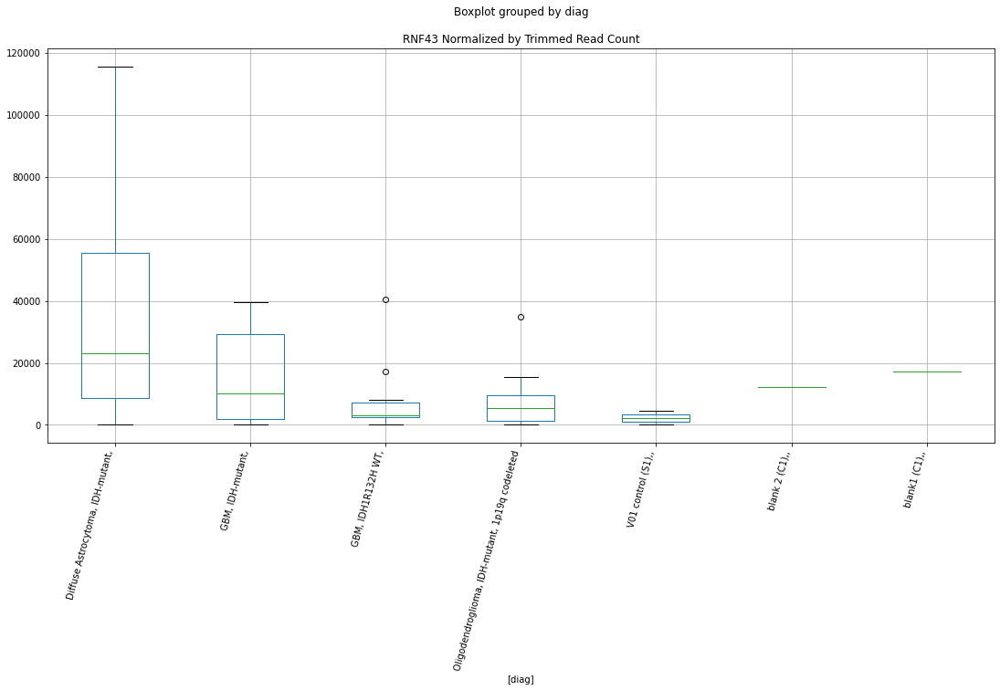

 p : 0.04108225173724838  ( t : 2.2003215769030637 ) :  D-plex  :  bbduk2  :  RBM26
Control and blanks
73     30147.33
337        0.00
Name: RBM26, dtype: float64
205    80053.66
Name: RBM26, dtype: float64
469    26027.2
Name: RBM26, dtype: float64


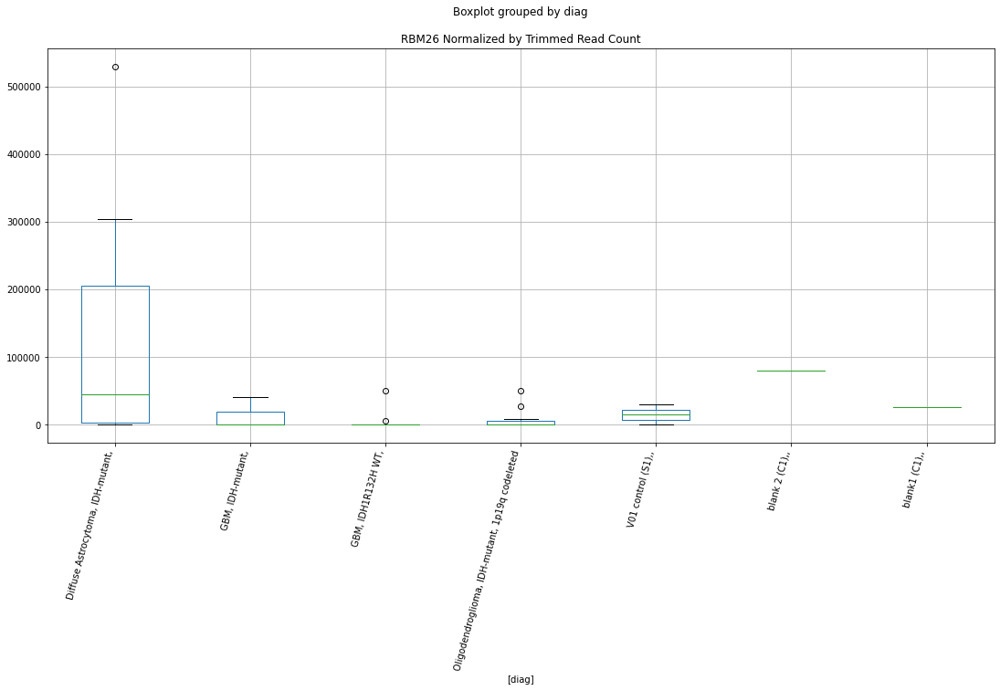

 p : 0.04111609030628802  ( t : 2.1999084188274263 ) :  D-plex  :  bbduk2  :  POLR2F
Control and blanks
73     0.0
337    0.0
Name: POLR2F, dtype: float64
205    1074.55
Name: POLR2F, dtype: float64
469    0.0
Name: POLR2F, dtype: float64


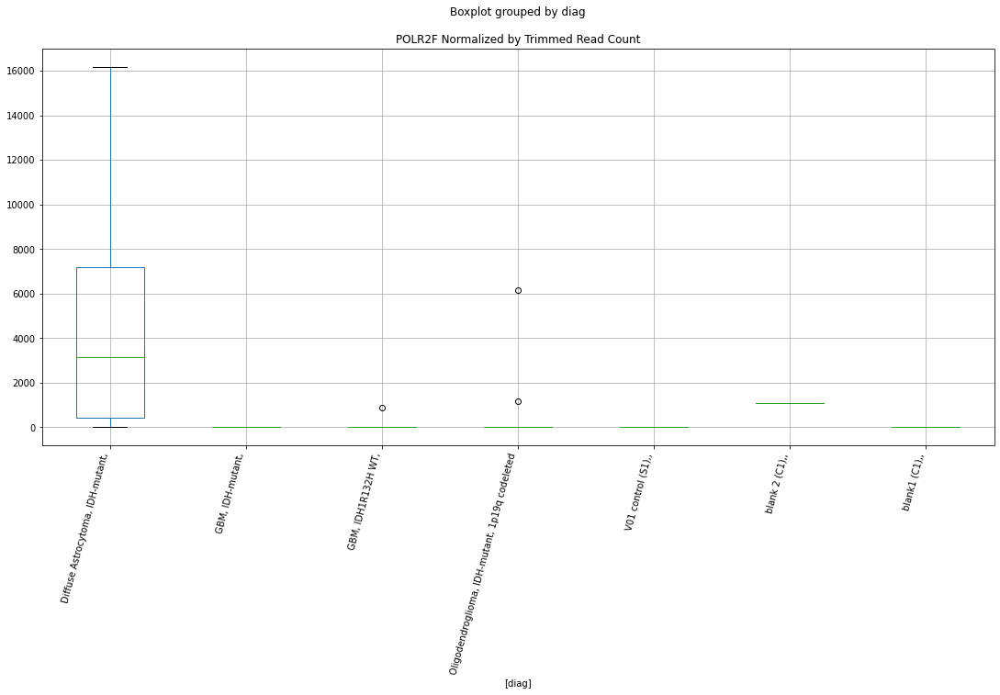

 p : 0.041148998060418294  ( t : 2.199506925103519 ) :  D-plex  :  bbduk2  :  SFRP5
Control and blanks
73     0.0
337    0.0
Name: SFRP5, dtype: float64
205    716.36
Name: SFRP5, dtype: float64
469    0.0
Name: SFRP5, dtype: float64


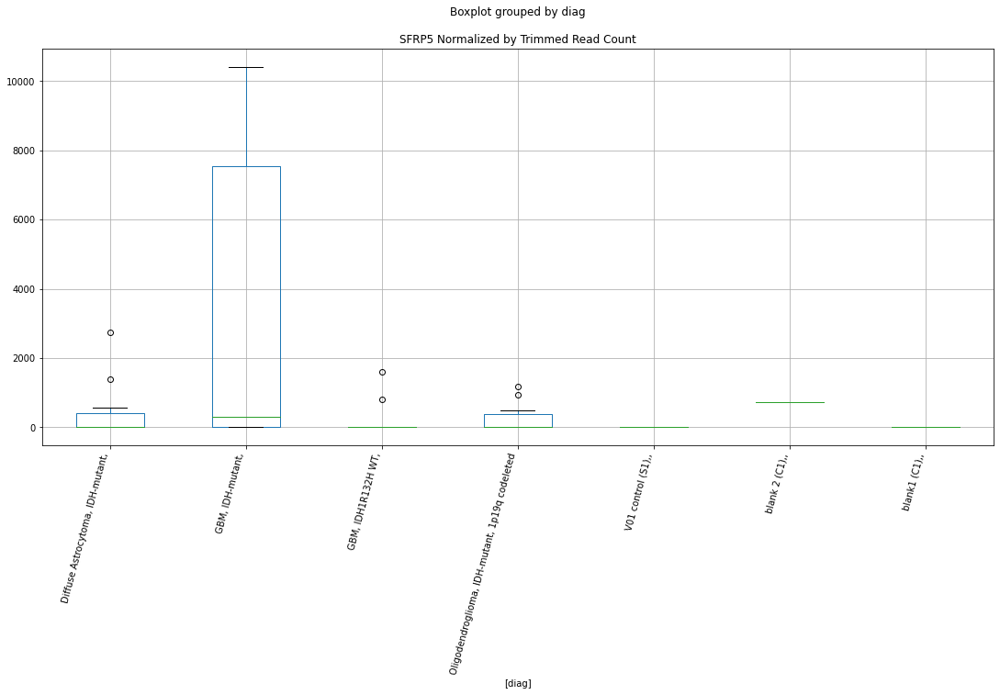

 p : 0.04122286193152215  ( t : 2.1986068155593697 ) :  D-plex  :  cutadapt2  :  RABGAP1L
Control and blanks
76     37880.71
340        0.00
Name: RABGAP1L, dtype: float64
208    12521.58
Name: RABGAP1L, dtype: float64
472    41034.86
Name: RABGAP1L, dtype: float64


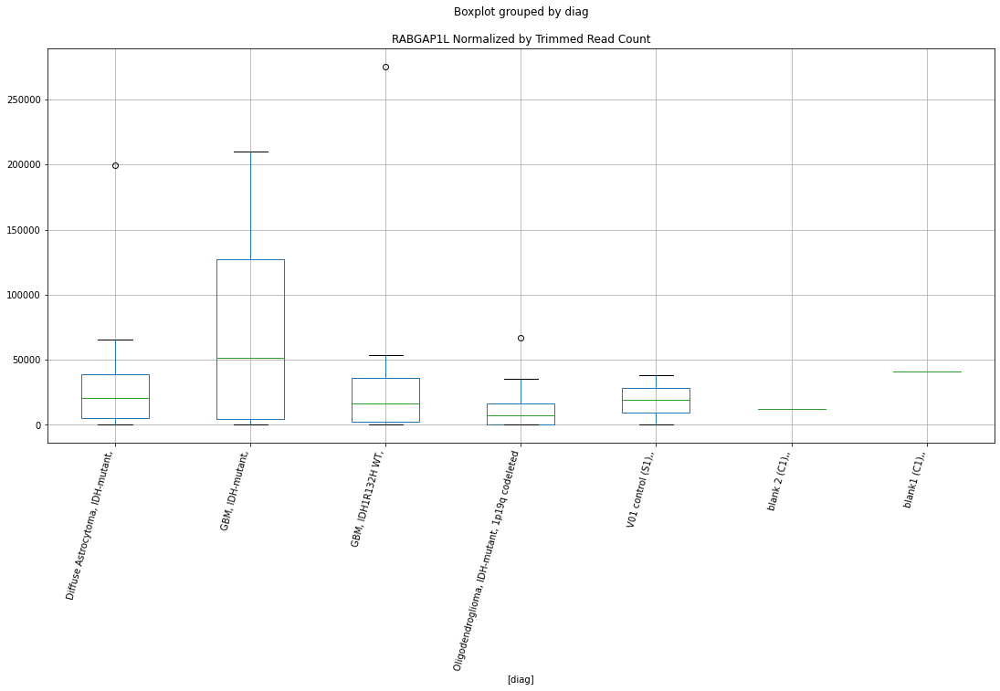

 p : 0.041267615513789394  ( t : 2.1980621659798745 ) :  D-plex  :  bbduk2  :  SIPA1L2
Control and blanks
73     5411.06
337    1780.31
Name: SIPA1L2, dtype: float64
205    19162.73
Name: SIPA1L2, dtype: float64
469    10055.96
Name: SIPA1L2, dtype: float64


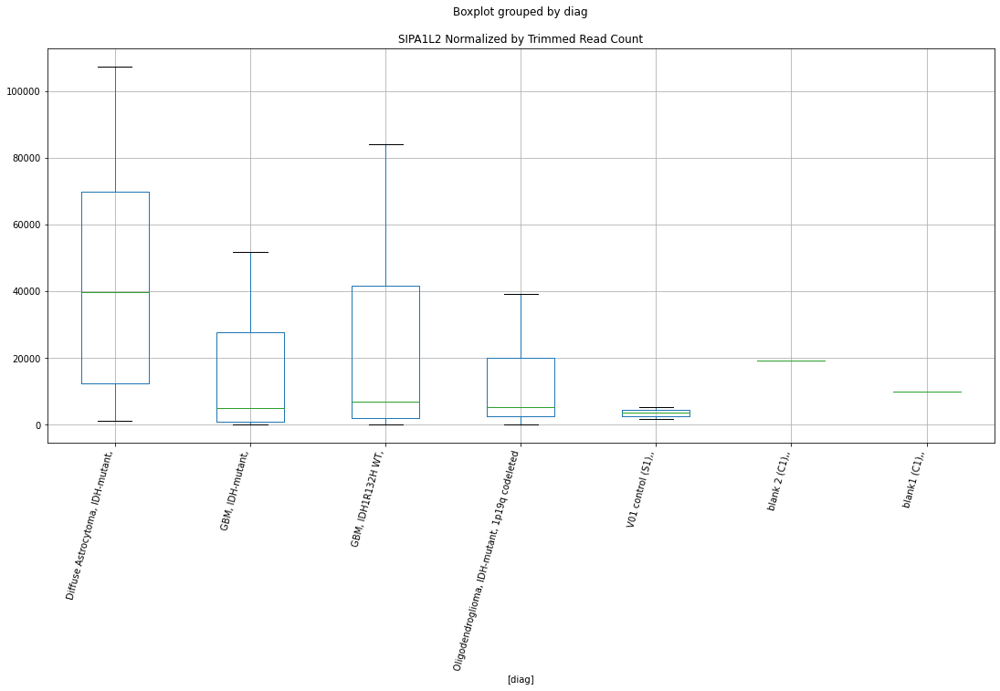

 p : 0.04129523400838417  ( t : 2.197726320397622 ) :  D-plex  :  bbduk2  :  RRAGD
Control and blanks
73     0.0
337    0.0
Name: RRAGD, dtype: float64
205    2507.27
Name: RRAGD, dtype: float64
469    3549.16
Name: RRAGD, dtype: float64


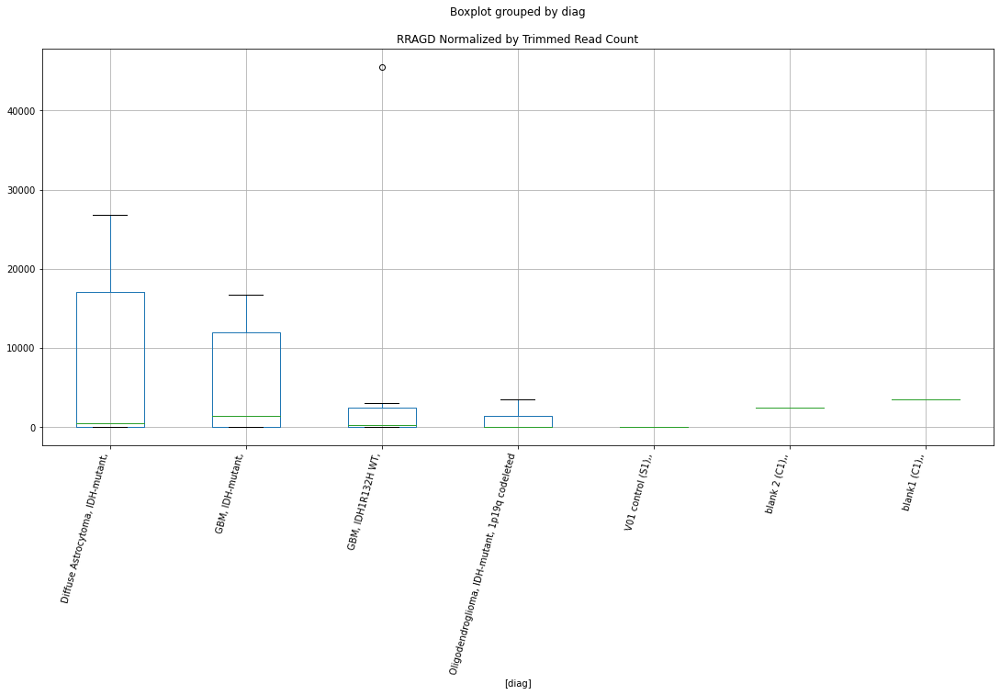

 p : 0.04131441951700319  ( t : 2.1974931427282143 ) :  D-plex  :  cutadapt2  :  SARS2
Control and blanks
76       9091.37
340    165577.64
Name: SARS2, dtype: float64
208    184120.07
Name: SARS2, dtype: float64
472    53171.94
Name: SARS2, dtype: float64


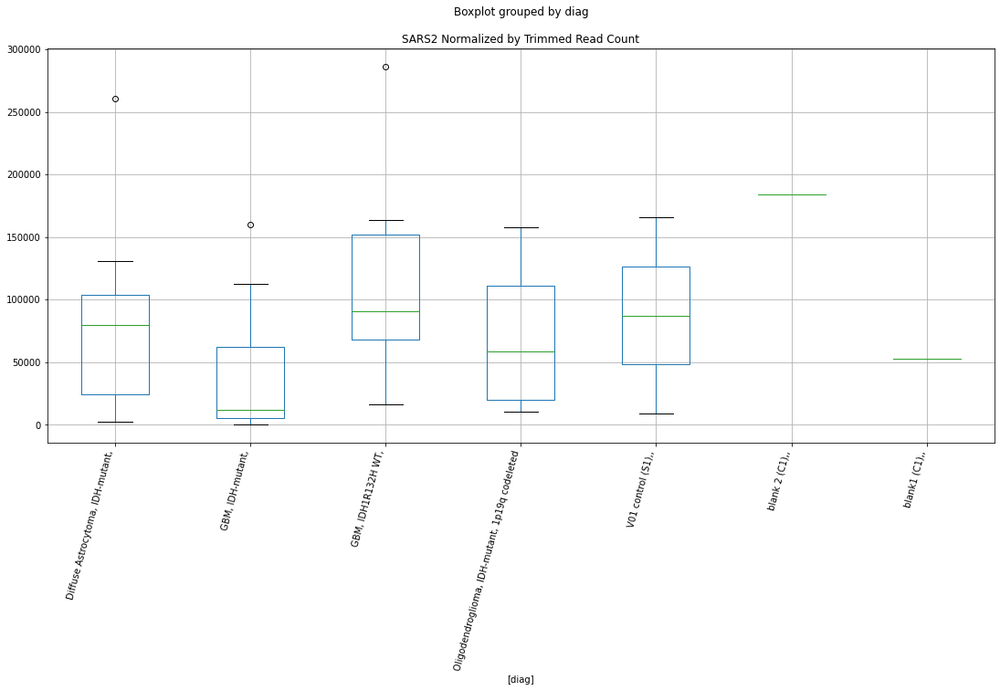

 p : 0.04132042547803616  ( t : 2.1974201676507685 ) :  D-plex  :  cutadapt2  :  SLC16A5
Control and blanks
76     0.0
340    0.0
Name: SLC16A5, dtype: float64
208    1410.88
Name: SLC16A5, dtype: float64
472    0.0
Name: SLC16A5, dtype: float64


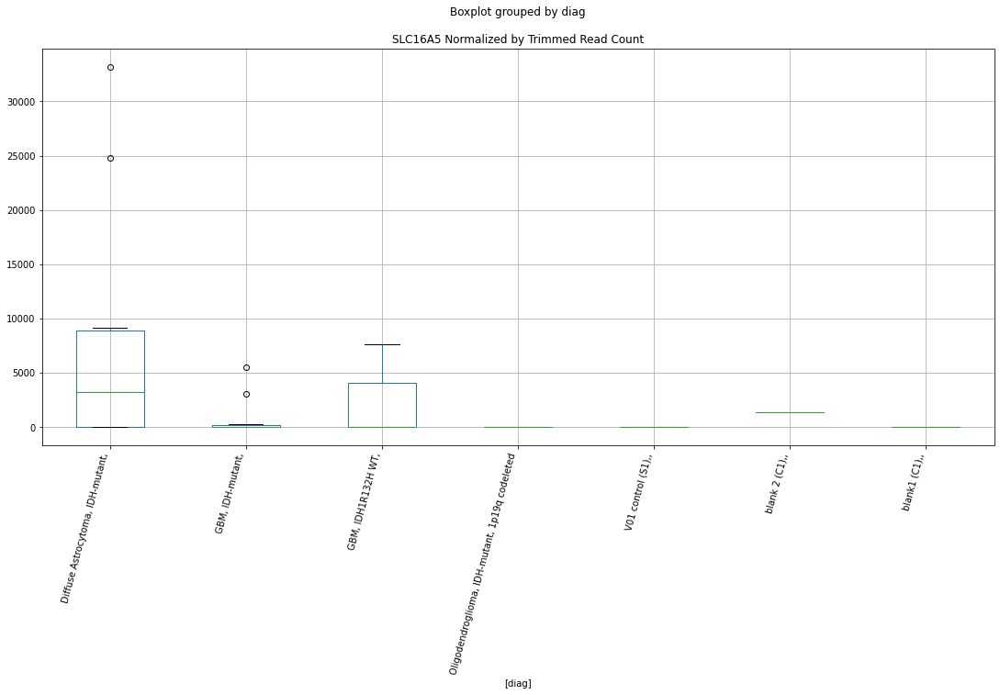

 p : 0.041350069088674626  ( t : 2.1970601272927293 ) :  D-plex  :  bbduk2  :  RNA28SN5
Control and blanks
73     2.23e+06
337    1.36e+06
Name: RNA28SN5, dtype: float64
205    1.54e+06
Name: RNA28SN5, dtype: float64
469    1.44e+06
Name: RNA28SN5, dtype: float64


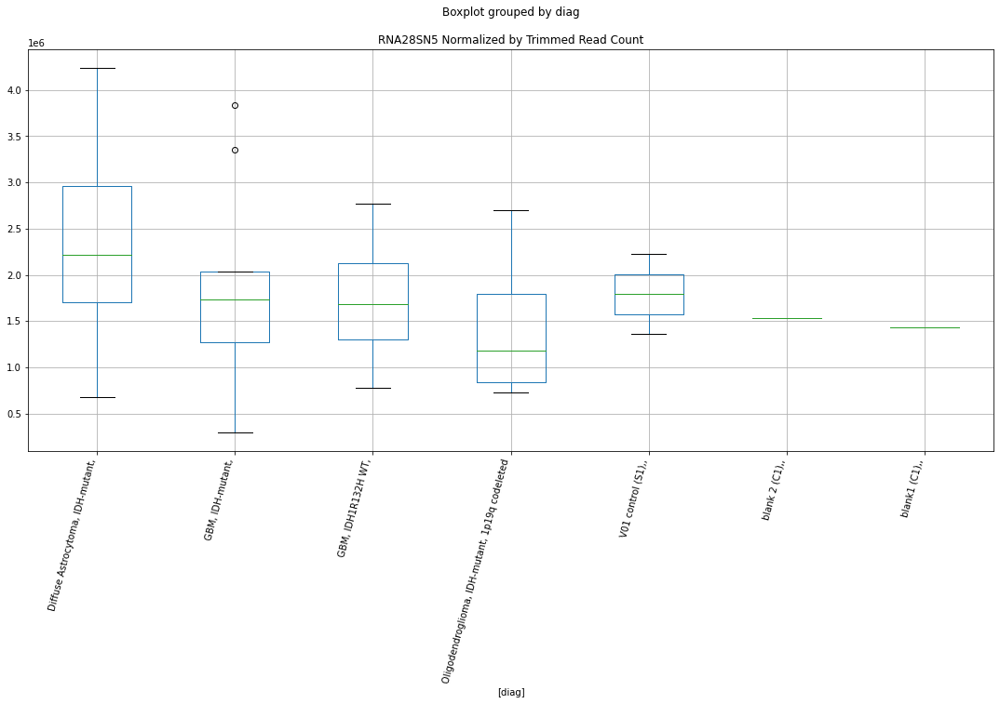

 p : 0.04142172738142325  ( t : 2.196190769939345 ) :  D-plex  :  cutadapt2  :  PRAME
Control and blanks
76     1515.23
340       0.00
Name: PRAME, dtype: float64
208    0.0
Name: PRAME, dtype: float64
472    13292.98
Name: PRAME, dtype: float64


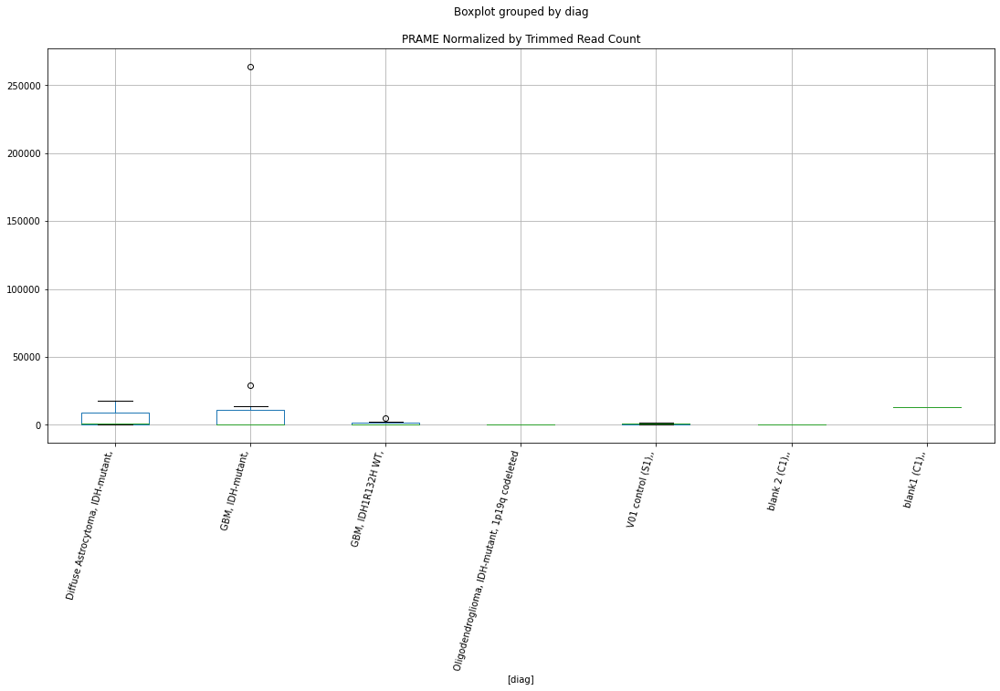

 p : 0.041469163732055406  ( t : 2.1956160320383096 ) :  Lexogen  :  bbduk2  :  SP2
Control and blanks
79         0.00
343    12738.86
Name: SP2, dtype: float64
211    0.0
Name: SP2, dtype: float64
475    0.0
Name: SP2, dtype: float64


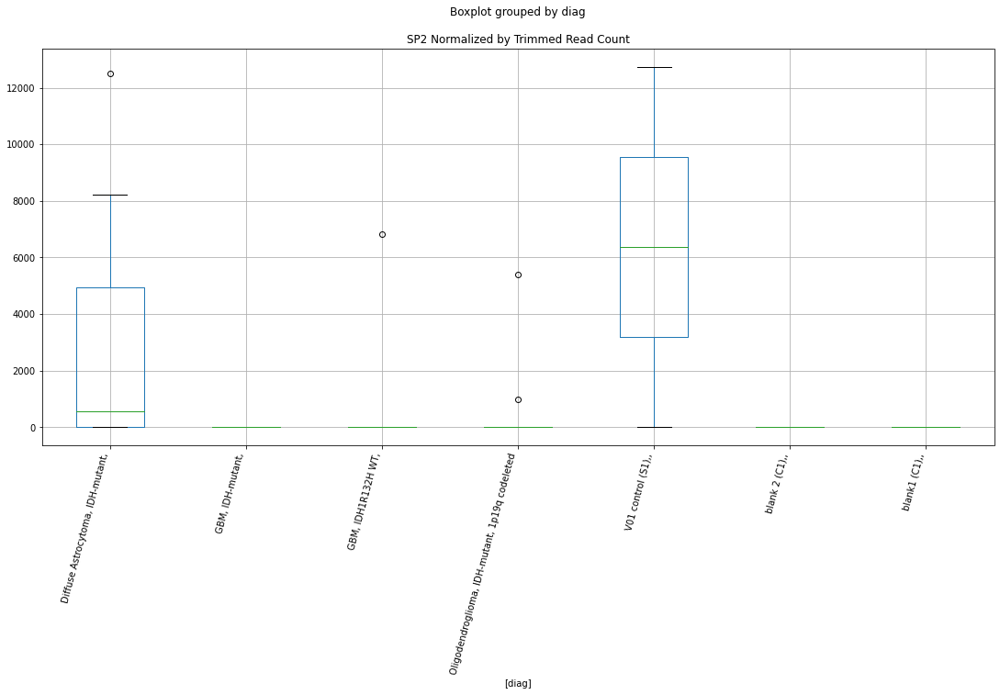

 p : 0.041486188930405225  ( t : 2.195409902234442 ) :  D-plex  :  bbduk2  :  PRAME
Control and blanks
73     1546.02
337       0.00
Name: PRAME, dtype: float64
205    0.0
Name: PRAME, dtype: float64
469    13605.13
Name: PRAME, dtype: float64


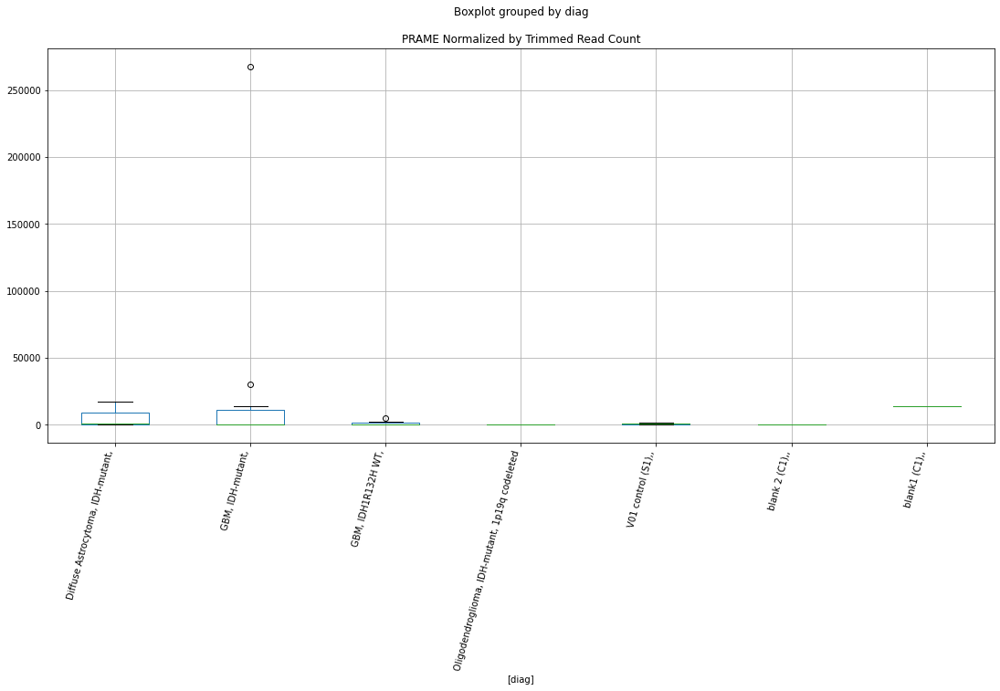

 p : 0.041563473897453414  ( t : 2.194475162354508 ) :  D-plex  :  bbduk2  :  RNF43
Control and blanks
73     4638.05
337       0.00
Name: RNF43, dtype: float64
205    14685.46
Name: RNF43, dtype: float64
469    28393.31
Name: RNF43, dtype: float64


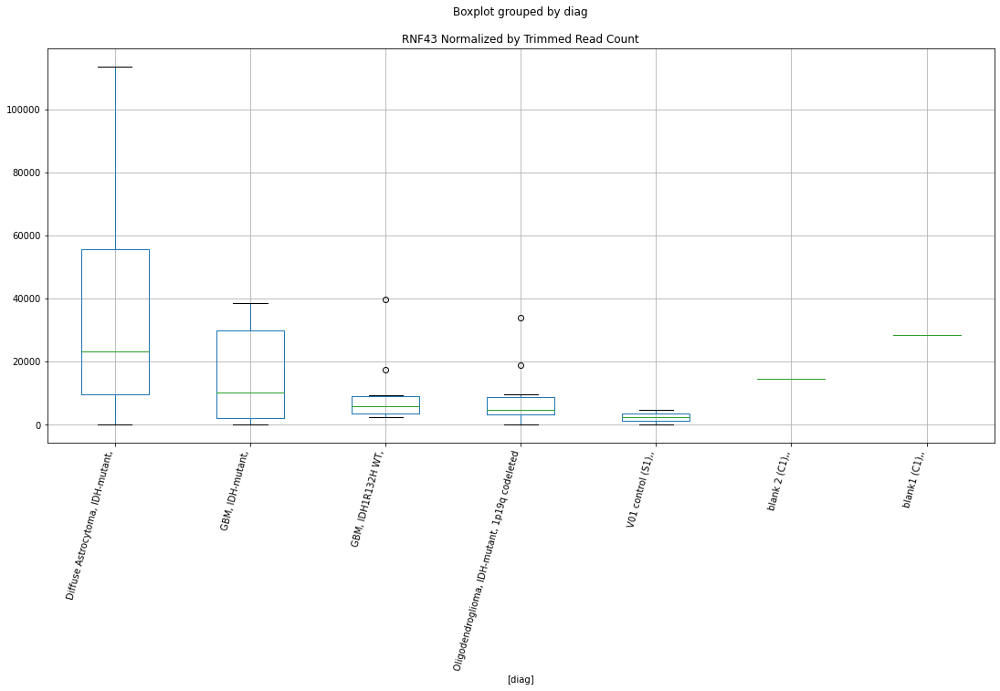

 p : 0.04163058231639186  ( t : 2.1936647981501847 ) :  Lexogen  :  bbduk2  :  SLC11A2
Control and blanks
79     0.0
343    0.0
Name: SLC11A2, dtype: float64
211    0.0
Name: SLC11A2, dtype: float64
475    479.03
Name: SLC11A2, dtype: float64


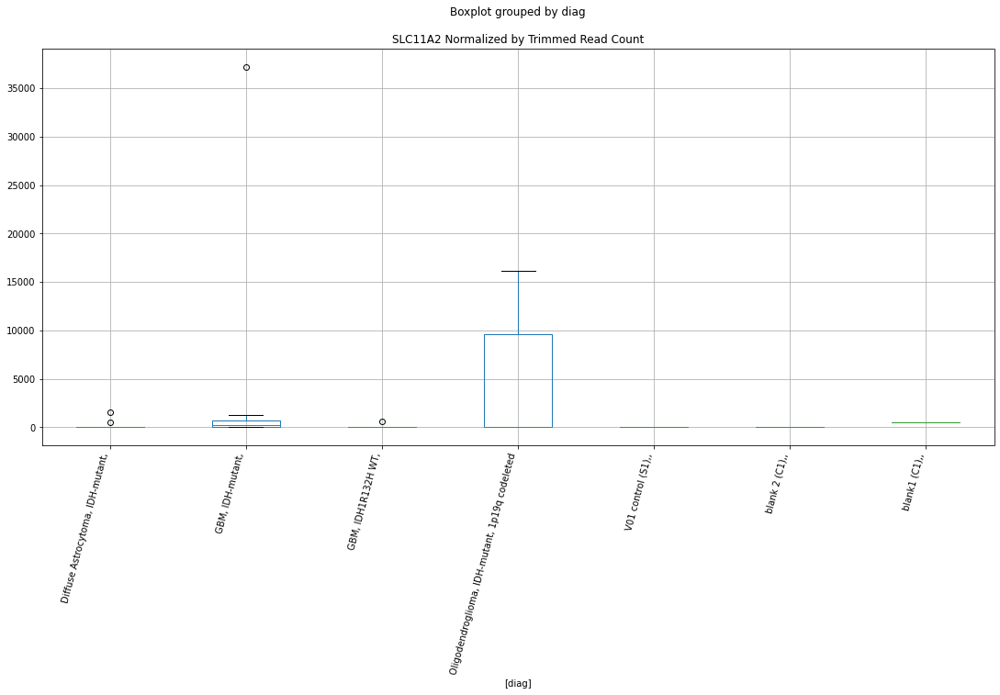

 p : 0.04167161147396722  ( t : 2.1931699430929177 ) :  D-plex  :  cutadapt2  :  SLC4A3
Control and blanks
76        0.00
340    4403.66
Name: SLC4A3, dtype: float64
208    12697.94
Name: SLC4A3, dtype: float64
472    19650.5
Name: SLC4A3, dtype: float64


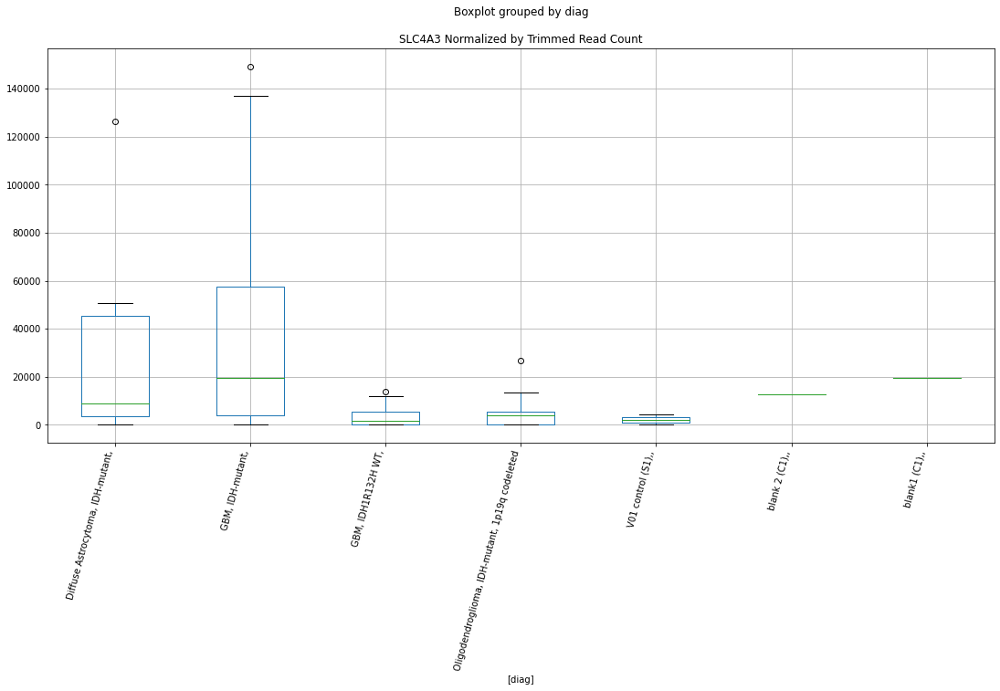

 p : 0.04167876856868543  ( t : 2.193083666764921 ) :  D-plex  :  cutadapt2  :  SIDT1
Control and blanks
76     0.0
340    0.0
Name: SIDT1, dtype: float64
208    8112.57
Name: SIDT1, dtype: float64
472    13292.98
Name: SIDT1, dtype: float64


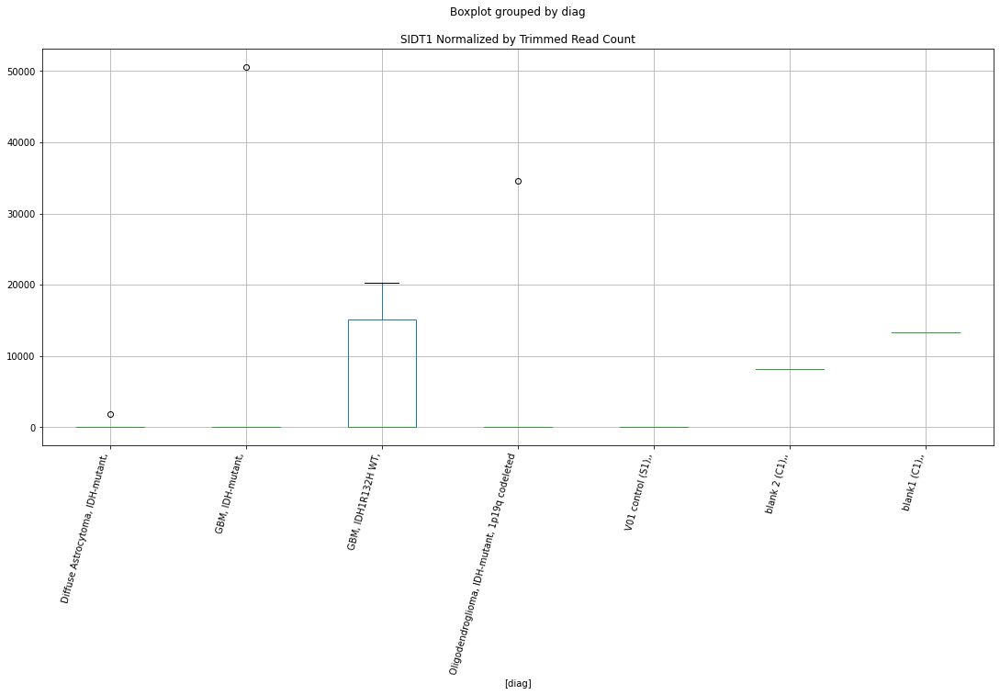

 p : 0.04171923471436054  ( t : 2.1925961168389065 ) :  Lexogen  :  cutadapt2  :  SLC11A2
Control and blanks
82     0.0
346    0.0
Name: SLC11A2, dtype: float64
214    0.0
Name: SLC11A2, dtype: float64
478    474.92
Name: SLC11A2, dtype: float64


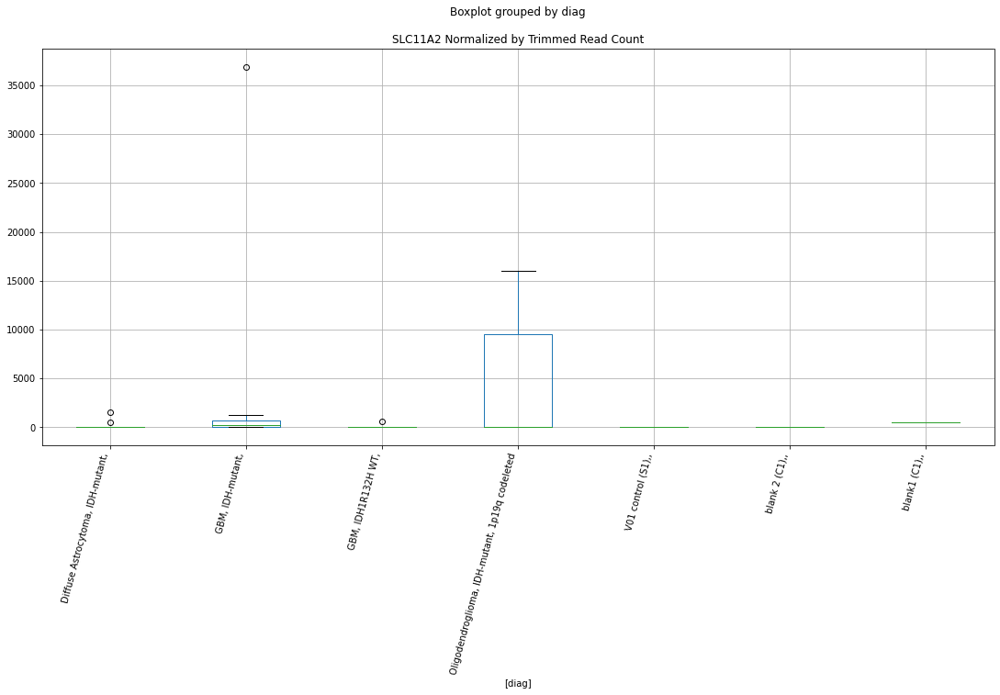

 p : 0.04173934401426826  ( t : 2.192353994535093 ) :  Lexogen  :  cutadapt2  :  PC
Control and blanks
82     0.0
346    0.0
Name: PC, dtype: float64
214    0.0
Name: PC, dtype: float64
478    0.0
Name: PC, dtype: float64


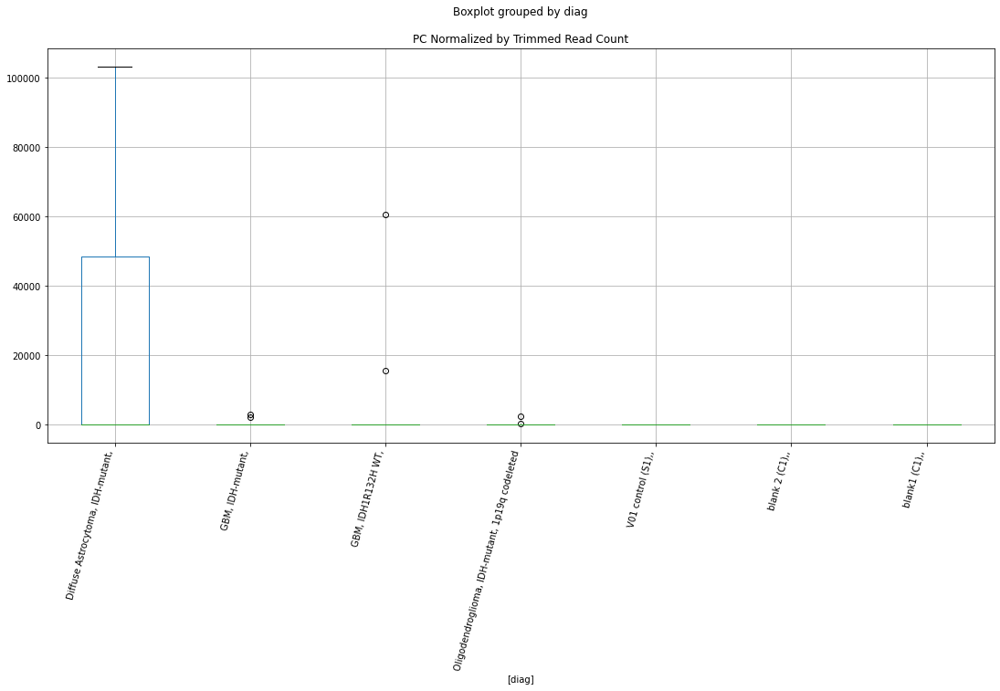

 p : 0.04174927945941352  ( t : 2.1922344081547287 ) :  D-plex  :  cutadapt2  :  RHCE
Control and blanks
76      7576.14
340    65174.18
Name: RHCE, dtype: float64
208    4409.01
Name: RHCE, dtype: float64
472    4623.65
Name: RHCE, dtype: float64


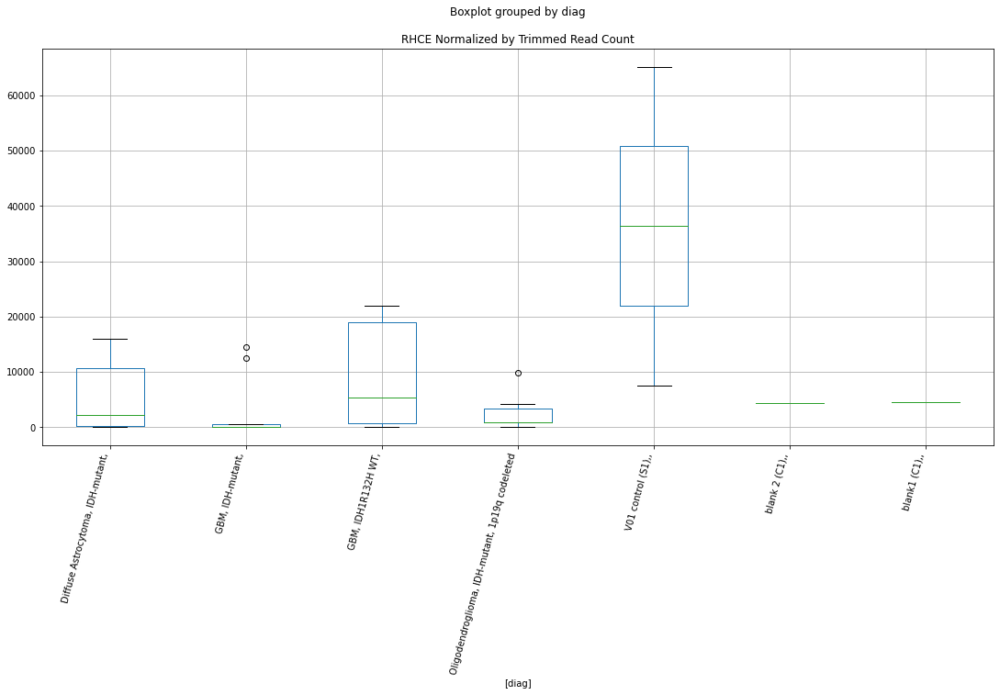

 p : 0.04175132692508106  ( t : 2.192209767410565 ) :  D-plex  :  bbduk2  :  PCYT1A
Control and blanks
73         0.00
337    32045.66
Name: PCYT1A, dtype: float64
205    1432.73
Name: PCYT1A, dtype: float64
469    2957.64
Name: PCYT1A, dtype: float64


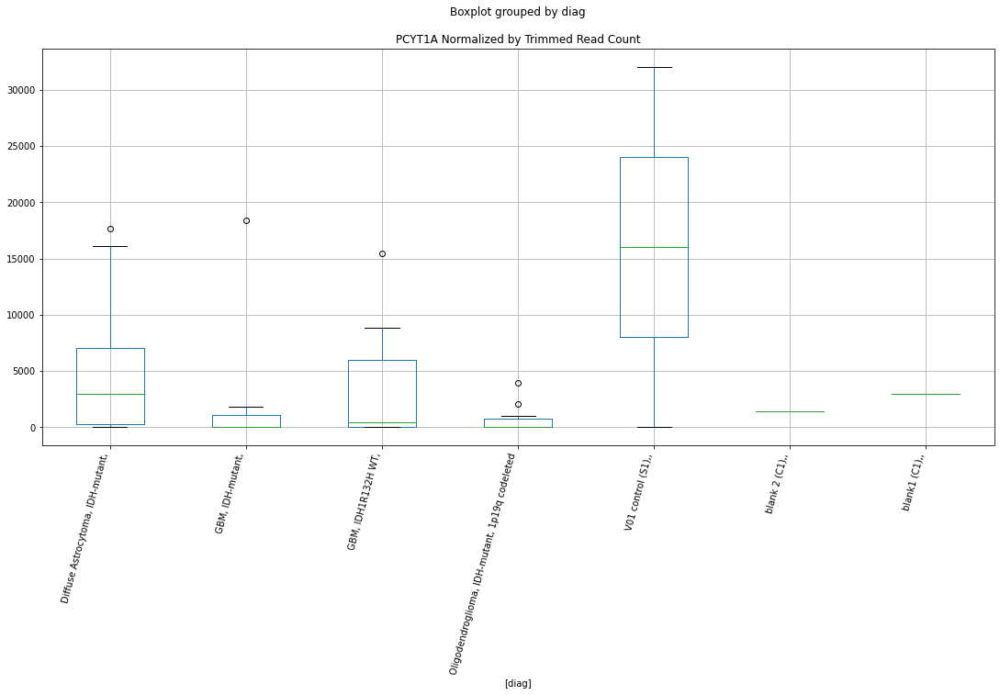

 p : 0.041794327876175034  ( t : 2.1916925176049835 ) :  Lexogen  :  cutadapt2  :  POU6F1
Control and blanks
82        0.00
346    5260.86
Name: POU6F1, dtype: float64
214    759434.07
Name: POU6F1, dtype: float64
478    154349.31
Name: POU6F1, dtype: float64


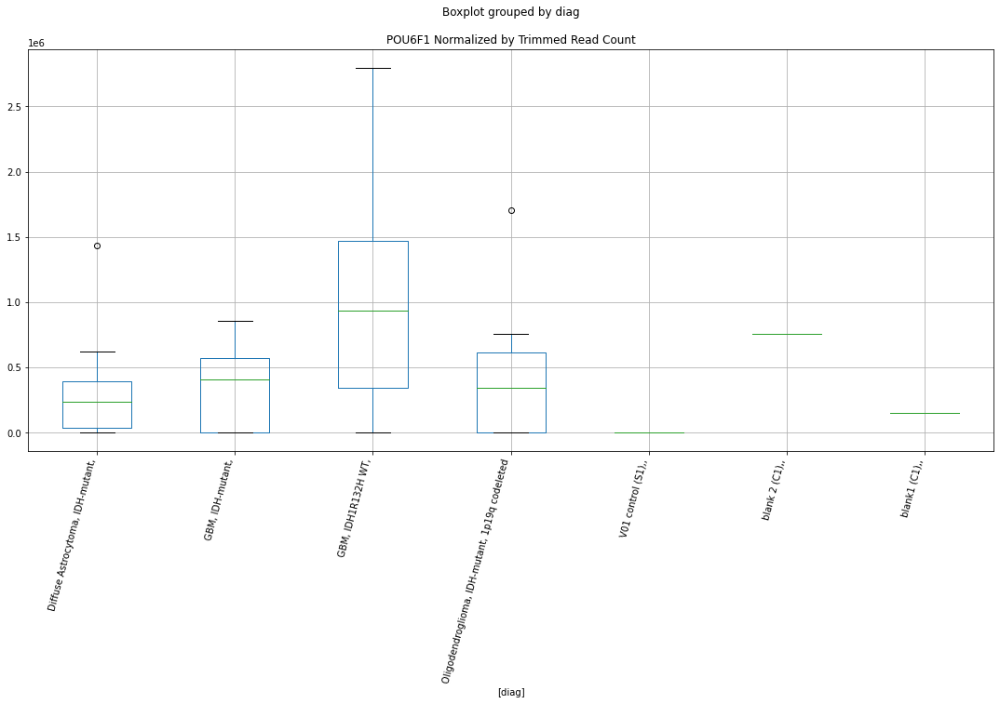

 p : 0.04184440298471922  ( t : 2.1910907892827933 ) :  D-plex  :  bbduk2  :  SLC30A8
Control and blanks
73     0.0
337    0.0
Name: SLC30A8, dtype: float64
205    6447.27
Name: SLC30A8, dtype: float64
469    14196.66
Name: SLC30A8, dtype: float64


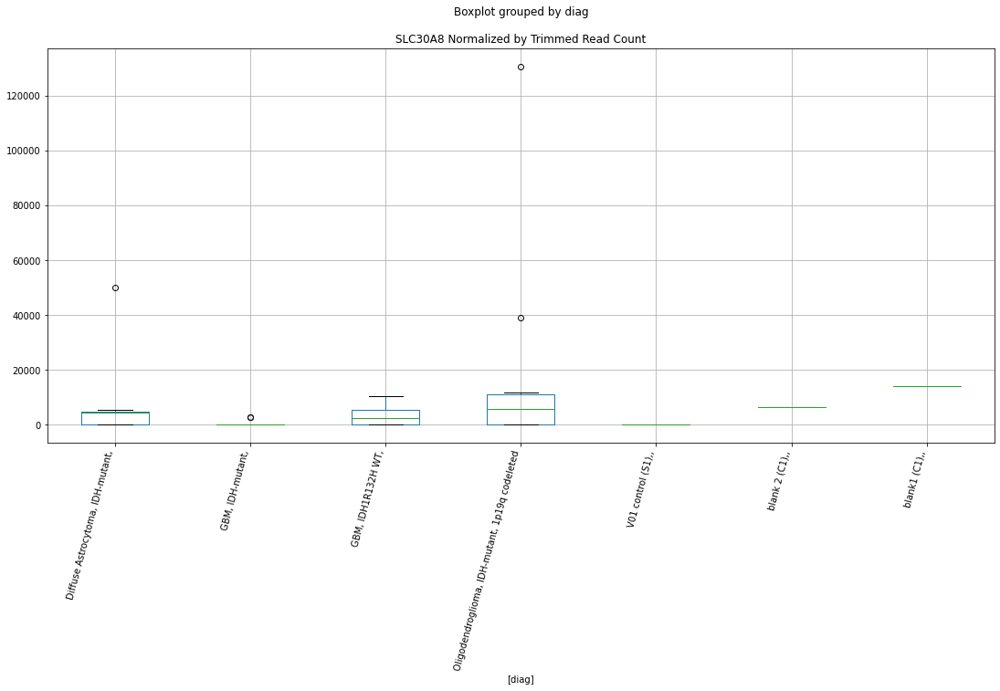

 p : 0.04184843290515951  ( t : 2.191042392412642 ) :  Lexogen  :  cutadapt2  :  SP6
Control and blanks
82     0.0
346    0.0
Name: SP6, dtype: float64
214    0.0
Name: SP6, dtype: float64
478    0.0
Name: SP6, dtype: float64


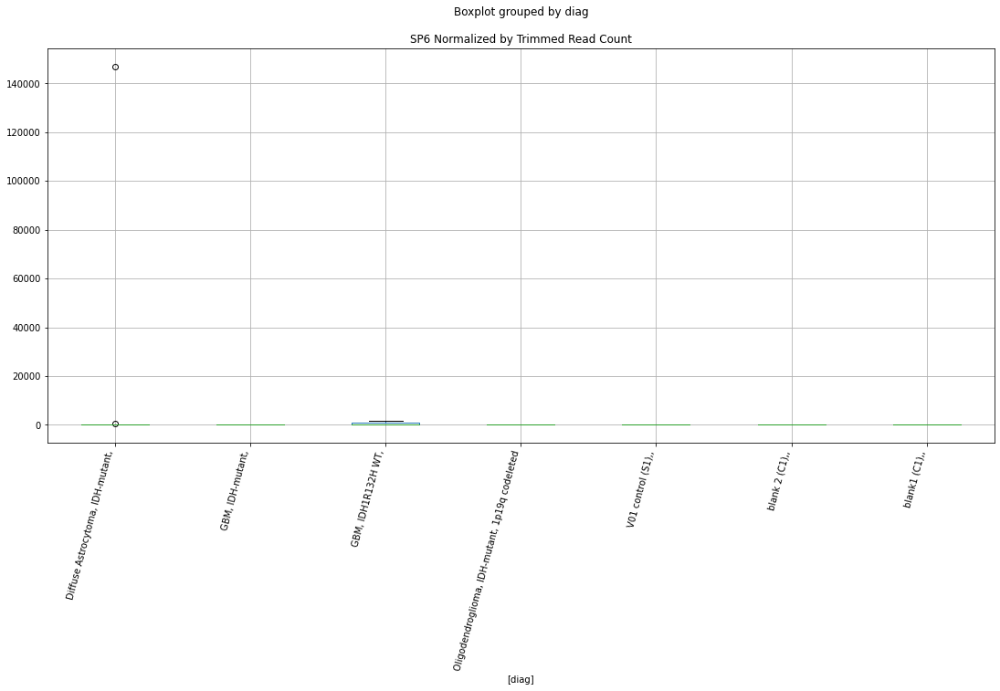

 p : 0.04186136246355218  ( t : 2.190887145219593 ) :  Lexogen  :  bbduk2  :  SP6
Control and blanks
79     0.0
343    0.0
Name: SP6, dtype: float64
211    0.0
Name: SP6, dtype: float64
475    0.0
Name: SP6, dtype: float64


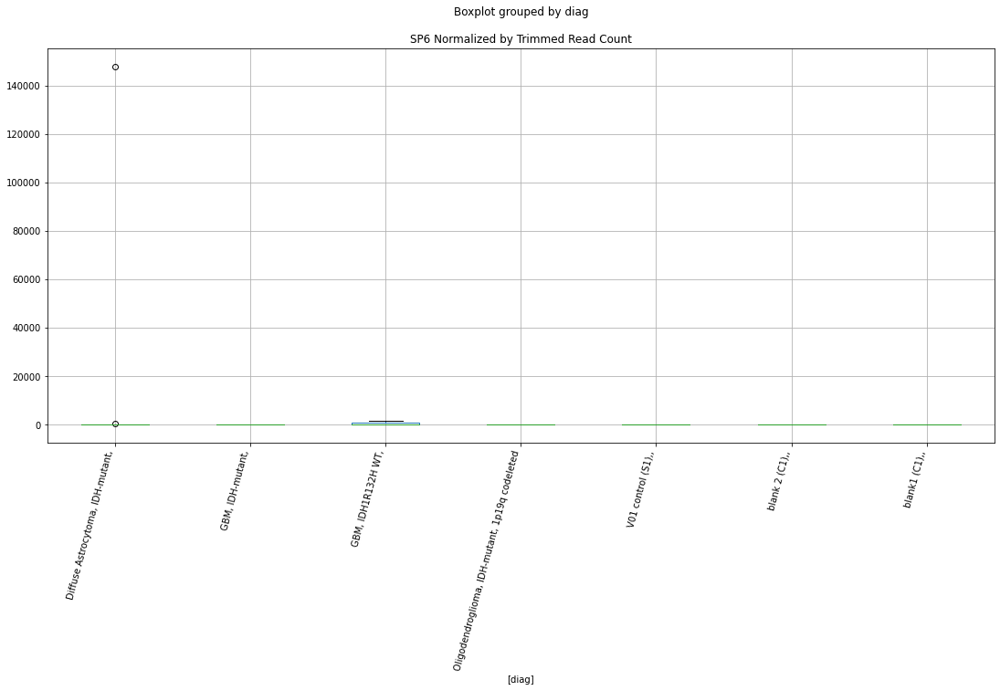

 p : 0.041896310611202914  ( t : 2.190467737520771 ) :  D-plex  :  cutadapt2  :  PPP1R15A
Control and blanks
76     46972.08
340    49321.00
Name: PPP1R15A, dtype: float64
208    66487.8
Name: PPP1R15A, dtype: float64
472    20228.45
Name: PPP1R15A, dtype: float64


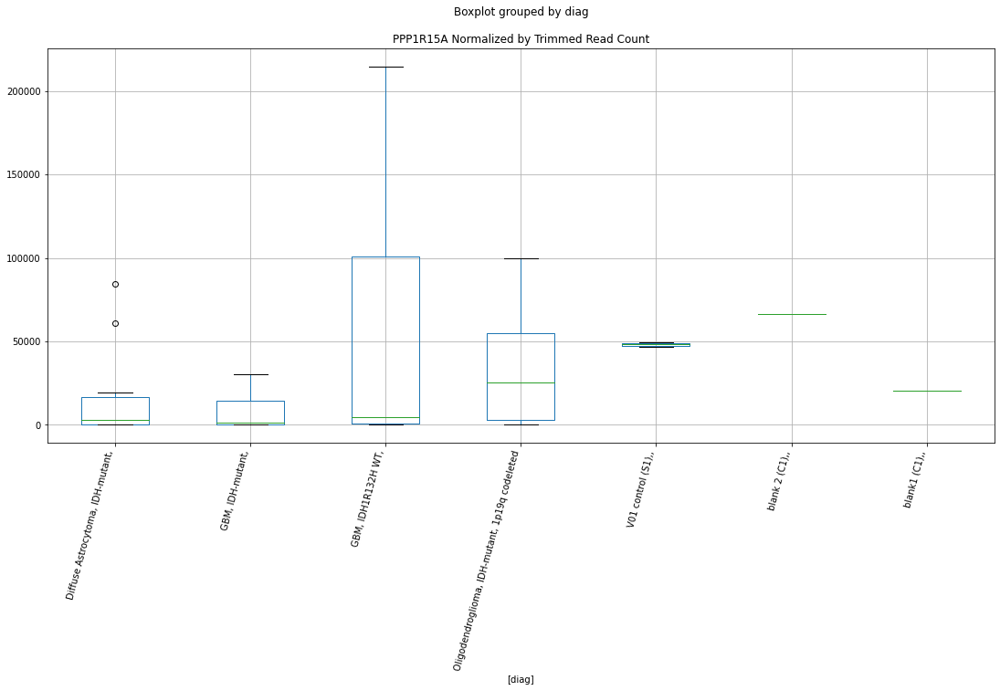

 p : 0.04198212803904938  ( t : 2.189439215172087 ) :  D-plex  :  bbduk2  :  SLC16A5
Control and blanks
73     0.0
337    0.0
Name: SLC16A5, dtype: float64
205    1432.73
Name: SLC16A5, dtype: float64
469    0.0
Name: SLC16A5, dtype: float64


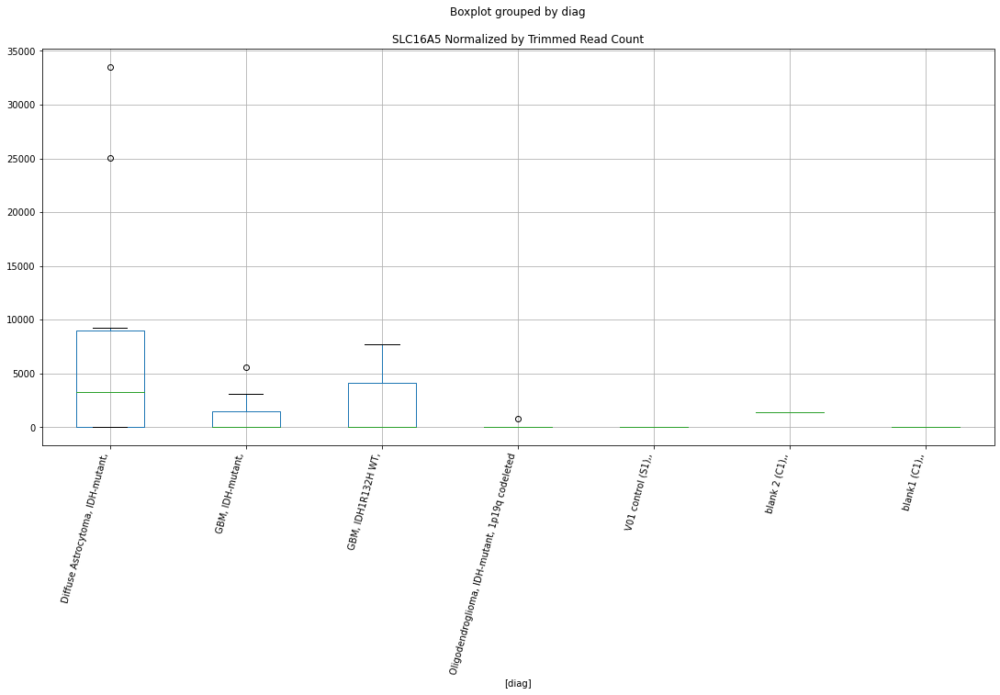

 p : 0.041986714463335295  ( t : 2.1893843011662257 ) :  D-plex  :  bbduk2  :  PPP1R12B
Control and blanks
73     9276.1
337       0.0
Name: PPP1R12B, dtype: float64
205    17550.91
Name: PPP1R12B, dtype: float64
469    14196.66
Name: PPP1R12B, dtype: float64


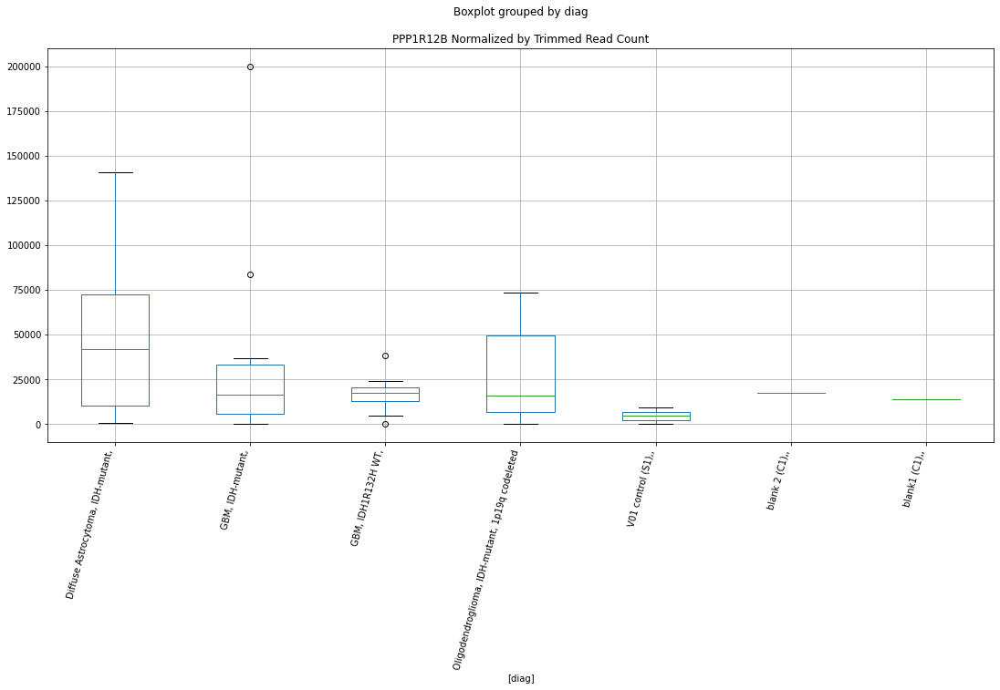

 p : 0.041996474350312916  ( t : 2.189267462760993 ) :  Lexogen  :  bbduk2  :  PRKD3
Control and blanks
79       0.00
343    212.31
Name: PRKD3, dtype: float64
211    0.0
Name: PRKD3, dtype: float64
475    33532.2
Name: PRKD3, dtype: float64


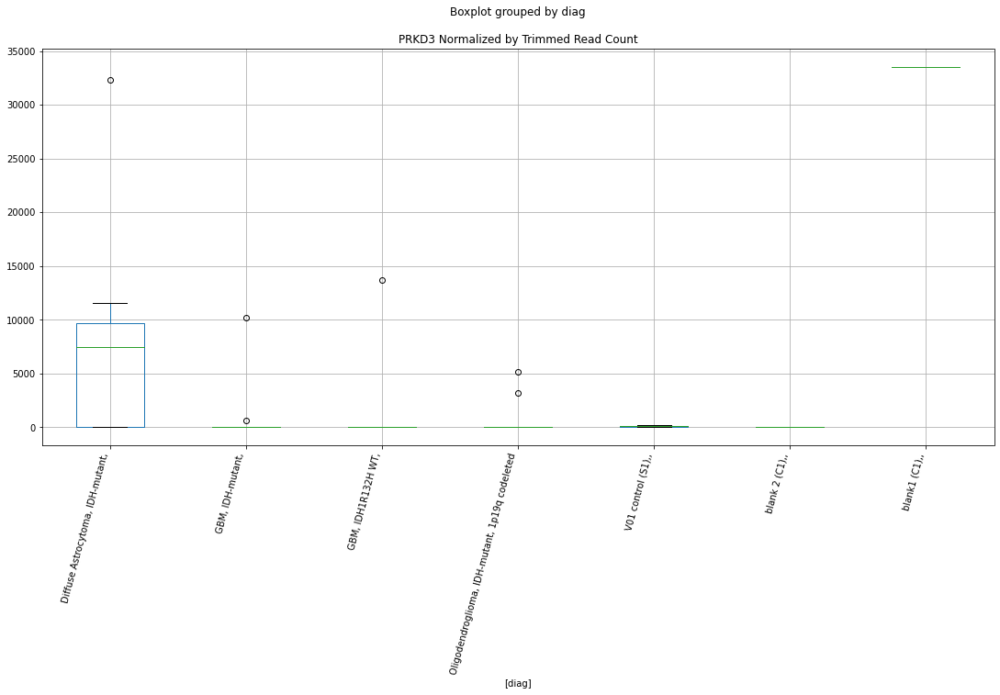

 p : 0.04201392481202109  ( t : 2.1890586203534674 ) :  Lexogen  :  bbduk2  :  POU6F1
Control and blanks
79       0.00
343    424.63
Name: POU6F1, dtype: float64
211    765257.74
Name: POU6F1, dtype: float64
475    155685.23
Name: POU6F1, dtype: float64


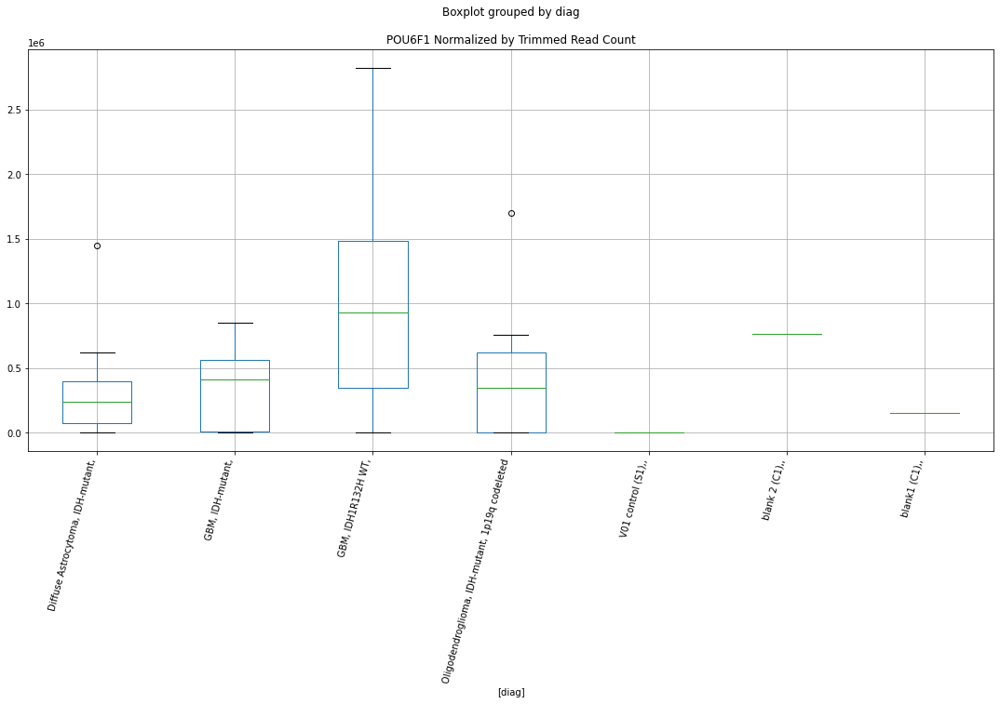

 p : 0.042016318035673926  ( t : 2.1890299851051904 ) :  D-plex  :  bbduk2  :  SFRP5
Control and blanks
73     0.0
337    0.0
Name: SFRP5, dtype: float64
205    716.36
Name: SFRP5, dtype: float64
469    0.0
Name: SFRP5, dtype: float64


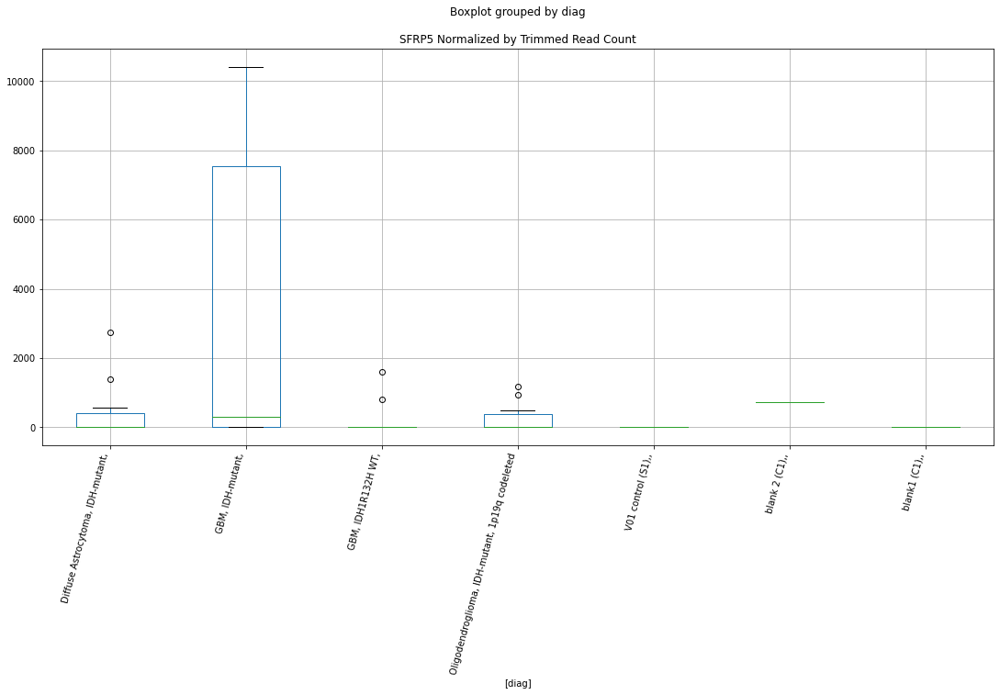

 p : 0.042027781873920714  ( t : 2.1888928394595517 ) :  Lexogen  :  cutadapt2  :  PFKP
Control and blanks
82     0.0
346    0.0
Name: PFKP, dtype: float64
214    0.0
Name: PFKP, dtype: float64
478    0.0
Name: PFKP, dtype: float64


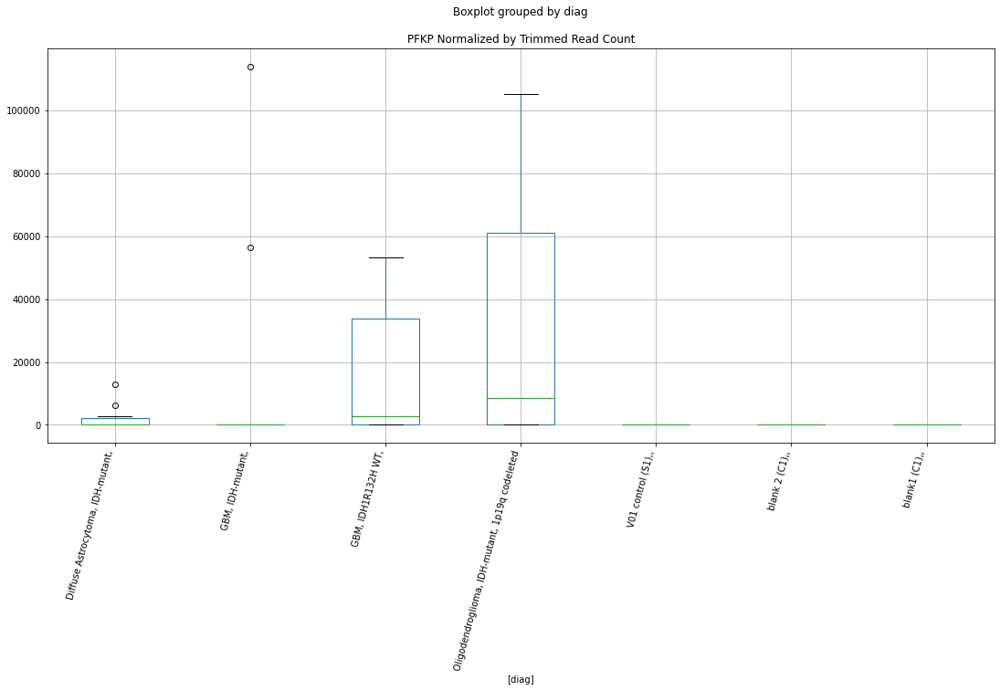

 p : 0.042039710952992436  ( t : 2.1887501644161405 ) :  Lexogen  :  bbduk2  :  PC
Control and blanks
79        0.0
343    2972.4
Name: PC, dtype: float64
211    0.0
Name: PC, dtype: float64
475    0.0
Name: PC, dtype: float64


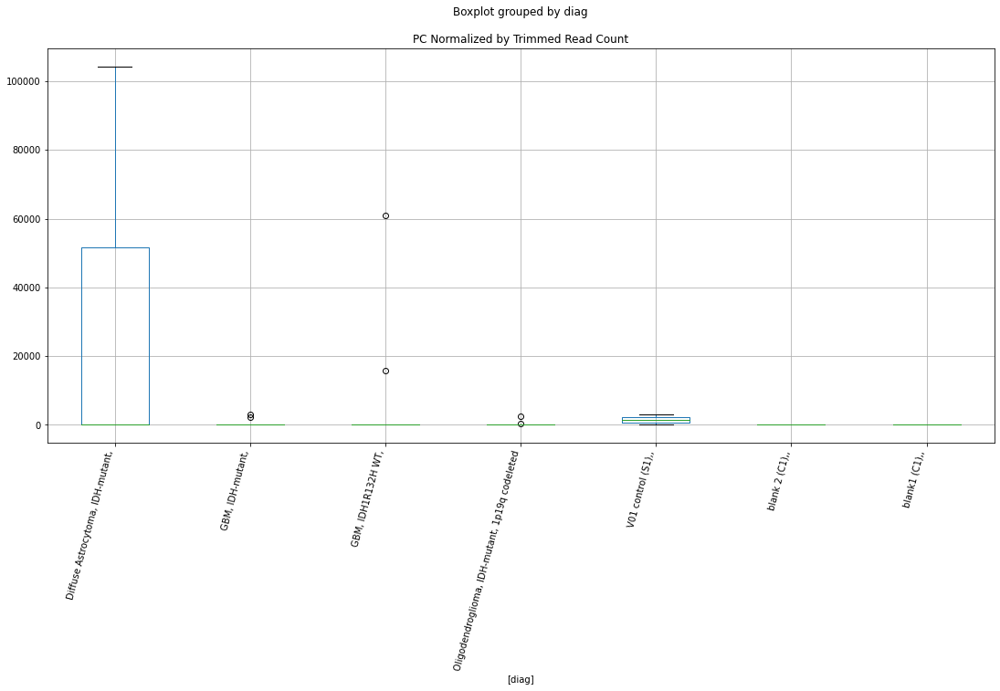

 p : 0.04214984077667147  ( t : 2.1874347328764645 ) :  D-plex  :  cutadapt2  :  RNA18SN4
Control and blanks
76     1.99e+06
340    1.15e+06
Name: RNA18SN4, dtype: float64
208    950757.93
Name: RNA18SN4, dtype: float64
472    1.13e+06
Name: RNA18SN4, dtype: float64


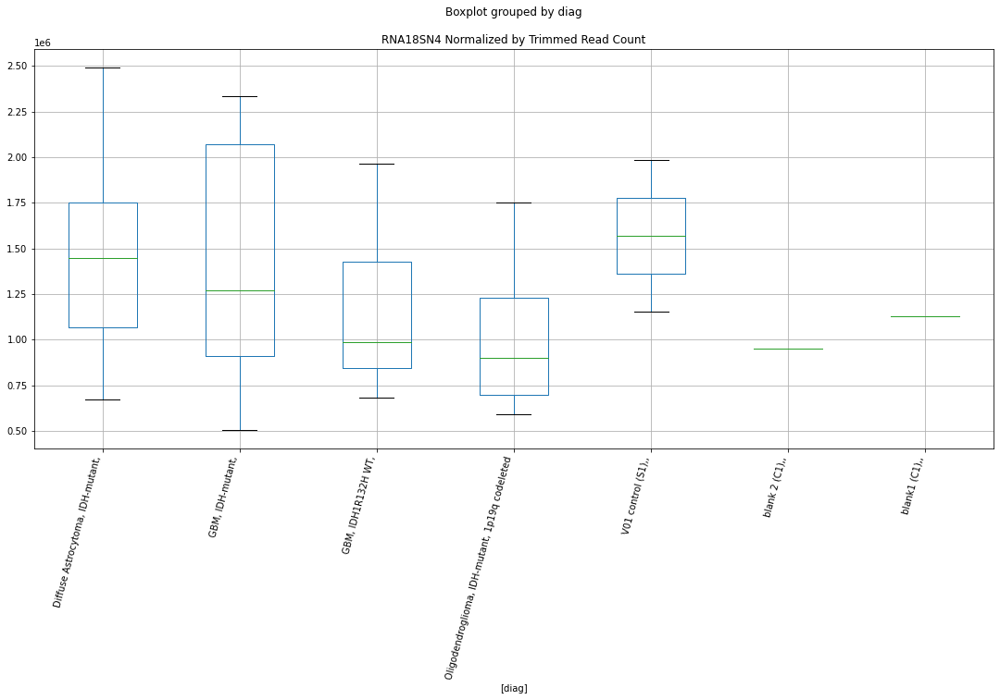

 p : 0.042154100655183616  ( t : 2.1873839146618748 ) :  D-plex  :  cutadapt2  :  RNA18SN2
Control and blanks
76     1.99e+06
340    1.15e+06
Name: RNA18SN2, dtype: float64
208    950757.93
Name: RNA18SN2, dtype: float64
472    1.13e+06
Name: RNA18SN2, dtype: float64


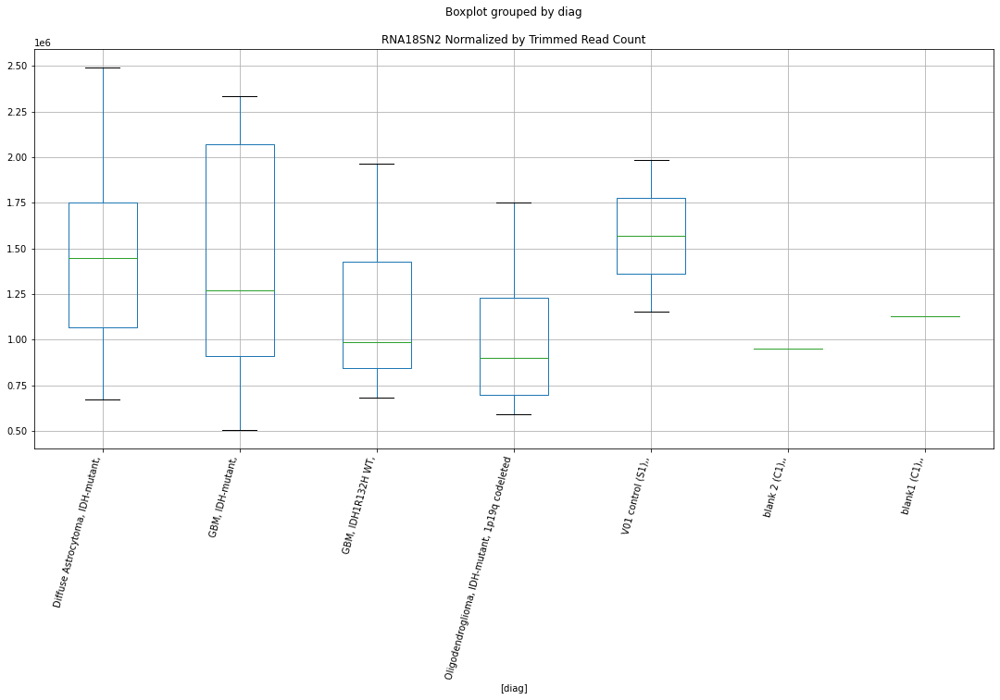

 p : 0.04216490582504494  ( t : 2.1872550355271585 ) :  D-plex  :  bbduk2  :  PLD5
Control and blanks
73     0.0
337    0.0
Name: PLD5, dtype: float64
205    9850.0
Name: PLD5, dtype: float64
469    2957.64
Name: PLD5, dtype: float64


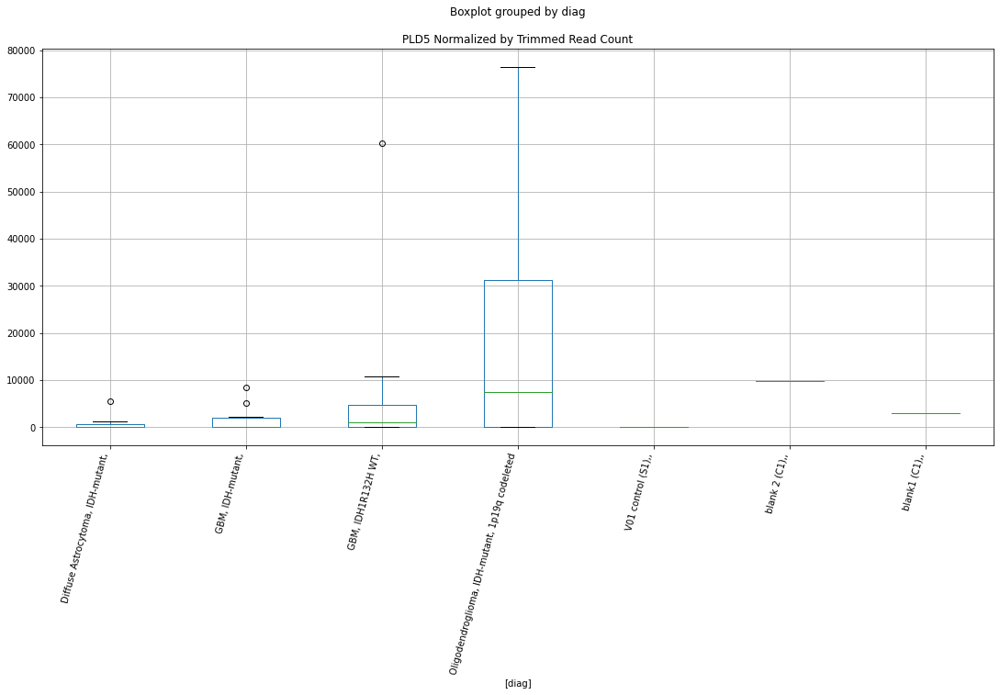

 p : 0.042180973598496485  ( t : 2.1870634424636237 ) :  D-plex  :  bbduk2  :  PDE6G
Control and blanks
73     0.0
337    0.0
Name: PDE6G, dtype: float64
205    4298.18
Name: PDE6G, dtype: float64
469    14196.66
Name: PDE6G, dtype: float64


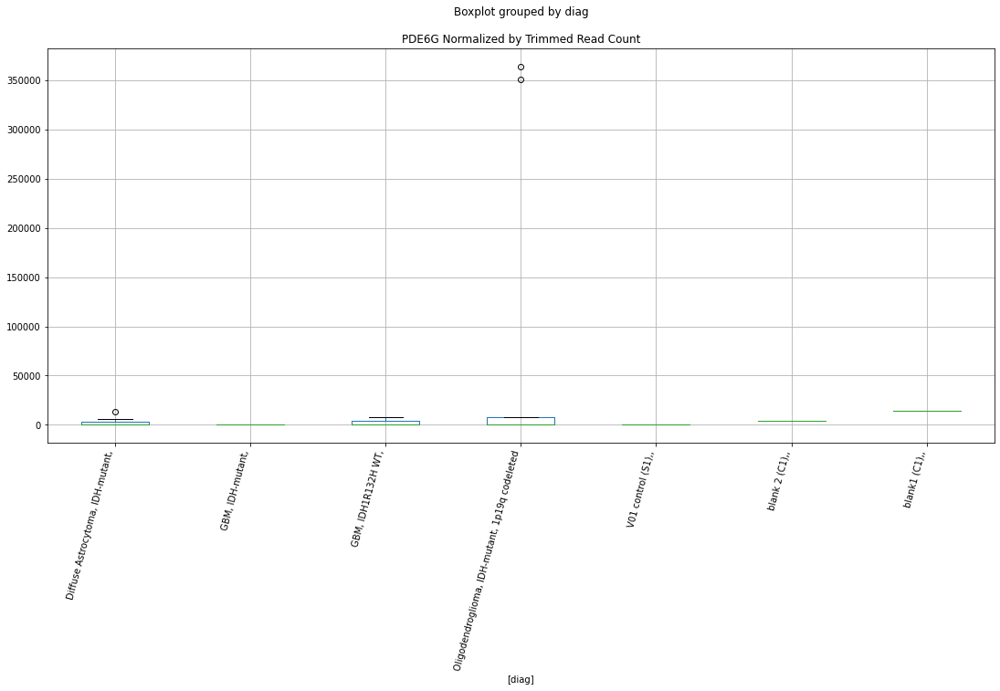

 p : 0.04219687103411361  ( t : 2.1868739463858784 ) :  D-plex  :  cutadapt2  :  RNA18SN3
Control and blanks
76     1.98e+06
340    1.15e+06
Name: RNA18SN3, dtype: float64
208    950405.21
Name: RNA18SN3, dtype: float64
472    1.13e+06
Name: RNA18SN3, dtype: float64


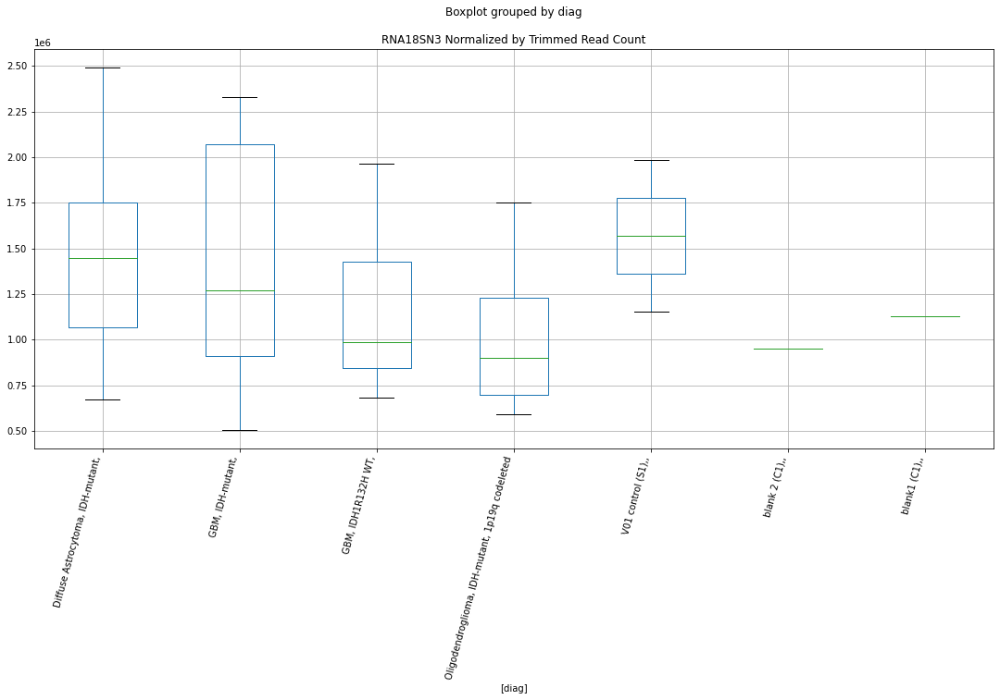

 p : 0.0422093363891562  ( t : 2.186725406211356 ) :  D-plex  :  bbduk2  :  RPA3
Control and blanks
73     70343.76
337        0.00
Name: RPA3, dtype: float64
205    49608.19
Name: RPA3, dtype: float64
469    5323.75
Name: RPA3, dtype: float64


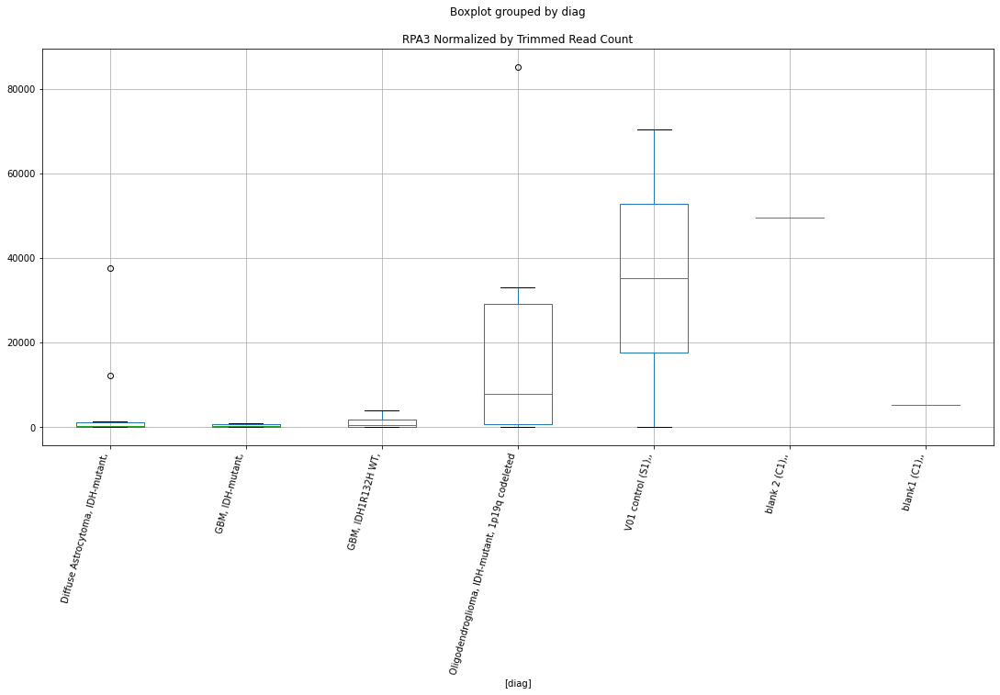

 p : 0.04225841907340469  ( t : 2.186140915947277 ) :  Lexogen  :  cutadapt2  :  PLXNB3
Control and blanks
82     0.0
346    0.0
Name: PLXNB3, dtype: float64
214    0.0
Name: PLXNB3, dtype: float64
478    0.0
Name: PLXNB3, dtype: float64


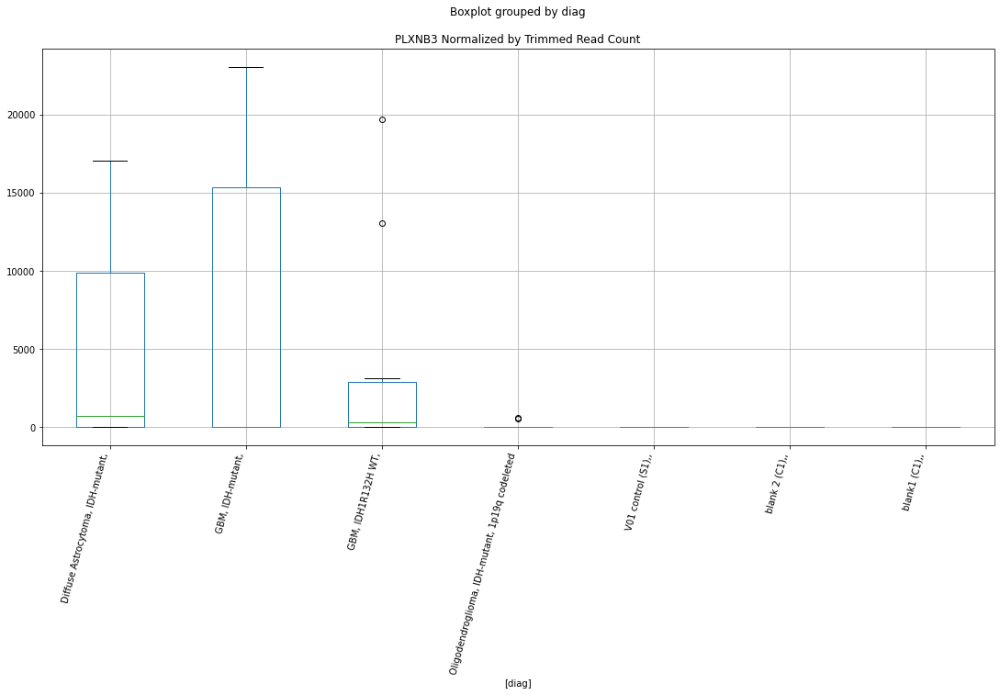

 p : 0.04227132600209066  ( t : 2.185987320039703 ) :  Lexogen  :  bbduk2  :  RGS9BP
Control and blanks
79       0.00
343    424.63
Name: RGS9BP, dtype: float64
211    0.0
Name: RGS9BP, dtype: float64
475    0.0
Name: RGS9BP, dtype: float64


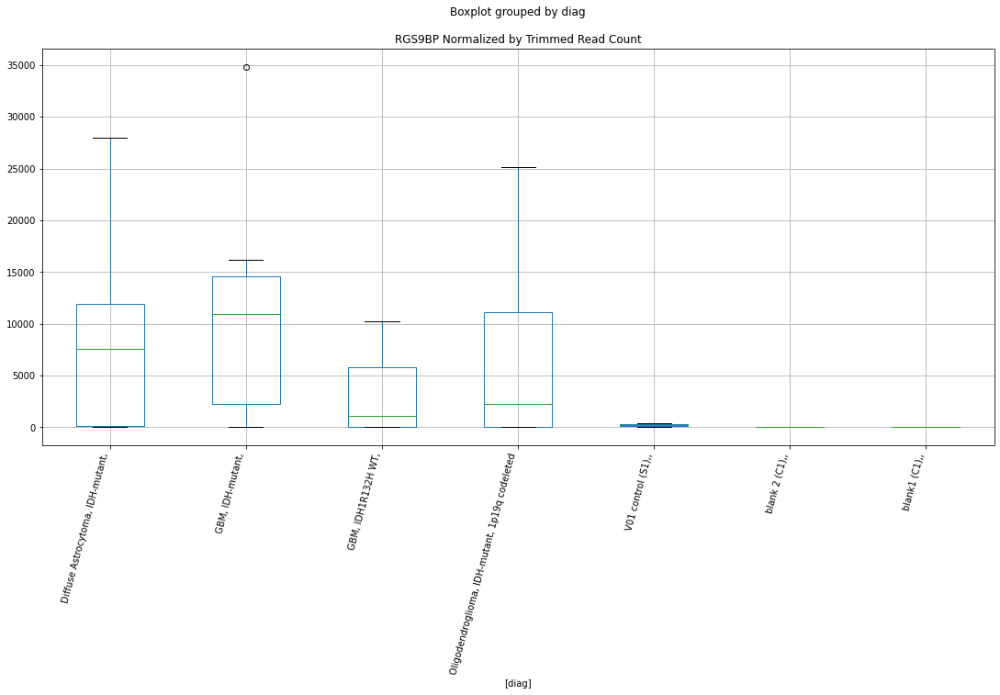

 p : 0.04232545463173384  ( t : 2.1853436429019912 ) :  Lexogen  :  bbduk2  :  SOX11
Control and blanks
79     0.0
343    0.0
Name: SOX11, dtype: float64
211    0.0
Name: SOX11, dtype: float64
475    0.0
Name: SOX11, dtype: float64


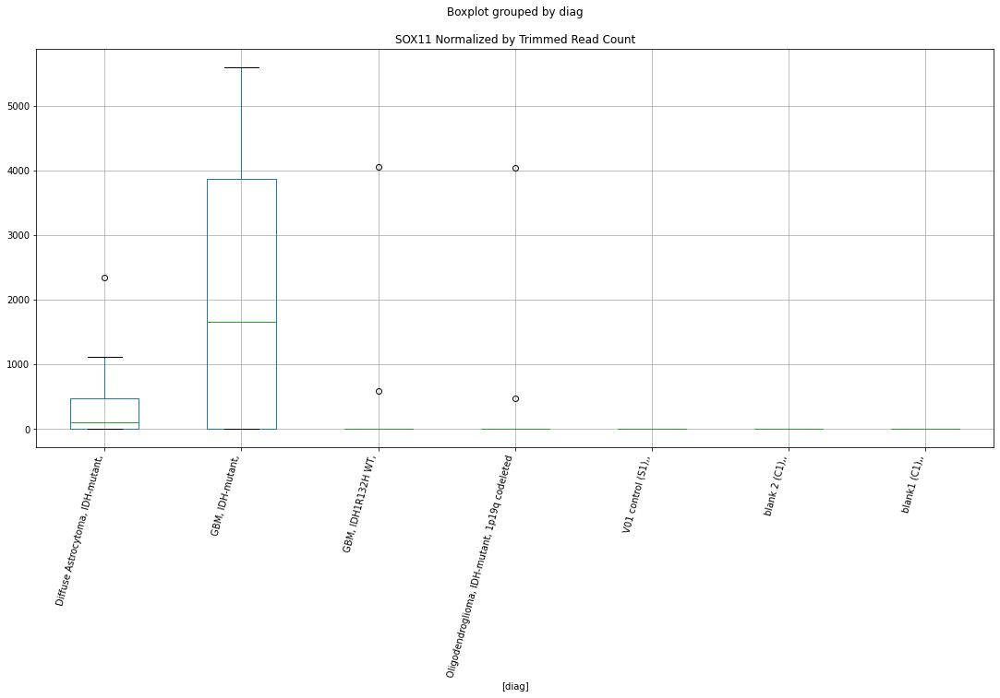

 p : 0.04234234322565636  ( t : 2.1851429646555802 ) :  D-plex  :  bbduk2  :  RNA18SN2
Control and blanks
73     2.00e+06
337    1.21e+06
Name: RNA18SN2, dtype: float64
205    964762.96
Name: RNA18SN2, dtype: float64
469    1.16e+06
Name: RNA18SN2, dtype: float64


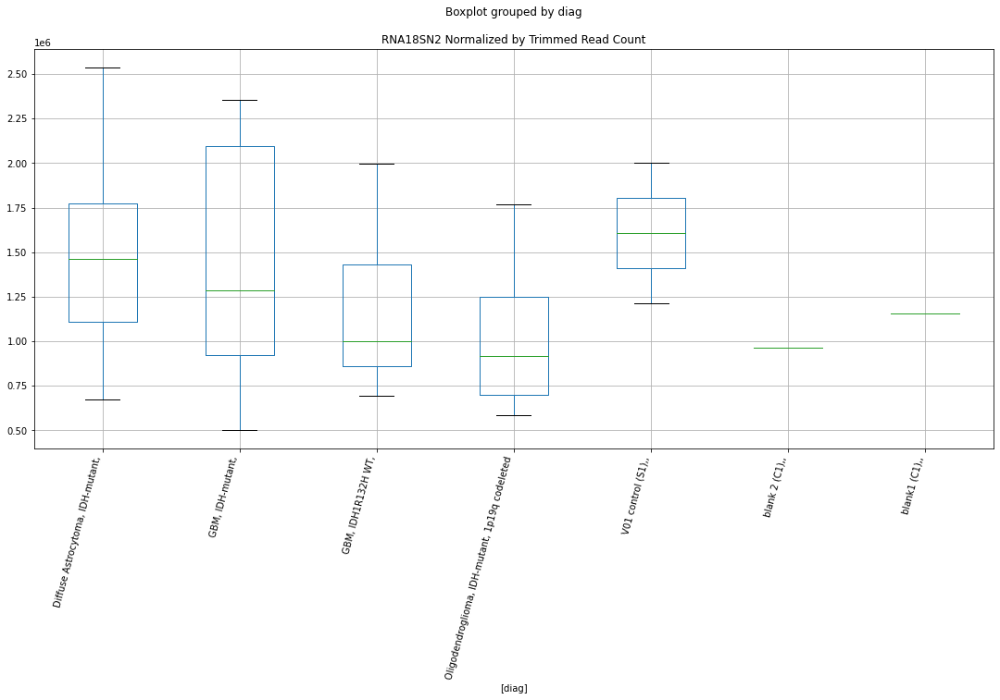

 p : 0.04234234322565636  ( t : 2.1851429646555802 ) :  D-plex  :  bbduk2  :  RNA18SN4
Control and blanks
73     2.00e+06
337    1.21e+06
Name: RNA18SN4, dtype: float64
205    964762.96
Name: RNA18SN4, dtype: float64
469    1.16e+06
Name: RNA18SN4, dtype: float64


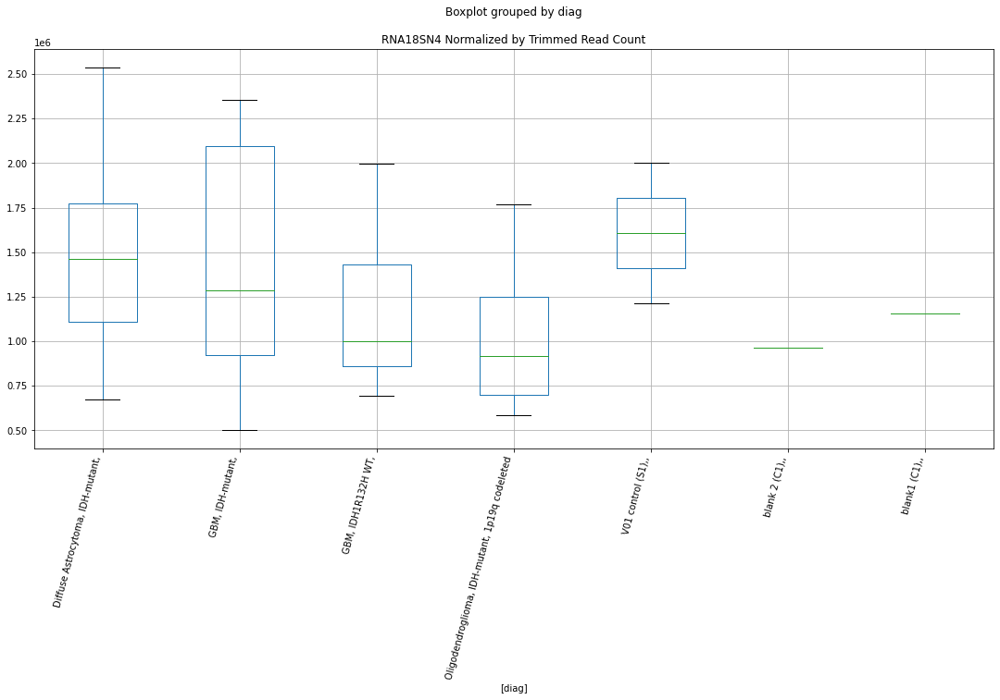

 p : 0.04236593301430904  ( t : 2.184862782479736 ) :  D-plex  :  bbduk2  :  RABGAP1L
Control and blanks
73     39423.43
337        0.00
Name: RABGAP1L, dtype: float64
205    14506.37
Name: RABGAP1L, dtype: float64
469    50871.35
Name: RABGAP1L, dtype: float64


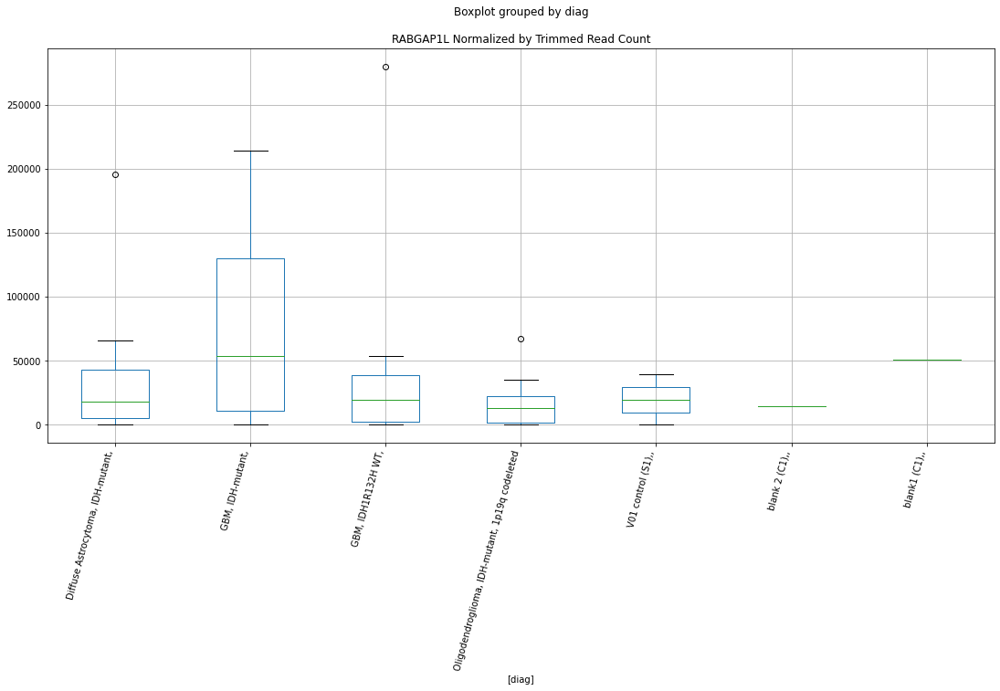

 p : 0.04239872031039021  ( t : 2.1844735965742132 ) :  D-plex  :  bbduk2  :  PRXL2C
Control and blanks
73         0.00
337    19583.46
Name: PRXL2C, dtype: float64
205    1074.55
Name: PRXL2C, dtype: float64
469    591.53
Name: PRXL2C, dtype: float64


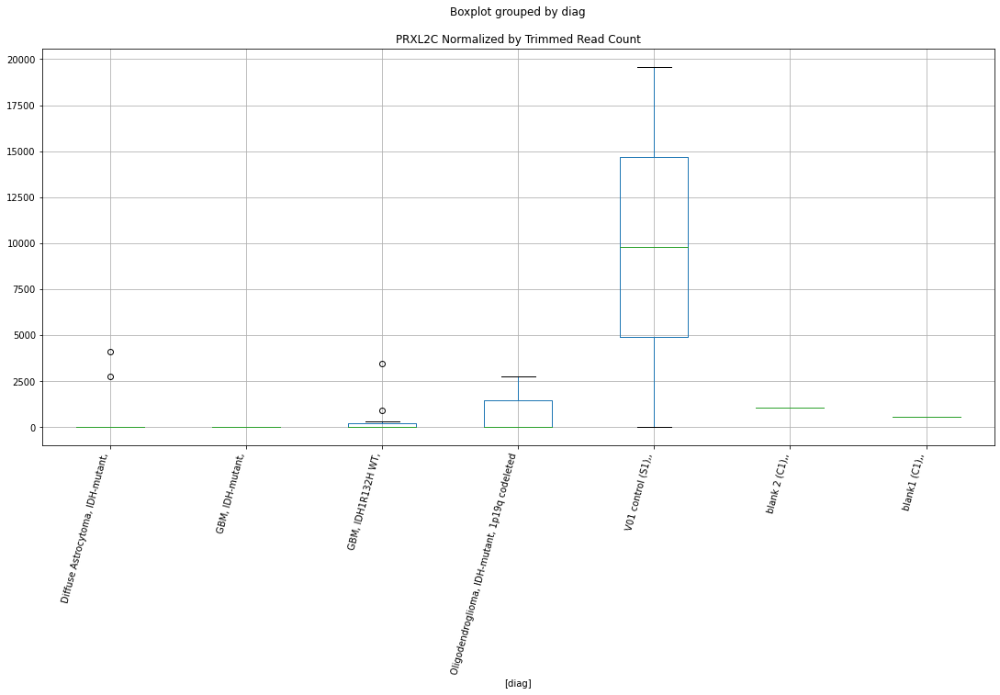

 p : 0.042403188330557576  ( t : 2.18442058244707 ) :  D-plex  :  bbduk2  :  RNA18SN3
Control and blanks
73     2.00e+06
337    1.21e+06
Name: RNA18SN3, dtype: float64
205    964404.78
Name: RNA18SN3, dtype: float64
469    1.16e+06
Name: RNA18SN3, dtype: float64


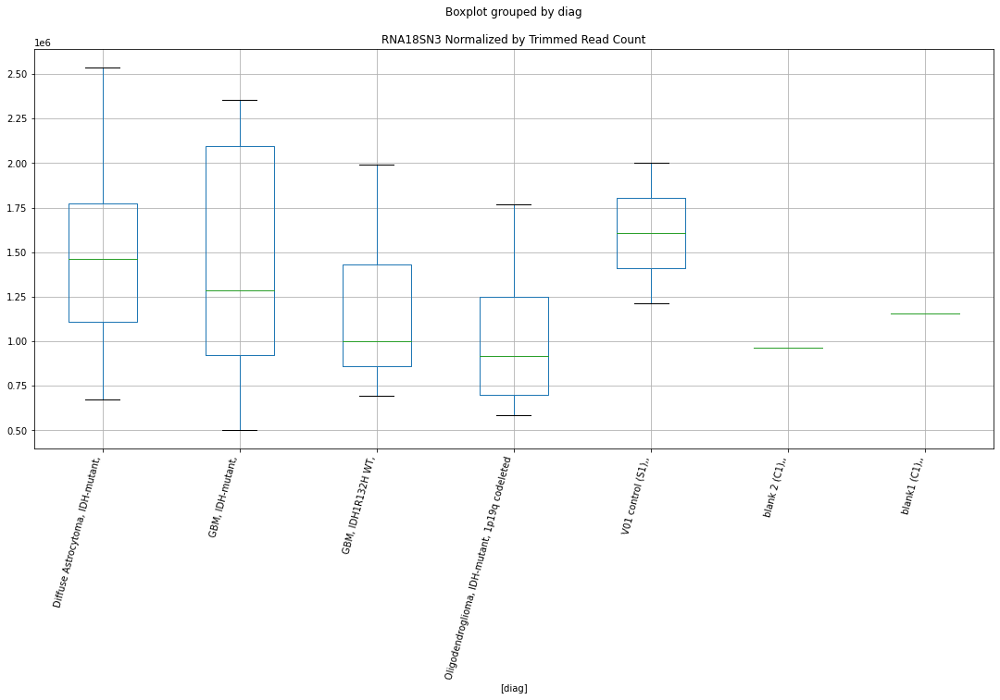

 p : 0.04244430089883999  ( t : 2.1839330122599048 ) :  D-plex  :  cutadapt2  :  RSBN1
Control and blanks
76     0.0
340    0.0
Name: RSBN1, dtype: float64
208    3527.2
Name: RSBN1, dtype: float64
472    2889.78
Name: RSBN1, dtype: float64


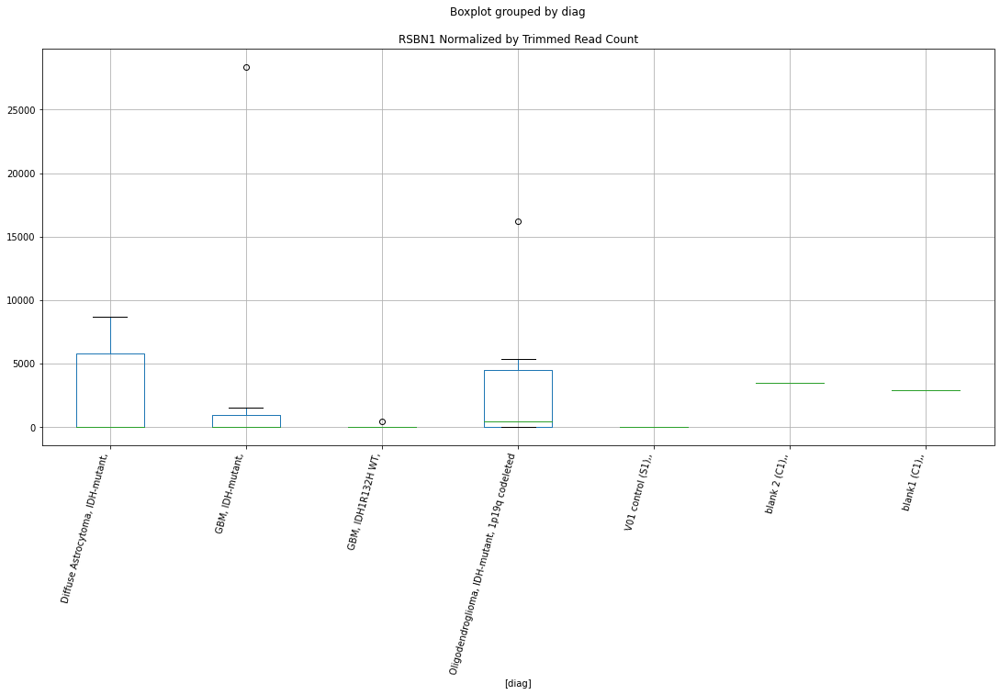

 p : 0.04253247987575083  ( t : 2.1828887216454747 ) :  D-plex  :  cutadapt2  :  PALM3
Control and blanks
76     0.0
340    0.0
Name: PALM3, dtype: float64
208    0.0
Name: PALM3, dtype: float64
472    0.0
Name: PALM3, dtype: float64


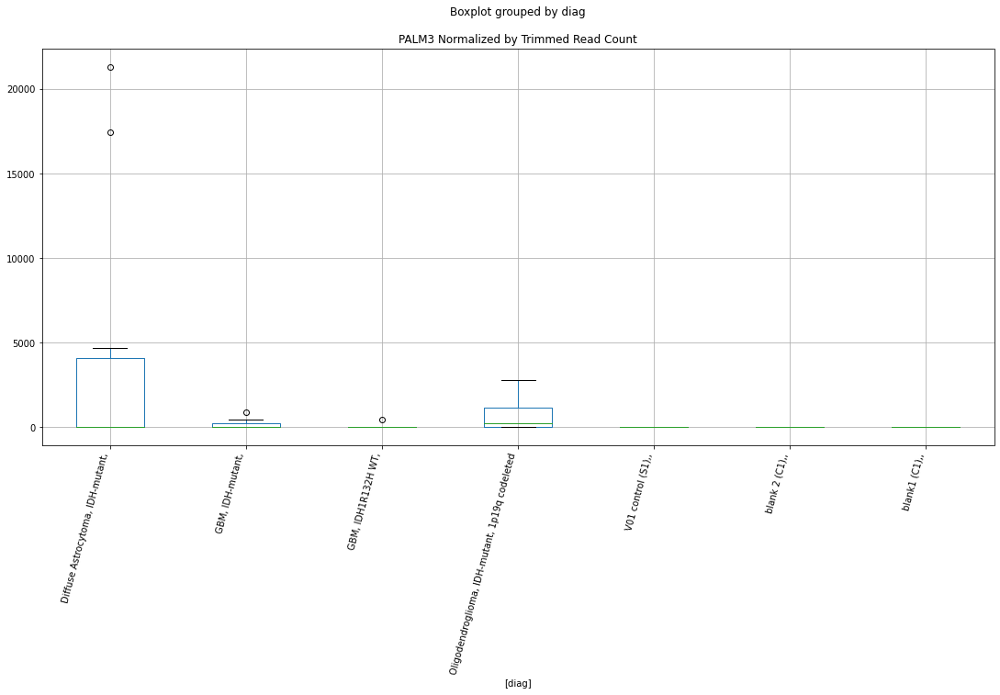

 p : 0.042548200252599054  ( t : 2.182702756055828 ) :  D-plex  :  bbduk2  :  PDE3A
Control and blanks
73     0.0
337    0.0
Name: PDE3A, dtype: float64
205    5193.64
Name: PDE3A, dtype: float64
469    10055.96
Name: PDE3A, dtype: float64


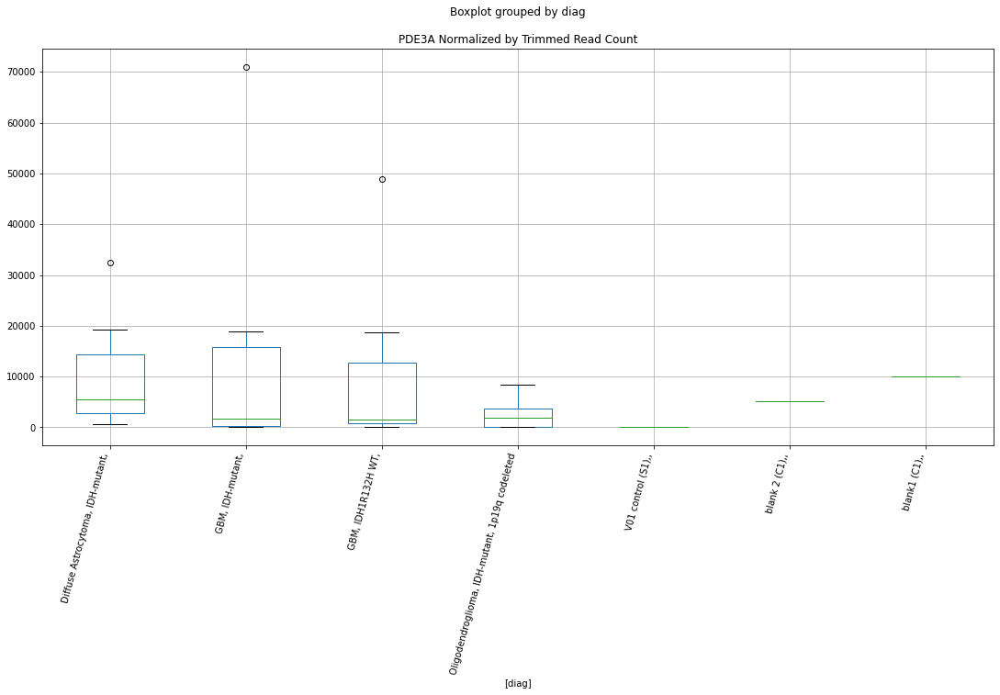

 p : 0.042574118019073744  ( t : 2.1823962970352686 ) :  D-plex  :  bbduk2  :  RNA28SN2
Control and blanks
73     2.30e+06
337    1.44e+06
Name: RNA28SN2, dtype: float64
205    1.56e+06
Name: RNA28SN2, dtype: float64
469    1.48e+06
Name: RNA28SN2, dtype: float64


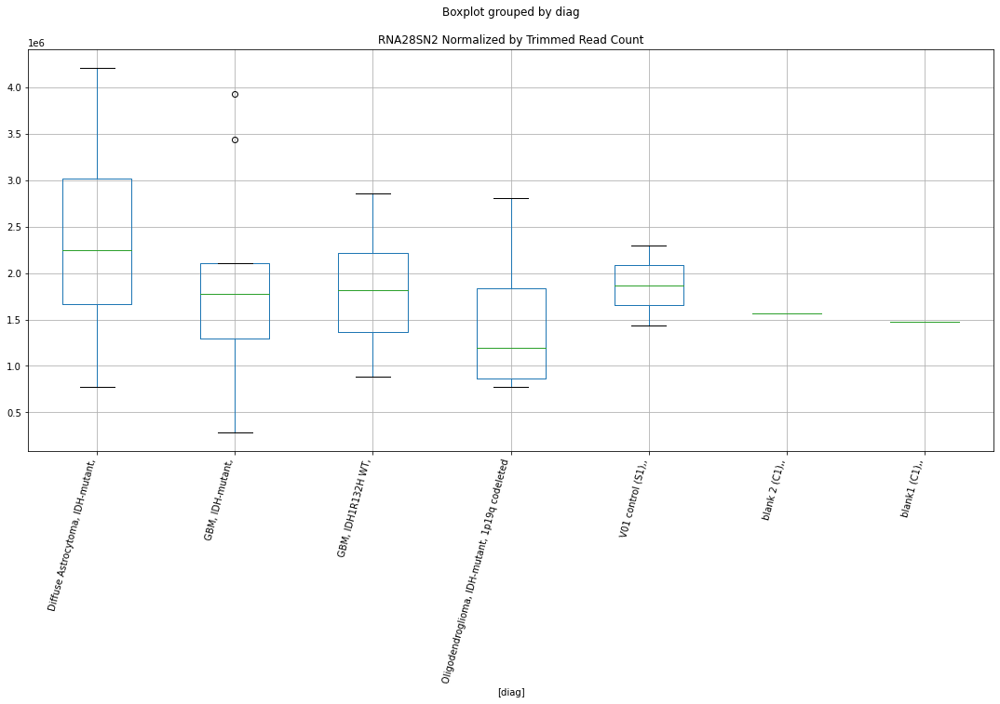

 p : 0.04259282058937097  ( t : 2.182175258763803 ) :  D-plex  :  bbduk2  :  SNHG28
Control and blanks
73     0.0
337    0.0
Name: SNHG28, dtype: float64
205    716.36
Name: SNHG28, dtype: float64
469    0.0
Name: SNHG28, dtype: float64


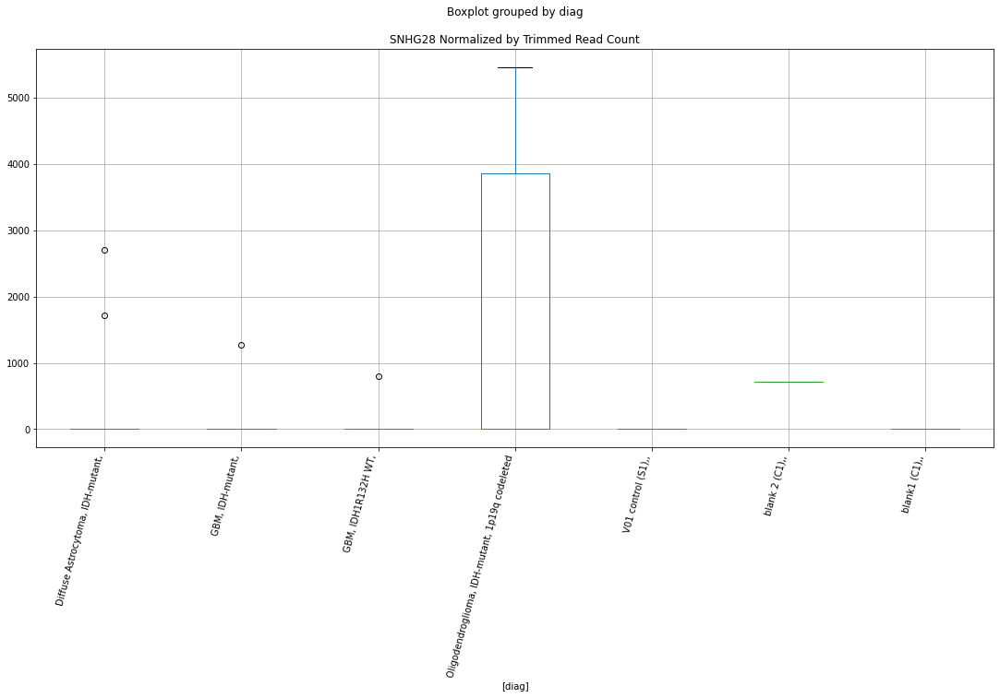

 p : 0.04264942738186113  ( t : 2.1815067872862857 ) :  D-plex  :  cutadapt2  :  PNISR
Control and blanks
76     2272.84
340       0.00
Name: PNISR, dtype: float64
208    1587.24
Name: PNISR, dtype: float64
472    1733.87
Name: PNISR, dtype: float64


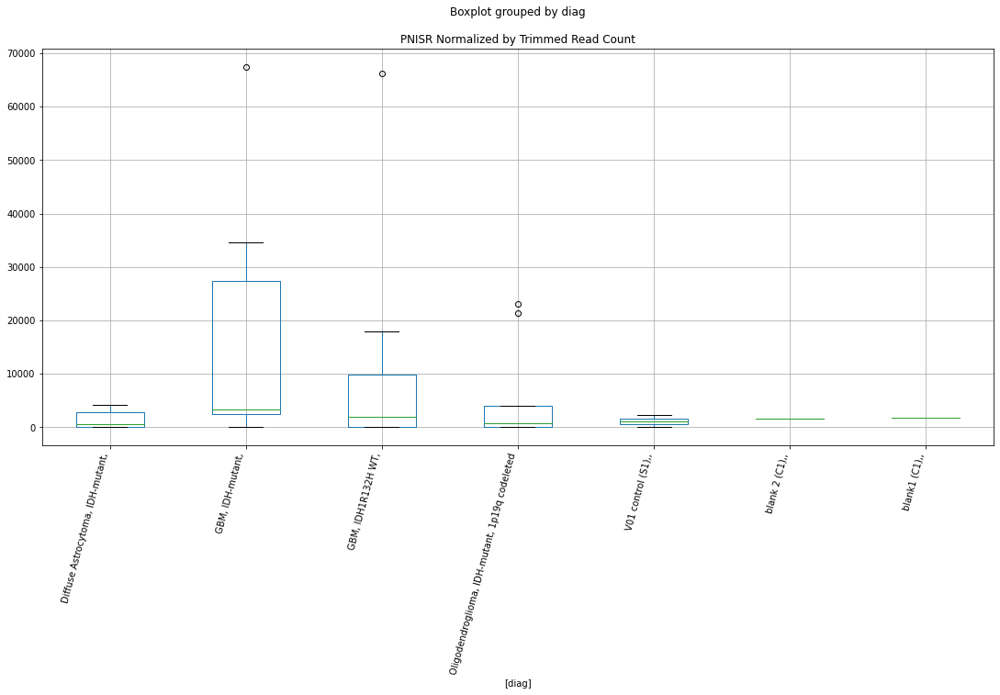

 p : 0.04266970714701774  ( t : 2.1812675007431 ) :  Lexogen  :  bbduk2  :  POU4F1
Control and blanks
79     0.0
343    0.0
Name: POU4F1, dtype: float64
211    0.0
Name: POU4F1, dtype: float64
475    0.0
Name: POU4F1, dtype: float64


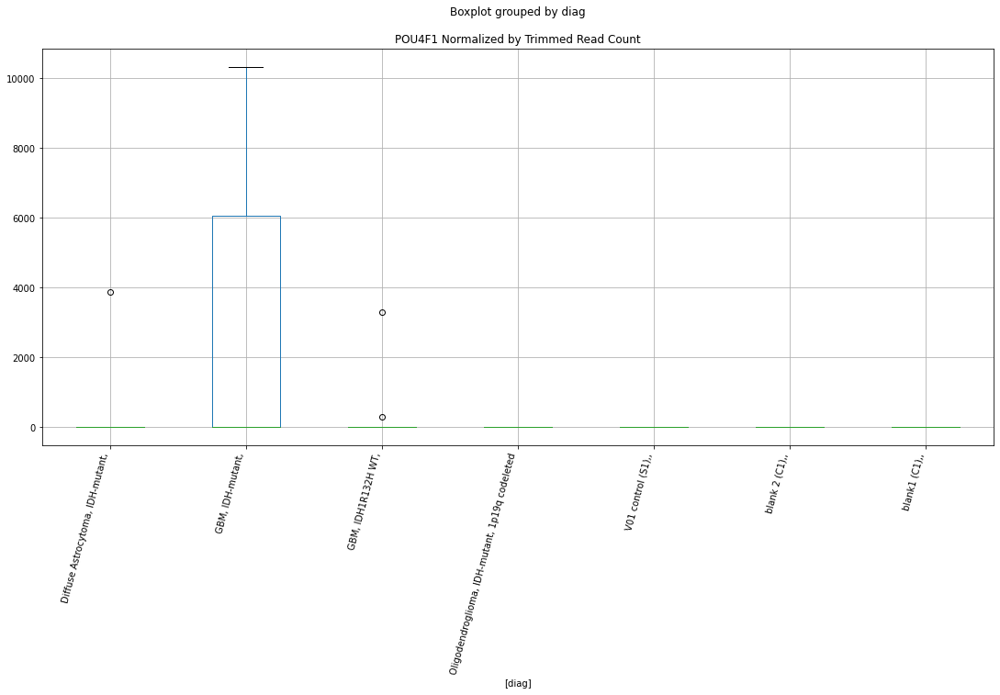

 p : 0.04269320734328898  ( t : 2.180990345805554 ) :  D-plex  :  cutadapt2  :  RNF145
Control and blanks
76     4545.69
340       0.00
Name: RNF145, dtype: float64
208    6348.97
Name: RNF145, dtype: float64
472    1155.91
Name: RNF145, dtype: float64


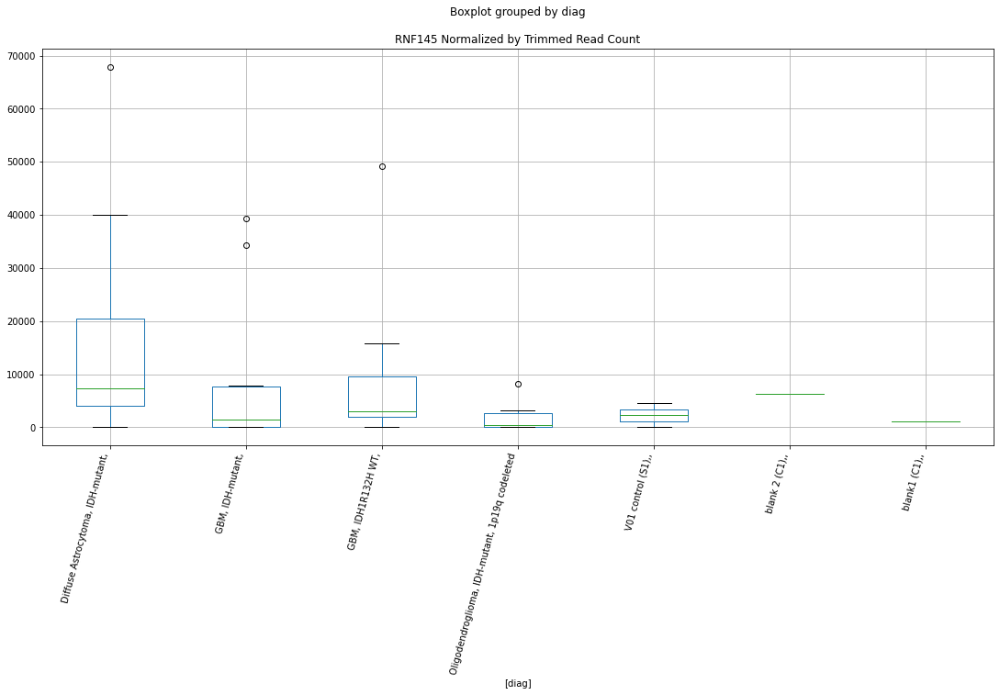

 p : 0.04284751246034382  ( t : 2.1791739789384352 ) :  D-plex  :  cutadapt2  :  PTPN18
Control and blanks
76     0.0
340    0.0
Name: PTPN18, dtype: float64
208    5290.81
Name: PTPN18, dtype: float64
472    0.0
Name: PTPN18, dtype: float64


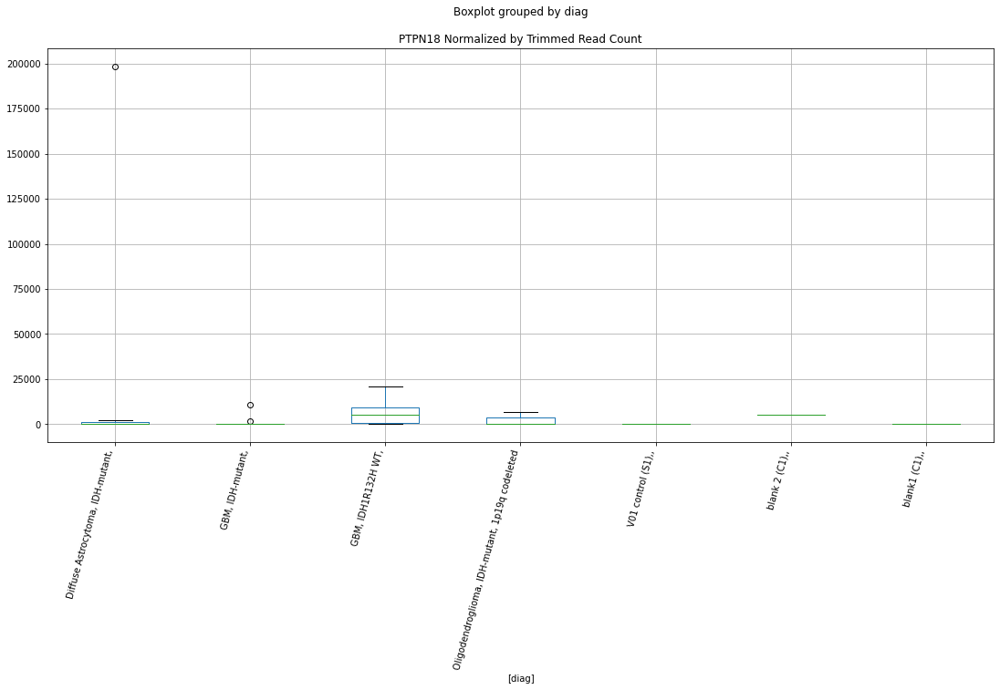

 p : 0.04286271137927143  ( t : 2.178995392871593 ) :  D-plex  :  cutadapt2  :  SLC35A3
Control and blanks
76       8333.76
340    358457.98
Name: SLC35A3, dtype: float64
208    6701.69
Name: SLC35A3, dtype: float64
472    5201.6
Name: SLC35A3, dtype: float64


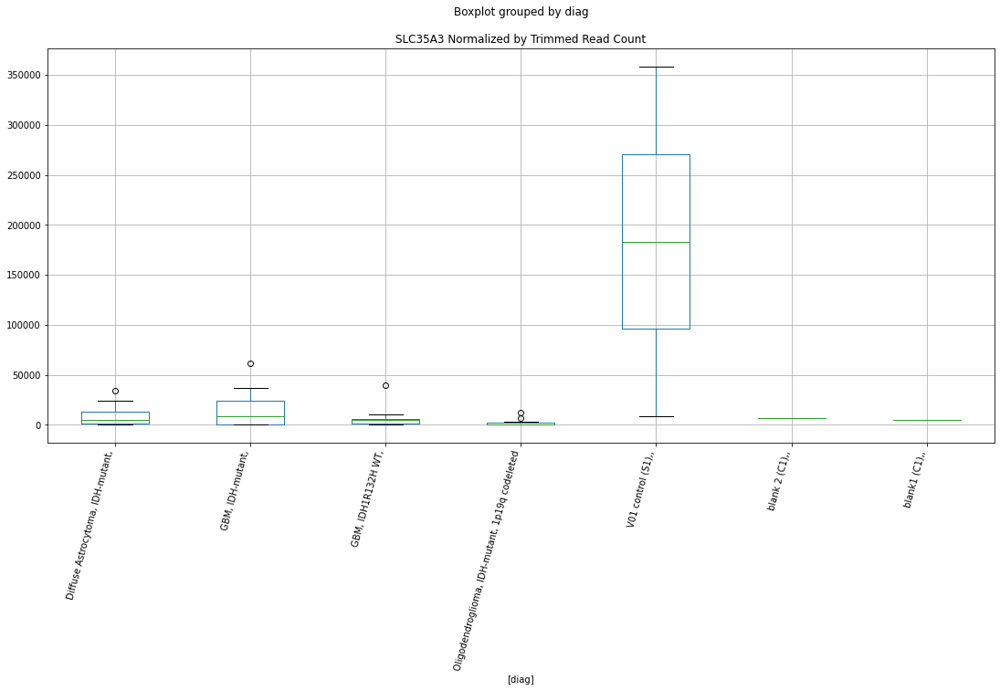

 p : 0.0429262195335986  ( t : 2.1782498045175664 ) :  D-plex  :  bbduk2  :  RFLNA
Control and blanks
73      773.01
337    1780.31
Name: RFLNA, dtype: float64
205    3223.64
Name: RFLNA, dtype: float64
469    1183.05
Name: RFLNA, dtype: float64


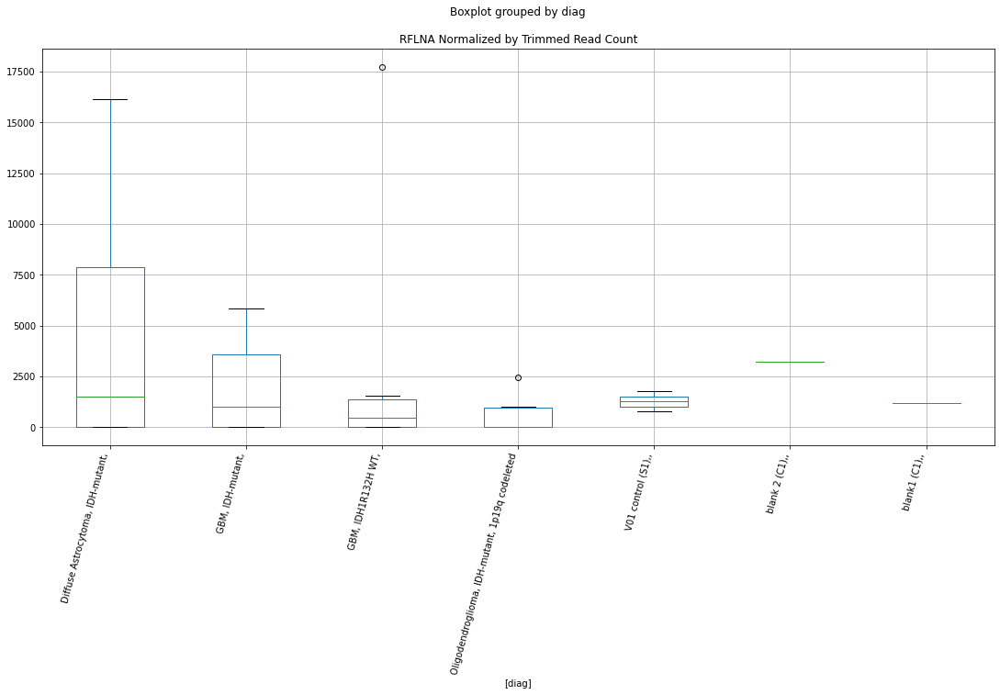

 p : 0.042961408532185864  ( t : 2.177837119331667 ) :  Lexogen  :  cutadapt2  :  POU4F1
Control and blanks
82     0.0
346    0.0
Name: POU4F1, dtype: float64
214    0.0
Name: POU4F1, dtype: float64
478    0.0
Name: POU4F1, dtype: float64


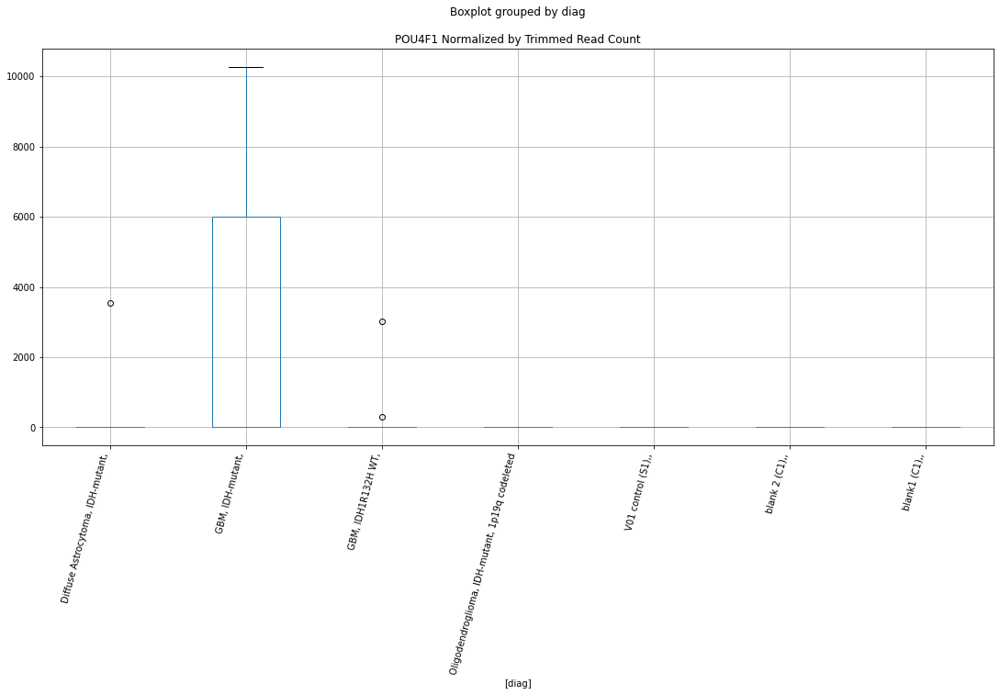

 p : 0.04300762226741042  ( t : 2.1772956098614533 ) :  D-plex  :  cutadapt2  :  SORCS1
Control and blanks
76     9848.98
340       0.00
Name: SORCS1, dtype: float64
208    4232.65
Name: SORCS1, dtype: float64
472    24274.15
Name: SORCS1, dtype: float64


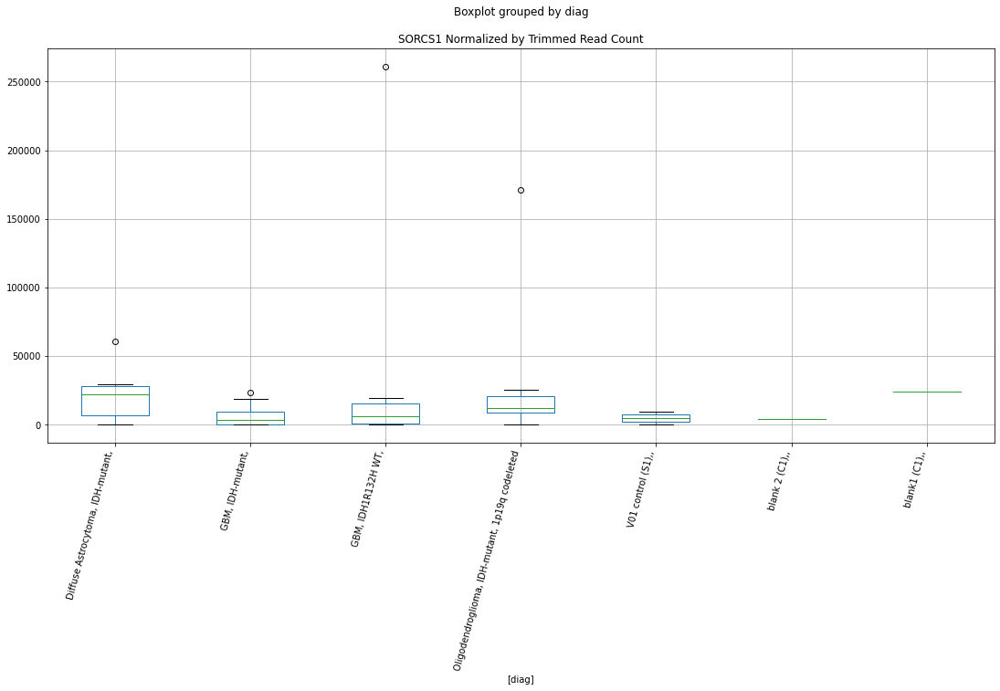

 p : 0.043014067668033576  ( t : 2.1772201282467245 ) :  D-plex  :  bbduk2  :  PPM1M
Control and blanks
73     0.0
337    0.0
Name: PPM1M, dtype: float64
205    1074.55
Name: PPM1M, dtype: float64
469    3549.16
Name: PPM1M, dtype: float64


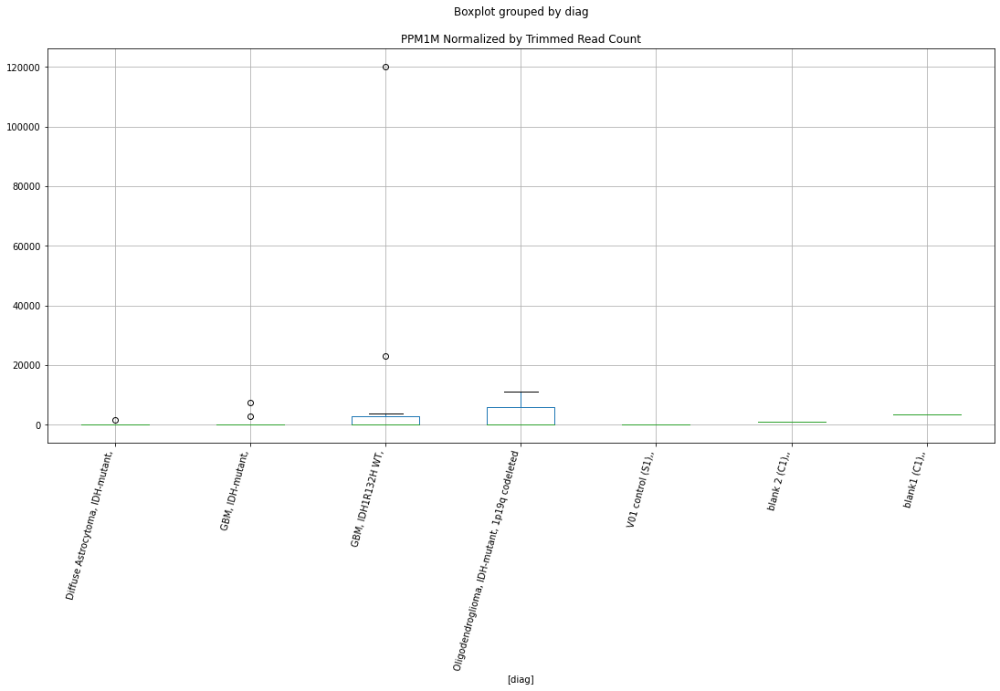

 p : 0.04313991919459898  ( t : 2.175748363101909 ) :  D-plex  :  cutadapt2  :  RHBDF2
Control and blanks
76          0.00
340    174384.96
Name: RHBDF2, dtype: float64
208    7936.21
Name: RHBDF2, dtype: float64
472    0.0
Name: RHBDF2, dtype: float64


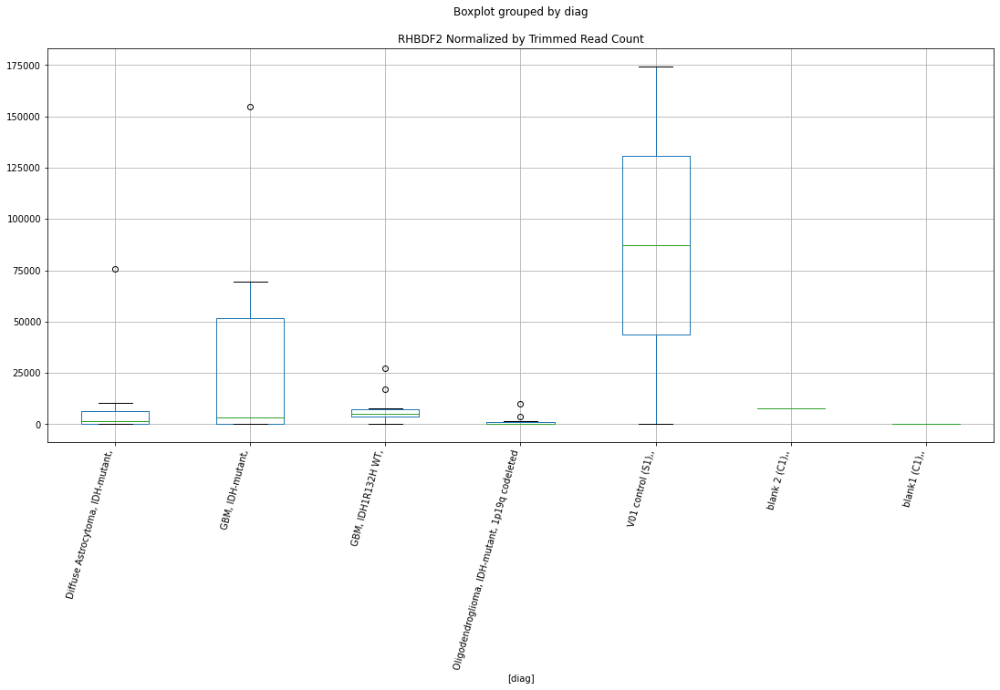

 p : 0.04314469550985823  ( t : 2.175692584208066 ) :  Lexogen  :  bbduk2  :  PTCD3
Control and blanks
79     0.0
343    0.0
Name: PTCD3, dtype: float64
211    273.31
Name: PTCD3, dtype: float64
475    0.0
Name: PTCD3, dtype: float64


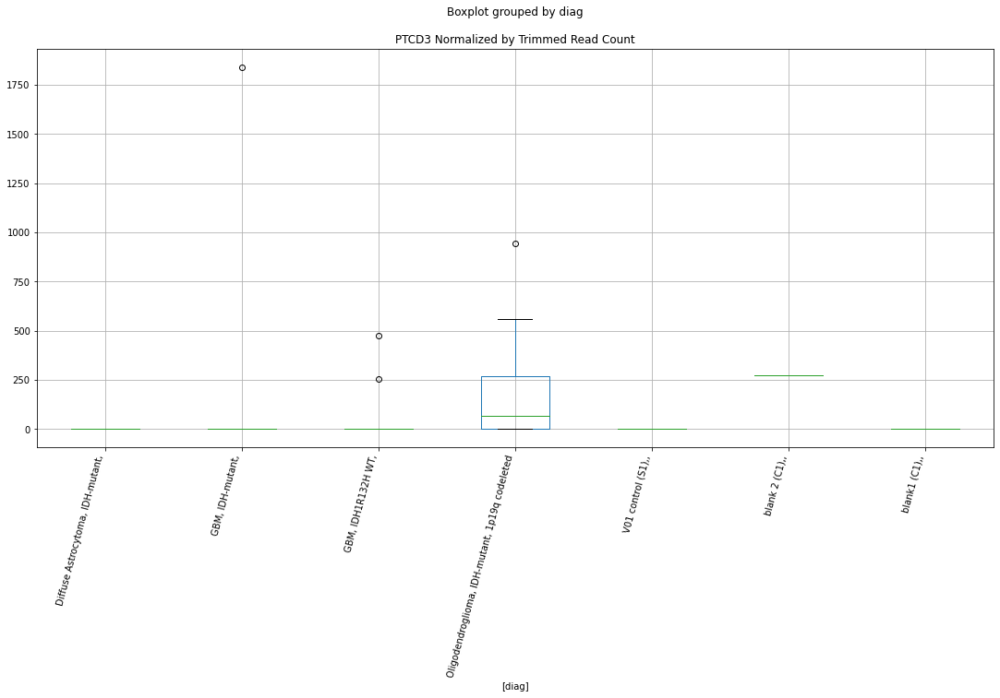

 p : 0.04320408461156744  ( t : 2.1749994968700204 ) :  Lexogen  :  cutadapt2  :  PSMG3-AS1
Control and blanks
82     25560.92
346    75966.86
Name: PSMG3-AS1, dtype: float64
214    0.0
Name: PSMG3-AS1, dtype: float64
478    0.0
Name: PSMG3-AS1, dtype: float64


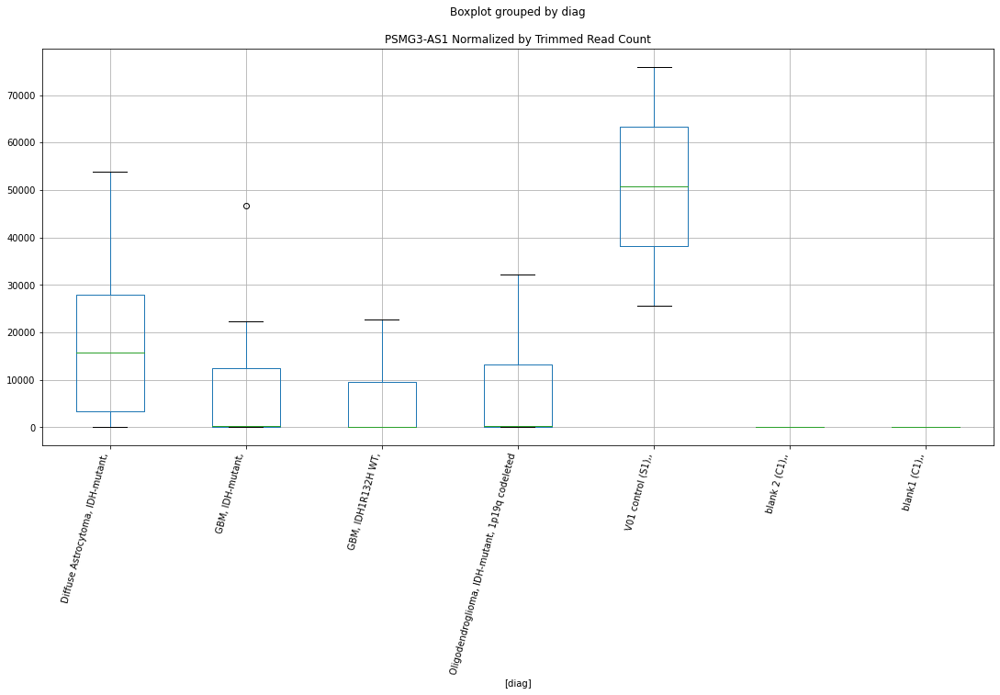

 p : 0.04322551567821397  ( t : 2.1747496046498496 ) :  D-plex  :  cutadapt2  :  PRRX2
Control and blanks
76         0.00
340    26421.96
Name: PRRX2, dtype: float64
208    15166.98
Name: PRRX2, dtype: float64
472    577.96
Name: PRRX2, dtype: float64


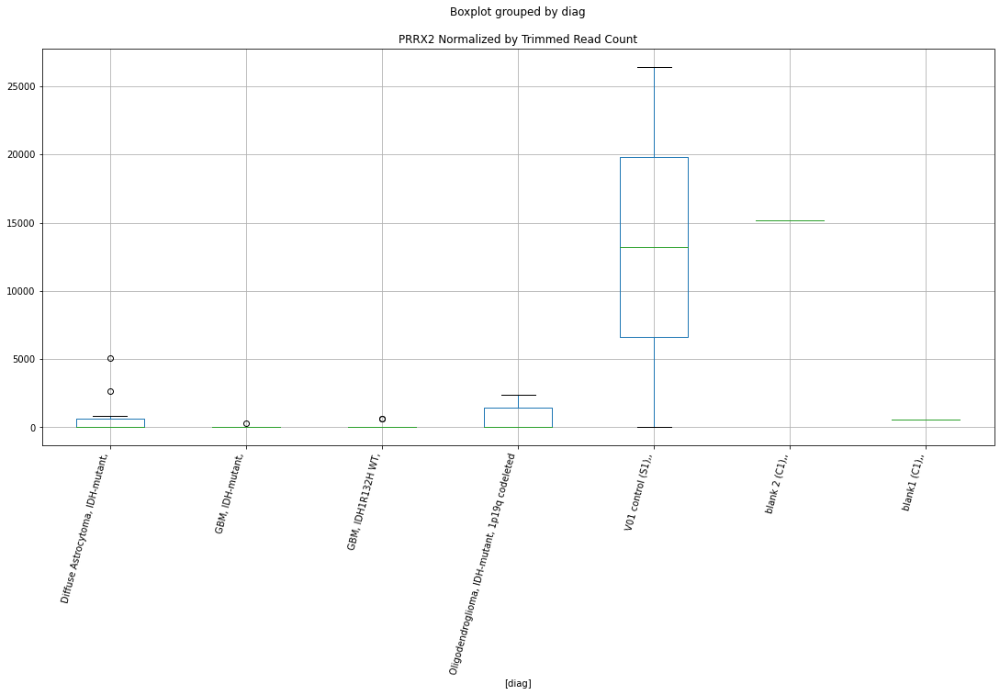

 p : 0.0432400438281477  ( t : 2.1745802669056893 ) :  D-plex  :  cutadapt2  :  RNA28SN3
Control and blanks
76     2.21e+06
340    1.40e+06
Name: RNA28SN3, dtype: float64
208    1.51e+06
Name: RNA28SN3, dtype: float64
472    1.42e+06
Name: RNA28SN3, dtype: float64


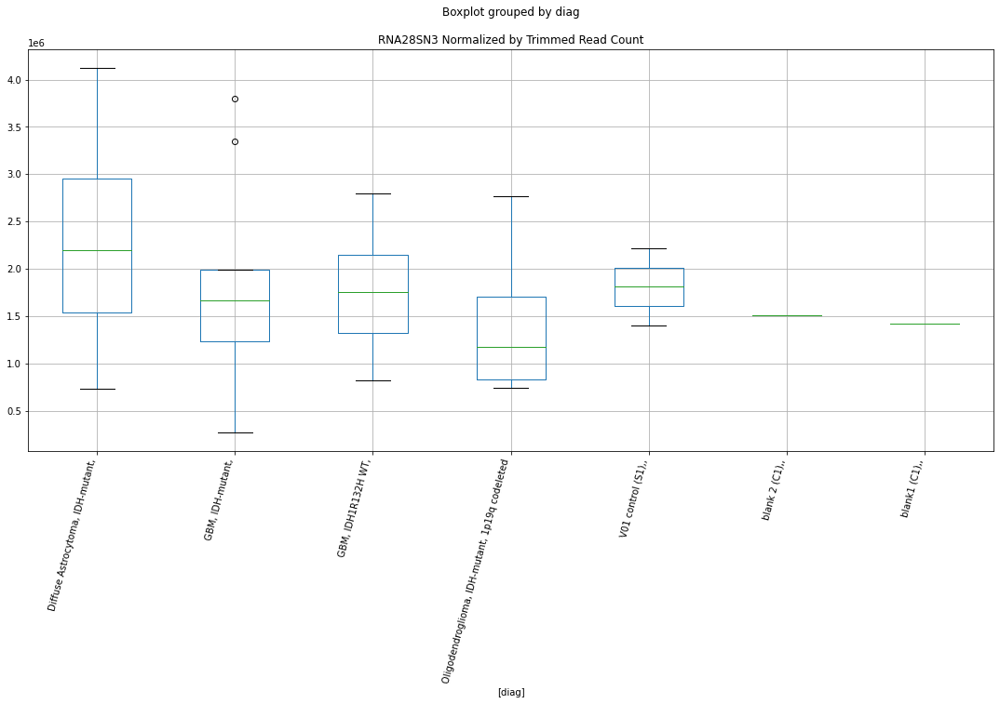

 p : 0.04327599440810958  ( t : 2.174161456762939 ) :  D-plex  :  bbduk2  :  RBM26
Control and blanks
73     30147.33
337        0.00
Name: RBM26, dtype: float64
205    80053.66
Name: RBM26, dtype: float64
469    26027.2
Name: RBM26, dtype: float64


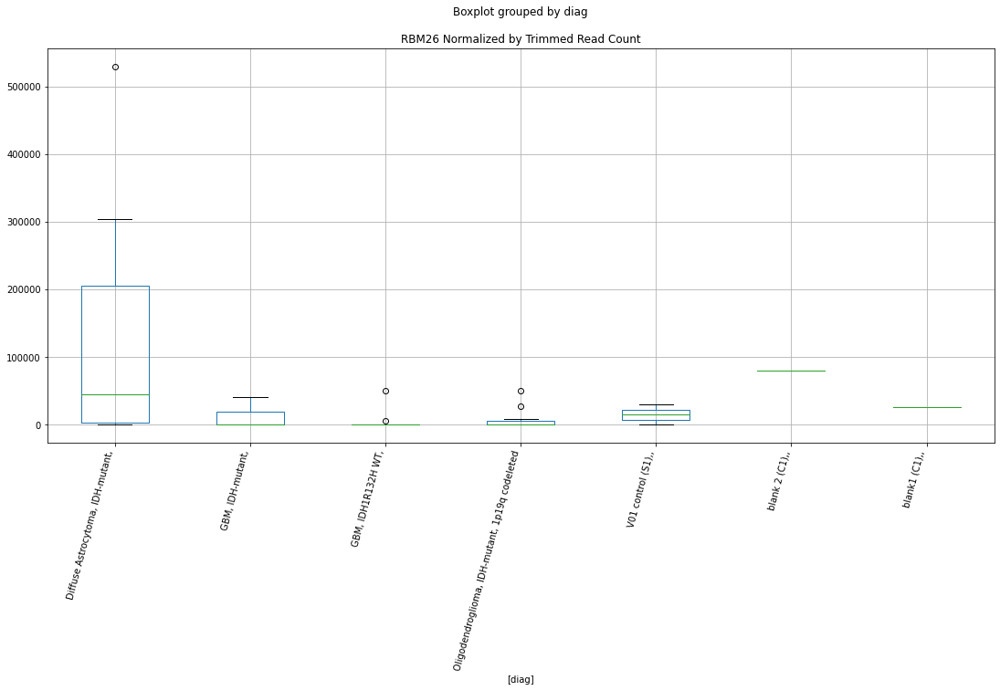

 p : 0.04327893516843703  ( t : 2.1741272121621167 ) :  D-plex  :  cutadapt2  :  RPA3
Control and blanks
76     68942.89
340        0.00
Name: RPA3, dtype: float64
208    49380.86
Name: RPA3, dtype: float64
472    5201.6
Name: RPA3, dtype: float64


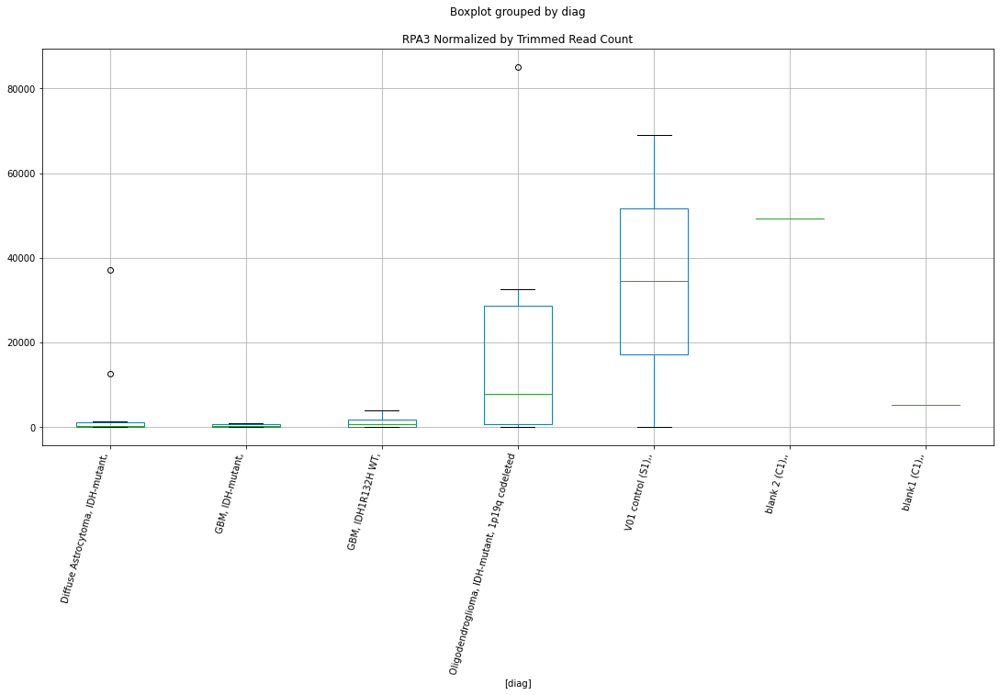

 p : 0.043281229662259425  ( t : 2.1741004946934313 ) :  D-plex  :  cutadapt2  :  RANGAP1
Control and blanks
76      6060.91
340    47559.54
Name: RANGAP1, dtype: float64
208    17283.3
Name: RANGAP1, dtype: float64
472    19650.5
Name: RANGAP1, dtype: float64


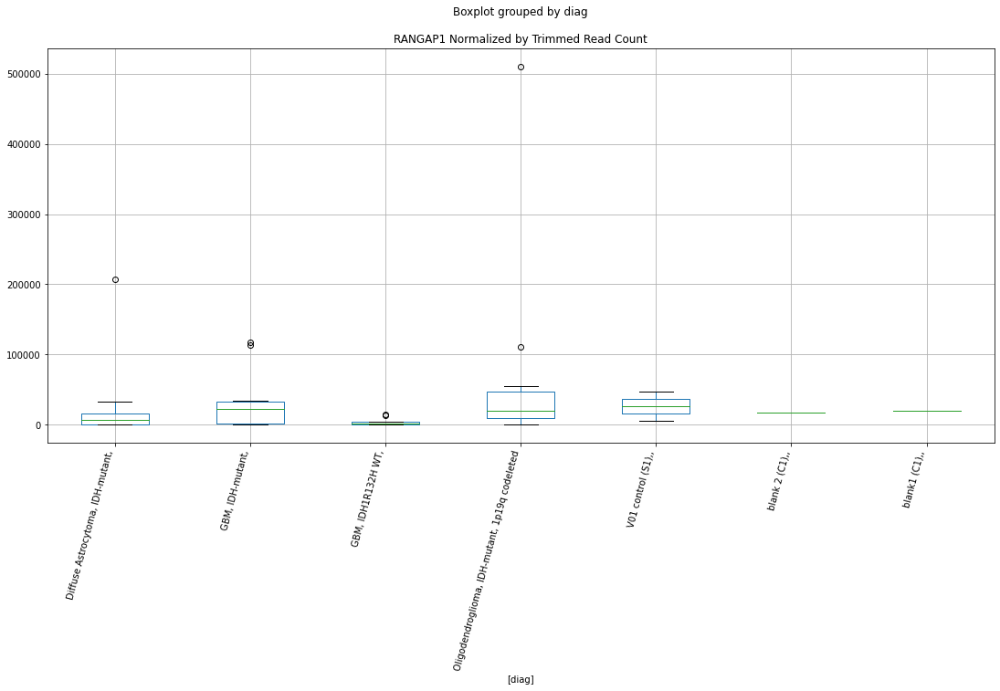

 p : 0.043324260473643676  ( t : 2.1735996769178105 ) :  Lexogen  :  cutadapt2  :  PC
Control and blanks
82     0.0
346    0.0
Name: PC, dtype: float64
214    0.0
Name: PC, dtype: float64
478    0.0
Name: PC, dtype: float64


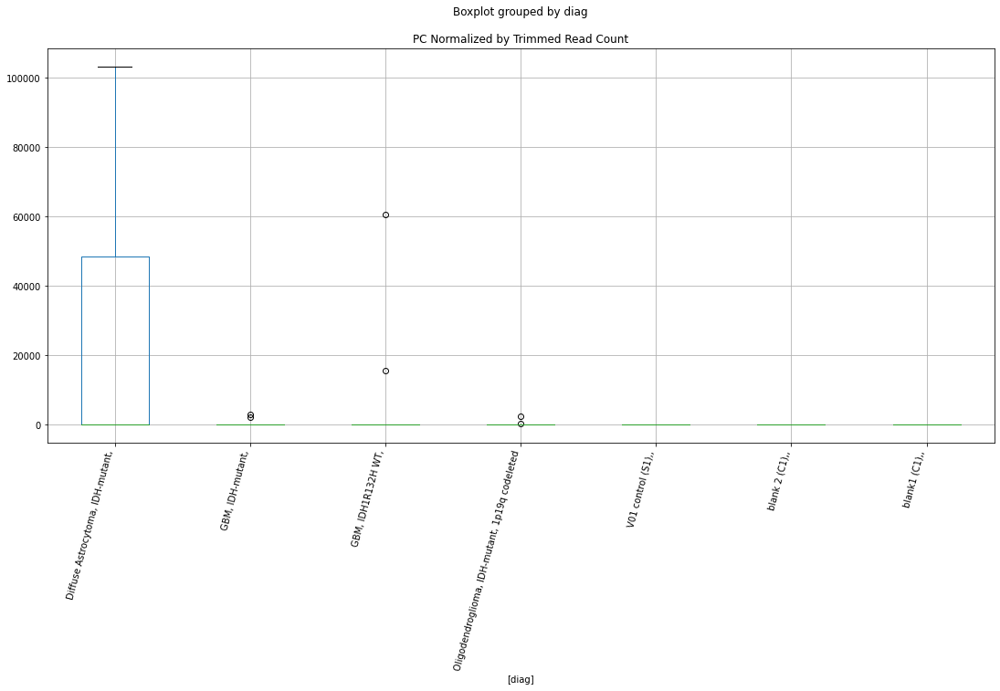

 p : 0.04335433837081349  ( t : 2.1732498832087583 ) :  D-plex  :  bbduk2  :  PPP1R15A
Control and blanks
73     47926.52
337    49848.81
Name: PPP1R15A, dtype: float64
205    67338.2
Name: PPP1R15A, dtype: float64
469    20703.46
Name: PPP1R15A, dtype: float64


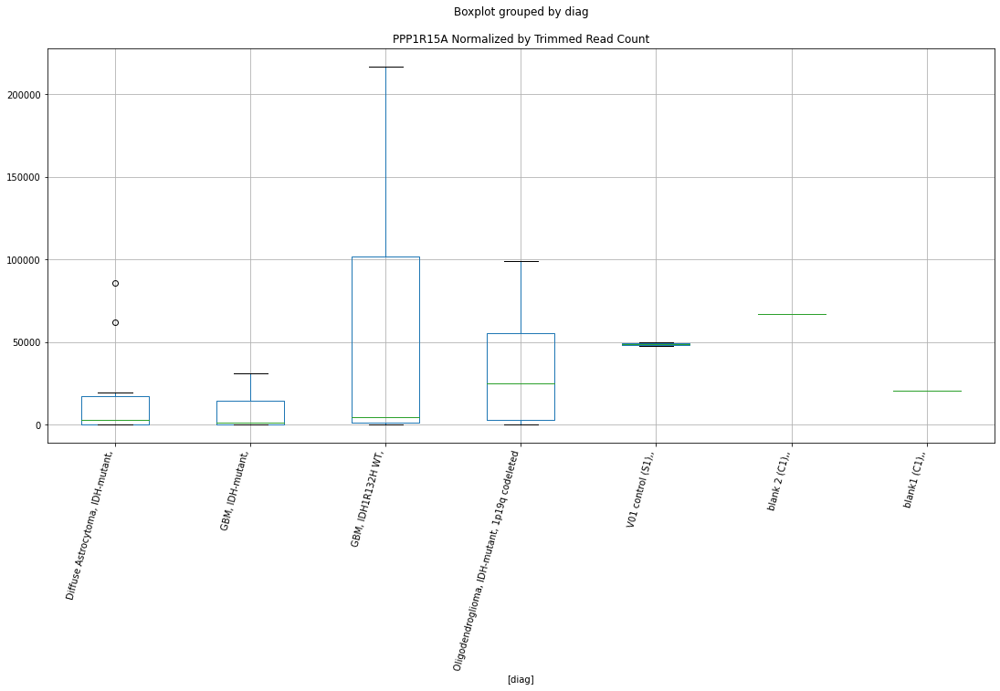

 p : 0.043373636671903665  ( t : 2.173025568855487 ) :  D-plex  :  bbduk2  :  PCGF3
Control and blanks
73     3092.03
337    1780.31
Name: PCGF3, dtype: float64
205    3940.0
Name: PCGF3, dtype: float64
469    5915.27
Name: PCGF3, dtype: float64


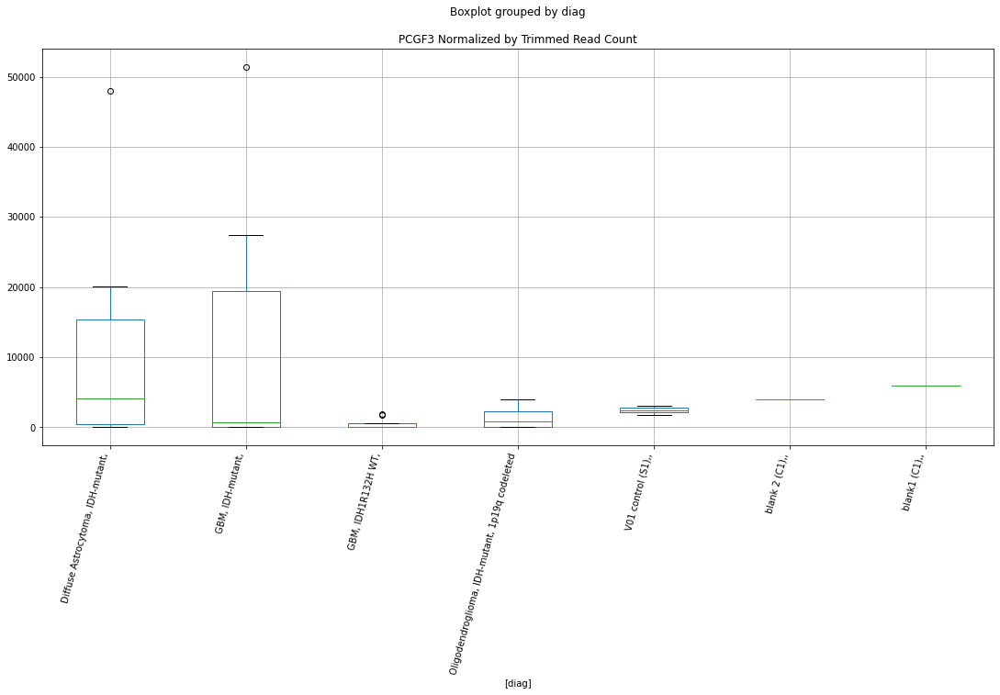

 p : 0.04338063853764643  ( t : 2.172944205068477 ) :  Lexogen  :  bbduk2  :  PATL1
Control and blanks
79         0.00
343    28874.75
Name: PATL1, dtype: float64
211    4646.21
Name: PATL1, dtype: float64
475    0.0
Name: PATL1, dtype: float64


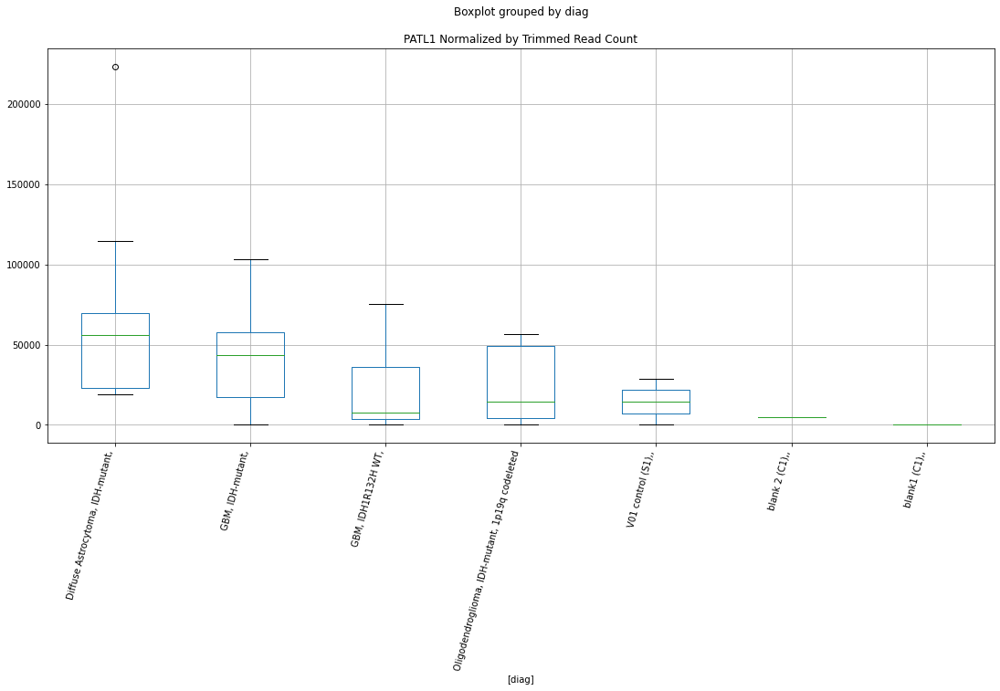

 p : 0.043402993770053876  ( t : 2.172684511021582 ) :  D-plex  :  cutadapt2  :  PREX2
Control and blanks
76     0.0
340    0.0
Name: PREX2, dtype: float64
208    3174.48
Name: PREX2, dtype: float64
472    4045.69
Name: PREX2, dtype: float64


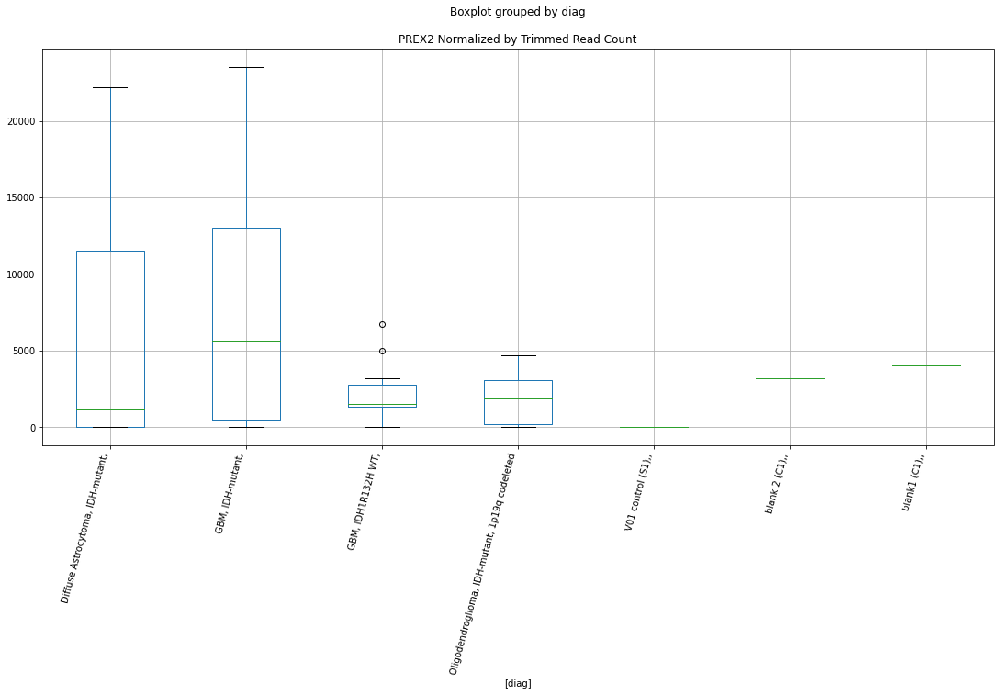

 p : 0.04341130880974886  ( t : 2.172587948949238 ) :  D-plex  :  cutadapt2  :  PALD1
Control and blanks
76     1.17e+06
340    4.91e+05
Name: PALD1, dtype: float64
208    419031.88
Name: PALD1, dtype: float64
472    468144.23
Name: PALD1, dtype: float64


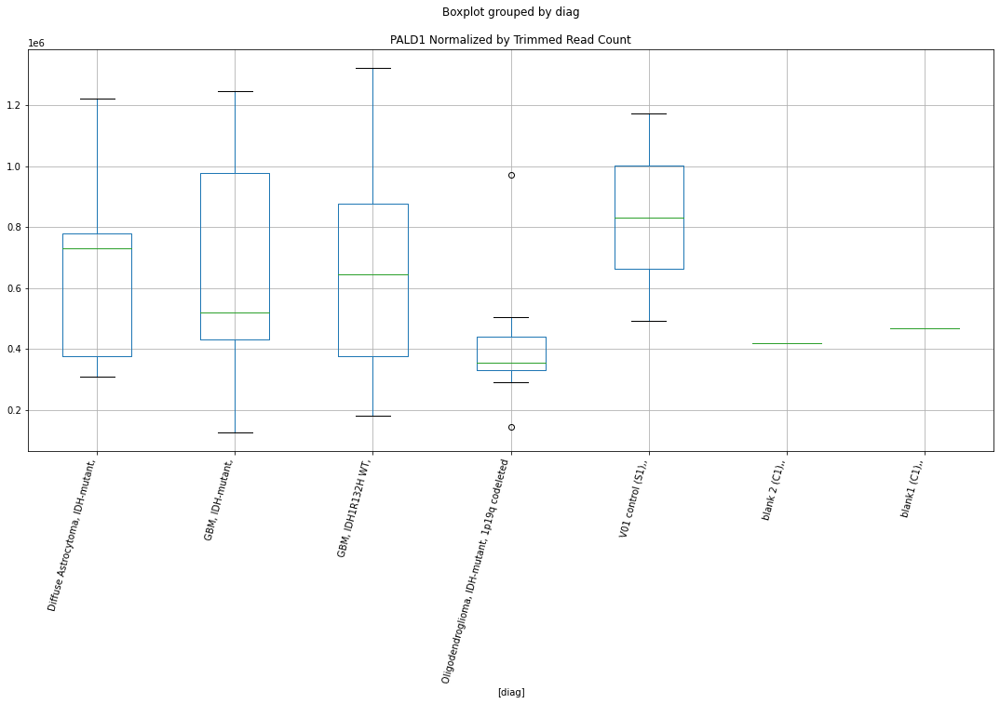

 p : 0.043422455803403114  ( t : 2.172458526132371 ) :  D-plex  :  cutadapt2  :  PKD1P5-LOC105376752
Control and blanks
76     28789.34
340        0.00
Name: PKD1P5-LOC105376752, dtype: float64
208    5819.89
Name: PKD1P5-LOC105376752, dtype: float64
472    11559.12
Name: PKD1P5-LOC105376752, dtype: float64


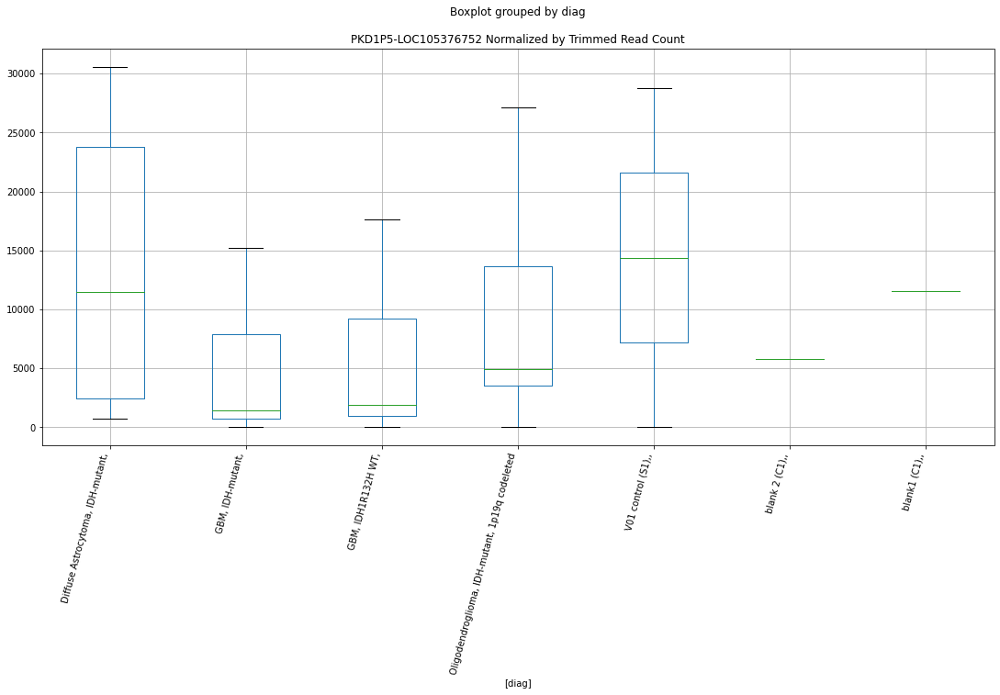

 p : 0.043427109897697845  ( t : 2.172404498504579 ) :  D-plex  :  cutadapt2  :  RHOBTB2
Control and blanks
76     17425.13
340     3522.93
Name: RHOBTB2, dtype: float64
208    17636.02
Name: RHOBTB2, dtype: float64
472    54327.85
Name: RHOBTB2, dtype: float64


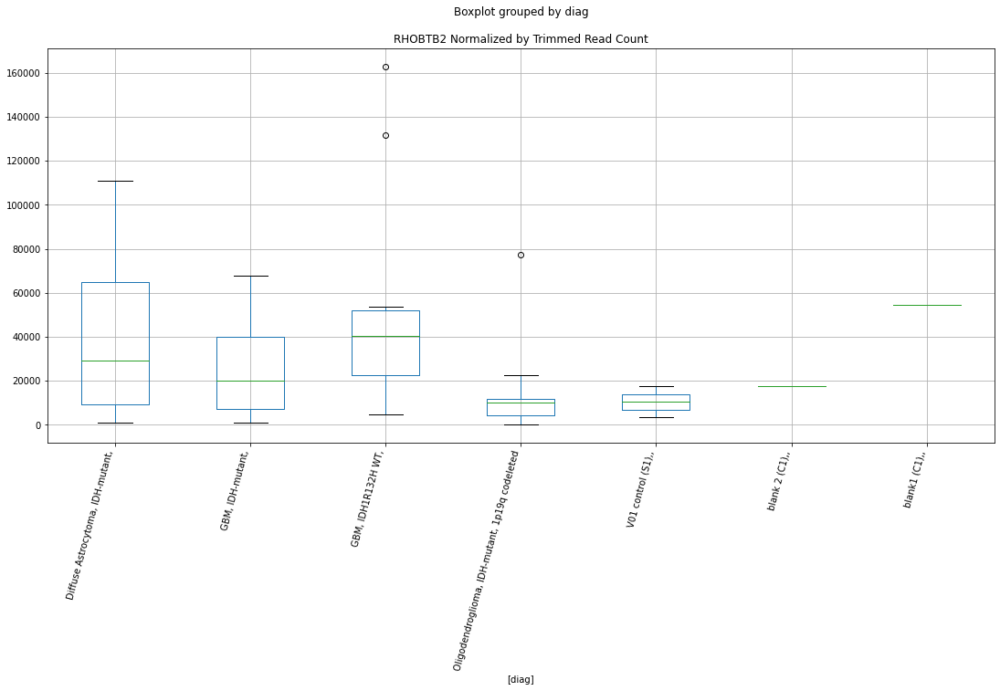

 p : 0.04343788245162223  ( t : 2.172279464322717 ) :  D-plex  :  bbduk2  :  PCDHGB2
Control and blanks
73     0.0
337    0.0
Name: PCDHGB2, dtype: float64
205    1432.73
Name: PCDHGB2, dtype: float64
469    4140.69
Name: PCDHGB2, dtype: float64


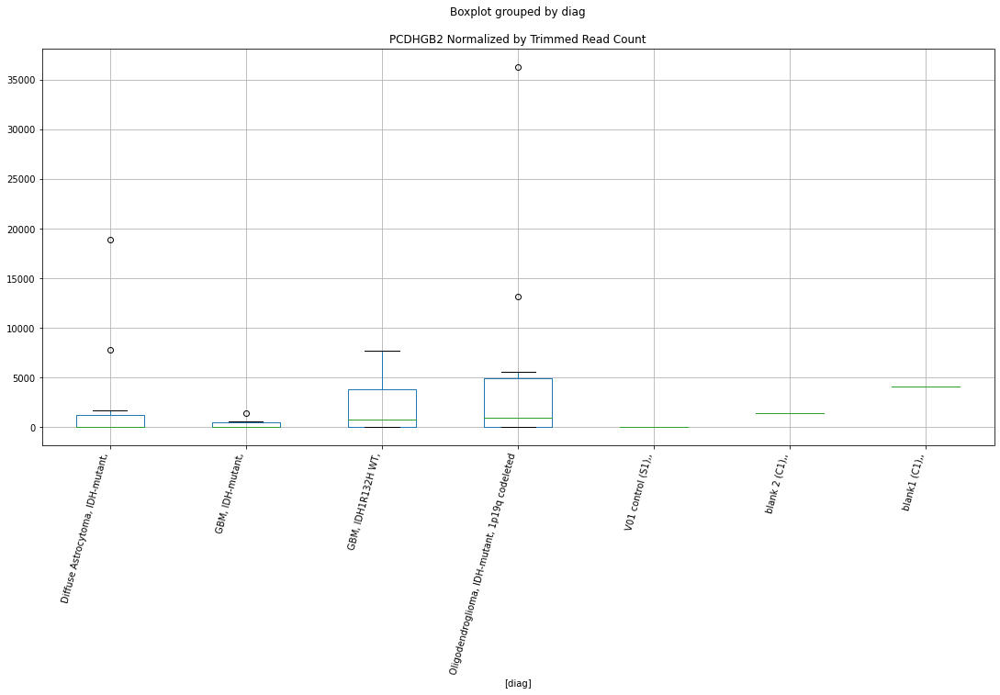

 p : 0.04344120432053315  ( t : 2.1722409139982544 ) :  D-plex  :  bbduk2  :  RANGAP1
Control and blanks
73      6184.07
337    48068.49
Name: RANGAP1, dtype: float64
205    17550.91
Name: RANGAP1, dtype: float64
469    20111.93
Name: RANGAP1, dtype: float64


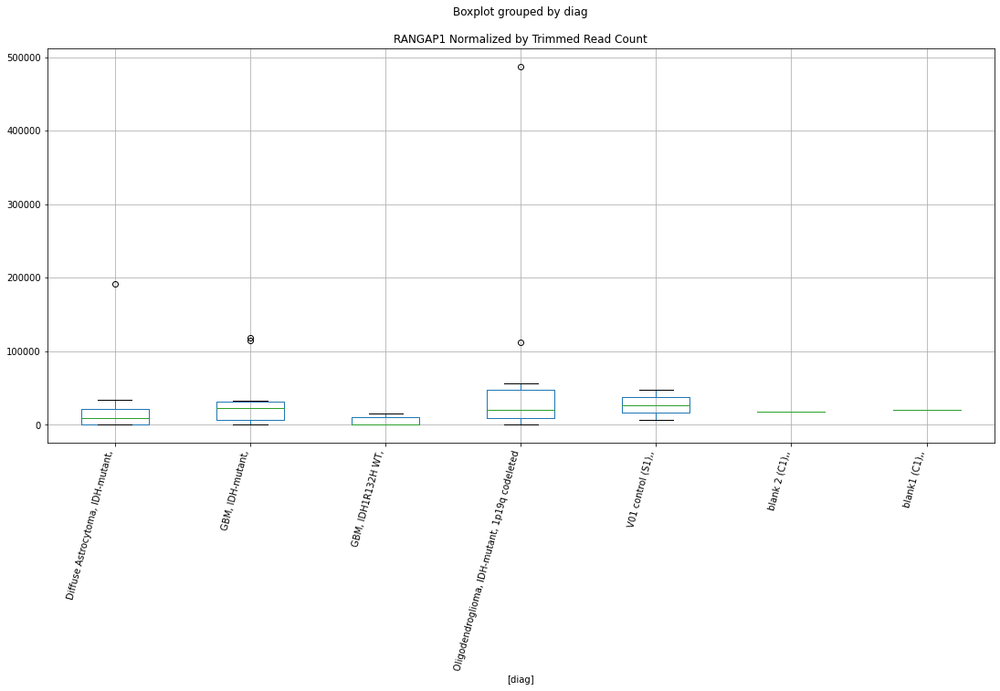

 p : 0.04345335621423165  ( t : 2.172099914139207 ) :  D-plex  :  bbduk2  :  PREX2
Control and blanks
73     0.0
337    0.0
Name: PREX2, dtype: float64
205    3223.64
Name: PREX2, dtype: float64
469    4140.69
Name: PREX2, dtype: float64


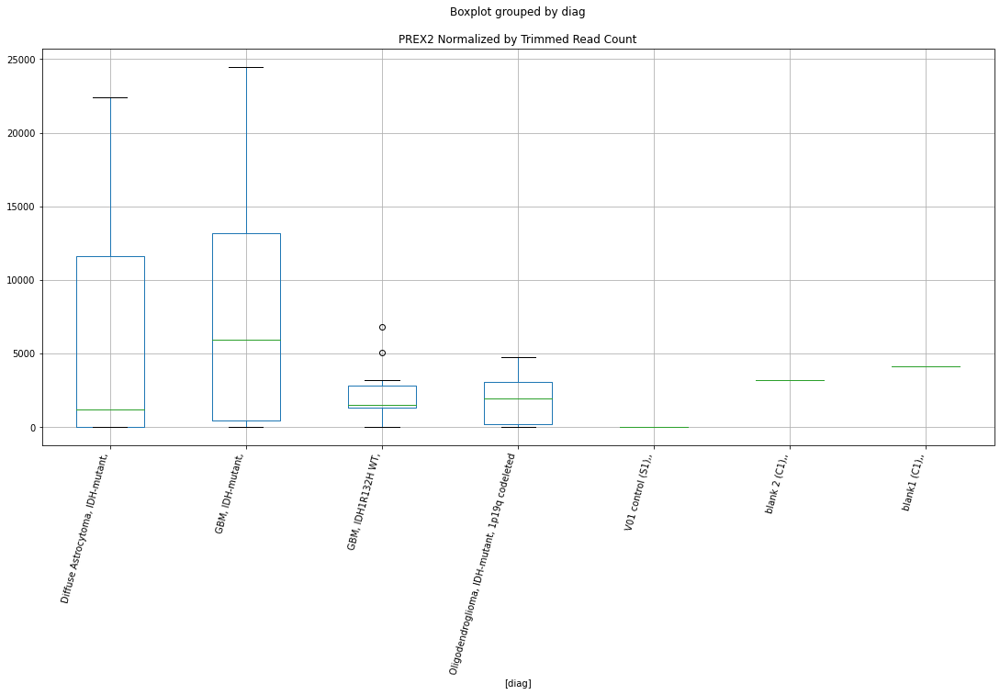

 p : 0.043472556056000804  ( t : 2.171877209689707 ) :  Lexogen  :  cutadapt2  :  PATL1
Control and blanks
82         0.00
346    28619.09
Name: PATL1, dtype: float64
214    4339.62
Name: PATL1, dtype: float64
478    0.0
Name: PATL1, dtype: float64


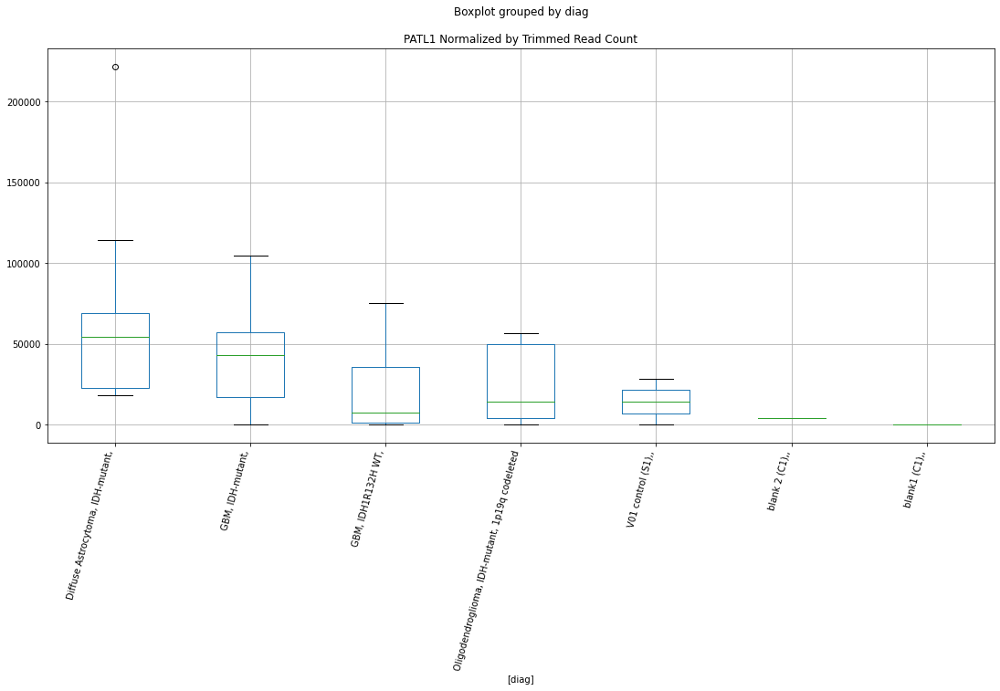

 p : 0.043476783733631744  ( t : 2.17182818375011 ) :  Lexogen  :  bbduk2  :  SAFB2
Control and blanks
79     0.0
343    0.0
Name: SAFB2, dtype: float64
211    2733.06
Name: SAFB2, dtype: float64
475    0.0
Name: SAFB2, dtype: float64


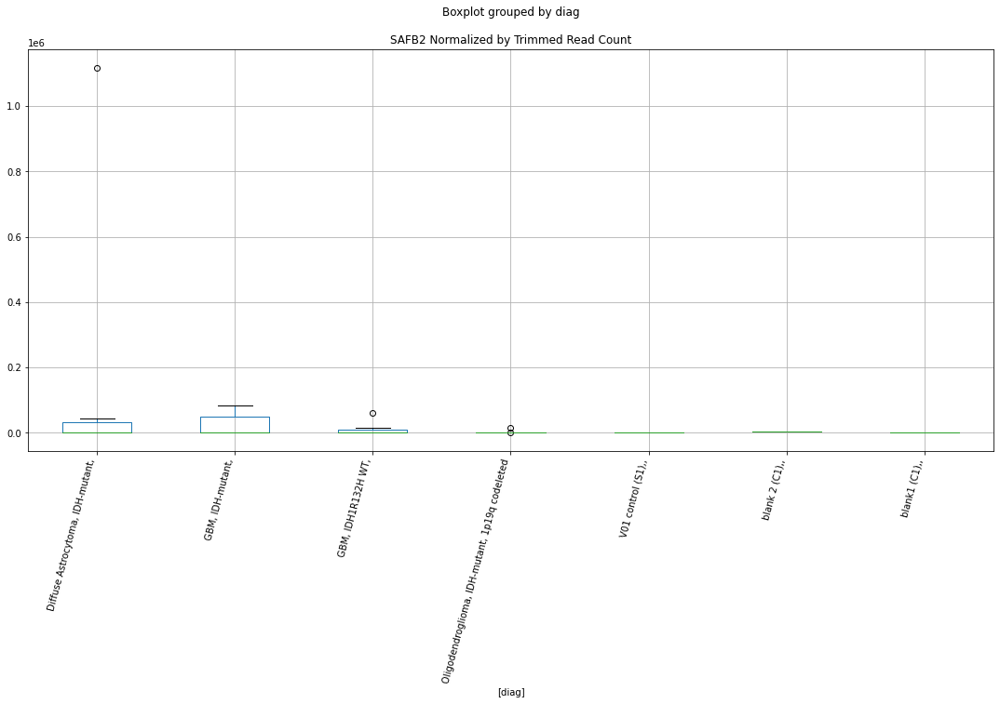

 p : 0.04348843942229067  ( t : 2.1716930420569573 ) :  Lexogen  :  cutadapt2  :  SLBP
Control and blanks
82     0.0
346    0.0
Name: SLBP, dtype: float64
214    0.0
Name: SLBP, dtype: float64
478    0.0
Name: SLBP, dtype: float64


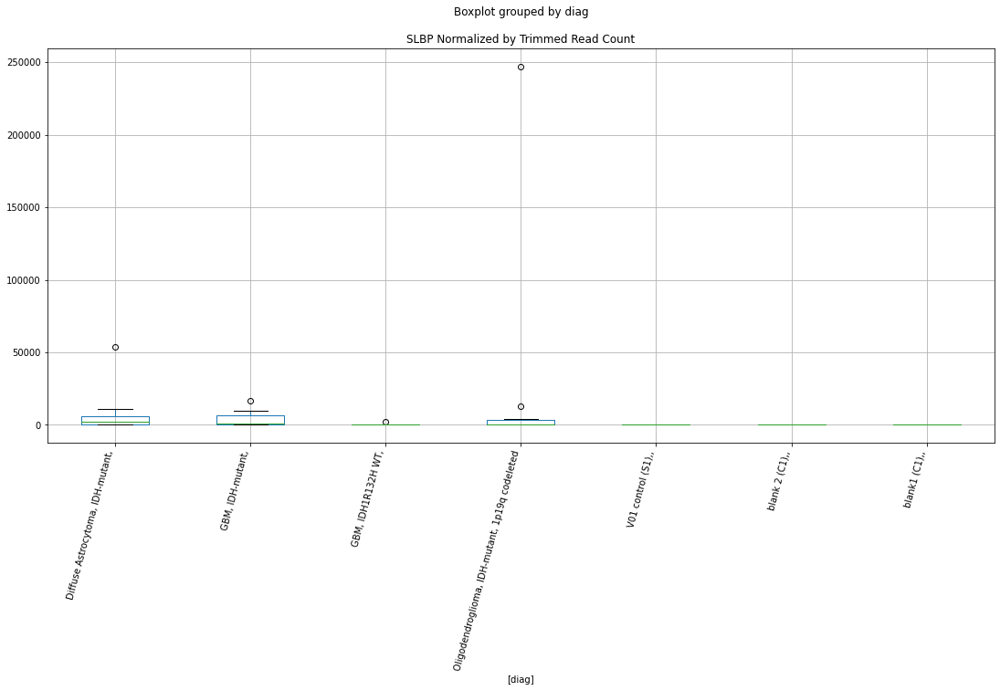

 p : 0.04352922653121191  ( t : 2.17122039755945 ) :  D-plex  :  cutadapt2  :  SCUBE2
Control and blanks
76     0.0
340    0.0
Name: SCUBE2, dtype: float64
208    5819.89
Name: SCUBE2, dtype: float64
472    14448.9
Name: SCUBE2, dtype: float64


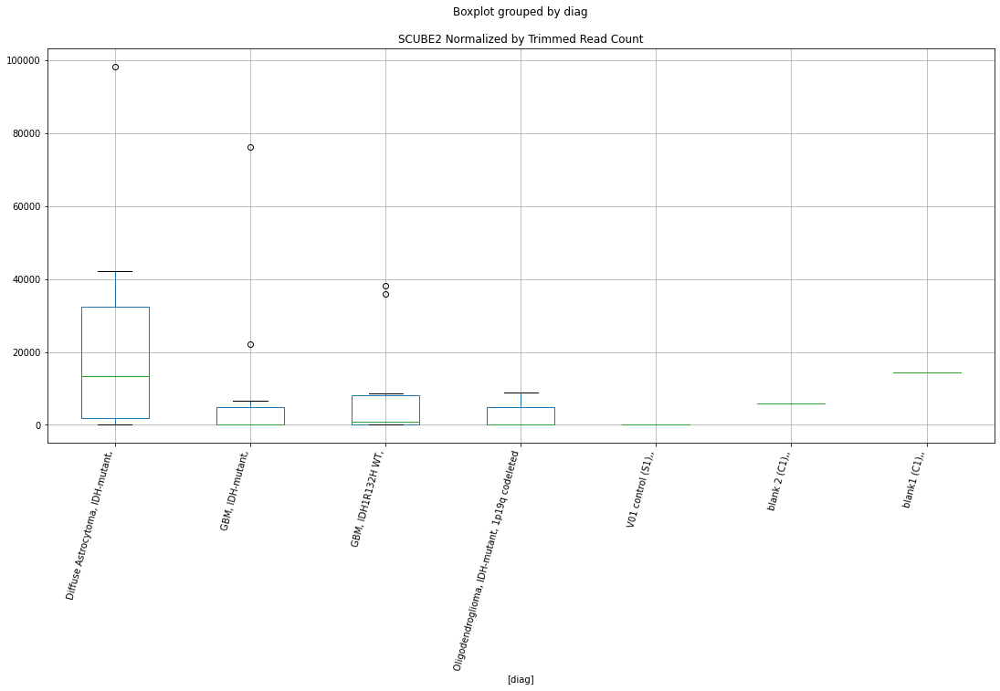

 p : 0.04356531124077207  ( t : 2.1708025828554227 ) :  D-plex  :  bbduk2  :  SOX8
Control and blanks
73       0.00
337    890.16
Name: SOX8, dtype: float64
205    358.18
Name: SOX8, dtype: float64
469    0.0
Name: SOX8, dtype: float64


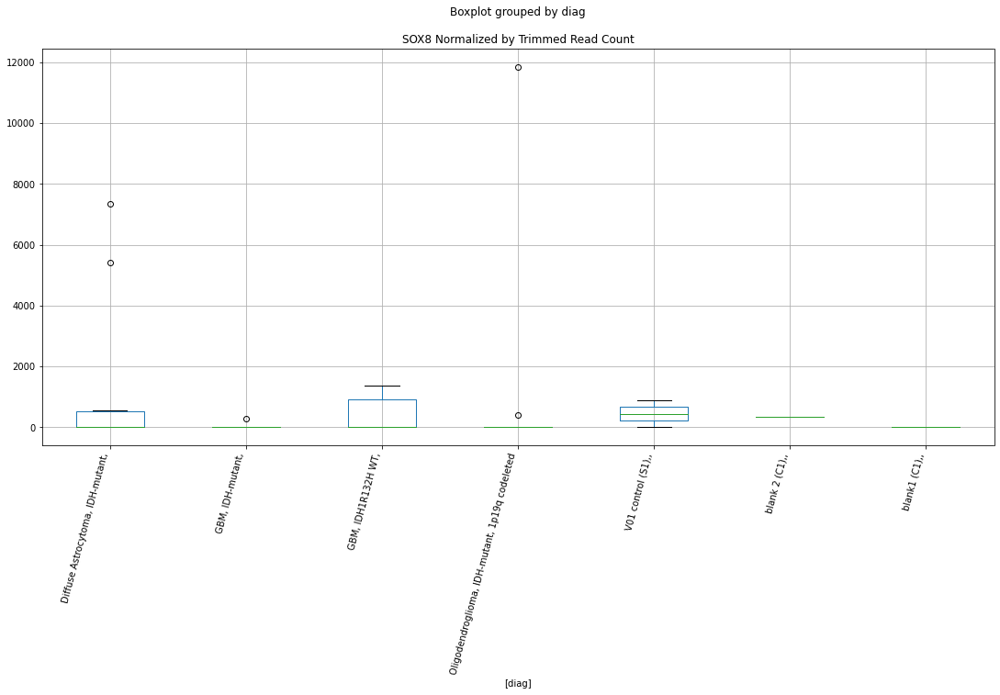

 p : 0.043632645257431935  ( t : 2.1700237878598125 ) :  D-plex  :  bbduk2  :  PHLDA3
Control and blanks
73     0.0
337    0.0
Name: PHLDA3, dtype: float64
205    1970.0
Name: PHLDA3, dtype: float64
469    5915.27
Name: PHLDA3, dtype: float64


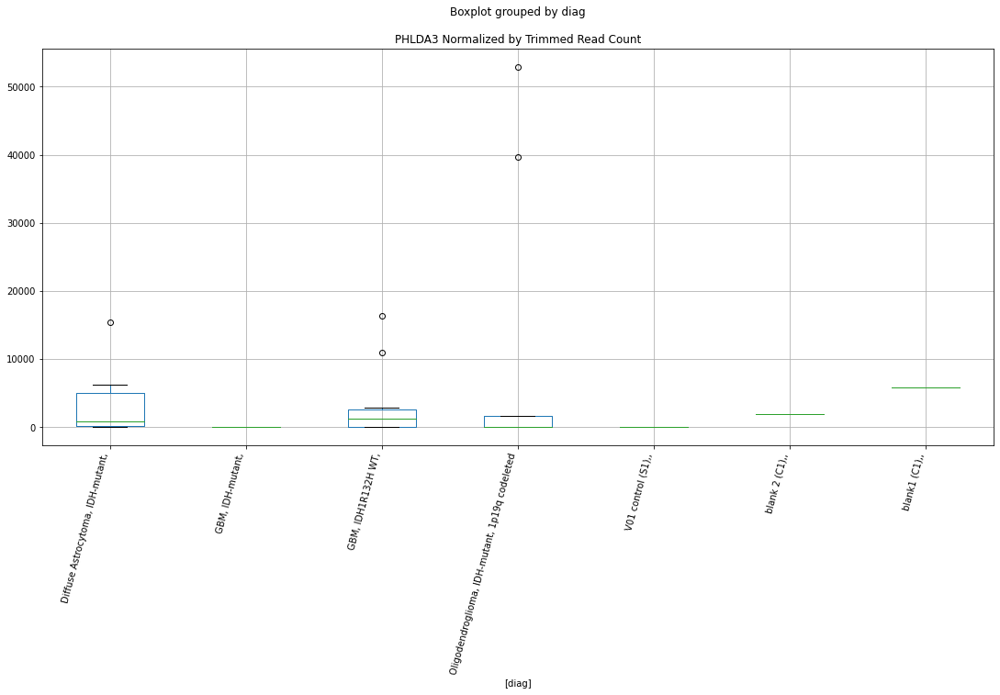

 p : 0.043641792178367646  ( t : 2.1699180781570844 ) :  Lexogen  :  cutadapt2  :  SAFB2
Control and blanks
82     0.0
346    0.0
Name: SAFB2, dtype: float64
214    2712.26
Name: SAFB2, dtype: float64
478    0.0
Name: SAFB2, dtype: float64


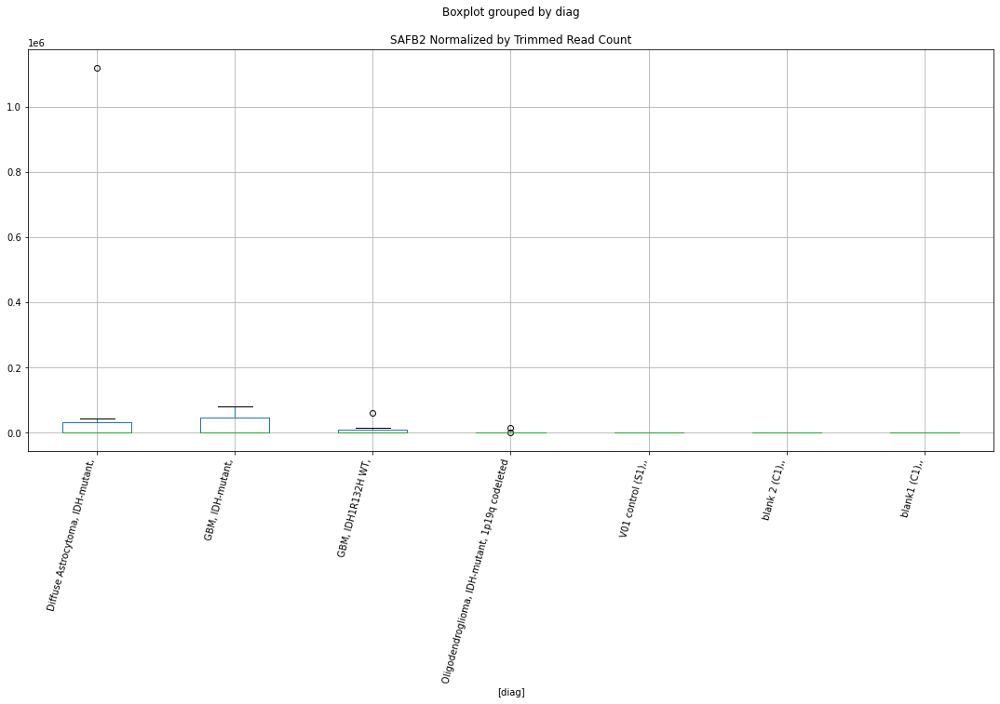

 p : 0.043661334265084326  ( t : 2.1696923009087667 ) :  D-plex  :  bbduk2  :  RHOBTB2
Control and blanks
73     17779.19
337     3560.63
Name: RHOBTB2, dtype: float64
205    18088.19
Name: RHOBTB2, dtype: float64
469    55603.57
Name: RHOBTB2, dtype: float64


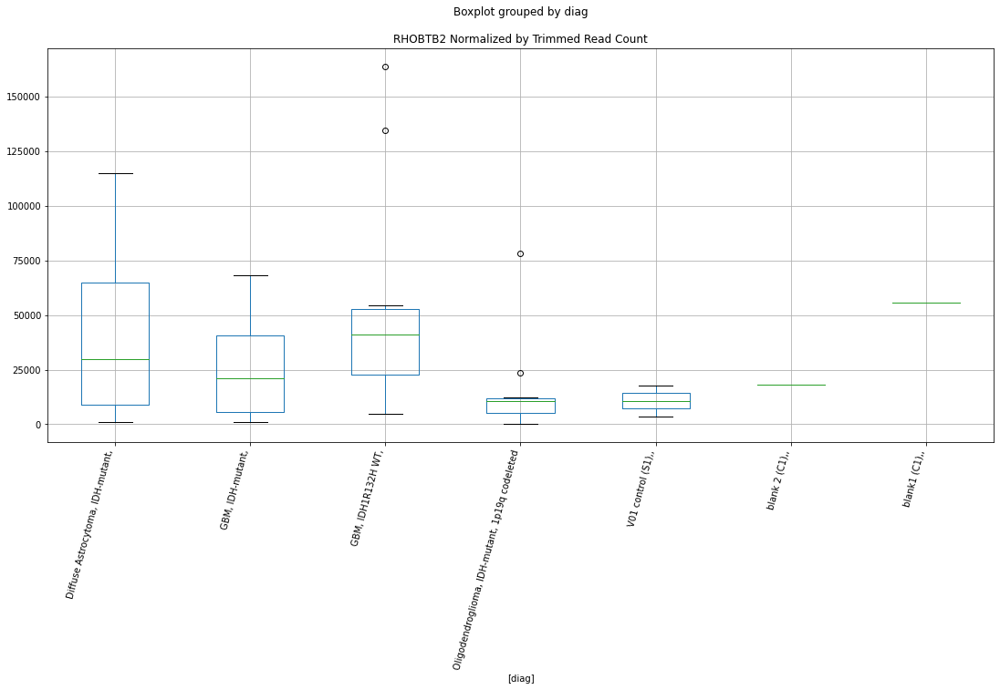

 p : 0.04367502938311159  ( t : 2.169534131073913 ) :  D-plex  :  bbduk2  :  PDGFB
Control and blanks
73         0.00
337    24034.25
Name: PDGFB, dtype: float64
205    2149.09
Name: PDGFB, dtype: float64
469    591.53
Name: PDGFB, dtype: float64


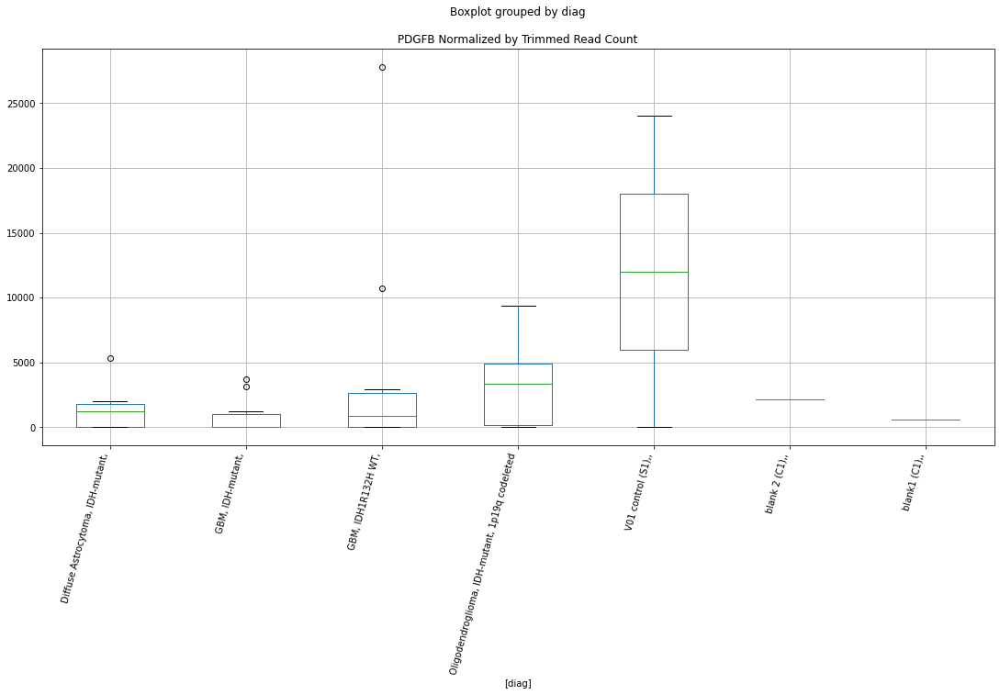

 p : 0.04369093068558091  ( t : 2.1693505381843625 ) :  Lexogen  :  bbduk2  :  SORBS2
Control and blanks
79     0.0
343    0.0
Name: SORBS2, dtype: float64
211    0.0
Name: SORBS2, dtype: float64
475    0.0
Name: SORBS2, dtype: float64


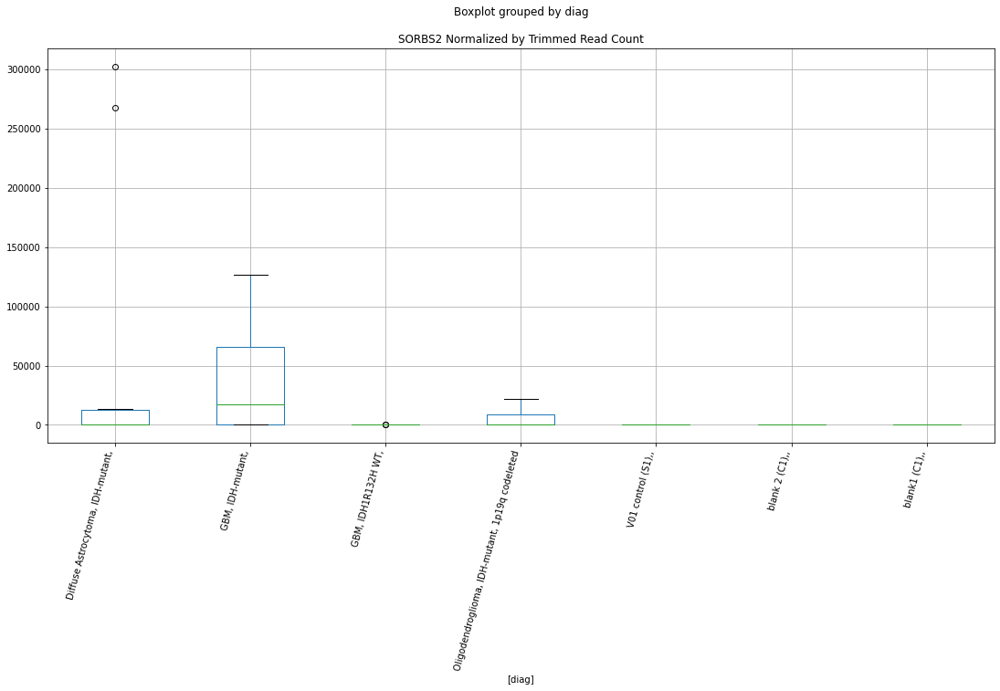

 p : 0.04370986781064841  ( t : 2.169131974157751 ) :  D-plex  :  bbduk2  :  PER2
Control and blanks
73     21644.24
337        0.00
Name: PER2, dtype: float64
205    5551.82
Name: PER2, dtype: float64
469    4732.22
Name: PER2, dtype: float64


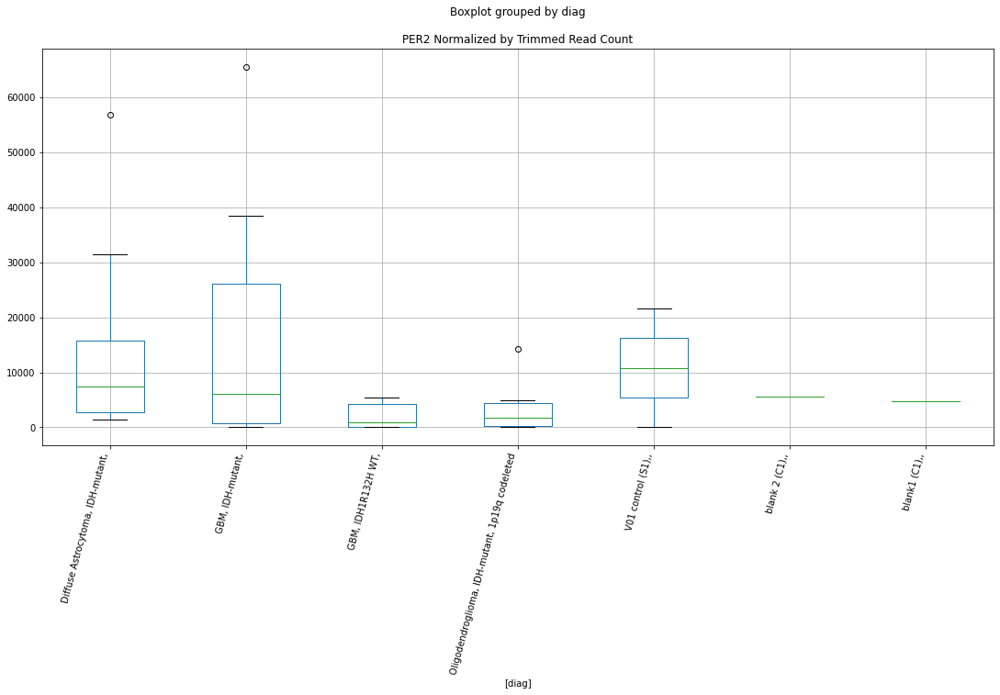

 p : 0.04371279983014319  ( t : 2.1690981418201023 ) :  D-plex  :  bbduk2  :  PTGER1
Control and blanks
73     0.0
337    0.0
Name: PTGER1, dtype: float64
205    537.27
Name: PTGER1, dtype: float64
469    1183.05
Name: PTGER1, dtype: float64


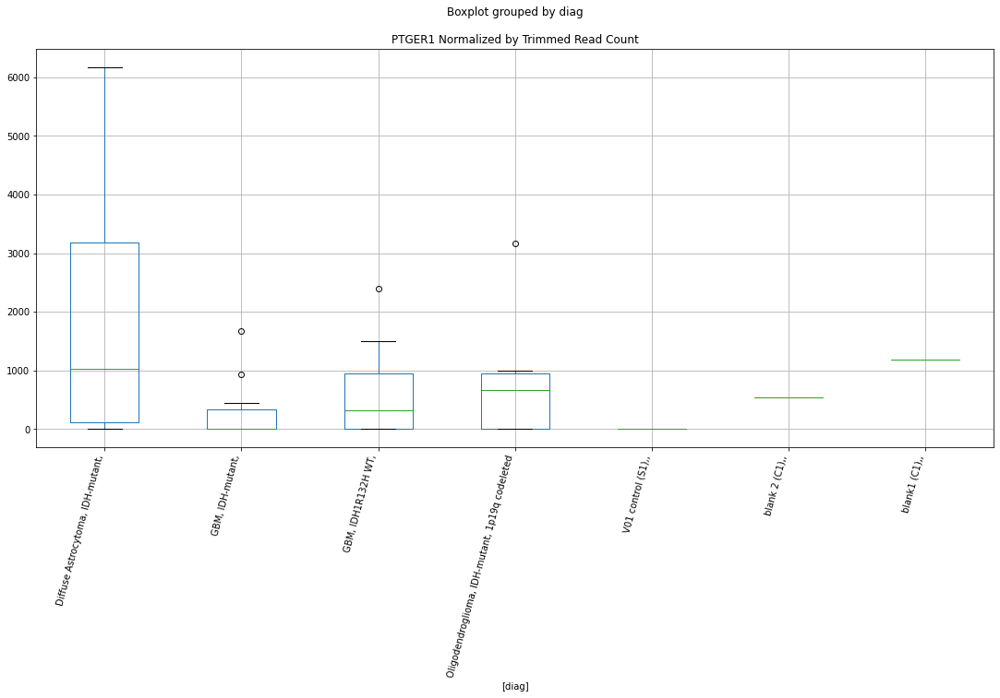

 p : 0.04371344338653983  ( t : 2.169090716152545 ) :  Lexogen  :  bbduk2  :  RAP1B
Control and blanks
79     0.0
343    0.0
Name: RAP1B, dtype: float64
211    3279.68
Name: RAP1B, dtype: float64
475    1437.09
Name: RAP1B, dtype: float64


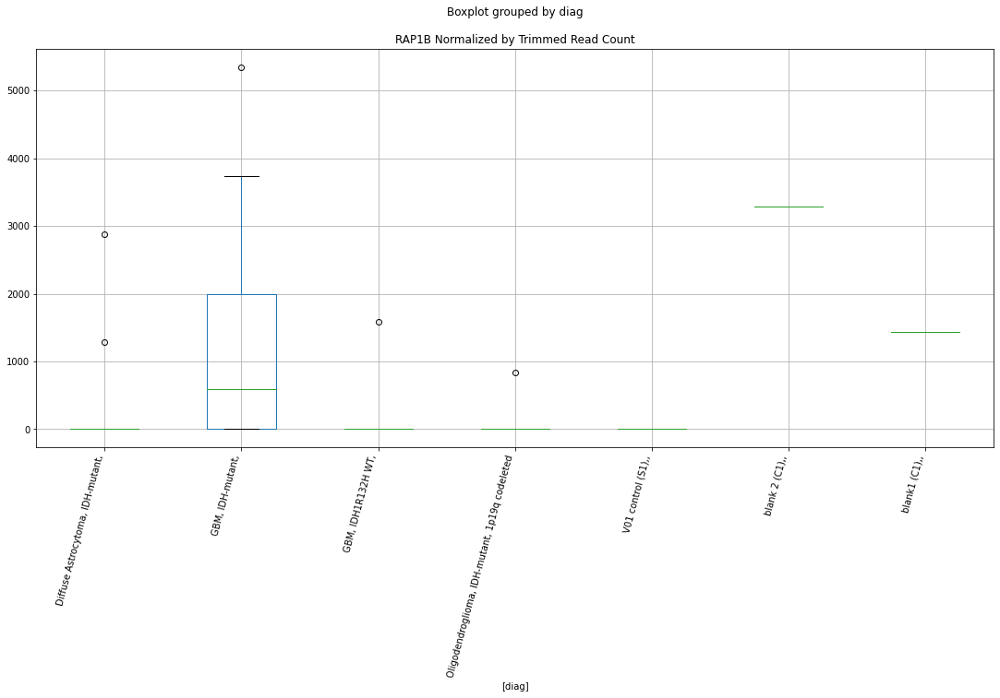

 p : 0.043755755520425606  ( t : 2.1686027175926794 ) :  Lexogen  :  cutadapt2  :  PCDHGA3
Control and blanks
82         0.00
346    16834.76
Name: PCDHGA3, dtype: float64
214    0.0
Name: PCDHGA3, dtype: float64
478    8548.58
Name: PCDHGA3, dtype: float64


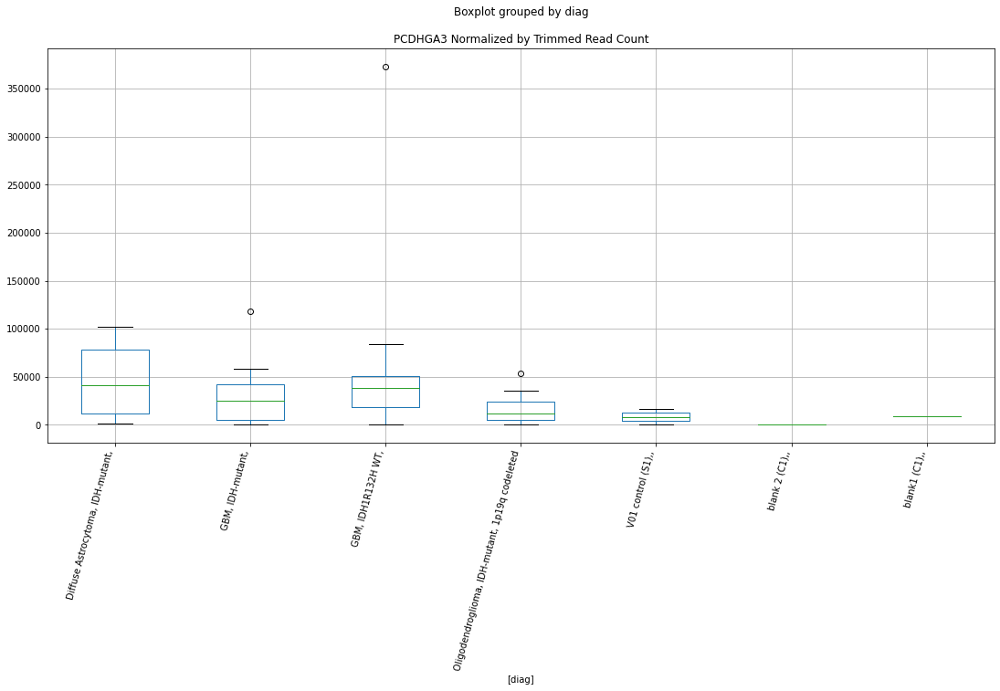

 p : 0.04376662116199141  ( t : 2.1684774705987286 ) :  D-plex  :  cutadapt2  :  PARP10
Control and blanks
76      6060.91
340    52843.93
Name: PARP10, dtype: float64
208    36859.29
Name: PARP10, dtype: float64
472    34099.39
Name: PARP10, dtype: float64


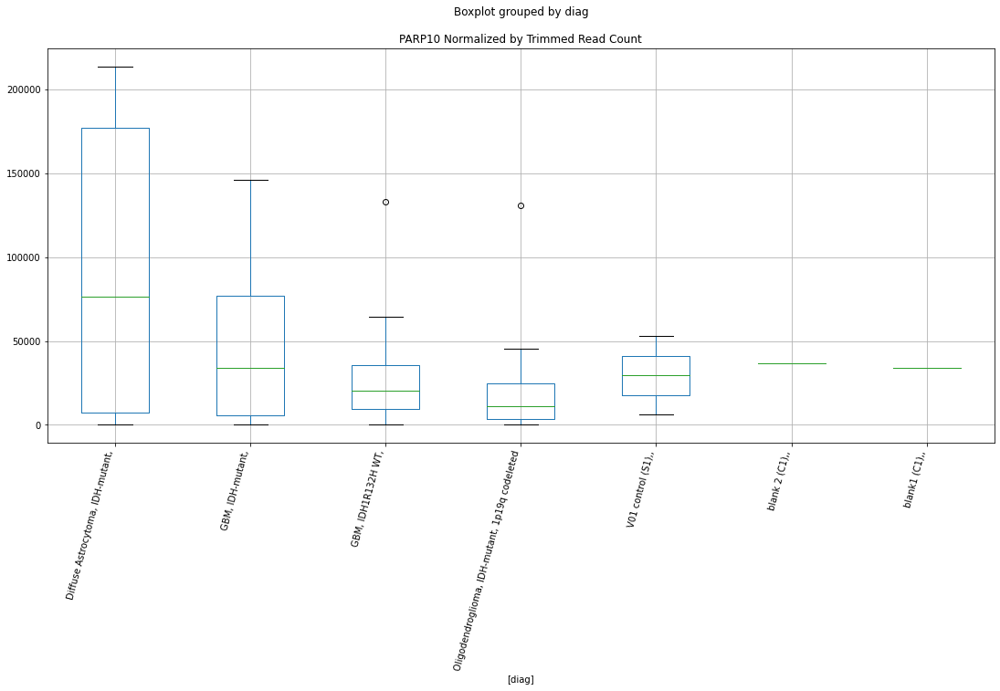

 p : 0.04377863536716349  ( t : 2.168339017378953 ) :  Lexogen  :  bbduk2  :  PCDHGA3
Control and blanks
79         0.00
343    16985.15
Name: PCDHGA3, dtype: float64
211    0.0
Name: PCDHGA3, dtype: float64
475    8622.57
Name: PCDHGA3, dtype: float64


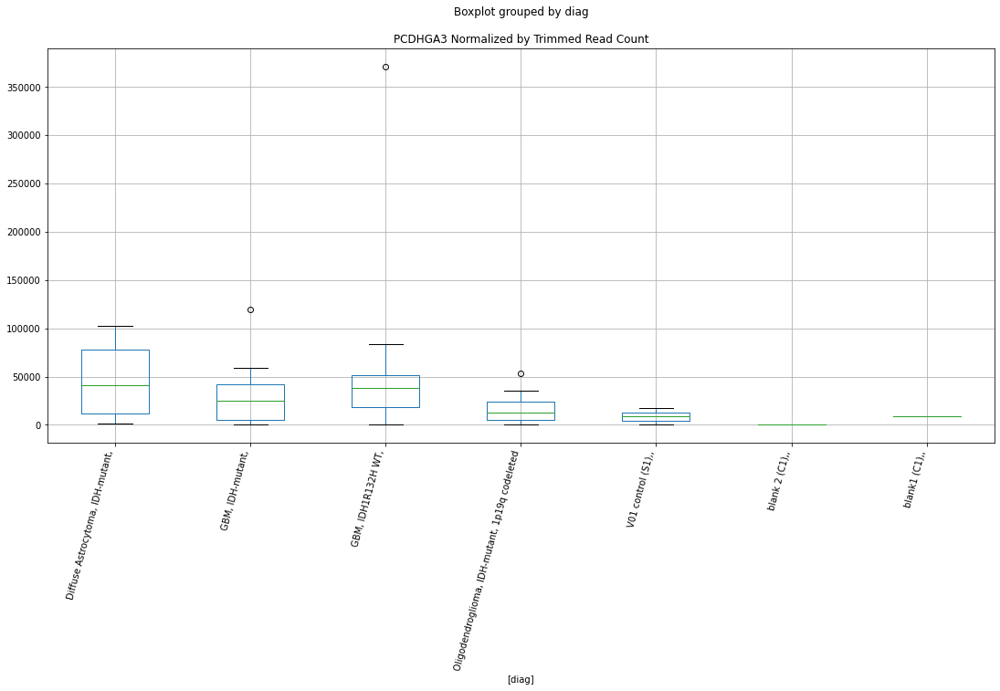

 p : 0.04378284766324293  ( t : 2.168290482581802 ) :  Lexogen  :  cutadapt2  :  PRORY
Control and blanks
82     0.0
346    0.0
Name: PRORY, dtype: float64
214    0.0
Name: PRORY, dtype: float64
478    0.0
Name: PRORY, dtype: float64


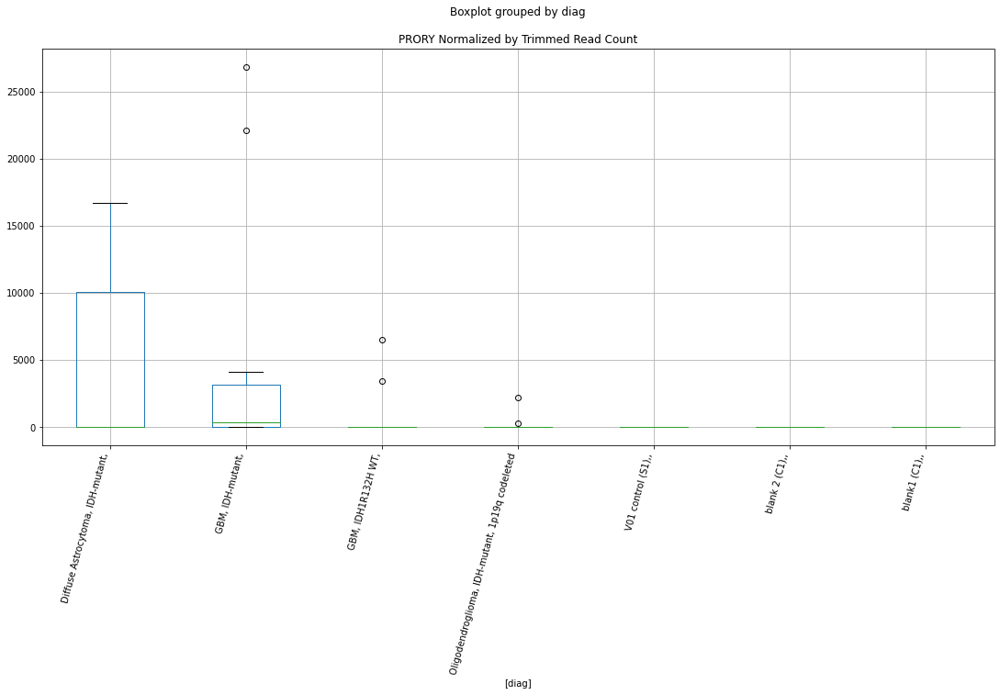

 p : 0.043813146819896044  ( t : 2.167941496412012 ) :  D-plex  :  cutadapt2  :  RASSF8
Control and blanks
76     0.0
340    0.0
Name: RASSF8, dtype: float64
208    4056.29
Name: RASSF8, dtype: float64
472    2311.82
Name: RASSF8, dtype: float64


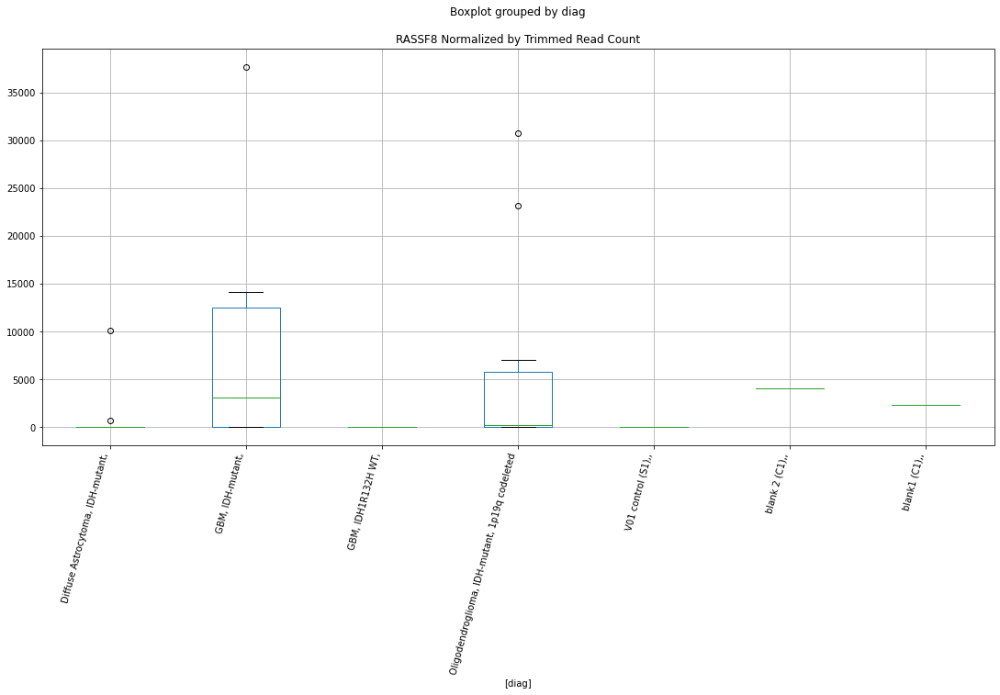

 p : 0.0438294519173309  ( t : 2.167753785464847 ) :  D-plex  :  bbduk2  :  RALGAPA1P1
Control and blanks
73     62613.68
337    82784.63
Name: RALGAPA1P1, dtype: float64
205    19341.82
Name: RALGAPA1P1, dtype: float64
469    32534.0
Name: RALGAPA1P1, dtype: float64


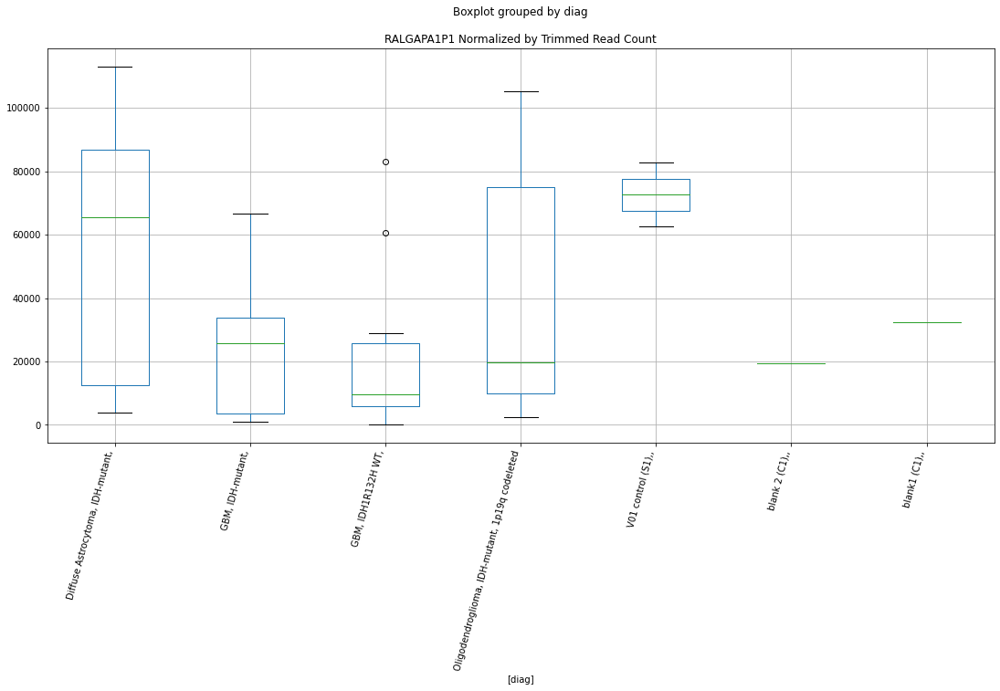

 p : 0.04383194578361494  ( t : 2.167725080693141 ) :  Lexogen  :  bbduk2  :  SLC8A3
Control and blanks
79        0.00
343    2123.14
Name: SLC8A3, dtype: float64
211    2733.06
Name: SLC8A3, dtype: float64
475    4790.31
Name: SLC8A3, dtype: float64


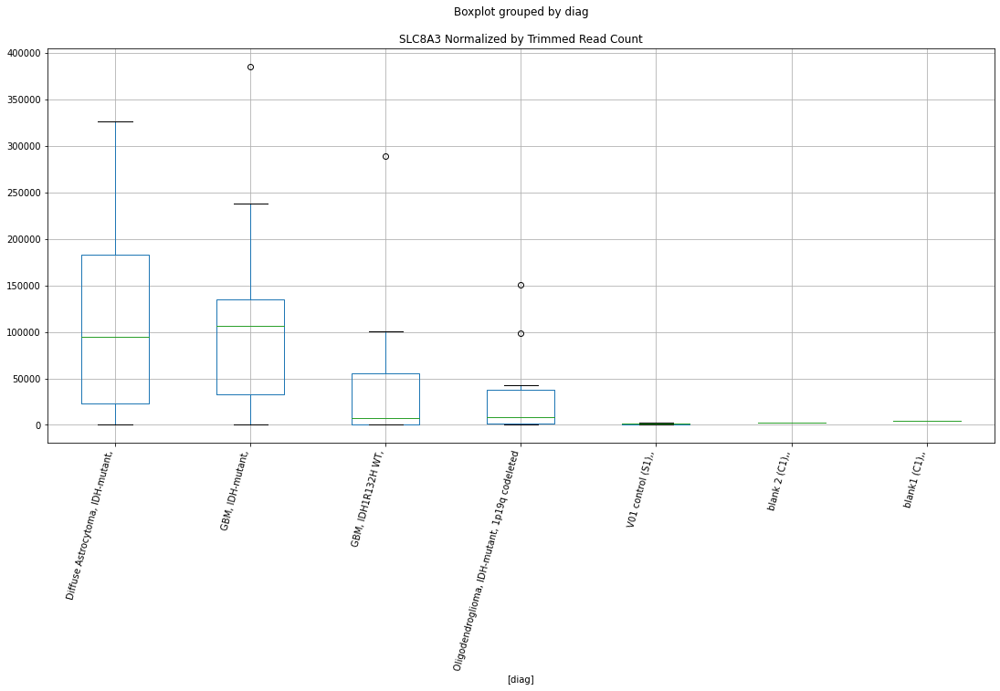

 p : 0.0438499288883978  ( t : 2.1675181367310175 ) :  D-plex  :  bbduk2  :  SLC51A
Control and blanks
73     0.0
337    0.0
Name: SLC51A, dtype: float64
205    0.0
Name: SLC51A, dtype: float64
469    0.0
Name: SLC51A, dtype: float64


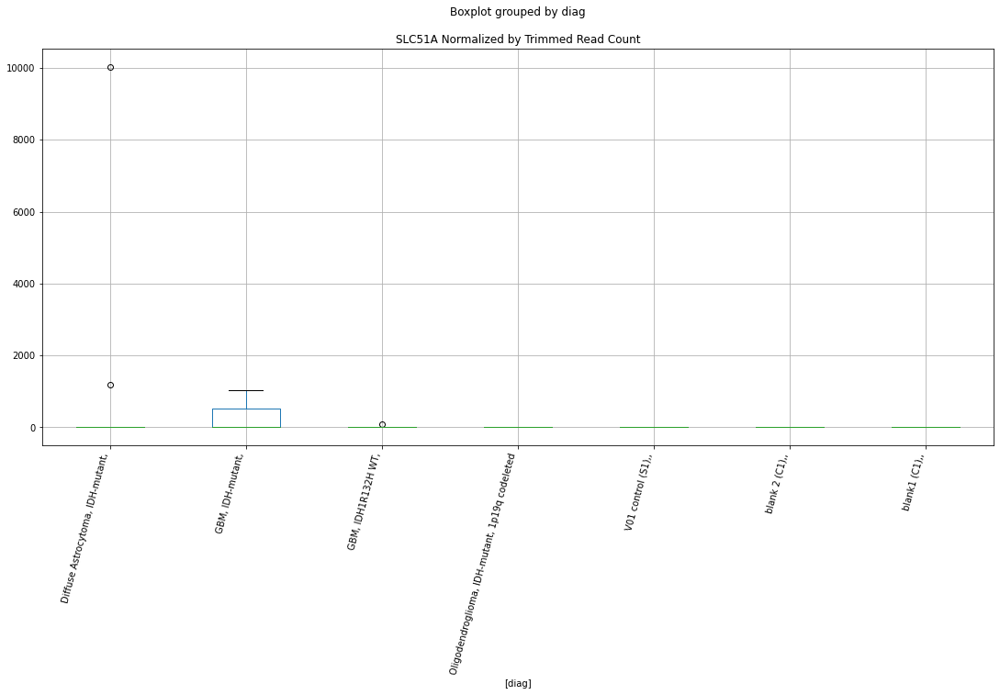

 p : 0.043863982987217005  ( t : 2.167356460618822 ) :  Lexogen  :  bbduk2  :  PFKP
Control and blanks
79     0.0
343    0.0
Name: PFKP, dtype: float64
211    0.0
Name: PFKP, dtype: float64
475    0.0
Name: PFKP, dtype: float64


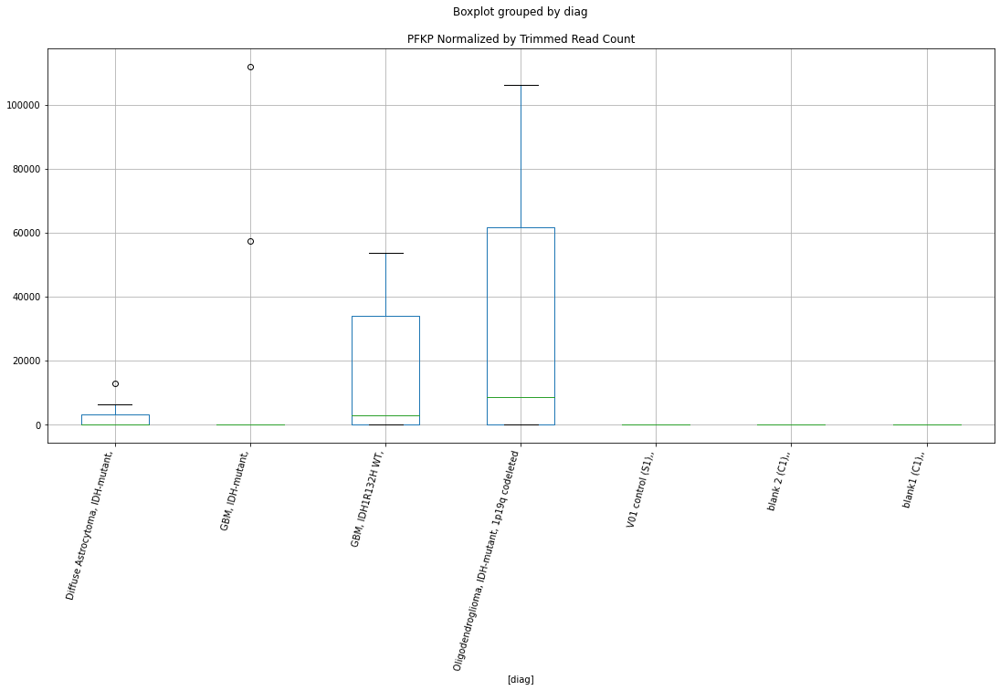

 p : 0.04388976424262009  ( t : 2.1670600004013845 ) :  D-plex  :  cutadapt2  :  PER2
Control and blanks
76     18940.36
340     2642.20
Name: PER2, dtype: float64
208    5996.25
Name: PER2, dtype: float64
472    4045.69
Name: PER2, dtype: float64


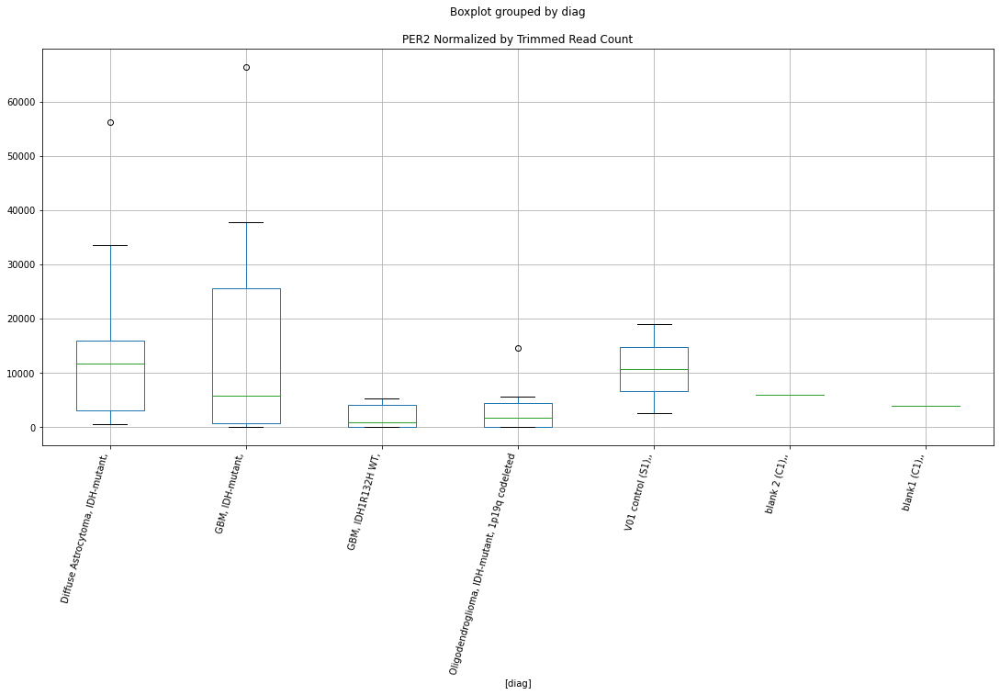

 p : 0.04392035615159062  ( t : 2.1667084289066683 ) :  D-plex  :  bbduk2  :  S1PR3
Control and blanks
73     0.0
337    0.0
Name: S1PR3, dtype: float64
205    1432.73
Name: S1PR3, dtype: float64
469    2366.11
Name: S1PR3, dtype: float64


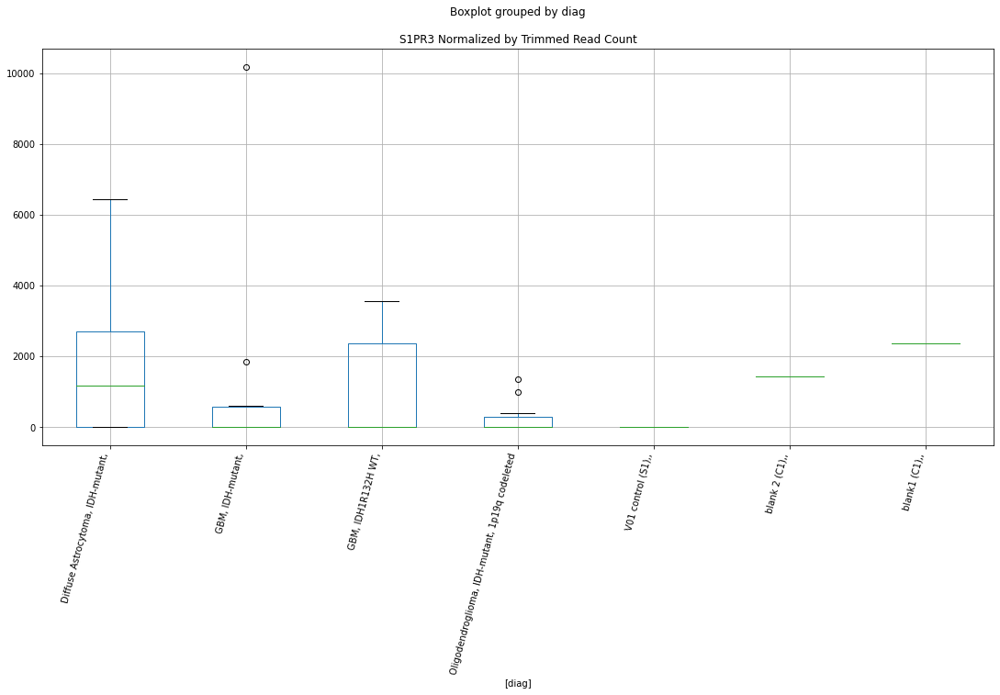

 p : 0.043936798713166275  ( t : 2.166519558603951 ) :  D-plex  :  cutadapt2  :  RFLNA
Control and blanks
76     757.61
340      0.00
Name: RFLNA, dtype: float64
208    4409.01
Name: RFLNA, dtype: float64
472    1733.87
Name: RFLNA, dtype: float64


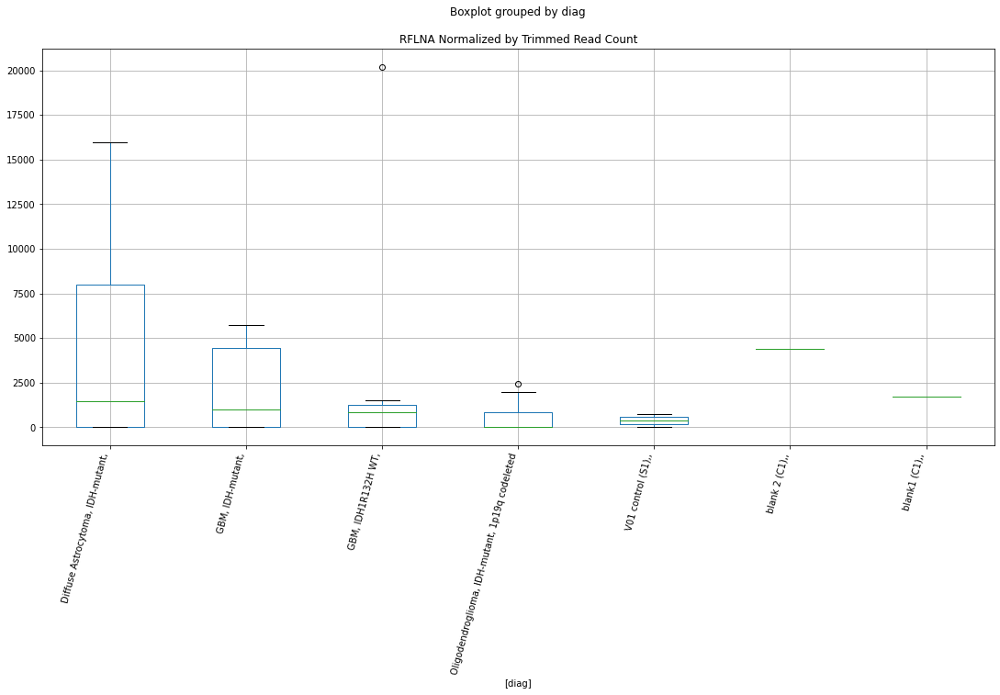

 p : 0.043979245599084796  ( t : 2.1660322840761963 ) :  D-plex  :  bbduk2  :  RNF19A
Control and blanks
73         0.00
337    50738.96
Name: RNF19A, dtype: float64
205    11103.64
Name: RNF19A, dtype: float64
469    0.0
Name: RNF19A, dtype: float64


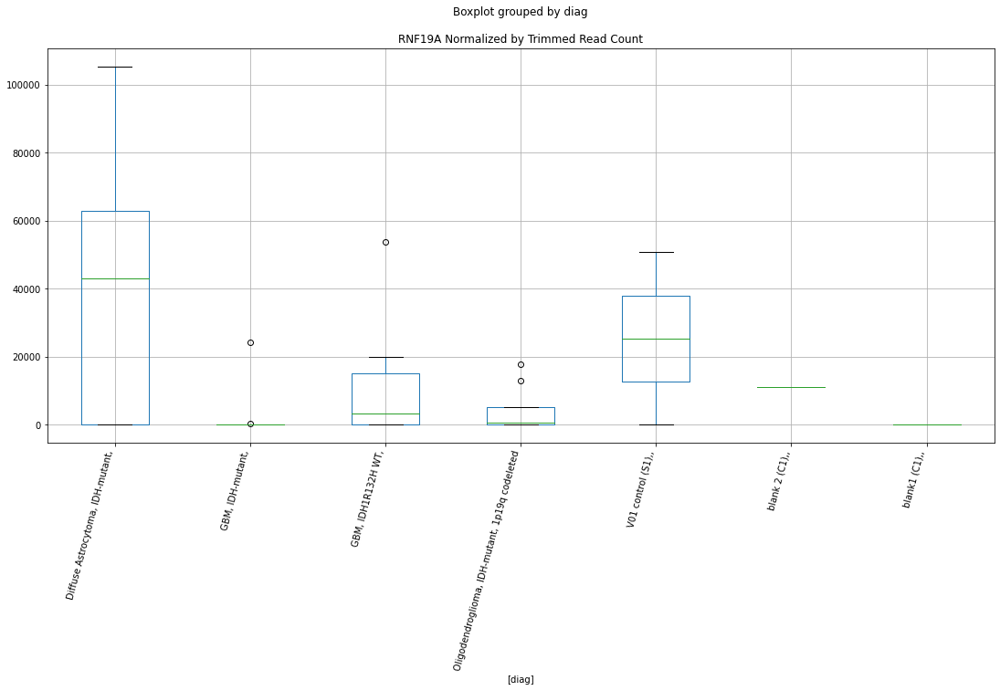

 p : 0.04398370848679514  ( t : 2.165981076788662 ) :  D-plex  :  bbduk2  :  RNF145
Control and blanks
73     4638.05
337       0.00
Name: RNF145, dtype: float64
205    6268.18
Name: RNF145, dtype: float64
469    1183.05
Name: RNF145, dtype: float64


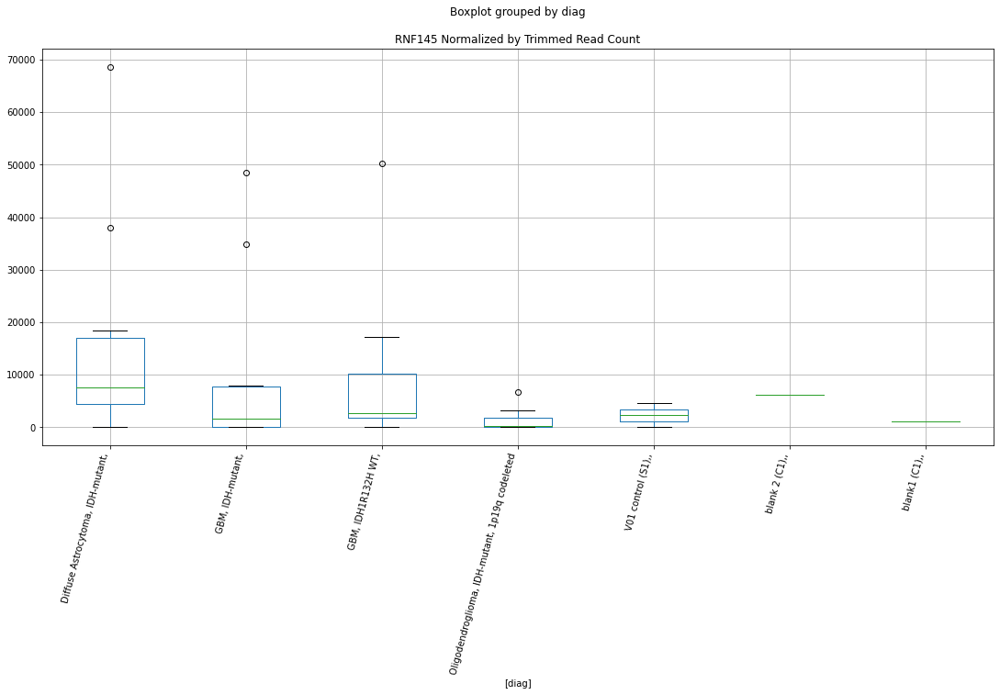

 p : 0.04398976953068262  ( t : 2.165911539830507 ) :  Lexogen  :  bbduk2  :  PLXNC1
Control and blanks
79     0.0
343    0.0
Name: PLXNC1, dtype: float64
211    2459.76
Name: PLXNC1, dtype: float64
475    0.0
Name: PLXNC1, dtype: float64


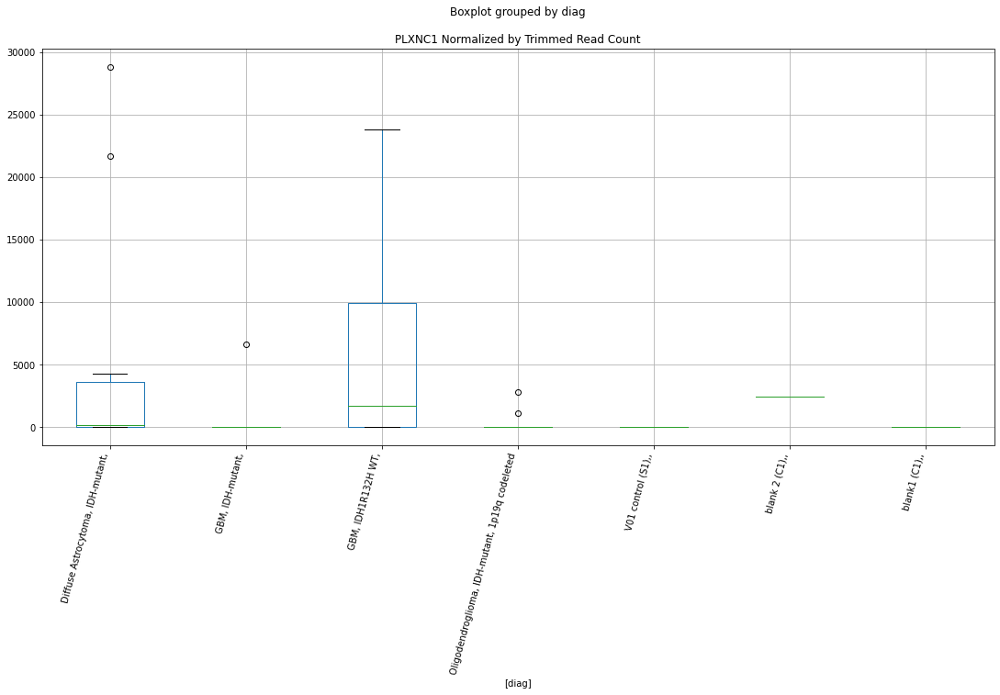

 p : 0.04400356904497976  ( t : 2.165753253890217 ) :  Lexogen  :  bbduk2  :  SCARNA17
Control and blanks
79      2861.20
343    14437.37
Name: SCARNA17, dtype: float64
211    14211.93
Name: SCARNA17, dtype: float64
475    958.06
Name: SCARNA17, dtype: float64


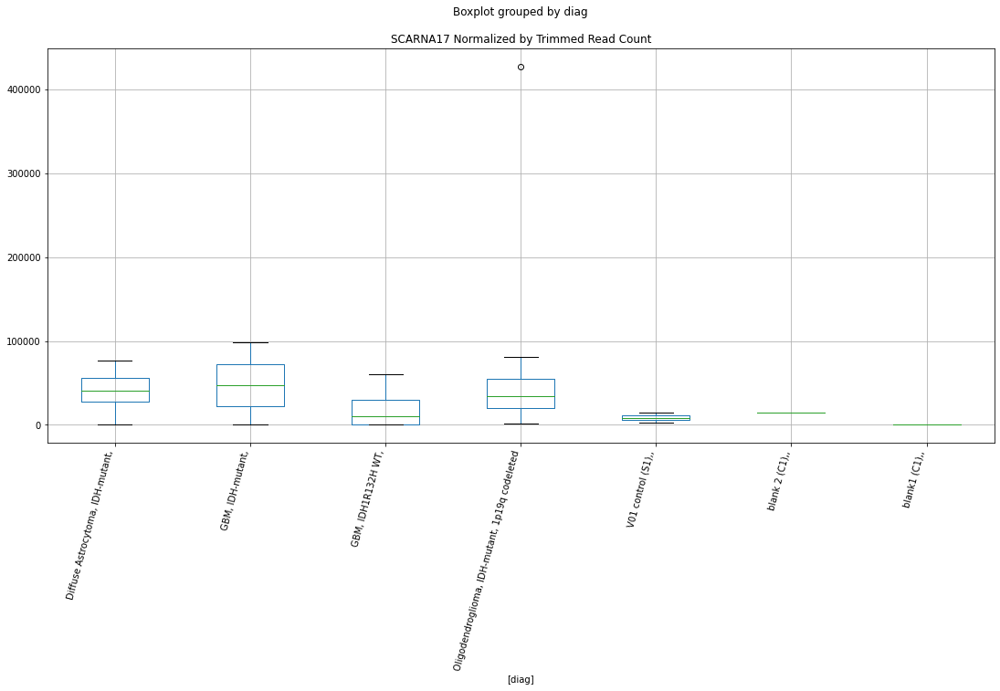

 p : 0.04411610077975242  ( t : 2.164464162995199 ) :  D-plex  :  cutadapt2  :  PTPRS
Control and blanks
76      56063.45
340    456219.25
Name: PTPRS, dtype: float64
208    108108.81
Name: PTPRS, dtype: float64
472    84381.55
Name: PTPRS, dtype: float64


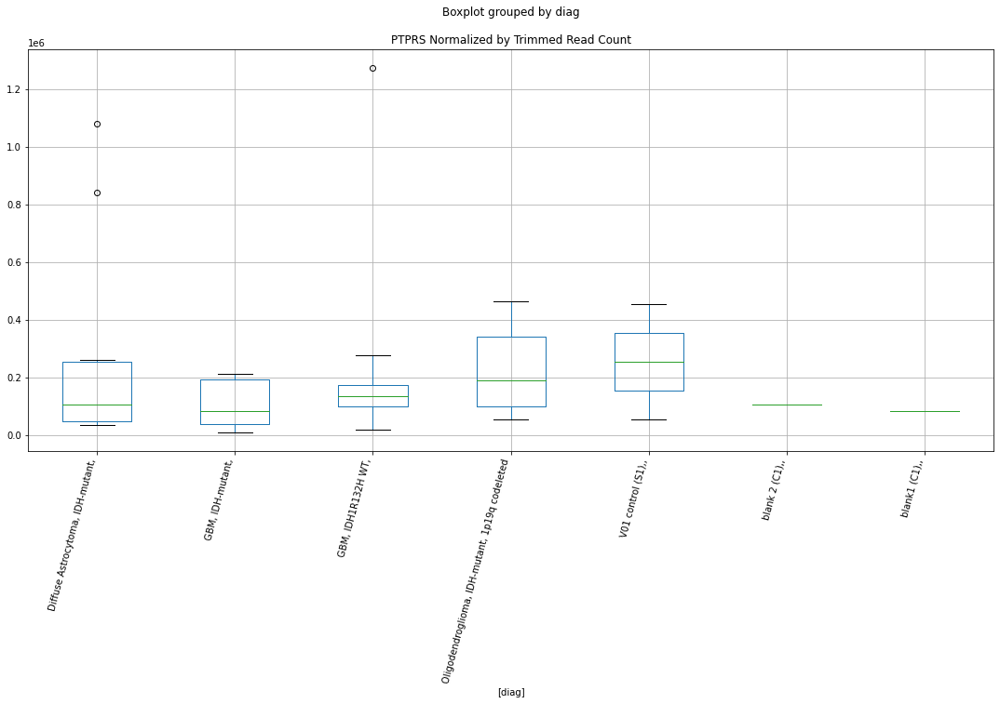

 p : 0.044276597019721683  ( t : 2.1626308181120826 ) :  D-plex  :  bbduk2  :  SLAMF1
Control and blanks
73     0.0
337    0.0
Name: SLAMF1, dtype: float64
205    9133.64
Name: SLAMF1, dtype: float64
469    21294.98
Name: SLAMF1, dtype: float64


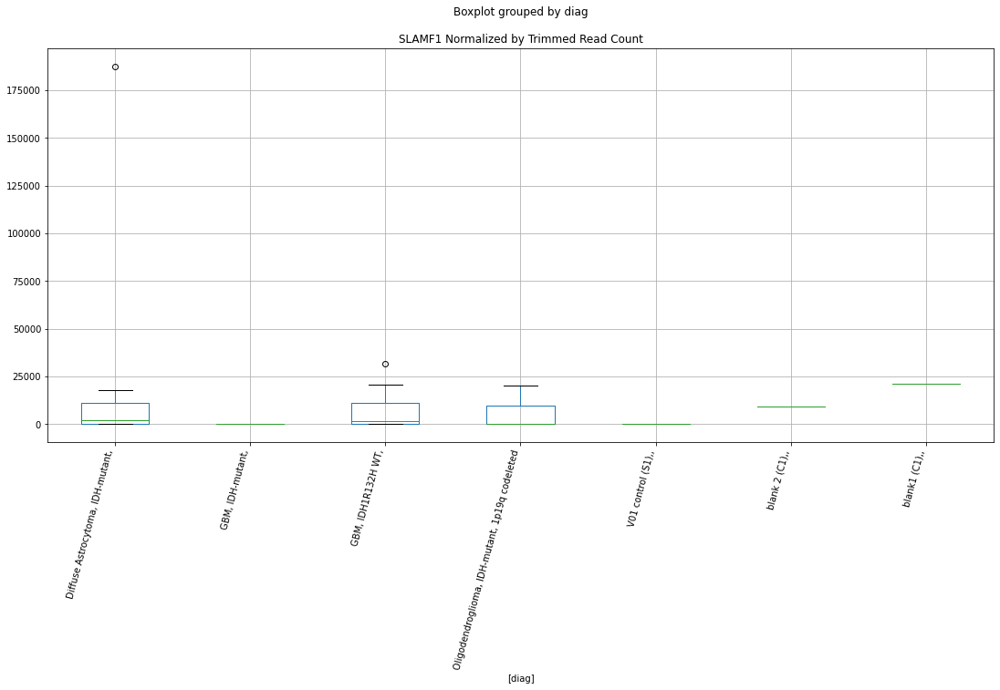

 p : 0.04429179404019277  ( t : 2.1624575381672004 ) :  D-plex  :  bbduk2  :  PELI3
Control and blanks
73        0.00
337    5340.94
Name: PELI3, dtype: float64
205    20058.19
Name: PELI3, dtype: float64
469    24844.15
Name: PELI3, dtype: float64


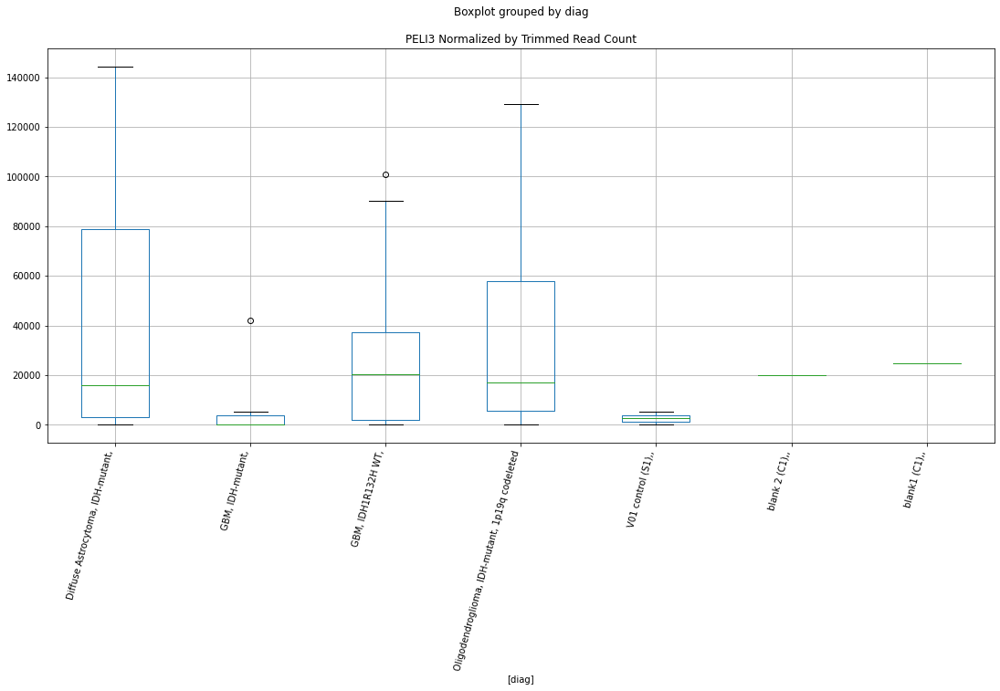

 p : 0.0443532438065351  ( t : 2.16175742790115 ) :  D-plex  :  bbduk2  :  PALD1
Control and blanks
73     1.19e+06
337    4.81e+05
Name: PALD1, dtype: float64
205    426594.65
Name: PALD1, dtype: float64
469    475587.96
Name: PALD1, dtype: float64


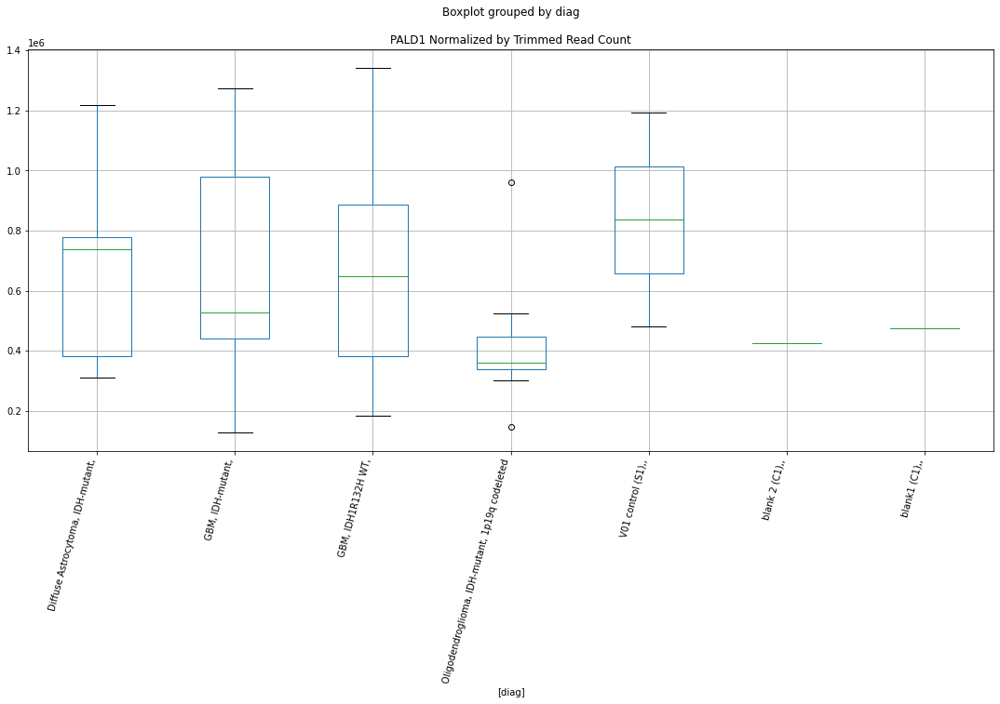

 p : 0.044381762080920095  ( t : 2.161432814559001 ) :  D-plex  :  bbduk2  :  PARP10
Control and blanks
73      3092.03
337    53409.44
Name: PARP10, dtype: float64
205    38862.74
Name: PARP10, dtype: float64
469    39632.33
Name: PARP10, dtype: float64


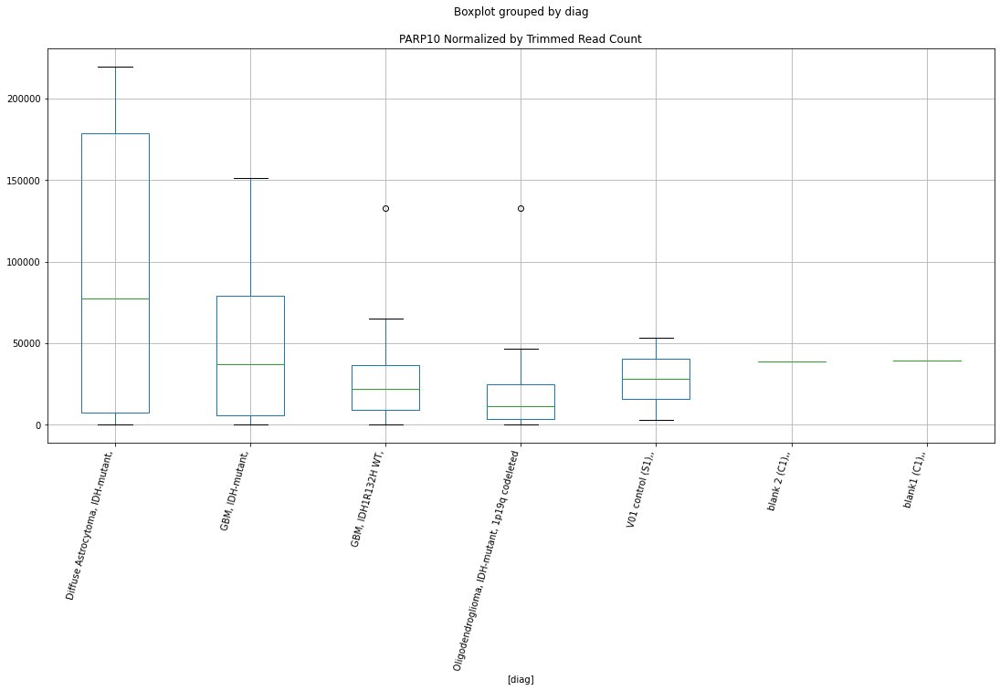

 p : 0.04445301433717495  ( t : 2.1606226087258205 ) :  D-plex  :  bbduk2  :  RASL11B
Control and blanks
73     0.0
337    0.0
Name: RASL11B, dtype: float64
205    537.27
Name: RASL11B, dtype: float64
469    591.53
Name: RASL11B, dtype: float64


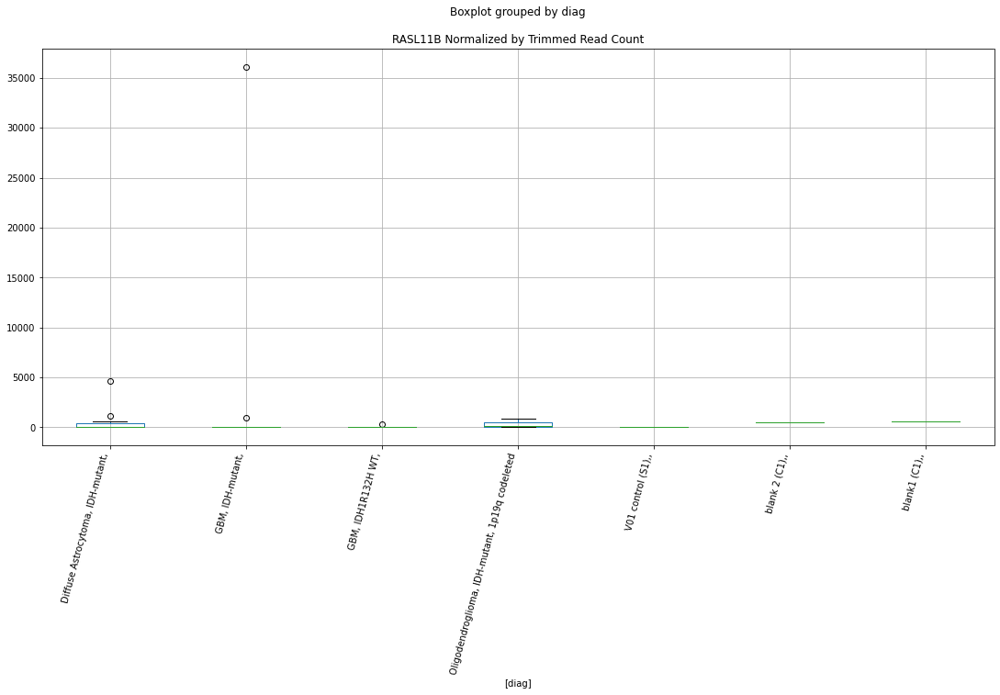

 p : 0.044482080430900794  ( t : 2.160292440728291 ) :  D-plex  :  bbduk2  :  PCDHGB1
Control and blanks
73     0.0
337    0.0
Name: PCDHGB1, dtype: float64
205    2507.27
Name: PCDHGB1, dtype: float64
469    1774.58
Name: PCDHGB1, dtype: float64


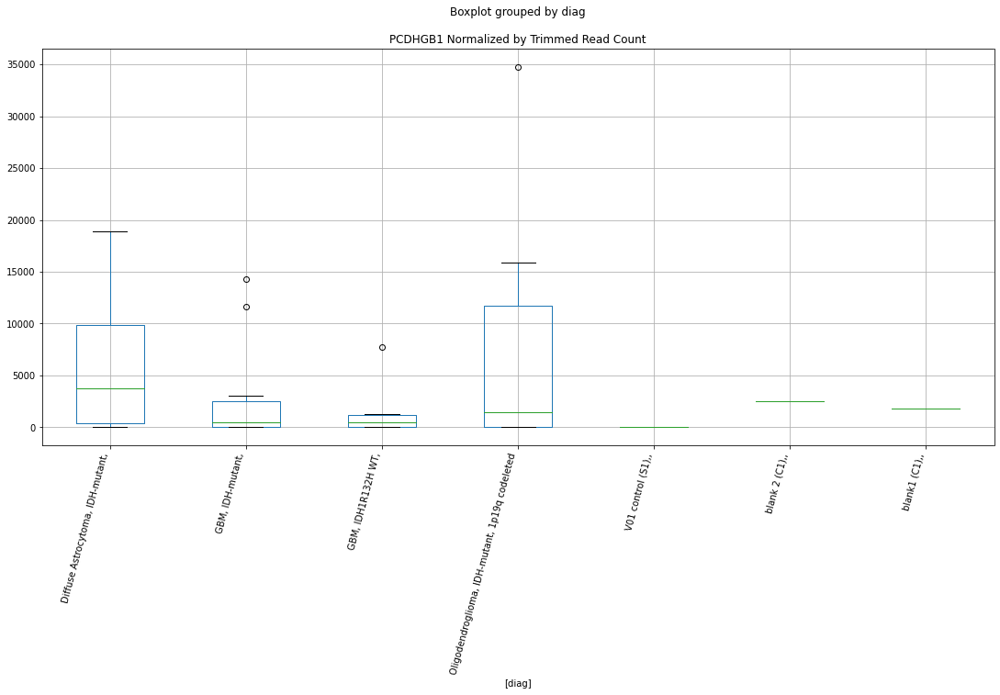

 p : 0.04448917730903777  ( t : 2.1602118557408523 ) :  D-plex  :  bbduk2  :  POLQ
Control and blanks
73        0.00
337    8011.42
Name: POLQ, dtype: float64
205    1253.64
Name: POLQ, dtype: float64
469    0.0
Name: POLQ, dtype: float64


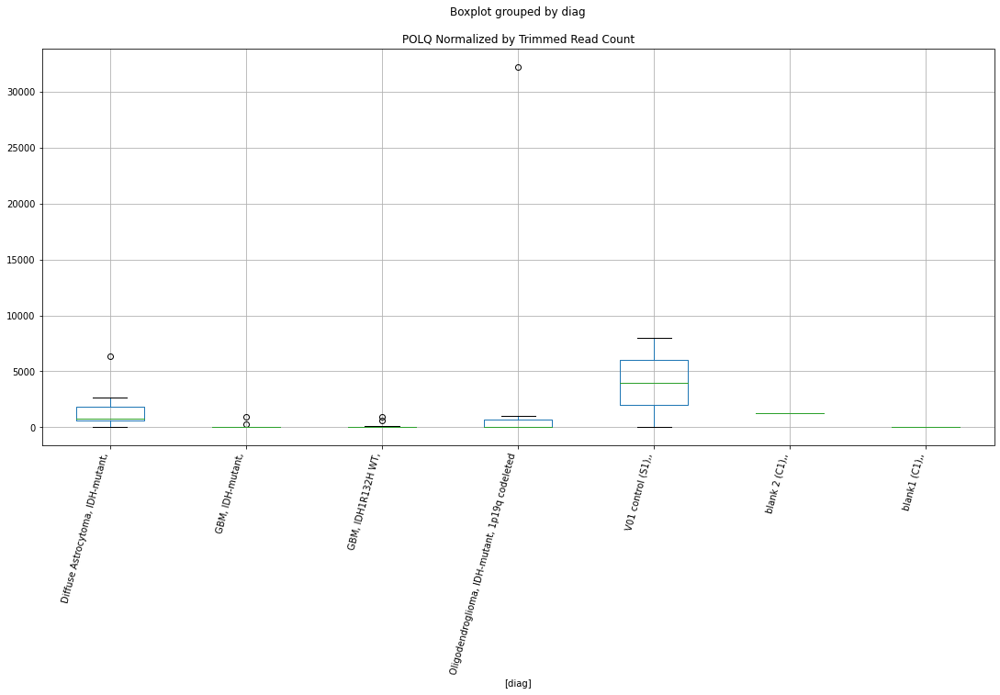

 p : 0.044559812243564006  ( t : 2.1594104369558687 ) :  Lexogen  :  bbduk2  :  PSMG3-AS1
Control and blanks
79     25750.78
343    76008.52
Name: PSMG3-AS1, dtype: float64
211    0.0
Name: PSMG3-AS1, dtype: float64
475    0.0
Name: PSMG3-AS1, dtype: float64


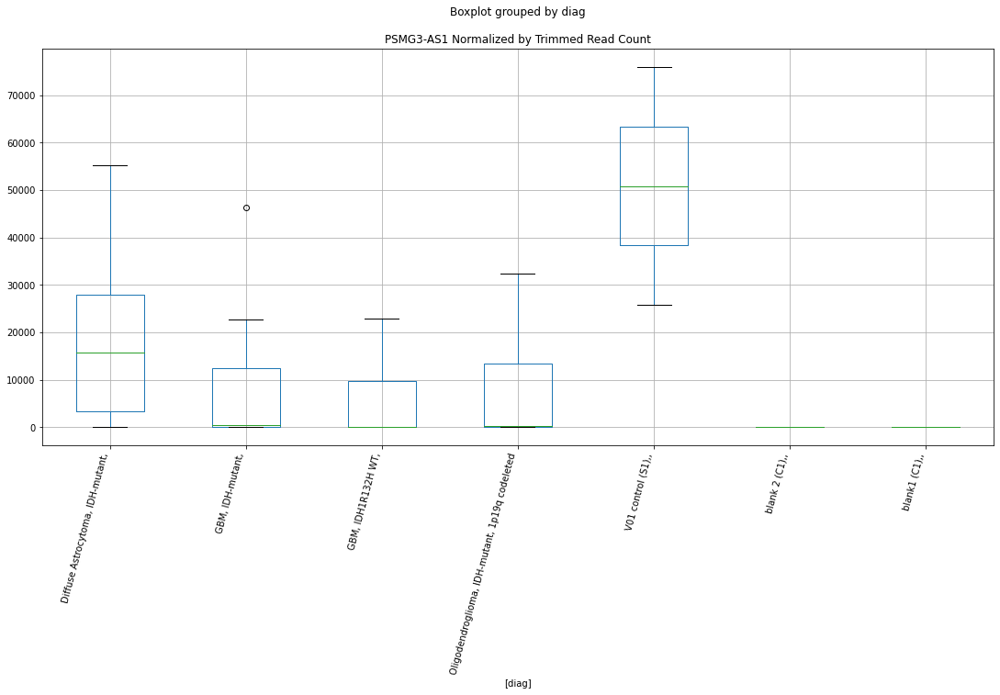

 p : 0.04463537168026394  ( t : 2.1585544303541644 ) :  D-plex  :  cutadapt2  :  SGMS1
Control and blanks
76        0.00
340    1761.46
Name: SGMS1, dtype: float64
208    705.44
Name: SGMS1, dtype: float64
472    3467.74
Name: SGMS1, dtype: float64


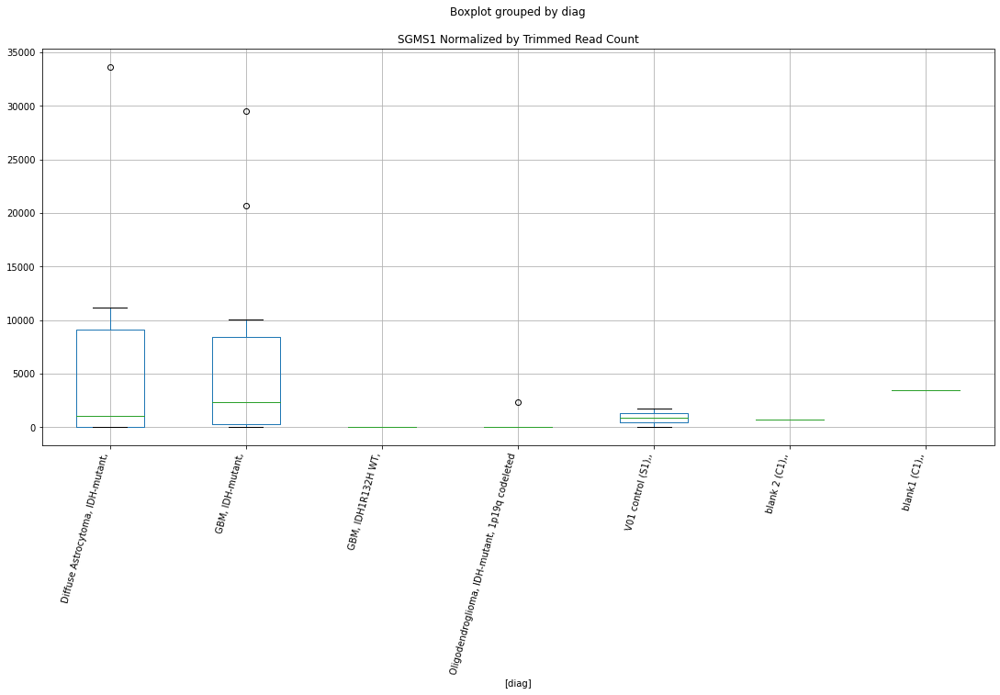

 p : 0.044642044932489876  ( t : 2.1584788933359933 ) :  D-plex  :  cutadapt2  :  POU6F2
Control and blanks
76     0.0
340    0.0
Name: POU6F2, dtype: float64
208    1587.24
Name: POU6F2, dtype: float64
472    0.0
Name: POU6F2, dtype: float64


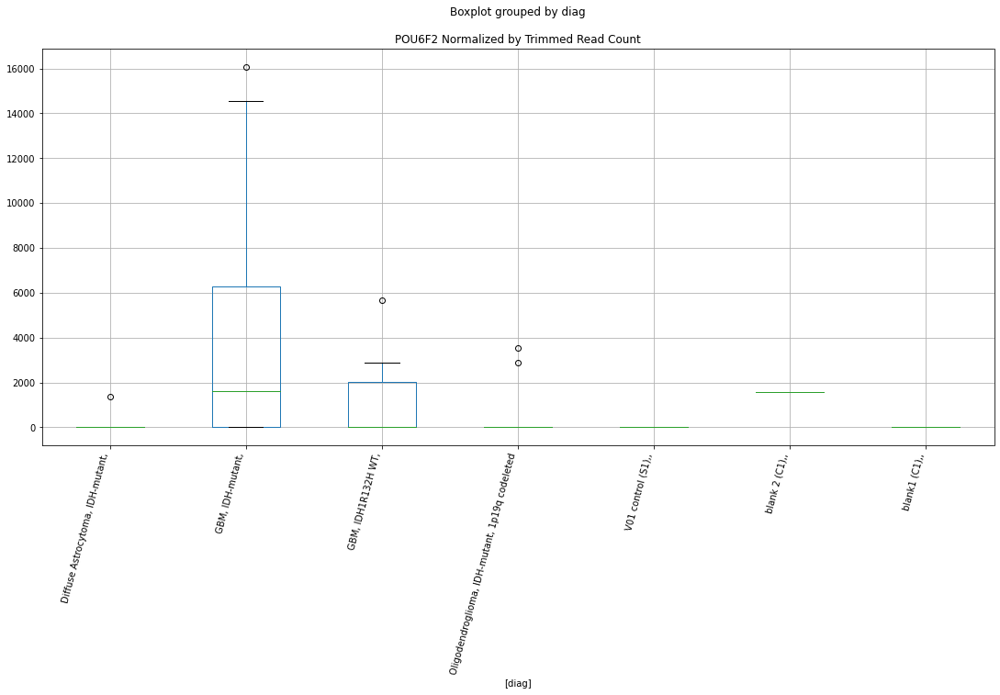

 p : 0.044647773697010625  ( t : 2.158414055561731 ) :  Lexogen  :  bbduk2  :  PLXNA4
Control and blanks
79     0.0
343    0.0
Name: PLXNA4, dtype: float64
211    0.0
Name: PLXNA4, dtype: float64
475    0.0
Name: PLXNA4, dtype: float64


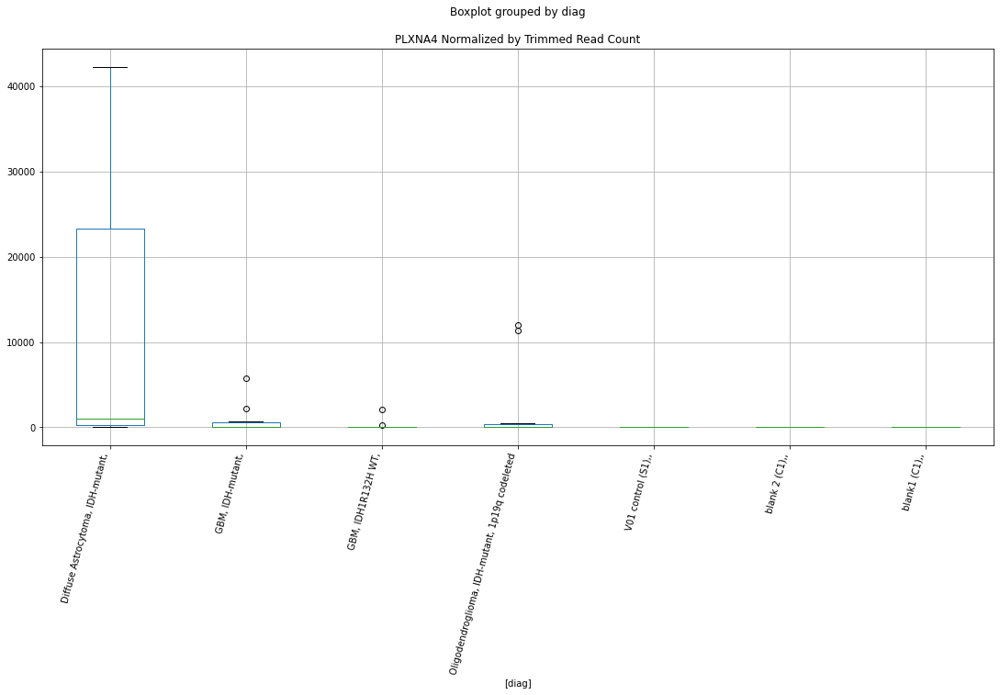

 p : 0.04466200228123345  ( t : 2.158253050304824 ) :  D-plex  :  cutadapt2  :  RNF19A
Control and blanks
76         0.00
340    38752.21
Name: RNF19A, dtype: float64
208    8641.65
Name: RNF19A, dtype: float64
472    0.0
Name: RNF19A, dtype: float64


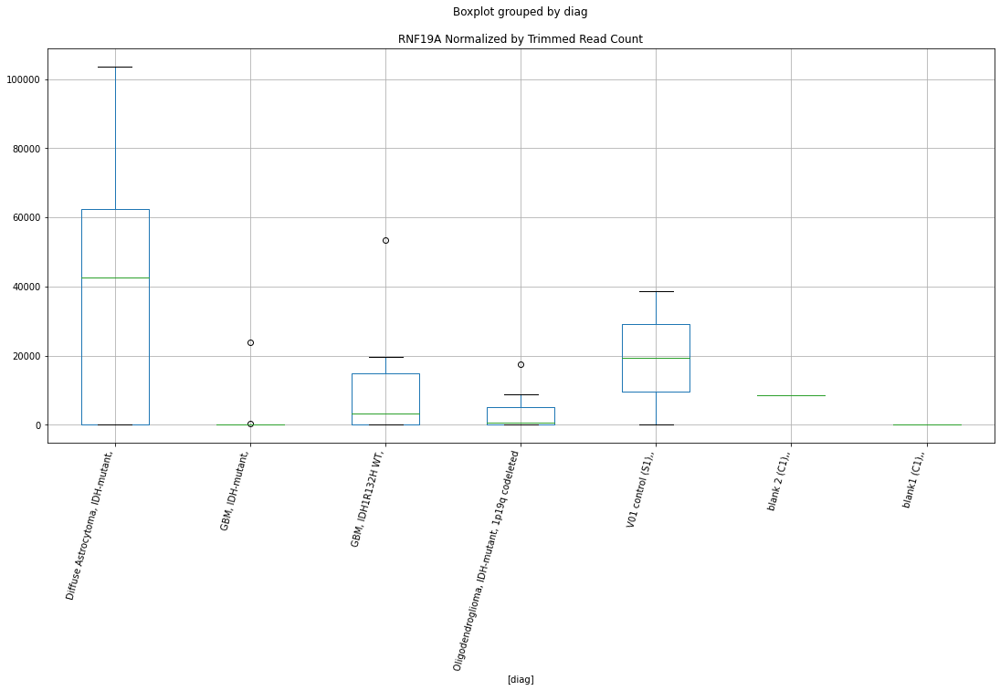

 p : 0.04477133958409792  ( t : 2.157017393666711 ) :  Lexogen  :  bbduk2  :  PLXNB3
Control and blanks
79     0.0
343    0.0
Name: PLXNB3, dtype: float64
211    0.0
Name: PLXNB3, dtype: float64
475    0.0
Name: PLXNB3, dtype: float64


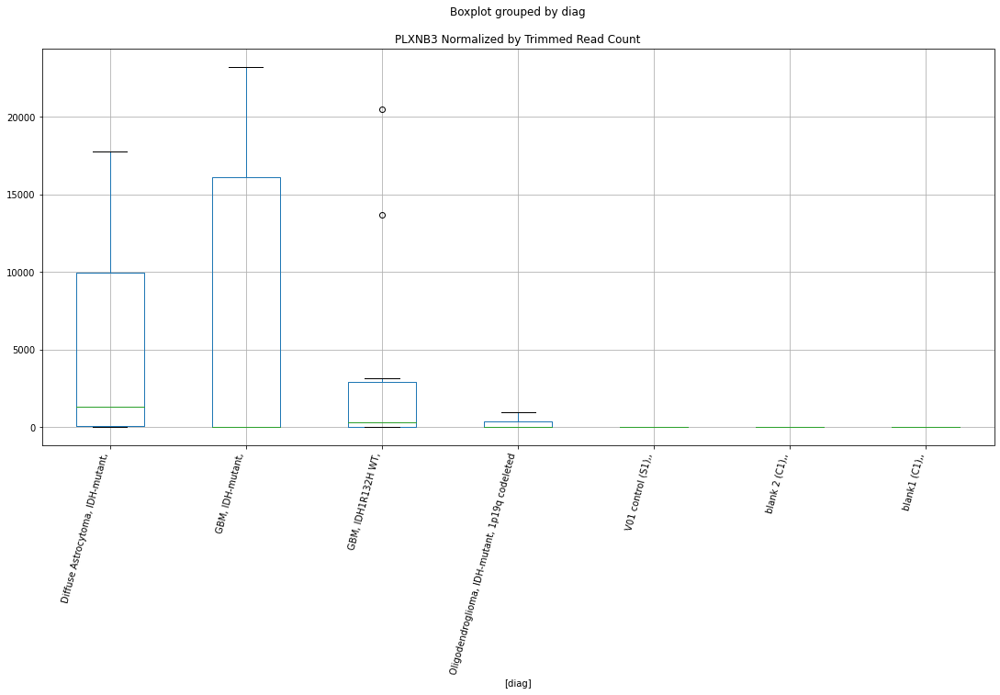

 p : 0.04479407940589467  ( t : 2.156760750165235 ) :  D-plex  :  bbduk2  :  RNASEH1
Control and blanks
73     0.0
337    0.0
Name: RNASEH1, dtype: float64
205    3402.73
Name: RNASEH1, dtype: float64
469    11830.55
Name: RNASEH1, dtype: float64


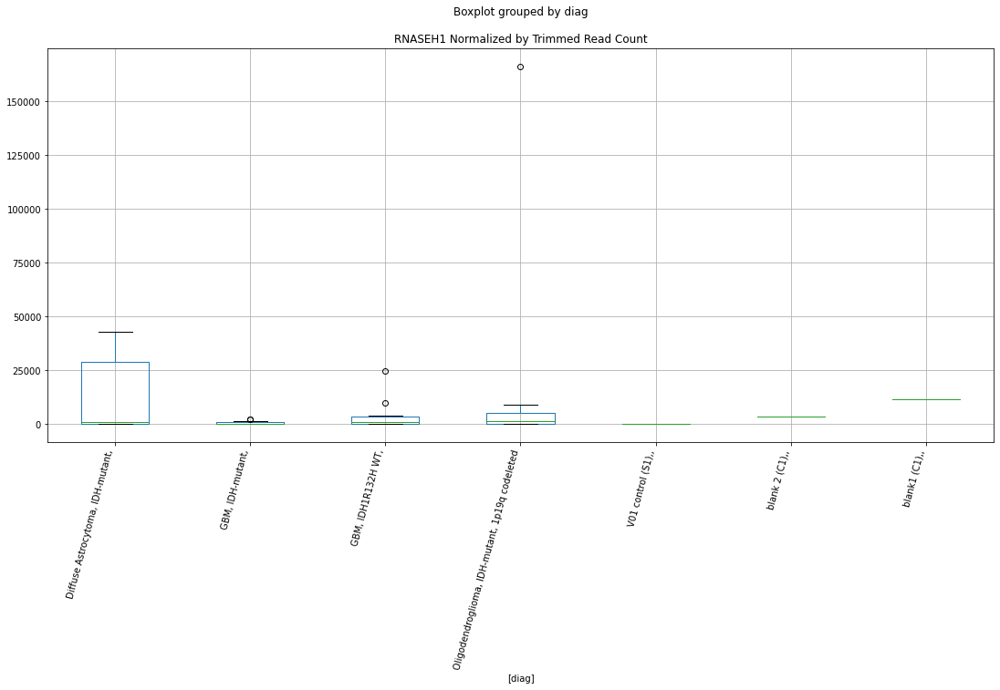

 p : 0.04482780482067071  ( t : 2.1563803416270373 ) :  D-plex  :  cutadapt2  :  PSMD12
Control and blanks
76     0.0
340    0.0
Name: PSMD12, dtype: float64
208    0.0
Name: PSMD12, dtype: float64
472    3467.74
Name: PSMD12, dtype: float64


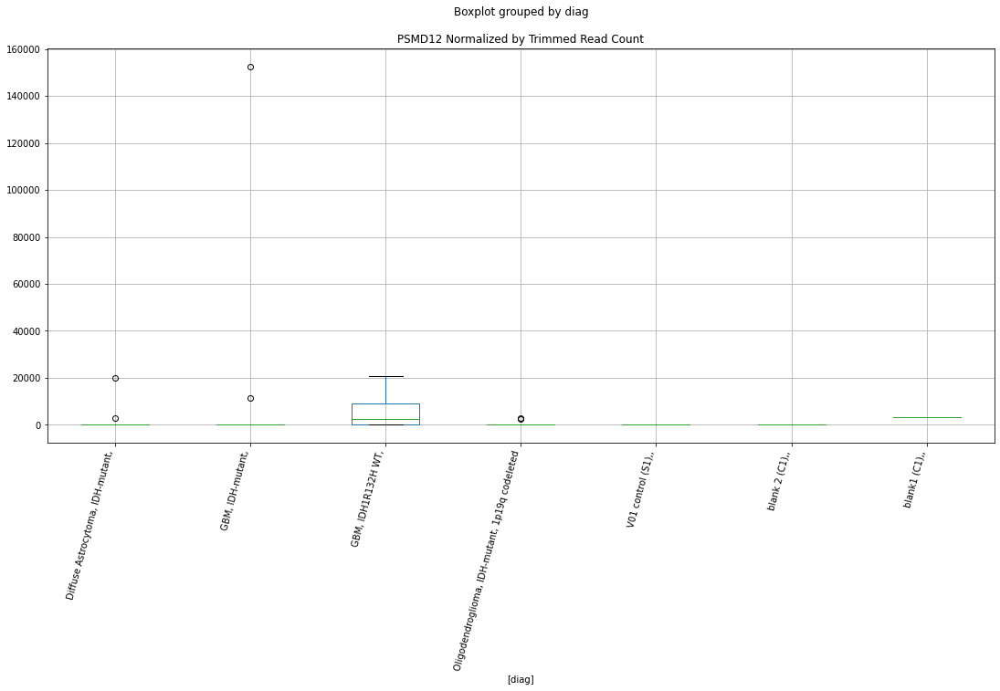

 p : 0.04485869100521633  ( t : 2.1560321879040396 ) :  Lexogen  :  cutadapt2  :  SCARNA17
Control and blanks
82      2840.10
346    14309.55
Name: SCARNA17, dtype: float64
214    14375.0
Name: SCARNA17, dtype: float64
478    949.84
Name: SCARNA17, dtype: float64


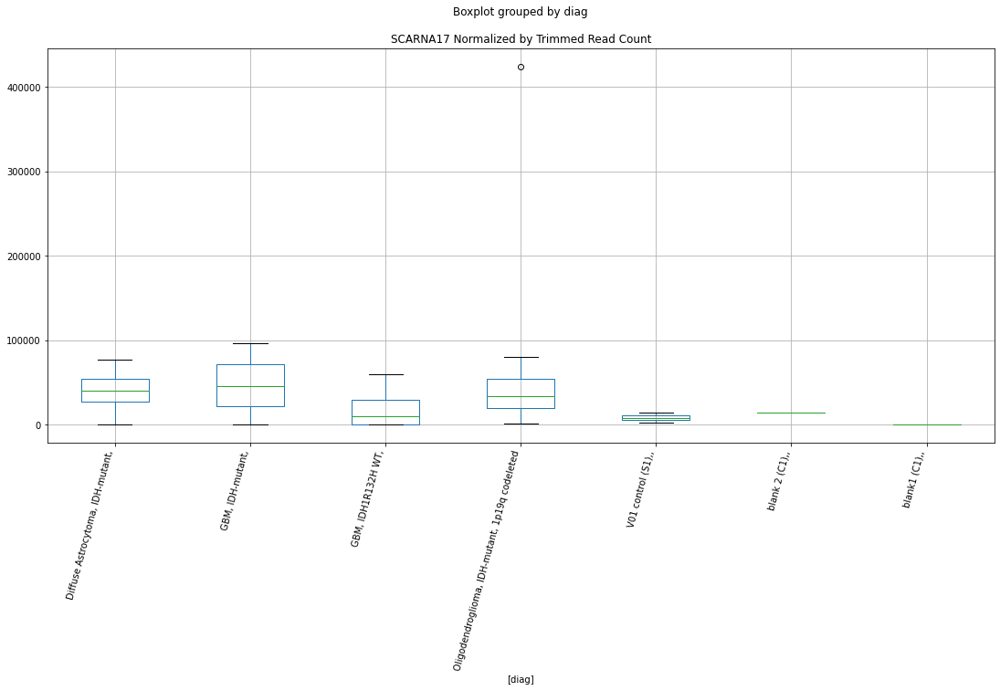

 p : 0.04486218894605709  ( t : 2.1559927724055026 ) :  Lexogen  :  cutadapt2  :  SLC8A3
Control and blanks
82        0.00
346    2104.35
Name: SLC8A3, dtype: float64
214    2712.26
Name: SLC8A3, dtype: float64
478    7123.81
Name: SLC8A3, dtype: float64


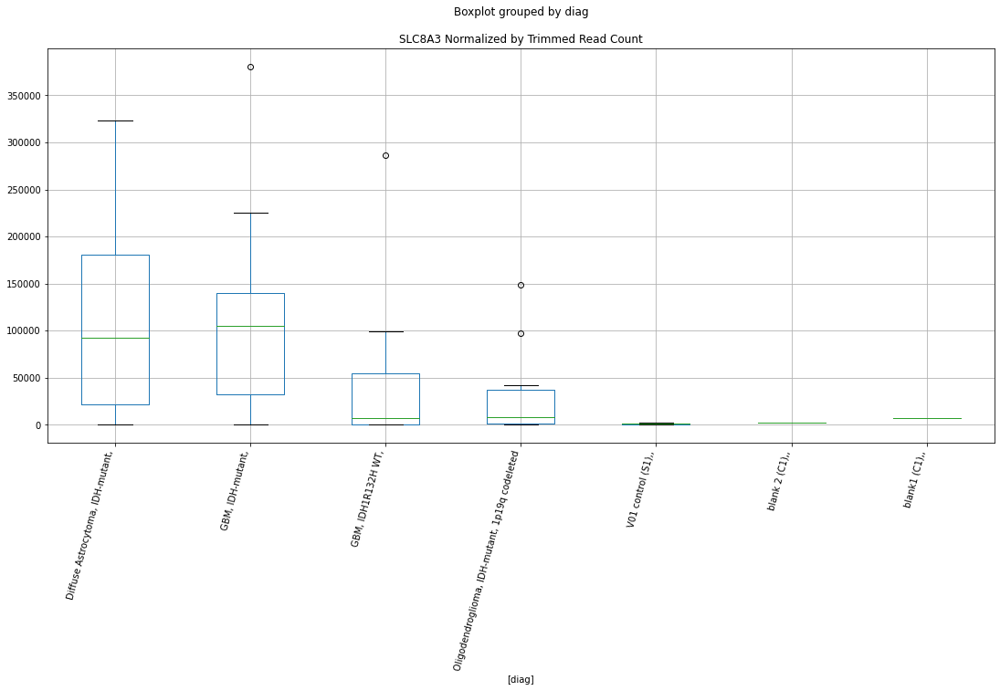

 p : 0.044863333721162066  ( t : 2.1559798734604243 ) :  D-plex  :  bbduk2  :  RNA28SN3
Control and blanks
73     2.22e+06
337    1.43e+06
Name: RNA28SN3, dtype: float64
205    1.55e+06
Name: RNA28SN3, dtype: float64
469    1.46e+06
Name: RNA28SN3, dtype: float64


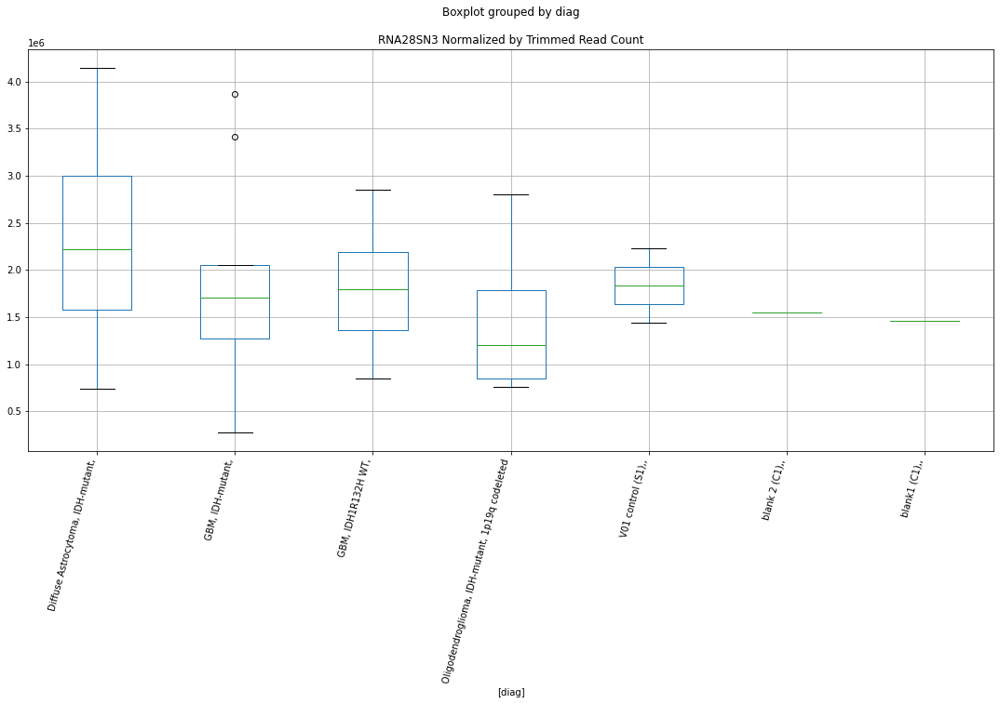

 p : 0.04487421325625873  ( t : 2.1558573014955744 ) :  D-plex  :  cutadapt2  :  PPP4R3B
Control and blanks
76     0.0
340    0.0
Name: PPP4R3B, dtype: float64
208    3703.56
Name: PPP4R3B, dtype: float64
472    20806.41
Name: PPP4R3B, dtype: float64


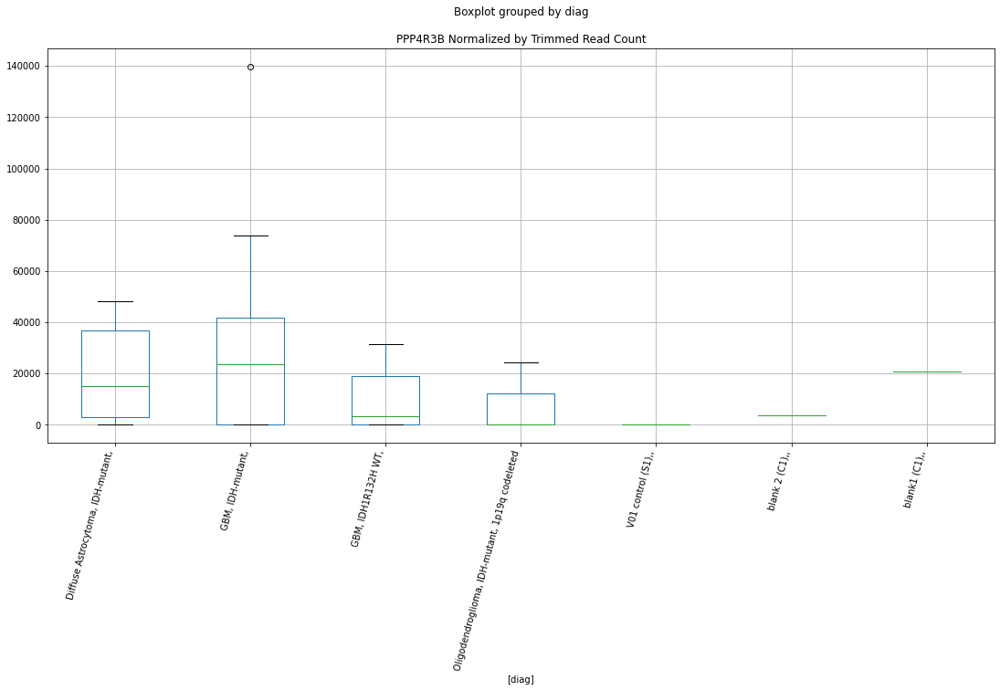

 p : 0.04490102593916873  ( t : 2.1555553380658456 ) :  D-plex  :  bbduk2  :  SEPTIN2
Control and blanks
73     0.0
337    0.0
Name: SEPTIN2, dtype: float64
205    16118.19
Name: SEPTIN2, dtype: float64
469    0.0
Name: SEPTIN2, dtype: float64


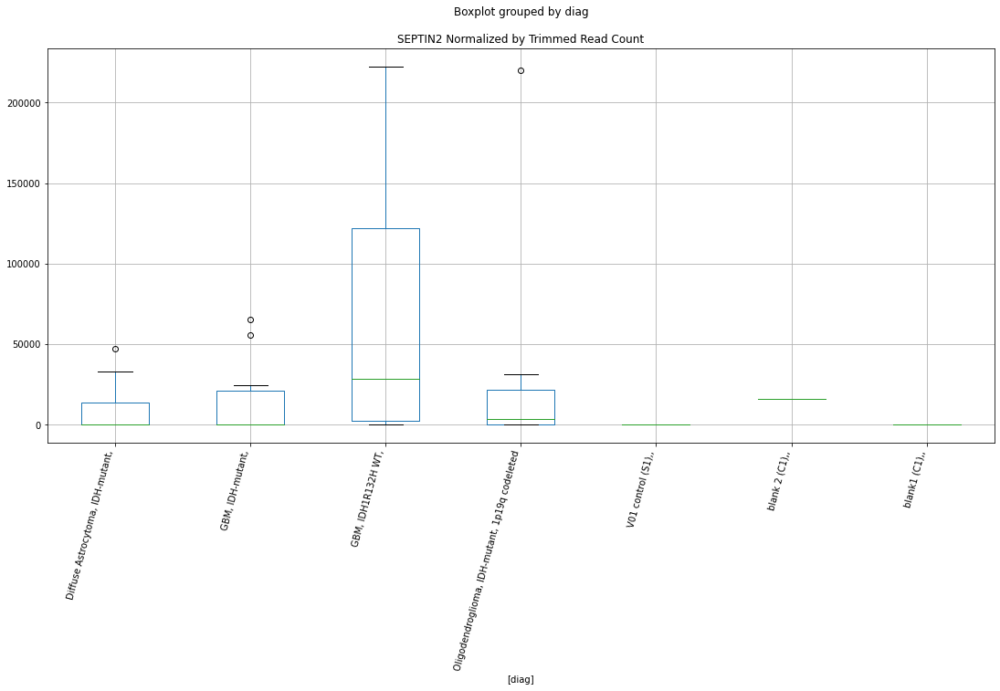

 p : 0.04491305331263047  ( t : 2.155419939794126 ) :  D-plex  :  cutadapt2  :  SLC25A26
Control and blanks
76     0.0
340    0.0
Name: SLC25A26, dtype: float64
208    881.8
Name: SLC25A26, dtype: float64
472    0.0
Name: SLC25A26, dtype: float64


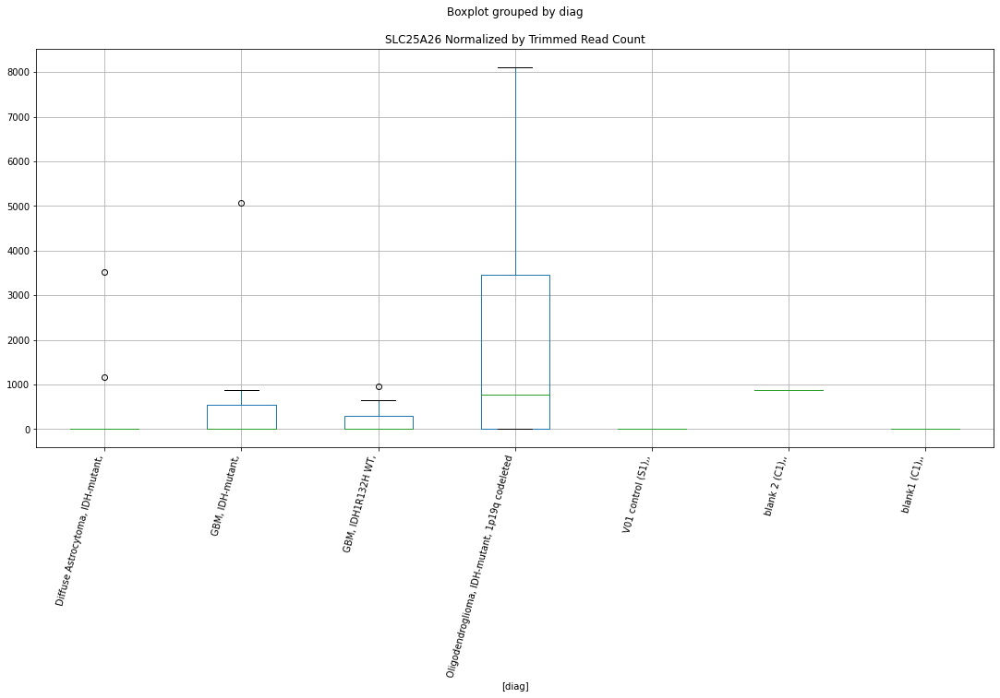

 p : 0.04508396781606043  ( t : 2.1534994419520843 ) :  Lexogen  :  cutadapt2  :  POLH
Control and blanks
82     0.0
346    0.0
Name: POLH, dtype: float64
214    0.0
Name: POLH, dtype: float64
478    474.92
Name: POLH, dtype: float64


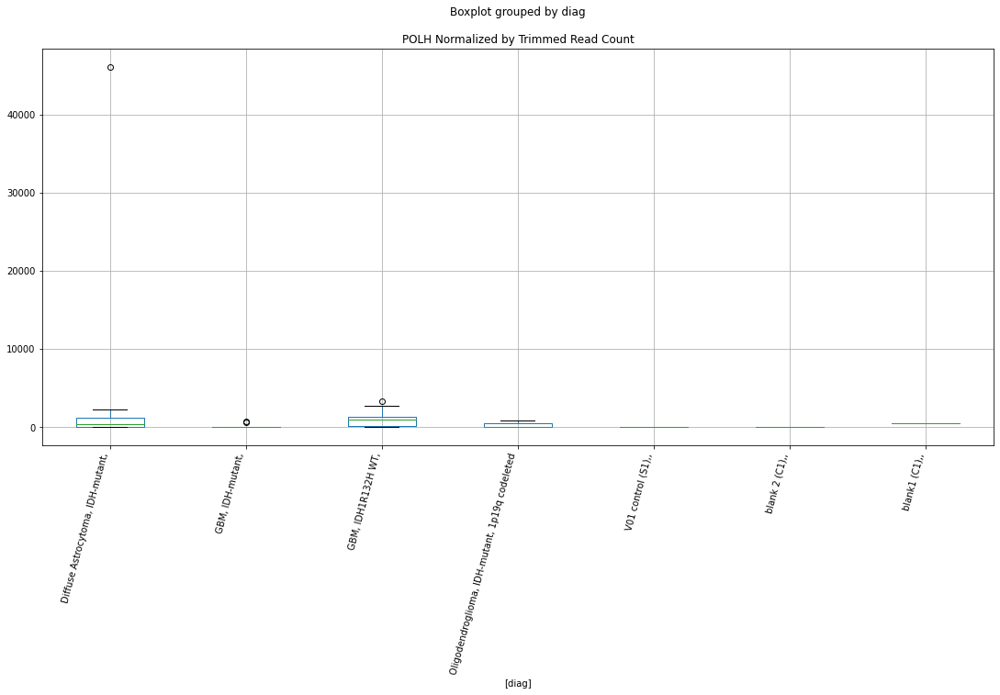

 p : 0.04509967391439168  ( t : 2.153323292863353 ) :  D-plex  :  cutadapt2  :  SIGLEC1
Control and blanks
76     7576.14
340       0.00
Name: SIGLEC1, dtype: float64
208    9876.17
Name: SIGLEC1, dtype: float64
472    11559.12
Name: SIGLEC1, dtype: float64


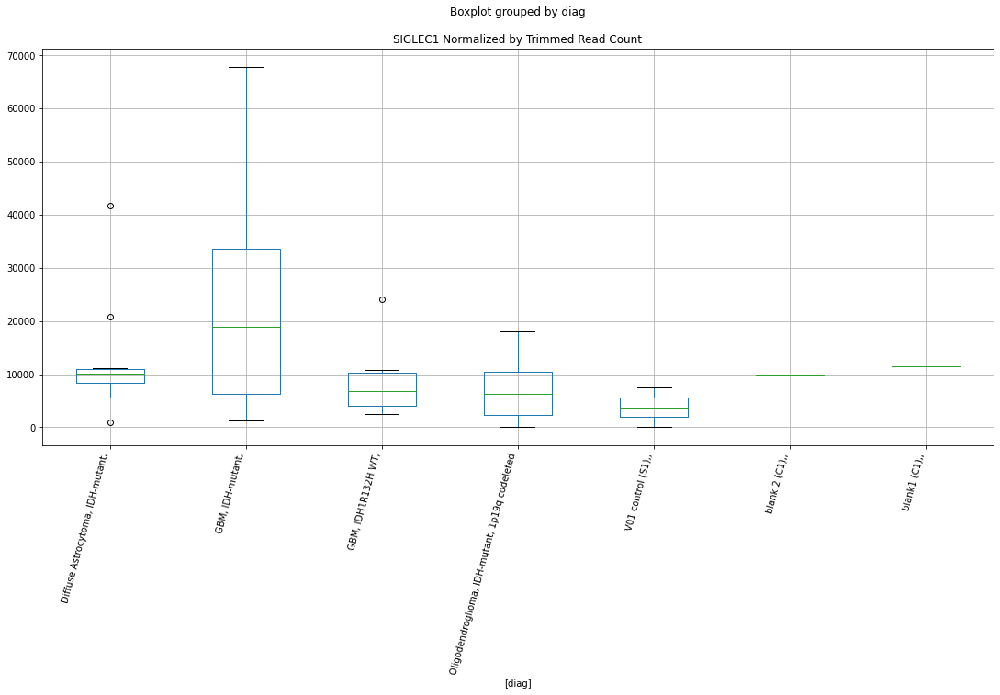

 p : 0.0452537725472181  ( t : 2.1515979931432656 ) :  D-plex  :  bbduk2  :  PPP4R3B
Control and blanks
73     0.0
337    0.0
Name: PPP4R3B, dtype: float64
205    3760.91
Name: PPP4R3B, dtype: float64
469    21294.98
Name: PPP4R3B, dtype: float64


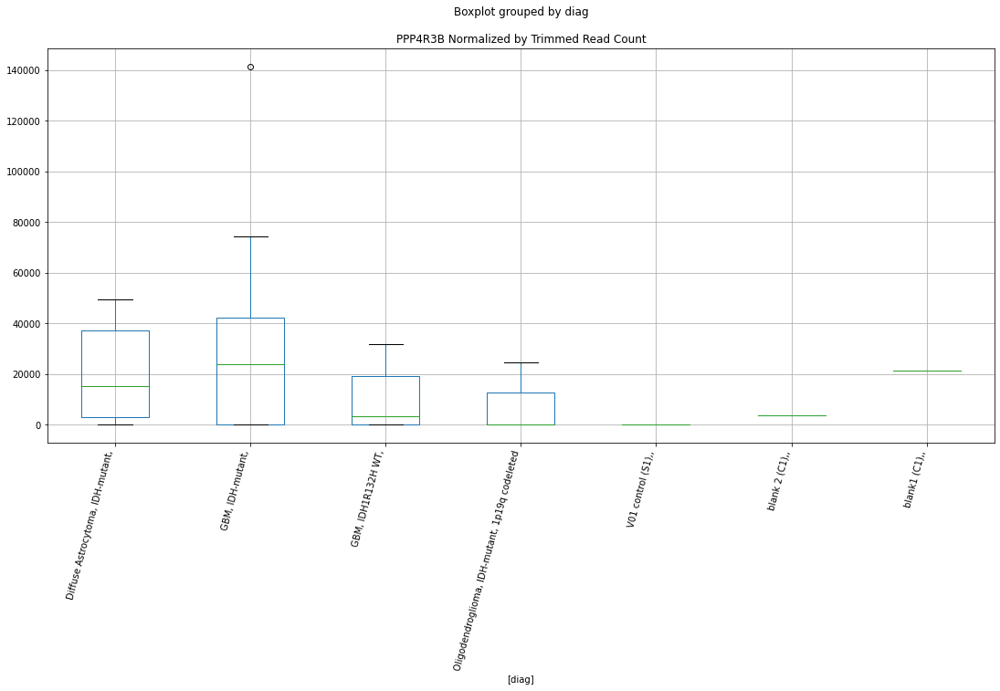

 p : 0.04528382800309052  ( t : 2.1512621158899012 ) :  Lexogen  :  cutadapt2  :  RGS9BP
Control and blanks
82       0.00
346    210.43
Name: RGS9BP, dtype: float64
214    0.0
Name: RGS9BP, dtype: float64
478    0.0
Name: RGS9BP, dtype: float64


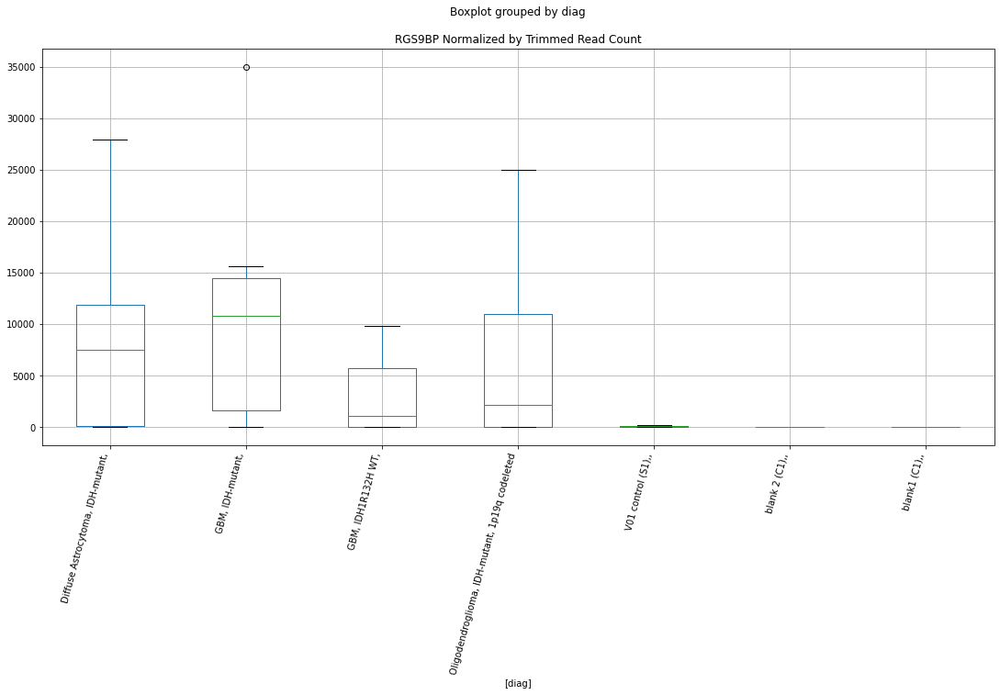

 p : 0.04532214332464761  ( t : 2.150834227833651 ) :  D-plex  :  cutadapt2  :  PSMB7
Control and blanks
76       0.00
340    880.73
Name: PSMB7, dtype: float64
208    176.36
Name: PSMB7, dtype: float64
472    577.96
Name: PSMB7, dtype: float64


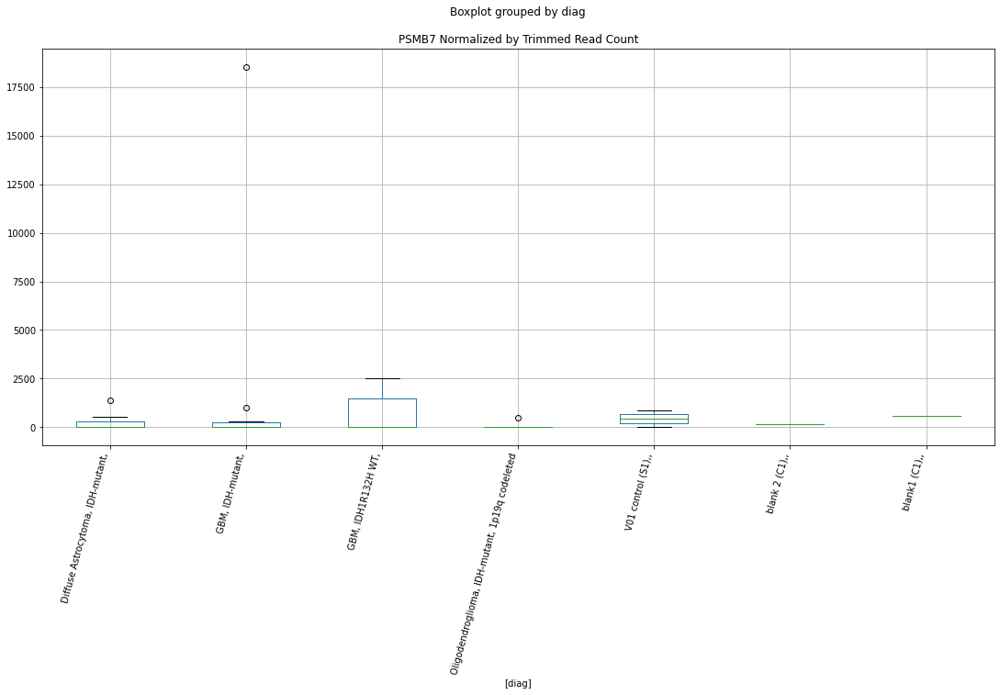

 p : 0.04540832797510705  ( t : 2.1498729636208287 ) :  D-plex  :  cutadapt2  :  PPFIA4
Control and blanks
76     0.0
340    0.0
Name: PPFIA4, dtype: float64
208    12168.86
Name: PPFIA4, dtype: float64
472    7513.43
Name: PPFIA4, dtype: float64


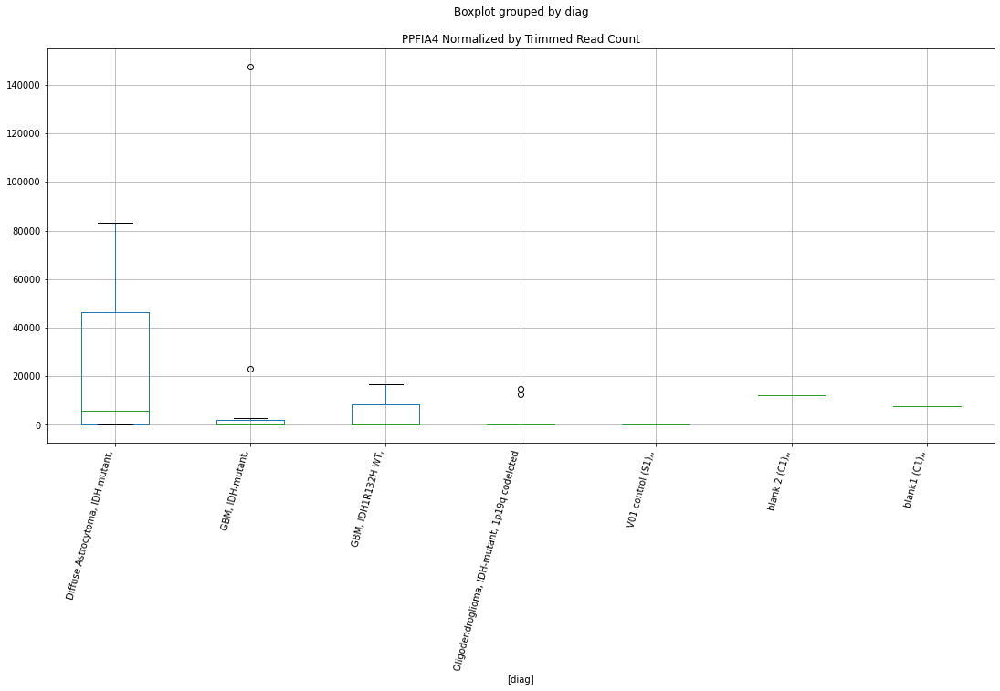

 p : 0.04542131706848187  ( t : 2.149728233789764 ) :  Lexogen  :  bbduk2  :  RENBP
Control and blanks
79     0.0
343    0.0
Name: RENBP, dtype: float64
211    0.0
Name: RENBP, dtype: float64
475    0.0
Name: RENBP, dtype: float64


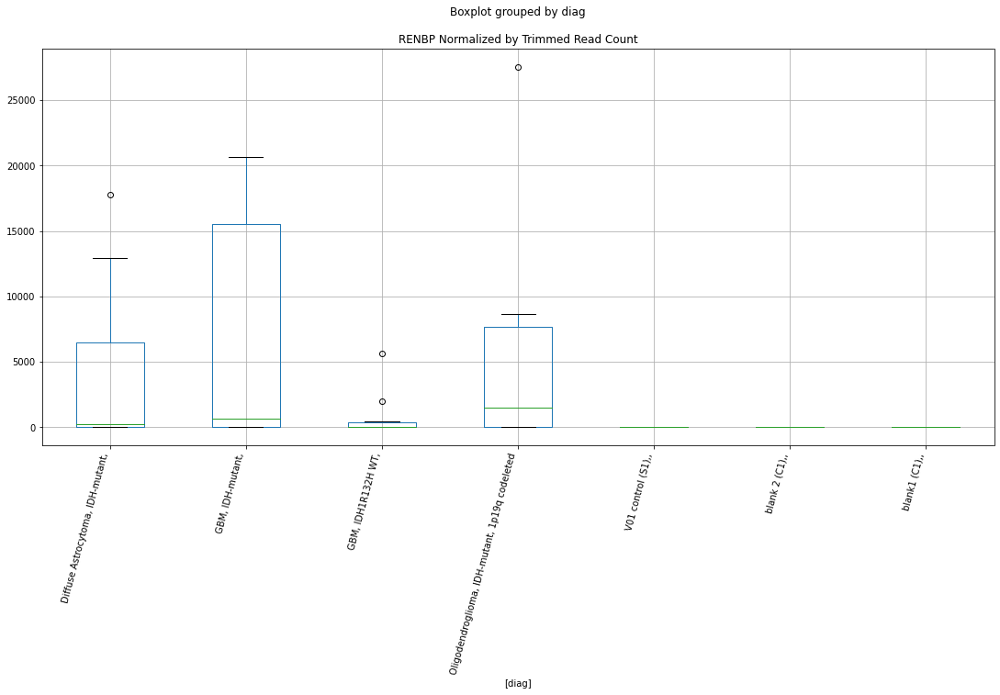

 p : 0.045548352743387664  ( t : 2.14831473993838 ) :  Lexogen  :  cutadapt2  :  SOGA1
Control and blanks
82     0.0
346    0.0
Name: SOGA1, dtype: float64
214    0.0
Name: SOGA1, dtype: float64
478    0.0
Name: SOGA1, dtype: float64


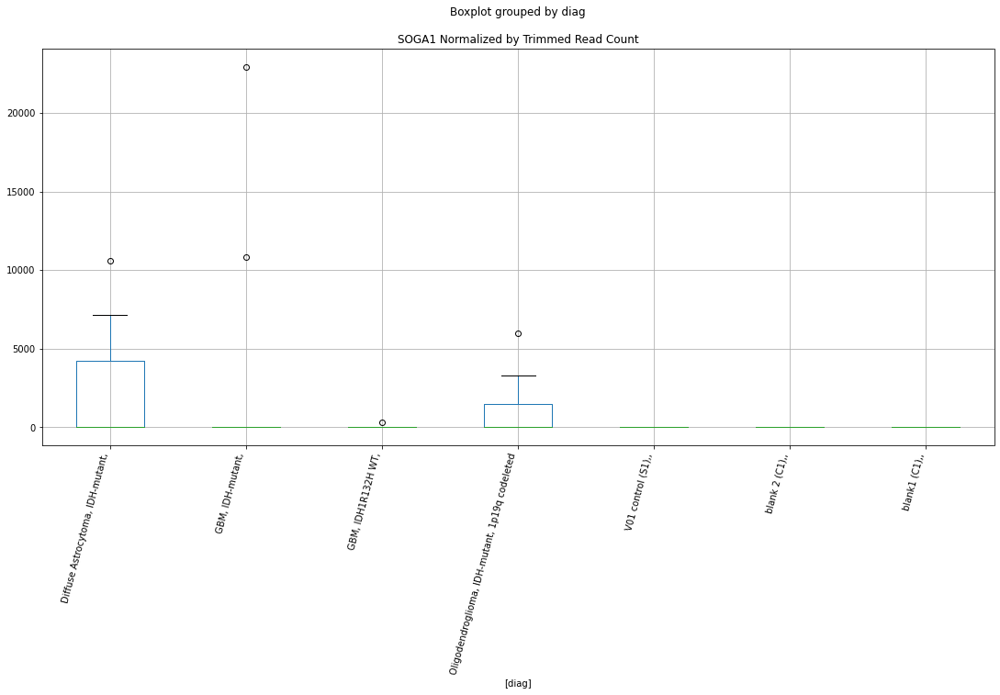

 p : 0.045616093147293264  ( t : 2.147562481229901 ) :  Lexogen  :  bbduk2  :  SOGA1
Control and blanks
79     0.0
343    0.0
Name: SOGA1, dtype: float64
211    0.0
Name: SOGA1, dtype: float64
475    0.0
Name: SOGA1, dtype: float64


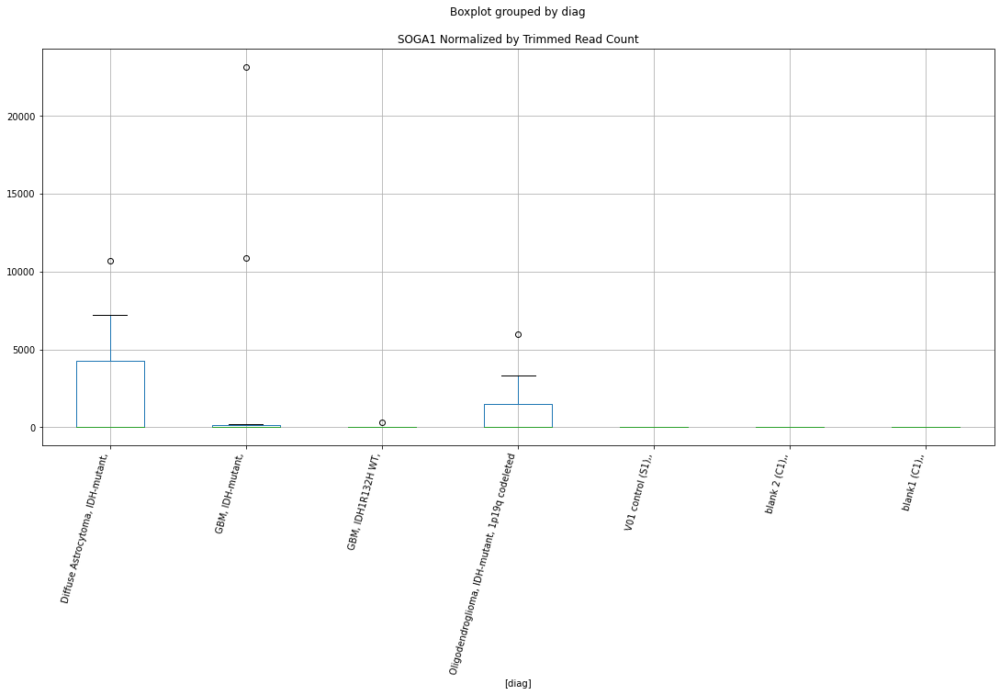

 p : 0.045618996442586345  ( t : 2.1475302628816313 ) :  D-plex  :  bbduk2  :  PTPRK
Control and blanks
73         0.00
337    17803.15
Name: PTPRK, dtype: float64
205    23102.73
Name: PTPRK, dtype: float64
469    75123.97
Name: PTPRK, dtype: float64


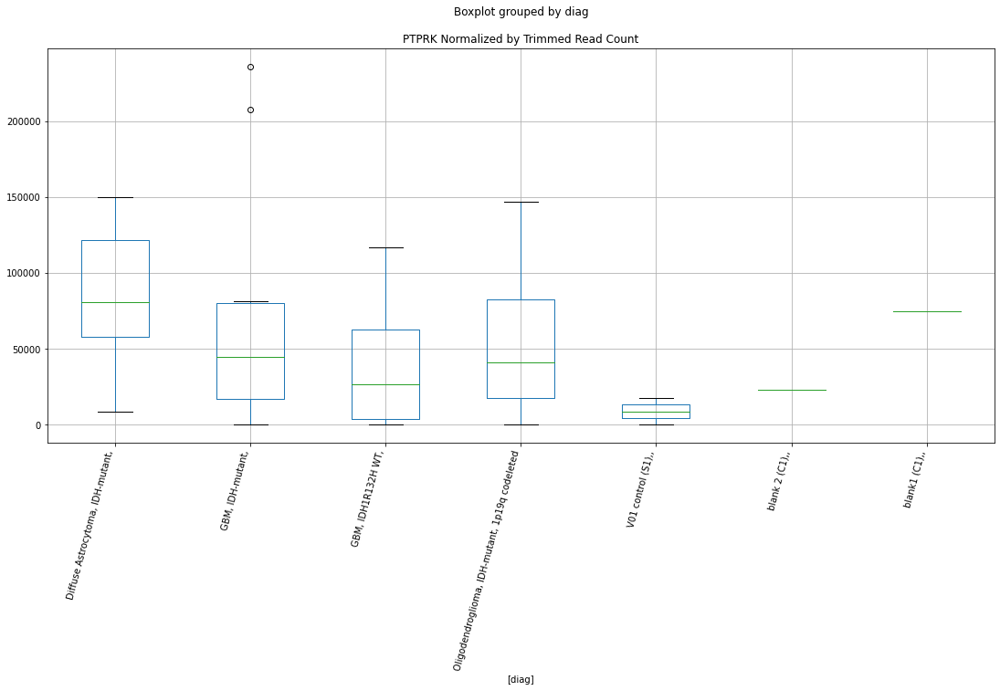

 p : 0.04573567994815361  ( t : 2.1462369544900954 ) :  D-plex  :  cutadapt2  :  SCTR
Control and blanks
76       0.00
340    880.73
Name: SCTR, dtype: float64
208    9876.17
Name: SCTR, dtype: float64
472    11559.12
Name: SCTR, dtype: float64


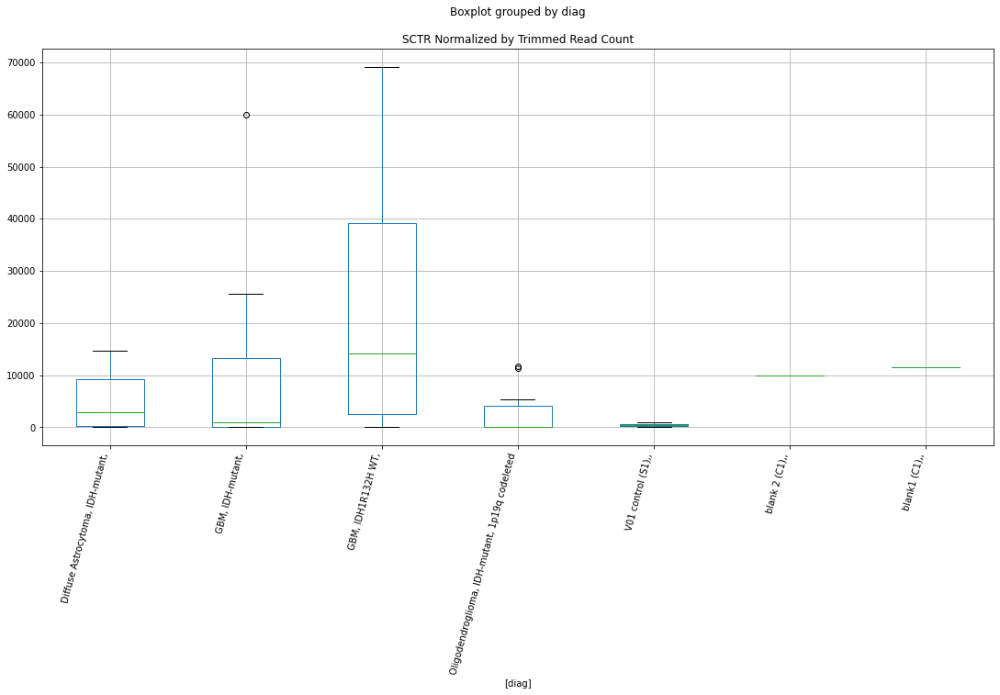

 p : 0.0457406853372272  ( t : 2.1461815426961515 ) :  Lexogen  :  bbduk2  :  SLC46A1
Control and blanks
79         0.00
343    63694.29
Name: SLC46A1, dtype: float64
211    0.0
Name: SLC46A1, dtype: float64
475    0.0
Name: SLC46A1, dtype: float64


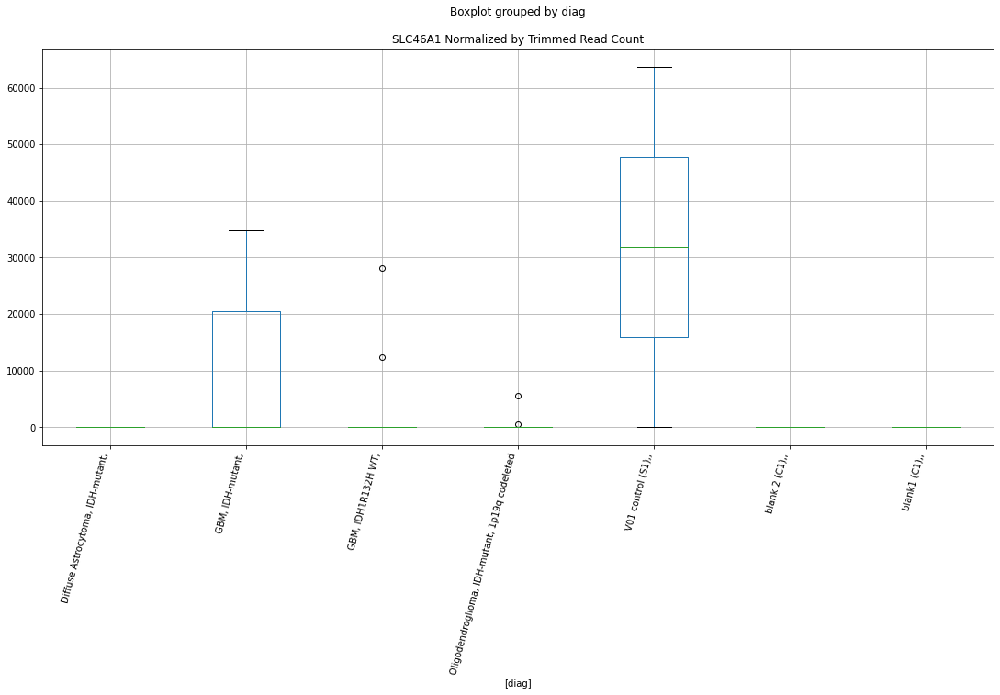

 p : 0.045786395598425414  ( t : 2.1456757666563067 ) :  Lexogen  :  bbduk2  :  SMG6
Control and blanks
79     0.0
343    0.0
Name: SMG6, dtype: float64
211    0.0
Name: SMG6, dtype: float64
475    0.0
Name: SMG6, dtype: float64


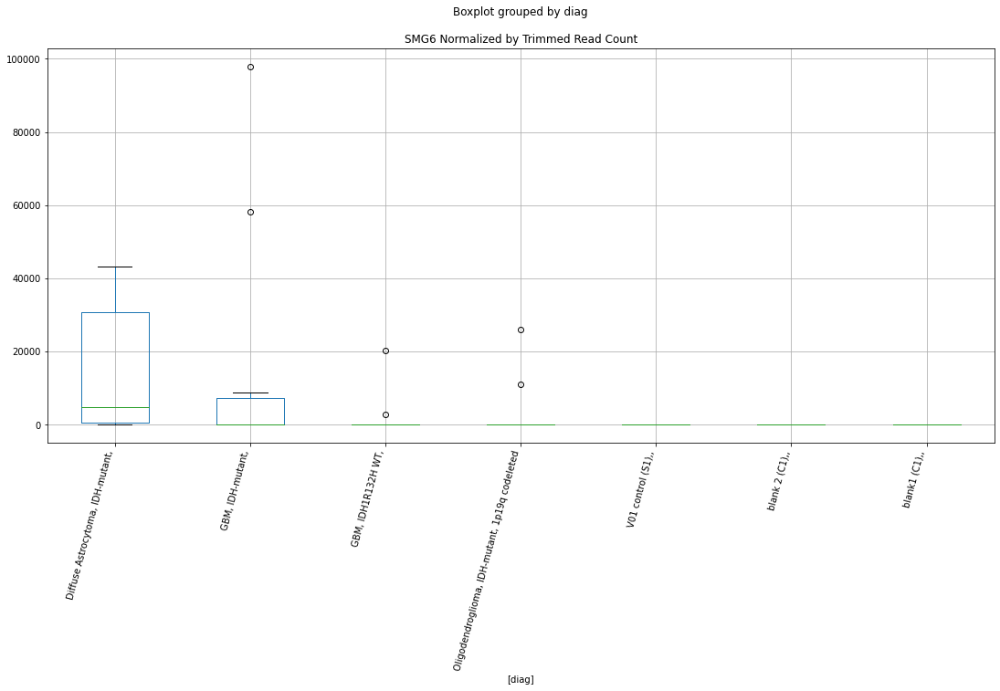

 p : 0.0457961866772472  ( t : 2.145567490055592 ) :  D-plex  :  cutadapt2  :  PIP4K2C
Control and blanks
76     0.0
340    0.0
Name: PIP4K2C, dtype: float64
208    0.0
Name: PIP4K2C, dtype: float64
472    3467.74
Name: PIP4K2C, dtype: float64


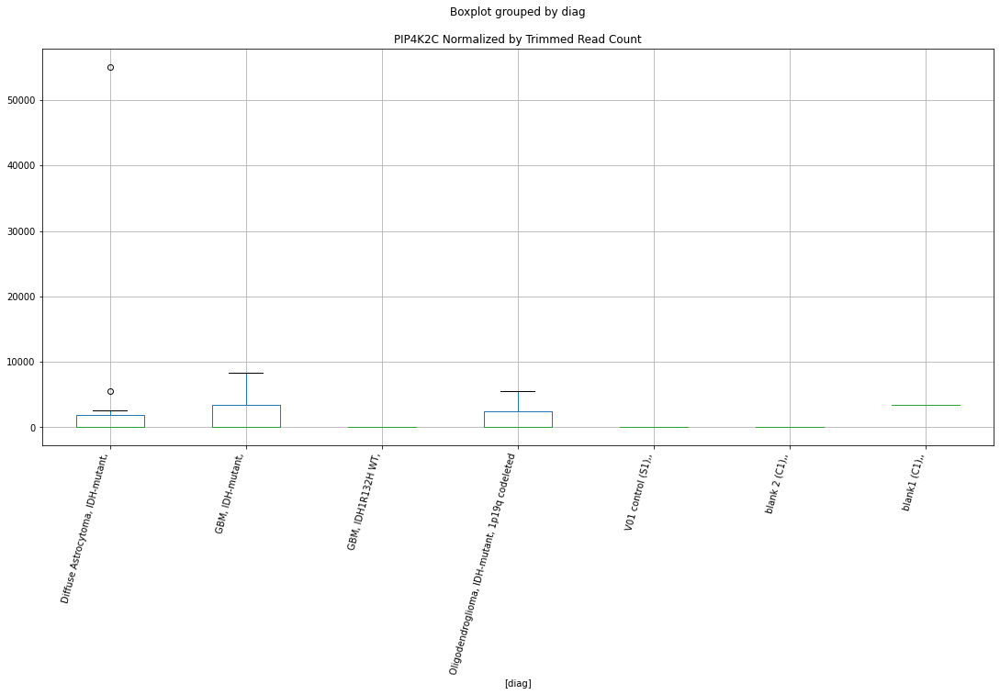

 p : 0.04581351274427444  ( t : 2.1453759380806514 ) :  Lexogen  :  bbduk2  :  PJA1
Control and blanks
79     0.0
343    0.0
Name: PJA1, dtype: float64
211    1366.53
Name: PJA1, dtype: float64
475    0.0
Name: PJA1, dtype: float64


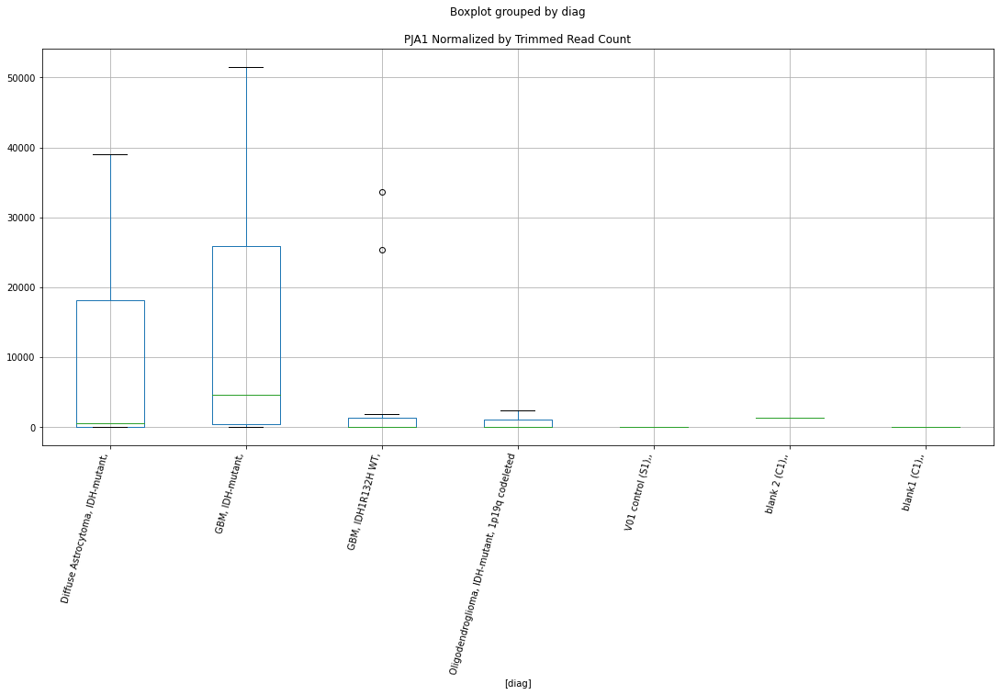

 p : 0.04584119356427759  ( t : 2.145070044199514 ) :  D-plex  :  cutadapt2  :  PCYT1A
Control and blanks
76      3030.46
340    31706.36
Name: PCYT1A, dtype: float64
208    1763.6
Name: PCYT1A, dtype: float64
472    1733.87
Name: PCYT1A, dtype: float64


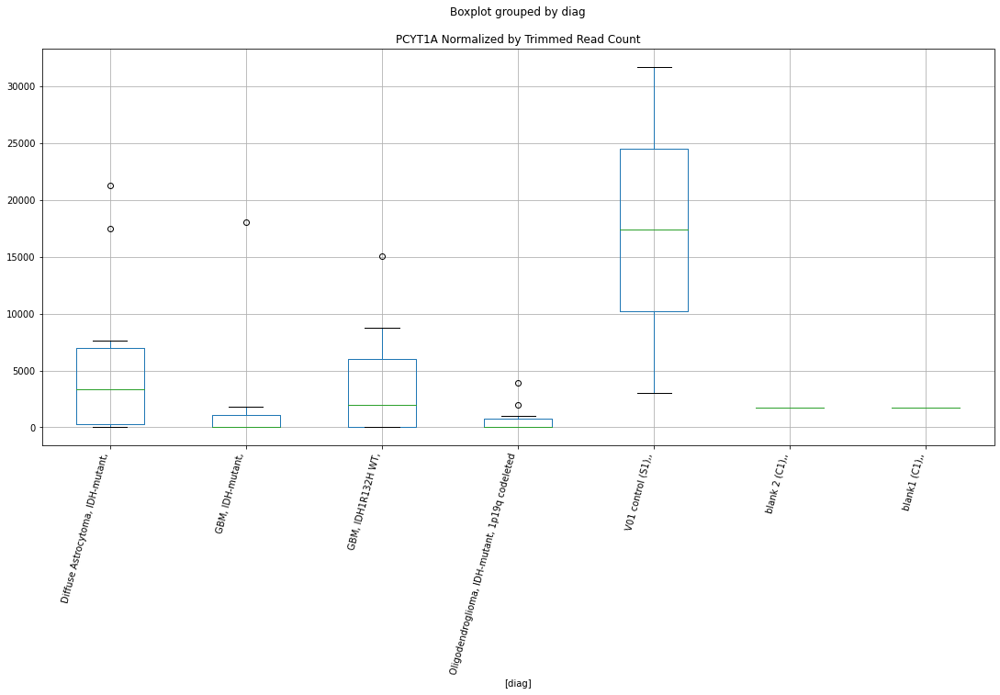

 p : 0.04586449760249249  ( t : 2.144812647809137 ) :  D-plex  :  cutadapt2  :  PTN
Control and blanks
76     0.0
340    0.0
Name: PTN, dtype: float64
208    0.0
Name: PTN, dtype: float64
472    0.0
Name: PTN, dtype: float64


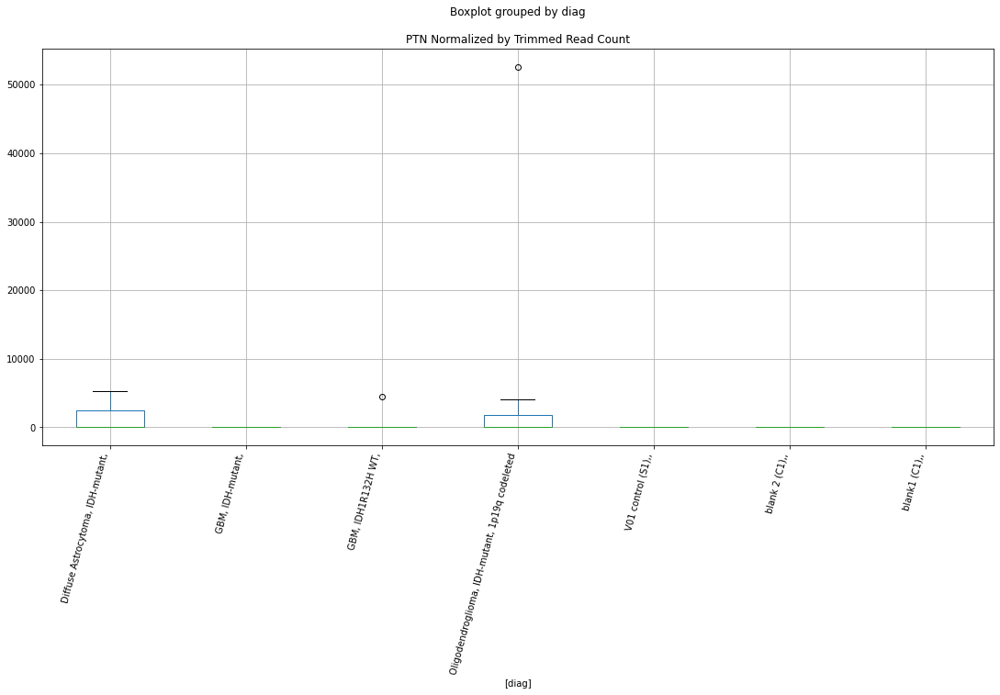

 p : 0.04587060967173694  ( t : 2.1447451589125675 ) :  Lexogen  :  cutadapt2  :  PMEPA1
Control and blanks
82     0.0
346    0.0
Name: PMEPA1, dtype: float64
214    0.0
Name: PMEPA1, dtype: float64
478    0.0
Name: PMEPA1, dtype: float64


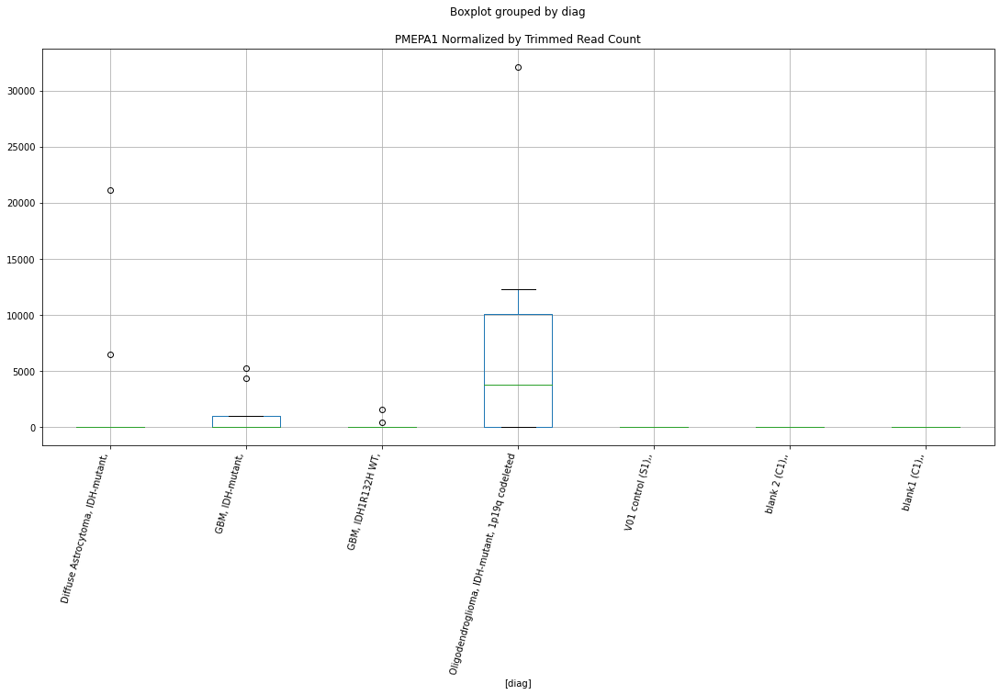

 p : 0.04593596962902633  ( t : 2.144023973369969 ) :  Lexogen  :  bbduk2  :  PMEPA1
Control and blanks
79     0.0
343    0.0
Name: PMEPA1, dtype: float64
211    1366.53
Name: PMEPA1, dtype: float64
475    0.0
Name: PMEPA1, dtype: float64


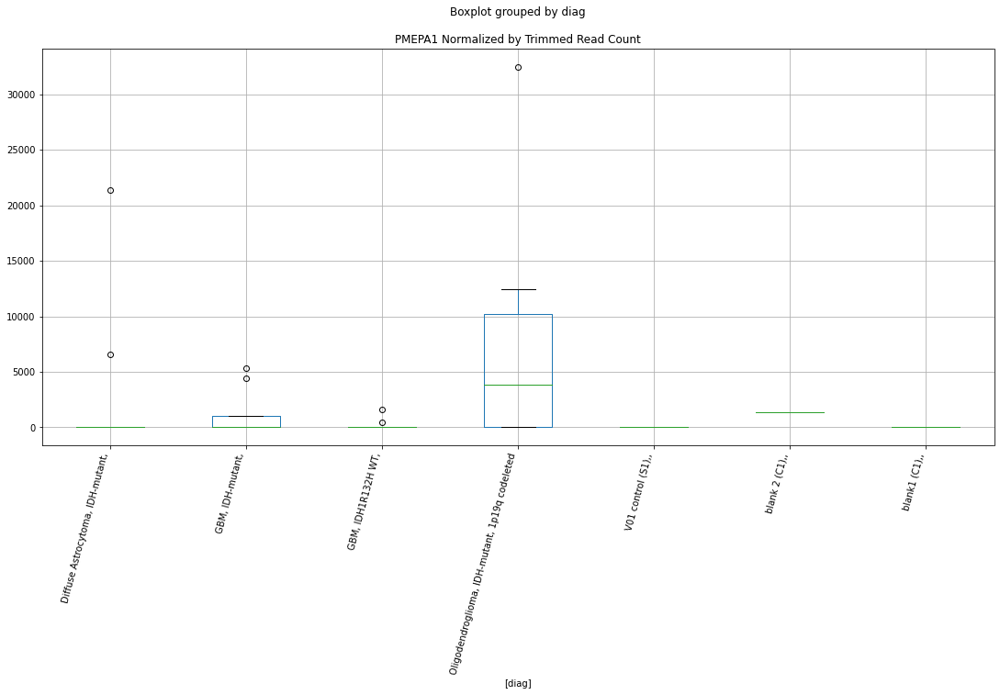

 p : 0.04593663562577636  ( t : 2.144016629547287 ) :  Lexogen  :  cutadapt2  :  PCDHGA10
Control and blanks
82         0.00
346    16834.76
Name: PCDHGA10, dtype: float64
214    0.0
Name: PCDHGA10, dtype: float64
478    8548.58
Name: PCDHGA10, dtype: float64


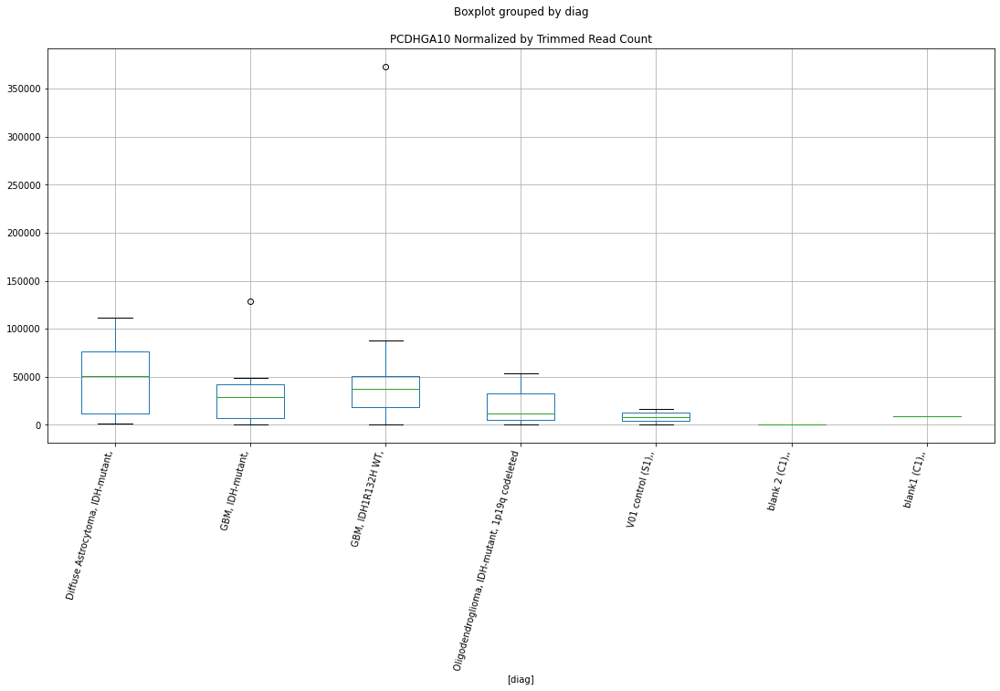

 p : 0.04613987784207316  ( t : 2.1417800442307566 ) :  D-plex  :  bbduk2  :  PKDREJ
Control and blanks
73     0.0
337    0.0
Name: PKDREJ, dtype: float64
205    179.09
Name: PKDREJ, dtype: float64
469    591.53
Name: PKDREJ, dtype: float64


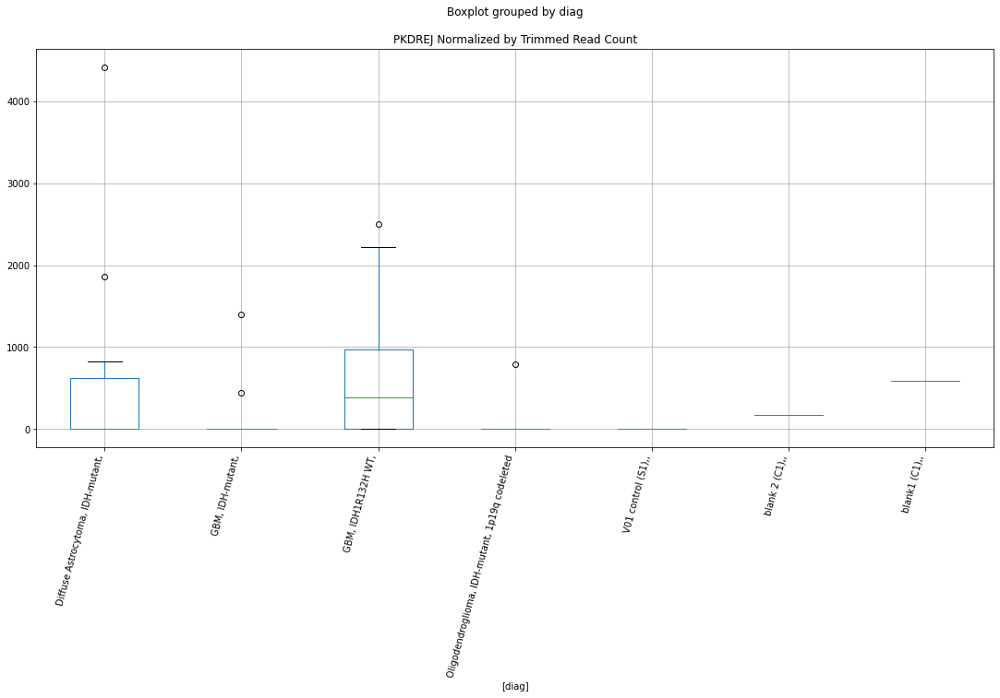

 p : 0.04626062719797451  ( t : 2.1404555097578855 ) :  D-plex  :  bbduk2  :  SEC22A
Control and blanks
73     0.0
337    0.0
Name: SEC22A, dtype: float64
205    358.18
Name: SEC22A, dtype: float64
469    0.0
Name: SEC22A, dtype: float64


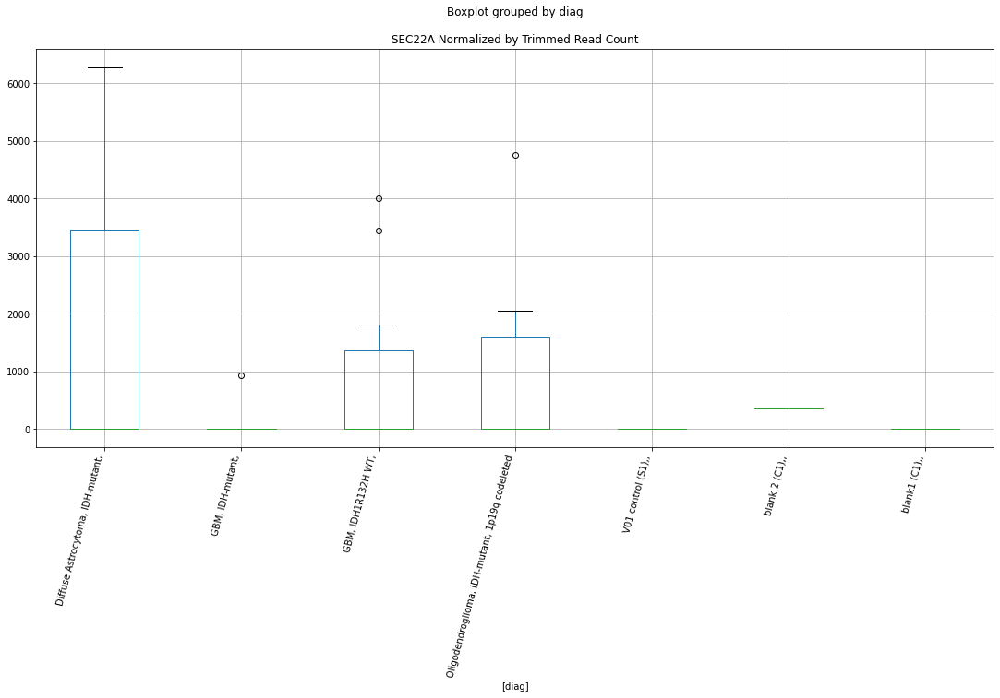

 p : 0.046322076973252836  ( t : 2.1397826607070547 ) :  D-plex  :  cutadapt2  :  SEC22A
Control and blanks
76     0.0
340    0.0
Name: SEC22A, dtype: float64
208    529.08
Name: SEC22A, dtype: float64
472    0.0
Name: SEC22A, dtype: float64


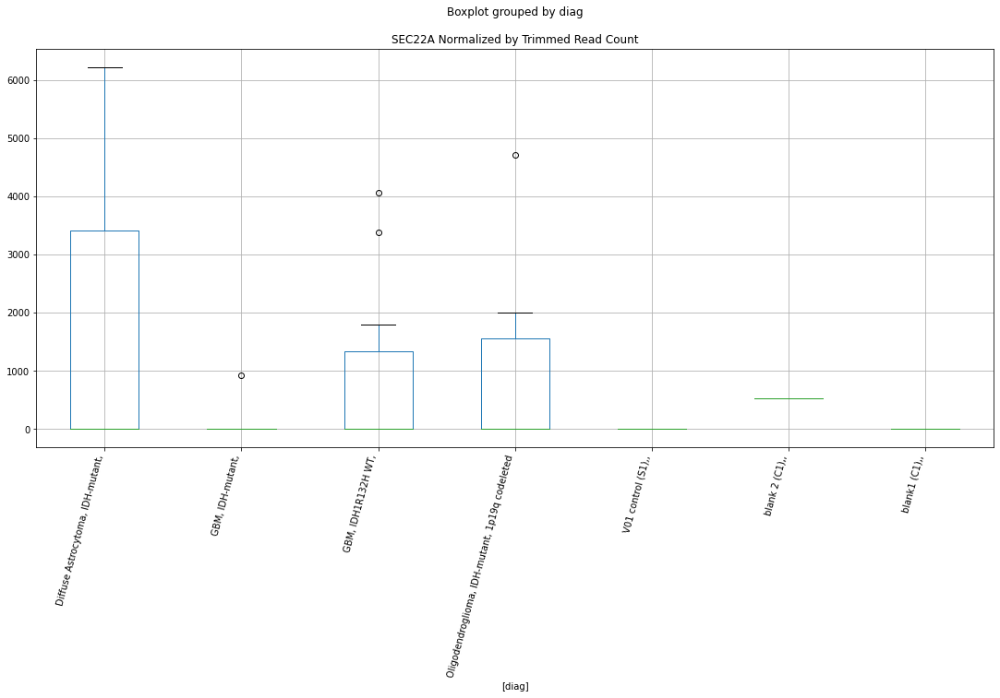

 p : 0.04634782263377257  ( t : 2.139500998760766 ) :  D-plex  :  cutadapt2  :  RIC1
Control and blanks
76     325774.11
340         0.00
Name: RIC1, dtype: float64
208    5290.81
Name: RIC1, dtype: float64
472    5779.56
Name: RIC1, dtype: float64


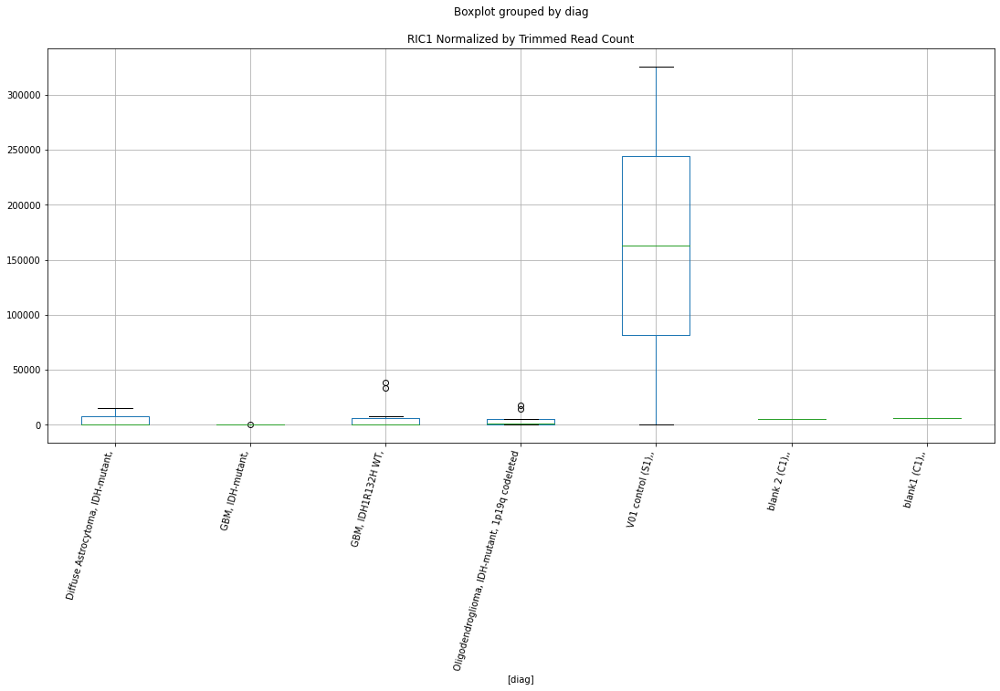

 p : 0.04635678273584327  ( t : 2.139403007202833 ) :  Lexogen  :  bbduk2  :  RPL6
Control and blanks
79     0.0
343    0.0
Name: RPL6, dtype: float64
211    0.0
Name: RPL6, dtype: float64
475    0.0
Name: RPL6, dtype: float64


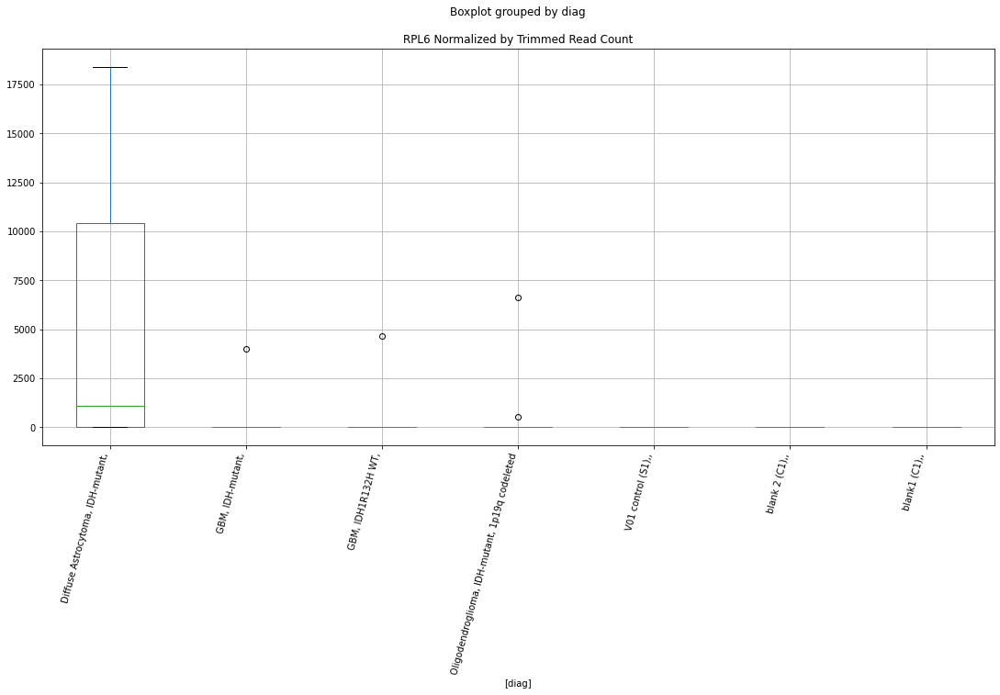

 p : 0.04637766802911101  ( t : 2.1391746636794196 ) :  D-plex  :  bbduk2  :  SGCD
Control and blanks
73     1546.02
337       0.00
Name: SGCD, dtype: float64
205    3940.0
Name: SGCD, dtype: float64
469    1774.58
Name: SGCD, dtype: float64


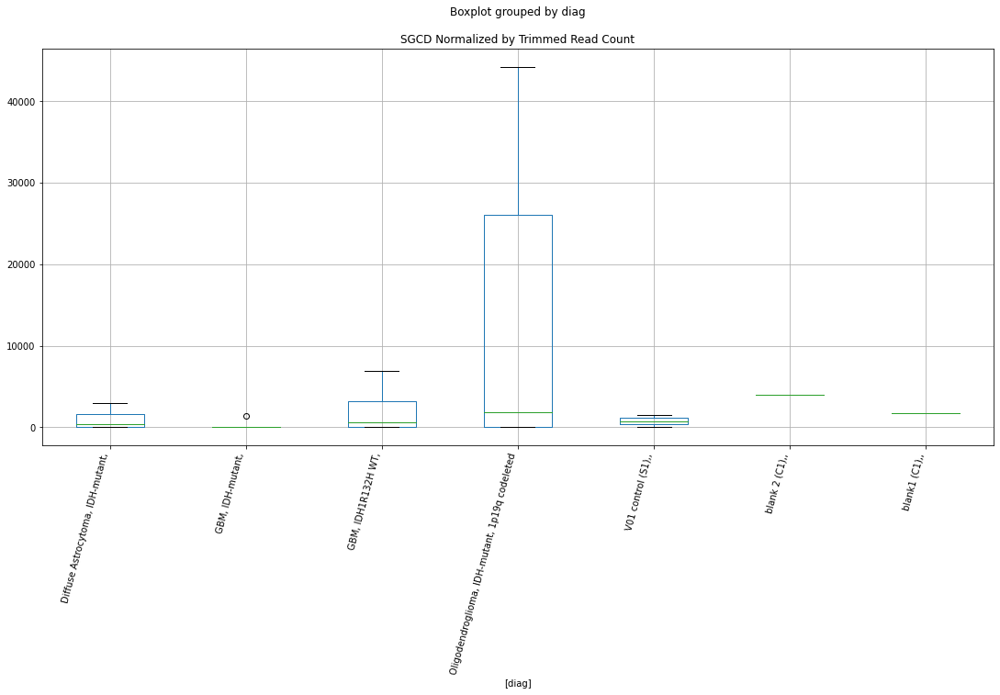

 p : 0.046386316982568204  ( t : 2.1390801302405005 ) :  Lexogen  :  cutadapt2  :  RPL6
Control and blanks
82     0.0
346    0.0
Name: RPL6, dtype: float64
214    0.0
Name: RPL6, dtype: float64
478    0.0
Name: RPL6, dtype: float64


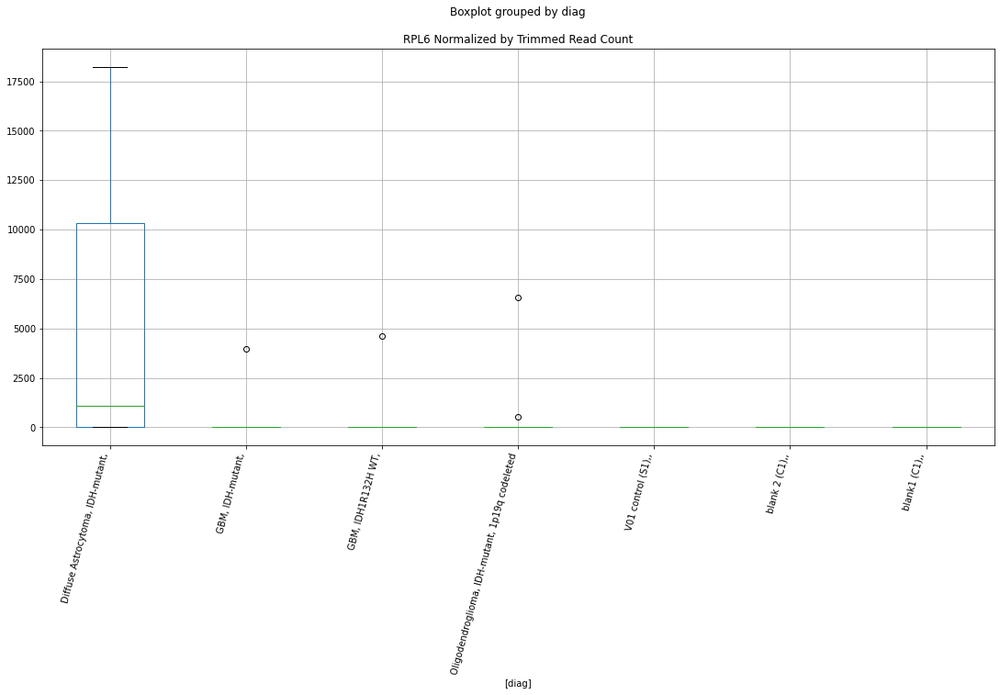

 p : 0.04639426659705393  ( t : 2.1389932547944146 ) :  Lexogen  :  bbduk2  :  PCDHGA10
Control and blanks
79         0.00
343    17409.77
Name: PCDHGA10, dtype: float64
211    0.0
Name: PCDHGA10, dtype: float64
475    8622.57
Name: PCDHGA10, dtype: float64


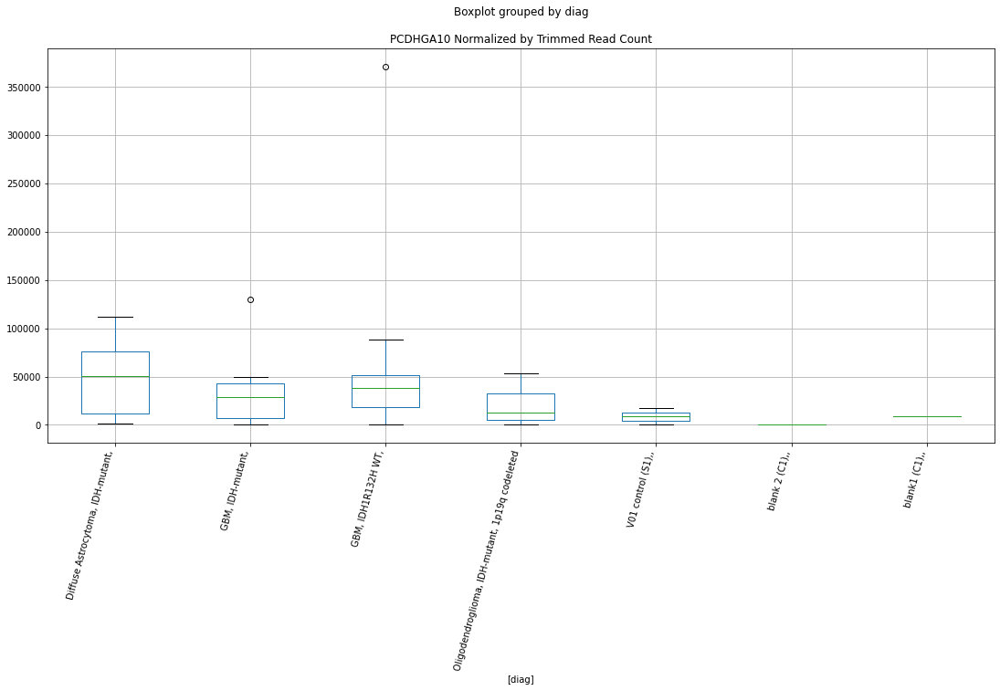

 p : 0.04640038660231128  ( t : 2.13892638304691 ) :  D-plex  :  bbduk2  :  SCRG1
Control and blanks
73     0.0
337    0.0
Name: SCRG1, dtype: float64
205    1432.73
Name: SCRG1, dtype: float64
469    1183.05
Name: SCRG1, dtype: float64


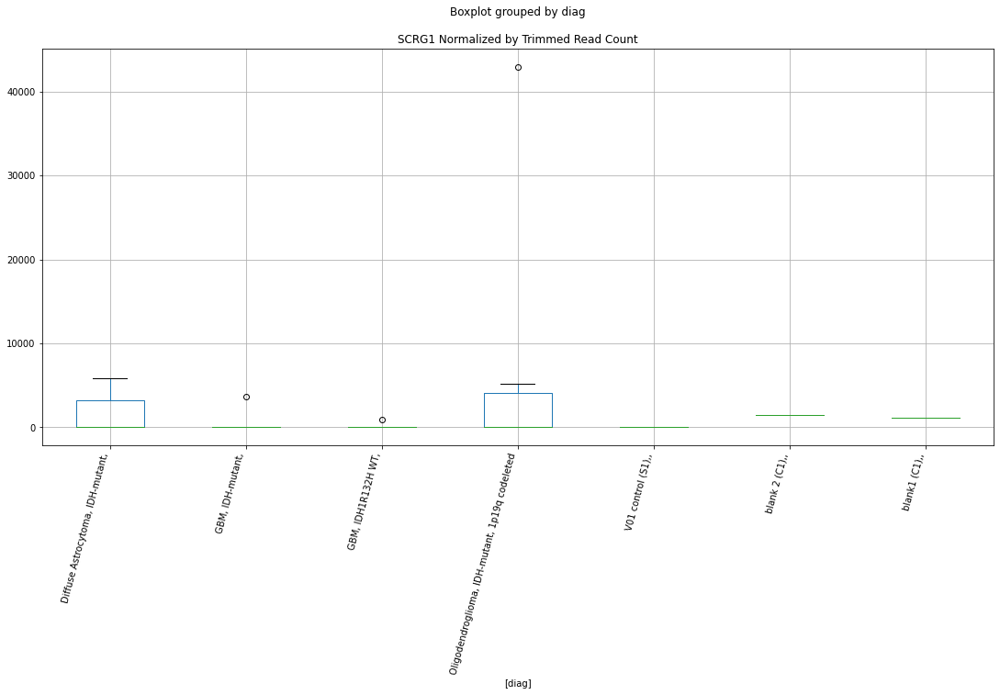

 p : 0.046494059401348105  ( t : 2.137903847317472 ) :  Lexogen  :  cutadapt2  :  SMAD1
Control and blanks
82     0.0
346    0.0
Name: SMAD1, dtype: float64
214    0.0
Name: SMAD1, dtype: float64
478    0.0
Name: SMAD1, dtype: float64


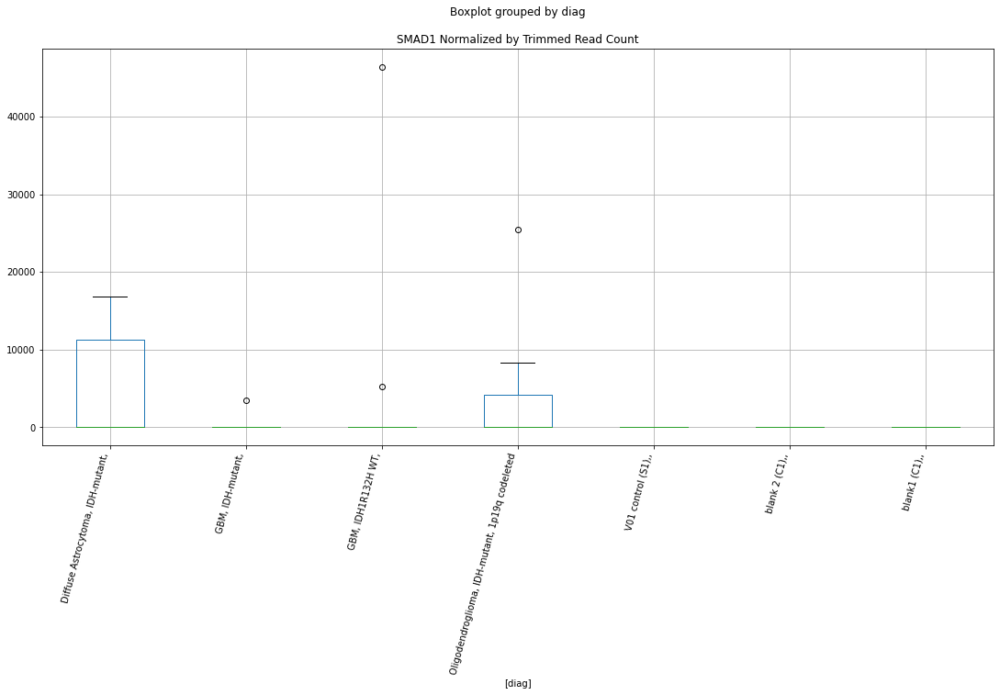

 p : 0.04650952382812403  ( t : 2.1377352179003695 ) :  D-plex  :  cutadapt2  :  RASA4
Control and blanks
76         0.00
340    10568.79
Name: RASA4, dtype: float64
208    24161.35
Name: RASA4, dtype: float64
472    0.0
Name: RASA4, dtype: float64


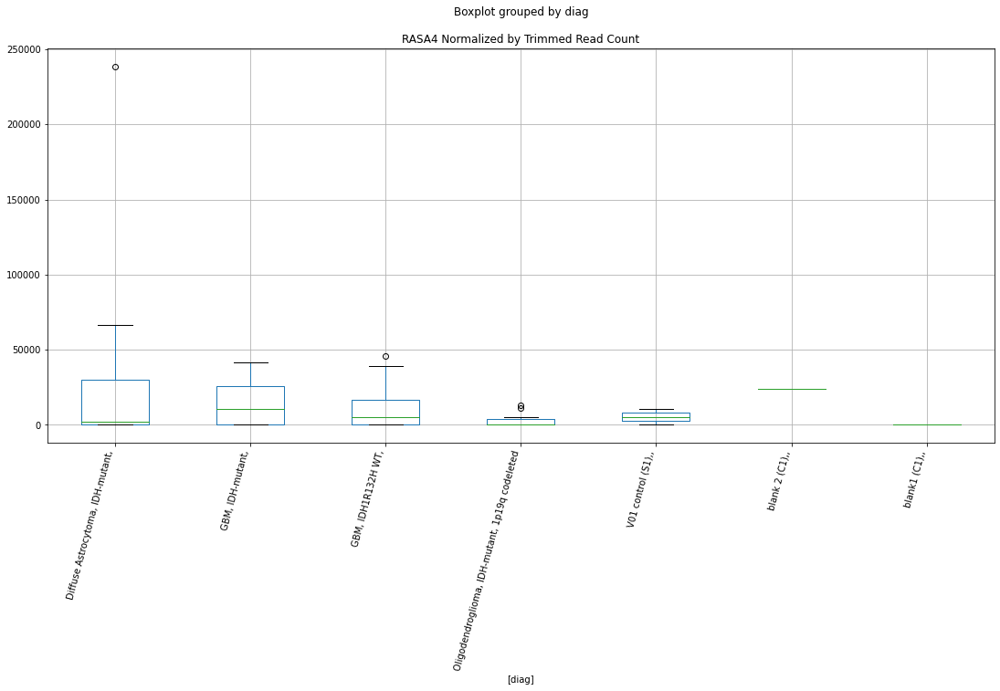

 p : 0.04650952382812403  ( t : 2.1377352179003695 ) :  D-plex  :  cutadapt2  :  RASA4DP
Control and blanks
76     0.0
340    0.0
Name: RASA4DP, dtype: float64
208    1939.96
Name: RASA4DP, dtype: float64
472    0.0
Name: RASA4DP, dtype: float64


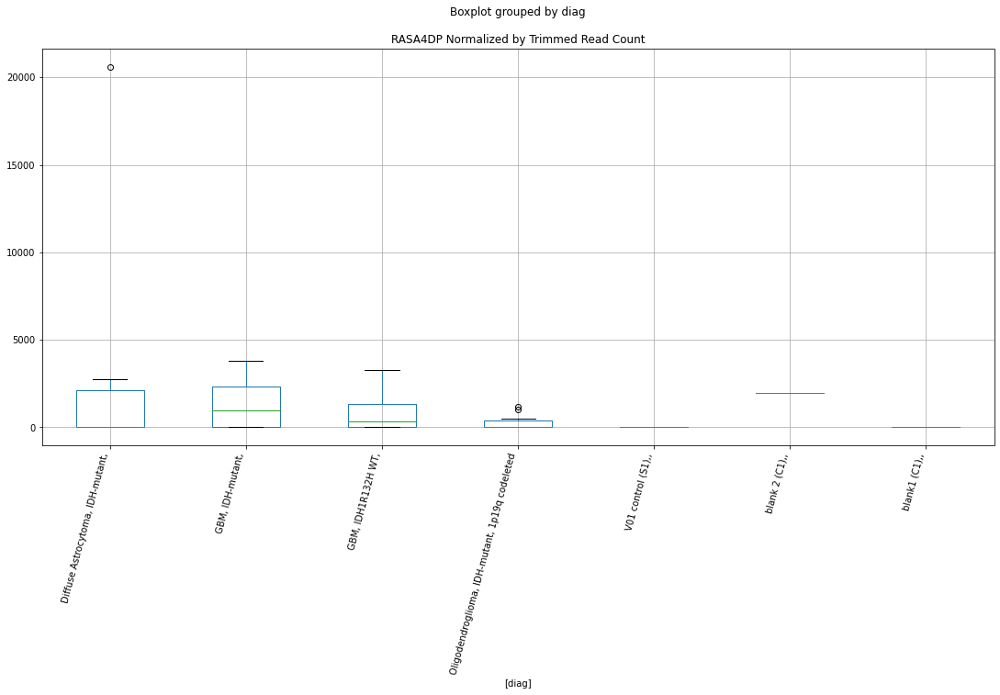

 p : 0.04651679639183011  ( t : 2.137655933057983 ) :  D-plex  :  cutadapt2  :  SCNN1G
Control and blanks
76     21970.81
340        0.00
Name: SCNN1G, dtype: float64
208    529.08
Name: SCNN1G, dtype: float64
472    2311.82
Name: SCNN1G, dtype: float64


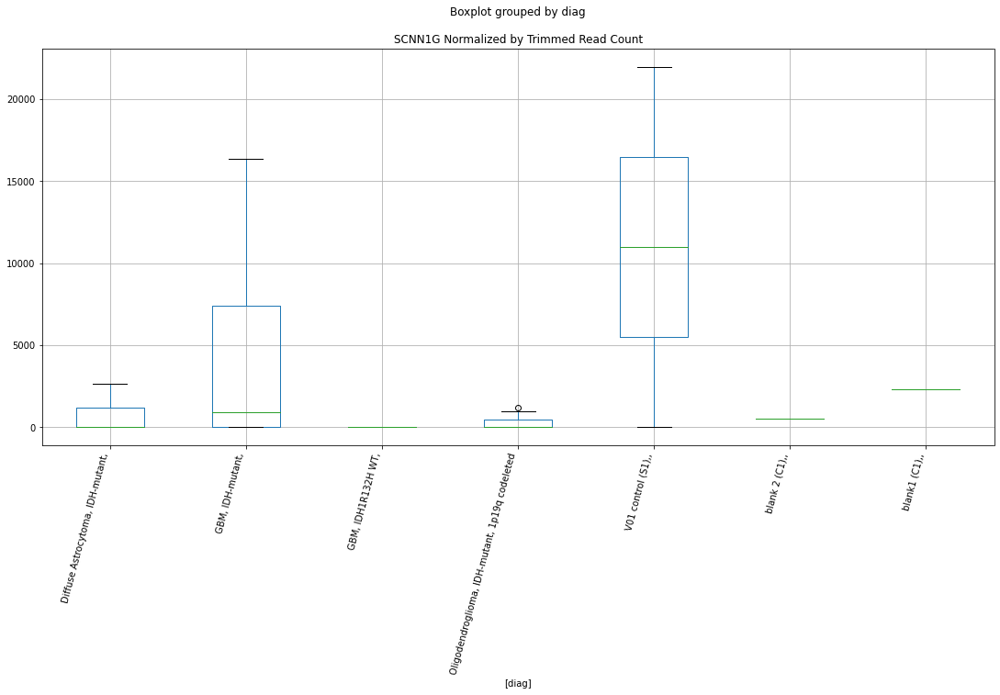

 p : 0.0466232977564339  ( t : 2.1364961584745314 ) :  D-plex  :  bbduk2  :  PPP2R2A
Control and blanks
73     0.0
337    0.0
Name: PPP2R2A, dtype: float64
205    1074.55
Name: PPP2R2A, dtype: float64
469    8872.91
Name: PPP2R2A, dtype: float64


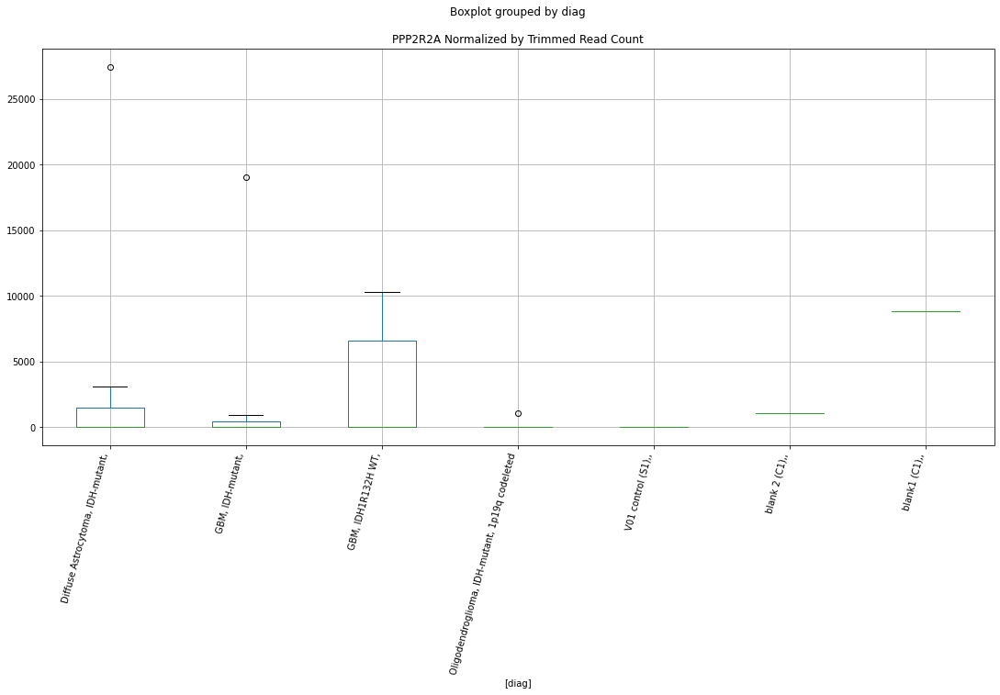

 p : 0.04666238935007419  ( t : 2.1360710667051936 ) :  Lexogen  :  bbduk2  :  PCDH20
Control and blanks
79     0.0
343    0.0
Name: PCDH20, dtype: float64
211    0.0
Name: PCDH20, dtype: float64
475    0.0
Name: PCDH20, dtype: float64


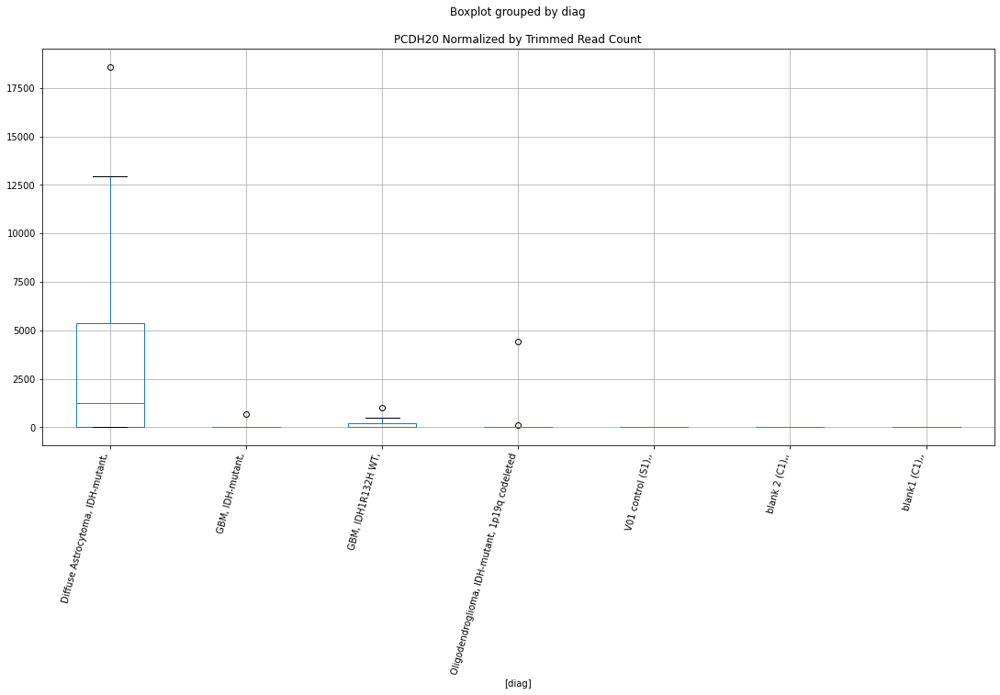

 p : 0.04672736157629547  ( t : 2.1353652607241176 ) :  Lexogen  :  cutadapt2  :  PTPN3
Control and blanks
82     0.0
346    0.0
Name: PTPN3, dtype: float64
214    0.0
Name: PTPN3, dtype: float64
478    4274.29
Name: PTPN3, dtype: float64


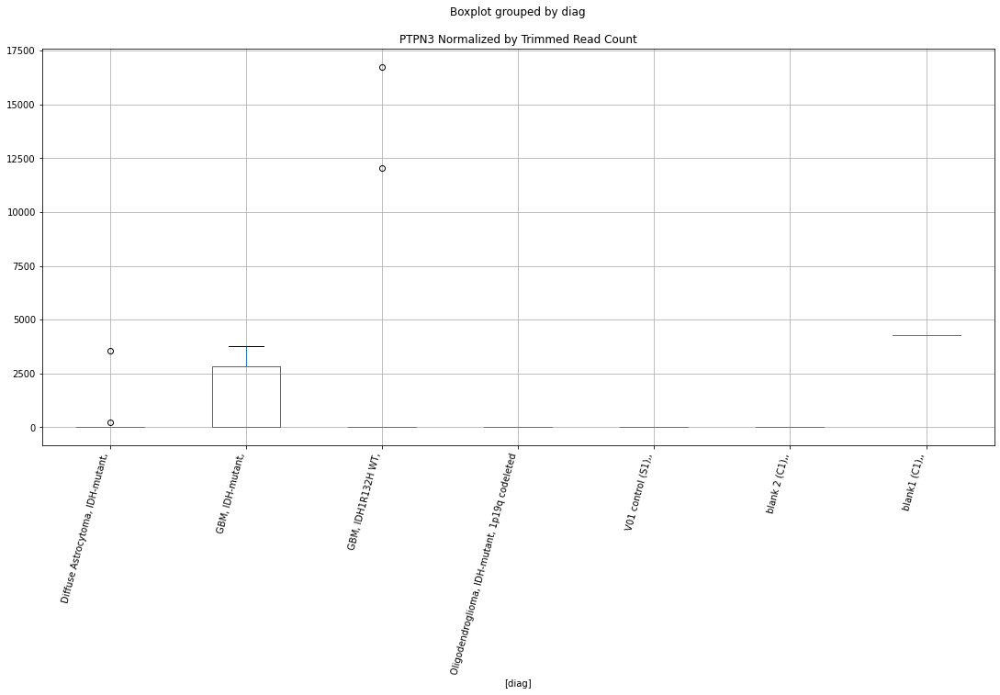

 p : 0.046769991539847115  ( t : 2.1349026493974717 ) :  Lexogen  :  cutadapt2  :  RYR2
Control and blanks
82     0.0
346    0.0
Name: RYR2, dtype: float64
214    0.0
Name: RYR2, dtype: float64
478    0.0
Name: RYR2, dtype: float64


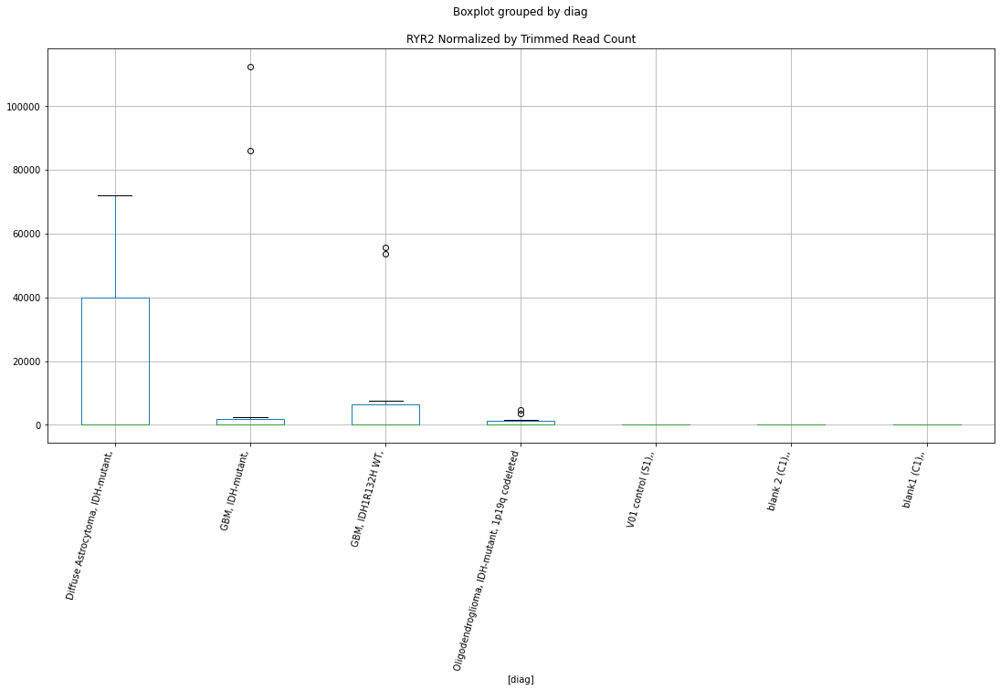

 p : 0.046782640813222254  ( t : 2.1347654561687124 ) :  Lexogen  :  bbduk2  :  PPTC7
Control and blanks
79       0.00
343    849.26
Name: PPTC7, dtype: float64
211    9839.03
Name: PPTC7, dtype: float64
475    0.0
Name: PPTC7, dtype: float64


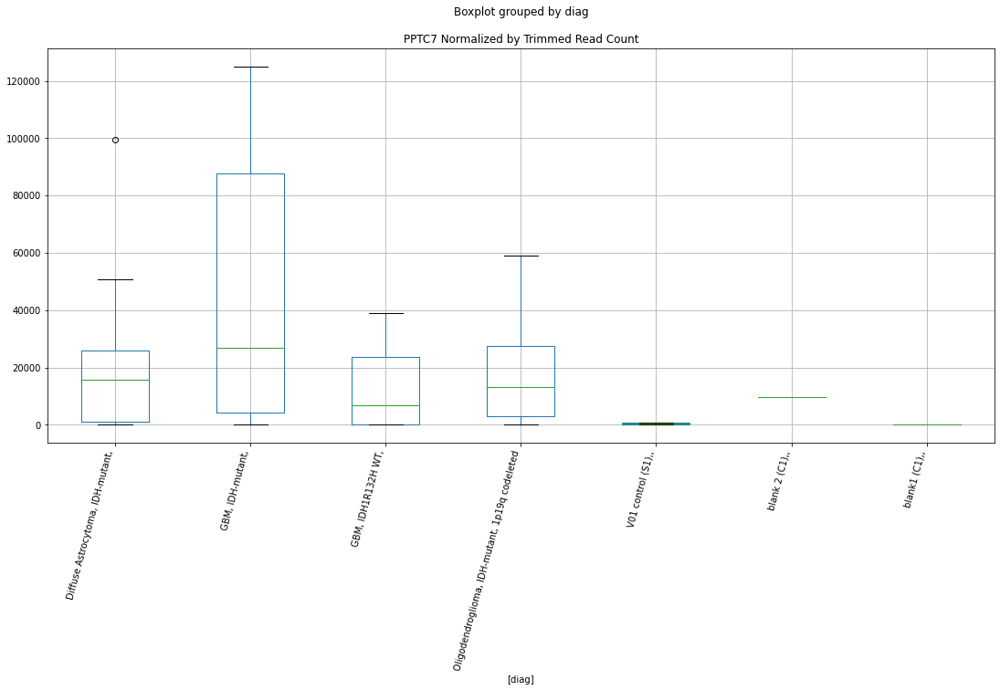

 p : 0.04683935644102745  ( t : 2.1341507377222015 ) :  D-plex  :  bbduk2  :  SCNN1G
Control and blanks
73     22417.24
337        0.00
Name: SCNN1G, dtype: float64
205    537.27
Name: SCNN1G, dtype: float64
469    2366.11
Name: SCNN1G, dtype: float64


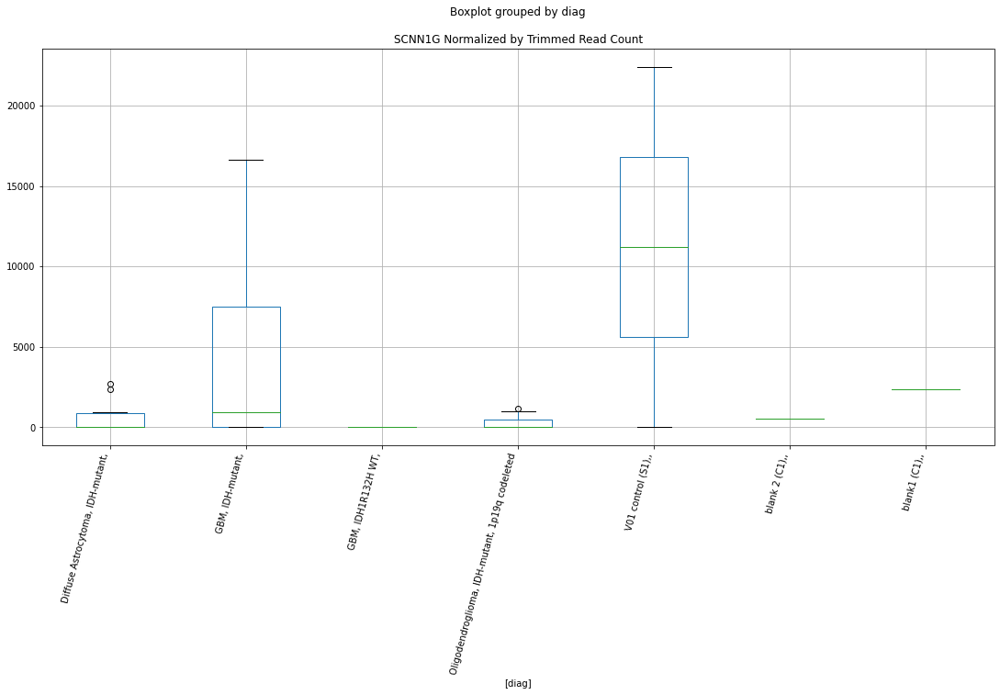

 p : 0.04684463814797482  ( t : 2.134093525937356 ) :  D-plex  :  cutadapt2  :  SLCO4A1
Control and blanks
76     0.0
340    0.0
Name: SLCO4A1, dtype: float64
208    14108.82
Name: SLCO4A1, dtype: float64
472    4045.69
Name: SLCO4A1, dtype: float64


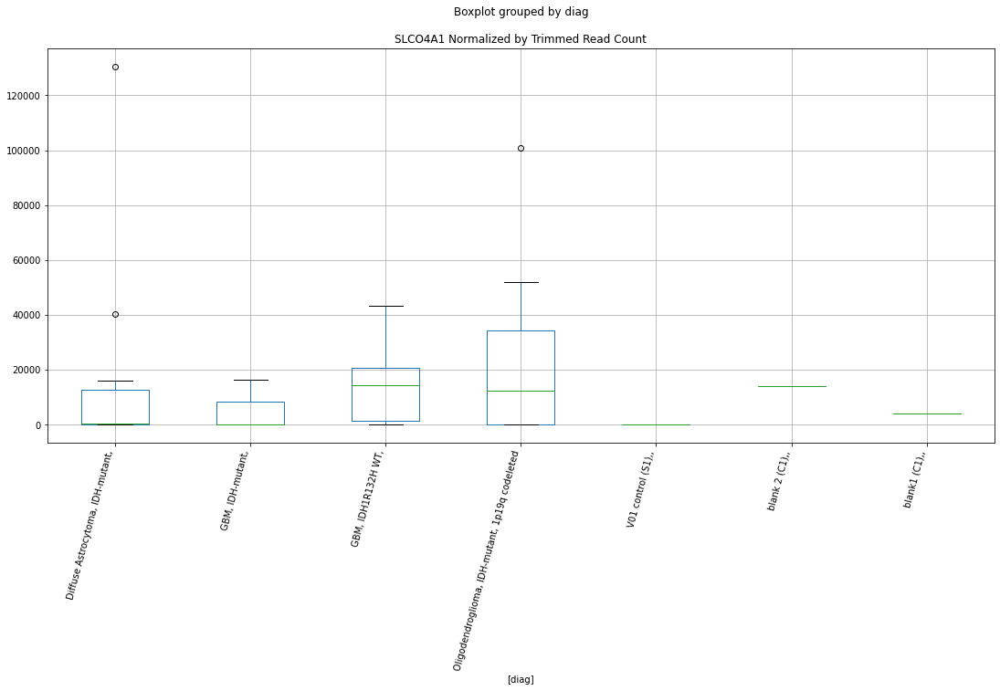

 p : 0.04688673318459953  ( t : 2.133637760040869 ) :  D-plex  :  bbduk2  :  RALA
Control and blanks
73     0.0
337    0.0
Name: RALA, dtype: float64
205    716.36
Name: RALA, dtype: float64
469    0.0
Name: RALA, dtype: float64


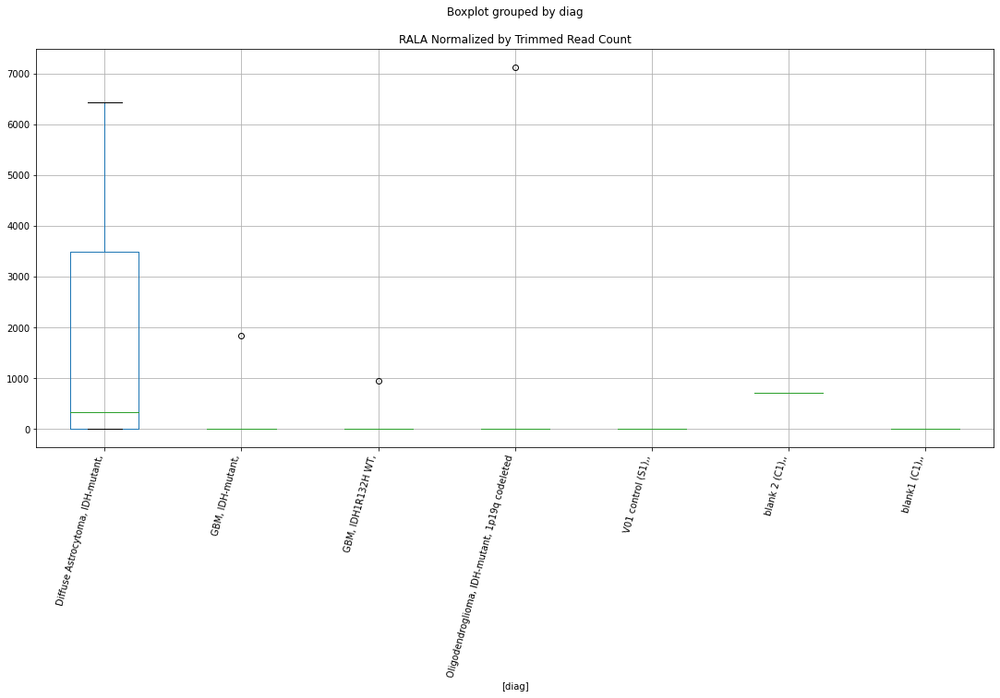

 p : 0.046889201291950365  ( t : 2.1336110492555505 ) :  D-plex  :  bbduk2  :  SAMD15
Control and blanks
73     1546.02
337       0.00
Name: SAMD15, dtype: float64
205    7700.91
Name: SAMD15, dtype: float64
469    9464.44
Name: SAMD15, dtype: float64


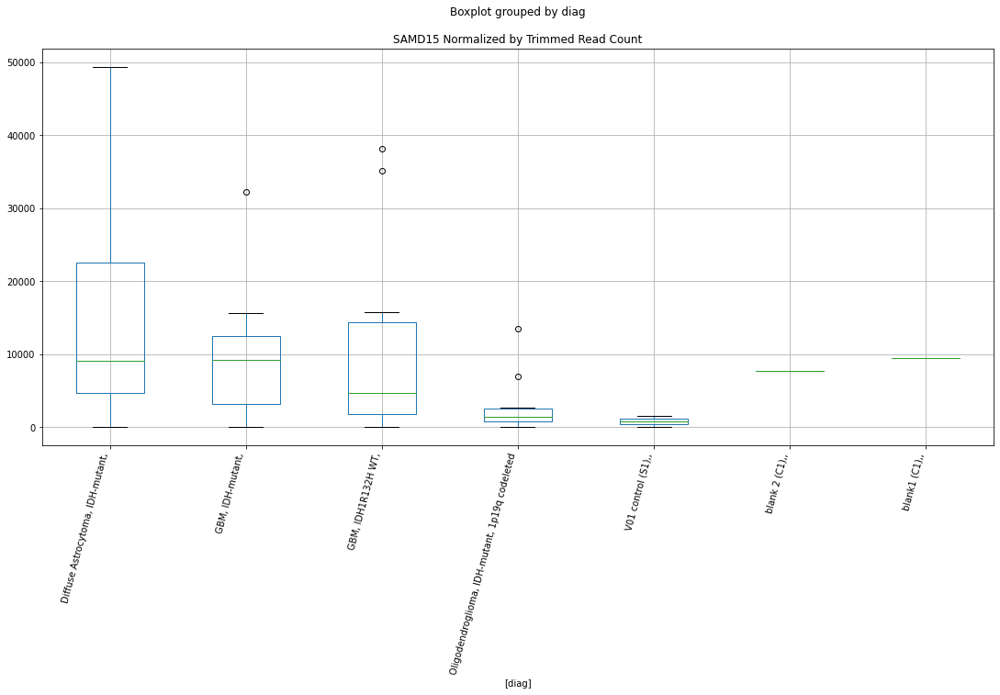

 p : 0.046904696763090656  ( t : 2.1334433807381727 ) :  D-plex  :  bbduk2  :  RNF31
Control and blanks
73     0.0
337    0.0
Name: RNF31, dtype: float64
205    1432.73
Name: RNF31, dtype: float64
469    0.0
Name: RNF31, dtype: float64


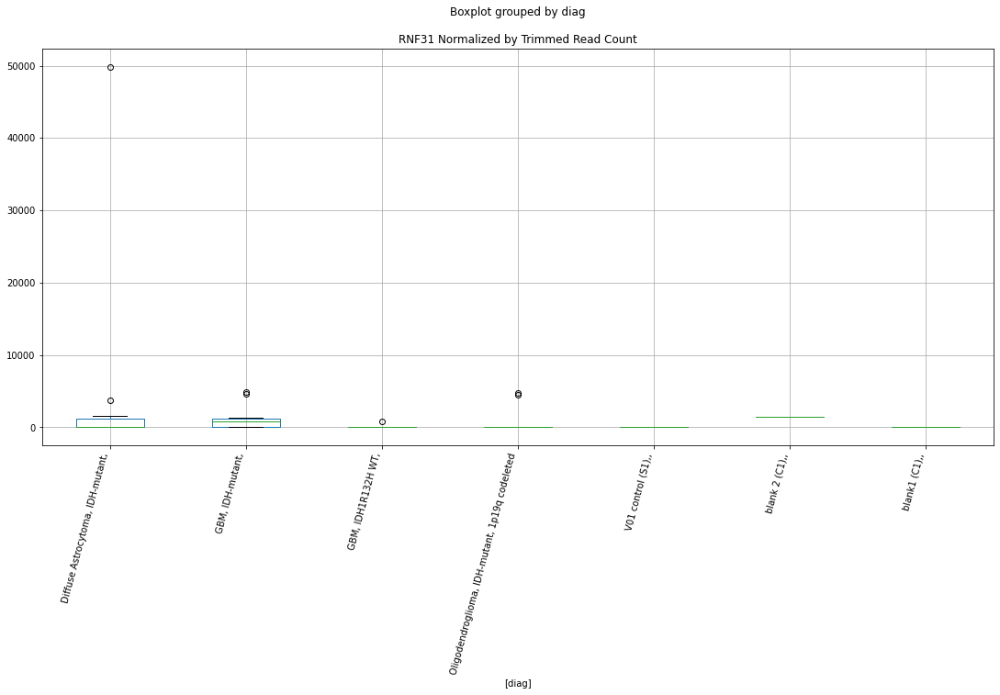

 p : 0.04691947221219163  ( t : 2.133283550258825 ) :  Lexogen  :  bbduk2  :  SMAD1
Control and blanks
79     0.0
343    0.0
Name: SMAD1, dtype: float64
211    0.0
Name: SMAD1, dtype: float64
475    0.0
Name: SMAD1, dtype: float64


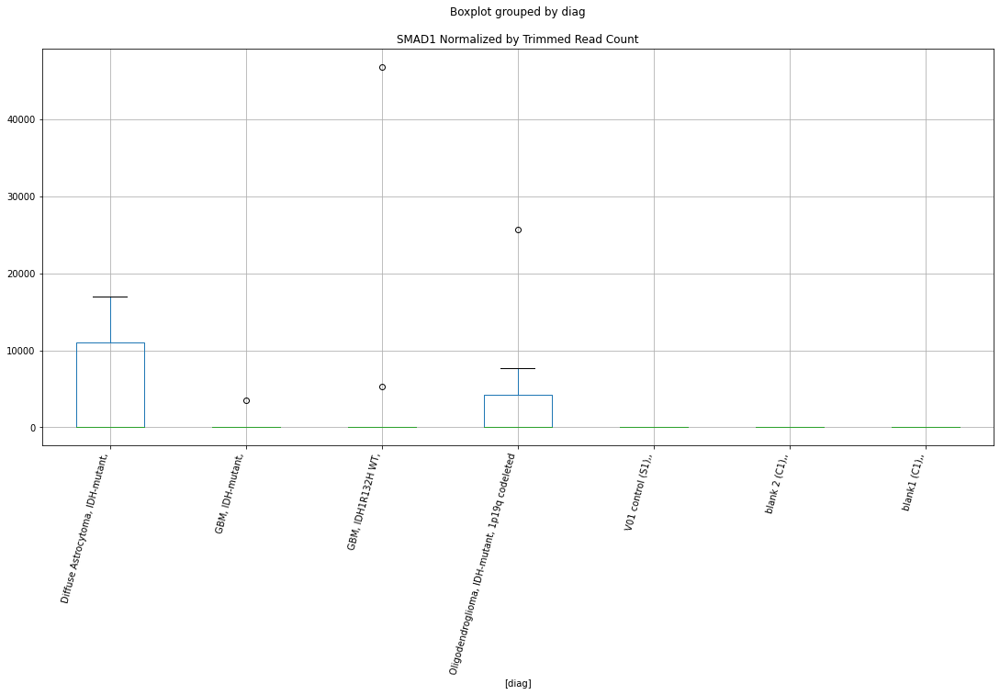

 p : 0.046923252617641464  ( t : 2.1332426638511963 ) :  Lexogen  :  cutadapt2  :  RORB
Control and blanks
82     0.0
346    0.0
Name: RORB, dtype: float64
214    0.0
Name: RORB, dtype: float64
478    0.0
Name: RORB, dtype: float64


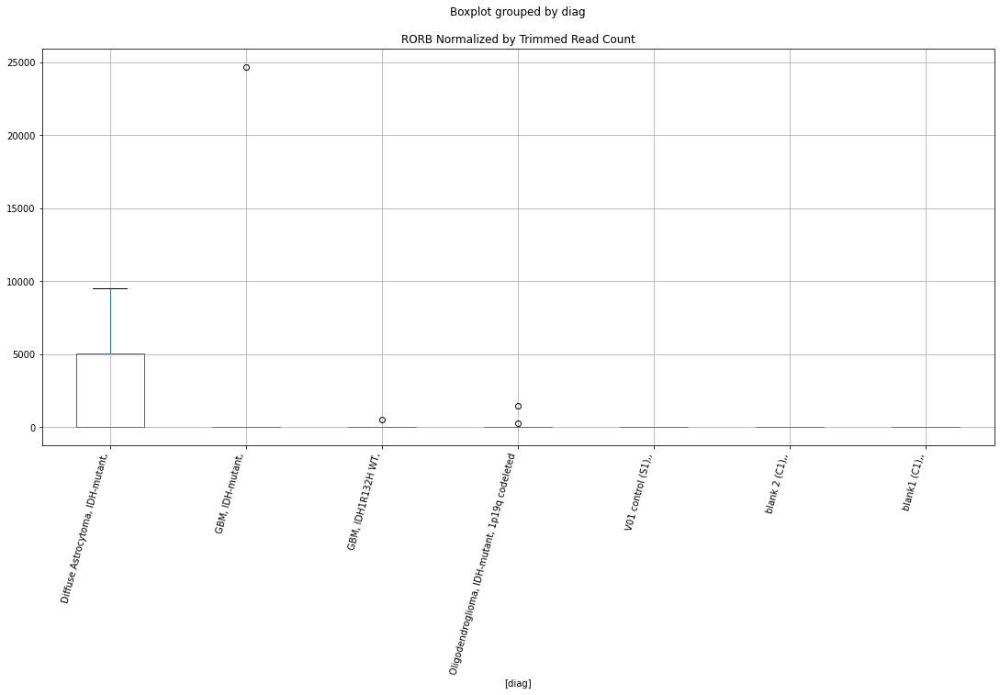

 p : 0.04695058436757435  ( t : 2.132947150765462 ) :  D-plex  :  cutadapt2  :  SCNN1G
Control and blanks
76     21970.81
340        0.00
Name: SCNN1G, dtype: float64
208    529.08
Name: SCNN1G, dtype: float64
472    2311.82
Name: SCNN1G, dtype: float64


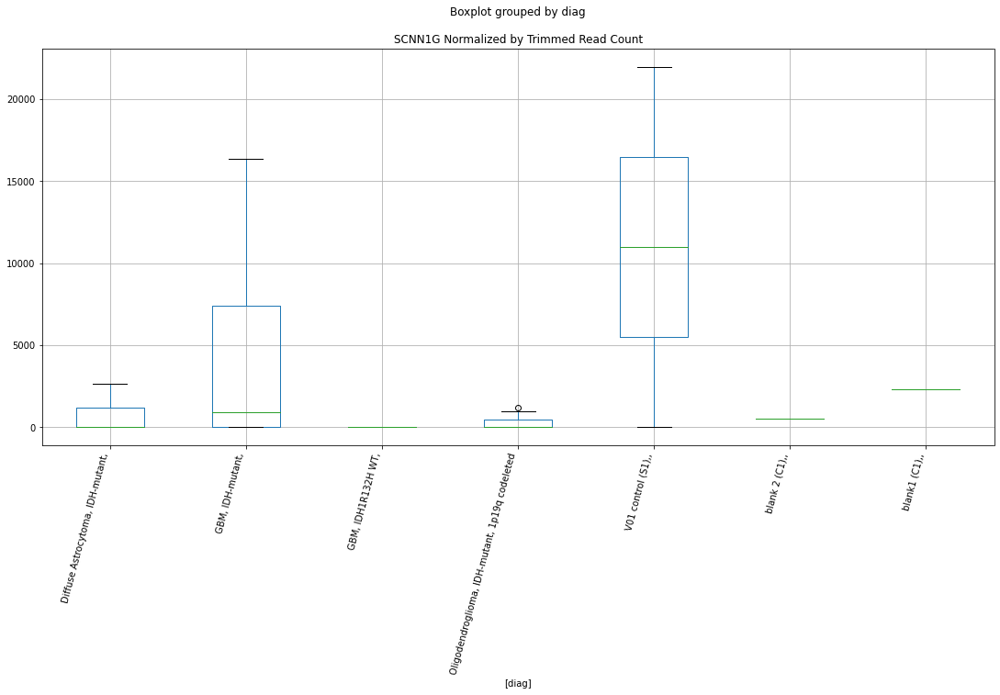

 p : 0.04697004706178117  ( t : 2.1327368141765857 ) :  D-plex  :  cutadapt2  :  SERPINB6
Control and blanks
76     19697.97
340        0.00
Name: SERPINB6, dtype: float64
208    4761.73
Name: SERPINB6, dtype: float64
472    0.0
Name: SERPINB6, dtype: float64


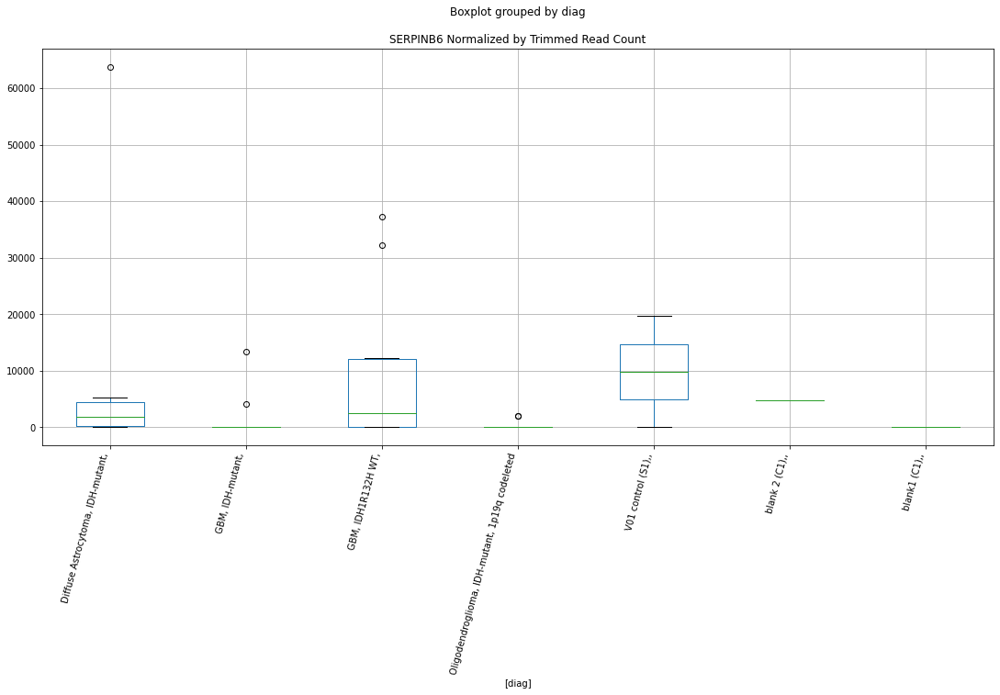

 p : 0.04700351997191865  ( t : 2.1323752526908373 ) :  Lexogen  :  cutadapt2  :  PI15
Control and blanks
82     0.0
346    0.0
Name: PI15, dtype: float64
214    0.0
Name: PI15, dtype: float64
478    0.0
Name: PI15, dtype: float64


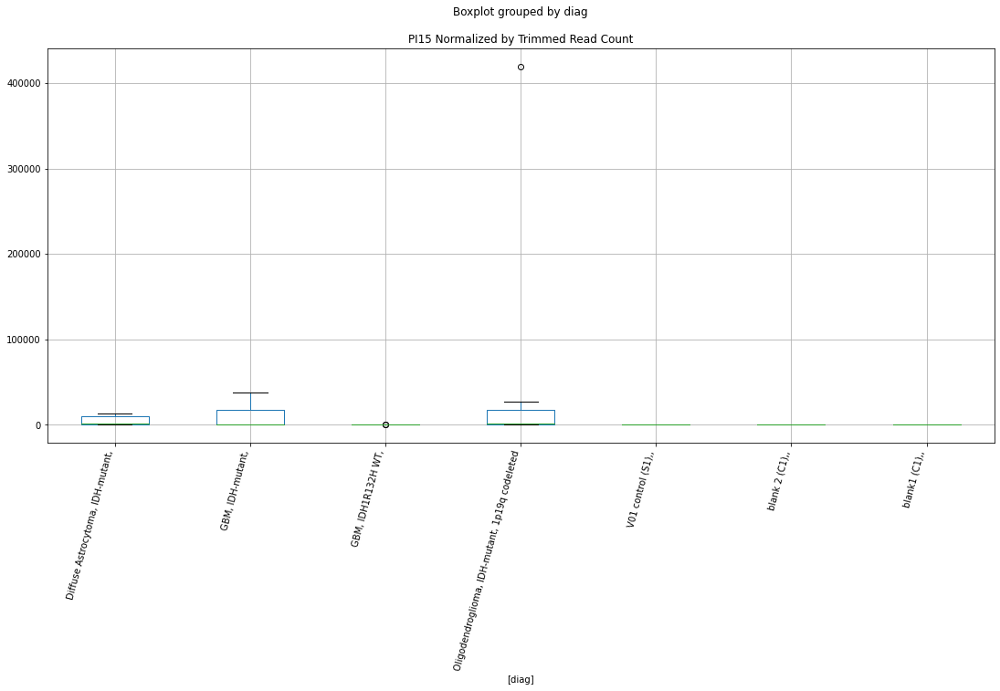

 p : 0.04702718456778456  ( t : 2.1321197785073505 ) :  D-plex  :  cutadapt2  :  POU3F1
Control and blanks
76     0.0
340    0.0
Name: POU3F1, dtype: float64
208    529.08
Name: POU3F1, dtype: float64
472    577.96
Name: POU3F1, dtype: float64


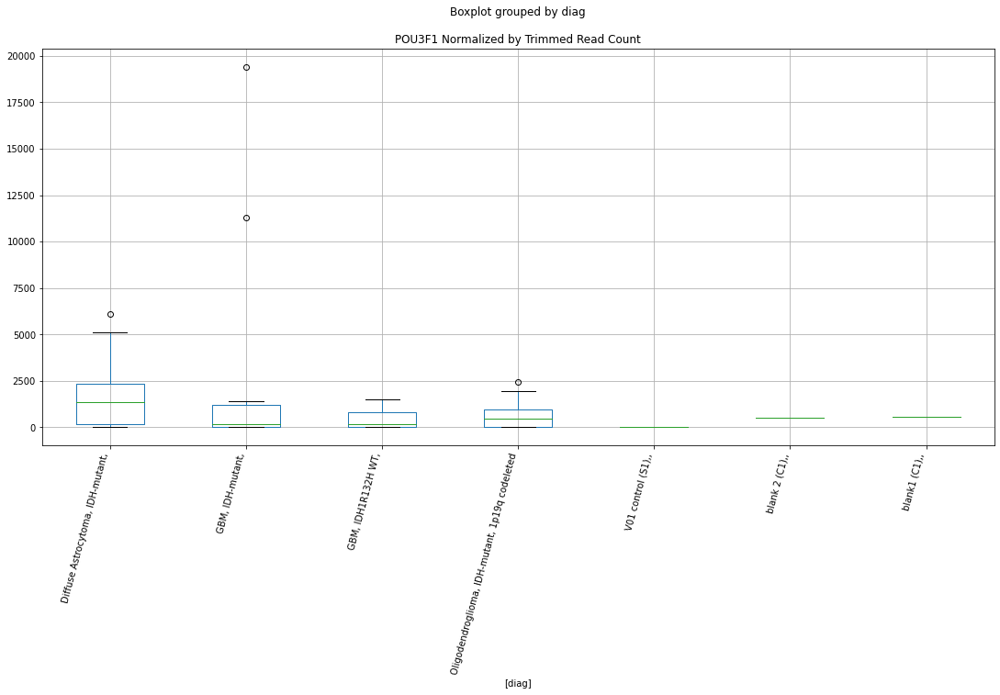

 p : 0.04704402994398572  ( t : 2.13193799350996 ) :  D-plex  :  bbduk2  :  SCTR
Control and blanks
73     0.0
337    0.0
Name: SCTR, dtype: float64
205    10029.09
Name: SCTR, dtype: float64
469    11830.55
Name: SCTR, dtype: float64


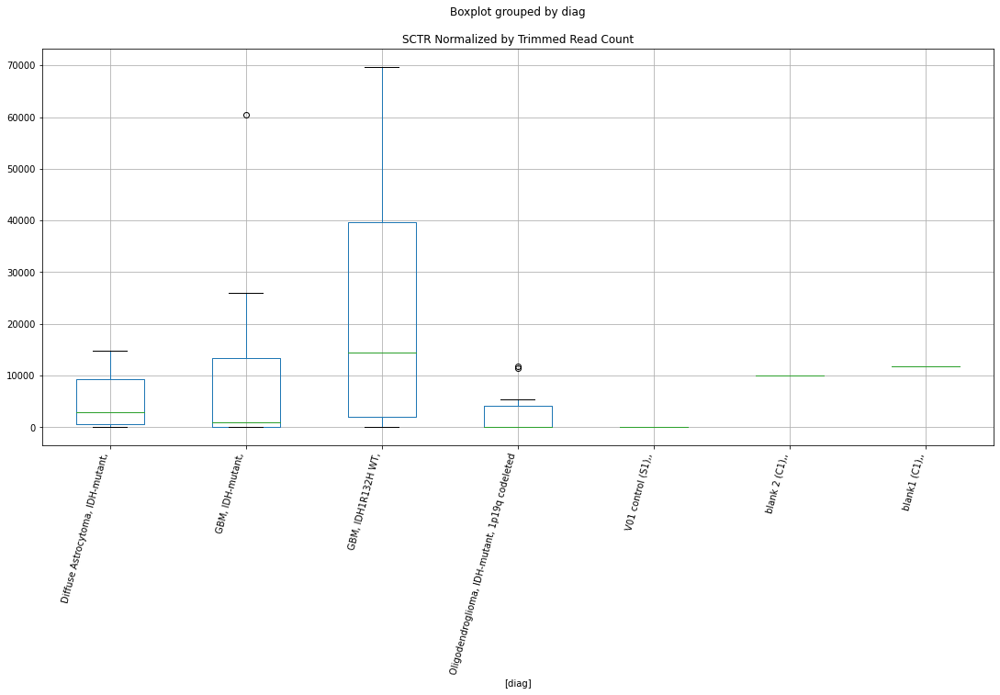

 p : 0.04705159337313344  ( t : 2.1318563929182233 ) :  D-plex  :  cutadapt2  :  SLC7A11-AS1
Control and blanks
76     0.0
340    0.0
Name: SLC7A11-AS1, dtype: float64
208    529.08
Name: SLC7A11-AS1, dtype: float64
472    0.0
Name: SLC7A11-AS1, dtype: float64


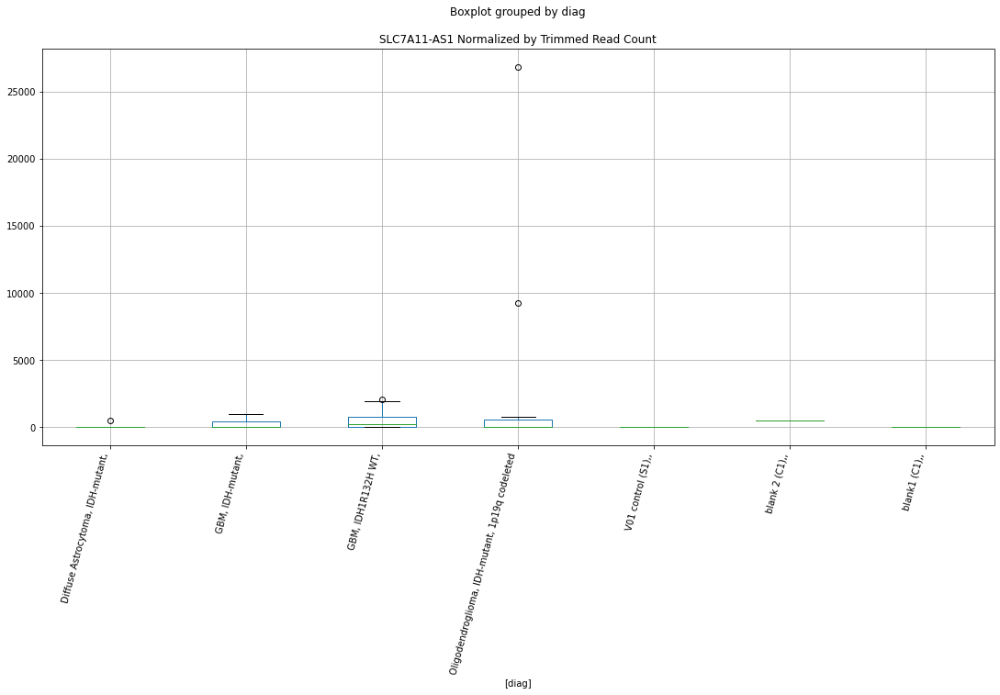

 p : 0.04712052001759021  ( t : 2.131113305433864 ) :  Lexogen  :  bbduk2  :  PI15
Control and blanks
79     0.0
343    0.0
Name: PI15, dtype: float64
211    0.0
Name: PI15, dtype: float64
475    0.0
Name: PI15, dtype: float64


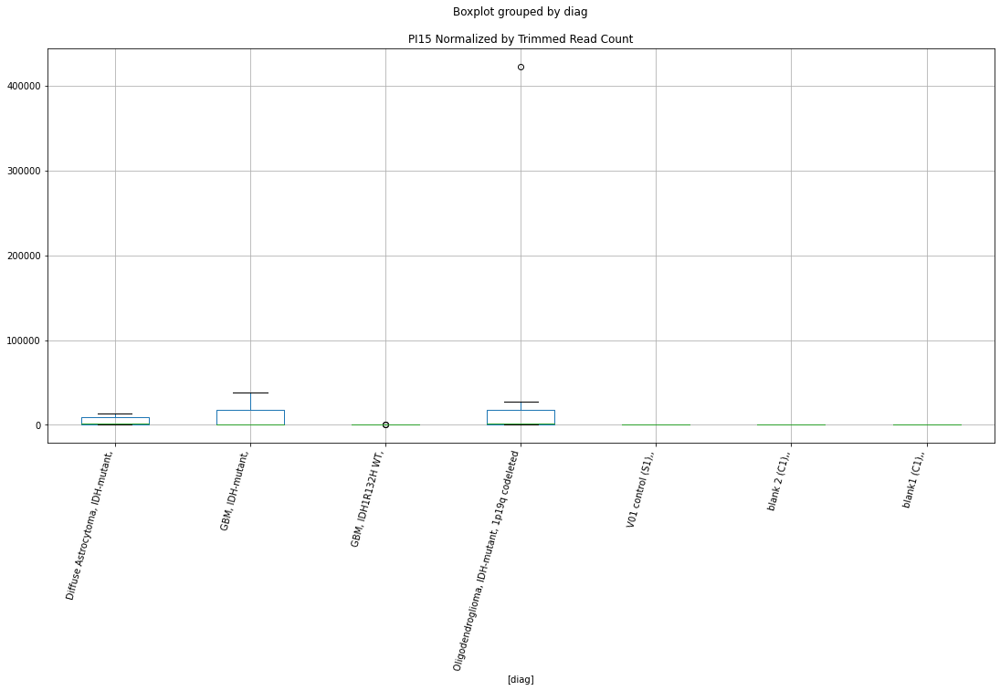

 p : 0.04718879494309833  ( t : 2.130378220582244 ) :  Lexogen  :  cutadapt2  :  PCDH20
Control and blanks
82     0.0
346    0.0
Name: PCDH20, dtype: float64
214    0.0
Name: PCDH20, dtype: float64
478    0.0
Name: PCDH20, dtype: float64


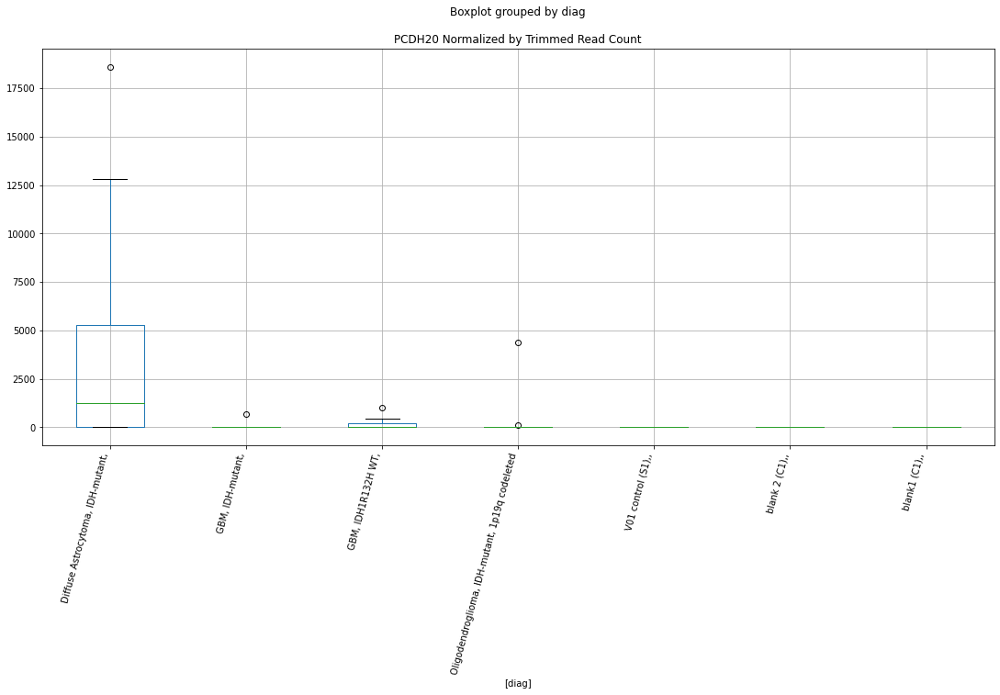

 p : 0.047242943294154446  ( t : 2.1297959193252347 ) :  D-plex  :  cutadapt2  :  PLSCR4
Control and blanks
76     0.0
340    0.0
Name: PLSCR4, dtype: float64
208    0.0
Name: PLSCR4, dtype: float64
472    4045.69
Name: PLSCR4, dtype: float64


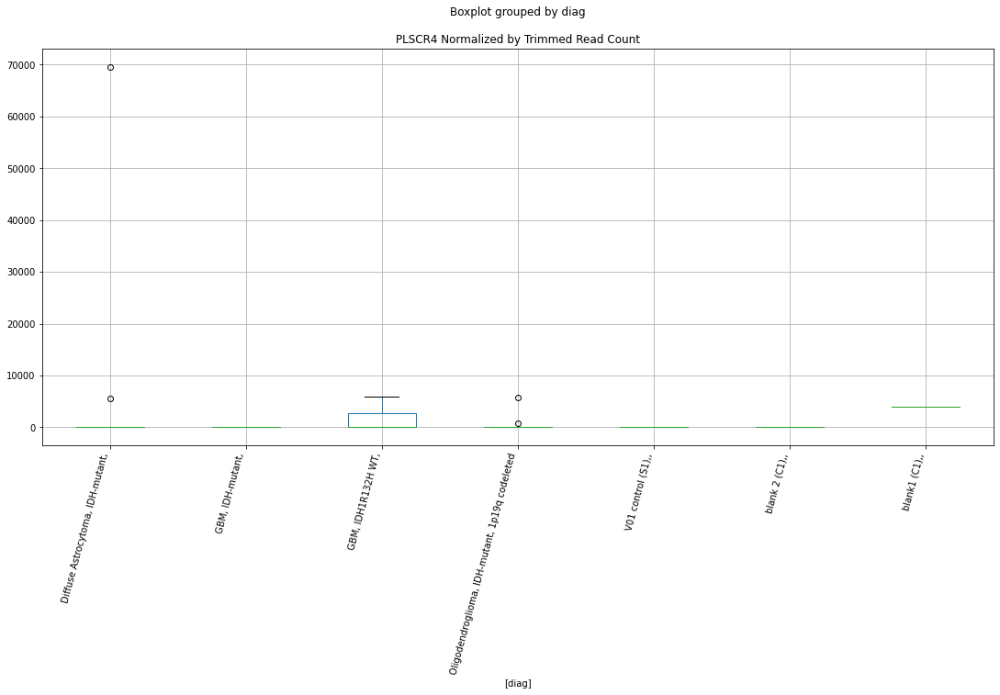

 p : 0.047377597631553324  ( t : 2.1283505056248377 ) :  D-plex  :  bbduk2  :  RNF215
Control and blanks
73     0.0
337    0.0
Name: RNF215, dtype: float64
205    179.09
Name: RNF215, dtype: float64
469    1183.05
Name: RNF215, dtype: float64


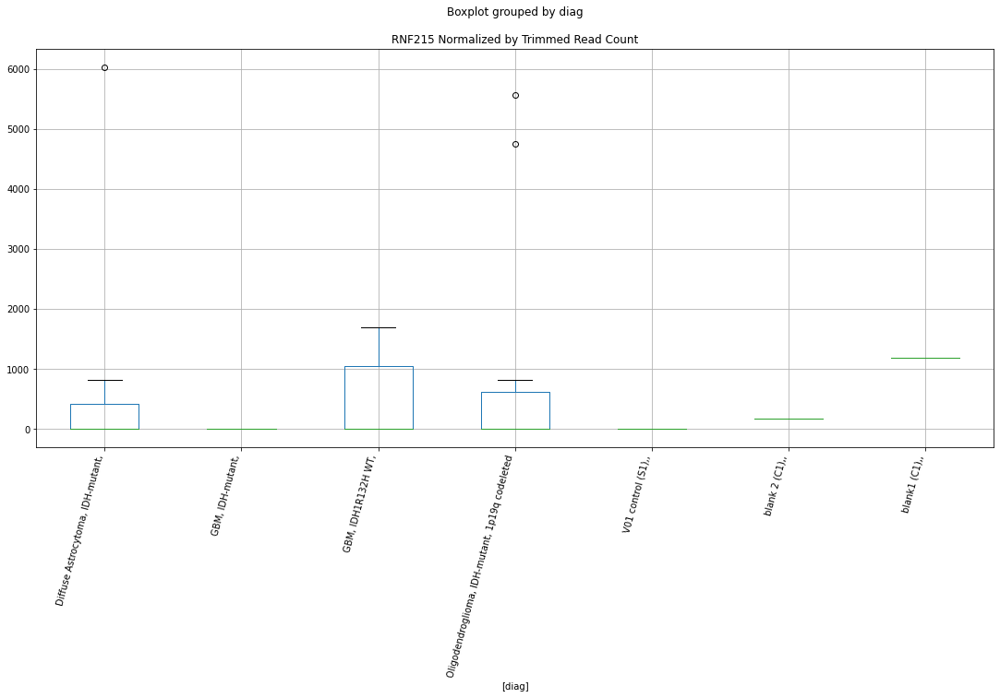

 p : 0.04749073195530033  ( t : 2.127138985412872 ) :  Lexogen  :  cutadapt2  :  PCDHGA2
Control and blanks
82         0.00
346    16834.76
Name: PCDHGA2, dtype: float64
214    0.0
Name: PCDHGA2, dtype: float64
478    8548.58
Name: PCDHGA2, dtype: float64


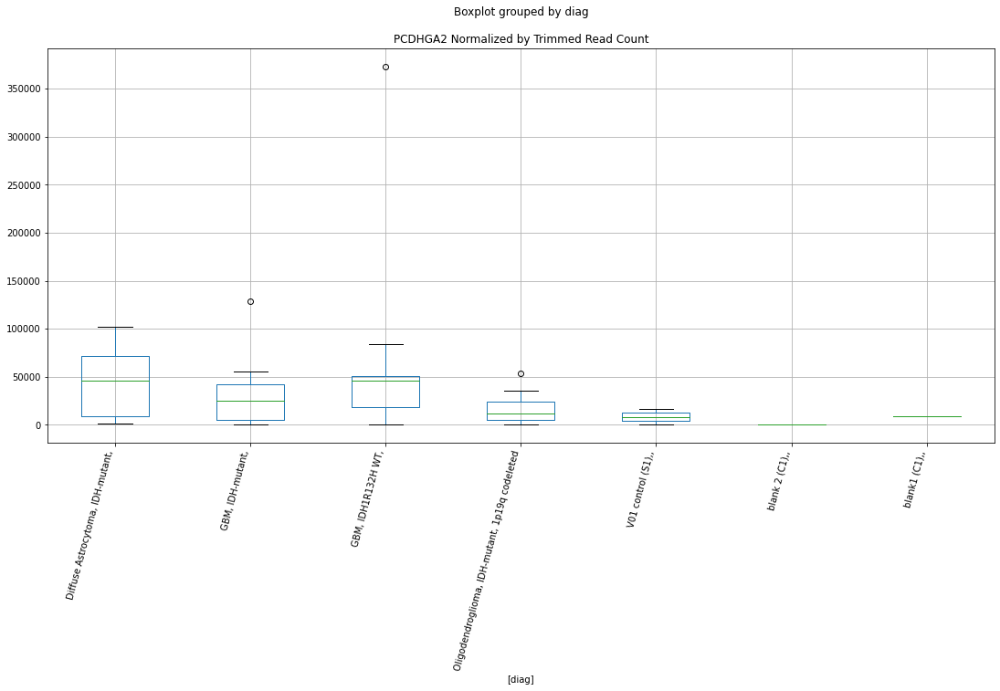

 p : 0.04754948670208404  ( t : 2.126510836685828 ) :  Lexogen  :  cutadapt2  :  RENBP
Control and blanks
82     0.0
346    0.0
Name: RENBP, dtype: float64
214    0.0
Name: RENBP, dtype: float64
478    0.0
Name: RENBP, dtype: float64


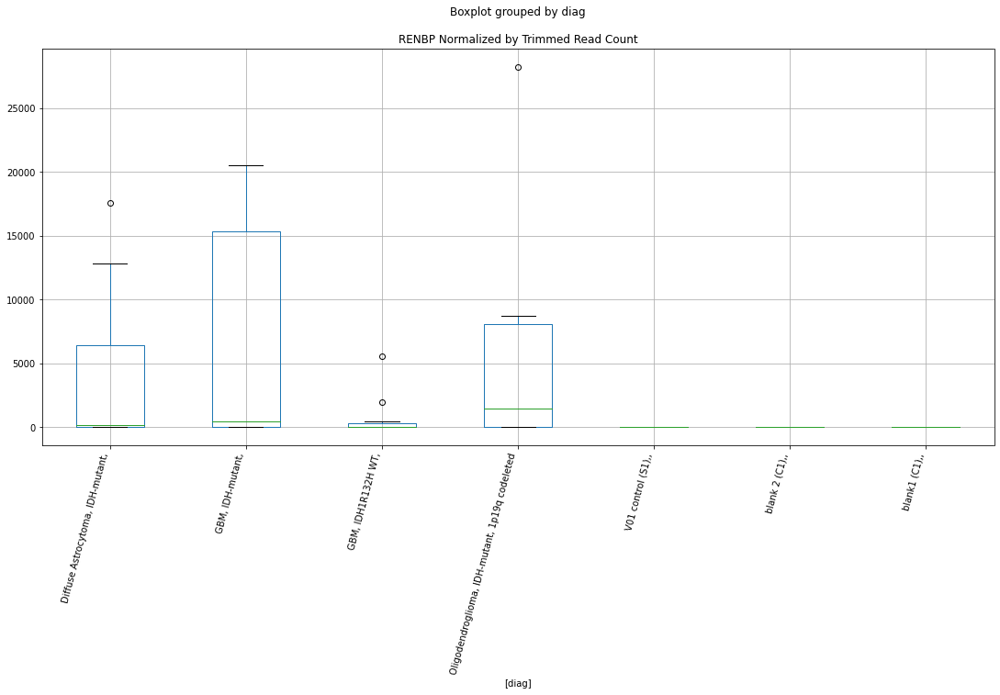

 p : 0.04759005632115308  ( t : 2.1260775184555176 ) :  D-plex  :  cutadapt2  :  P3H2
Control and blanks
76     2272.84
340       0.00
Name: P3H2, dtype: float64
208    1058.16
Name: P3H2, dtype: float64
472    0.0
Name: P3H2, dtype: float64


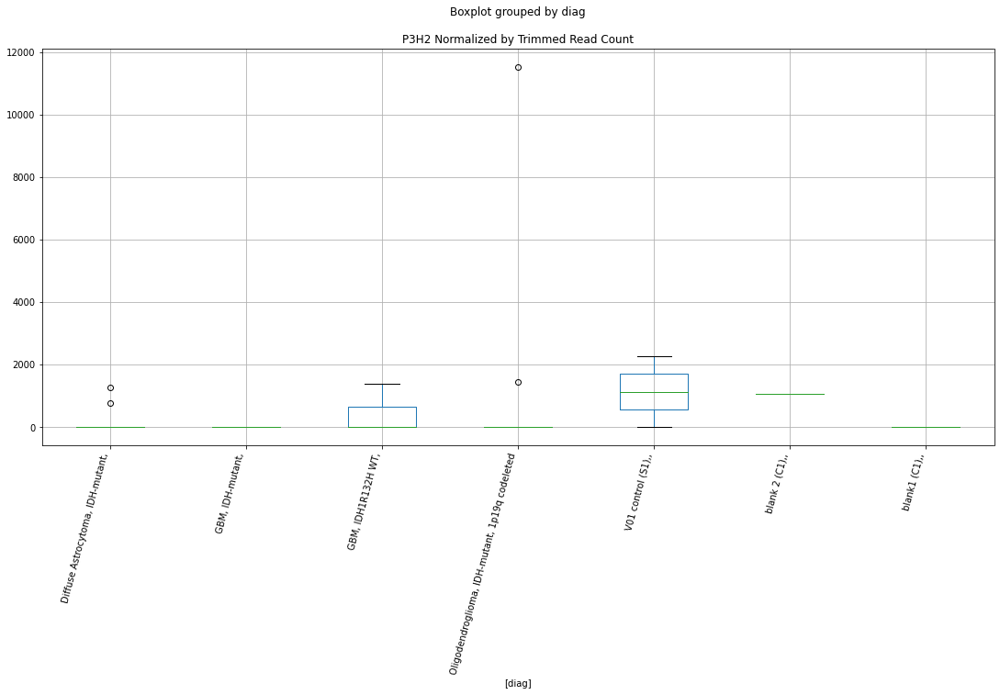

 p : 0.0476050476559748  ( t : 2.1259174833636703 ) :  D-plex  :  bbduk2  :  PLSCR4
Control and blanks
73     0.0
337    0.0
Name: PLSCR4, dtype: float64
205    0.0
Name: PLSCR4, dtype: float64
469    4140.69
Name: PLSCR4, dtype: float64


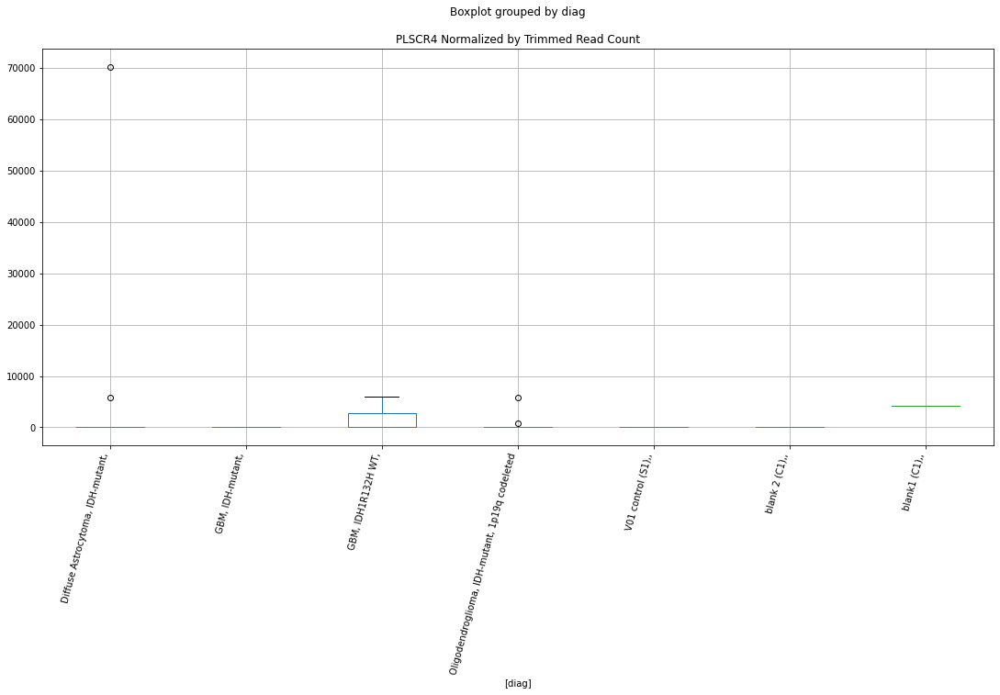

 p : 0.04762301776359435  ( t : 2.125725709873728 ) :  D-plex  :  cutadapt2  :  SLC22A11
Control and blanks
76     0.0
340    0.0
Name: SLC22A11, dtype: float64
208    1058.16
Name: SLC22A11, dtype: float64
472    1733.87
Name: SLC22A11, dtype: float64


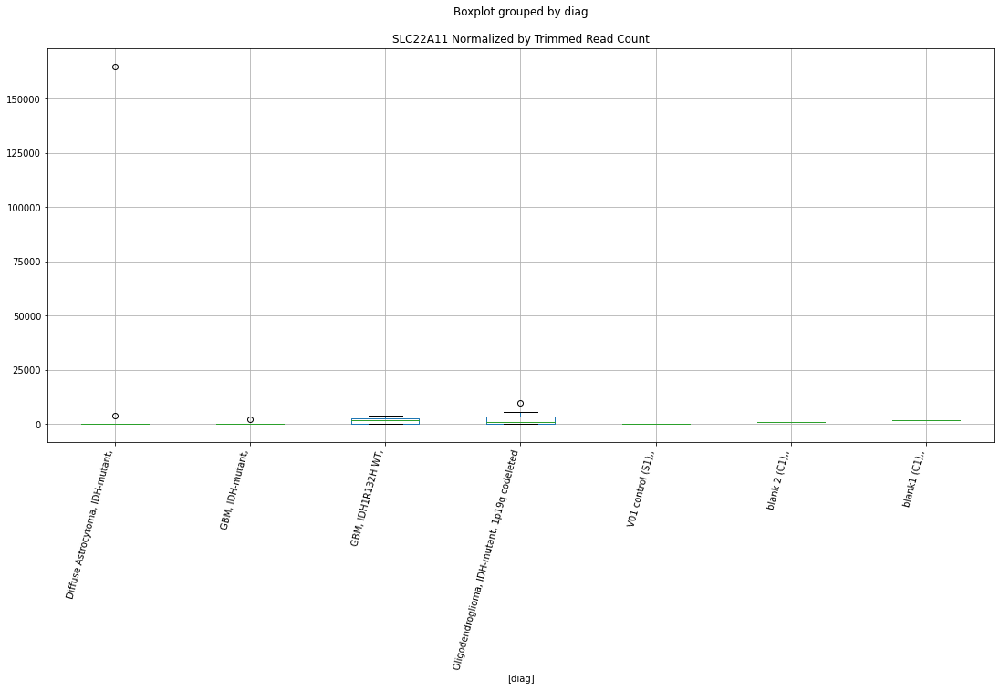

 p : 0.04762352637479863  ( t : 2.1257202830337656 ) :  Lexogen  :  cutadapt2  :  RNY3
Control and blanks
82         0.00
346    94905.97
Name: RNY3, dtype: float64
214    0.0
Name: RNY3, dtype: float64
478    0.0
Name: RNY3, dtype: float64


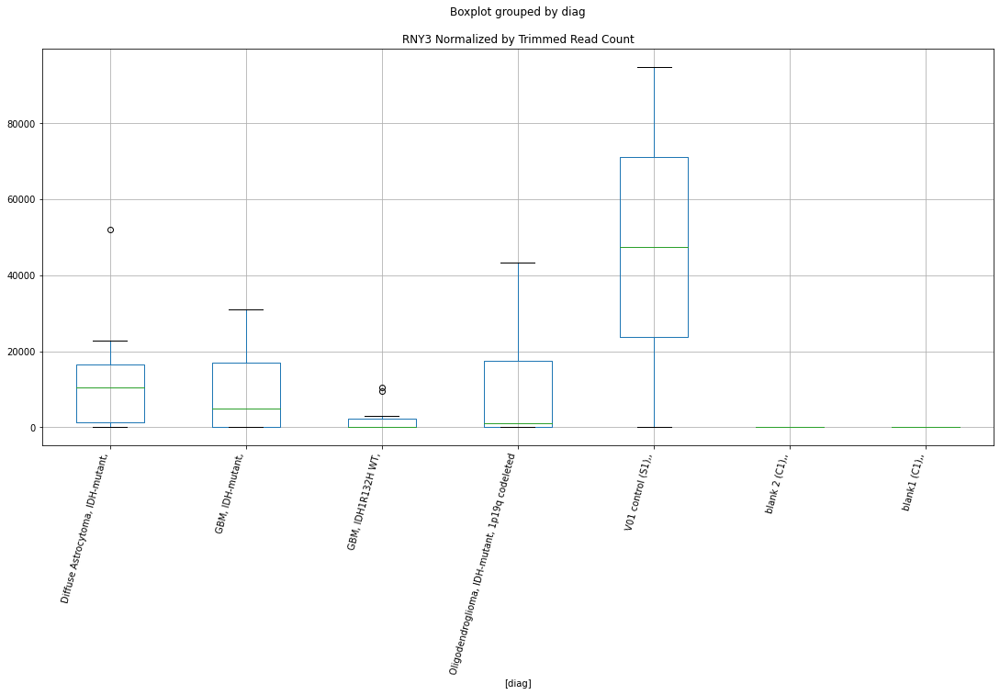

 p : 0.04764227104806936  ( t : 2.1255203157391627 ) :  D-plex  :  bbduk2  :  SPAG16
Control and blanks
73     773.01
337      0.00
Name: SPAG16, dtype: float64
205    1432.73
Name: SPAG16, dtype: float64
469    2366.11
Name: SPAG16, dtype: float64


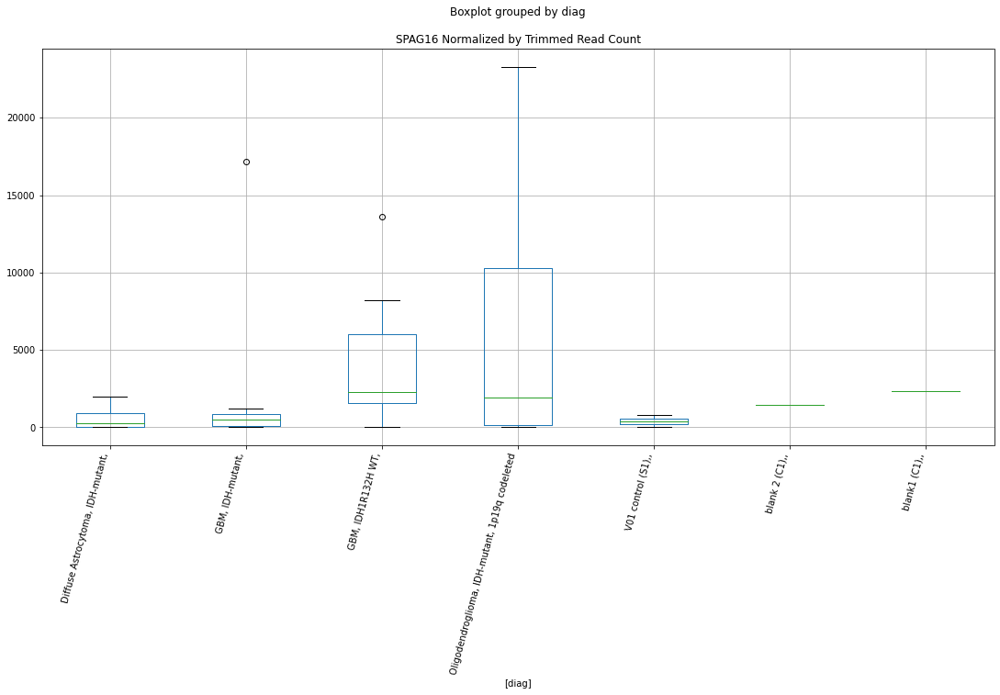

 p : 0.047751152322671464  ( t : 2.1243601912812426 ) :  D-plex  :  bbduk2  :  RAB4B-EGLN2
Control and blanks
73     76527.83
337     8011.42
Name: RAB4B-EGLN2, dtype: float64
205    73606.38
Name: RAB4B-EGLN2, dtype: float64
469    50871.35
Name: RAB4B-EGLN2, dtype: float64


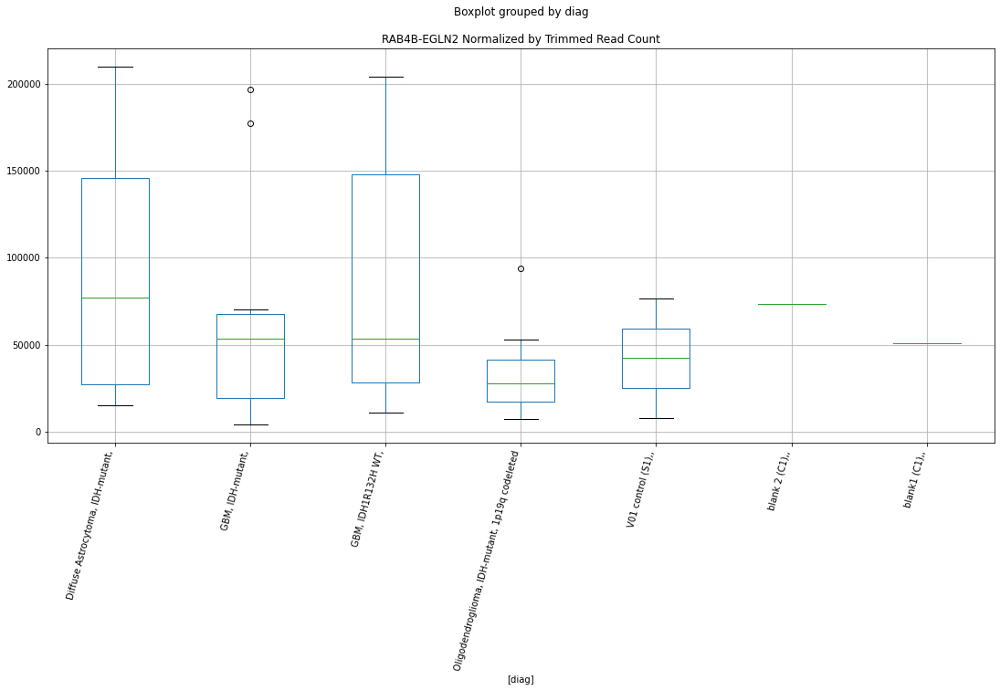

 p : 0.04776072429928123  ( t : 2.1242583176643586 ) :  D-plex  :  bbduk2  :  RBM14
Control and blanks
73         0.00
337    50738.96
Name: RBM14, dtype: float64
205    16297.28
Name: RBM14, dtype: float64
469    7098.33
Name: RBM14, dtype: float64


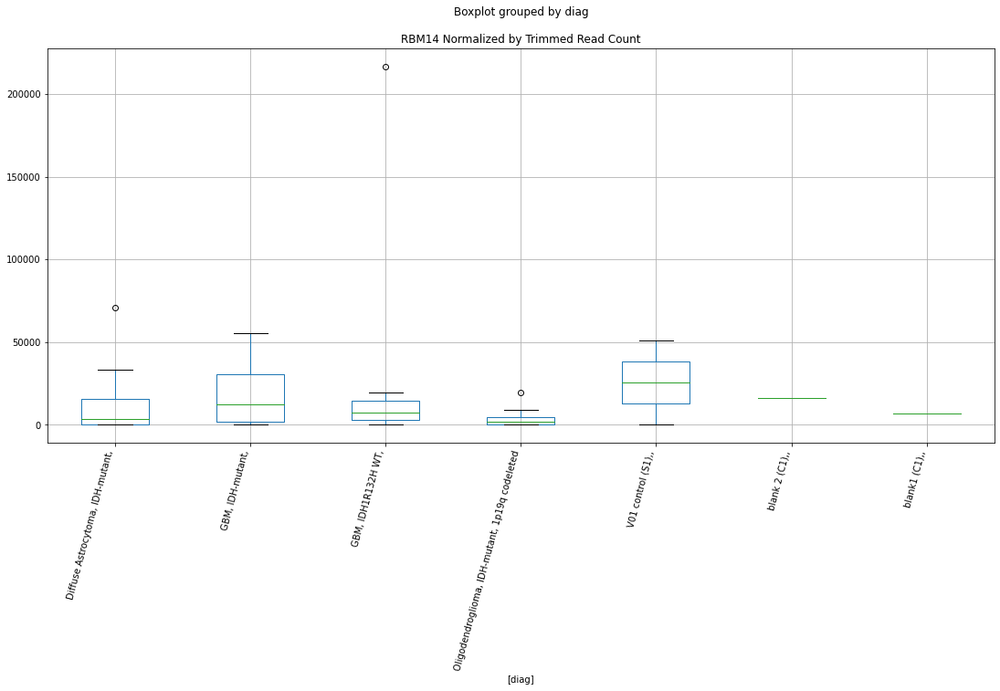

 p : 0.04779749117252852  ( t : 2.1238671843027186 ) :  D-plex  :  bbduk2  :  RRAGA
Control and blanks
73     773.01
337      0.00
Name: RRAGA, dtype: float64
205    1074.55
Name: RRAGA, dtype: float64
469    591.53
Name: RRAGA, dtype: float64


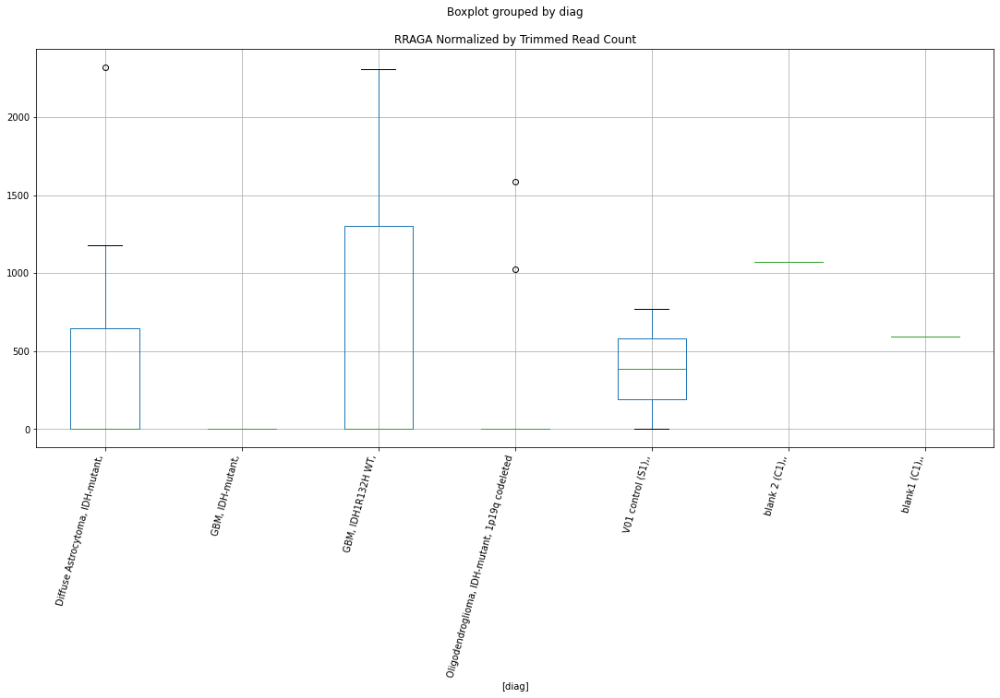

 p : 0.0478098558360714  ( t : 2.1237357081352792 ) :  Lexogen  :  bbduk2  :  PLAA
Control and blanks
79     0.0
343    0.0
Name: PLAA, dtype: float64
211    5466.13
Name: PLAA, dtype: float64
475    0.0
Name: PLAA, dtype: float64


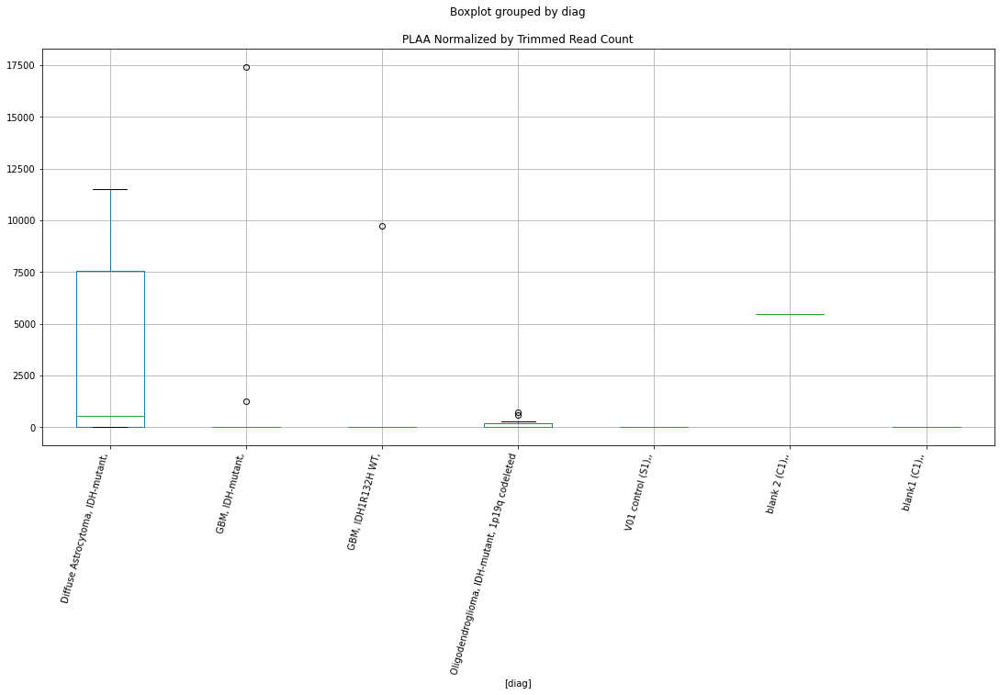

 p : 0.04786440192734009  ( t : 2.123156077191267 ) :  D-plex  :  bbduk2  :  PIP5KL1
Control and blanks
73     5411.06
337       0.00
Name: PIP5KL1, dtype: float64
205    3940.0
Name: PIP5KL1, dtype: float64
469    2957.64
Name: PIP5KL1, dtype: float64


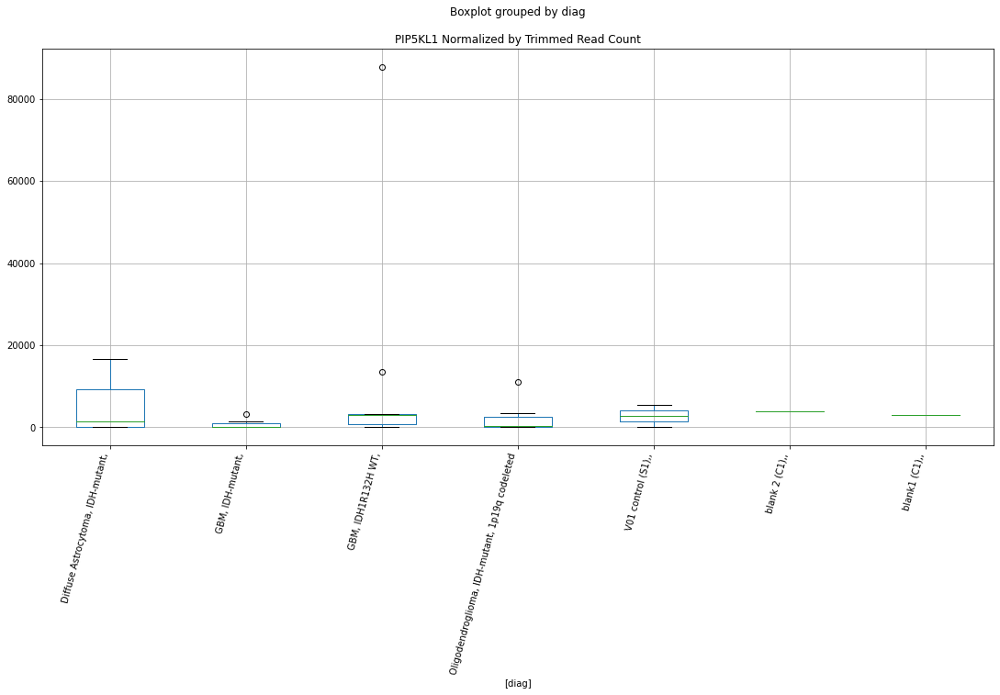

 p : 0.04792885045102489  ( t : 2.1224719937491194 ) :  D-plex  :  bbduk2  :  PROSER3
Control and blanks
73     0.0
337    0.0
Name: PROSER3, dtype: float64
205    358.18
Name: PROSER3, dtype: float64
469    6506.8
Name: PROSER3, dtype: float64


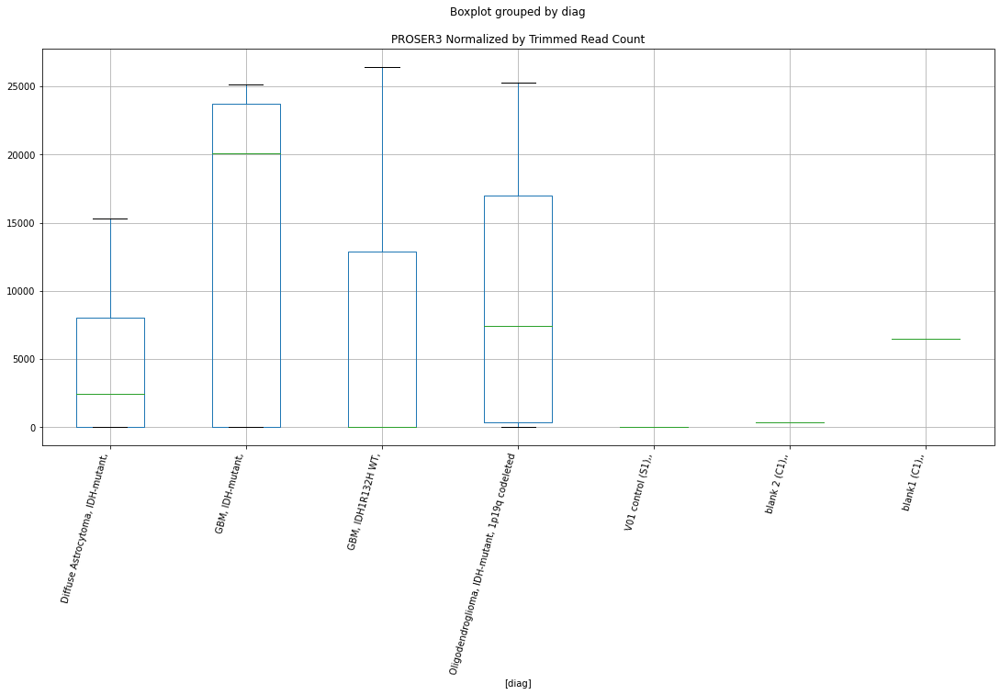

 p : 0.04801775358706523  ( t : 2.121529712949948 ) :  D-plex  :  bbduk2  :  RAB4B
Control and blanks
73     76527.83
337     8011.42
Name: RAB4B, dtype: float64
205    73606.38
Name: RAB4B, dtype: float64
469    49688.29
Name: RAB4B, dtype: float64


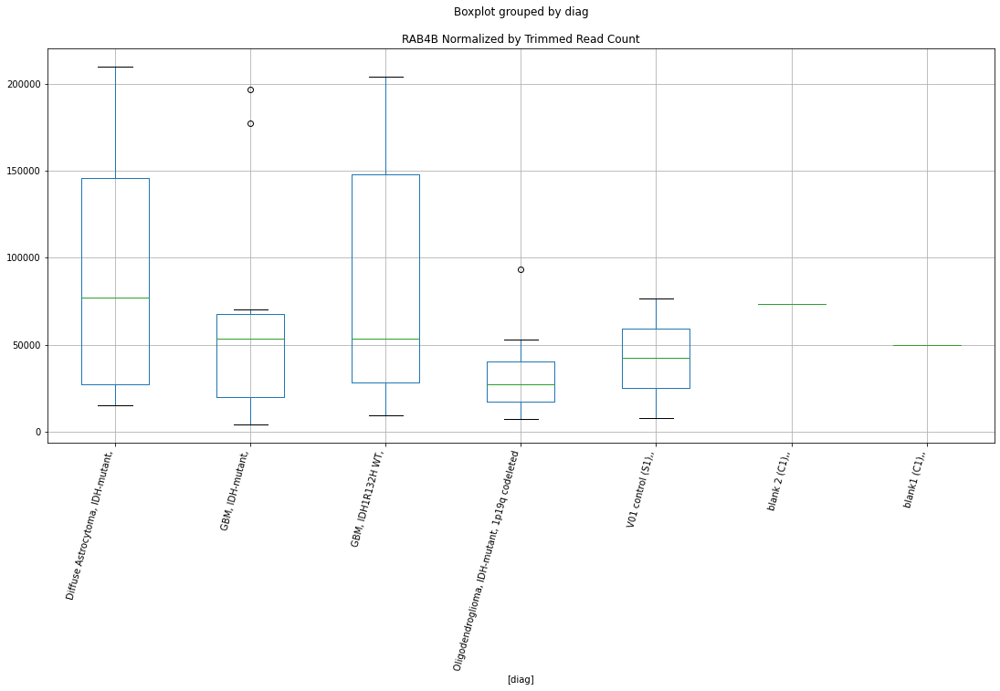

 p : 0.0480301434167563  ( t : 2.1213985198399934 ) :  D-plex  :  cutadapt2  :  RBM14
Control and blanks
76         0.00
340    50201.73
Name: RBM14, dtype: float64
208    16048.78
Name: RBM14, dtype: float64
472    6935.47
Name: RBM14, dtype: float64


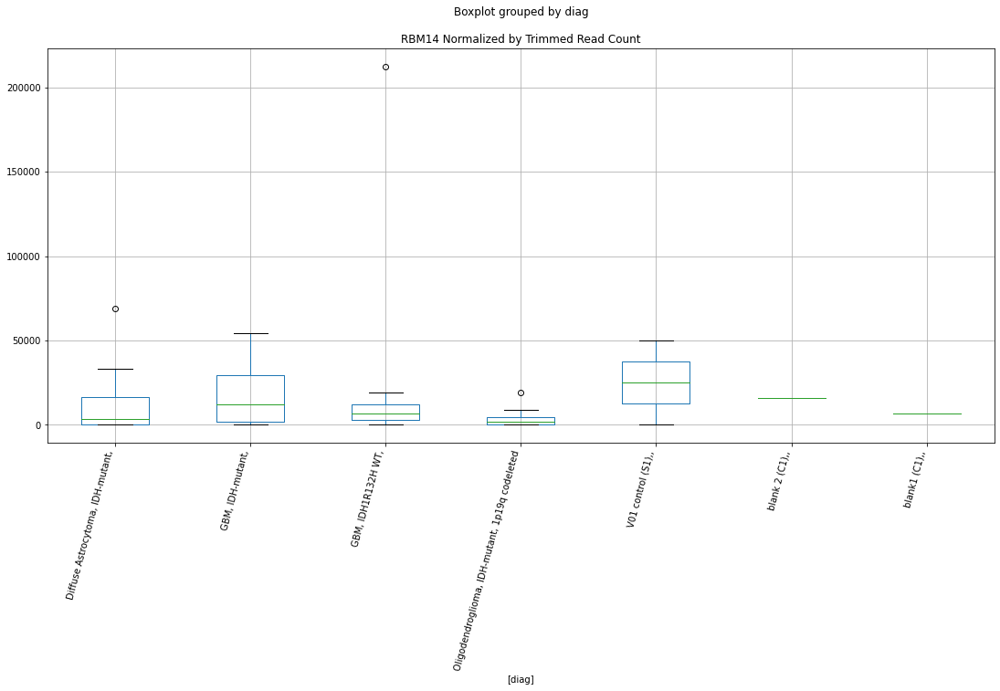

 p : 0.048159047415915576  ( t : 2.1200354102605012 ) :  D-plex  :  bbduk2  :  PLA2R1
Control and blanks
73     0.0
337    0.0
Name: PLA2R1, dtype: float64
205    17013.64
Name: PLA2R1, dtype: float64
469    4732.22
Name: PLA2R1, dtype: float64


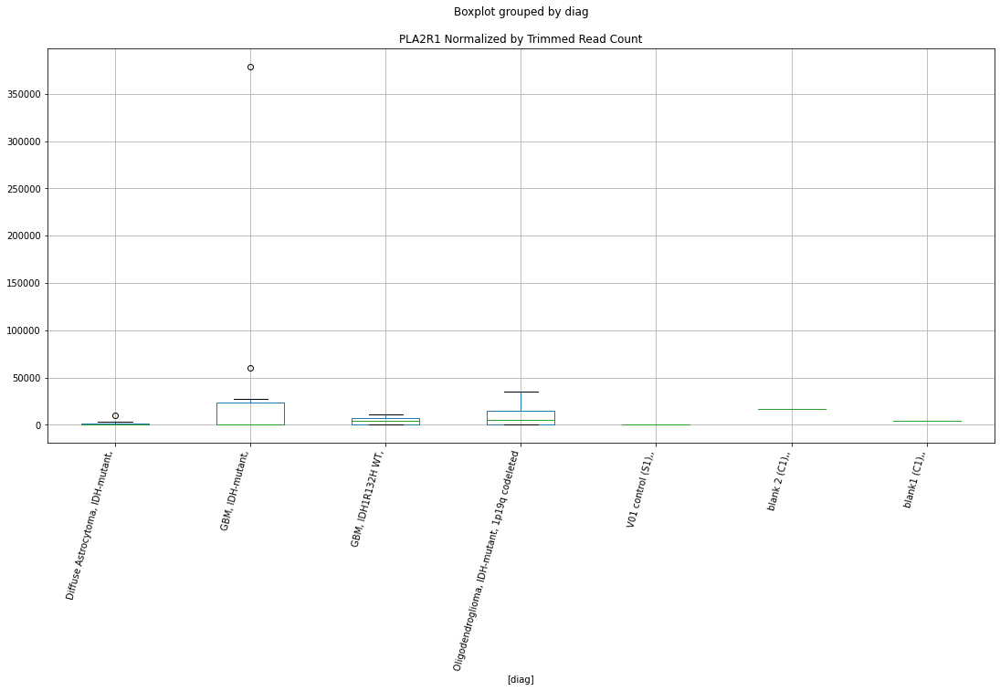

 p : 0.048330977625392256  ( t : 2.118222478068761 ) :  D-plex  :  bbduk2  :  PER2
Control and blanks
73     21644.24
337        0.00
Name: PER2, dtype: float64
205    5551.82
Name: PER2, dtype: float64
469    4732.22
Name: PER2, dtype: float64


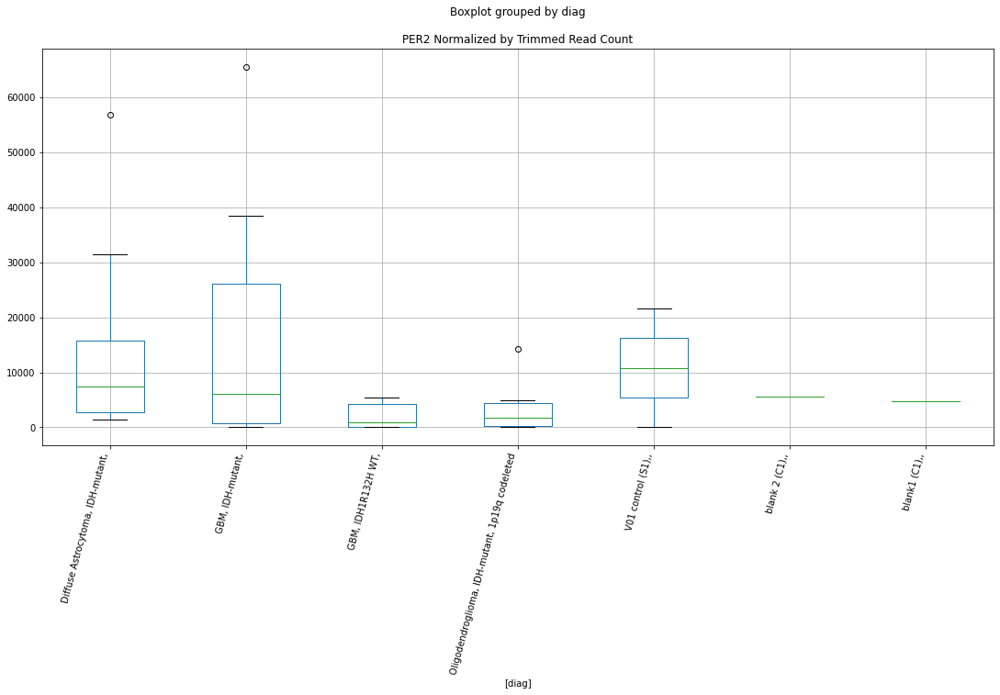

 p : 0.04834827076478915  ( t : 2.118040454361786 ) :  Lexogen  :  bbduk2  :  PCDHGA2
Control and blanks
79         0.00
343    16985.15
Name: PCDHGA2, dtype: float64
211    0.0
Name: PCDHGA2, dtype: float64
475    8622.57
Name: PCDHGA2, dtype: float64


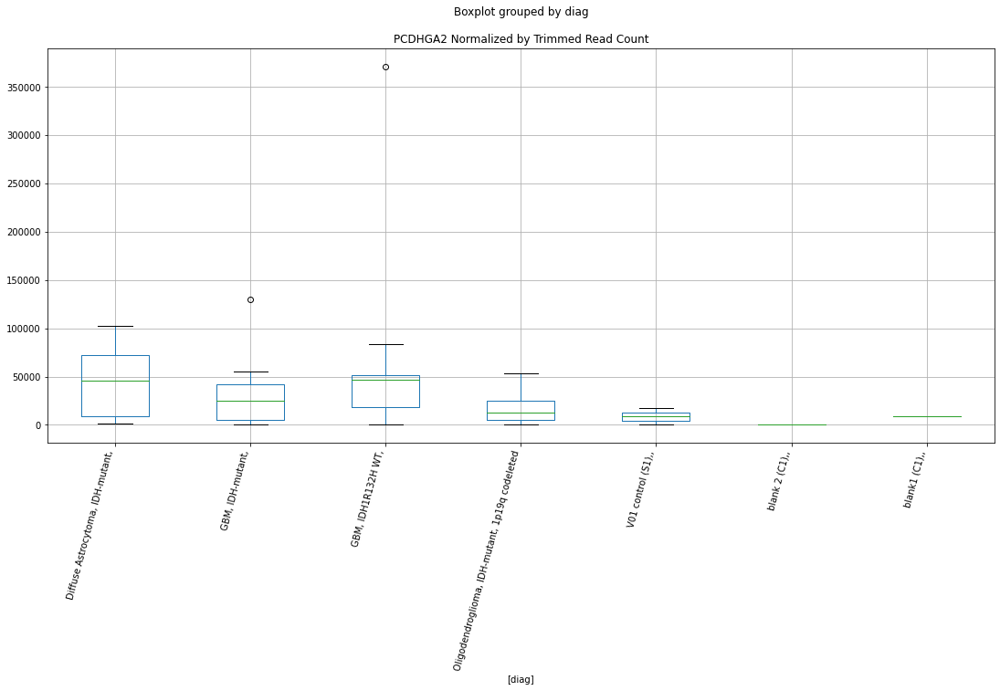

 p : 0.04844341065697098  ( t : 2.117040092226443 ) :  Lexogen  :  cutadapt2  :  PIAS2
Control and blanks
82     0.0
346    0.0
Name: PIAS2, dtype: float64
214    0.0
Name: PIAS2, dtype: float64
478    0.0
Name: PIAS2, dtype: float64


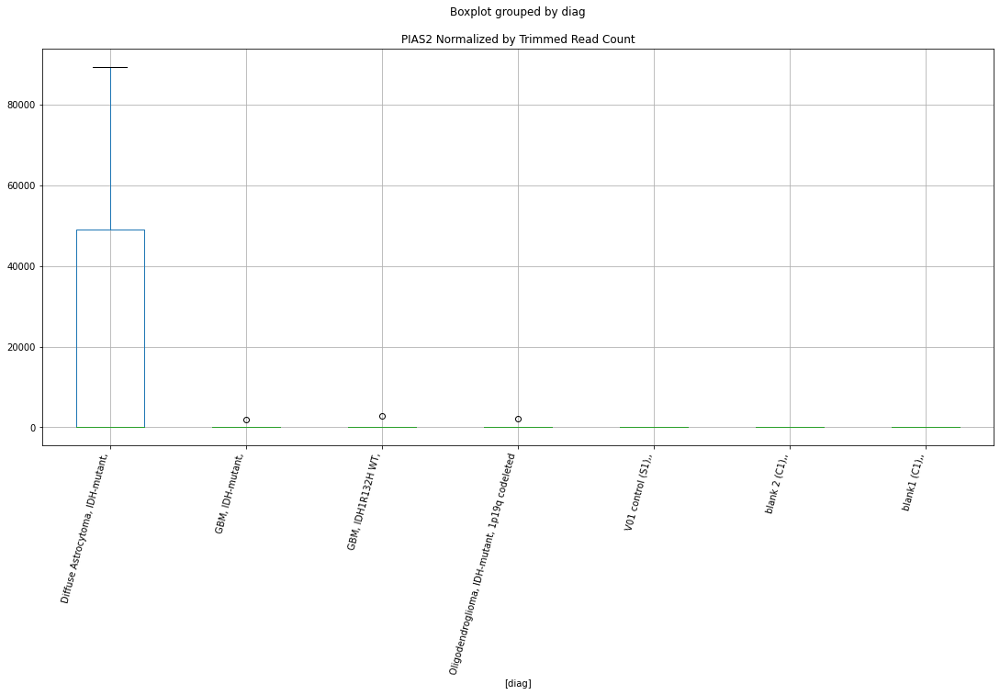

 p : 0.04846602813100277  ( t : 2.116802540732694 ) :  D-plex  :  bbduk2  :  RUVBL2
Control and blanks
73     0.0
337    0.0
Name: RUVBL2, dtype: float64
205    0.0
Name: RUVBL2, dtype: float64
469    591.53
Name: RUVBL2, dtype: float64


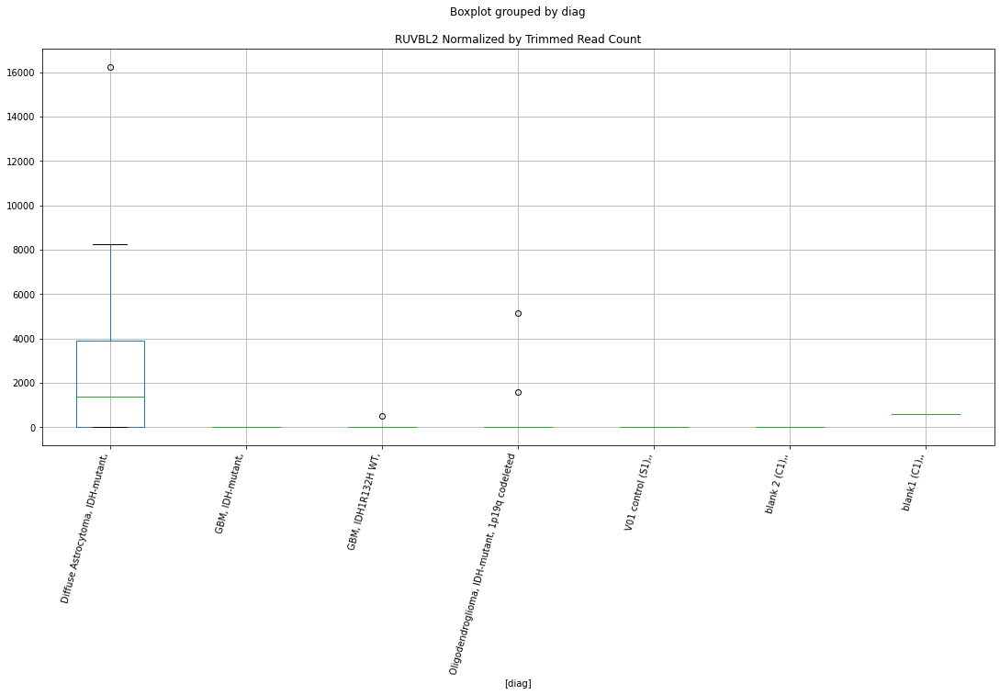

 p : 0.048471141499911136  ( t : 2.1167488489716257 ) :  Lexogen  :  cutadapt2  :  SLC11A2
Control and blanks
82     0.0
346    0.0
Name: SLC11A2, dtype: float64
214    0.0
Name: SLC11A2, dtype: float64
478    474.92
Name: SLC11A2, dtype: float64


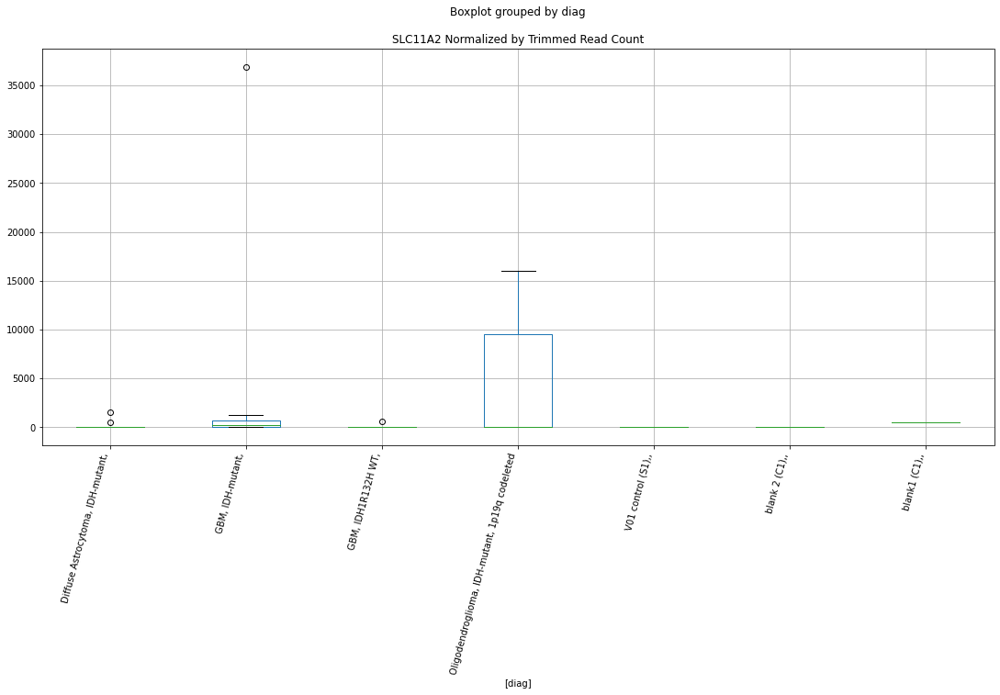

 p : 0.048476274071792294  ( t : 2.1166949607601104 ) :  Lexogen  :  cutadapt2  :  SLC8A3
Control and blanks
82        0.00
346    2104.35
Name: SLC8A3, dtype: float64
214    2712.26
Name: SLC8A3, dtype: float64
478    7123.81
Name: SLC8A3, dtype: float64


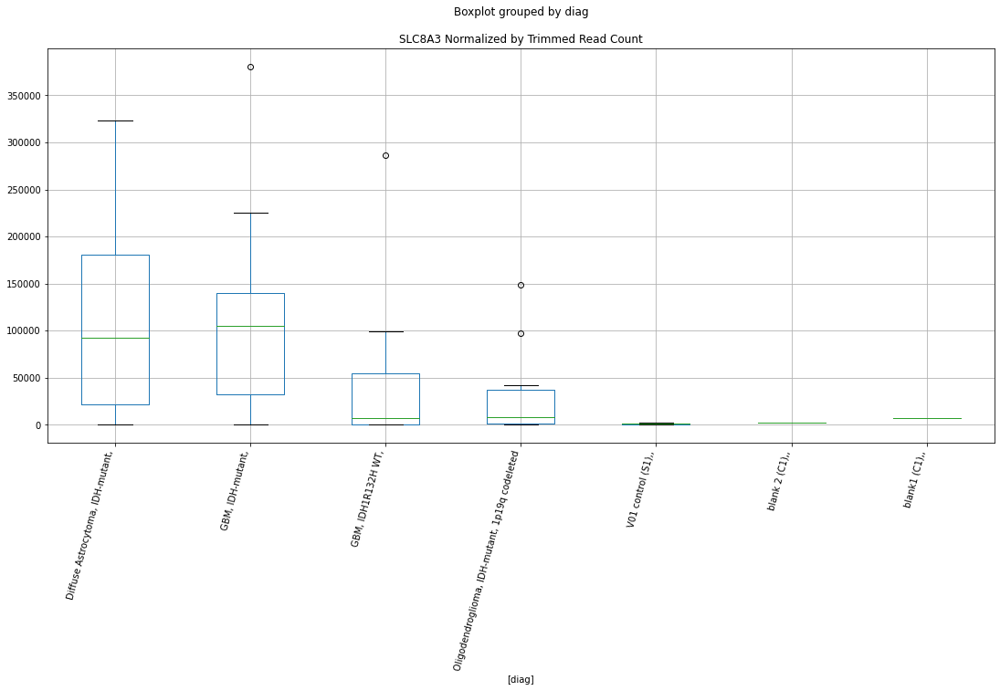

 p : 0.04853684254241681  ( t : 2.11605942863692 ) :  Lexogen  :  bbduk2  :  SLC11A2
Control and blanks
79     0.0
343    0.0
Name: SLC11A2, dtype: float64
211    0.0
Name: SLC11A2, dtype: float64
475    479.03
Name: SLC11A2, dtype: float64


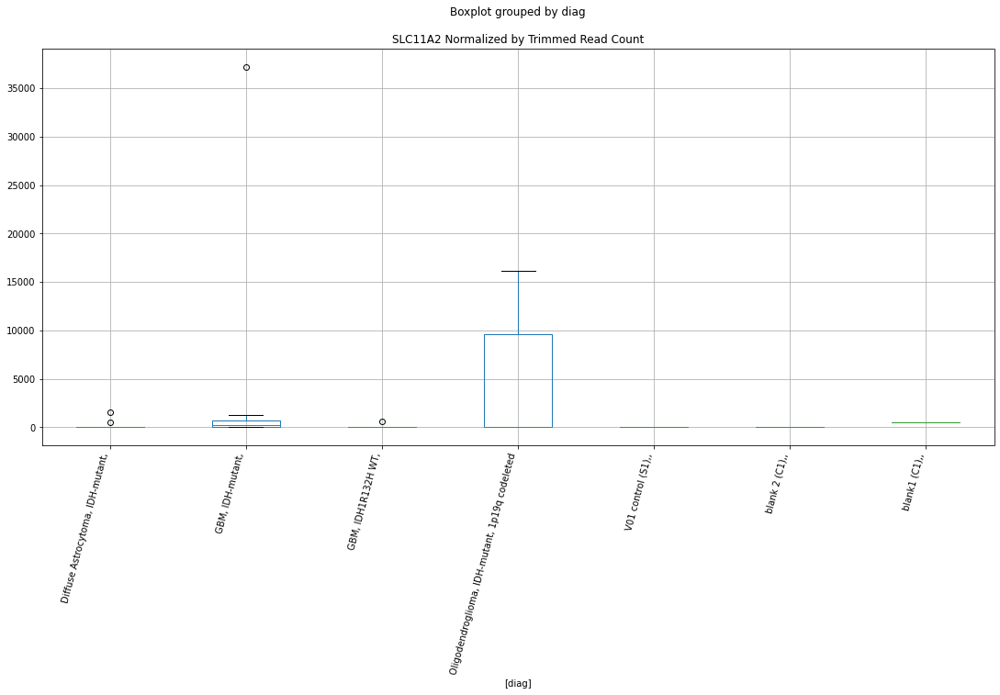

 p : 0.04854426802020631  ( t : 2.1159815643653577 ) :  D-plex  :  bbduk2  :  SEC14L3
Control and blanks
73     176245.92
337     80114.15
Name: SEC14L3, dtype: float64
205    289948.25
Name: SEC14L3, dtype: float64
469    167402.23
Name: SEC14L3, dtype: float64


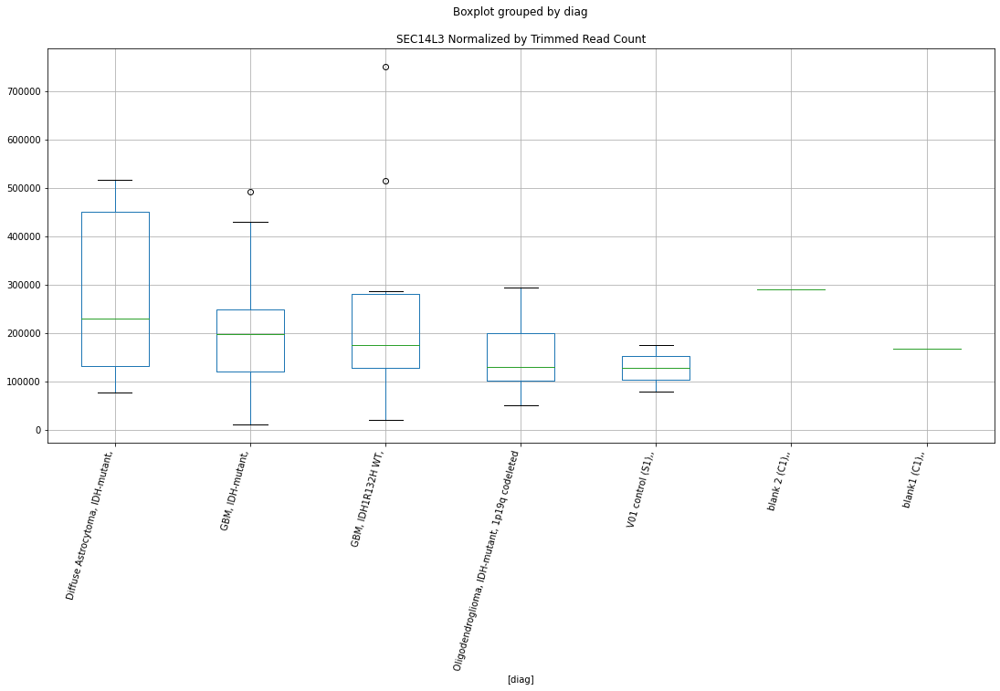

 p : 0.04855398609080039  ( t : 2.115879676126377 ) :  D-plex  :  bbduk2  :  PTCHD1
Control and blanks
73     58748.64
337        0.00
Name: PTCHD1, dtype: float64
205    2865.46
Name: PTCHD1, dtype: float64
469    8281.38
Name: PTCHD1, dtype: float64


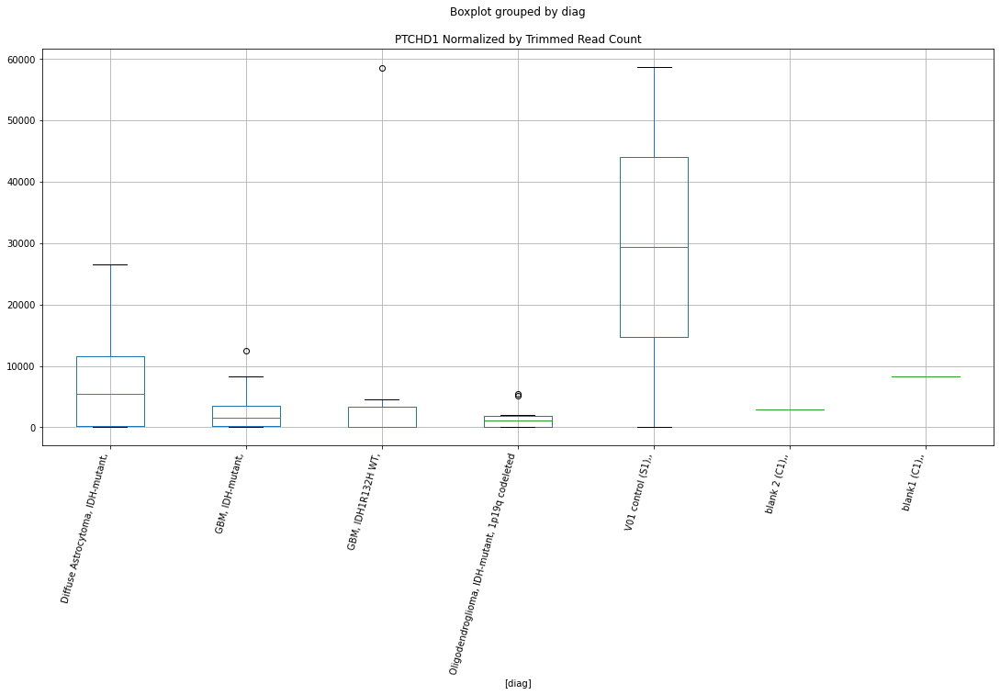

 p : 0.04863406609837787  ( t : 2.115040790572267 ) :  D-plex  :  bbduk2  :  PLK5
Control and blanks
73     773.01
337    890.16
Name: PLK5, dtype: float64
205    895.45
Name: PLK5, dtype: float64
469    2957.64
Name: PLK5, dtype: float64


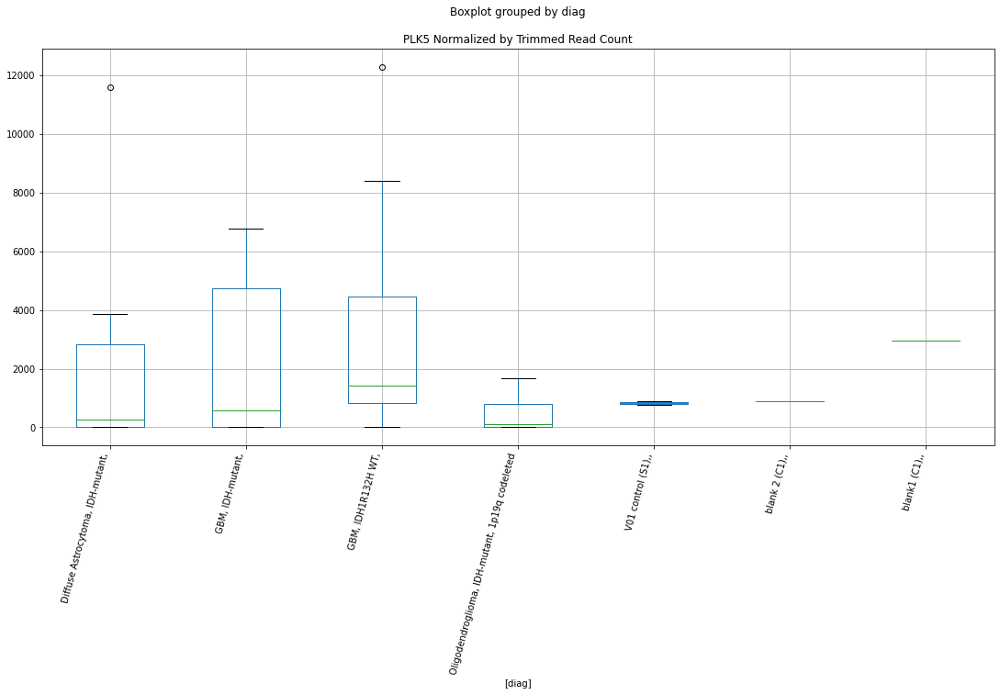

 p : 0.048678644382503335  ( t : 2.1145743512863953 ) :  Lexogen  :  cutadapt2  :  PIAS2
Control and blanks
82     0.0
346    0.0
Name: PIAS2, dtype: float64
214    0.0
Name: PIAS2, dtype: float64
478    0.0
Name: PIAS2, dtype: float64


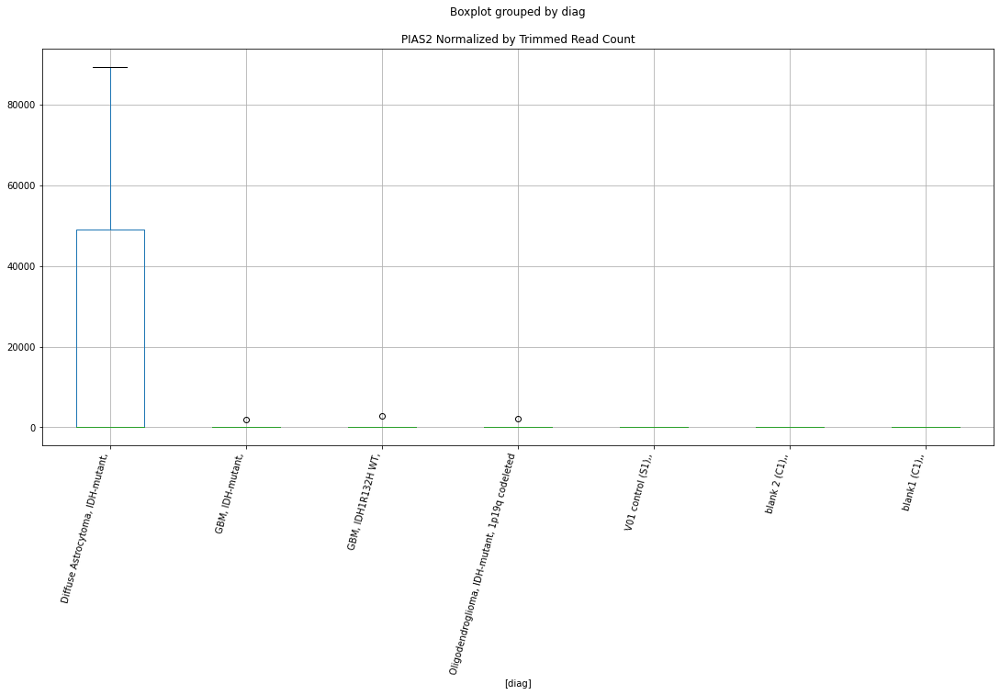

 p : 0.048715934252782686  ( t : 2.1141844719746983 ) :  D-plex  :  cutadapt2  :  SEC14L3
Control and blanks
76     171978.43
340     79265.89
Name: SEC14L3, dtype: float64
208    286408.99
Name: SEC14L3, dtype: float64
472    165873.33
Name: SEC14L3, dtype: float64


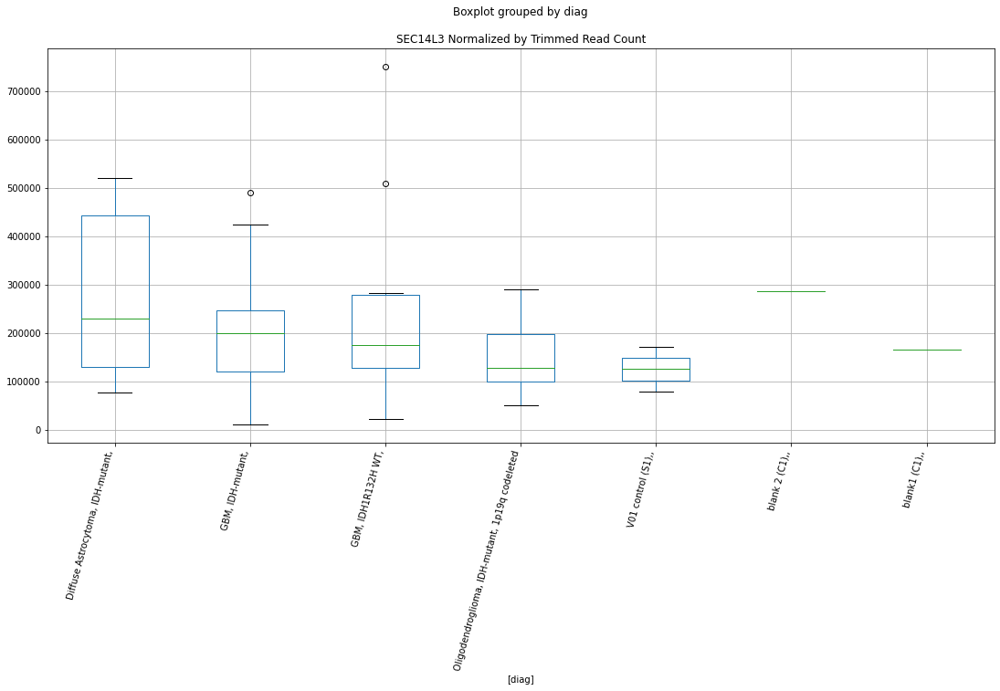

 p : 0.04875843008545901  ( t : 2.1137404934543387 ) :  D-plex  :  cutadapt2  :  PDE3A
Control and blanks
76     0.0
340    0.0
Name: PDE3A, dtype: float64
208    4938.09
Name: PDE3A, dtype: float64
472    9825.25
Name: PDE3A, dtype: float64


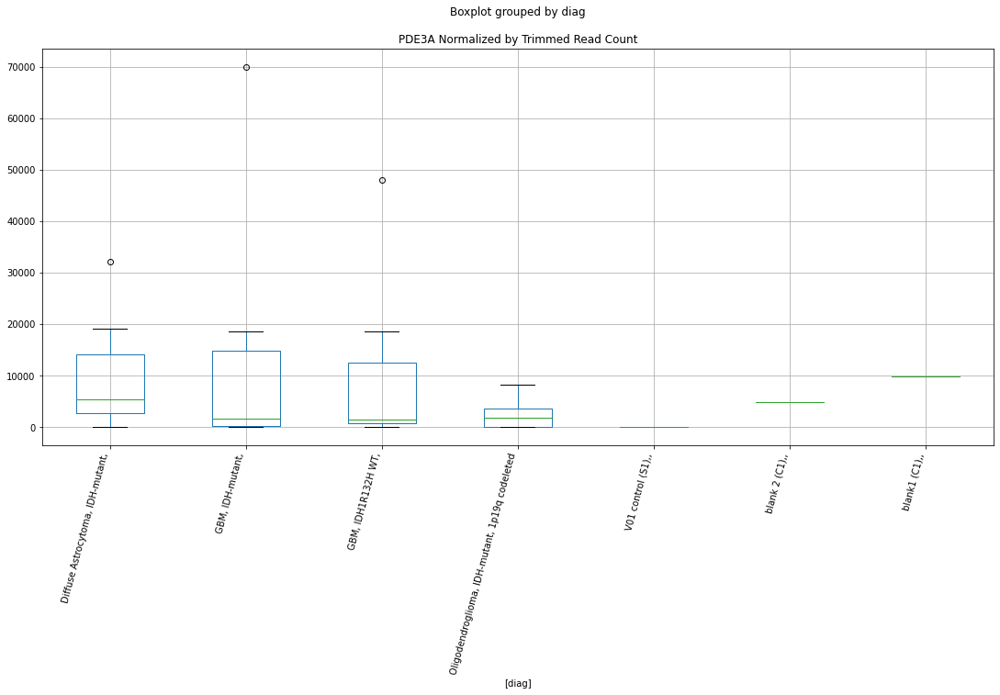

 p : 0.048801047381771365  ( t : 2.1132955995079783 ) :  D-plex  :  bbduk2  :  PLEKHA1
Control and blanks
73     0.0
337    0.0
Name: PLEKHA1, dtype: float64
205    9670.91
Name: PLEKHA1, dtype: float64
469    1774.58
Name: PLEKHA1, dtype: float64


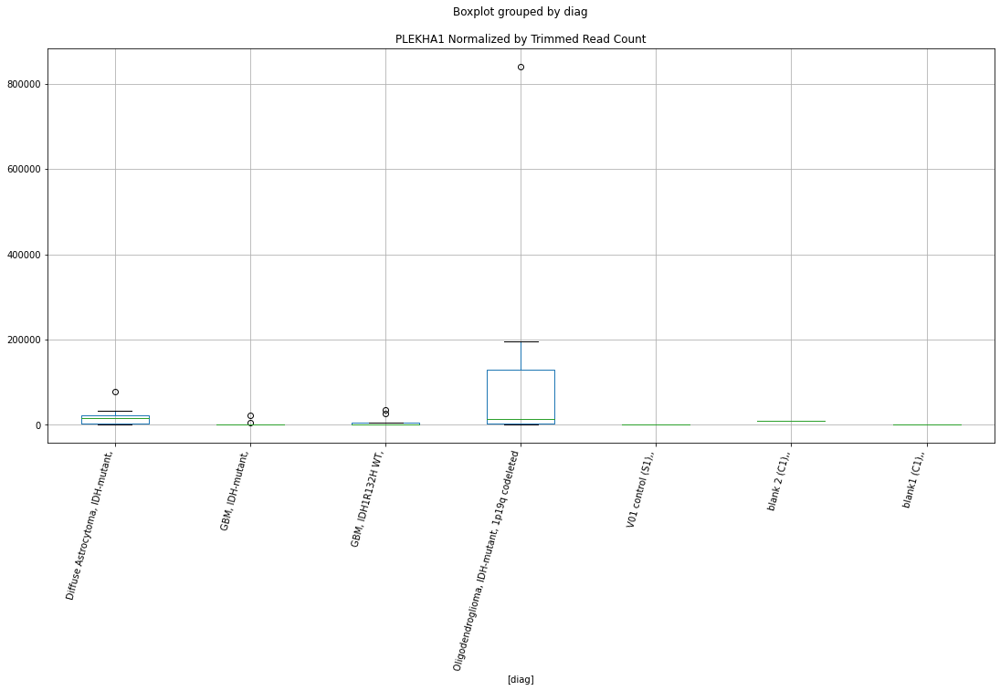

 p : 0.04884977003144747  ( t : 2.112787403082055 ) :  D-plex  :  cutadapt2  :  PEG3
Control and blanks
76     0.0
340    0.0
Name: PEG3, dtype: float64
208    34742.96
Name: PEG3, dtype: float64
472    15604.81
Name: PEG3, dtype: float64


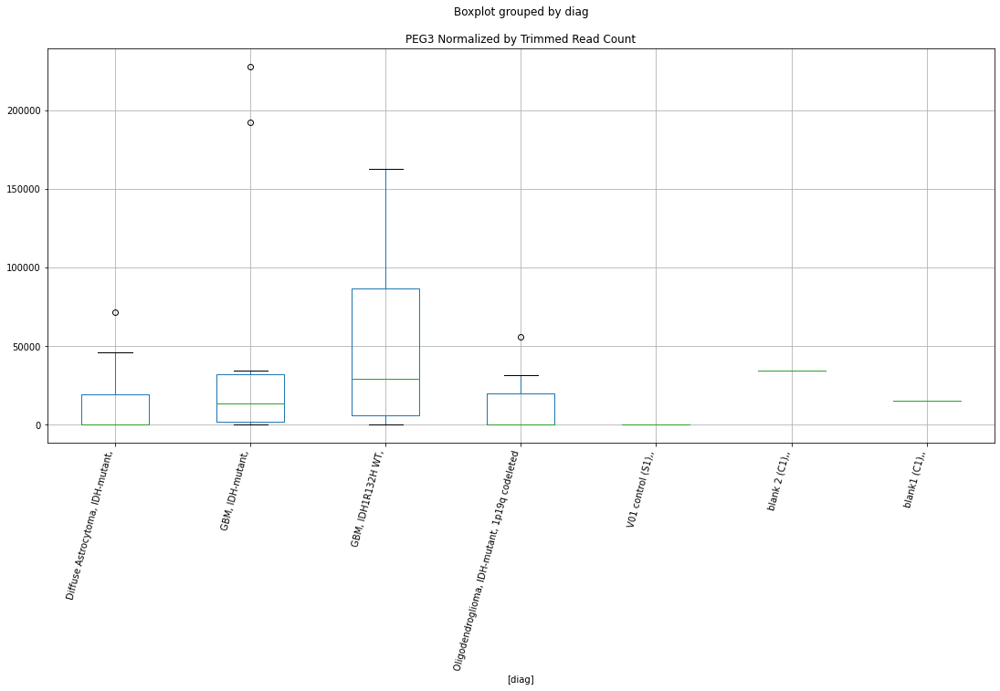

 p : 0.048867949972351325  ( t : 2.112597897310298 ) :  D-plex  :  bbduk2  :  SILC1
Control and blanks
73      773.01
337    2670.47
Name: SILC1, dtype: float64
205    2328.18
Name: SILC1, dtype: float64
469    7689.86
Name: SILC1, dtype: float64


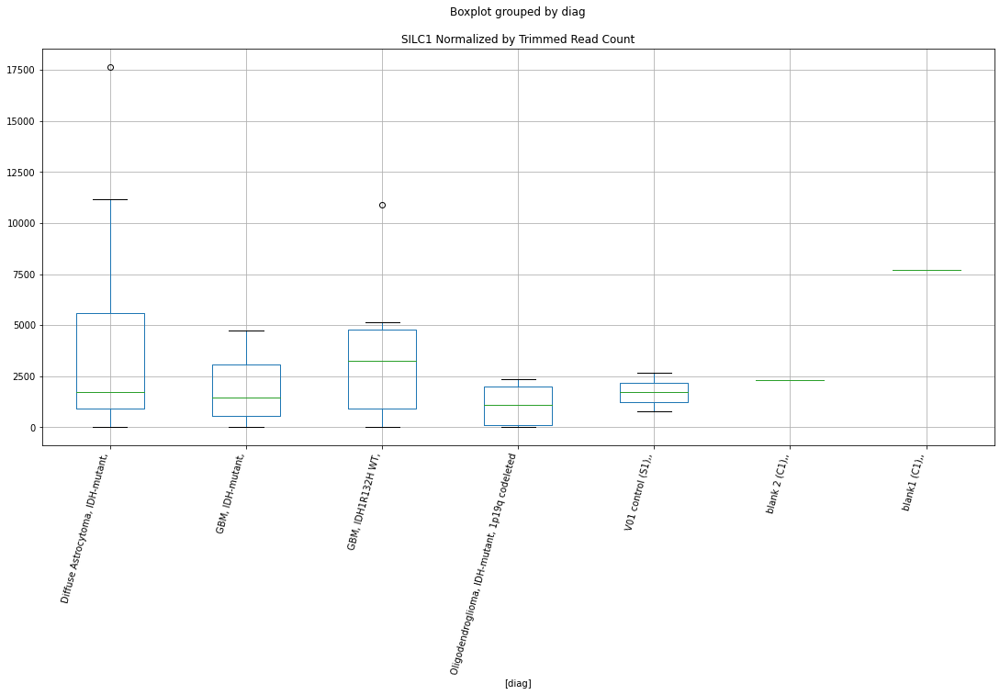

 p : 0.04890230650526393  ( t : 2.1122399435926686 ) :  D-plex  :  bbduk2  :  OSGIN2
Control and blanks
73     4638.05
337       0.00
Name: OSGIN2, dtype: float64
205    8596.37
Name: OSGIN2, dtype: float64
469    191654.85
Name: OSGIN2, dtype: float64


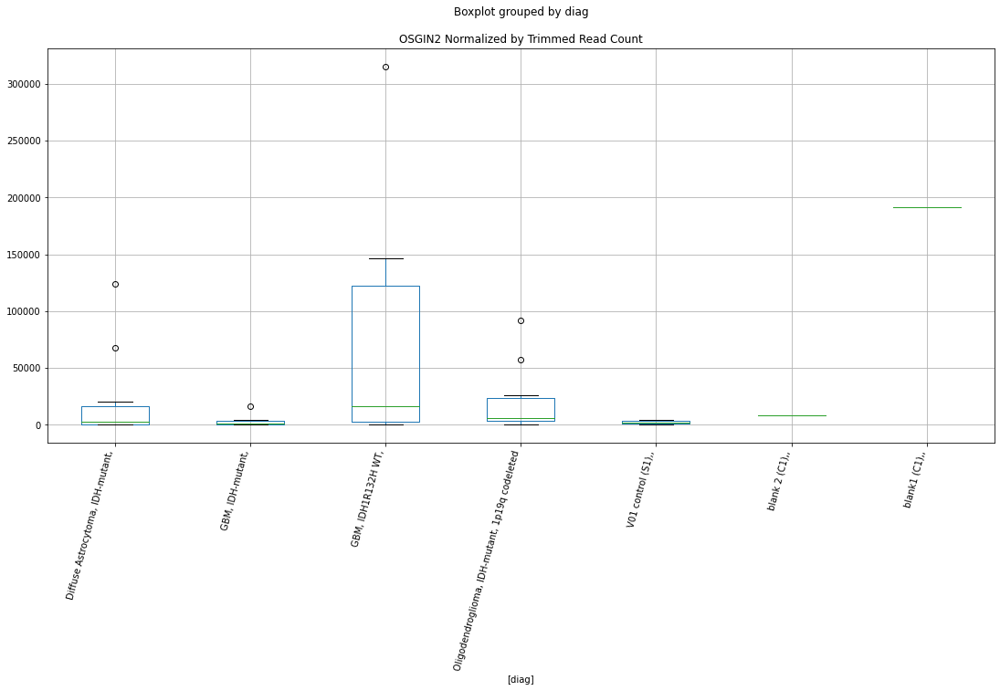

 p : 0.04891760415483644  ( t : 2.1120806341316296 ) :  D-plex  :  bbduk2  :  SLC7A5
Control and blanks
73     0.0
337    0.0
Name: SLC7A5, dtype: float64
205    1253.64
Name: SLC7A5, dtype: float64
469    2366.11
Name: SLC7A5, dtype: float64


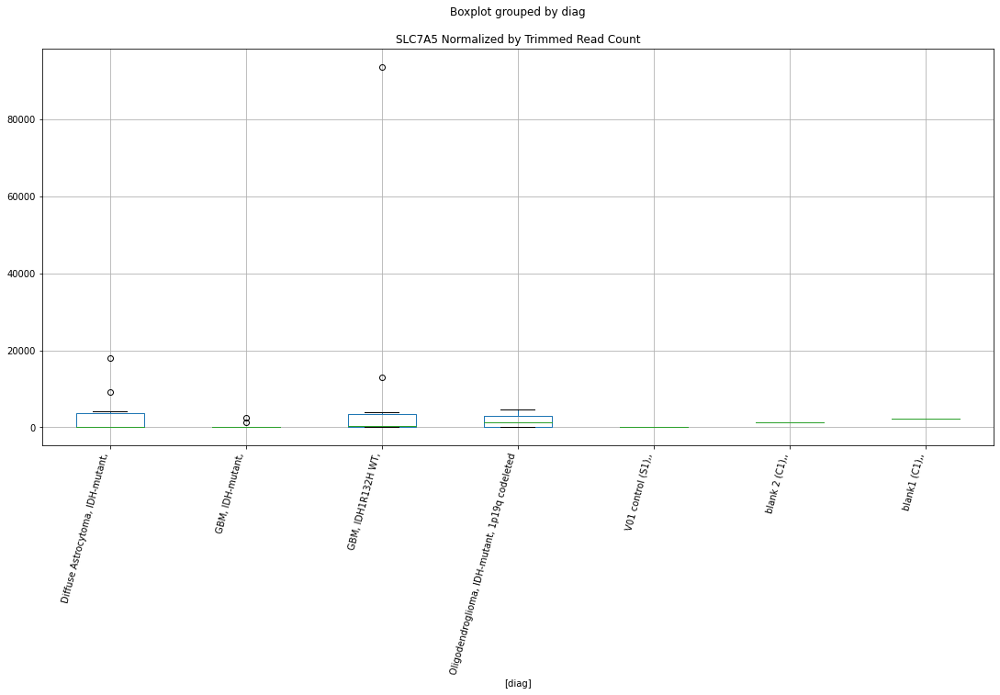

 p : 0.04896642809940324  ( t : 2.1115724854895124 ) :  Lexogen  :  cutadapt2  :  SLC6A20
Control and blanks
82     0.0
346    0.0
Name: SLC6A20, dtype: float64
214    0.0
Name: SLC6A20, dtype: float64
478    0.0
Name: SLC6A20, dtype: float64


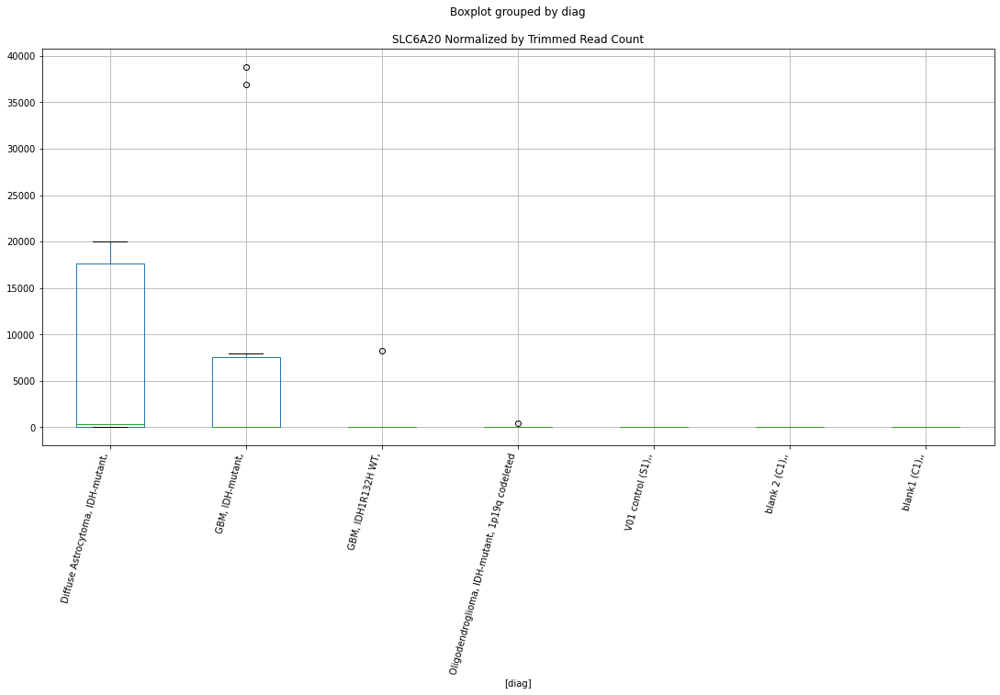

 p : 0.049009990052017484  ( t : 2.111119491530794 ) :  D-plex  :  cutadapt2  :  RPS6KB1
Control and blanks
76     0.0
340    0.0
Name: RPS6KB1, dtype: float64
208    22045.03
Name: RPS6KB1, dtype: float64
472    43924.64
Name: RPS6KB1, dtype: float64


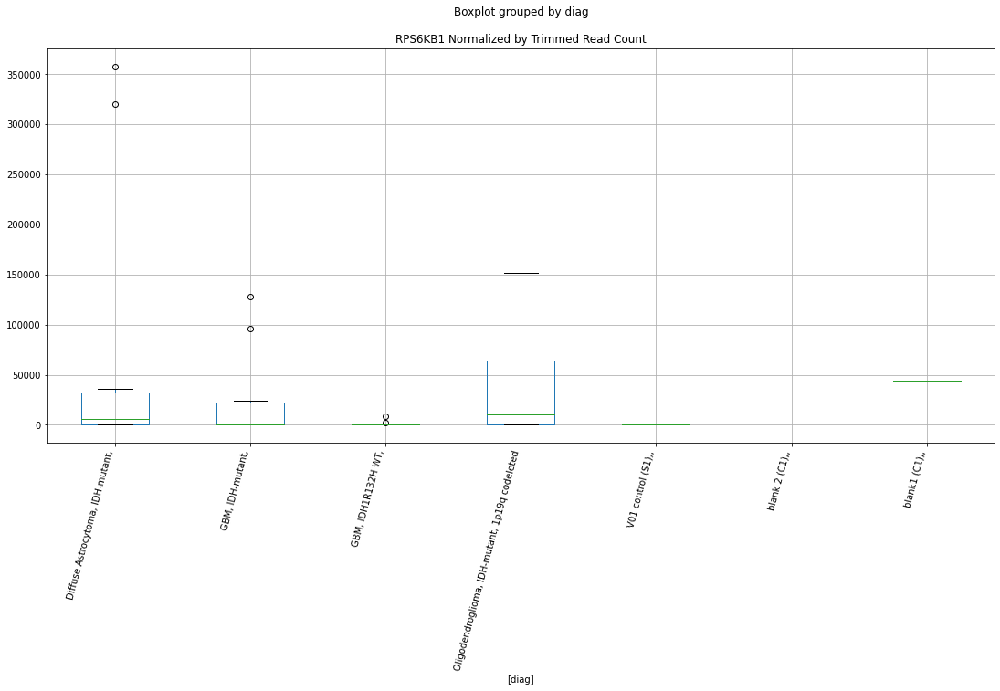

 p : 0.049045431609895114  ( t : 2.1107512105092505 ) :  Lexogen  :  bbduk2  :  PIAS2
Control and blanks
79     0.0
343    0.0
Name: PIAS2, dtype: float64
211    0.0
Name: PIAS2, dtype: float64
475    239.52
Name: PIAS2, dtype: float64


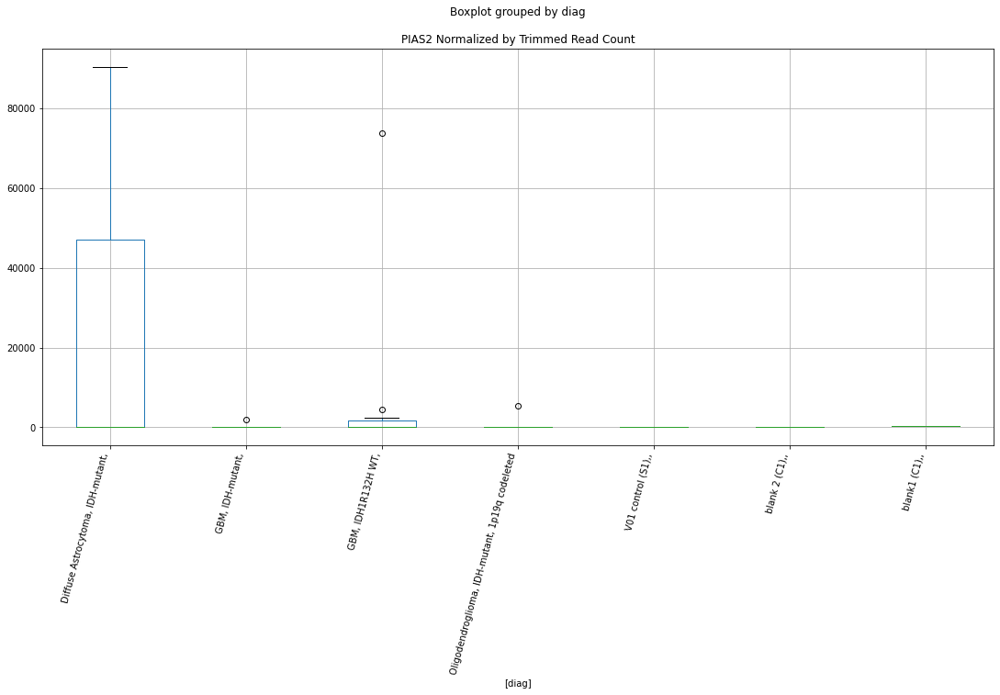

 p : 0.04928545356549034  ( t : 2.108263443201643 ) :  Lexogen  :  cutadapt2  :  RNY5
Control and blanks
82         0.00
346    16834.76
Name: RNY5, dtype: float64
214    0.0
Name: RNY5, dtype: float64
478    0.0
Name: RNY5, dtype: float64


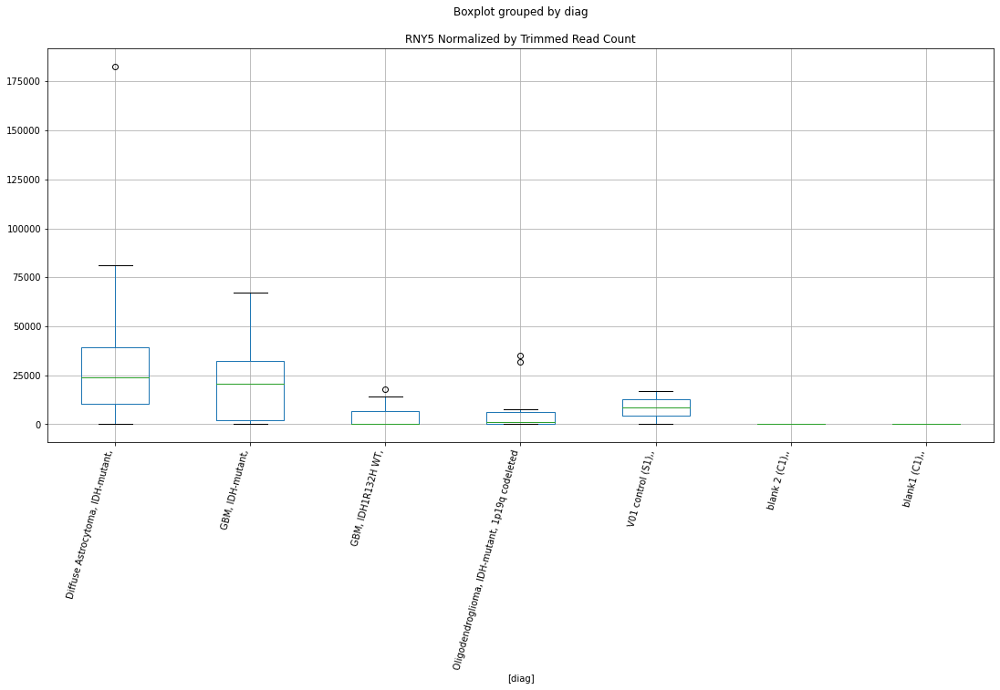

 p : 0.04932613449318985  ( t : 2.107842888332834 ) :  D-plex  :  cutadapt2  :  RNA5-8SN4
Control and blanks
76      6818.53
340    28183.43
Name: RNA5-8SN4, dtype: float64
208    15696.06
Name: RNA5-8SN4, dtype: float64
472    24852.1
Name: RNA5-8SN4, dtype: float64


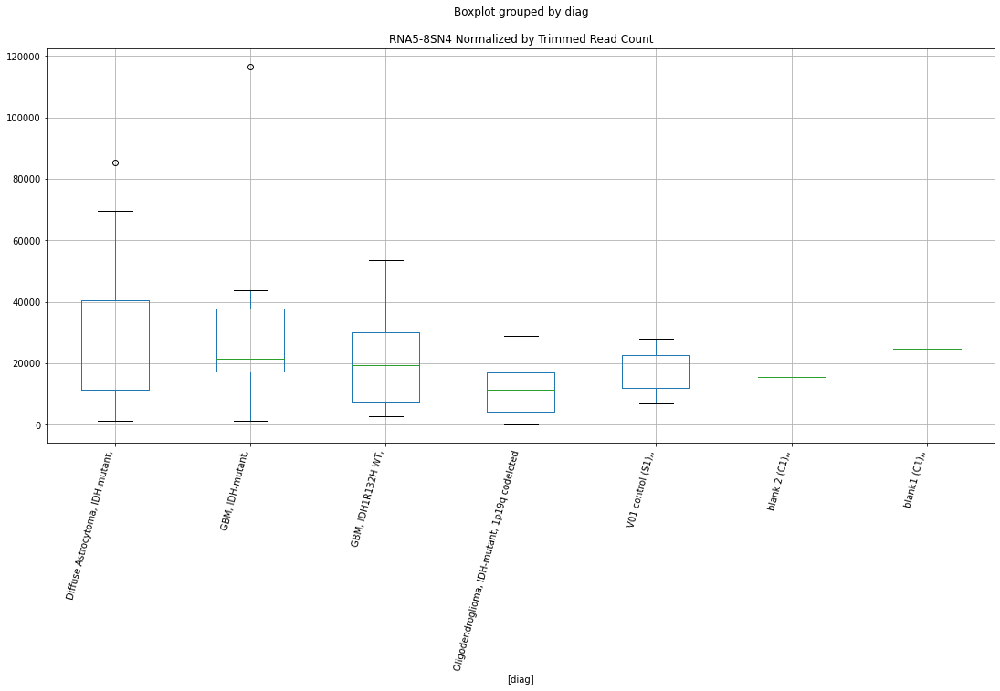

 p : 0.049343978472455634  ( t : 2.1076585188127313 ) :  Lexogen  :  cutadapt2  :  PIAS2
Control and blanks
82     0.0
346    0.0
Name: PIAS2, dtype: float64
214    0.0
Name: PIAS2, dtype: float64
478    0.0
Name: PIAS2, dtype: float64


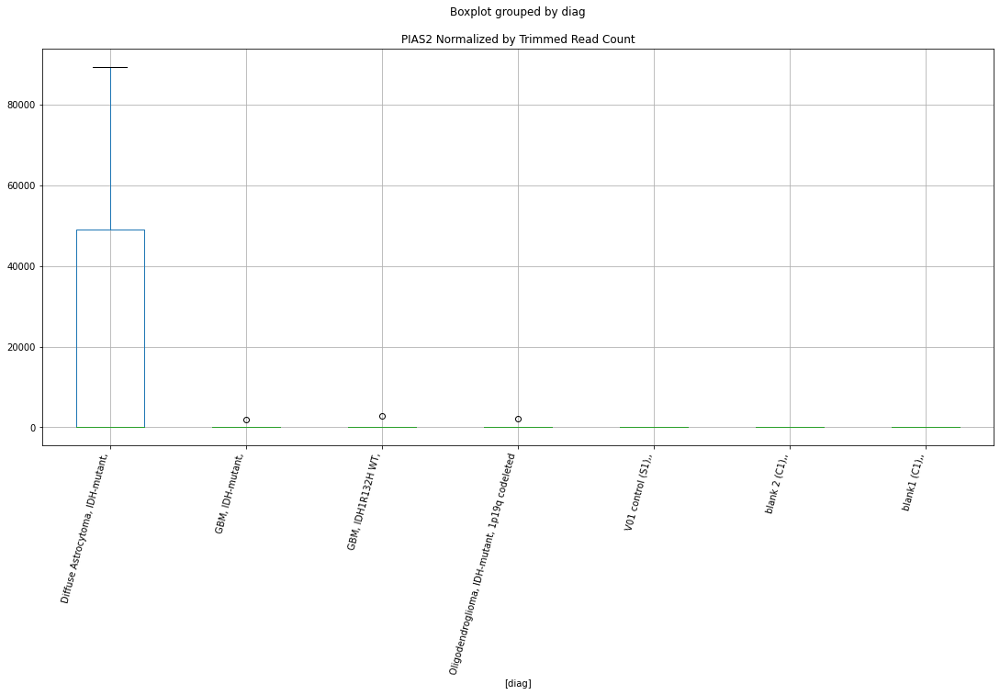

 p : 0.0493784383652105  ( t : 2.107302640106597 ) :  D-plex  :  cutadapt2  :  RBM26
Control and blanks
76     44699.24
340        0.00
Name: RBM26, dtype: float64
208    72484.05
Name: RBM26, dtype: float64
472    16182.76
Name: RBM26, dtype: float64


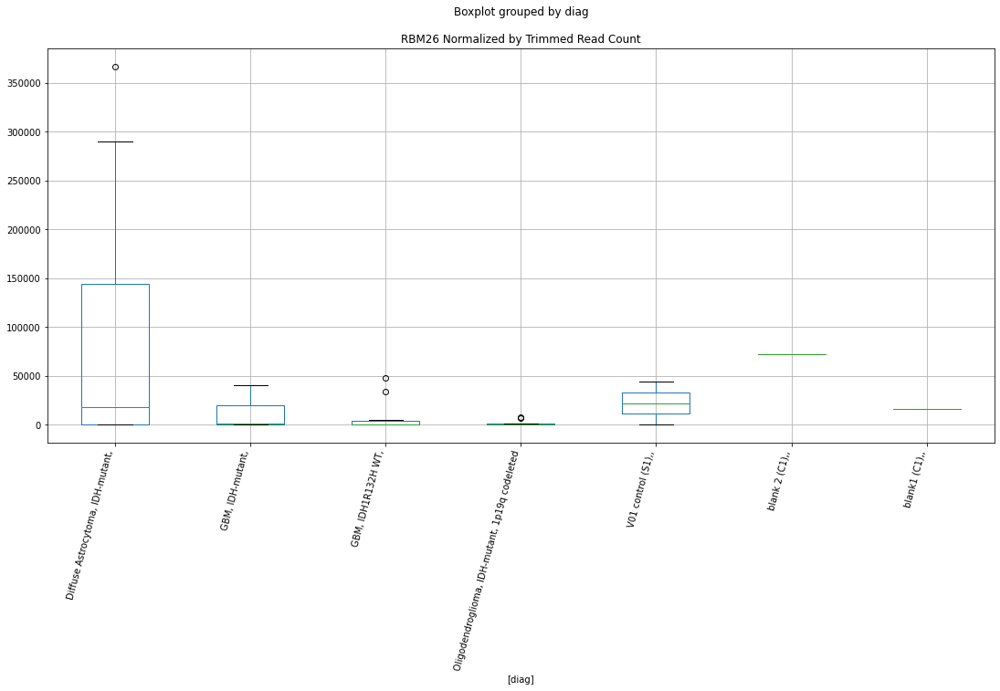

 p : 0.049379317412418376  ( t : 2.1072935648505444 ) :  D-plex  :  bbduk2  :  SLC35F5
Control and blanks
73     0.0
337    0.0
Name: SLC35F5, dtype: float64
205    8954.55
Name: SLC35F5, dtype: float64
469    41998.44
Name: SLC35F5, dtype: float64


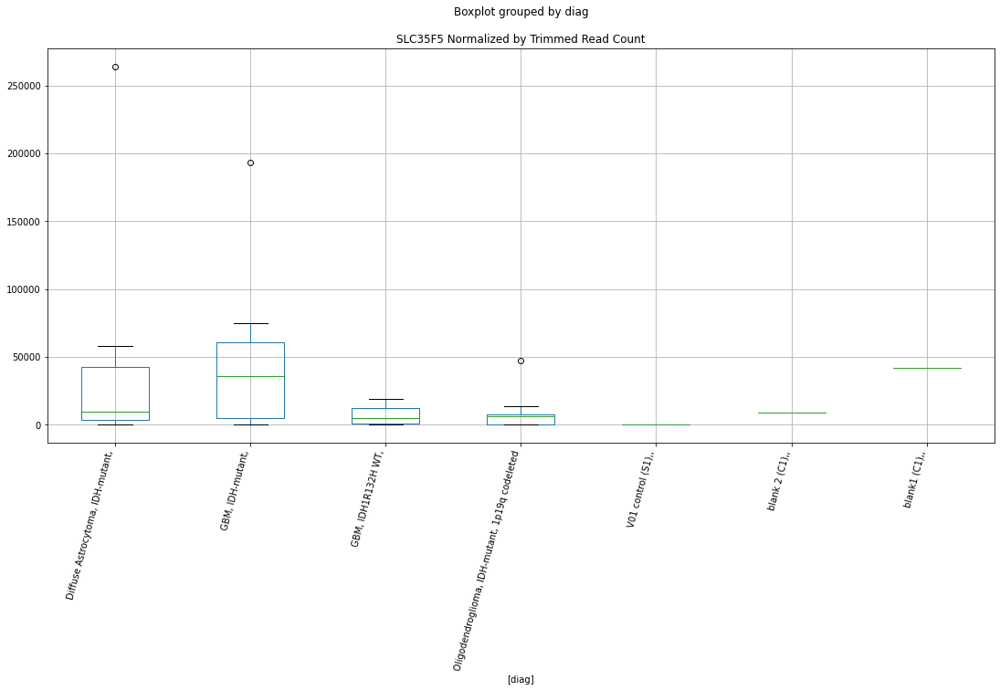

 p : 0.04938466230358931  ( t : 2.107238387523063 ) :  D-plex  :  cutadapt2  :  PDGFB
Control and blanks
76         0.00
340    26421.96
Name: PDGFB, dtype: float64
208    1939.96
Name: PDGFB, dtype: float64
472    577.96
Name: PDGFB, dtype: float64


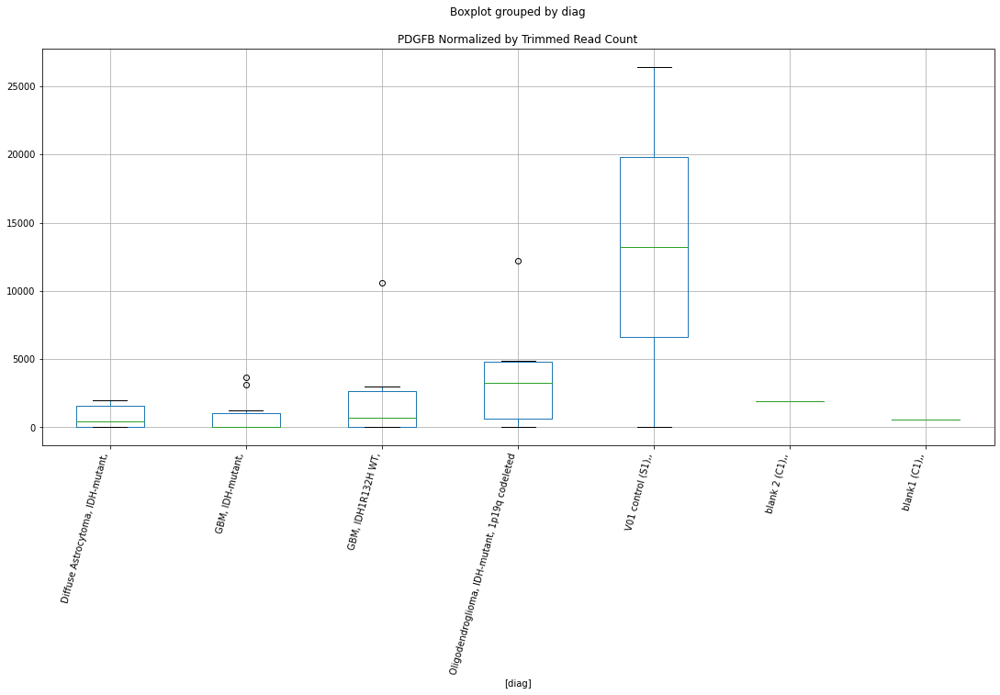

 p : 0.04939284942567636  ( t : 2.107153879305179 ) :  D-plex  :  bbduk2  :  ORAI3
Control and blanks
73     0.0
337    0.0
Name: ORAI3, dtype: float64
205    537.27
Name: ORAI3, dtype: float64
469    0.0
Name: ORAI3, dtype: float64


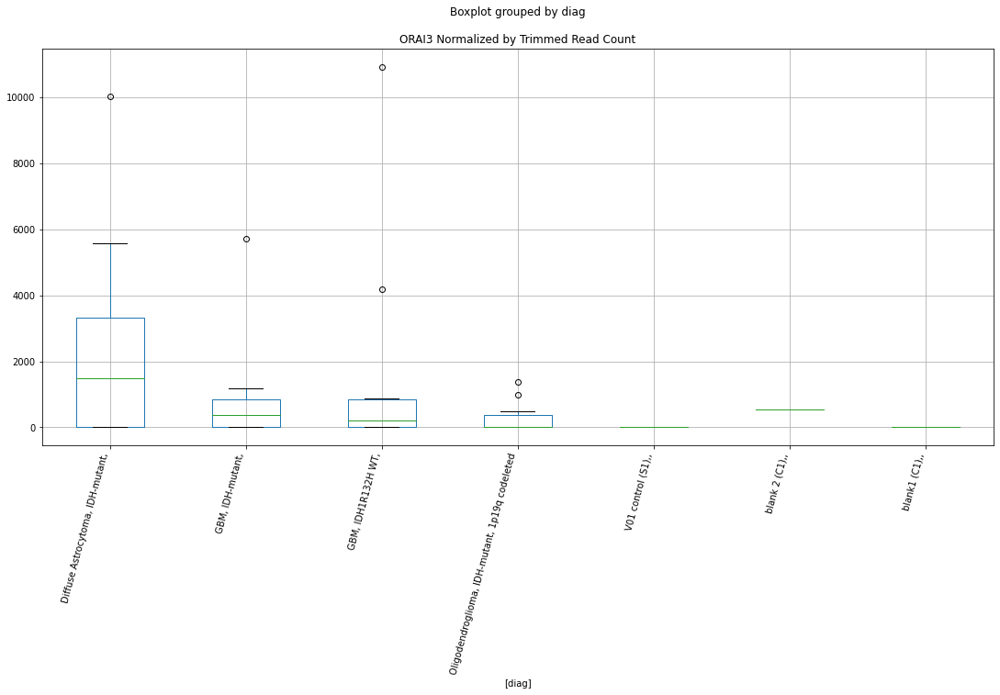

 p : 0.04946255068241494  ( t : 2.1064349320962674 ) :  Lexogen  :  bbduk2  :  SLC6A20
Control and blanks
79     0.0
343    0.0
Name: SLC6A20, dtype: float64
211    0.0
Name: SLC6A20, dtype: float64
475    0.0
Name: SLC6A20, dtype: float64


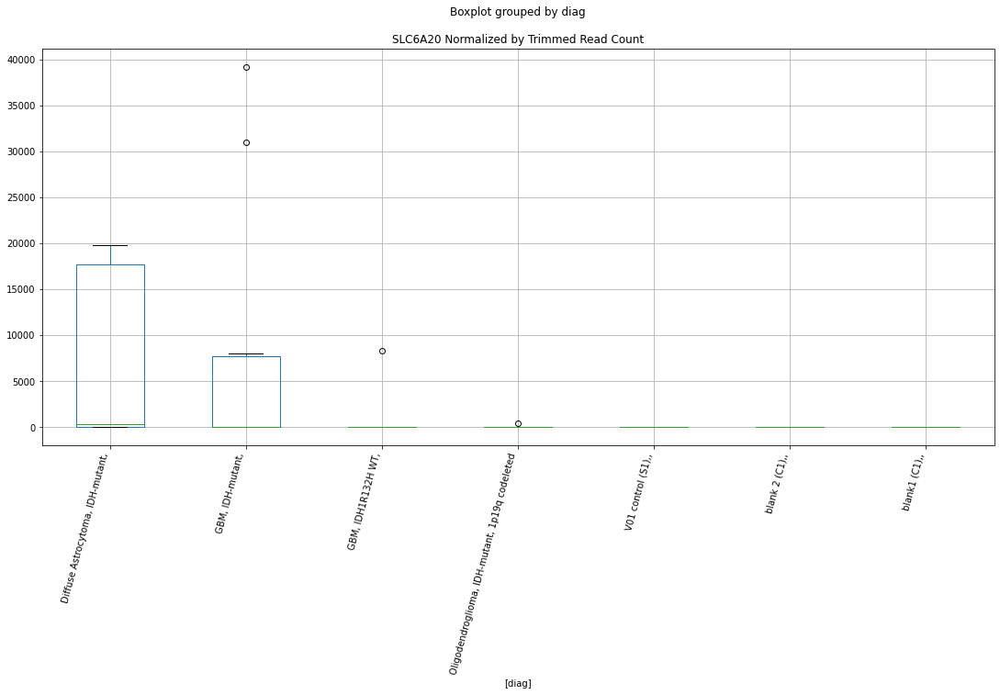

 p : 0.049543790516800974  ( t : 2.105598129886252 ) :  Lexogen  :  bbduk2  :  RNY5
Control and blanks
79         0.00
343    16560.52
Name: RNY5, dtype: float64
211    0.0
Name: RNY5, dtype: float64
475    0.0
Name: RNY5, dtype: float64


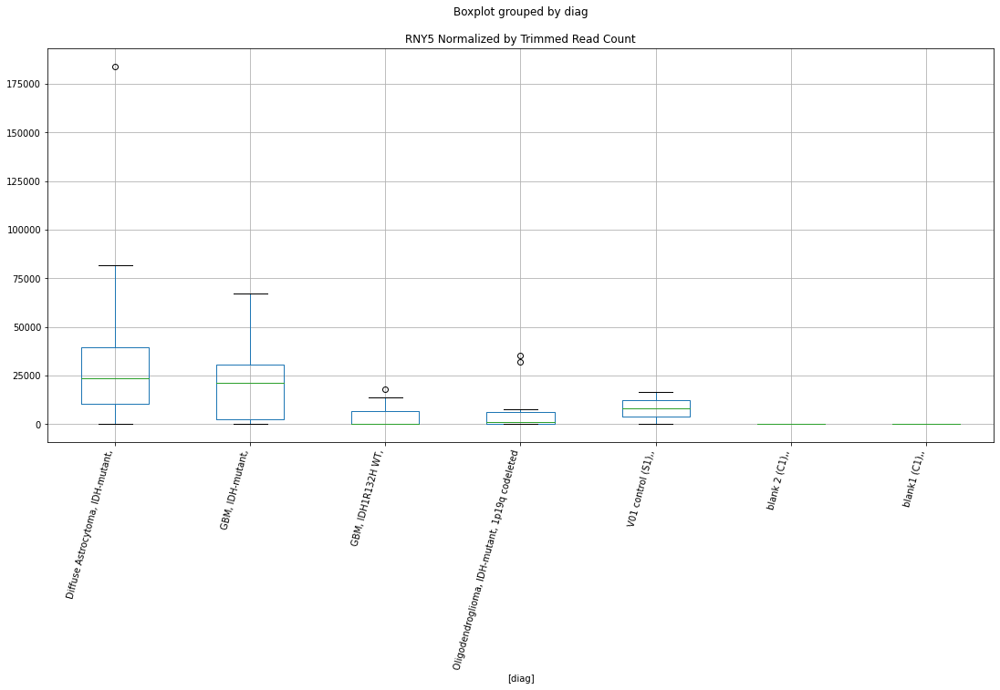

 p : 0.049548806662010864  ( t : 2.1055465025326416 ) :  Lexogen  :  cutadapt2  :  PJA1
Control and blanks
82     0.0
346    0.0
Name: PJA1, dtype: float64
214    1356.13
Name: PJA1, dtype: float64
478    0.0
Name: PJA1, dtype: float64


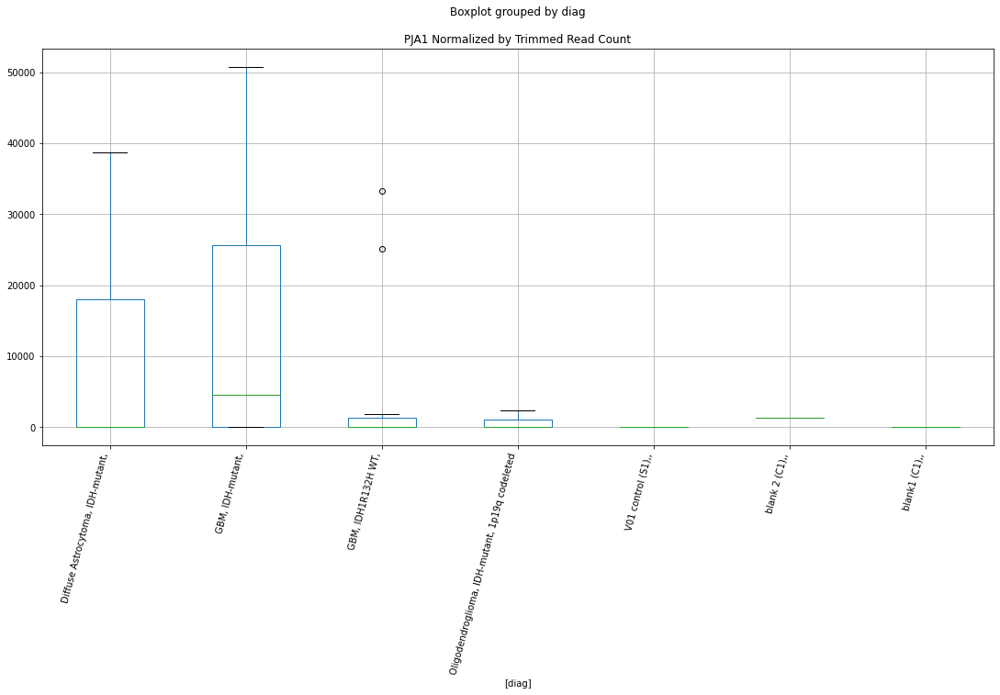

 p : 0.049666037008486985  ( t : 2.1043412915354427 ) :  D-plex  :  cutadapt2  :  PER2
Control and blanks
76     18940.36
340     2642.20
Name: PER2, dtype: float64
208    5996.25
Name: PER2, dtype: float64
472    4045.69
Name: PER2, dtype: float64


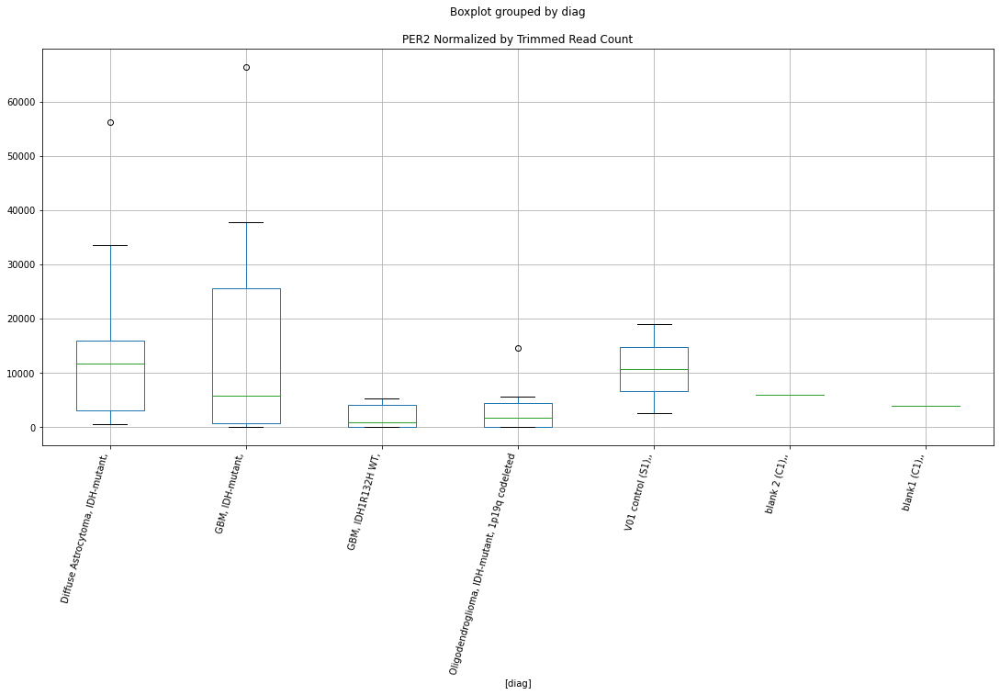

 p : 0.04968979434607463  ( t : 2.104097364540061 ) :  Lexogen  :  bbduk2  :  SMIM10L1
Control and blanks
79     0.0
343    0.0
Name: SMIM10L1, dtype: float64
211    0.0
Name: SMIM10L1, dtype: float64
475    0.0
Name: SMIM10L1, dtype: float64


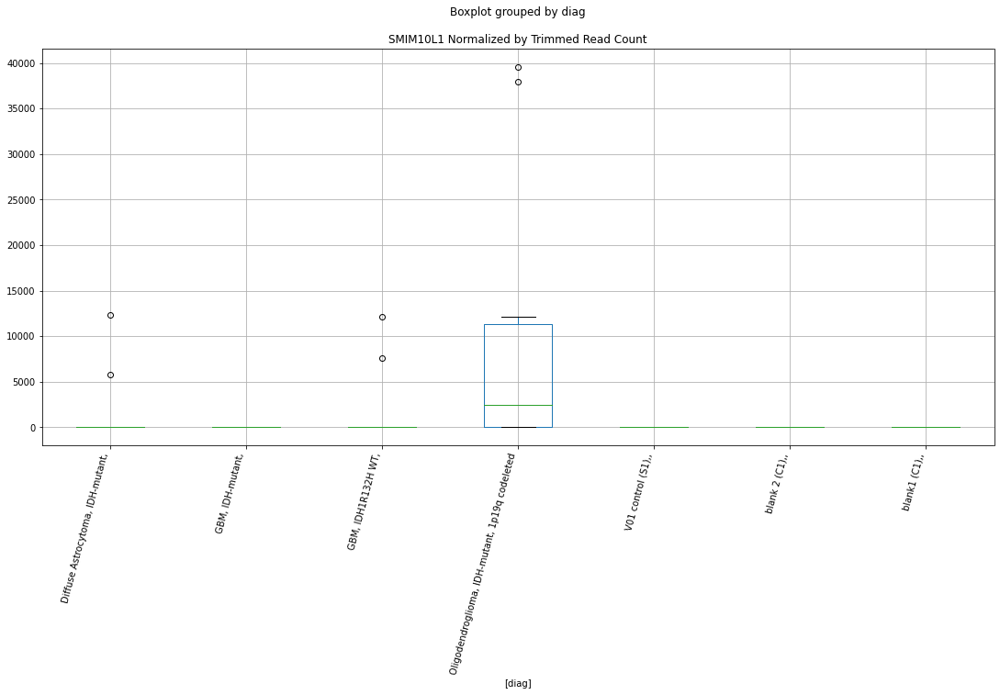

 p : 0.0497172761836206  ( t : 2.1038153287155157 ) :  D-plex  :  bbduk2  :  PTPN18
Control and blanks
73     0.0
337    0.0
Name: PTPN18, dtype: float64
205    5372.73
Name: PTPN18, dtype: float64
469    0.0
Name: PTPN18, dtype: float64


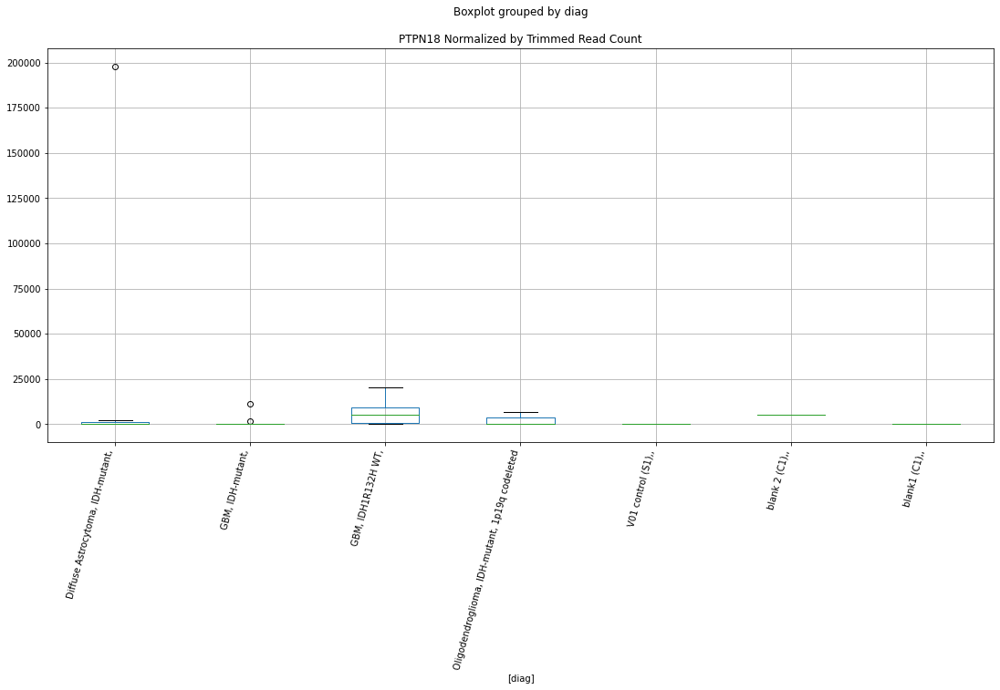

 p : 0.04973138312983448  ( t : 2.1036706094511963 ) :  D-plex  :  cutadapt2  :  PDE6H
Control and blanks
76     1515.23
340    1761.46
Name: PDE6H, dtype: float64
208    113223.26
Name: PDE6H, dtype: float64
472    633439.6
Name: PDE6H, dtype: float64


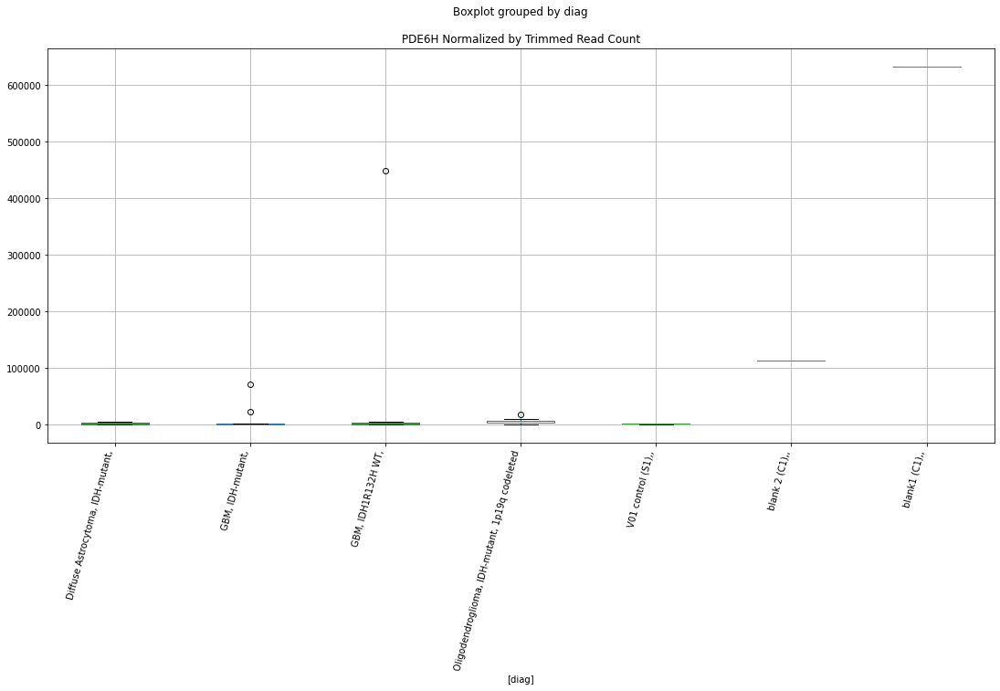

 p : 0.04981388788309917  ( t : 2.1028249626901934 ) :  Lexogen  :  bbduk2  :  SLC14A2-AS1
Control and blanks
79     0.0
343    0.0
Name: SLC14A2-AS1, dtype: float64
211    0.0
Name: SLC14A2-AS1, dtype: float64
475    0.0
Name: SLC14A2-AS1, dtype: float64


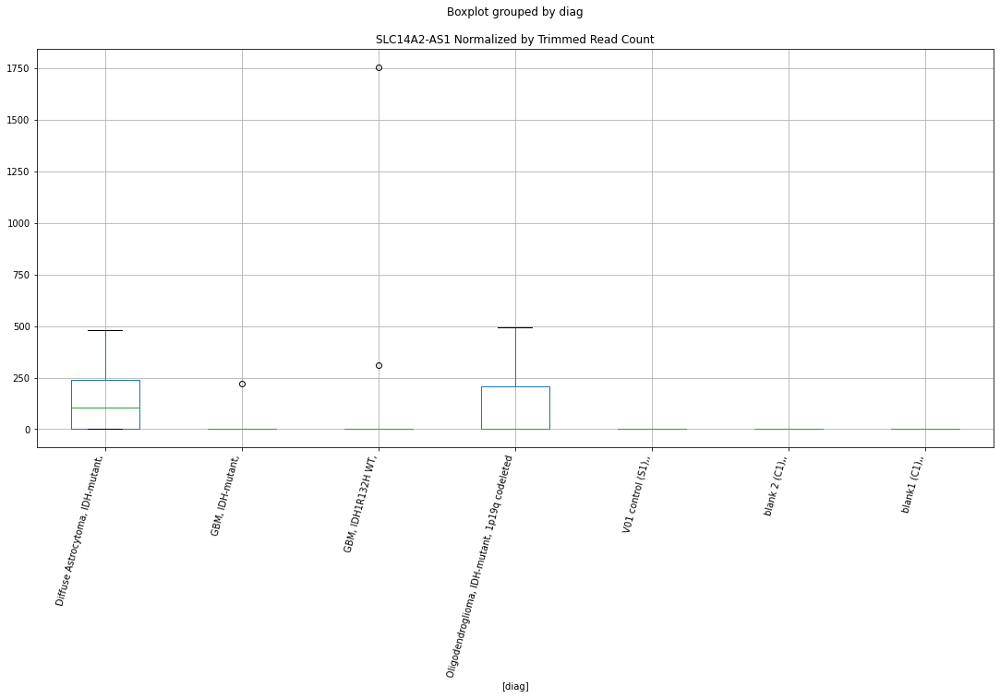

 p : 0.04983584156115573  ( t : 2.1026001591590044 ) :  Lexogen  :  bbduk2  :  RNF144A
Control and blanks
79       0.00
343    424.63
Name: RNF144A, dtype: float64
211    0.0
Name: RNF144A, dtype: float64
475    0.0
Name: RNF144A, dtype: float64


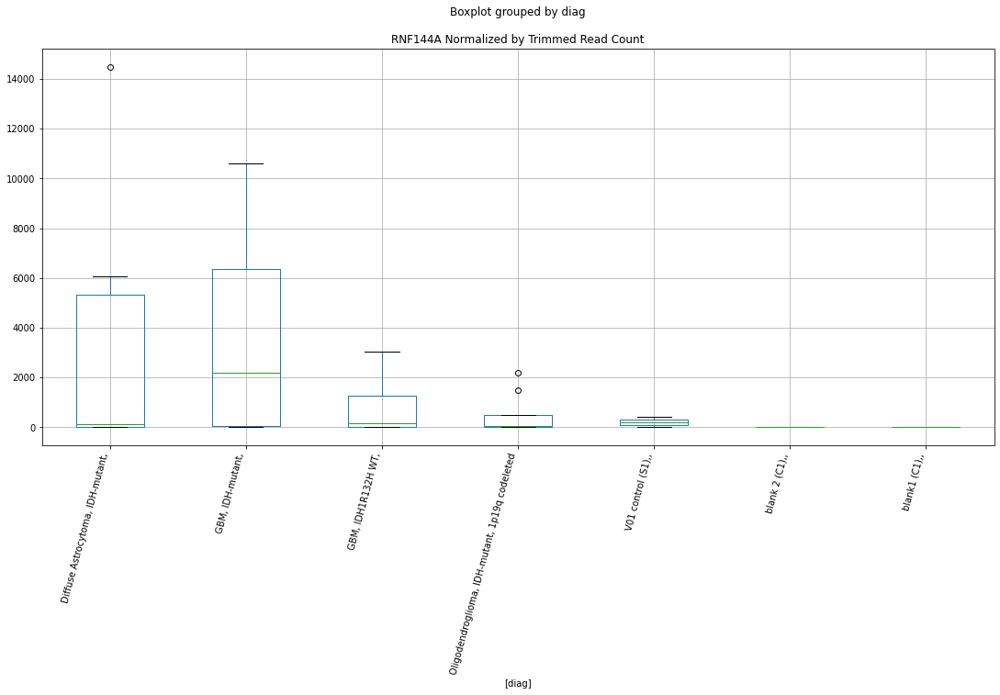

 p : 0.04984218648666506  ( t : 2.102535204507692 ) :  Lexogen  :  bbduk2  :  RNF111
Control and blanks
79     0.0
343    0.0
Name: RNF111, dtype: float64
211    0.0
Name: RNF111, dtype: float64
475    0.0
Name: RNF111, dtype: float64


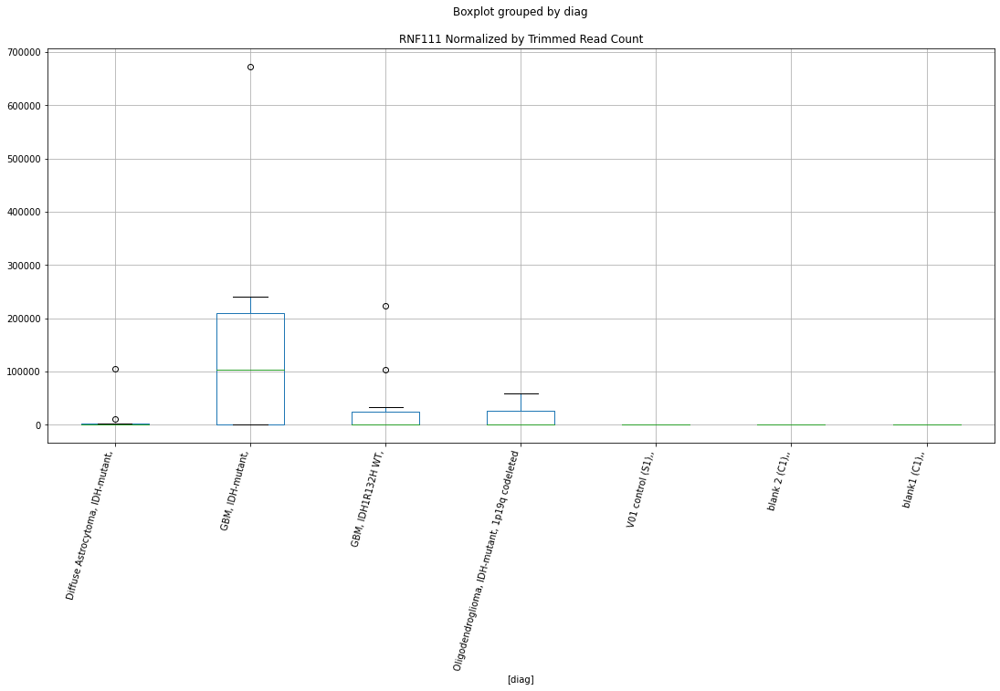

 p : 0.0498695205170189  ( t : 2.1022554648524343 ) :  Lexogen  :  cutadapt2  :  SLC46A1
Control and blanks
82         0.00
346    63130.36
Name: SLC46A1, dtype: float64
214    0.0
Name: SLC46A1, dtype: float64
478    0.0
Name: SLC46A1, dtype: float64


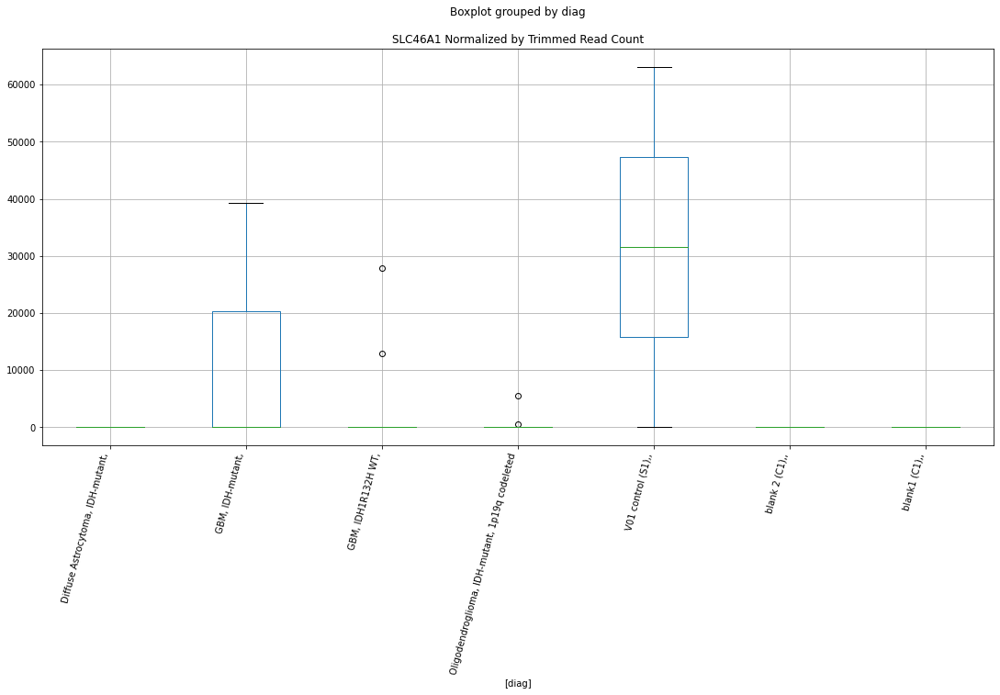

 p : 0.04987760874972943  ( t : 2.1021727156597327 ) :  Lexogen  :  bbduk2  :  SLC8A3
Control and blanks
79        0.00
343    2123.14
Name: SLC8A3, dtype: float64
211    2733.06
Name: SLC8A3, dtype: float64
475    4790.31
Name: SLC8A3, dtype: float64


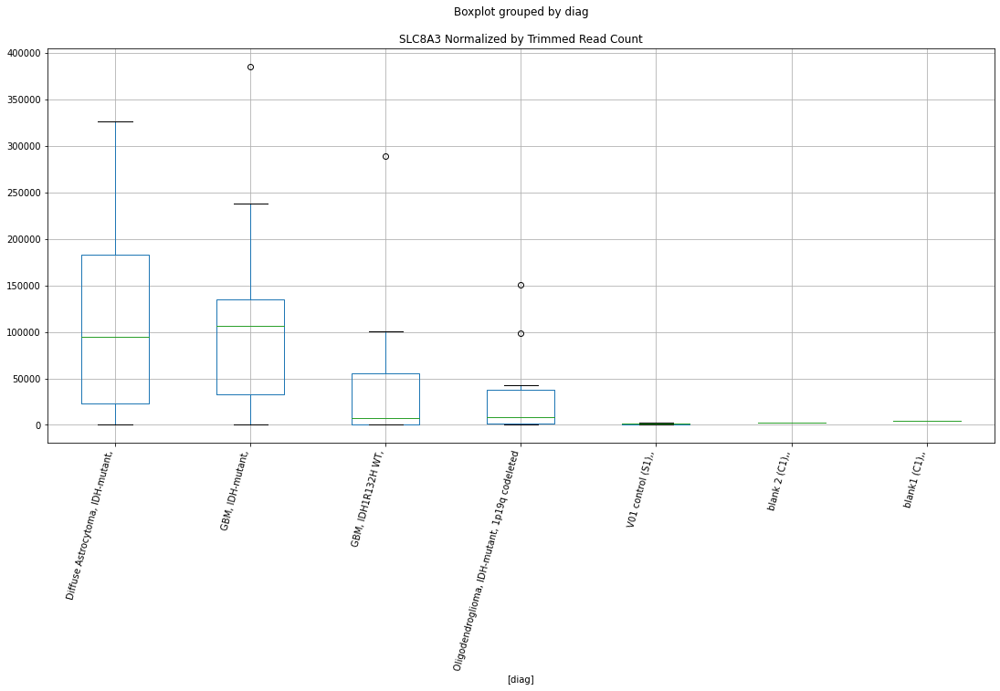

 p : 0.04995224767321967  ( t : 2.101409673951577 ) :  Lexogen  :  cutadapt2  :  RPL6
Control and blanks
82     0.0
346    0.0
Name: RPL6, dtype: float64
214    0.0
Name: RPL6, dtype: float64
478    0.0
Name: RPL6, dtype: float64


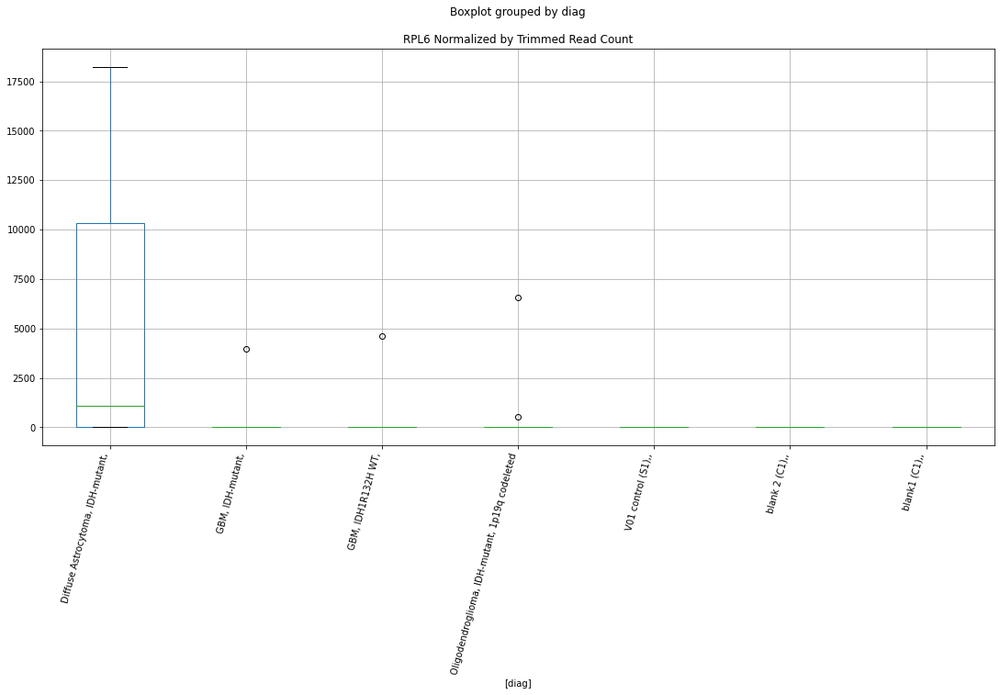

 p : 0.04995479042468162  ( t : 2.1013836973902924 ) :  Lexogen  :  bbduk2  :  OTUD4
Control and blanks
79     0.0
343    0.0
Name: OTUD4, dtype: float64
211    0.0
Name: OTUD4, dtype: float64
475    0.0
Name: OTUD4, dtype: float64


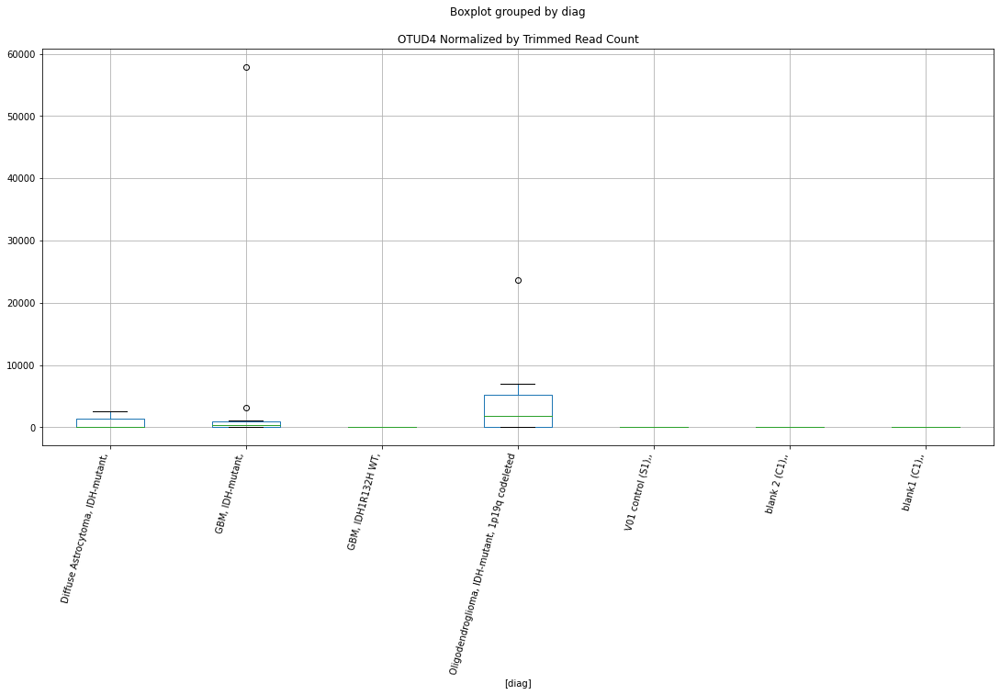

 p : 0.04996075509598294  ( t : 2.101322767464472 ) :  Lexogen  :  bbduk2  :  RPL6
Control and blanks
79     0.0
343    0.0
Name: RPL6, dtype: float64
211    0.0
Name: RPL6, dtype: float64
475    0.0
Name: RPL6, dtype: float64


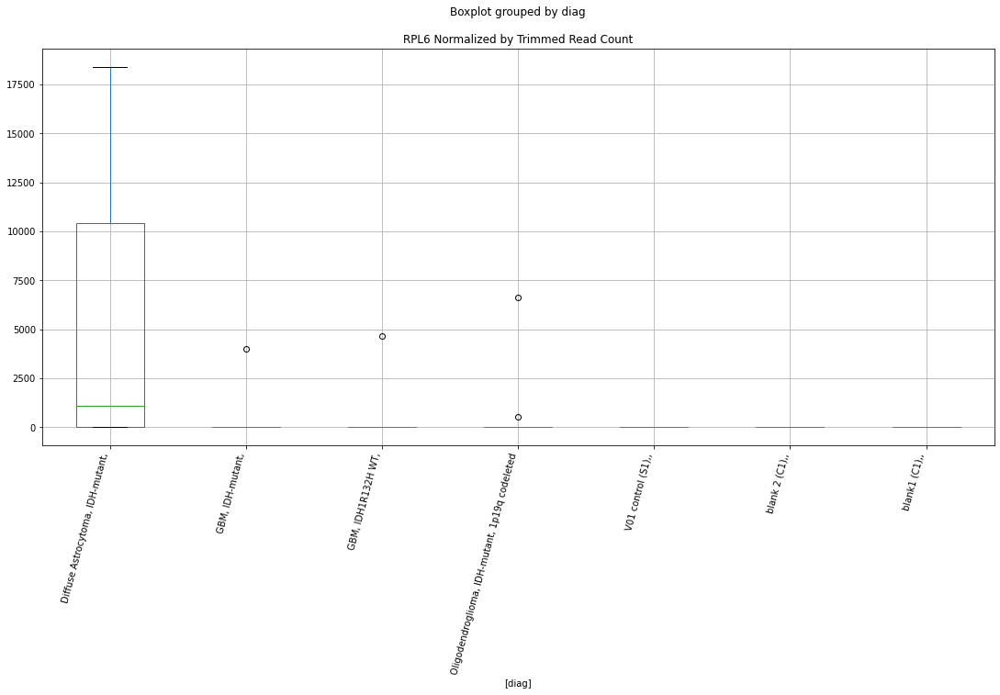

 p : 0.04997778116071647  ( t : 2.101148880272824 ) :  D-plex  :  cutadapt2  :  PHLDA3
Control and blanks
76     0.0
340    0.0
Name: PHLDA3, dtype: float64
208    1763.6
Name: PHLDA3, dtype: float64
472    5779.56
Name: PHLDA3, dtype: float64


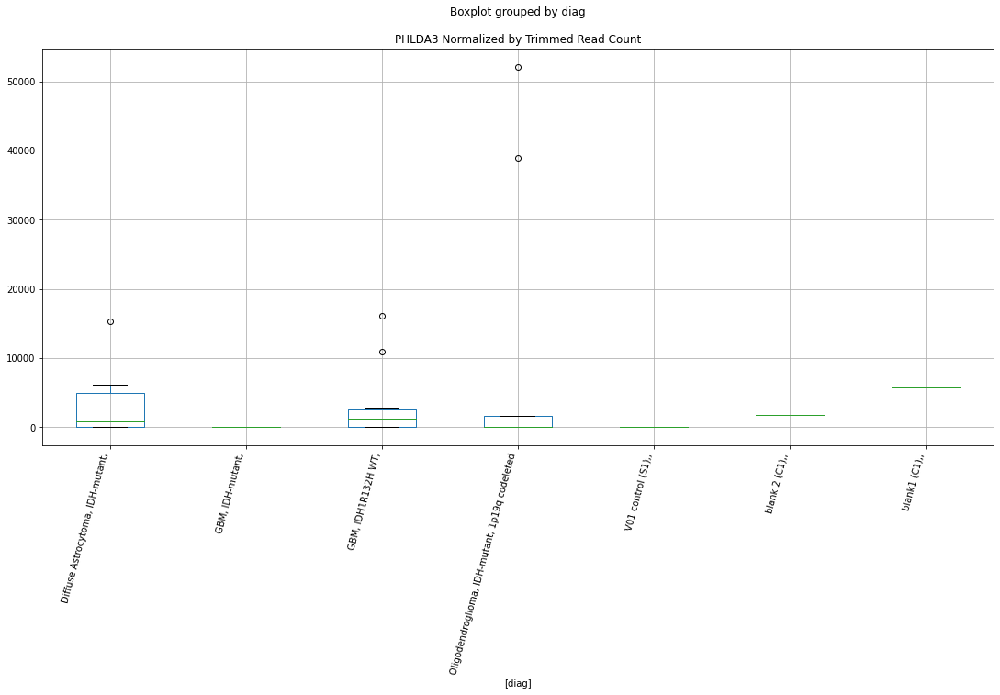

 p : 0.04998184595100657  ( t : 2.101107374533396 ) :  D-plex  :  cutadapt2  :  PRCC
Control and blanks
76     0.0
340    0.0
Name: PRCC, dtype: float64
208    176.36
Name: PRCC, dtype: float64
472    2889.78
Name: PRCC, dtype: float64


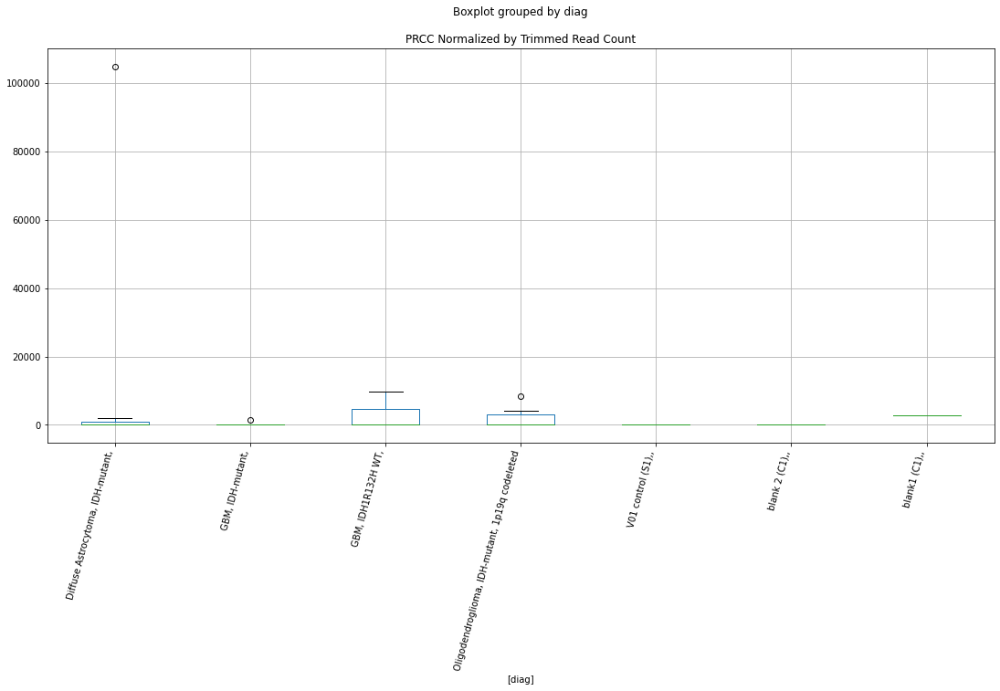

 p : 0.04998909200792047  ( t : 2.1010333923597124 ) :  D-plex  :  cutadapt2  :  RRP1
Control and blanks
76      3030.46
340    22899.04
Name: RRP1, dtype: float64
208    124510.31
Name: RRP1, dtype: float64
472    9247.29
Name: RRP1, dtype: float64


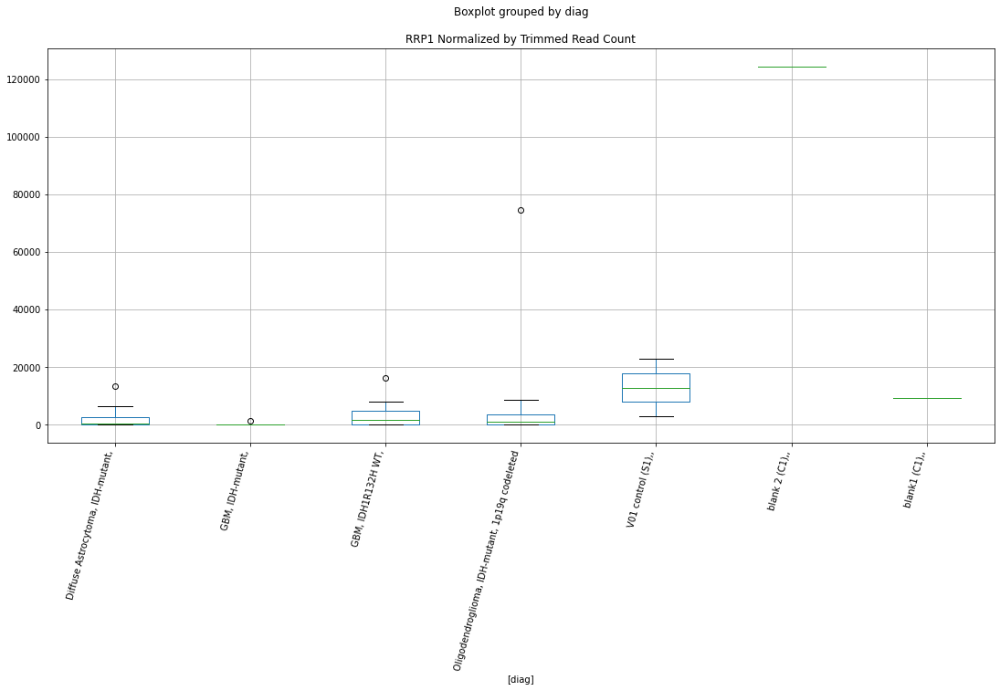

 p : 0.04999806050116375  ( t : 2.1009418376241724 ) :  D-plex  :  bbduk2  :  SLC16A5
Control and blanks
73     0.0
337    0.0
Name: SLC16A5, dtype: float64
205    1432.73
Name: SLC16A5, dtype: float64
469    0.0
Name: SLC16A5, dtype: float64


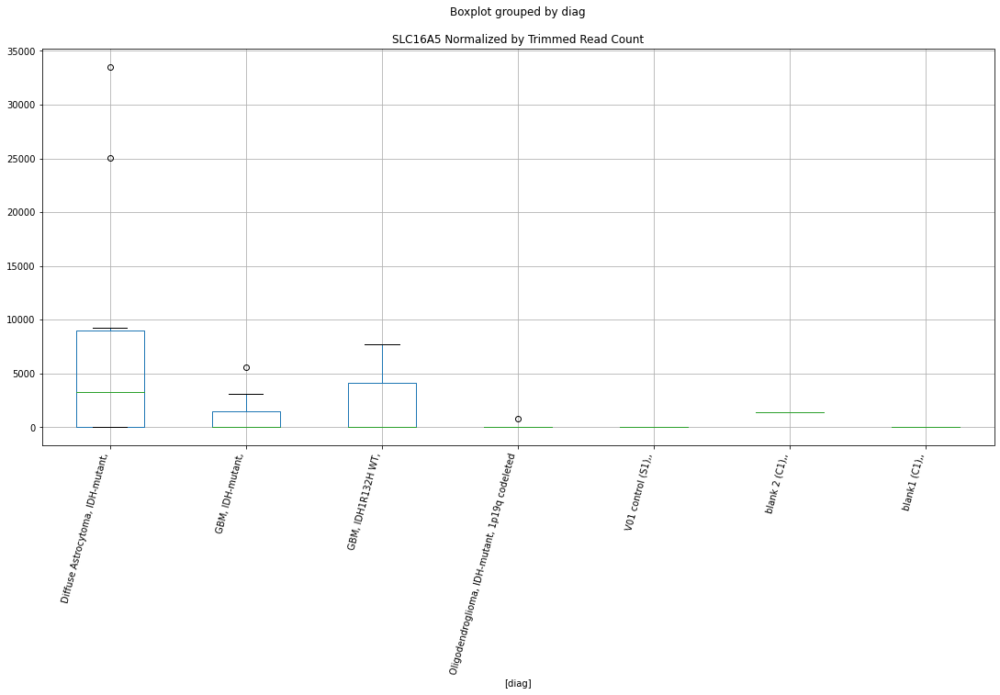

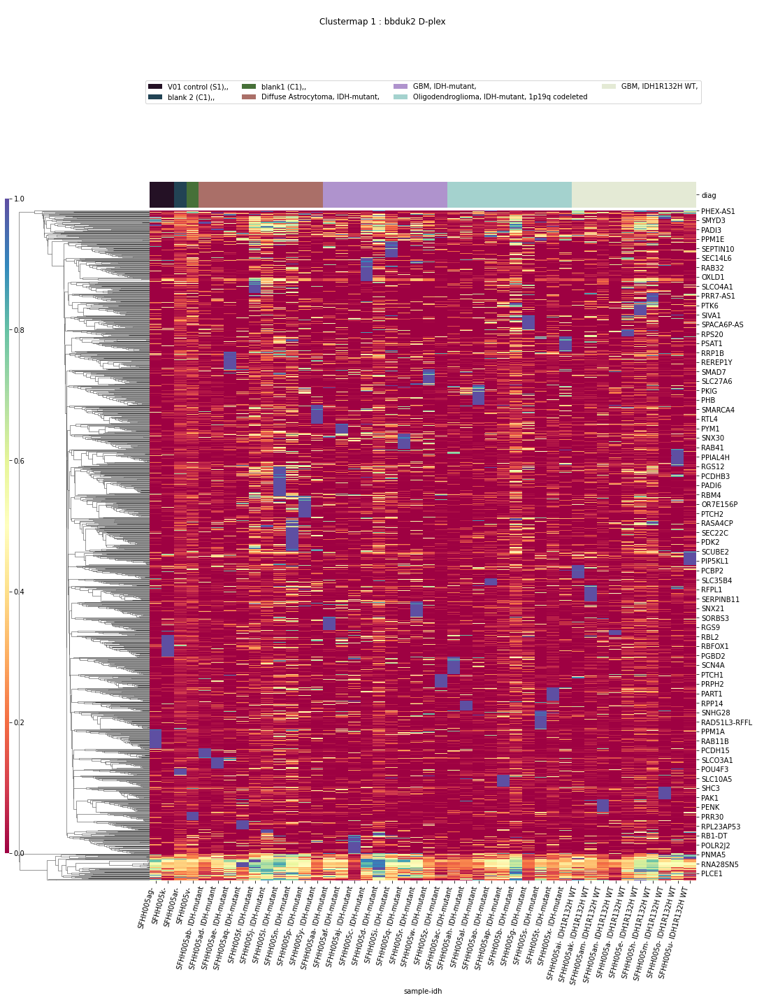

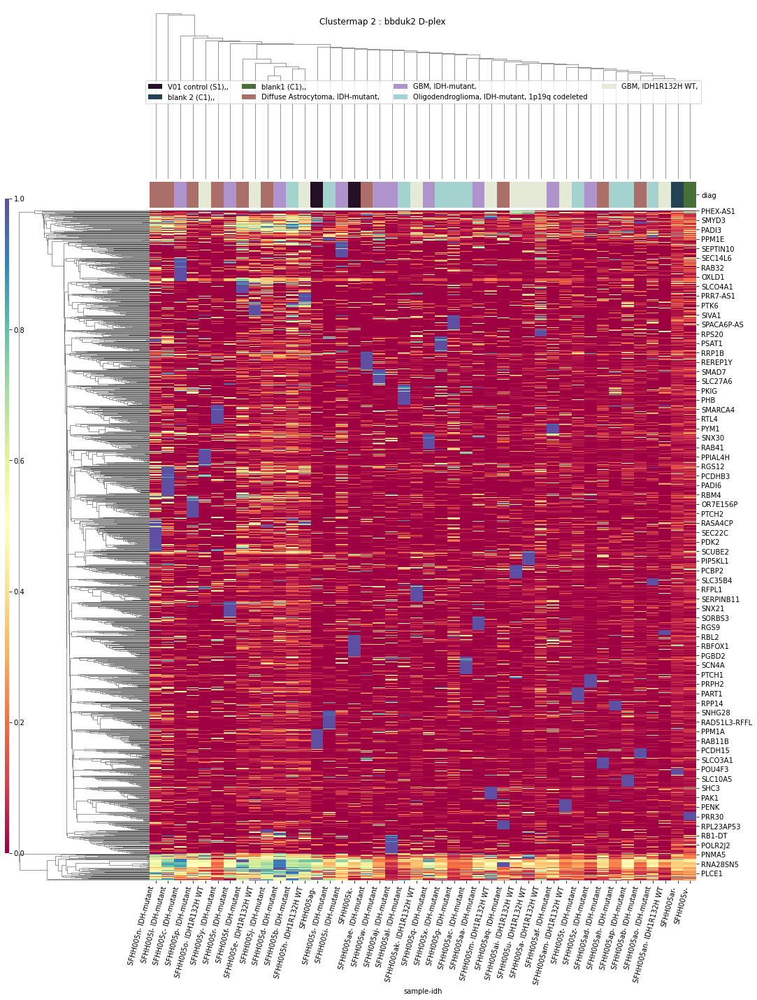

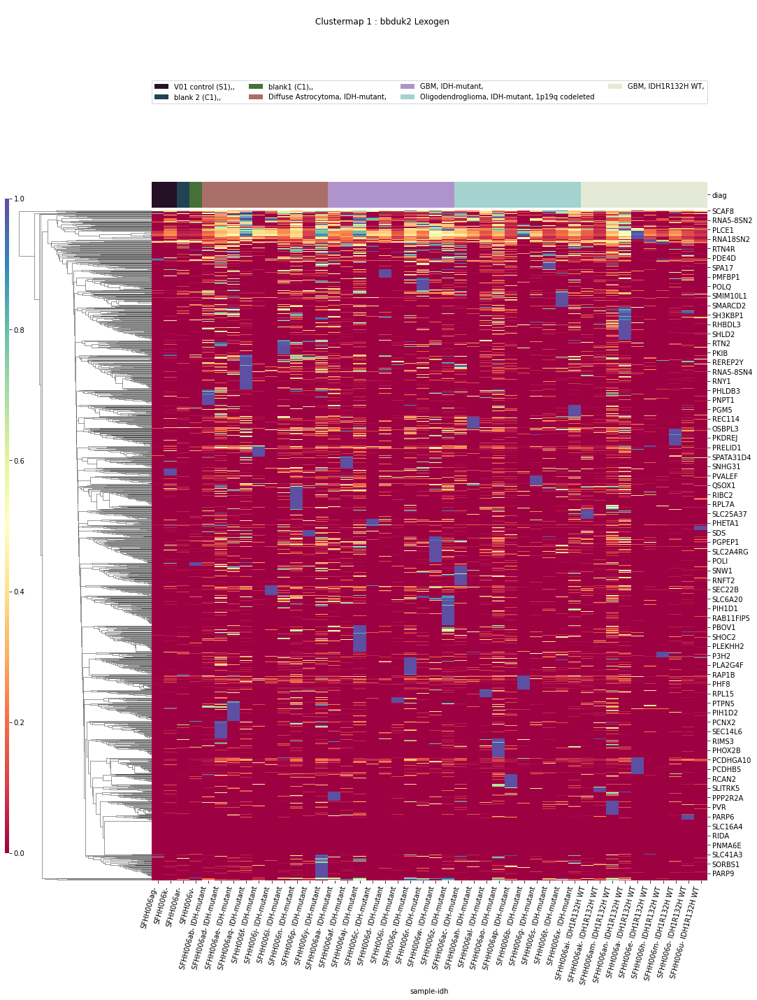

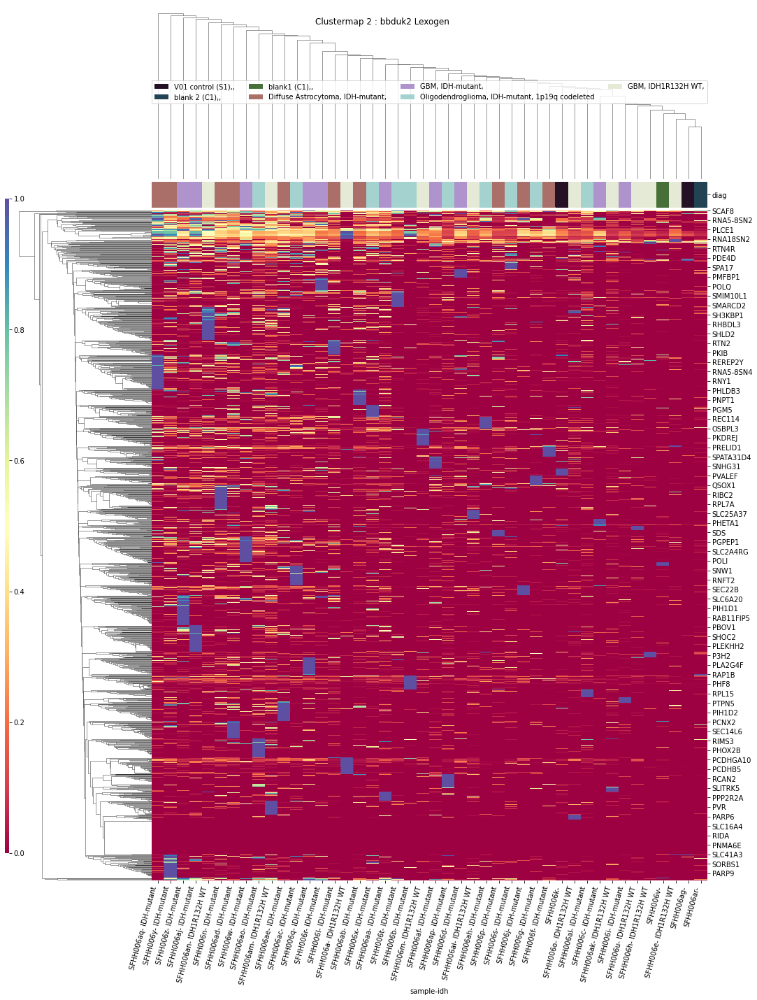

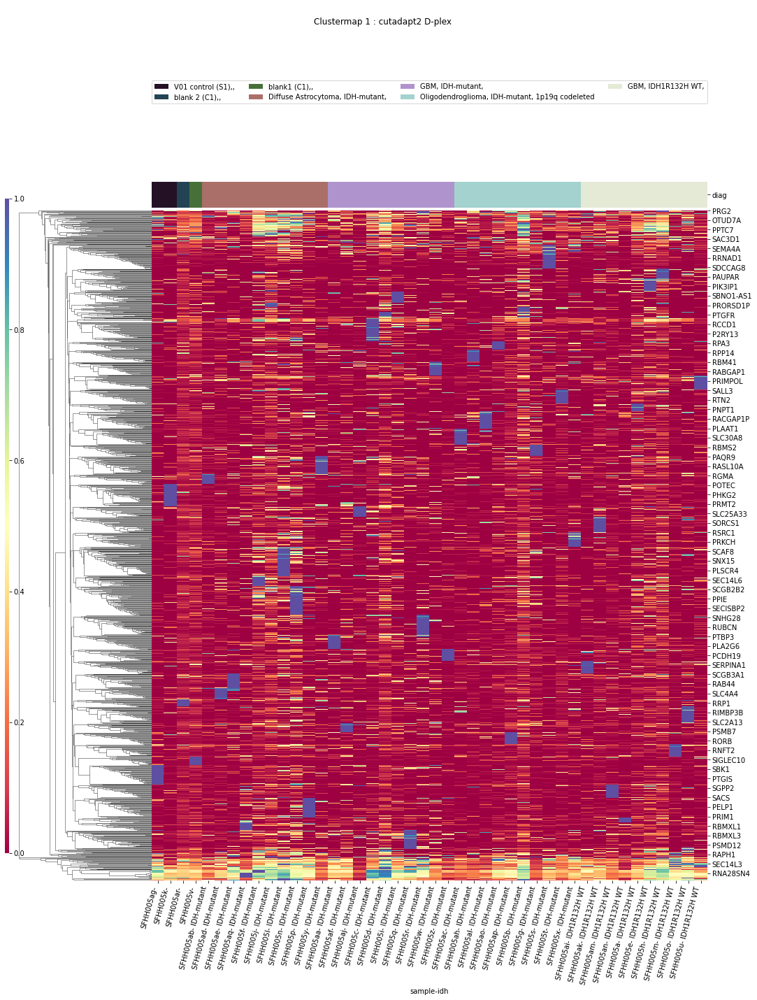

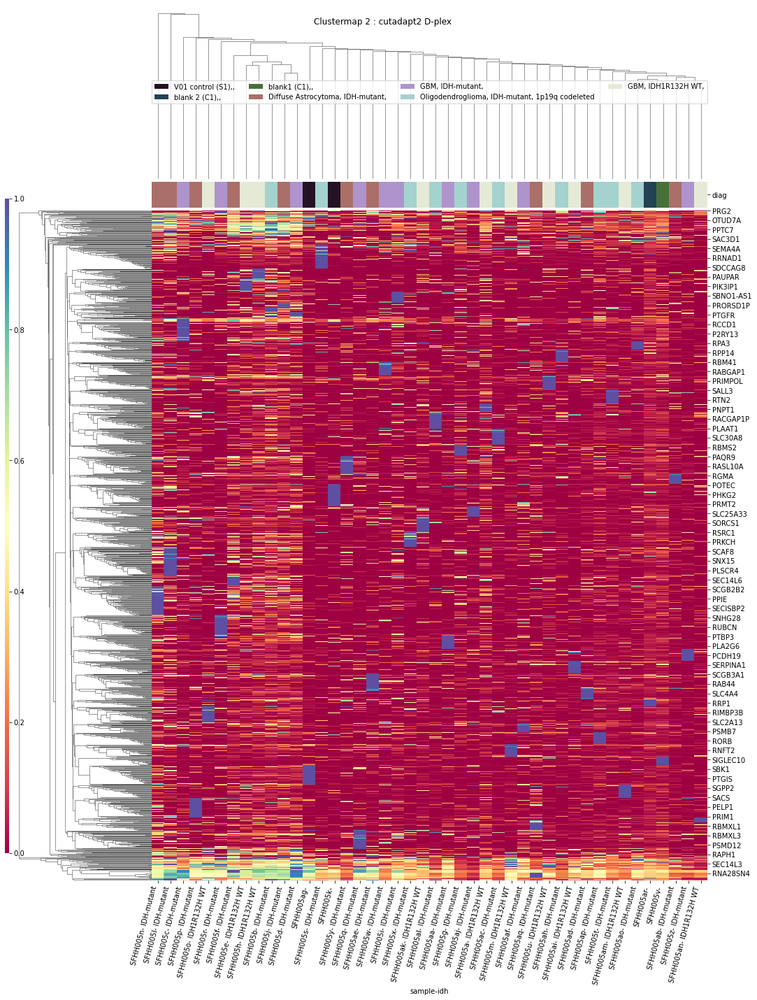

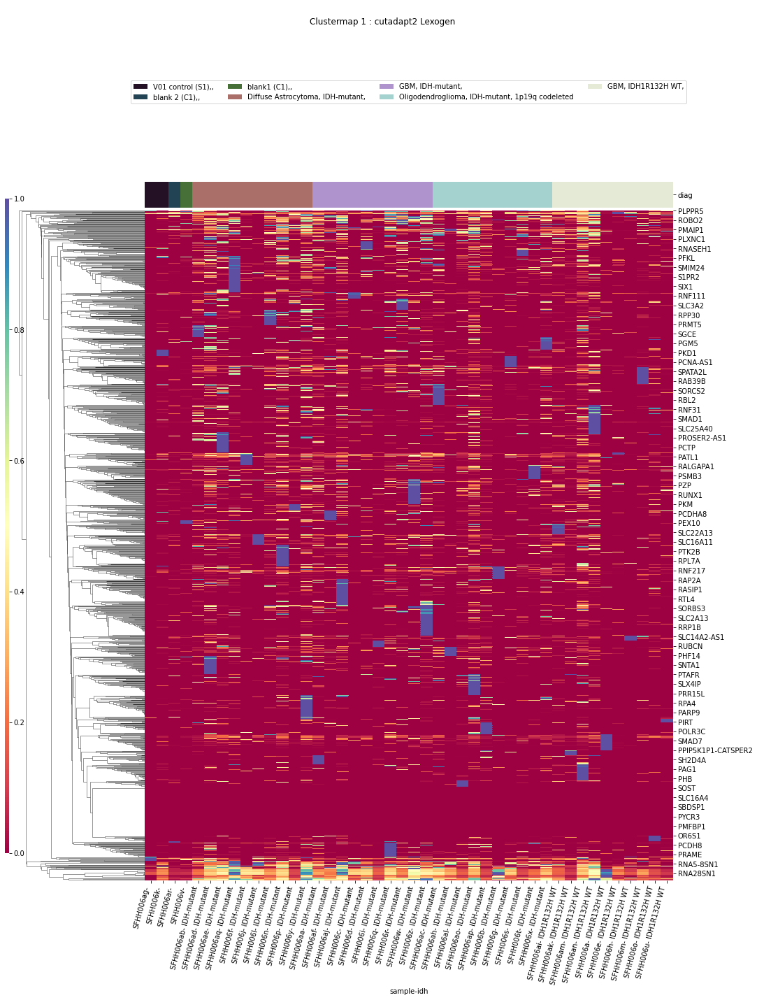

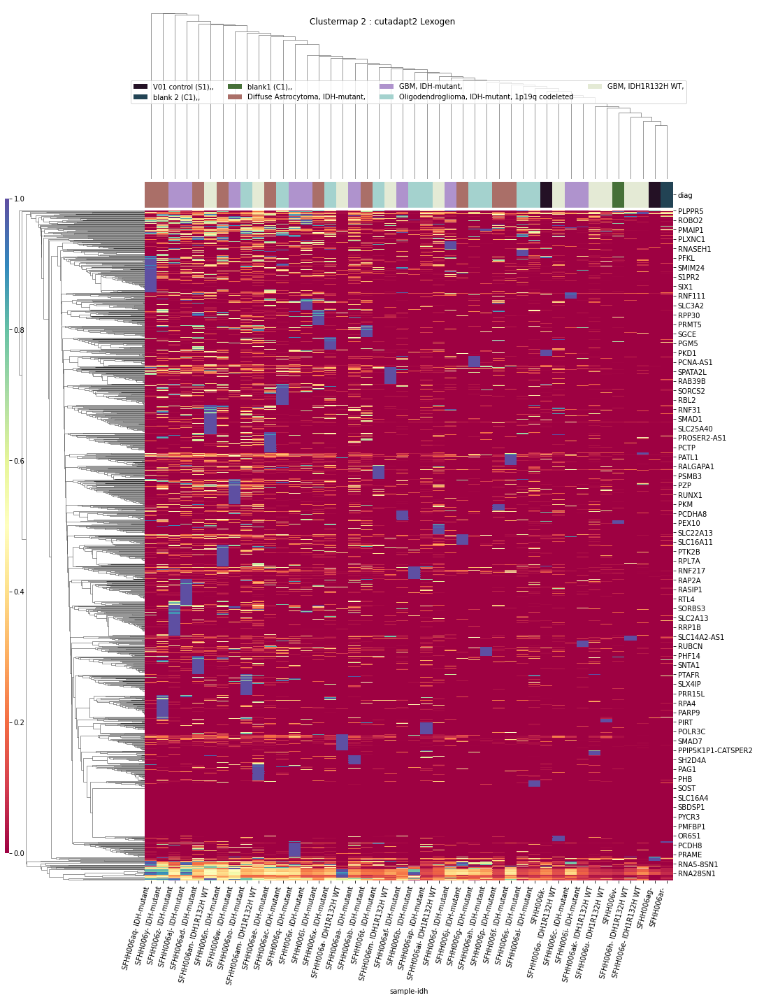

In [67]:
ttests_boxplots_and_heatmaps(dfn,elements,heat_p=0.1)

In [68]:
datetime.now().strftime("%H:%M:%S")

'11:45:14'

In [69]:
plt.rcParams["figure.figsize"] = [18.0,8.0]

In [70]:
pd.set_option('display.max_columns', default_max_columns)

In [71]:
pd.set_option('display.max_rows',default_max_rows)

In [72]:
pd.set_option('display.precision', default_precision)